# Load MWLR

In [1]:
import pandas as pd
import numpy as np
import geopy
from geopy import distance
pd.set_option('display.max_columns', None)
import csv
import spacy
spacy.load("en_core_web_sm")
nlp=spacy.load("en_core_web_sm")
import re
import nltk

In [2]:
CHR=pd.read_csv('E:\Masey-thesis\DATASET\Another Feature\Landcare\merge\CHR.csv')
icmp=pd.read_csv('E:\Masey-thesis\DATASET\Another Feature\Landcare\merge\ICMP.csv')
pdd=pd.read_csv('E:\Masey-thesis\DATASET\Another Feature\Landcare\merge\PDD.csv')
nzac=pd.read_csv(r'E:\Masey-thesis\DATASET\Another Feature\Landcare\merge\NZAC.csv',error_bad_lines=False,encoding="utf_8_sig")

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3071: DtypeWarning: Columns (10,13,14,17,19,24) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,
C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3071: DtypeWarning: Columns (4) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [3]:
CHR.columns

Index(['CollectionEventGuid', 'CollectionEventType', 'VerbatimCollector',
       'StartDate', 'EndDate', 'Locality', 'LocalityId', 'HabitatText',
       'IsCaptiveCultivated', 'NotesText', 'SecurityLevelId',
       'VerbatimCoordinateSystem', 'VerbatimGeoreference', 'DecimalLatitude',
       'DecimalLongitude', 'IsDerived', 'VerbatimCountry', 'Country',
       'VerbatimLandDistrict', 'LandDistrict', 'VerbatimAltitude',
       'Unnamed: 21', 'Unnamed: 22', 'Unnamed: 23', 'Unnamed: 24',
       'Unnamed: 25', 'Unnamed: 26'],
      dtype='object')

In [4]:
chr00=CHR[['CollectionEventGuid', 'CollectionEventType', 'VerbatimCollector',
       'StartDate', 'EndDate', 'Locality', 'LocalityId', 'HabitatText',
       'IsCaptiveCultivated', 'NotesText', 'SecurityLevelId',
       'VerbatimCoordinateSystem', 'VerbatimGeoreference', 'DecimalLatitude',
       'DecimalLongitude', 'IsDerived', 'VerbatimCountry', 'Country',
       'VerbatimLandDistrict', 'LandDistrict', 'VerbatimAltitude']]

In [5]:
icmp00=icmp[['CollectionEventGuid', 'CollectionEventType', 'VerbatimCollector',
       'StartDate', 'EndDate', 'Locality', 'LocalityId', 'HabitatText',
       'IsCaptiveCultivated', 'NotesText', 'SecurityLevelId',
       'VerbatimCoordinateSystem', 'VerbatimGeoreference', 'DecimalLatitude',
       'DecimalLongitude', 'IsDerived', 'VerbatimCountry', 'Country',
       'VerbatimLandDistrict', 'LandDistrict', 'VerbatimAltitude']]

In [6]:
nzac00=nzac[['CollectionEventGuid', 'CollectionEventType', 'VerbatimCollector',
       'StartDate', 'EndDate', 'Locality', 'LocalityId', 'HabitatText',
       'IsCaptiveCultivated', 'NotesText', 'SecurityLevelId',
       'VerbatimCoordinateSystem', 'VerbatimGeoreference', 'DecimalLatitude',
       'DecimalLongitude', 'IsDerived', 'VerbatimCountry', 'Country',
       'VerbatimLandDistrict', 'LandDistrict', 'VerbatimAltitude']]

In [7]:
pdd00=pdd[['CollectionEventGuid', 'CollectionEventType', 'VerbatimCollector',
       'StartDate', 'EndDate', 'Locality', 'LocalityId', 'HabitatText',
       'IsCaptiveCultivated', 'NotesText', 'SecurityLevelId',
       'VerbatimCoordinateSystem', 'VerbatimGeoreference', 'DecimalLatitude',
       'DecimalLongitude', 'IsDerived', 'VerbatimCountry', 'Country',
       'VerbatimLandDistrict', 'LandDistrict', 'VerbatimAltitude']]

In [8]:
merged_dataset_meta=[]

In [9]:
merged_dataset_meta=pd.concat([chr00,pdd],axis=0)
merged_dataset_meta=pd.concat([merged_dataset_meta,nzac],axis=0)
merged_dataset_meta=pd.concat([merged_dataset_meta,icmp],axis=0)

In [10]:
merged_dataset_meta.to_csv(r'E:\Masey-thesis\DATASET\Another Feature\Landcare\merge\merged_dataset_meta.csv')

## Drop dup and nan

In [40]:
merged_dataset_meta=pd.read_csv(r'E:\Masey-thesis\DATASET\Another Feature\Landcare\merge\merged_dataset_meta.csv')

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3071: DtypeWarning: Columns (11,14,15,17,18,19,20) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [41]:
len(merged_dataset_meta)

653857

In [42]:
merged_dataset_meta.head(3)

,Unnamed: 0,CollectionEventGuid,CollectionEventType,VerbatimCollector,StartDate,EndDate,Locality,LocalityId,HabitatText,IsCaptiveCultivated,NotesText,SecurityLevelId,VerbatimCoordinateSystem,VerbatimGeoreference,DecimalLatitude,DecimalLongitude,IsDerived,VerbatimCountry,Country,VerbatimLandDistrict,LandDistrict,VerbatimAltitude
0,0,DA0AC152-0B9A-4E48-B17B-D62949A27ABC,Field,A Wall,1927-01,NaN,"Raglan Mts., Tophouse",C-53033,NaN,0.0,"Transferred from Canterbury Museum, Christchur...",40,New Zealand Map Series 260,N29 0-- 3--,-41.837,172.879665,NaN,NaN,NaN,NaN,NaN,c. 5500 ft
1,1,04449653-B4A9-41AB-BAAB-03EF190D09C5,Field,A. Wall,1927-01,NaN,Mt Princess,C-27710,NaN,0.0,NaN,40,New Zealand Map Series 260,M30 8-- 9--,-42.1966,172.636765,NaN,New Zealand,NaN,Canterbury Land District,NaN,6500 ft
2,2,BAFCBF02-B25E-4611-BFF2-F64D0EE53553,Field,Morgan PG,1913-02,NaN,"Northwest Nelson, Westport, near Coalbrookdale",C-52394,NaN,0.0,"Transferred from Canterbury Museum, Christchur...",40,New Zealand Map Series 260,L29 10- 37-,-41.7676,171.79742,NaN,New Zealand,NaN,Nelson Land District,NaN,NaN


In [43]:
merged_dataset_meta=merged_dataset_meta.dropna(subset=['Locality','DecimalLatitude','DecimalLongitude'])

In [44]:
len(merged_dataset_meta)

300736

In [45]:
merged_dataset_meta=merged_dataset_meta.drop_duplicates(subset=['Locality','DecimalLatitude','DecimalLongitude','VerbatimAltitude'])

In [46]:
len(merged_dataset_meta)

159716

In [47]:
DataSet_nan = merged_dataset_meta.reset_index(drop=True)

In [50]:
DataSet_nan=DataSet_nan.drop(labels='Unnamed: 0',axis=1)

In [52]:
DataSet_nan.to_csv(r'E:\Masey-thesis\DATASET\Another Feature\Landcare\merge\DataSet_nan_dup.csv')

In [54]:
DataSet_nan.columns

Index(['CollectionEventGuid', 'CollectionEventType', 'VerbatimCollector',
       'StartDate', 'EndDate', 'Locality', 'LocalityId', 'HabitatText',
       'IsCaptiveCultivated', 'NotesText', 'SecurityLevelId',
       'VerbatimCoordinateSystem', 'VerbatimGeoreference', 'DecimalLatitude',
       'DecimalLongitude', 'IsDerived', 'VerbatimCountry', 'Country',
       'VerbatimLandDistrict', 'LandDistrict', 'VerbatimAltitude'],
      dtype='object')

In [55]:
DataSet_Select=DataSet_nan[['VerbatimCollector','StartDate','Locality', 'LocalityId','IsCaptiveCultivated','DecimalLatitude',
       'DecimalLongitude','VerbatimLandDistrict', 'LandDistrict', 'VerbatimAltitude']]

In [57]:
DataSet_Select.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\DataSet_Select.csv')

In [58]:
DataSet_Select.head(2)

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude
0,A Wall,1927-01,"Raglan Mts., Tophouse",C-53033,0.0,-41.837,172.879665,NaN,NaN,c. 5500 ft
1,A. Wall,1927-01,Mt Princess,C-27710,0.0,-42.1966,172.636765,Canterbury Land District,NaN,6500 ft


## nz scope

In [62]:
DataSet_Select_nz_scope=[]
temp=[]
for i in range(len(DataSet_Select)):
    
    try:
        lat=float(DataSet_Select['DecimalLatitude'].iloc[i])
        long=float(DataSet_Select['DecimalLongitude'].iloc[i])

        if 166.43 < long < 178.52:
            
            if -47.320 < lat < -34.396:
                temp=DataSet_Select.iloc[i]
            else:
                continue
        else:
            continue
    except:
        continue
    DataSet_Select_nz_scope.append(temp)
DataSet_Select_nz_scope=pd.DataFrame(DataSet_Select_nz_scope)

In [64]:
DataSet_Select_nz_scope.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\DataSet_Select_nz_scope.csv')

In [66]:
DataSet_Select_nz_scope.head(5)

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude
0,A Wall,1927-01,"Raglan Mts., Tophouse",C-53033,0.0,-41.837,172.879665,NaN,NaN,c. 5500 ft
1,A. Wall,1927-01,Mt Princess,C-27710,0.0,-42.1966,172.636765,Canterbury Land District,NaN,6500 ft
2,Morgan PG,1913-02,"Northwest Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.7676,171.79742,Nelson Land District,NaN,NaN
3,Townson W,NaN,"Northwest Nelson, Mount Rochfort",C-49969,0.0,-41.8292,171.675871,Nelson Land District,NaN,NaN
4,Gibbs FG,NaN,"Northwest Nelson, Takaka Hills",C-52258,0.0,-41.0266,172.869347,Nelson Land District,NaN,NaN


In [67]:
len(DataSet_Select_nz_scope)

150656

# Replace Abbreviations

In [6]:
DataSet_Select_nz_scope=pd.read_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\DataSet_Select_nz_scope.csv')

1st replace

In [7]:
replace_list=['s.e. of','s.w. of','n.e. of','n.w. of','s.e of','s.w of','n.e of','n.w of',
             'se of','sw of','ne of','nw of',
             'e of','w of','n of','s of',
              'e. of','w. of','n. of','s. of',
             'sse of','ssw of','sne of','snw of',
             'ese of','esw of','ene of','enw of',
             'nse of','nsw of','nne of','nnw of',
             'wse of','wsw of','wne of','wnw of']
count=0
dataset_nz_scope_backup=DataSet_Select_nz_scope
for i in range(len(dataset_nz_scope_backup)):
    
    str_origin = dataset_nz_scope_backup['Locality'].iloc[i]
    
    for replace_item in replace_list:
        if replace_item in str_origin.lower():
            
                # 1
#********************************'sse of','ssw of','sne of','snw of',
# 'sse of','ssw of','sne of','snw of',
#              'ese of','esw of','ene of','enw of',
#              'nse of','nsw of','nne of','nnw of',
#              'wse of','wsw of','wne of','wnw of'
                # 1
            if replace_item=='sse of':
                print(str_origin)
                str_replace=str_origin.replace(' SSE of',' south-south-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue

                # 2
            elif replace_item=='ssw of':
                print(str_origin)
                str_replace=str_origin.replace(' SSW of',' south-south-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue

                #  3  
            elif replace_item=='sne of':
                print(str_origin)
                str_replace=str_origin.replace(' SNE of',' south-north-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #   4 
            elif replace_item=='snw of':
                print(str_origin)
                str_replace=str_origin.replace(' SNW of',' south-north-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
#******************************** 'ese of','esw of','ene of','enw of',
                # 1
            elif replace_item=='ese of':
                print(str_origin)
                str_replace=str_origin.replace(' ESE of',' east-south-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                # 2
            elif replace_item=='esw of':
                print(str_origin)
                str_replace=str_origin.replace(' ESW of',' east-south-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #  3  
            elif replace_item=='ene of':
                print(str_origin)
                str_replace=str_origin.replace(' ENE of',' east-north-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #   4 
            elif replace_item=='enw of':
                print(str_origin)
                str_replace=str_origin.replace(' ENW of',' east-north-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
#******************************** 'nse of','nsw of','nne of','nnw of',
                # 1
            elif replace_item=='nse of':
                print(str_origin)
                str_replace=str_origin.replace(' NSE of',' north-south-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                # 2
            elif replace_item=='nsw of':
                print(str_origin)
                str_replace=str_origin.replace(' NSW of',' north-south-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #  3  
            elif replace_item=='nne of':
                print(str_origin)
                str_replace=str_origin.replace(' NNW of',' north-north-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #   4 
            elif replace_item=='nnw of':
                print(str_origin)
                str_replace=str_origin.replace(' NNW of',' north-north-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
#******************************** 'wse of','wsw of','wne of','wnw of'
                # 1
            elif replace_item=='wse of':
                print(str_origin)
                str_replace=str_origin.replace(' WSE of',' west-south-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                # 2
            elif replace_item=='wsw of':
                print(str_origin)
                str_replace=str_origin.replace(' WSW of',' west-south-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #  3  
            elif replace_item=='wne of':
                print(str_origin)
                str_replace=str_origin.replace(' WNE of',' west-north-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #   4 
            elif replace_item=='wnw of':
                print(str_origin)
                str_replace=str_origin.replace(' WNW of',' west-north-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
#********************************                 

                
            elif replace_item=='s.e. of':
                print(str_origin)
                str_replace=str_origin.replace('s.e. of','south-east of')
                str_replace=str_origin.replace('S.E. of','south-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                # 2
            elif replace_item=='s.w. of':
                print(str_origin)
                str_replace=str_origin.replace('s.w. of','south-west of')
                str_replace=str_origin.replace('S.W. of','south-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #  3  
            elif replace_item=='n.e. of':
                print(str_origin)
                str_replace=str_origin.replace('n.e. of','north-east of')
                str_replace=str_origin.replace('N.E. of','north-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #   4 
            elif replace_item=='n.w. of':
                print(str_origin)
                str_replace=str_origin.replace('n.w. of','north-west of')
                str_replace=str_origin.replace('N.W. of','north-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
#********************************  
                # 1
            elif replace_item=='s.e of':
                print(str_origin)
                str_replace=str_origin.replace('s.e of','south-east of')
                str_replace=str_origin.replace('S.E of','south-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                # 2
            elif replace_item=='s.w of':
                print(str_origin)
                str_replace=str_origin.replace('s.w of','south-west of')
                str_replace=str_origin.replace('S.W of','south-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #  3  
            elif replace_item=='n.e of':
                print(str_origin)
                str_replace=str_origin.replace('n.e of','north-east of')
                str_replace=str_origin.replace('N.E of','north-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #   4
            elif replace_item=='n.w of':
                print(str_origin)
                str_replace=str_origin.replace('n.w of','north-west of')
                str_replace=str_origin.replace('N.W of','north-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue              


                # 1
            elif replace_item=='se of':
                print(str_origin)
                str_replace=str_origin.replace('SE of','south-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                # 2
            elif replace_item=='sw of':
                print(str_origin)
                str_replace=str_origin.replace('SW of','south-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #  3  
            elif replace_item=='ne of':
                print(str_origin)
                str_replace=str_origin.replace('NE of','north-east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #   4 
            elif replace_item=='nw of':
                print(str_origin)
                str_replace=str_origin.replace('NW of','north-west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
#********************************                 
                #1
            elif replace_item=='n. of':
                print(str_origin)
                str_replace=str_origin.replace(' N. of',' north of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #2
            elif replace_item=='s. of':
                print(str_origin)
                str_replace=str_origin.replace(' S. of',' south of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #3
            elif replace_item=='e. of':
                print(str_origin)
                str_replace=str_origin.replace(' E. of',' east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #4
            elif replace_item=='w. of':
                print(str_origin)
                str_replace=str_origin.replace(' W. of',' west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
#********************************                 
                #1
            elif replace_item=='n of':
                print(str_origin)
                str_replace=str_origin.replace(' N of',' north of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #2
            elif replace_item=='s of':
                print(str_origin)
                str_replace=str_origin.replace(' S of',' south of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #3
            elif replace_item=='e of':
                print(str_origin)
                str_replace=str_origin.replace(' E of',' east of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue
                #4
            elif replace_item=='w of':
                print(str_origin)
                str_replace=str_origin.replace(' W of',' west of')

                dataset_nz_scope_backup['Locality'].iloc[i]=str_replace
                print(str_replace)
                if str_origin ==str_replace:
                    count=count+1
                else:
                    continue

            print(i)
            print(count)
        
        else:
            continue

North Otago, eastern slopes of Dingle Burn, Lake Hawea
North Otago, eastern slopes of Dingle Burn, Lake Hawea
34
1
Hawkes Bay, Junction of Tutaekuri and Ngaruroro Rivers
Hawkes Bay, Junction of Tutaekuri and Ngaruroro Rivers
56
2
South Auckland, Hamilton city, St. Andrews Golf Course, banks of the Waikato River
South Auckland, Hamilton city, St. Andrews Golf Course, banks of the Waikato River
158
3
Hamilton city, St. Andrews Golf Course, banks of the Waikato River
Hamilton city, St. Andrews Golf Course, banks of the Waikato River
159
4
Fiordland National Park: Murchison Mtns, summit of limestone ridge, N of Lake Orbell
Fiordland National Park: Murchison Mtns, summit of limestone ridge, north of Lake Orbell
Fiordland National Park: Murchison Mtns, summit of limestone ridge, N of Lake Orbell
Fiordland National Park: Murchison Mtns, summit of limestone ridge, north of Lake Orbell
Wanganui, east side of Great North Road, 35 to 55 m south of Parsons Rd intersection
Wanganui, east side of Gr

Westport coastal district, near Charleston, junction of Nile River with Awakari River
1125
71
Eyre Mts., Otago- Southland:  between Windley and main branches of Eyre Ck
Eyre Mts., Otago- Southland:  between Windley and main branches of Eyre Ck
1273
72
Brian Boru Stm., NE of Chalk Ra., Marlborough
Brian Boru Stm., north-east of Chalk Ra., Marlborough
Brian Boru Stm., NE of Chalk Ra., Marlborough
Brian Boru Stm., NE of Chalk Ra., Marlborough
1275
73
North side Hokitika Bridge abutment on West side of SH5
North side Hokitika Bridge abutment on West side of SH5
1281
74
Porters Pass, slopes of Foggy Pk.
Porters Pass, slopes of Foggy Pk.
1290
75
Below Mt Pukeonake, slope of Ngauruhoe
Below Mt Pukeonake, slope of Ngauruhoe
1370
76
Base of Mt Ruapehu
Base of Mt Ruapehu
1381
77
Base of Mt Ruapehu
Base of Mt Ruapehu
1381
78
 Taipa, Shore of Doubtless Bay, Mangonui Co.
 Taipa, Shore of Doubtless Bay, Mangonui Co.
1429
79
Base of Ruapehu, Whakapapaiti River
Base of Ruapehu, Whakapapaiti River
1460

Slopes of Mt Elliot, McKinnon [Mackinnon] Pass
Slopes of Mt Elliot, McKinnon [Mackinnon] Pass
2505
150
Pukaki township, Canterbury. Near shore of lake.
Pukaki township, Canterbury. Near shore of lake.
2578
151
N.W. of Coal Hill, Peel Ra
north-west of Coal Hill, Peel Ra
N.W. of Coal Hill, Peel Ra
N.W. of Coal Hill, Peel Ra
2584
152
E. of Baton Saddle, Arthur Ra.
E. of Baton Saddle, Arthur Ra.
2594
153
North Island, Urewera National Park, Old Wairoa road, Aniwaniwa (far E. side of Lake Waikaremoana).
North Island, Urewera National Park, Old Wairoa road, Aniwaniwa (far E. side of Lake Waikaremoana).
2609
154
South Island, Buller: upper reaches of the Porarari River, ca. 2 k m west of the "Lone Hand"
South Island, Buller: upper reaches of the Porarari River, ca. 2 k m west of the "Lone Hand"
2651
155
South Island, Fiordland National Park, Stuart Mtns., south bank of the Wapiti River between outflow of Lake Thomson and walkwire 0.5 km north of Lake Hankinson
South Island, Fiordland National

Hanmer, South side of Mount Isobel
3562
218
South side of Mount Isobel, Canterbury
South side of Mount Isobel, Canterbury
3563
219
Golden Bay, north of Onekaka, banks of the lower reaches of the Otere River
Golden Bay, north of Onekaka, banks of the lower reaches of the Otere River
3616
220
Kokatahi River Valley, slopes north of a side creek in the lower reaches of Farquharson Creek
Kokatahi River Valley, slopes north of a side creek in the lower reaches of Farquharson Creek
3621
221
Kokatahi River Valley, basin south of headwaters of Frosty Creek
Kokatahi River Valley, basin south of headwaters of Frosty Creek
3622
222
Kokatahi River Valley, lower reaches of Crawford Creek, downstream from Farquharson Creek
Kokatahi River Valley, lower reaches of Crawford Creek, downstream from Farquharson Creek
3625
223
Arthur's Pass National Park, terrace at the forest margin, above lower reaches of Twin Creek
Arthur's Pass National Park, terrace at the forest margin, above lower reaches of Twin Cre

South Auckland, Hamilton Ecological District, Hamilton City, Banks of the Waikato River.
4707
281
Canterbury, Banks Peninsula, south slopes of Mount Bradley
Canterbury, Banks Peninsula, south slopes of Mount Bradley
4723
282
Mount George, Fiordland: valley draining basin N of peak
Mount George, Fiordland: valley draining basin north of peak
Mount George, Fiordland: valley draining basin N of peak
Mount George, Fiordland: valley draining basin north of peak
Fiordland, Mount George, south shore of lake at head of Elizabeth Burn, 2km north of peak
Fiordland, Mount George, south shore of lake at head of Elizabeth Burn, 2km north of peak
4744
283
Mt George, Fiordland:  south side of ridge SW of lake head of Elizabeth Burn
Mt George, Fiordland:  south side of ridge south-west of lake head of Elizabeth Burn
Mt George, Fiordland:  south side of ridge SW of lake head of Elizabeth Burn
Mt George, Fiordland:  south side of ridge SW of lake head of Elizabeth Burn
4745
284
Mt George, Fiordland:  so

N. of Paekakariki
5803
349
S. of Culliford Hill, Owen Ra.
S. of Culliford Hill, Owen Ra.
5806
350
S. of Ada Pass, Spenser Mts.
S. of Ada Pass, Spenser Mts.
5809
351
54 km ESE of New Plymouth, 4 km W of Whangamommona, Awahou Scenic Reserve
54 km Esouth-east of New Plymouth, 4 km W of Whangamommona, Awahou Scenic Reserve
54 km ESE of New Plymouth, 4 km W of Whangamommona, Awahou Scenic Reserve
54 km ESE of New Plymouth, 4 km W of Whangamommona, Awahou Scenic Reserve
5838
352
54 km ESE of New Plymouth, 4 km W of Whangamommona, Awahou Scenic Reserve
54 km ESE of New Plymouth, 4 km west of Whangamommona, Awahou Scenic Reserve
54 km ESE of New Plymouth, 4 km W of Whangamommona, Awahou Scenic Reserve
54 km east-south-east of New Plymouth, 4 km W of Whangamommona, Awahou Scenic Reserve
Otago, Big Bay District, (prob. lower slope of McKenzie Range)
Otago, Big Bay District, (prob. lower slope of McKenzie Range)
5842
353
Otago, SW of Henley, approx one mile south of Taieri River bridge
Otago, sou

near Te Toto Stream, north-west of Karioi Mountain,
near Te Toto Stream, N.W. of Karioi Mountain,
near Te Toto Stream, N.W. of Karioi Mountain,
6629
406
5 miles SW of Bankside, Bankside Reserve
5 miles south-west of Bankside, Bankside Reserve
5 miles SW of Bankside, Bankside Reserve
5 miles SW of Bankside, Bankside Reserve
6720
407
E. of Taupo, Mount Tauhara.
E. of Taupo, Mount Tauhara.
6721
408
South Island: Fiordland National Park, Stuart Mountains, western shore of Lake Thomson north of stream draining from Lake Wade; ca 30 m above lake
South Island: Fiordland National Park, Stuart Mountains, western shore of Lake Thomson north of stream draining from Lake Wade; ca 30 m above lake
6728
409
Fiordland National Park, Stuart Mountains, south bank of the Wapiti River between outflow of Lake Thomson and walkwire 0.5km north of Lake Hankinson
Fiordland National Park, Stuart Mountains, south bank of the Wapiti River between outflow of Lake Thomson and walkwire 0.5km north of Lake Hankinson


7824
487
Rotorua, grounds of FRI
Rotorua, grounds of FRI
7870
488
9m N.W. of Masterton, Mikimiki Strm.  Wairarapa district
9m north-west of Masterton, Mikimiki Strm.  Wairarapa district
9m N.W. of Masterton, Mikimiki Strm.  Wairarapa district
9m N.W. of Masterton, Mikimiki Strm.  Wairarapa district
7897
489
N. of Kaihoka Lakes NW Nelson
N. of Kaihoka Lakes NW Nelson
7909
490
S.W. of Needles Pt., Marlborough
south-west of Needles Pt., Marlborough
S.W. of Needles Pt., Marlborough
S.W. of Needles Pt., Marlborough
7913
491
South Island, Fiordland National Park, STuart Mtns. [Mountains], south bank of the Wapiti River between outflow of Lake Thomson and walkwire 0.5 km north of Lake Hankinson
South Island, Fiordland National Park, STuart Mtns. [Mountains], south bank of the Wapiti River between outflow of Lake Thomson and walkwire 0.5 km north of Lake Hankinson
7918
492
Above Hemo Gorge, S. of Rotorua
Above Hemo Gorge, south of Rotorua
Tahoraite [Tahoraiti], S. of Dannevirke
Tahoraite [Taho

Makaretu River, west of Waipukurau near Takapau, Hawkes Bay
Oringi Rd., S of Oringi and Dannevirke
Oringi Rd., south of Oringi and Dannevirke
Little Bush, above Mangatutu Stream, S of Puketitiri, Hawkes Bay
Little Bush, above Mangatutu Stream, south of Puketitiri, Hawkes Bay
Little Bush, above Mangatutu Stream, S of Puketitiri, Hawkes Bay
Little Bush, above Mangatutu Stream, south of Puketitiri, Hawkes Bay
Banks of Otamatea River, near Ragitaiki Bridge, Taupo-Napier Rd,
Banks of Otamatea River, near Ragitaiki Bridge, Taupo-Napier Rd,
9106
557
banks of Otamatea River, near Rangitaiki Bridge; Taupo-Napier Rd.
banks of Otamatea River, near Rangitaiki Bridge; Taupo-Napier Rd.
9107
558
About 3m E of Waikare, North Canty.
About 3m east of Waikare, North Canty.
South Westland, South side of Mount Myers, Copland Range.
South Westland, South side of Mount Myers, Copland Range.
9126
559
Copland Range, south side of Mount Myers
Copland Range, south side of Mount Myers
9127
560
South Westland, wes

Egmont coast, 3 miles south-east of Ophunake
Egmont coast, 3 miles SE of Ophunake
Egmont coast, 3 miles SE of Ophunake
10436
650
Egmont coast, Beach Rd., S.W. of New Plymouth
Egmont coast, Beach Rd., south-west of New Plymouth
Egmont coast, Beach Rd., S.W. of New Plymouth
Egmont coast, Beach Rd., S.W. of New Plymouth
10445
651
Mount Cook National Park, edge of Ollivier Fan
Mount Cook National Park, edge of Ollivier Fan
10459
652
1 m. N. of NgaKawau, Buller Co., S.W. Nelson
1 m. north of NgaKawau, Buller Co., S.W. Nelson
Lake Evelyn, E. of Lake Coleridge, Canterbury
Lake Evelyn, east of Lake Coleridge, Canterbury
Banks Peninsula: Packhorse Track, S.W. of Mt Bradley.
Banks Peninsula: Packhorse Track, south-west of Mt Bradley.
Banks Peninsula: Packhorse Track, S.W. of Mt Bradley.
Banks Peninsula: Packhorse Track, S.W. of Mt Bradley.
10527
653
North Auckland: Wairere, Rodney area 400m S of McDonnells Rd, Okarari Stream
North Auckland: Wairere, Rodney area 400m south of McDonnells Rd, Okara

711
Fiordland National Park, Murchison Mountains, Takahe Valley, upper slopes of valley (cirque) c. 1.5 km NW of west end of Lake Orbell.
Fiordland National Park, Murchison Mountains, Takahe Valley, upper slopes of valley (cirque) c. 1.5 km north-west of west end of Lake Orbell.
Fiordland National Park, Murchison Mountains, Takahe Valley, upper slopes of valley (cirque) c. 1.5 km NW of west end of Lake Orbell.
Fiordland National Park, Murchison Mountains, Takahe Valley, upper slopes of valley (cirque) c. 1.5 km NW of west end of Lake Orbell.
11784
712
Fiordland National Park, Murchison Mountains, Takahe Valley, upper slopes of valley (cirque) c. 1.5 km NW of west end of Lake Orbell.
Fiordland National Park, Murchison Mountains, Takahe Valley, upper slopes of valley (cirque) c. 1.5 km NW of west end of Lake Orbell.
11784
713
Canterbury, Banks Peninsula, slopes of Mount Brasenose, Flea Bay side
Canterbury, Banks Peninsula, slopes of Mount Brasenose, Flea Bay side
11814
714
Canterbury, Ba

Canterbury, Banks Peninsula, south slopes of Mount Herbert between summit and Trig ZZ
13257
784
Banks Peninsula, Port Hills, south side of Mount Pleasant
Banks Peninsula, Port Hills, south side of Mount Pleasant
13266
785
Canterbury, Banks Peninsula, Peraki, on east side of bay
Canterbury, Banks Peninsula, Peraki, on east side of bay
13276
786
Canterbury, Banks Peninsula, Saddle Hill above northern side of Wainui Valley
Canterbury, Banks Peninsula, Saddle Hill above northern side of Wainui Valley
13286
787
Canterbury, Banks Peninsula, south side of Mount Pleasant above Lyttelton
Canterbury, Banks Peninsula, south side of Mount Pleasant above Lyttelton
13287
788
Fiordland National Park, Murchison Mountains, Takahe Valley, north shore of Lake Orbell, near middle of lake
Fiordland National Park, Murchison Mountains, Takahe Valley, north shore of Lake Orbell, near middle of lake
13300
789
Fiordland National Park, Murchison Mountains, Takahe Valley, north shore of Lake Orbell, near middle o

Swamp on south side of Mt Hercules, near Whataroa, Westland
14708
848
E. of Pohangina Valley, Ruahine Range
E. of Pohangina Valley, Ruahine Range
14723
849
Southland, Fiordland, north side of saddle at NE corner of head of Juno River.
Southland, Fiordland, north side of saddle at NE corner of head of Juno River.
14743
850
Bluffs immeditely south of 3000ft. knob N.W. of Lake Shirley
Bluffs immeditely south of 3000ft. knob north-west of Lake Shirley
Bluffs immeditely south of 3000ft. knob N.W. of Lake Shirley
Bluffs immeditely south of 3000ft. knob N.W. of Lake Shirley
14744
851
Kaihoka, N.W. Nelson, at rear of Dickies Cottage, 1 mile SW of Kaihoka Lakes
Kaihoka, N.W. Nelson, at rear of Dickies Cottage, 1 mile south-west of Kaihoka Lakes
Kaihoka, N.W. Nelson, at rear of Dickies Cottage, 1 mile SW of Kaihoka Lakes
Kaihoka, N.W. Nelson, at rear of Dickies Cottage, 1 mile SW of Kaihoka Lakes
14747
852
By stream near junction of roads to Mangarakau and Kaihoka, N.W. Nelson
By stream near jun

Totara River Scenic Reserve, 10 miles SW of Westport
15510
893
Waimakariri River bed, 4 miles W of Courtenay.
Waimakariri River bed, 4 miles west of Courtenay.
Lake Rerewhakaaitu, S.E. of Rotorua
Lake Rerewhakaaitu, south-east of Rotorua
Lake Rerewhakaaitu, S.E. of Rotorua
Lake Rerewhakaaitu, S.E. of Rotorua
15581
894
W. Auckland, Whatipu, by Pararaha Point, south side of river.
W. Auckland, Whatipu, by Pararaha Point, south side of river.
15616
895
On banks of Avon River, Park Terrace, nr Chester St West, Christchurch.
On banks of Avon River, Park Terrace, nr Chester St West, Christchurch.
15626
896
E. of Potters Creek, 2m. N.E. of Franz Josef, Westland.
E. of Potters Creek, 2m. north-east of Franz Josef, Westland.
E. of Potters Creek, 2m. N.E. of Franz Josef, Westland.
E. of Potters Creek, 2m. N.E. of Franz Josef, Westland.
15637
897
South Island, Puponga, NE of Wharariki Road S of Pillar Point Lighthouse
South Island, Puponga, north-east of Wharariki Road S of Pillar Point Lighthous

Te Kuha Ridge, SW of Mt. Rochfort, proposed site of Te Kuha coal mine
16144
941
N.E. of Mt Te Aroha, Kaimai Ra.
north-east of Mt Te Aroha, Kaimai Ra.
N.E. of Mt Te Aroha, Kaimai Ra.
N.E. of Mt Te Aroha, Kaimai Ra.
16161
942
Lammermoor Range, 4.4 km NE of Ailsa Craig via vehicle track; gully S of track.
Lammermoor Range, 4.4 km north-east of Ailsa Craig via vehicle track; gully S of track.
Lammermoor Range, 4.4 km NE of Ailsa Craig via vehicle track; gully S of track.
Lammermoor Range, 4.4 km NE of Ailsa Craig via vehicle track; gully S of track.
16174
943
Lammermoor Range, 4.4 km NE of Ailsa Craig via vehicle track; gully S of track.
Lammermoor Range, 4.4 km NE of Ailsa Craig via vehicle track; gully south of track.
on the banks of the Mangatainoka River
on the banks of the Mangatainoka River
16202
944
on the banks of the true right of the Waiohine River
on the banks of the true right of the Waiohine River
16205
945
Near Lake Sylvester, W. of Cobb Reservoir, Golden Bay Co., Nelson
Near

Main Gorge, Waitaha Stream, SSW of Ahipara (NW of Herekino), Northland
Main Gorge, Waitaha Stream, SSW of Ahipara (NW of Herekino), Northland
17099
1002
Main Gorge, Waitaha Stream, SSW of Ahipara (NW of Herekino), Northland
Main Gorge, Waitaha Stream, south-south-west of Ahipara (NW of Herekino), Northland
S. of Pihama, near coast, Taranaki
S. of Pihama, near coast, Taranaki
17109
1003
Arapawa Id., Marlborough Sounds N. of Hura
Arapawa Id., Marlborough Sounds north of Hura
Marlborough, Marlborough Sounds, Maud Island, above Home Bay, to south side of main bush area.
Marlborough, Marlborough Sounds, Maud Island, above Home Bay, to south side of main bush area.
17127
1004
On road from Pongaroa to Akitio, west side of Concrete Bridge
On road from Pongaroa to Akitio, west side of Concrete Bridge
17163
1005
On road from Pongaroa to Akitio, near bridge just E of Waikakahi Road junction
On road from Pongaroa to Akitio, near bridge just east of Waikakahi Road junction
east shore of Lake Heron


Kiritaki, N.E. of Woodville.
18499
1063
Waioeka Gorge, Manganuku Stream, edge of old bridle track
Waioeka Gorge, Manganuku Stream, edge of old bridle track
18517
1064
Kaihoka coast, south side of Kaihoka inlet.
Kaihoka coast, south side of Kaihoka inlet.
18522
1065
Luna limestone scarp, NW of Kaihoka Lakes
Luna limestone scarp, north-west of Kaihoka Lakes
Luna limestone scarp, NW of Kaihoka Lakes
Luna limestone scarp, NW of Kaihoka Lakes
18523
1066
West side of Homer Tunnel, Cleddau Nature Walk.
West side of Homer Tunnel, Cleddau Nature Walk.
18557
1067
Banks Peninsula, Peraki, east side of bay.
Banks Peninsula, Peraki, east side of bay.
18595
1068
Banks Peninsula, Peraki, east side of bay.
Banks Peninsula, Peraki, east side of bay.
18596
1069
Banks Peninsula, east side of Peraki Bay
Banks Peninsula, east side of Peraki Bay
18598
1070
Outskirts of Whangarei
Outskirts of Whangarei
18622
1071
Outskirts of Whangarei
Outskirts of Whangarei
18623
1072
South-facing slope in the lower reaches

Marlborough, Black Birch Range, Headwaters of Omaka River.
19777
1155
Marlborough, Black Birch Range, Headwaters of Omaka River.
Marlborough, Black Birch Range, Headwaters of Omaka River.
19778
1156
Marlborough, Black Birch Range, Headwaters of Omaka River.
Marlborough, Black Birch Range, Headwaters of Omaka River.
19779
1157
Marlborough; French Pass, slopes of Mt Pleasant, beside road.
Marlborough; French Pass, slopes of Mt Pleasant, beside road.
19789
1158
North Canterbury, Medbury Plain, near site of old Medbury Railway Station
North Canterbury, Medbury Plain, near site of old Medbury Railway Station
19838
1159
Christchurch, Addington, site of former Addington Railway Workshops
Christchurch, Addington, site of former Addington Railway Workshops
19839
1160
Christchurch, Addington, site of abandoned Addington Railway Workshops
Christchurch, Addington, site of abandoned Addington Railway Workshops
19840
1161
Christchurch, Colombo Street, near Bealey Avenue, site of demolished Saint Mar

Jollie's Pass, north-east of Hanmer
Jollie's Pass, N.E. of Hanmer
Jollie's Pass, N.E. of Hanmer
21003
1219
Westland National Park, Source of Copland River
Westland National Park, Source of Copland River
21060
1220
Near Lake Tennyson, slopes of Mount Southey
Near Lake Tennyson, slopes of Mount Southey
21143
1221
South Island; Nelson; Mt Arthur. Flora Hut road 0.3 km W of saddle.
South Island; Nelson; Mt Arthur. Flora Hut road 0.3 km west of saddle.
Marlborough, headwaters of Palmer Stream, Clarence River catchment.
Marlborough, headwaters of Palmer Stream, Clarence River catchment.
21210
1222
Canterbury, headwaters of Conway River.
Canterbury, headwaters of Conway River.
21211
1223
Nelson, NW of Mt Ella, Ella Range, Nelson Lakes National Park.
Nelson, north-west of Mt Ella, Ella Range, Nelson Lakes National Park.
Nelson, NW of Mt Ella, Ella Range, Nelson Lakes National Park.
Nelson, NW of Mt Ella, Ella Range, Nelson Lakes National Park.
21226
1224
Shores of Lake Pukaki
Shores of Lake Pu

E. of Doherty [Docherty] Creek, Franz Josef, Westland
22700
1284
Canterbury, NW of Kowai Bush.
Canterbury, north-west of Kowai Bush.
Canterbury, NW of Kowai Bush.
Canterbury, NW of Kowai Bush.
22702
1285
Lake Pukaki, Canterbury: Tasman River E of Glentanner homestead
Lake Pukaki, Canterbury: Tasman River east of Glentanner homestead
Eyre Ck., Otago, on North west side of lower Windley branch
Eyre Ck., Otago, on North west side of lower Windley branch
22708
1286
South ridge of Mount Fyffe, about 850 metres in Leptospermum scrub near ridgecrest
South ridge of Mount Fyffe, about 850 metres in Leptospermum scrub near ridgecrest
22720
1287
Irishman Creek, Balmoral Station, W. of Lake Tekapo
Irishman Creek, Balmoral Station, west of Lake Tekapo
Old Man, Fork Stream, W. of Lake Tekapo, Canterbury
Old Man, Fork Stream, west of Lake Tekapo, Canterbury
South Canterbury, Mt Cook Station, east side of Tasman Valley.
South Canterbury, Mt Cook Station, east side of Tasman Valley.
22800
1288
Goulter 

South Island. Westland Prov.: Mt . Aspiring Natl. Park, off track to Mt. Brewster, below and west of Mt. Armstrong, SW of Mt. Brewster
Spencer Park, S. of Waimakariri River mouth, Canterbury
Spencer Park, south of Waimakariri River mouth, Canterbury
Headwaters of Catlins River, near Cairn Road
Headwaters of Catlins River, near Cairn Road
23955
1346
Waimangaroa River, Denniston Plateau, site of abandoned coal mine.
Waimangaroa River, Denniston Plateau, site of abandoned coal mine.
23969
1347
Horowhenua, Levin, at base of Post Office
Horowhenua, Levin, at base of Post Office
24016
1348
Horowhenua, Levin, at base of Post Office
Horowhenua, Levin, at base of Post Office
24016
1349
Horowhenua District, eastern side of Arapaepae Hills, Collis's Track
Horowhenua District, eastern side of Arapaepae Hills, Collis's Track
24032
1350
Kaiwi Lakes, east shore of Lake Taharoa.
Kaiwi Lakes, east shore of Lake Taharoa.
24074
1351
Banks Peninsula, "Trig W", near junction of Bossu Road and Harrison's Ro

SE of Hinds River, Canterbury
25654
1396
Arthurs Pass National Park, at Junction of Mingha and Bealey
Arthurs Pass National Park, at Junction of Mingha and Bealey
25655
1397
South Island, Canterbury: Arthur's Pass National Park, Bealey Track (to Bealey Glacier), within 1.5 km NW of Jack's Hut
South Island, Canterbury: Arthur's Pass National Park, Bealey Track (to Bealey Glacier), within 1.5 km north-west of Jack's Hut
South Island, Canterbury: Arthur's Pass National Park, Bealey Track (to Bealey Glacier), within 1.5 km NW of Jack's Hut
South Island, Canterbury: Arthur's Pass National Park, Bealey Track (to Bealey Glacier), within 1.5 km NW of Jack's Hut
25665
1398
North Island, Wellington, Tararua Range C .7 km N of Rimutaka Rd summit, SH 2.
North Island, Wellington, Tararua Range C .7 km north of Rimutaka Rd summit, SH 2.
E. of Culverden, N. Canterbury
E. of Culverden, N. Canterbury
25689
1399
Waimakariri River bed, Canterbury. 4 m. W. of Courtenay
Waimakariri River bed, Canterbury. 4

Headwaters of Camp Ck, Alexander Range, Westland.
26776
1456
Slopes of Red Hill, Rakaia.
Slopes of Red Hill, Rakaia.
26781
1457
Canterbury: SW Slopes of Mount Southey, above Lake Tennyson (lower site).
Canterbury: SW Slopes of Mount Southey, above Lake Tennyson (lower site).
26792
1458
1½ miles SW of Headquarters Waipoua State Forest
1½ miles south-west of Headquarters Waipoua State Forest
1½ miles SW of Headquarters Waipoua State Forest
1½ miles SW of Headquarters Waipoua State Forest
26834
1459
Mt Tihia, SW. of L. Taupo
Mt Tihia, SW. of L. Taupo
26838
1460
S. of Stowman Ra., Kaimanawa Mts.
S. of Stowman Ra., Kaimanawa Mts.
26839
1461
Auputa, E. of Mangaweka
Auputa, east of Mangaweka
Swan Lagoon, S. of L.Ohau
Swan Lagoon, south of L.Ohau
Mt Tihia, SW of L. Taupo
Mt Tihia, south-west of L. Taupo
Mt Tihia, SW of L. Taupo
Mt Tihia, SW of L. Taupo
26853
1462
± 2 miles n. of Patea, Taranaki.
± 2 miles n. of Patea, Taranaki.
26869
1463
S. side of Kerikeri Inlet
S. side of Kerikeri Inlet
268

Upson Stm, N.W. side of Egmont
27951
1513
Upson Stm, N.W. side of Egmont Nat. Park
Upson Stm, N.W. side of Egmont Nat. Park
27952
1514
North west side of Mount Egmont, Upson Stream
North west side of Mount Egmont, Upson Stream
27953
1515
Upson Stm, N.W. side of Egmont
Upson Stm, N.W. side of Egmont
27955
1516
near Puniho Rd., W. side of Egmont
near Puniho Rd., W. side of Egmont
27959
1517
slopes of Mt Arthur, N.W. Nelson
slopes of Mt Arthur, N.W. Nelson
27969
1518
E. of Ngamaia, N. Tararuas.
E. of Ngamaia, N. Tararuas.
27979
1519
Nelson Lakes National Park, Lake Rotoiti, West Bay, ca. 500 m NE of Buller River source
Nelson Lakes National Park, Lake Rotoiti, West Bay, ca. 500 m north-east of Buller River source
Nelson Lakes National Park, Lake Rotoiti, West Bay, ca. 500 m NE of Buller River source
Nelson Lakes National Park, Lake Rotoiti, West Bay, ca. 500 m NE of Buller River source
28006
1520
Flats of Waiho River below village, South Westland
Flats of Waiho River below village, South 

At side of main N.Rd, 1ml N. of Conway R. bridge at Hundalee, Canty.
29078
1571
At side of main N.Rd, 1ml N. of Conway R. bridge at Hundalee, Canty.
At side of main N.Rd, 1ml north of Conway R. bridge at Hundalee, Canty.
Glentui River, N.E. of Ashley Gorge, Canterbury
Glentui River, north-east of Ashley Gorge, Canterbury
Glentui River, N.E. of Ashley Gorge, Canterbury
Glentui River, N.E. of Ashley Gorge, Canterbury
29082
1572
South Island: Canterbury, Hanmer Range, 1 km SW of Mt. Isobel
South Island: Canterbury, Hanmer Range, 1 km south-west of Mt. Isobel
South Island: Canterbury, Hanmer Range, 1 km SW of Mt. Isobel
South Island: Canterbury, Hanmer Range, 1 km SW of Mt. Isobel
29088
1573
Last Paddock on Palmerston North side of N. Range Road.
Last Paddock on Palmerston North side of N. Range Road.
29103
1574
Lake Ponui [Pounui], west side of Lake Wairarapa, North Island
Lake Ponui [Pounui], west side of Lake Wairarapa, North Island
29109
1575
between Okiwi and Waipapa Bays +/-20m. N. o

Terraces of Poulter River, Upper Waimakariri Basin
29804
1634
near Mataura River, W. of Garvie Mountains, 
near Mataura River, west of Garvie Mountains, 
Mid Canterbury, junction of Thomas and Porter Rivers.
Mid Canterbury, junction of Thomas and Porter Rivers.
30092
1635
Junction of Porter and Thomas Rivers, Mid Canterbury
Junction of Porter and Thomas Rivers, Mid Canterbury
30093
1636
Mt Holdsworth track, Tararua Range ca. 10 mls. N.W. of Masterton, Wairarapa Co., N. Island
Mt Holdsworth track, Tararua Range ca. 10 mls. north-west of Masterton, Wairarapa Co., N. Island
Mt Holdsworth track, Tararua Range ca. 10 mls. N.W. of Masterton, Wairarapa Co., N. Island
Mt Holdsworth track, Tararua Range ca. 10 mls. N.W. of Masterton, Wairarapa Co., N. Island
30104
1637
 Mt Holdsworth, Tararua Range, ca. 12 mls N.W. of Masterton, Wairarapa Co., N. Island
 Mt Holdsworth, Tararua Range, ca. 12 mls north-west of Masterton, Wairarapa Co., N. Island
 Mt Holdsworth, Tararua Range, ca. 12 mls N.W. of M

Otira side of Arthur's Pass
30950
1698
N. Westland, lower slopes of Mt Rochfort
N. Westland, lower slopes of Mt Rochfort
30958
1699
N. Westland, lower slopes of Mt. Rochfort, Denniston Plateau
N. Westland, lower slopes of Mt. Rochfort, Denniston Plateau
30959
1700
Northland, North slope of Warawara Plateau
Northland, North slope of Warawara Plateau
30986
1701
North Canterbury, Esk Valley, Mounds of Misery
North Canterbury, Esk Valley, Mounds of Misery
31007
1702
Porters Pass, western side, south side of road
Porters Pass, western side, south side of road
31149
1703
Mt. Alexander, N. of Kaikoura
Mt. Alexander, north of Kaikoura
NW of Mt Benmore (N of Kekerengu)
north-west of Mt Benmore (N of Kekerengu)
NW of Mt Benmore (N of Kekerengu)
NW of Mt Benmore (N of Kekerengu)
31169
1704
NW of Mt Benmore (N of Kekerengu)
NW of Mt Benmore (N of Kekerengu)
31169
1705
Clevedon Scenic Reserve, 30km SE of Auckland
Clevedon Scenic Reserve, 30km south-east of Auckland
Clevedon Scenic Reserve, 30km SE 

NW Nelson, Kaihoka, S.E. of Dickie's cottage, facing Ferguson's beach
NW Nelson, Kaihoka, S.E. of Dickie's cottage, facing Ferguson's beach
32156
1761
Northwest Nelson, Nguroa bush, gully S. of cottage
Northwest Nelson, Nguroa bush, gully south of cottage
Northwest Nelson, Nguroa bush, gully S. of cottage
Northwest Nelson, Nguroa bush, gully south of cottage
Northwest Nelson, S.E. of Nguroa homestead Ridge
Northwest Nelson, south-east of Nguroa homestead Ridge
Northwest Nelson, S.E. of Nguroa homestead Ridge
Northwest Nelson, S.E. of Nguroa homestead Ridge
32179
1762
Northwest Nelson, Beach N. of Nguroa, South of Green Hills Stream
Northwest Nelson, Beach north of Nguroa, South of Green Hills Stream
Northwest Nelson, S. of Nguroa homestead, N of Kaihoka
Northwest Nelson, S. of Nguroa homestead, north of Kaihoka
Northwest Nelson, S. of Nguroa homestead, N of Kaihoka
Northwest Nelson, south of Nguroa homestead, N of Kaihoka
Northwest Nelson, S. of Nguroa homestead, N of Kaihoka
Northwest

Waiho River Flats, 4 km. north-west of main highway.  Sth Westland.
Waiho River Flats, 4 km. NW of main highway.  Sth Westland.
Waiho River Flats, 4 km. NW of main highway.  Sth Westland.
33217
1813
Spur W of Neophyte, Upper Callery, Westland National Park
Spur west of Neophyte, Upper Callery, Westland National Park
Westland, Westland National Park, Karangarua River side of Twain Col.
Westland, Westland National Park, Karangarua River side of Twain Col.
33223
1814
lateral morraine of Burton Glacier,  Westland National Park
lateral morraine of Burton Glacier,  Westland National Park
33226
1815
lateral morraine of Burton Glacier,  Westland National Park
lateral morraine of Burton Glacier,  Westland National Park
33226
1816
Spey river, S. of Wilmot Pass, track to Doubtful Sound, Fiordland National Park
Spey river, south of Wilmot Pass, track to Doubtful Sound, Fiordland National Park
South Westland, Landsborough River, at junction of Zora Creek
South Westland, Landsborough River, at junct

Hamilton,  Hamilton City, St Andrews Golf Course, Banks of the Waikato River.
33829
1865
Hamilton, Hamilton Ecological District, Hamilton City, St Andrews Golf Course, Banks of the Waikato River.
Hamilton, Hamilton Ecological District, Hamilton City, St Andrews Golf Course, Banks of the Waikato River.
33830
1866
South side of Lyttelton Harbour, Camp Bay
South side of Lyttelton Harbour, Camp Bay
33903
1867
Haunted Whare, slope of Ruapehu
Haunted Whare, slope of Ruapehu
33911
1868
base of Mount Ruapehu
base of Mount Ruapehu
33940
1869
base of Mount Ruapehu
base of Mount Ruapehu
33940
1870
North side of Mt. Ruapehu
North side of Mt. Ruapehu
33941
1871
Base of Ruapehu
Base of Ruapehu
33943
1872
Base of Ruapehu
Base of Ruapehu
33943
1873
Banks of Grey River, Brunner Gorge
Banks of Grey River, Brunner Gorge
33958
1874
Banks of Grey River in Brunner Gorge
Banks of Grey River in Brunner Gorge
33965
1875
Marlborough: Pelorus Bridge Scenic Reserve, on margin of Rai River beneath east end of susp

Canterbury, Banks Peninsula, NW of Okains Bay, Stony Bay.
Canterbury, Banks Peninsula, north-west of Okains Bay, Stony Bay.
Canterbury, Banks Peninsula, NW of Okains Bay, Stony Bay.
Canterbury, Banks Peninsula, NW of Okains Bay, Stony Bay.
35212
1927
Base of Kaweka Range, Makahu Road, Roadside
Base of Kaweka Range, Makahu Road, Roadside
35218
1928
Base of Kaweka Range, Makahu Road, Roadside
Base of Kaweka Range, Makahu Road, Roadside
35218
1929
Edith Valley, Fiordland:  Rocky areas of large talus at mouth of small lake, just upstream of rock bivouac at valley head.
Edith Valley, Fiordland:  Rocky areas of large talus at mouth of small lake, just upstream of rock bivouac at valley head.
35239
1930
Southland, ridge between main and Windley Branches of Eyre Creek.
Southland, ridge between main and Windley Branches of Eyre Creek.
35244
1931
Ridge between Windley and main feeders of Eyre Creek
Ridge between Windley and main feeders of Eyre Creek
35245
1932
Otago, Between windley and main br

36694
2012
Manawatu. Lower Slopes of northern Tararua Range.
Manawatu. Lower Slopes of northern Tararua Range.
36710
2013
Nelson. Clarke valley About 8KM S of Korere at NZFS Recreation area.
Nelson. Clarke valley About 8KM south of Korere at NZFS Recreation area.
Manawatu - Lower slopes of N.Tararua Range.  Bank of Tiritea Stream.
Manawatu - Lower slopes of N.Tararua Range.  Bank of Tiritea Stream.
36720
2014
Southland: Gibbs HL about. 5km S of Jn of Hwy & 72 Warnock Rd. SWofOwaka
Southland: Gibbs HL about. 5km S of Jn of Hwy & 72 Warnock Rd. SWofOwaka
36722
2015
Southland: Gibbs HL about. 5km S of Jn of Hwy & 72 Warnock Rd. SWofOwaka
Southland: Gibbs HL about. 5km south of Jn of Hwy & 72 Warnock Rd. SWofOwaka
Southland: Waituna Lagoon Junction of Miller Road and Hodgson Rd
Southland: Waituna Lagoon Junction of Miller Road and Hodgson Rd
36753
2016
Southland: middle of Black Road, Otatara
Southland: middle of Black Road, Otatara
36754
2017
Southland: West Plains Road 4km SW of Wallacet

north-west of Moores Taipo, Wairarapa
NW of Moores Taipo, Wairarapa
NW of Moores Taipo, Wairarapa
37867
2088
N. of Moemoe, NW Ruahine Ra.
N. of Moemoe, NW Ruahine Ra.
37869
2089
NW of Mores Taipo, Wairarapa
north-west of Mores Taipo, Wairarapa
NW of Mores Taipo, Wairarapa
NW of Mores Taipo, Wairarapa
37870
2090
Banks of Moawhanga [Moawhango] river.
Banks of Moawhanga [Moawhango] river.
37872
2091
North Island Kaipara Ecoliogical Region and District, Babylon Coast Road 1km from junction of Kai Iwi Lakes Road
North Island Kaipara Ecoliogical Region and District, Babylon Coast Road 1km from junction of Kai Iwi Lakes Road
37878
2092
slopes of Foggy Peak, Torlesse Range
slopes of Foggy Peak, Torlesse Range
37918
2093
Alexandra, "rail trail", site of old railway tracks into Alexandra
Alexandra, "rail trail", site of old railway tracks into Alexandra
37925
2094
Banks Peninsula: North side of Gough's Bay.
Banks Peninsula: North side of Gough's Bay.
37963
2095
Seaward Valley, farm track leading

Waikumete Cemetery, west of Auckland City
Paparoa Range: East slope of Mount Priestly. 
Paparoa Range: East slope of Mount Priestly. 
38920
2153
Lake Wairarapa, SW of Boggy Pond, temporary pond.
Lake Wairarapa, south-west of Boggy Pond, temporary pond.
Lake Wairarapa, SW of Boggy Pond, temporary pond.
Lake Wairarapa, SW of Boggy Pond, temporary pond.
38941
2154
Lake Wairarapa, smaller pond to SW of "Matthews Lagoon".
Lake Wairarapa, smaller pond to south-west of "Matthews Lagoon".
Lake Wairarapa, smaller pond to SW of "Matthews Lagoon".
Lake Wairarapa, smaller pond to SW of "Matthews Lagoon".
38947
2155
Stewart Island, Southern Slopes of Mount Angllem.
Stewart Island, Southern Slopes of Mount Angllem.
38952
2156
Hawkes Bay: Tukituki River mouth N end of Spit, N of river Napier
Hawkes Bay: Tukituki River mouth N end of Spit, north of river Napier
Hawkes Bay: Clive River mouth, in orchard S of river mouth Napier
Hawkes Bay: Clive River mouth, in orchard south of river mouth Napier
Otago,

Rodney County, Kaukapakapa Estuary Scientific Reserve. C. 2km SW of Kaukapakapa
Rodney County, Kaukapakapa Estuary Scientific Reserve. C. 2km SW of Kaukapakapa
39821
2217
East edge of Lake Wairarapa About 1km S of Tauherenikau River mouth.
East edge of Lake Wairarapa About 1km S of Tauherenikau River mouth.
39835
2218
East edge of Lake Wairarapa About 1km S of Tauherenikau River mouth.
East edge of Lake Wairarapa About 1km south of Tauherenikau River mouth.
East edge of Lake Wairarapa About 1.5km S of Tauherenikau River mouth. 
East edge of Lake Wairarapa About 1.5km S of Tauherenikau River mouth. 
39836
2219
East edge of Lake Wairarapa About 1.5km S of Tauherenikau River mouth. 
East edge of Lake Wairarapa About 1.5km south of Tauherenikau River mouth. 
D'Urville Island: edge of lagoon on N side of Greville Harbour.
D'Urville Island: edge of lagoon on N side of Greville Harbour.
39839
2220
D'Urville Island: edge of lagoon on N side of Greville Harbour.
D'Urville Island: edge of lagoon

Hauraki Gulf, Coromandel Islands, one of Ngamotokaraka Islands
40814
2291
Hauraki Gulf, Coromandel Islands, one of Ngamotokaraka Islands
Hauraki Gulf, Coromandel Islands, one of Ngamotokaraka Islands
40814
2292
Coromandel Peninsula, near Manaia Harbour, one of Matariki Islands
Coromandel Peninsula, near Manaia Harbour, one of Matariki Islands
40817
2293
Coromandel Peninsula, near Manaia Harbour, one of Matariki Islands
Coromandel Peninsula, near Manaia Harbour, one of Matariki Islands
40817
2294
Gorge of Wairoa R., near Nelson, about 1m below top forks
Gorge of Wairoa R., near Nelson, about 1m below top forks
40857
2295
West slope of Mt Gow, Landsborough Valley
West slope of Mt Gow, Landsborough Valley
40861
2296
West side of Mount Gow, Landsborough district
West side of Mount Gow, Landsborough district
40877
2297
Summit of Bald Hill, S of L. Moeraki, Sth Westland
Summit of Bald Hill, south of L. Moeraki, Sth Westland
Mount Cook National Park, Ridge of Mt Edgar Thomson
Mount Cook Natio

Otago, headwaters of Roaring Meg, Pisa Range, Central Otago
41932
2355
Otago, headwaters of Roaring Meg, Pisa Range.
Otago, headwaters of Roaring Meg, Pisa Range.
41933
2356
Otago, headwaters of Roaring Meg, Pisa Range.
Otago, headwaters of Roaring Meg, Pisa Range.
41934
2357
Otago, headwaters of Roaring Meg, Pisa Range.
Otago, headwaters of Roaring Meg, Pisa Range.
41935
2358
Spenser Mts, S of Ada Pass
Spenser Mts, south of Ada Pass
Mount George, Fiordland:  Valley draining basin N of peak.
Mount George, Fiordland:  Valley draining basin north of peak.
Gordon Pyramid, Nelson, at base of eastern slope (Enchanted Land)
Gordon Pyramid, Nelson, at base of eastern slope (Enchanted Land)
41984
2359
Gordon Pyramid, Nelson, at base of eastern slope (Enchanted Land)
Gordon Pyramid, Nelson, at base of eastern slope (Enchanted Land)
41984
2360
Bealey, near source of Waimakariri River, Canterbury  B.D. E. [Eastern Botanical District]
Bealey, near source of Waimakariri River, Canterbury  B.D. E. [

slopes of Mount Percival
42946
2415
Clarence Valley, Molesworth, Dillon side of Carters Saddle
Clarence Valley, Molesworth, Dillon side of Carters Saddle
43001
2416
Lochaber Station, junction of Hewson and Orari Rivers
Lochaber Station, junction of Hewson and Orari Rivers
43005
2417
Lochaber station, junction of Hewson and Orari rivers
Lochaber station, junction of Hewson and Orari rivers
43006
2418
Wairarapa, headwaters of Waipunga Stream.
Wairarapa, headwaters of Waipunga Stream.
43019
2419
South Island, Arthur's Pass National Park Bealey Track ( to Bealey Glacier), within 1.5 km NW of Jack's Hut
South Island, Arthur's Pass National Park Bealey Track ( to Bealey Glacier), within 1.5 km north-west of Jack's Hut
South Island, Arthur's Pass National Park Bealey Track ( to Bealey Glacier), within 1.5 km NW of Jack's Hut
South Island, Arthur's Pass National Park Bealey Track ( to Bealey Glacier), within 1.5 km NW of Jack's Hut
43031
2420
North Island, Auckland Ecological Region, Auckland 

Arthurs Pass National Park, Kelly Range, along summit Ridge WSW of Carroll Hut
43481
2497
Arthurs Pass National Park, Kelly Range, along summit Ridge WSW of Carroll Hut
Arthurs Pass National Park, Kelly Range, along summit Ridge west-south-west of Carroll Hut
Arthurs Pass National Park, Kelly Range, along summit Ridge WSW of Carroll Hut
Arthurs Pass National Park, Kelly Range, along summit Ridge Wsouth-west of Carroll Hut
Arthurs Pass National Park, Kelly Range, along summit Ridge WSW of Carroll Hut
Arthurs Pass National Park, Kelly Range, along summit Ridge WSW of Carroll Hut
43482
2498
Arthurs Pass National Park, Kelly Range, along summit Ridge WSW of Carroll Hut
Arthurs Pass National Park, Kelly Range, along summit Ridge west-south-west of Carroll Hut
Arthurs Pass National Park, Kelly Range, c. 2 km WSW of Carroll Hut
Arthurs Pass National Park, Kelly Range, c. 2 km Wsouth-west of Carroll Hut
Arthurs Pass National Park, Kelly Range, c. 2 km WSW of Carroll Hut
Arthurs Pass National P

Arthur Range, south flank of Hoary Head, between tree line and southern edge of summit plateau
Arthur Range, south flank of Hoary Head, between tree line and southern edge of summit plateau
44361
2577
S.I., Fiordland National Park, Stuart Mountians, southwest shore of Lake Thomson
S.I., Fiordland National Park, Stuart Mountians, southwest shore of Lake Thomson
44364
2578
Lady Alice Is., Hen & Chicken Group, Hauraki Gulf Maritime Park, eastern side of South Cove
Lady Alice Is., Hen & Chicken Group, Hauraki Gulf Maritime Park, eastern side of South Cove
44372
2579
South Auckland, Kaimai Mamaka State Forest, west of Katikati, margin of Wharawhara River.
South Auckland, Kaimai Mamaka State Forest, west of Katikati, margin of Wharawhara River.
44376
2580
track from Stoney Bay to Mochau trig, eastern side of Coromandel Peninsula
track from Stoney Bay to Mochau trig, eastern side of Coromandel Peninsula
44380
2581
Headwaters of Haehaetemoana R., Four Peaks, South Canterbury
Headwaters of Haeh

Whakapapanui Track, west of Chateau Tongariro, Mt Ruapehu, North Is.
Track to Whakapapaiti Hut, W. of Bruce Road, Mt Ruapehu, North Is
Track to Whakapapaiti Hut, west of Bruce Road, Mt Ruapehu, North Is
Track to Whakapapaiti Hut, W. of Bruce Road, Mt Ruapehu, just above Whakapapaiti Stream
Track to Whakapapaiti Hut, west of Bruce Road, Mt Ruapehu, just above Whakapapaiti Stream
North Island, Northland, Ahipara Peninsula, S.W. of Kaitaia
North Island, Northland, Ahipara Peninsula, south-west of Kaitaia
North Island, Northland, Ahipara Peninsula, S.W. of Kaitaia
North Island, Northland, Ahipara Peninsula, S.W. of Kaitaia
45577
2644
North Island, Northland, Mangonui County, northeast side of Lake Ohia, Karikari Peninsula
North Island, Northland, Mangonui County, northeast side of Lake Ohia, Karikari Peninsula
45578
2645
North Auckland: Mouth of Orira River, 2km SW of Umawera on Te Tio Road.
North Auckland: Mouth of Orira River, 2km south-west of Umawera on Te Tio Road.
North Auckland: Mou

N.Is., Kaiwi [Kaiiwi] Lakes, east shore of Lake Taharoa
46556
2711
NI, N Auckland, Waitakere Ranges, Glen Esk Strem, top of Kitekite Falls, (mid-way down 'top chute', left side of right chute
NI, N Auckland, Waitakere Ranges, Glen Esk Strem, top of Kitekite Falls, (mid-way down 'top chute', left side of right chute
46557
2712
Maunganui Bluff, W-facing slopes 300 m W of Summit Trig.
Maunganui Bluff, W-facing slopes 300 m west of Summit Trig.
Maunganui Bluff, low saddle ca. 500 m W of summit Trig
Maunganui Bluff, low saddle ca. 500 m west of summit Trig
Maunganui Bluff, crest of coastal cliff, 500 m W of Summit Trig
Maunganui Bluff, crest of coastal cliff, 500 m west of Summit Trig
Urewera N.P., 3 km N of Te Whaiti, nr. bank of Whirinaki River.
Urewera N.P., 3 km north of Te Whaiti, nr. bank of Whirinaki River.
East Cape region, Waipuhake Stream, c. 4.5 km E of Te Araroa
East Cape region, Waipuhake Stream, c. 4.5 km east of Te Araroa
Lottin Point Road, gorge of unnamed tributary of Whare

Inangahua County, Reefton, 3 miles S of, Big River road
Inangahua County, Reefton, 3 miles south of, Big River road
Canterbury, NW of Darfield.
Canterbury, north-west of Darfield.
Canterbury, NW of Darfield.
Canterbury, NW of Darfield.
47576
2786
NW of Darfield.
north-west of Darfield.
NW of Darfield.
NW of Darfield.
47577
2787
Capleston Reserve, between Flowers and Redmans Creeks, N. of Reefton, Nelson
Capleston Reserve, between Flowers and Redmans Creeks, north of Reefton, Nelson
N. of Reefton, Capleston Reserve, between Flowers and Redmans Creeks
N. of Reefton, Capleston Reserve, between Flowers and Redmans Creeks
47597
2788
North west slopes of Mount Tongariro
North west slopes of Mount Tongariro
47657
2789
Waitutuma Stream, E. of Cape Palliser, 
Waitutuma Stream, east of Cape Palliser, 
Aorangi Ra., E.N.E. of C. Palliser
Aorangi Ra., E.north-east of C. Palliser
Aorangi Ra., E.N.E. of C. Palliser
Aorangi Ra., E.N.E. of C. Palliser
47662
2790
Aorangi Ra., E.N.E. of Cape Palliser.
Ao

Wanganui District, Wanganui City, base of `Cooks Gardens', St Hill Street
49030
2846
Wanganui District, Wanganui City, base of `Cooks Gardens', St Hill Street
Wanganui District, Wanganui City, base of `Cooks Gardens', St Hill Street
49030
2847
Old Man of the Buller, between Matakitaki and Maruia Rivers
Old Man of the Buller, between Matakitaki and Maruia Rivers
49060
2848
confluence of Acheron River and Yarra River
confluence of Acheron River and Yarra River
49085
2849
junction of Buller and Owen Rivers, opposite hotel, HWY 6
junction of Buller and Owen Rivers, opposite hotel, HWY 6
49121
2850
Paparoa Range, below Hawera summit, Pike Stream/Big River catchment, c. 18 km NNE of Blackball
Paparoa Range, below Hawera summit, Pike Stream/Big River catchment, c. 18 km Nnorth-east of Blackball
Paparoa Range, below Hawera summit, Pike Stream/Big River catchment, c. 18 km NNE of Blackball
Paparoa Range, below Hawera summit, Pike Stream/Big River catchment, c. 18 km NNE of Blackball
49130
2851


Near Te Matai, E. of Te Puke, Bay of Plenty
Near Te Matai, east of Te Puke, Bay of Plenty
near Te Toto Stm., NW of Karioi Mt.
near Te Toto Stm., north-west of Karioi Mt.
near Te Toto Stm., NW of Karioi Mt.
near Te Toto Stm., NW of Karioi Mt.
49741
2903
Te Matau Stream, 3½ miles N.E. of Norsewood
Te Matau Stream, 3½ miles north-east of Norsewood
Te Matau Stream, 3½ miles N.E. of Norsewood
Te Matau Stream, 3½ miles N.E. of Norsewood
49748
2904
Rotorua, Fenton St, near Whakarewarewa, edge of Arikapakapa Gold Course
Rotorua, Fenton St, near Whakarewarewa, edge of Arikapakapa Gold Course
49749
2905
3 m. E. of Te Kauwhata. Waikato Co
3 m. east of Te Kauwhata. Waikato Co
Main road about 3 miles S W of Norsewood
Main road about 3 miles S west of Norsewood
1 mile S.W. of Springsdale, Hauraki Plains.
1 mile south-west of Springsdale, Hauraki Plains.
1 mile S.W. of Springsdale, Hauraki Plains.
1 mile S.W. of Springsdale, Hauraki Plains.
49779
2906
Waikato River, by cemetery N. of Taupiri
Waikato 

Port Hills, Sign of the Bellbird
50282
2946
Glaisnock Valley, Fiordland: calcareous bluffs, south side of valley mouth
Glaisnock Valley, Fiordland: calcareous bluffs, south side of valley mouth
50312
2947
Calcareous bluffs on south side of valley, mouth of Glaisnock Valley, Fiordland 
Calcareous bluffs on south side of valley, mouth of Glaisnock Valley, Fiordland 
50323
2948
S. of Fossil Pt, NW Nelson
S. of Fossil Pt, NW Nelson
50337
2949
S. of Mt Misery, Matiri Ra., NW Nelson
S. of Mt Misery, Matiri Ra., NW Nelson
50349
2950
Southland, Fiordland National Park, Borland Burn (Pig Creek) Catchment 4.5 km E of Eldrig Peak
Southland, Fiordland National Park, Borland Burn (Pig Creek) Catchment 4.5 km east of Eldrig Peak
Southland, Fiordland National Park, Borland Burn (Pig Creek) Catchment 4.5 km E of Eldrig Peak
Southland, Fiordland National Park, Borland Burn (Pig Creek) Catchment 4.5 km east of Eldrig Peak
Otago, Lindis Pass, Stream gully crossing Highway 8 c. 200m W of Pass
Otago, Lindi

North west of Black Range, Bealey State Forest Park, Broad Stream, east face of upper part of the valley, close to edge.
51055
3011
Bealey State Forest Park, Broad Stream, at the margin of forest on north of the Park
Bealey State Forest Park, Broad Stream, at the margin of forest on north of the Park
51056
3012
Mount George, Fiordland:  ridge NE of peak to saddle above lake at head of Elizabeth Burn.
Mount George, Fiordland:  ridge north-east of peak to saddle above lake at head of Elizabeth Burn.
Mount George, Fiordland:  ridge NE of peak to saddle above lake at head of Elizabeth Burn.
Mount George, Fiordland:  ridge NE of peak to saddle above lake at head of Elizabeth Burn.
51085
3013
N shore of Waimakariri River, SW of Burnt Hill
N shore of Waimakariri River, south-west of Burnt Hill
N shore of Waimakariri River, SW of Burnt Hill
N shore of Waimakariri River, SW of Burnt Hill
51093
3014
N shore of Waimakariri River, SW of Burnt Hill
N shore of Waimakariri River, SW of Burnt Hill
510

S.W. of Takapari, S.Ruahine Ra.
52069
3078
S.W. of Takapari, S.Ruahine Ra.
south-west of Takapari, S.Ruahine Ra.
S.W. of Takapari, S.Ruahine Ra.
S.W. of Takapari, S.Ruahine Ra.
52070
3079
2 miles NW of Carterton, Wairarapa
2 miles north-west of Carterton, Wairarapa
2 miles NW of Carterton, Wairarapa
2 miles NW of Carterton, Wairarapa
52071
3080
Rangitikei G., E. of Taihape
Rangitikei G., east of Taihape
C. 1m W of Kaiapoi
C. 1m west of Kaiapoi
E. of Hamilton city by railway track.
E. of Hamilton city by railway track.
52147
3081
east side of Te Kamanaru Bay [Te Ikaamaru Bay]
east side of Te Kamanaru Bay [Te Ikaamaru Bay]
52257
3082
east side of Te Kamanaru Bay
east side of Te Kamanaru Bay
52258
3083
Shores of Lake Tennyson
Shores of Lake Tennyson
52274
3084
Wilson's Lead Rd; south side of road
Wilson's Lead Rd; south side of road
52284
3085
Burma Road, gully N.W. of opencast coalmine
Burma Road, gully north-west of opencast coalmine
Burma Road, gully N.W. of opencast coalmine
Burma Roa

Kokatahi River catchment, slopes of a spur from Mount Fitzgerald, c.500m southeast of Crawford Junction.
52963
3140
Kokatahi River catchment, slopes of a spur from Mount Fitzgerald, c.500m southeast of Crawford Junction.
Kokatahi River catchment, slopes of a spur from Mount Fitzgerald, c.500m southeast of Crawford Junction.
52964
3141
Kokatahi River catchment, slopes of a spur from Mount Fitzgerald, c.500m southeast of Crawford Junction.
Kokatahi River catchment, slopes of a spur from Mount Fitzgerald, c.500m southeast of Crawford Junction.
52965
3142
Kokatahi River catchment, slopes of a spur from Mount Fitzgerald, about 500m southeast of Crawford Junction
Kokatahi River catchment, slopes of a spur from Mount Fitzgerald, about 500m southeast of Crawford Junction
52966
3143
Eyre Mtns, alpine cirque at head of Gorge Creek catchment; c. 2km W of Jane Peak
Eyre Mtns, alpine cirque at head of Gorge Creek catchment; c. 2km west of Jane Peak
Fiordland National Park: Murchison Mtns, Takahe Va

MacKenzie, slopes of Ben Ohau, Greta Stream
53954
3201
Lake Mike, S.E. Dusky Sound, Fiordland.  Ridge S.E. of Pk. 4450 ft
Lake Mike, S.E. Dusky Sound, Fiordland.  Ridge south-east of Pk. 4450 ft
Lake Mike, S.E. Dusky Sound, Fiordland.  Ridge S.E. of Pk. 4450 ft
Lake Mike, S.E. Dusky Sound, Fiordland.  Ridge S.E. of Pk. 4450 ft
53974
3202
Egmont coast, Ohawe Beach, W. of Hawera
Egmont coast, Ohawe Beach, west of Hawera
near Peak @ 700m NW of Akaroa / Stony Bay Saddle
near Peak @ 700m north-west of Akaroa / Stony Bay Saddle
near Peak @ 700m NW of Akaroa / Stony Bay Saddle
near Peak @ 700m NW of Akaroa / Stony Bay Saddle
54032
3203
Arthurs Passs national Park, junction of Bealey and Mingha
Arthurs Passs national Park, junction of Bealey and Mingha
54033
3204
S.W. of Takapari, S. Ruahine Ra.,
south-west of Takapari, S. Ruahine Ra.,
S.W. of Takapari, S. Ruahine Ra.,
S.W. of Takapari, S. Ruahine Ra.,
54102
3205
Maimai State Forest, 3m N. W. of Reefton, Nelson.
Maimai State Forest, 3m N. west

4 m south of Nightcaps, Southland
4 m. N of Tuatapere, Southland
4 m. north of Tuatapere, Southland
c. ½ m N of Henley, Otago
c. ½ m north of Henley, Otago
c 11 m E of Lake Manapouri
c 11 m east of Lake Manapouri
14½m N of Tuatapere, Southland
14½m north of Tuatapere, Southland
Muirhead Road, c 2 m S of Waimatuku, Southland
Muirhead Road, c 2 m south of Waimatuku, Southland
Otamita Stream, SE of Mandeville, Southland
Otamita Stream, south-east of Mandeville, Southland
Otamita Stream, SE of Mandeville, Southland
Otamita Stream, SE of Mandeville, Southland
54840
3270
3 m N of Tuatapere, Southland
3 m north of Tuatapere, Southland
Main Highway N of Mandeville, Southland
Main Highway north of Mandeville, Southland
9 m E of Lake Manapouri, junction of Hillside-Manapouri Road & State Highway 94
9 m east of Lake Manapouri, junction of Hillside-Manapouri Road & State Highway 94
9 m E of Lake Manapouri, junction of Hillside-Manapouri Road & State Highway 94
9 m E of Lake Manapouri, junction of 

Kokatahi River valley, Crawford Junction, river terrace at the lower reaches of Crawford Creek near its confluence with the Kokatahi River
55723
3336
Arthurs Pass National Park, Bealey Glacier Track, W of bridge over "The Chasm"
Arthurs Pass National Park, Bealey Glacier Track, west of bridge over "The Chasm"
[Tararua Range] above Dobsons Hut on the track to the Marchant Ridge at junction of forest and scrub
[Tararua Range] above Dobsons Hut on the track to the Marchant Ridge at junction of forest and scrub
55752
3337
The Wilderness, SE of L. Te Anau
The Wilderness, south-east of L. Te Anau
The Wilderness, SE of L. Te Anau
The Wilderness, SE of L. Te Anau
55773
3338
Rangitikei, Waiouru, Turangarere, edge of SH 1
Rangitikei, Waiouru, Turangarere, edge of SH 1
55791
3339
Wanganui, Confluence of Whanganui and Ohura Rivers
Wanganui, Confluence of Whanganui and Ohura Rivers
55793
3340
Wanganui, Taumarunui, confluence of Whanganui and Ongarue rivers
Wanganui, Taumarunui, confluence of Whanga

Southland: Waitutu State Forest, east edge of Lake Poteriteri 
57013
3405
Southland: Waitutu State Forest, east  side of Lake Poteriteri, Beatrice Peaks
Southland: Waitutu State Forest, east  side of Lake Poteriteri, Beatrice Peaks
57014
3406
Southland: Waitutu State Forest, floodplain of Angus Burn Beatrice Peaks
Southland: Waitutu State Forest, floodplain of Angus Burn Beatrice Peaks
57015
3407
Southland: Waitutu State Forest, floodplain of Angus Burn, Beatrice Peaks.
Southland: Waitutu State Forest, floodplain of Angus Burn, Beatrice Peaks.
57016
3408
Southland: Waitutu State Forest, on edge of terrace to E of Angus Burn Beatrice Peaks
Southland: Waitutu State Forest, on edge of terrace to east of Angus Burn Beatrice Peaks
Southland: Waitutu State Forest, on edge of terrace to E of Angus Burn Beatrice Peaks
Southland: Waitutu State Forest, on edge of terrace to east of Angus Burn Beatrice Peaks
Southland: Waitutu State Forest, east side of Lake Poteriteri Beatrice Peaks
Southland: W

W. of Lewis Pass.
58349
3471
W. of Lewis Pass
W. of Lewis Pass
58352
3472
Canterbury, Banks Peninsula, Stony Bay Rd on outskirts of Akaroa
Canterbury, Banks Peninsula, Stony Bay Rd on outskirts of Akaroa
58434
3473
Canterbury, Waipara. near Mt Cass, SE of Trig Ella
Canterbury, Waipara. near Mt Cass, south-east of Trig Ella
Canterbury, Waipara. near Mt Cass, SE of Trig Ella
Canterbury, Waipara. near Mt Cass, SE of Trig Ella
58448
3474
North Canterbury, Esk Valley, Nigger Stream [Pūkio Stream], Mounds of Misery
North Canterbury, Esk Valley, Nigger Stream [Pūkio Stream], Mounds of Misery
58485
3475
Canterbury, south side of Stony Bay Peak
Canterbury, south side of Stony Bay Peak
58509
3476
Canterbury, north slopes of Mouth Herbert
Canterbury, north slopes of Mouth Herbert
58523
3477
Canterbury, slopes of Mount Herbert above Lyttelton Harbour
Canterbury, slopes of Mount Herbert above Lyttelton Harbour
58524
3478
Canterbury, south side of Mt Herbert at head of Kaituna Valley
Canterbury, sou

Wellington, Northern Tararua Range, NE of Kaiparoro, Makotukutuku Stream.
59723
3543
Makotukutuku Stm, NNE of Kaiparoro, N. Tararua Ra.
Makotukutuku Stm, Nnorth-east of Kaiparoro, N. Tararua Ra.
Makotukutuku Stm, NNE of Kaiparoro, N. Tararua Ra.
Makotukutuku Stm, NNE of Kaiparoro, N. Tararua Ra.
59724
3544
Makotukutuku Stm, NNE of Kaiparoro, N. Tararua Ra.
Makotukutuku Stm, NNE of Kaiparoro, N. Tararua Ra.
59724
3545
Rangitikei R., E of Hunterville
Rangitikei R., east of Hunterville
East foothills of Tararua Range, northwest of Mangatainoka River
East foothills of Tararua Range, northwest of Mangatainoka River
59746
3546
West side of Palliser Bay, Kotumu Stream
West side of Palliser Bay, Kotumu Stream
59749
3547
Lyttelton Port Hills, south east side of Mount Sugarloaf
Lyttelton Port Hills, south east side of Mount Sugarloaf
59832
3548
Nelson; Mt Arthur area, near Dry Rock Shelter c. 1 km N of Salisbury Lodge.
Nelson; Mt Arthur area, near Dry Rock Shelter c. 1 km north of Salisbury Lodg

Remarkable Ra, basin of the Remarkables Ski Field; headwaters of the Rastus Burn, between ski lodge and Lake Alta
60683
3600
Remarkable Ra, basin of the Remarkables Ski Field; headwaters of the Rastus Burn, in stream draining Lake Alta, c. 100 m from NE corner of Lake Alta
Remarkable Ra, basin of the Remarkables Ski Field; headwaters of the Rastus Burn, in stream draining Lake Alta, c. 100 m from NE corner of Lake Alta
60684
3601
Remarkable Ra, basin of the Remarkables Ski Field; headwaters of the Rastus Burn, in stream draining Lake Alta, c. 100 m from NE corner of Lake Alta
Remarkable Ra, basin of the Remarkables Ski Field; headwaters of the Rastus Burn, in stream draining Lake Alta, c. 100 m from NE corner of Lake Alta
60684
3602
Eastern edge of Whangamarino Swamp, Waikato Co.
Eastern edge of Whangamarino Swamp, Waikato Co.
60695
3603
Pukaki township, Canterbury. Near shore of lake.
Pukaki township, Canterbury. Near shore of lake.
60704
3604
Lake Pukaki, S. Canterbury. 4 m. S. of Mt

S.E. of Mt Benson, N.W. Nelson,
61465
3662
S.E. of Mt Benson, NW Nelson
south-east of Mt Benson, NW Nelson
S.E. of Mt Benson, NW Nelson
S.E. of Mt Benson, NW Nelson
61467
3663
Slopes of Mt Egmont, east of Midhurst.
Slopes of Mt Egmont, east of Midhurst.
61477
3664
Carters Bush, SE of Carterton
Carters Bush, south-east of Carterton
Carters Bush, SE of Carterton
Carters Bush, SE of Carterton
61481
3665
Kokatahi River Catchment, banks of Crawford Creek north of Farquharson Creek
Kokatahi River Catchment, banks of Crawford Creek north of Farquharson Creek
61522
3666
Kokatahi River Catchment, slopes of the Whitehorn Range above the middle reaches of Crawford Creek.
Kokatahi River Catchment, slopes of the Whitehorn Range above the middle reaches of Crawford Creek.
61523
3667
Kokatahi River Catchment, base of a spur immediately east of Meharry Creek.
Kokatahi River Catchment, base of a spur immediately east of Meharry Creek.
61524
3668
Kokatahi River Catchment, base of a spur immediately east

Ngapehu-o-waikareiti Clearing, NNE of Waikareiti, Urewera Nat. Park
62518
3718
W. of Paihia, Bay of Islands
W. of Paihia, Bay of Islands
62583
3719
S. Is., Buller: Paparoa Mountains, west flank of Mt Euclid, headwaters of Awakari River
S. Is., Buller: Paparoa Mountains, west flank of Mt Euclid, headwaters of Awakari River
62632
3720
South Island, Buller: upper reaches of the Nile (Waitakere) River on Four Mile Road, 1.3 miles SE of bridge over the Nile River (6.2 miles from Route 6)
South Island, Buller: upper reaches of the Nile (Waitakere) River on Four Mile Road, 1.3 miles south-east of bridge over the Nile River (6.2 miles from Route 6)
South Island, Buller: upper reaches of the Nile (Waitakere) River on Four Mile Road, 1.3 miles SE of bridge over the Nile River (6.2 miles from Route 6)
South Island, Buller: upper reaches of the Nile (Waitakere) River on Four Mile Road, 1.3 miles SE of bridge over the Nile River (6.2 miles from Route 6)
62637
3721
South Island, Buller: upper reache

E. of Mt Misery, Matiri Ra., NW Nelson
62938
3776
Ridge of Mt Cockayne, Craigieburn Ra., Canterbury
Ridge of Mt Cockayne, Craigieburn Ra., Canterbury
62943
3777
Eyre Peak, Southland:  at base of bluffs SW of summit
Eyre Peak, Southland:  at base of bluffs SW of summit
62956
3778
Eyre Peak, Southland:  at base of bluffs SW of summit
Eyre Peak, Southland:  at base of bluffs south-west of summit
Eyre Peak, Southland:  at base of bluffs SW of summit
Eyre Peak, Southland:  at base of bluffs SW of summit
62956
3779
Eyre Peak, Southland:  at base of bluffs SW of summit
Eyre Peak, Southland:  at base of bluffs SW of summit
62956
3780
North Island, Hawkes Bay:  ca 15 km SE of Hastings, ESE facing limestone cliffs of the central Te Mata ridge
North Island, Hawkes Bay:  ca 15 km south-east of Hastings, ESE facing limestone cliffs of the central Te Mata ridge
North Island, Hawkes Bay:  ca 15 km SE of Hastings, ESE facing limestone cliffs of the central Te Mata ridge
North Island, Hawkes Bay:  ca 1

64475
3851
Canterbury, Banks Peninsula, Purau slopes of Mount Evans
Canterbury, Banks Peninsula, Purau slopes of Mount Evans
64476
3852
Canterbury, West side of Long Bay Scenic Reserve above waterfall, Banks Peninsula
Canterbury, West side of Long Bay Scenic Reserve above waterfall, Banks Peninsula
64539
3853
Canterbury, slopes of Mount Herbert above Port Levy, Banks Peninsula
Canterbury, slopes of Mount Herbert above Port Levy, Banks Peninsula
64543
3854
Canterbury, western side of Port Hills, above Otahuna
Canterbury, western side of Port Hills, above Otahuna
64547
3855
Canterbury, Sumner side of Evans Pass, Port Hills
Canterbury, Sumner side of Evans Pass, Port Hills
64548
3856
South Island, Buller:  upper reaches of the Porarari River, ca. 2 km west of the "Lone Hand"
South Island, Buller:  upper reaches of the Porarari River, ca. 2 km west of the "Lone Hand"
64599
3857
E. of C. Farewell, NW Nelson
E. of C. Farewell, NW Nelson
64600
3858
South Island:  Fiordland National Park, Stua

Christchurch, Port Hills, Sign of Bellbird
65920
3922
Rams Head, near Tyntesfield, Blenheim, banks of Dillon Stream
Rams Head, near Tyntesfield, Blenheim, banks of Dillon Stream
65921
3923
Slope of Snows R. side of Brown Cow Ridge, between Bray Ck & Specimen Ck., N.W. Nelson (Boulder Lake area)
Slope of Snows R. side of Brown Cow Ridge, between Bray Ck & Specimen Ck., N.W. Nelson (Boulder Lake area)
65944
3924
Small lake by roadside. S. E. of Lake Georgina, Canterbury
Small lake by roadside. S. east of Lake Georgina, Canterbury
SSW of Mt Baldy, SW Nelson
Ssouth-west of Mt Baldy, SW Nelson
SSW of Mt Baldy, SW Nelson
SSW of Mt Baldy, SW Nelson
66000
3925
SSW of Mt Baldy, SW Nelson
SSW of Mt Baldy, SW Nelson
66000
3926
S.W. Nelson, Sullivans Bridge at junction of Lewis Pass, Murchison and Inangahua Rds
S.W. Nelson, Sullivans Bridge at junction of Lewis Pass, Murchison and Inangahua Rds
66027
3927
S. Canterbury, Havelock Valley. 1 mile E of Forks Hut Point, south side of Cloudy Peaks Range

S. Is., Buller Co.: Madman's Creek, ca. 2 miles south of Rte. 6 bridge over Little Totara R.
South Island, North Westland Ecological Resion, Paparoa Peak, true right side of road, before summit and T.V. aerial
South Island, North Westland Ecological Resion, Paparoa Peak, true right side of road, before summit and T.V. aerial
66990
3981
Waikere Lake, SW of Kaihu
Waikere Lake, south-west of Kaihu
Waikere Lake, SW of Kaihu
Waikere Lake, SW of Kaihu
66993
3982
South Island, NW Nelson: Marino Mtns. (Mt. Owen Range), upper reaches of Blue Creek.
South Island, NW Nelson: Marino Mtns. (Mt. Owen Range), upper reaches of Blue Creek.
66995
3983
N. of Maungamahue, Ruahine Ra.,
N. of Maungamahue, Ruahine Ra.,
67000
3984
Ruahine Range, E. of Pohangina Valley
Ruahine Range, east of Pohangina Valley
N. of mouth of Kohaihai R.
N. of mouth of Kohaihai R.
67007
3985
South Island, Buller: gorge of the Porarari River, true left bank, 0.5-3 km above Rte. 6 bridge
South Island, Buller: gorge of the Porarari 

North Island, c. 55 km NW of Napier, end of Puketitiri Road, Hukanui road, Hutchinson Domain Scenic Reserve, Carpark track on edge of reserve
68479
4053
North Island, c. 55 km NW of Napier, end of Puketitiri Road, Hukanui road, Hutchinson Domain Scenic Reserve, Carpark track on edge of reserve
North Island, c. 55 km NW of Napier, end of Puketitiri Road, Hukanui road, Hutchinson Domain Scenic Reserve, Carpark track on edge of reserve
68479
4054
North Island, c. 25 km N of Napier, Waipatiki Road, Waipatiki Scenic Reserve
North Island, c. 25 km north of Napier, Waipatiki Road, Waipatiki Scenic Reserve
North side of Punakaiki River
North side of Punakaiki River
68505
4055
South W side of Mt Brown (south of Haast River)
South W side of Mt Brown (south of Haast River)
68507
4056
At rear of Kaihoka Cottage, 2 mls. S.W. of Kaihoka Lakes, Westhaven, Nelson
At rear of Kaihoka Cottage, 2 mls. south-west of Kaihoka Lakes, Westhaven, Nelson
At rear of Kaihoka Cottage, 2 mls. S.W. of Kaihoka Lakes, 

4118
NW of Mt Benmore (N of Kekerengu)
NW of Mt Benmore (N of Kekerengu)
69396
4119
1m. N. of Moana, Lake Brunner, Westland
1m. north of Moana, Lake Brunner, Westland
5 m. S.W. of Ross, Westland
5 m. south-west of Ross, Westland
5 m. S.W. of Ross, Westland
5 m. S.W. of Ross, Westland
69403
4120
Kelsey's [Kelceys] Bush, N.W. of Waimate. S. Canterbury
Kelsey's [Kelceys] Bush, north-west of Waimate. S. Canterbury
Kelsey's [Kelceys] Bush, N.W. of Waimate. S. Canterbury
Kelsey's [Kelceys] Bush, N.W. of Waimate. S. Canterbury
69426
4121
Wahi Gorge, N.W. of Geraldine, S. Canterbury
Wahi Gorge, north-west of Geraldine, S. Canterbury
Wahi Gorge, N.W. of Geraldine, S. Canterbury
Wahi Gorge, N.W. of Geraldine, S. Canterbury
69428
4122
N. of Waianakarua River gorge, E. Otago
N. of Waianakarua River gorge, E. Otago
69431
4123
Tawhiti Rahi Island, clifftops on southern side of Rock Lily Inlet
Tawhiti Rahi Island, clifftops on southern side of Rock Lily Inlet
69444
4124
Grassland/shrubland NW of summ

Horokiwi Quarry entrance, west of Petone
NE of Shark's Head, NW Nelson
north-east of Shark's Head, NW Nelson
NE of Shark's Head, NW Nelson
NE of Shark's Head, NW Nelson
70069
4178
N. of Goose Bay, Kaikoura Coast
N. of Goose Bay, Kaikoura Coast
70075
4179
Iron Gate Stream, c. 9 m. N.E. of Kaikoura, Marlborough
Iron Gate Stream, c. 9 m. north-east of Kaikoura, Marlborough
Iron Gate Stream, c. 9 m. N.E. of Kaikoura, Marlborough
Iron Gate Stream, c. 9 m. N.E. of Kaikoura, Marlborough
70076
4180
Willawa Pt, NE of Kekerengu
Willawa Pt, north-east of Kekerengu
Willawa Pt, NE of Kekerengu
Willawa Pt, NE of Kekerengu
70077
4181
Gore Bay: N. of Hurunui R.
Gore Bay: north of Hurunui R.
Mt Hukanui (E of Kaweka Ra.)
Mt Hukanui (E of Kaweka Ra.)
70133
4182
Alfred Rd. N.E side of Egmont
Alfred Rd. N.E side of Egmont
70135
4183
Puna Hokoi ("Paradise") Clearing, W. of Waikareiti, Urewera Nat. Park
Puna Hokoi ("Paradise") Clearing, west of Waikareiti, Urewera Nat. Park
Whangaehu R., S.E. of Ruapehu
Whan

South Island, Heaphy Track, dry cave on southern side of waterfall just west of Gouland Downs Hut.
70810
4226
S.E. of Mt Benson, NW Nelson
south-east of Mt Benson, NW Nelson
S.E. of Mt Benson, NW Nelson
S.E. of Mt Benson, NW Nelson
70862
4227
Puysegur Point, S. of Preservation Inlet
Puysegur Point, south of Preservation Inlet
South Island, Peel Forest, 23 km WSW of Christchurch, 1.5 km N of Arundel
South Island, Peel Forest, 23 km Wsouth-west of Christchurch, 1.5 km N of Arundel
South Island, Peel Forest, 23 km WSW of Christchurch, 1.5 km N of Arundel
South Island, Peel Forest, 23 km WSW of Christchurch, 1.5 km N of Arundel
70889
4228
South Island, Peel Forest, 23 km WSW of Christchurch, 1.5 km N of Arundel
South Island, Peel Forest, 23 km WSW of Christchurch, 1.5 km north of Arundel
South Island, Peel Forest, 23 km WSW of Christchurch, 1.5 km N of Arundel
South Island, Peel Forest, 23 km west-south-west of Christchurch, 1.5 km N of Arundel
Victoria State Forest Park, Frazer Stream, s.

Slopes of Tin Range towards Pegasus.
71784
4279
Eastern shore of Lake Mahinapua, near Hokitika
Eastern shore of Lake Mahinapua, near Hokitika
71788
4280
Mororimu Stream.  Approx 21 mls. NE of Kaikoura
Mororimu Stream.  Approx 21 mls. north-east of Kaikoura
Mororimu Stream.  Approx 21 mls. NE of Kaikoura
Mororimu Stream.  Approx 21 mls. NE of Kaikoura
71812
4281
North Island, State Highway 35, Motu River, east side of river
North Island, State Highway 35, Motu River, east side of river
71837
4282
½ m. E. of Mt Benoit,  1¾ m. E.N.E. of Akaroa
½ m. E. of Mt Benoit,  1¾ m. E.north-east of Akaroa
½ m. E. of Mt Benoit,  1¾ m. E.N.E. of Akaroa
½ m. east of Mt Benoit,  1¾ m. E.N.E. of Akaroa
N.E. of Te Maunga, Aorangi Ra.
north-east of Te Maunga, Aorangi Ra.
N.E. of Te Maunga, Aorangi Ra.
N.E. of Te Maunga, Aorangi Ra.
71858
4283
Rotokohu on the lower slopes of the Victoria Ra., Reefton.
Rotokohu on the lower slopes of the Victoria Ra., Reefton.
71871
4284
S. Westland, Hindley Creek just S. of

South Island, Canterbury, 6 km Esouth-east of Waiau, Lowry Peaks Range, Mt. Palm
South Island, Canterbury, 6 km ESE of Waiau, Lowry Peaks Range, Mt. Palm
South Island, Canterbury, 6 km ESE of Waiau, Lowry Peaks Range, Mt. Palm
72647
4330
South Island, Canterbury, 6 km ESE of Waiau, Lowry Peaks Range, Mt. Palm
South Island, Canterbury, 6 km east-south-east of Waiau, Lowry Peaks Range, Mt. Palm
The Peaks, S. of Hurunui R., N. Canterbury. 
The Peaks, south of Hurunui R., N. Canterbury. 
Waitaanga plateau, W. of Ohura
Waitaanga plateau, west of Ohura
Waihi Falls Scenic Reserve, E. of Puketoi Ra.
Waihi Falls Scenic Reserve, east of Puketoi Ra.
Peak near intersection of Camerons Track and Summit Rd
Peak near intersection of Camerons Track and Summit Rd
72701
4331
Otepatotu Scenic Reserve, northernmost of series of outcrops
Otepatotu Scenic Reserve, northernmost of series of outcrops
72713
4332
Otepatotu Scenic Reserve, northernmost of series of outcrops
Otepatotu Scenic Reserve, northernmost

In Whakapapanui River above Haunted Whare, slopes of Ruapehu
73529
4389
River bank near junction of Leatham and Branch Rivers
River bank near junction of Leatham and Branch Rivers
73543
4390
Near junction of Hope & Waiau Rivers, Canterbury
Near junction of Hope & Waiau Rivers, Canterbury
73558
4391
South Marlborough, Junction of Jollies Pass and Molesworth Roads
South Marlborough, Junction of Jollies Pass and Molesworth Roads
73589
4392
Te Waka Ra., S. of Titiokura Saddle
Te Waka Ra., south of Titiokura Saddle
Near Poad's Bridge, floodplain of Ohau R.
Near Poad's Bridge, floodplain of Ohau R.
73608
4393
Swamp at head of Waitangiroto R., W. of Whataroa, Sth Westland
Swamp at head of Waitangiroto R., west of Whataroa, Sth Westland
About 2m N.W. of Harihari, South Westland
About 2m north-west of Harihari, South Westland
About 2m N.W. of Harihari, South Westland
About 2m N.W. of Harihari, South Westland
73628
4394
Lake Pukaki, S. Canterbury, Tasman River bed, S.E. of Ferintosh
Lake Pukaki,

Kaiwara Station, SE of Culverden, Nth Canterbury
Kaiwara Station, south-east of Culverden, Nth Canterbury
Kaiwara Station, SE of Culverden, Nth Canterbury
Kaiwara Station, SE of Culverden, Nth Canterbury
74087
4441
S. Is. Nelson: Arthur Range, south flank of Hoary Head, between treeline and southern edge of summit plateau
S. Is. Nelson: Arthur Range, south flank of Hoary Head, between treeline and southern edge of summit plateau
74094
4442
Ngapehu-o-waikareiti Clearing, NME of Waikareiti, Urewera Nat. Park
Ngapehu-o-waikareiti Clearing, NME of Waikareiti, Urewera Nat. Park
74106
4443
South Island, NW Nelson: Marino Maountains (Mt. Own Range), Sanctuary Basin, headwaters of Blue Creek.
South Island, NW Nelson: Marino Maountains (Mt. Own Range), Sanctuary Basin, headwaters of Blue Creek.
74108
4444
Mokai-Patea, NW Ruahine (extension of ) Range
Mokai-Patea, NW Ruahine (extension of ) Range
74127
4445
Mt Tihia, SW of L Taupo
Mt Tihia, south-west of L Taupo
Mt Tihia, SW of L Taupo
Mt Tihia,

North Island: North Auckland Waipoua State Forest, 8 km south-east of Waimamaku, along track to Te Matua Ngahere
North Island: North Auckland Waipoua State Forest, 8 km SE of Waimamaku, along track to Te Matua Ngahere
North Island: North Auckland Waipoua State Forest, 8 km SE of Waimamaku, along track to Te Matua Ngahere
74788
4499
South Island: Otago, 7 km S of Owaka, Hinahina State Forest, close to Mill Creek Road
South Island: Otago, 7 km south of Owaka, Hinahina State Forest, close to Mill Creek Road
Mt. Fox, 5 m. [mi.] N.W. of Lake Brunner
Mt. Fox, 5 m. [mi.] north-west of Lake Brunner
Mt. Fox, 5 m. [mi.] N.W. of Lake Brunner
Mt. Fox, 5 m. [mi.] N.W. of Lake Brunner
74791
4500
North Island: Gisborne, Urewera National Park, 22 km SE of Ruatahuna, 1.5 km S of Lake Waikareiti, along Waikareiti Track
North Island: Gisborne, Urewera National Park, 22 km south-east of Ruatahuna, 1.5 km S of Lake Waikareiti, along Waikareiti Track
North Island: Gisborne, Urewera National Park, 22 km SE o

Lake Taharoa, north of Dargaville
On edge of mangrove swamp, Whangarei
On edge of mangrove swamp, Whangarei
75624
4562
3m S. of Dannevirke
3m south of Dannevirke
East side of Lake Waikare, Waikato Co.
East side of Lake Waikare, Waikato Co.
75662
4563
Headwaters of Neville Stream, Doubtful River, Waiau State Forest
Headwaters of Neville Stream, Doubtful River, Waiau State Forest
75682
4564
Haast Stream. S.E. of Maori Lakes, Upper Ashburton Gorge, Canterbury.
Haast Stream. south-east of Maori Lakes, Upper Ashburton Gorge, Canterbury.
Haast Stream. S.E. of Maori Lakes, Upper Ashburton Gorge, Canterbury.
Haast Stream. S.E. of Maori Lakes, Upper Ashburton Gorge, Canterbury.
75693
4565
South Canterbury, Lawrence Valley moraine, downstream of Hermitage Hut, (headwaters of Rangitata river)
South Canterbury, Lawrence Valley moraine, downstream of Hermitage Hut, (headwaters of Rangitata river)
75704
4566
Upper Pareora Gorge, SE of Dalziel station, South Canterbury
Upper Pareora Gorge, south-east

¾ ml. N. of Frosty Creek, Ross-Hokitika road
¾ ml. north of Frosty Creek, Ross-Hokitika road
Forest on fringes of Boulder Lake, N.W. Nelson
Forest on fringes of Boulder Lake, N.W. Nelson
76697
4627
W slope of Mt ahuhungatahi. 0.5 km E of Erua township, Tongariro National Park.
W slope of Mt ahuhungatahi. 0.5 km east of Erua township, Tongariro National Park.
Northern margin of Lake Onoke, north of Stop Bank
Northern margin of Lake Onoke, north of Stop Bank
76758
4628
Upper Kauaeranga Valley, on "Billy Goat" track (east side of valley)
Upper Kauaeranga Valley, on "Billy Goat" track (east side of valley)
76788
4629
Codfish Id. off Stewart Id., Ridge top above Sealers Strm. E. side of island.
Codfish Id. off Stewart Id., Ridge top above Sealers Strm. E. side of island.
76789
4630
Porters Pass, W. of ridge
Porters Pass, west of ridge
Balmoral Station, W. of Lake Tekapo,  S. Canterbury: 
Balmoral Station, west of Lake Tekapo,  S. Canterbury: 
SE of Imijin Camp, Moawhango R., Kaimanawa Mts.


Ngapehi-o-waikareiti Clearing, NNE of Waikareiti, Urewera Nat. Park
Ngapehi-o-waikareiti Clearing, NNE of Waikareiti, Urewera Nat. Park
77567
4686
Near Oaonui, W of Egmont
Near Oaonui, west of Egmont
W. side of Wellington Harbour, N of Ngauranga
W. side of Wellington Harbour, N of Ngauranga
77589
4687
W. side of Wellington Harbour, N of Ngauranga
W. side of Wellington Harbour, north of Ngauranga
Ferntown, NW of Collingwood, NW Nelson
Ferntown, north-west of Collingwood, NW Nelson
Ferntown, NW of Collingwood, NW Nelson
Ferntown, NW of Collingwood, NW Nelson
77597
4688
Capleston Reserve, between Flowers and Redmans Creeks, N. of Reefton, Nelson
Capleston Reserve, between Flowers and Redmans Creeks, north of Reefton, Nelson
Aulds Creek, 2m. S. of Reefton, Inangahua Co., Nelson
Aulds Creek, 2m. south of Reefton, Inangahua Co., Nelson
S.W. of Whernside, Marlborough
south-west of Whernside, Marlborough
S.W. of Whernside, Marlborough
S.W. of Whernside, Marlborough
77634
4689
3/4 ml. N. of Fro

At site of ancient Maori pa on point just north of Owhiro, Kawhia Harbour, South Auckland
78515
4748
W. side of Wellington Harbour, N. of Ngauranga
W. side of Wellington Harbour, N. of Ngauranga
78528
4749
W. side of Wellington Harbour, N. of Ngauranga
W. side of Wellington Harbour, north of Ngauranga
Mt Tihia, NW of Pihanga
Mt Tihia, north-west of Pihanga
Mt Tihia, NW of Pihanga
Mt Tihia, NW of Pihanga
78548
4750
W. side of Wellington Harbour, nr Horokiwi Rd
W. side of Wellington Harbour, nr Horokiwi Rd
78554
4751
NE of Te Maunga, Aorangi Ra.
north-east of Te Maunga, Aorangi Ra.
NE of Te Maunga, Aorangi Ra.
NE of Te Maunga, Aorangi Ra.
78587
4752
near Mataopera Stm., 3 miles S.W. of White Rock
near Mataopera Stm., 3 miles south-west of White Rock
near Mataopera Stm., 3 miles S.W. of White Rock
near Mataopera Stm., 3 miles S.W. of White Rock
78591
4753
 nr Haunted Whare base of Ruapehu
 nr Haunted Whare base of Ruapehu
78593
4754
 nr Haunted Whare base of Ruapehu
 nr Haunted Whare base

Western slopes of Mt. Sugarloaf, Cass
Western slopes of Mt. Sugarloaf, Cass
79516
4807
Karioi Mtn, SW of Raglan
Karioi Mtn, south-west of Raglan
Karioi Mtn, SW of Raglan
Karioi Mtn, SW of Raglan
79558
4808
Base of eastern hill in Rohutu Scenic Reserve, Whataroa, Sth Westland
Base of eastern hill in Rohutu Scenic Reserve, Whataroa, Sth Westland
79583
4809
Base of eastern hill in Rohutu Scenic Reserve, Whataroa, Sth Westland
Base of eastern hill in Rohutu Scenic Reserve, Whataroa, Sth Westland
79583
4810
Ridge on north side of Ten Mile Creek, ca.1 mile E.N.E. of Mt. George (approx. 10 miles N. of Greymouth)
Ridge on north side of Ten Mile Creek, ca.1 mile E.north-east of Mt. George (approx. 10 miles N. of Greymouth)
Ridge on north side of Ten Mile Creek, ca.1 mile E.N.E. of Mt. George (approx. 10 miles N. of Greymouth)
Ridge on north side of Ten Mile Creek, ca.1 mile E.N.E. of Mt. George (approx. 10 miles N. of Greymouth)
79594
4811
Ridge on north side of Ten Mile Creek, ca.1 mile E.N.E.

Steep bluffs of Sebastopol above Black Birch Stream fan.
80215
4865
at base of lower Sebastopol Bluffs
at base of lower Sebastopol Bluffs
80216
4866
at base of lower Sebastopol Bluffs
at base of lower Sebastopol Bluffs
80216
4867
In beech forest near waterfall on south side of valley at head of Lake Alice, Fiordland
In beech forest near waterfall on south side of valley at head of Lake Alice, Fiordland
80223
4868
Stewart Island:  On shore of North Arm, Paterson Inlet
Stewart Island:  On shore of North Arm, Paterson Inlet
80230
4869
Mount George, Fiordland: basin with long lake draining into Oonah Burn NE of peak.
Mount George, Fiordland: basin with long lake draining into Oonah Burn north-east of peak.
Mount George, Fiordland: basin with long lake draining into Oonah Burn NE of peak.
Mount George, Fiordland: basin with long lake draining into Oonah Burn NE of peak.
80237
4870
Putauhina Island, S.W. of Stewart Id.
Putauhina Island, south-west of Stewart Id.
Putauhina Island, S.W. of Ste

Fletcher Ck. Bio. Res., Buller on steep sides of deep limestone chasm on south side of Coll Creek
80927
4921
Toatoa, Opotiki District - S.E. of road on Papamoa hill summit
Toatoa, Opotiki District - south-east of road on Papamoa hill summit
Toatoa, Opotiki District - S.E. of road on Papamoa hill summit
Toatoa, Opotiki District - S.E. of road on Papamoa hill summit
80935
4922
Mt Tihia, N.W. of Pihanga
Mt Tihia, north-west of Pihanga
Mt Tihia, N.W. of Pihanga
Mt Tihia, N.W. of Pihanga
80938
4923
E. slopes of Tongariro
E. slopes of Tongariro
80947
4924
Springs Bush, S. of Springs Road, Manawatu Co.
Springs Bush, south of Springs Road, Manawatu Co.
SE of Woodville, Thompsons Road near Kohinui. 
south-east of Woodville, Thompsons Road near Kohinui. 
SE of Woodville, Thompsons Road near Kohinui. 
SE of Woodville, Thompsons Road near Kohinui. 
80953
4925
Orongorongo River, terrace on west bank, W. of Brown [Browns] Stream
Orongorongo River, terrace on west bank, west of Brown [Browns] Stream


Boulder Strm., north-west of Mt Pinnacle, Marlborough
Boulder Strm., NW of Mt Pinnacle, Marlborough
Boulder Strm., NW of Mt Pinnacle, Marlborough
81634
4960
North facing slope, head baisin of Camp Ck, Alexander Range, Westland
North facing slope, head baisin of Camp Ck, Alexander Range, Westland
81638
4961
Beech Forest in angle of Long Bay Road and Purple Peak Road, Banks Peninsula
Beech Forest in angle of Long Bay Road and Purple Peak Road, Banks Peninsula
81659
4962
Slopes of Mt Sugarloaf [Sugar Loaf] , Cass
Slopes of Mt Sugarloaf [Sugar Loaf] , Cass
81661
4963
SE of Mt Pahiko, Kaimai Ra.
south-east of Mt Pahiko, Kaimai Ra.
SE of Mt Pahiko, Kaimai Ra.
SE of Mt Pahiko, Kaimai Ra.
81684
4964
N. of Kaimai Tunnel Trig, Kaimai Ra.,
N. of Kaimai Tunnel Trig, Kaimai Ra.,
81687
4965
Mangorewa Strm., NNW of Rotorua
Mangorewa Strm., Nnorth-west of Rotorua
Mangorewa Strm., NNW of Rotorua
Mangorewa Strm., NNW of Rotorua
81694
4966
Mangorewa Strm., NNW of Rotorua
Mangorewa Strm., north-north-west

Slopes of Mt Saint Patrick, Amuri Ski Field, St James Range
Slopes of Mt Saint Patrick, Amuri Ski Field, St James Range
82679
5027
Rockwood Bush, 5 m. N.E. of Rakaia Gorge, Canterbury
Rockwood Bush, 5 m. north-east of Rakaia Gorge, Canterbury
Rockwood Bush, 5 m. N.E. of Rakaia Gorge, Canterbury
Rockwood Bush, 5 m. N.E. of Rakaia Gorge, Canterbury
82682
5028
N.W. of Kowai Bush, Canterbury
north-west of Kowai Bush, Canterbury
N.W. of Kowai Bush, Canterbury
N.W. of Kowai Bush, Canterbury
82696
5029
Harper River, junction of Mossburn Stream, Canterbury
Harper River, junction of Mossburn Stream, Canterbury
82697
5030
South Island, Waipahi, east of Gore, Pukerau, margin of the western portion of the Red Tussock Reserve
South Island, Waipahi, east of Gore, Pukerau, margin of the western portion of the Red Tussock Reserve
82716
5031
Piano Flat, banks of Waikaia River
Piano Flat, banks of Waikaia River
82720
5032
Crown Range, 7 mls. S.E. of Arrowtown, Lake Co,
Crown Range, 7 mls. south-east of 

Gore Bay: north of Hurunui R.
5m. S.E. of Bankside, Ellesmere Co., Canterbury
5m. south-east of Bankside, Ellesmere Co., Canterbury
5m. S.E. of Bankside, Ellesmere Co., Canterbury
5m. S.E. of Bankside, Ellesmere Co., Canterbury
83969
5091
Lake Waiparera, n. of Kaitaia
Lake Waiparera, n. of Kaitaia
83972
5092
North I., Taranaki, Stratford Co., near Kirai Trig, c. 30 km ENE of Stratford
North I., Taranaki, Stratford Co., near Kirai Trig, c. 30 km Enorth-east of Stratford
North I., Taranaki, Stratford Co., near Kirai Trig, c. 30 km ENE of Stratford
North I., Taranaki, Stratford Co., near Kirai Trig, c. 30 km ENE of Stratford
83975
5093
North I., Taranaki, Stratford Co., near Kirai Trig, c. 30 km ENE of Stratford
North I., Taranaki, Stratford Co., near Kirai Trig, c. 30 km east-north-east of Stratford
S. of Lake Rototuna W of Kaipara Harbour
S. of Lake Rototuna west of Kaipara Harbour
S. of Lake Rototuna W of Kaipara Harbour
S. of Lake Rototuna W of Kaipara Harbour
84078
5094
Black Forest 

Edge of carpark, eastern corner of FRI grounds, [Rotorua]
85187
5156
North Island, Horowhenua, Te Horo, State Highway One (southern side of settlement)
North Island, Horowhenua, Te Horo, State Highway One (southern side of settlement)
85210
5157
New Zealand, North Island, East Cape Ecological Region, Waiapu Ecological District, State Highway 35, Whareopaia upper reaches of "Whareopaia Stream" (a stream which drains into Tologa Bay)
New Zealand, North Island, East Cape Ecological Region, Waiapu Ecological District, State Highway 35, Whareopaia upper reaches of "Whareopaia Stream" (a stream which drains into Tologa Bay)
85245
5158
Rotorua, edge of Puarenga Stream, Sala St. outside Whakarewarewa School.
Rotorua, edge of Puarenga Stream, Sala St. outside Whakarewarewa School.
85252
5159
Rotorua, edge of Puarenga Stream, Sala St. outside Whakarewarewa School.
Rotorua, edge of Puarenga Stream, Sala St. outside Whakarewarewa School.
85253
5160
Twilight Bay, S of Cape Maria v. D. [Maria van Di

Sth of Four-Mile R, west of main highway, near Charleston, W. Nelson
NW of mouth of Green Hills Stm, N.W. Nelson
north-west of mouth of Green Hills Stm, N.W. Nelson
NW of mouth of Green Hills Stm, N.W. Nelson
NW of mouth of Green Hills Stm, N.W. Nelson
86395
5222
N. of White Horse Creek, S. of Westport
N. of White Horse Creek, S. of Westport
86418
5223
N. of White Horse Creek, S. of Westport
N. of White Horse Creek, south of Westport
S. Is., Canterbury: Bealey, gorge of Bruce Stream upstream from the Route 73 bridge
S. Is., Canterbury: Bealey, gorge of Bruce Stream upstream from the Route 73 bridge
86437
5224
Bankside reserve, 4 m. S.E. of Bankside, Canterbury
Bankside reserve, 4 m. south-east of Bankside, Canterbury
Bankside reserve, 4 m. S.E. of Bankside, Canterbury
Bankside reserve, 4 m. S.E. of Bankside, Canterbury
86443
5225
'Fairplace' north slopes of Hokonui Hills, Southland
'Fairplace' north slopes of Hokonui Hills, Southland
86460
5226
Cowans Bay Road, W.E. of Warkworth, N. Au

Site of former Lake St. John [Waiatarua Reserve], Auckland
87366
5280
Near National Park railway station: a few miles north in bush on rt hand side of road up from Raurimu
Near National Park railway station: a few miles north in bush on rt hand side of road up from Raurimu
87379
5281
Steep slopes with remnant coastal forest on bluff opposite cottage about 2km SW of Kaihoka Lakes, N.W. Nelson
Steep slopes with remnant coastal forest on bluff opposite cottage about 2km south-west of Kaihoka Lakes, N.W. Nelson
Steep slopes with remnant coastal forest on bluff opposite cottage about 2km SW of Kaihoka Lakes, N.W. Nelson
Steep slopes with remnant coastal forest on bluff opposite cottage about 2km SW of Kaihoka Lakes, N.W. Nelson
87388
5282
Canterbury, catchment of the Waimakariri River, ridge on east side of Bruce Stream, immediately above Rte 73 highway bridge.
Canterbury, catchment of the Waimakariri River, ridge on east side of Bruce Stream, immediately above Rte 73 highway bridge.
87421


88260
5346
Headwaters of Kowai River, Canterbury
Headwaters of Kowai River, Canterbury
88266
5347
Clutha River Valley 1 km SE of Roxburgh East, near Roxburgh
Clutha River Valley 1 km south-east of Roxburgh East, near Roxburgh
Clutha River Valley 1 km SE of Roxburgh East, near Roxburgh
Clutha River Valley 1 km SE of Roxburgh East, near Roxburgh
88291
5348
Shore of Inner Harbour, Napier
Shore of Inner Harbour, Napier
88330
5349
Outskirts of Edgecumbe, Bay of Plenty
Outskirts of Edgecumbe, Bay of Plenty
88341
5350
South side of Mount Isobel, Hanmer, Canterbury
South side of Mount Isobel, Hanmer, Canterbury
88365
5351
Tukituki R., NE of Waipawa
Tukituki R., north-east of Waipawa
Tukituki R., NE of Waipawa
Tukituki R., NE of Waipawa
88374
5352
Makara Stm., White Rocks Rd., 5 m S. of Martinborough, E. Wairarapa
Makara Stm., White Rocks Rd., 5 m south of Martinborough, E. Wairarapa
Pakihi one mile from Collingwood; side of road in swampy ground.
Pakihi one mile from Collingwood; side of road 

Otago: Dunstan Mountains south-west of Leaning Rock
Otago: Dunstan Mountains SW of Leaning Rock
Otago: Dunstan Mountains SW of Leaning Rock
89271
5405
Otago: Dunstan Mountains SW of Leaning Rock
Otago: Dunstan Mountains south-west of Leaning Rock
Otago: Dunstan Mountains SW of Leaning Rock
Otago: Dunstan Mountains SW of Leaning Rock
89273
5406
Ngakawau Gorge, SW Nelson:  edge of track in lower part of gorge
Ngakawau Gorge, SW Nelson:  edge of track in lower part of gorge
89283
5407
Inangahua Valley, SE of Reefton
Inangahua Valley, south-east of Reefton
Inangahua Valley, SE of Reefton
Inangahua Valley, SE of Reefton
89286
5408
Otago: Old Man Range eastern slopes N of access road 
Otago: Old Man Range eastern slopes north of access road 
Otago: Old Man Range at base of tor 1/2 Km S of obelisk in fell field patch
Otago: Old Man Range at base of tor 1/2 Km S of obelisk in fell field patch
89310
5409
Otago: Old Man Range at base of tor 1/2 Km S of obelisk in fell field patch
Otago: Old Man 

Bald Hill Rd., Turakina V., west of Taihape
South side of Conway River, near Hundalee.
South side of Conway River, near Hundalee.
90196
5465
S. side of Kerikeri Inlet
S. side of Kerikeri Inlet
90209
5466
Waitangi House, Bay of Islands.  Grounds of Mission House
Waitangi House, Bay of Islands.  Grounds of Mission House
90212
5467
Waitangi, Bay of Islands, planted at edge of cliff in Treaty House garden.
Waitangi, Bay of Islands, planted at edge of cliff in Treaty House garden.
90213
5468
Confluence of Smythe and Wanganui Rivers
Confluence of Smythe and Wanganui Rivers
90222
5469
Mororimu Stream.  Approx. 21 mls NE of Kaikoura
Mororimu Stream.  Approx. 21 mls north-east of Kaikoura
Mororimu Stream.  Approx. 21 mls NE of Kaikoura
Mororimu Stream.  Approx. 21 mls NE of Kaikoura
90227
5470
Foot of south ridge of Mt. Fyffe
Foot of south ridge of Mt. Fyffe
90231
5471
Gore Bay:  N. of Hurunui R.
Gore Bay:  north of Hurunui R.
Mt. Cass, 6 m. S.E. of Waipara, N. Canterbury
Mt. Cass, 6 m. south-e

91101
5533
Sopp's Clearing, NNE of Waikareti, Urewera National Park.
Sopp's Clearing, Nnorth-east of Waikareti, Urewera National Park.
Sopp's Clearing, NNE of Waikareti, Urewera National Park.
Sopp's Clearing, NNE of Waikareti, Urewera National Park.
91103
5534
Sopp's Clearing, NNE of Waikareti, Urewera National Park.
Sopp's Clearing, NNE of Waikareti, Urewera National Park.
91103
5535
Pk E of Mt Perry, NW Nelson
Pk east of Mt Perry, NW Nelson
Track on east side of Banjo Creek, below Knuckle Hill: Westhaven [Whanganui] Inlet
Track on east side of Banjo Creek, below Knuckle Hill: Westhaven [Whanganui] Inlet
91121
5536
E. of Cape Farewell
E. of Cape Farewell
91131
5537
Western slopes of Tongariro
Western slopes of Tongariro
91139
5538
Desert Rd. E. of Waihohonu track opposite Ruapehu-Ngauruhoe Saddle
Desert Rd. east of Waihohonu track opposite Ruapehu-Ngauruhoe Saddle
Mokai - Patea, N.W. extension of Ruahine Range
Mokai - Patea, N.W. extension of Ruahine Range
91153
5539
Upper edge of Ti

head of true right branch of Windward River, Charles Sound, Fiordland. south-east of peak 4410±
head of true right branch of Windward River, Charles Sound, Fiordland. SE of peak 4410±
head of true right branch of Windward River, Charles Sound, Fiordland. SE of peak 4410±
92093
5597
Mount George, Fiordland: South side of ridge SW of lake at head of Elizabeth Burn.
Mount George, Fiordland: South side of ridge south-west of lake at head of Elizabeth Burn.
Mount George, Fiordland: South side of ridge SW of lake at head of Elizabeth Burn.
Mount George, Fiordland: South side of ridge SW of lake at head of Elizabeth Burn.
92098
5598
Mount George, Fiordland: South side of ridge SW of lake at head of Elizabeth Burn.
Mount George, Fiordland: South side of ridge SW of lake at head of Elizabeth Burn.
92098
5599
Mount George, Fiordland: ridge NE of peak to saddle at head of Elizabeth Burn
Mount George, Fiordland: ridge north-east of peak to saddle at head of Elizabeth Burn
Mount George, Fiordland: 

Grounds of 'The Sands' motel, Whangaumu Bay, near Tutukaka
92608
5657
Puponga Farm Park, designated recreation reserve under the Reserves Act, administered by DOC, Sea coast E of Fossil Point, base of Farewell Spit
Puponga Farm Park, designated recreation reserve under the Reserves Act, administered by DOC, Sea coast E of Fossil Point, base of Farewell Spit
92611
5658
Puponga Farm Park, designated recreation reserve under the Reserves Act, administered by DOC, Sea coast E of Fossil Point, base of Farewell Spit
Puponga Farm Park, designated recreation reserve under the Reserves Act, administered by DOC, Sea coast east of Fossil Point, base of Farewell Spit
Puponga Farm Park, designated recreation reserve under the Reserves Act, administered by DOC, Sea coast E of Fossil Point, base of Farewell Spit
Puponga Farm Park, designated recreation reserve under the Reserves Act, administered by DOC, Sea coast E of Fossil Point, base of Farewell Spit
92612
5659
Puponga Farm Park, designated recre

Rangitikei G., east of Taihape
Banks Peninsula: Kinloch, above south-east shore of Lake Forsyth
Banks Peninsula: Kinloch, above south-east shore of Lake Forsyth
93573
5727
Waitakere Ranges, Piha, Kitekite Falls track, side of track near view of the falls
Waitakere Ranges, Piha, Kitekite Falls track, side of track near view of the falls
93596
5728
Waitakere Ranges, Piha, Kitekite Falls track, side of track near view of the falls
Waitakere Ranges, Piha, Kitekite Falls track, side of track near view of the falls
93596
5729
Lake Clearwater, headwaters of Ashburton River, Canterbury
Lake Clearwater, headwaters of Ashburton River, Canterbury
93603
5730
Tasman Bay, Waimea Inlet; beach at end of Headingly Lane - West side of stream
Tasman Bay, Waimea Inlet; beach at end of Headingly Lane - West side of stream
93619
5731
Tasman Bay, Waimea Inlet; beach at end of Headingly Lane - East side of stream
Tasman Bay, Waimea Inlet; beach at end of Headingly Lane - East side of stream
93623
5732
Waimea 

Kaihoka, NW Nelson: summit of hill SE of cottage 2km SW of lakes
Kaihoka, NW Nelson: summit of hill SE of cottage 2km SW of lakes
94546
5800
Kaihoka, NW Nelson: summit of hill SE of cottage 2km SW of lakes
Kaihoka, NW Nelson: summit of hill SE of cottage 2km SW of lakes
94546
5801
E. of Kahurangi Pt, NW Nelson
E. of Kahurangi Pt, NW Nelson
94549
5802
Gentle Annie Pt, N of mouth of Mokihinui R., NW Nelson
Gentle Annie Pt, north of mouth of Mokihinui R., NW Nelson
W. of Tikokino, Hawkes Bay
W. of Tikokino, Hawkes Bay
94560
5803
The Narrows, Rangitikei R., NW of Mount Aorangi
The Narrows, Rangitikei R., north-west of Mount Aorangi
The Narrows, Rangitikei R., NW of Mount Aorangi
The Narrows, Rangitikei R., NW of Mount Aorangi
94563
5804
Poor Knights Islands, Aorangi Island. western ridge of Tatua Peak
Poor Knights Islands, Aorangi Island. western ridge of Tatua Peak
94585
5805
Seaward side of Waikowhai Bluff, Sth Westland
Seaward side of Waikowhai Bluff, Sth Westland
94587
5806
J. Blenkhor

5866
N slopes of Hen Island
N slopes of Hen Island
95545
5867
c. 4½ miles NW of Mapua, Nelson
c. 4½ miles north-west of Mapua, Nelson
c. 4½ miles NW of Mapua, Nelson
c. 4½ miles NW of Mapua, Nelson
95558
5868
W. of the Haystack, head of Larrikin Ck., Matiri Ra., NW Nelson
W. of the Haystack, head of Larrikin Ck., Matiri Ra., NW Nelson
95562
5869
Small dam by road, S. of Charlston, Westland
Small dam by road, south of Charlston, Westland
Woodlands, Opotiki, S.E. of Domain
Woodlands, Opotiki, south-east of Domain
Woodlands, Opotiki, S.E. of Domain
Woodlands, Opotiki, S.E. of Domain
95623
5870
Otago: Silver Peaks Mount Allan, N of summit trig
Otago: Silver Peaks Mount Allan, north of summit trig
Dunluce, N. of Clarence R., Marlbro'
Dunluce, north of Clarence R., Marlbro'
Limestone Ridge, N. of Ward Beach, Marlborough
Limestone Ridge, north of Ward Beach, Marlborough
E. of Mt Lookout (W. of Mitre Pk, Inland Kaikoura Ra.)
E. of Mt Lookout (W. of Mitre Pk, Inland Kaikoura Ra.)
95651
5871
E. 

North Isl: Akatarawa Mountains, gorge of "Waterfall Creek", below Gate Saddle
96339
5907
Tributary of Bull Stream, 2km S of Akatarawa Saddle, Waikanae-Upper Hutt road
Tributary of Bull Stream, 2km south of Akatarawa Saddle, Waikanae-Upper Hutt road
Jolie's Pass, close to Molesworth sign on right hand side of road
Jolie's Pass, close to Molesworth sign on right hand side of road
96343
5908
Maimai State Forest, 3m [mi.] N.W. of Reefton, Nelson
Maimai State Forest, 3m [mi.] north-west of Reefton, Nelson
Maimai State Forest, 3m [mi.] N.W. of Reefton, Nelson
Maimai State Forest, 3m [mi.] N.W. of Reefton, Nelson
96354
5909
South Island, Buller: gorge of the Porarari River [Pororari River], true left bank, 0.5-3 km above Rte. 6 bridge
South Island, Buller: gorge of the Porarari River [Pororari River], true left bank, 0.5-3 km above Rte. 6 bridge
96358
5910
South Island, Buller County: Punakaiki, E side of Rte 6 opposite head of Truman Track
South Island, Buller County: Punakaiki, E side of Rt

Otago: Rock & Pillar Range, north of McPhee's Rock
Otago: Silver Peaks, Mt Allan, N of summit trig
Otago: Silver Peaks, Mt Allan, north of summit trig
Otago: Silver Peaks, S [south] side of Silver Peak
Otago: Silver Peaks, S [south] side of Silver Peak
97200
5975
W. of Wye Ck. Sad [Wye Creek Saddle], Remarkables (L. Alta)
W. of Wye Ck. Sad [Wye Creek Saddle], Remarkables (L. Alta)
97230
5976
Otago: Obelisk Range – 2 km NW of Obelisk
Otago: Obelisk Range – 2 km north-west of Obelisk
Otago: Obelisk Range – 2 km NW of Obelisk
Otago: Obelisk Range – 2 km NW of Obelisk
97241
5977
Otago: Silver Peak, N [north] face of summit rocks
Otago: Silver Peak, N [north] face of summit rocks
97246
5978
Symes's Rd, Old Man Ra. [Range], 1/2 km S. of old translator
Symes's Rd, Old Man Ra. [Range], 1/2 km south of old translator
Otago: Obelisk Range ; 2 km NW of Obelisk
Otago: Obelisk Range ; 2 km north-west of Obelisk
Otago: Obelisk Range ; 2 km NW of Obelisk
Otago: Obelisk Range ; 2 km NW of Obelisk
9729

Mount William Scenic Reserve c. 30 km south of Auckland
Puysegur Point, S of Preservation Inlet
Puysegur Point, south of Preservation Inlet
Ngaere, ESE of Egmont,
Ngaere, Esouth-east of Egmont,
Ngaere, ESE of Egmont,
Ngaere, ESE of Egmont,
98138
6042
Ngaere, ESE of Egmont,
Ngaere, east-south-east of Egmont,
Makotukutuku Stm, NE of [Kaiparoro], N Tararua Ra.
Makotukutuku Stm, north-east of [Kaiparoro], N Tararua Ra.
Makotukutuku Stm, NE of [Kaiparoro], N Tararua Ra.
Makotukutuku Stm, NE of [Kaiparoro], N Tararua Ra.
98152
6043
Ruamahanga River, S.E. of Carterton, Wairarapa district
Ruamahanga River, south-east of Carterton, Wairarapa district
Ruamahanga River, S.E. of Carterton, Wairarapa district
Ruamahanga River, S.E. of Carterton, Wairarapa district
98154
6044
Esperance Valley, Fiordland, trib of Cleddau River, N. of Homer Tunnel
Esperance Valley, Fiordland, trib of Cleddau River, north of Homer Tunnel
Mount George, Fiordland, gully from saddle N. of peak and directly above hut at he

Waikere Lake, south-west of Kaihu
Waikere Lake, SW of Kaihu
Waikere Lake, SW of Kaihu
99232
6118
2 m [miles] W.S.W. of Opoutama ( nr Mahia Pen.)
2 m [miles] W.south-west of Opoutama ( nr Mahia Pen.)
2 m [miles] W.S.W. of Opoutama ( nr Mahia Pen.)
2 m [miles] W.S.W. of Opoutama ( nr Mahia Pen.)
99238
6119
SW of mouth of Mirza Stream, Marlborough coast
south-west of mouth of Mirza Stream, Marlborough coast
SW of mouth of Mirza Stream, Marlborough coast
SW of mouth of Mirza Stream, Marlborough coast
99245
6120
E. of Taylor Pass, S. of Blenheim, Marlborough
E. of Taylor Pass, S. of Blenheim, Marlborough
99248
6121
E. of Taylor Pass, S. of Blenheim, Marlborough
E. of Taylor Pass, south of Blenheim, Marlborough
Okauawa Stream 1 m. E of Headquarters Waipoua State Forest
Okauawa Stream 1 m. east of Headquarters Waipoua State Forest
South of Mikonui River, 3m. SW of Ross, Westland
South of Mikonui River, 3m. south-west of Ross, Westland
South of Mikonui River, 3m. SW of Ross, Westland
South of 

Motueka V., west of Stanley Brook, Nelson
Aorere G., 2 miles SW of Bainham, NW Nelson
Aorere G., 2 miles south-west of Bainham, NW Nelson
Aorere G., 2 miles SW of Bainham, NW Nelson
Aorere G., 2 miles SW of Bainham, NW Nelson
99769
6177
Sutherland Bush, Turakina Valley, E of Wanganui
Sutherland Bush, Turakina Valley, east of Wanganui
NE of Pipiriki, Wanganui R.,
north-east of Pipiriki, Wanganui R.,
NE of Pipiriki, Wanganui R.,
NE of Pipiriki, Wanganui R.,
99781
6178
N. branch Wangapeka River, N. of Wangapeka Saddle. Nelson
N. branch Wangapeka River, north of Wangapeka Saddle. Nelson
Mt Kakaramea, SW of L. Taupo
Mt Kakaramea, south-west of L. Taupo
Mt Kakaramea, SW of L. Taupo
Mt Kakaramea, SW of L. Taupo
99797
6179
Mt Tarawera - side S of rift
Mt Tarawera - side south of rift
Rocks on south side of summit of trig ZZ, Banks Peninsula
Rocks on south side of summit of trig ZZ, Banks Peninsula
99806
6180
Mount George, Fiordland:  basin with long lake draining into Oonah Burn NE of peak
Mou

shore of Foveaux St., base of Bluff Hill
shore of Foveaux St., base of Bluff Hill
100611
6223
shore of Foveaux St., base of Bluff Hill
shore of Foveaux St., base of Bluff Hill
100611
6224
Waipoua Beach, 34 mls N.W. of Dargaville, North Island
Waipoua Beach, 34 mls north-west of Dargaville, North Island
Waipoua Beach, 34 mls N.W. of Dargaville, North Island
Waipoua Beach, 34 mls N.W. of Dargaville, North Island
100680
6225
Dyers Pass Road near Sign of the Kiwi
Dyers Pass Road near Sign of the Kiwi
100711
6226
Waipoapoa, S. of Havelock North
Waipoapoa, south of Havelock North
N.E. of Taraponui, Maungaharuru Ra.,
north-east of Taraponui, Maungaharuru Ra.,
N.E. of Taraponui, Maungaharuru Ra.,
N.E. of Taraponui, Maungaharuru Ra.,
100762
6227
Gore Bay: N of Hurunui R.
Gore Bay: north of Hurunui R.
1½ miles E. of Wairoa, Hawkes Bay
1½ miles east of Wairoa, Hawkes Bay
at base of Pukemukumuku [Pukemokemoke] (the Lonely hill)
at base of Pukemukumuku [Pukemokemoke] (the Lonely hill)
100898
6228
a

Bogs at confluence of Griffiths & Unknown
101860
6277
Orig. Bank of Tarawera R., Awakaponga side of Edgecumbe, Matata Rd, Bay of Plenty
Orig. Bank of Tarawera R., Awakaponga side of Edgecumbe, Matata Rd, Bay of Plenty
101868
6278
Korakonui Rd., 14m SSE of Te Awamutu
Korakonui Rd., 14m Ssouth-east of Te Awamutu
Korakonui Rd., 14m SSE of Te Awamutu
Korakonui Rd., 14m SSE of Te Awamutu
101871
6279
Korakonui Rd., 14m SSE of Te Awamutu
Korakonui Rd., 14m south-south-east of Te Awamutu
Lake Manapouri, island on south side of west arm [Koinga Island]
Lake Manapouri, island on south side of west arm [Koinga Island]
101905
6280
North Island, Auckland, Mt Albert, Selcourt Street[road] (otherside of 16 Jesmond Terrace)
North Island, Auckland, Mt Albert, Selcourt Street[road] (otherside of 16 Jesmond Terrace)
101915
6281
Windward River, Charles Sound, Fiordland, head of first major stream on the true RHS of main Windward Valley
Windward River, Charles Sound, Fiordland, head of first major stream o

Beach at south side of Pipinui Point
103040
6344
Warawara Forest, Side of 4WD track from Pawarenga
Warawara Forest, Side of 4WD track from Pawarenga
103052
6345
Mt Cargill, S side of summit.
Mt Cargill, S side of summit.
103066
6346
Stewart Island. Rakiura Natl. Park [National Park], track to Mason's Bay, ca. 1-1.8 km W of Freshwater Hut/Landing
Stewart Island. Rakiura Natl. Park [National Park], track to Mason's Bay, ca. 1-1.8 km west of Freshwater Hut/Landing
Hughsons Ledge, W. side of Egmont
Hughsons Ledge, W. side of Egmont
103102
6347
E. slopes of Hauhungatahi, Tongariro National Park
E. slopes of Hauhungatahi, Tongariro National Park
103104
6348
E. slopes of Hauhungatahi, Tongariro National Park
E. slopes of Hauhungatahi, Tongariro National Park
103105
6349
South Island. Nelson Prov. [Province]: Paparoa Natl. Park [Paparoa National Park], Bullock Creek Road, along Bullock Creek, NE of Punakaiki
South Island. Nelson Prov. [Province]: Paparoa Natl. Park [Paparoa National Park], Bul

104273
6406
Okuku Scenic Reserve, E of Kumara, Westland
Okuku Scenic Reserve, east of Kumara, Westland
Ruby Bay, coastal bank from entrance of the McKee Reserve to start of the straight, into Ruby Bay village
Ruby Bay, coastal bank from entrance of the McKee Reserve to start of the straight, into Ruby Bay village
104316
6407
Headwaters of Otapiri Stream, Glenure Station, 6 mls [miles] E. of Dipton, Southland Co. [county]
Headwaters of Otapiri Stream, Glenure Station, 6 mls [miles] E. of Dipton, Southland Co. [county]
104320
6408
Headwaters of Otapiri Stream, Glenure Station, 6 mls [miles] E. of Dipton, Southland Co. [county]
Headwaters of Otapiri Stream, Glenure Station, 6 mls [miles] east of Dipton, Southland Co. [county]
Headwaters of Otapiri Stream, Glenure Station, 6½ mls [miles] E. of Dipton, Southland Co. [county] - in a bog
Headwaters of Otapiri Stream, Glenure Station, 6½ mls [miles] E. of Dipton, Southland Co. [county] - in a bog
104323
6409
Headwaters of Otapiri Stream, Glenu

Headingly Lane, Waimea Inlet, west side of stream on beach
105183
6472
Motueka, coastal side of walkway (Staples Road) between Raumanuka Reserve and the Golf Links.
Motueka, coastal side of walkway (Staples Road) between Raumanuka Reserve and the Golf Links.
105199
6473
Motueka, coastal side of walkway  (Staples Road) between Raumanuka Reserve and the Golf Links.
Motueka, coastal side of walkway  (Staples Road) between Raumanuka Reserve and the Golf Links.
105200
6474
Motueka, coastal side of walkway between Raumanuka Reserve (Staples Road) and the Golf Links.
Motueka, coastal side of walkway between Raumanuka Reserve (Staples Road) and the Golf Links.
105202
6475
Ruby Bay, coastal bank near entrance of McKee Reserve
Ruby Bay, coastal bank near entrance of McKee Reserve
105217
6476
Motueka, coastal side of walkway between Raumanuka Reserve (Staples Road) and the Golf Links, at golf course end
Motueka, coastal side of walkway between Raumanuka Reserve (Staples Road) and the Golf Links, 

Keeble's Bush, south of Palmerston North
Western slopes of Tongariro
Western slopes of Tongariro
106041
6531
Peak stream, side of stream, Orongorongo valley
Peak stream, side of stream, Orongorongo valley
106047
6532
N. of Mt Kupukore, SW of Akitio
N. of Mt Kupukore, south-west of Akitio
N. of Mt Kupukore, SW of Akitio
N. of Mt Kupukore, SW of Akitio
106050
6533
N. of Mt Kupukore, SW of Akitio
N. of Mt Kupukore, SW of Akitio
106050
6534
Tauweru V., E. of Carterton, Wairarapa
Tauweru V., east of Carterton, Wairarapa
On west slope of Ruapehu
On west slope of Ruapehu
106064
6535
Seaward of Carters Beach Rd., W. of Westport, Buller Co.
Seaward of Carters Beach Rd., west of Westport, Buller Co.
Woodside Ck [creek], E. of Mt Benmore
Woodside Ck [creek], east of Mt Benmore
near Rocks, SSE of Ward, Marlborough
near Rocks, Ssouth-east of Ward, Marlborough
near Rocks, SSE of Ward, Marlborough
near Rocks, SSE of Ward, Marlborough
106079
6536
near Rocks, SSE of Ward, Marlborough
near Rocks, south-

Lewis Pass, 20 Km east of Springs Junction
Te Urewera, Ruatahuna, 1km before Te Waiiti on southern side of road
Te Urewera, Ruatahuna, 1km before Te Waiiti on southern side of road
108006
6600
Te Urewera, vic. Ruatahuna, southern side of Main Rd., 1km before Te Waiiti
Te Urewera, vic. Ruatahuna, southern side of Main Rd., 1km before Te Waiiti
108200
6601
Nelson Lake National Park, Lake Rotoiti, Lakehead Track, ca. 1.5 km SE of NP Headquarters
Nelson Lake National Park, Lake Rotoiti, Lakehead Track, ca. 1.5 km south-east of NP Headquarters
Nelson Lake National Park, Lake Rotoiti, Lakehead Track, ca. 1.5 km SE of NP Headquarters
Nelson Lake National Park, Lake Rotoiti, Lakehead Track, ca. 1.5 km SE of NP Headquarters
108202
6602
Haast, Jackson River Valley, a track to Lake Ellery ca. 33 km SW of Haast
Haast, Jackson River Valley, a track to Lake Ellery ca. 33 km south-west of Haast
Haast, Jackson River Valley, a track to Lake Ellery ca. 33 km SW of Haast
Haast, Jackson River Valley, a tr

S of Te Kuiti
118260
6706
NE of Wanganui
north-east of Wanganui
NE of Wanganui
NE of Wanganui
118426
6707
20 km S of Balclutha, Nugget Point
20 km south of Balclutha, Nugget Point
Nugget Point, S of Balclutha
Nugget Point, south of Balclutha
base of Te Moehau
base of Te Moehau
118609
6708
base of Te Moehau
base of Te Moehau
118609
6709
slopes of Te Moehau
slopes of Te Moehau
118615
6710
N of Mangamuka Bridge
N of Mangamuka Bridge
118667
6711
Wairakei, Craters of the Moon
Wairakei, Craters of the Moon
118809
6712
E of Motueka
E of Motueka
118953
6713
E of Motueka
E of Motueka
118957
6714
Blockhouse Bay, near intersection of New North and Blockhouse Bay Roads
Blockhouse Bay, near intersection of New North and Blockhouse Bay Roads
119109
6715
S of Kaingarua Valley
S of Kaingarua Valley
119129
6716
S of Kaingarua
S of Kaingarua
119166
6717
S of Harihari, Perth River
S of Harihari, Perth River
119260
6718
Arthur's Pass National Park, E of Arthur's Pass P.O.
Arthur's Pass National Park, east

near Cambridge, Maungakawa, base of track to summit
125355
6812
near Cambridge, Maungakawa, base of track to summit
near Cambridge, Maungakawa, base of track to summit
125355
6813
Garden Mound, seaward side of hill
Garden Mound, seaward side of hill
125397
6814
Garden Mound track, inland side of hill
Garden Mound track, inland side of hill
125408
6815
Colville, slopes of Te Moehau
Colville, slopes of Te Moehau
125508
6816
Christchurch, Halswell, St John of God Hospital
Christchurch, Halswell, St John of God Hospital
125673
6817
Unuwhao, near Spirits Bay, SE face of mountain
Unuwhao, near Spirits Bay, SE face of mountain
125685
6818
near Harihari, edge of Wanganui forest
near Harihari, edge of Wanganui forest
125818
6819
Ohakune, track beside mountain road from DoC visitors centre, southern side of road
Ohakune, track beside mountain road from DoC visitors centre, southern side of road
125930
6820
Ohakune, track on south side of road from Visitor centre
Ohakune, track on south side of r

Port Underwood Saddle, NE of Picton
Port Underwood Saddle, north-east of Picton
Port Underwood Saddle, NE of Picton
Port Underwood Saddle, NE of Picton
135483
6896
Palmers Road, base of Mt Alexander
Palmers Road, base of Mt Alexander
135486
6897
Palmers Road, base of Mt Alexander
Palmers Road, base of Mt Alexander
135486
6898
Hori Bay, 13.7km N of SH6 on Whangamoa Rd
Hori Bay, 13.7km north of SH6 on Whangamoa Rd
Wharekaitekau Walk 0.7 km NNW of Jackson Bay
Wharekaitekau Walk 0.7 km Nnorth-west of Jackson Bay
Wharekaitekau Walk 0.7 km NNW of Jackson Bay
Wharekaitekau Walk 0.7 km NNW of Jackson Bay
135529
6899
Wharekaitekau Walk 0.7 km NNW of Jackson Bay
Wharekaitekau Walk 0.7 km north-north-west of Jackson Bay
base of Mt. McLean 4.4km SW of Waiatoto
base of Mt. McLean 4.4km SW of Waiatoto
135533
6900
base of Mt. McLean 4.4km SW of Waiatoto
base of Mt. McLean 4.4km south-west of Waiatoto
base of Mt. McLean 4.4km SW of Waiatoto
base of Mt. McLean 4.4km SW of Waiatoto
135533
6901
base of M

Lake Wanaka, junction of Clutha and Hawea Rivers
139787
6950
Makarora River, base of McKerrow Mountains
Makarora River, base of McKerrow Mountains
139793
6951
Makarora River, base of McKerrow Mountains
Makarora River, base of McKerrow Mountains
139793
6952
Aorere Valley, Bainham, base of Mt Higgins
Aorere Valley, Bainham, base of Mt Higgins
139893
6953
Aorere Valley, Bainham, base of Mt Higgins
Aorere Valley, Bainham, base of Mt Higgins
139893
6954
McKerrow Mountains, base of, Makarora River
McKerrow Mountains, base of, Makarora River
139901
6955
McKerrow Mountains, base of, Makarora River
McKerrow Mountains, base of, Makarora River
139901
6956
Lake Manapouri, west side of Grebe River
Lake Manapouri, west side of Grebe River
140255
6957
Clutha River, 2 km S of Cromwell
Clutha River, 2 km south of Cromwell
Creek W of Nelson Creek
Creek west of Nelson Creek
Kawarau Gorge, 0.5 km S of Victoria Bridge
Kawarau Gorge, 0.5 km south of Victoria Bridge
Clutha River, 7.5 km N of Lowburn
Clutha R

Blackball, 8 km south-west of Taylorville-Blackball Rd
Blackball, 8 km SW of Taylorville-Blackball Rd
Blackball, 8 km SW of Taylorville-Blackball Rd
149768
7018
Kaniere, E of Kaniere-Kowhitirangi Rd, Kennedy Ck
Kaniere, east of Kaniere-Kowhitirangi Rd, Kennedy Ck
Moana 5 km SE of Lake Brunner Rd
Moana 5 km south-east of Lake Brunner Rd
Moana 5 km SE of Lake Brunner Rd
Moana 5 km SE of Lake Brunner Rd
149770
7019
Berwick, 2.7 km NW of Waipori Falls Rd
Berwick, 2.7 km north-west of Waipori Falls Rd
Berwick, 2.7 km NW of Waipori Falls Rd
Berwick, 2.7 km NW of Waipori Falls Rd
149773
7020
Kaniere, E of Kaniere-Kowhitirangi Rd, Kennedy Ck
Kaniere, east of Kaniere-Kowhitirangi Rd, Kennedy Ck
Hari Hari, NE of Route 6, Evans Ck
Hari Hari, north-east of Route 6, Evans Ck
Hari Hari, NE of Route 6, Evans Ck
Hari Hari, NE of Route 6, Evans Ck
149775
7021
Waitohi River at bridge,  Medbury Road W of Medbury
Waitohi River at bridge,  Medbury Road west of Medbury
Caroline Stream SE of Erewhon,  Ashbur

In [70]:
dataset_nz_scope_backup.head(3)

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude
0,A Wall,1927-01,"Raglan Mts., Tophouse",C-53033,0.0,-41.837,172.879665,NaN,NaN,c. 5500 ft
1,A. Wall,1927-01,Mt Princess,C-27710,0.0,-42.1966,172.636765,Canterbury Land District,NaN,6500 ft
2,Morgan PG,1913-02,"Northwest Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.7676,171.79742,Nelson Land District,NaN,NaN


In [71]:
dataset_replace_abb=dataset_nz_scope_backup.iloc[:]

In [73]:
dataset_replace_abb['origin_Locality']=DataSet_Select_nz_scope['Locality']

In [74]:
dataset_replace_abb

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality
0,A Wall,1927-01,"Raglan Mts., Tophouse",C-53033,0.0,-41.837,172.879665,NaN,NaN,c. 5500 ft,"Raglan Mts., Tophouse"
1,A. Wall,1927-01,Mt Princess,C-27710,0.0,-42.1966,172.636765,Canterbury Land District,NaN,6500 ft,Mt Princess
2,Morgan PG,1913-02,"Northwest Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.7676,171.79742,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale"
3,Townson W,NaN,"Northwest Nelson, Mount Rochfort",C-49969,0.0,-41.8292,171.675871,Nelson Land District,NaN,NaN,"Northwest Nelson, Mount Rochfort"
4,Gibbs FG,NaN,"Northwest Nelson, Takaka Hills",C-52258,0.0,-41.0266,172.869347,Nelson Land District,NaN,NaN,"Northwest Nelson, Takaka Hills"
...,...,...,...,...,...,...,...,...,...,...,...
159711,Daniel P. Mahoney,2021-4-14,Remutaka forest park - Orongorongo track,NaN,NaN,-41.34,174.95,NaN,NaN,NaN,Remutaka forest park - Orongorongo track
159712,P.R. Johnston,2021-4-15,"Lee bay, near end of road",NaN,NaN,-46.86,168.12,NaN,NaN,NaN,"Lee bay, near end of road"
159713,K.Dobbie,2021-4-13,Mamaku Conservation Reserve,I-4050,NaN,-46.86,168.12,NaN,NaN,NaN,Mamaku Conservation Reserve
159714,K.Jacobsen,2021-4-15,"Rakiura track, Little River, stream mouth",I-4055,NaN,-46.86,168.12,NaN,NaN,NaN,"Rakiura track, Little River, stream mouth"


2nd replace

In [75]:
# dataset_replace_abb

for i in range(len(dataset_replace_abb)):
    print(i)
    locality_lower=str(dataset_replace_abb['Locality'].iloc[i])
    
    locality_lower=locality_lower.replace("Wsouth", "west-south")
    locality_lower=locality_lower.replace("W.south", "west-south")
    locality_lower=locality_lower.replace("Wnorth", "west-north")
    locality_lower=locality_lower.replace("W.north", "west-north")
    
    locality_lower=locality_lower.replace("Esouth", "east-south")
    locality_lower=locality_lower.replace("E.south", "east-south")
    locality_lower=locality_lower.replace("Enorth", "east-north")
    locality_lower=locality_lower.replace("E.north", "east-north")
    
    locality_lower=locality_lower.replace("Ssouth", "south-south")
    locality_lower=locality_lower.replace("S.south", "south-south")
    locality_lower=locality_lower.replace("Nnorth", "north-north")
    locality_lower=locality_lower.replace("N.north", "north-north")
   
    locality_lower=locality_lower.replace("Wsouth", "west-south")
    locality_lower=locality_lower.replace("W.south", "west-south")
    locality_lower=locality_lower.replace("Wnorth", "west-north")
    locality_lower=locality_lower.replace("W.north", "west-north")
    
    locality_lower=locality_lower.replace("Esouth", "east-south")
    locality_lower=locality_lower.replace("E.south", "east-south")
    locality_lower=locality_lower.replace("Enorth", "east-north")
    locality_lower=locality_lower.replace("E.north", "east-north")
    
    locality_lower=locality_lower.replace("southwest", "south-west")
    locality_lower=locality_lower.replace("northwest", "north-west")
    locality_lower=locality_lower.replace("southeast", "south-east")
    locality_lower=locality_lower.replace("northeast", "north-east")
    
    locality_lower=locality_lower.replace("Southwest", "south-west")
    locality_lower=locality_lower.replace("Northwest", "north-west")
    locality_lower=locality_lower.replace("Southeast", "south-east")
    locality_lower=locality_lower.replace("Northeast", "north-east")
    
    locality_lower=locality_lower.replace("westsouth", "west-south")
    locality_lower=locality_lower.replace("westnorth", "west-north")
    locality_lower=locality_lower.replace("eastsouth", "eastsouth")
    locality_lower=locality_lower.replace("eastnorth", "east-north")
    
    locality_lower=locality_lower.replace("Westsouth", "west-south")
    locality_lower=locality_lower.replace("Westnorth", "west-north")
    locality_lower=locality_lower.replace("Eastsouth", "eastsouth")
    locality_lower=locality_lower.replace("Eastnorth", "east-north")
    
    dataset_replace_abb['Locality'].iloc[i]=locality_lower

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)



67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324


2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062
2063
2064
2065
2066
2067
2068
2069
2070
2071
2072
2073
2074
2075
2076
2077
2078
2079
2080
2081
2082
2083
2084
2085
2086
2087
2088
2089
2090
2091
2092
2093
2094
2095
2096
2097
2098
2099
2100
2101
2102
2103
2104
2105
2106
2107
2108
2109
2110
2111
2112
2113
2114
2115
2116
2117
2118
2119
2120
2121
2122
2123
2124
2125
2126
2127
2128
2129
2130
2131
2132
2133
2134
2135
2136
2137
2138
2139
2140
2141
2142
2143
2144
2145
2146
2147
2148
2149
2150
2151
2152
2153
2154
2155
2156
2157
2158
2159
2160
2161
2162
2163
2164
2165
2166
2167
2168
2169
2170
2171
2172
2173
2174
2175
2176
2177
2178
2179
2180
2181
2182
2183
2184
2185
2186
2187
2188
2189
2190
2191
2192
2193
2194
2195
2196
2197
2198
2199
2200
2201
2202
2203
2204
2205
2206
2207
2208
2209
2210
2211
2212
2213
2214
2215
2216
2217
2218
2219
2220
2221
2222
2223
2224


3752
3753
3754
3755
3756
3757
3758
3759
3760
3761
3762
3763
3764
3765
3766
3767
3768
3769
3770
3771
3772
3773
3774
3775
3776
3777
3778
3779
3780
3781
3782
3783
3784
3785
3786
3787
3788
3789
3790
3791
3792
3793
3794
3795
3796
3797
3798
3799
3800
3801
3802
3803
3804
3805
3806
3807
3808
3809
3810
3811
3812
3813
3814
3815
3816
3817
3818
3819
3820
3821
3822
3823
3824
3825
3826
3827
3828
3829
3830
3831
3832
3833
3834
3835
3836
3837
3838
3839
3840
3841
3842
3843
3844
3845
3846
3847
3848
3849
3850
3851
3852
3853
3854
3855
3856
3857
3858
3859
3860
3861
3862
3863
3864
3865
3866
3867
3868
3869
3870
3871
3872
3873
3874
3875
3876
3877
3878
3879
3880
3881
3882
3883
3884
3885
3886
3887
3888
3889
3890
3891
3892
3893
3894
3895
3896
3897
3898
3899
3900
3901
3902
3903
3904
3905
3906
3907
3908
3909
3910
3911
3912
3913
3914
3915
3916
3917
3918
3919
3920
3921
3922
3923
3924
3925
3926
3927
3928
3929
3930
3931
3932
3933
3934
3935
3936
3937
3938
3939
3940
3941
3942
3943
3944
3945
3946
3947
3948
3949
3950
3951


5469
5470
5471
5472
5473
5474
5475
5476
5477
5478
5479
5480
5481
5482
5483
5484
5485
5486
5487
5488
5489
5490
5491
5492
5493
5494
5495
5496
5497
5498
5499
5500
5501
5502
5503
5504
5505
5506
5507
5508
5509
5510
5511
5512
5513
5514
5515
5516
5517
5518
5519
5520
5521
5522
5523
5524
5525
5526
5527
5528
5529
5530
5531
5532
5533
5534
5535
5536
5537
5538
5539
5540
5541
5542
5543
5544
5545
5546
5547
5548
5549
5550
5551
5552
5553
5554
5555
5556
5557
5558
5559
5560
5561
5562
5563
5564
5565
5566
5567
5568
5569
5570
5571
5572
5573
5574
5575
5576
5577
5578
5579
5580
5581
5582
5583
5584
5585
5586
5587
5588
5589
5590
5591
5592
5593
5594
5595
5596
5597
5598
5599
5600
5601
5602
5603
5604
5605
5606
5607
5608
5609
5610
5611
5612
5613
5614
5615
5616
5617
5618
5619
5620
5621
5622
5623
5624
5625
5626
5627
5628
5629
5630
5631
5632
5633
5634
5635
5636
5637
5638
5639
5640
5641
5642
5643
5644
5645
5646
5647
5648
5649
5650
5651
5652
5653
5654
5655
5656
5657
5658
5659
5660
5661
5662
5663
5664
5665
5666
5667
5668


7149
7150
7151
7152
7153
7154
7155
7156
7157
7158
7159
7160
7161
7162
7163
7164
7165
7166
7167
7168
7169
7170
7171
7172
7173
7174
7175
7176
7177
7178
7179
7180
7181
7182
7183
7184
7185
7186
7187
7188
7189
7190
7191
7192
7193
7194
7195
7196
7197
7198
7199
7200
7201
7202
7203
7204
7205
7206
7207
7208
7209
7210
7211
7212
7213
7214
7215
7216
7217
7218
7219
7220
7221
7222
7223
7224
7225
7226
7227
7228
7229
7230
7231
7232
7233
7234
7235
7236
7237
7238
7239
7240
7241
7242
7243
7244
7245
7246
7247
7248
7249
7250
7251
7252
7253
7254
7255
7256
7257
7258
7259
7260
7261
7262
7263
7264
7265
7266
7267
7268
7269
7270
7271
7272
7273
7274
7275
7276
7277
7278
7279
7280
7281
7282
7283
7284
7285
7286
7287
7288
7289
7290
7291
7292
7293
7294
7295
7296
7297
7298
7299
7300
7301
7302
7303
7304
7305
7306
7307
7308
7309
7310
7311
7312
7313
7314
7315
7316
7317
7318
7319
7320
7321
7322
7323
7324
7325
7326
7327
7328
7329
7330
7331
7332
7333
7334
7335
7336
7337
7338
7339
7340
7341
7342
7343
7344
7345
7346
7347
7348


8848
8849
8850
8851
8852
8853
8854
8855
8856
8857
8858
8859
8860
8861
8862
8863
8864
8865
8866
8867
8868
8869
8870
8871
8872
8873
8874
8875
8876
8877
8878
8879
8880
8881
8882
8883
8884
8885
8886
8887
8888
8889
8890
8891
8892
8893
8894
8895
8896
8897
8898
8899
8900
8901
8902
8903
8904
8905
8906
8907
8908
8909
8910
8911
8912
8913
8914
8915
8916
8917
8918
8919
8920
8921
8922
8923
8924
8925
8926
8927
8928
8929
8930
8931
8932
8933
8934
8935
8936
8937
8938
8939
8940
8941
8942
8943
8944
8945
8946
8947
8948
8949
8950
8951
8952
8953
8954
8955
8956
8957
8958
8959
8960
8961
8962
8963
8964
8965
8966
8967
8968
8969
8970
8971
8972
8973
8974
8975
8976
8977
8978
8979
8980
8981
8982
8983
8984
8985
8986
8987
8988
8989
8990
8991
8992
8993
8994
8995
8996
8997
8998
8999
9000
9001
9002
9003
9004
9005
9006
9007
9008
9009
9010
9011
9012
9013
9014
9015
9016
9017
9018
9019
9020
9021
9022
9023
9024
9025
9026
9027
9028
9029
9030
9031
9032
9033
9034
9035
9036
9037
9038
9039
9040
9041
9042
9043
9044
9045
9046
9047


10476
10477
10478
10479
10480
10481
10482
10483
10484
10485
10486
10487
10488
10489
10490
10491
10492
10493
10494
10495
10496
10497
10498
10499
10500
10501
10502
10503
10504
10505
10506
10507
10508
10509
10510
10511
10512
10513
10514
10515
10516
10517
10518
10519
10520
10521
10522
10523
10524
10525
10526
10527
10528
10529
10530
10531
10532
10533
10534
10535
10536
10537
10538
10539
10540
10541
10542
10543
10544
10545
10546
10547
10548
10549
10550
10551
10552
10553
10554
10555
10556
10557
10558
10559
10560
10561
10562
10563
10564
10565
10566
10567
10568
10569
10570
10571
10572
10573
10574
10575
10576
10577
10578
10579
10580
10581
10582
10583
10584
10585
10586
10587
10588
10589
10590
10591
10592
10593
10594
10595
10596
10597
10598
10599
10600
10601
10602
10603
10604
10605
10606
10607
10608
10609
10610
10611
10612
10613
10614
10615
10616
10617
10618
10619
10620
10621
10622
10623
10624
10625
10626
10627
10628
10629
10630
10631
10632
10633
10634
10635
10636
10637
10638
10639
10640
10641
1064

11867
11868
11869
11870
11871
11872
11873
11874
11875
11876
11877
11878
11879
11880
11881
11882
11883
11884
11885
11886
11887
11888
11889
11890
11891
11892
11893
11894
11895
11896
11897
11898
11899
11900
11901
11902
11903
11904
11905
11906
11907
11908
11909
11910
11911
11912
11913
11914
11915
11916
11917
11918
11919
11920
11921
11922
11923
11924
11925
11926
11927
11928
11929
11930
11931
11932
11933
11934
11935
11936
11937
11938
11939
11940
11941
11942
11943
11944
11945
11946
11947
11948
11949
11950
11951
11952
11953
11954
11955
11956
11957
11958
11959
11960
11961
11962
11963
11964
11965
11966
11967
11968
11969
11970
11971
11972
11973
11974
11975
11976
11977
11978
11979
11980
11981
11982
11983
11984
11985
11986
11987
11988
11989
11990
11991
11992
11993
11994
11995
11996
11997
11998
11999
12000
12001
12002
12003
12004
12005
12006
12007
12008
12009
12010
12011
12012
12013
12014
12015
12016
12017
12018
12019
12020
12021
12022
12023
12024
12025
12026
12027
12028
12029
12030
12031
12032
1203

13294
13295
13296
13297
13298
13299
13300
13301
13302
13303
13304
13305
13306
13307
13308
13309
13310
13311
13312
13313
13314
13315
13316
13317
13318
13319
13320
13321
13322
13323
13324
13325
13326
13327
13328
13329
13330
13331
13332
13333
13334
13335
13336
13337
13338
13339
13340
13341
13342
13343
13344
13345
13346
13347
13348
13349
13350
13351
13352
13353
13354
13355
13356
13357
13358
13359
13360
13361
13362
13363
13364
13365
13366
13367
13368
13369
13370
13371
13372
13373
13374
13375
13376
13377
13378
13379
13380
13381
13382
13383
13384
13385
13386
13387
13388
13389
13390
13391
13392
13393
13394
13395
13396
13397
13398
13399
13400
13401
13402
13403
13404
13405
13406
13407
13408
13409
13410
13411
13412
13413
13414
13415
13416
13417
13418
13419
13420
13421
13422
13423
13424
13425
13426
13427
13428
13429
13430
13431
13432
13433
13434
13435
13436
13437
13438
13439
13440
13441
13442
13443
13444
13445
13446
13447
13448
13449
13450
13451
13452
13453
13454
13455
13456
13457
13458
13459
1346

14695
14696
14697
14698
14699
14700
14701
14702
14703
14704
14705
14706
14707
14708
14709
14710
14711
14712
14713
14714
14715
14716
14717
14718
14719
14720
14721
14722
14723
14724
14725
14726
14727
14728
14729
14730
14731
14732
14733
14734
14735
14736
14737
14738
14739
14740
14741
14742
14743
14744
14745
14746
14747
14748
14749
14750
14751
14752
14753
14754
14755
14756
14757
14758
14759
14760
14761
14762
14763
14764
14765
14766
14767
14768
14769
14770
14771
14772
14773
14774
14775
14776
14777
14778
14779
14780
14781
14782
14783
14784
14785
14786
14787
14788
14789
14790
14791
14792
14793
14794
14795
14796
14797
14798
14799
14800
14801
14802
14803
14804
14805
14806
14807
14808
14809
14810
14811
14812
14813
14814
14815
14816
14817
14818
14819
14820
14821
14822
14823
14824
14825
14826
14827
14828
14829
14830
14831
14832
14833
14834
14835
14836
14837
14838
14839
14840
14841
14842
14843
14844
14845
14846
14847
14848
14849
14850
14851
14852
14853
14854
14855
14856
14857
14858
14859
14860
1486

16147
16148
16149
16150
16151
16152
16153
16154
16155
16156
16157
16158
16159
16160
16161
16162
16163
16164
16165
16166
16167
16168
16169
16170
16171
16172
16173
16174
16175
16176
16177
16178
16179
16180
16181
16182
16183
16184
16185
16186
16187
16188
16189
16190
16191
16192
16193
16194
16195
16196
16197
16198
16199
16200
16201
16202
16203
16204
16205
16206
16207
16208
16209
16210
16211
16212
16213
16214
16215
16216
16217
16218
16219
16220
16221
16222
16223
16224
16225
16226
16227
16228
16229
16230
16231
16232
16233
16234
16235
16236
16237
16238
16239
16240
16241
16242
16243
16244
16245
16246
16247
16248
16249
16250
16251
16252
16253
16254
16255
16256
16257
16258
16259
16260
16261
16262
16263
16264
16265
16266
16267
16268
16269
16270
16271
16272
16273
16274
16275
16276
16277
16278
16279
16280
16281
16282
16283
16284
16285
16286
16287
16288
16289
16290
16291
16292
16293
16294
16295
16296
16297
16298
16299
16300
16301
16302
16303
16304
16305
16306
16307
16308
16309
16310
16311
16312
1631

17595
17596
17597
17598
17599
17600
17601
17602
17603
17604
17605
17606
17607
17608
17609
17610
17611
17612
17613
17614
17615
17616
17617
17618
17619
17620
17621
17622
17623
17624
17625
17626
17627
17628
17629
17630
17631
17632
17633
17634
17635
17636
17637
17638
17639
17640
17641
17642
17643
17644
17645
17646
17647
17648
17649
17650
17651
17652
17653
17654
17655
17656
17657
17658
17659
17660
17661
17662
17663
17664
17665
17666
17667
17668
17669
17670
17671
17672
17673
17674
17675
17676
17677
17678
17679
17680
17681
17682
17683
17684
17685
17686
17687
17688
17689
17690
17691
17692
17693
17694
17695
17696
17697
17698
17699
17700
17701
17702
17703
17704
17705
17706
17707
17708
17709
17710
17711
17712
17713
17714
17715
17716
17717
17718
17719
17720
17721
17722
17723
17724
17725
17726
17727
17728
17729
17730
17731
17732
17733
17734
17735
17736
17737
17738
17739
17740
17741
17742
17743
17744
17745
17746
17747
17748
17749
17750
17751
17752
17753
17754
17755
17756
17757
17758
17759
17760
1776

19098
19099
19100
19101
19102
19103
19104
19105
19106
19107
19108
19109
19110
19111
19112
19113
19114
19115
19116
19117
19118
19119
19120
19121
19122
19123
19124
19125
19126
19127
19128
19129
19130
19131
19132
19133
19134
19135
19136
19137
19138
19139
19140
19141
19142
19143
19144
19145
19146
19147
19148
19149
19150
19151
19152
19153
19154
19155
19156
19157
19158
19159
19160
19161
19162
19163
19164
19165
19166
19167
19168
19169
19170
19171
19172
19173
19174
19175
19176
19177
19178
19179
19180
19181
19182
19183
19184
19185
19186
19187
19188
19189
19190
19191
19192
19193
19194
19195
19196
19197
19198
19199
19200
19201
19202
19203
19204
19205
19206
19207
19208
19209
19210
19211
19212
19213
19214
19215
19216
19217
19218
19219
19220
19221
19222
19223
19224
19225
19226
19227
19228
19229
19230
19231
19232
19233
19234
19235
19236
19237
19238
19239
19240
19241
19242
19243
19244
19245
19246
19247
19248
19249
19250
19251
19252
19253
19254
19255
19256
19257
19258
19259
19260
19261
19262
19263
1926

20480
20481
20482
20483
20484
20485
20486
20487
20488
20489
20490
20491
20492
20493
20494
20495
20496
20497
20498
20499
20500
20501
20502
20503
20504
20505
20506
20507
20508
20509
20510
20511
20512
20513
20514
20515
20516
20517
20518
20519
20520
20521
20522
20523
20524
20525
20526
20527
20528
20529
20530
20531
20532
20533
20534
20535
20536
20537
20538
20539
20540
20541
20542
20543
20544
20545
20546
20547
20548
20549
20550
20551
20552
20553
20554
20555
20556
20557
20558
20559
20560
20561
20562
20563
20564
20565
20566
20567
20568
20569
20570
20571
20572
20573
20574
20575
20576
20577
20578
20579
20580
20581
20582
20583
20584
20585
20586
20587
20588
20589
20590
20591
20592
20593
20594
20595
20596
20597
20598
20599
20600
20601
20602
20603
20604
20605
20606
20607
20608
20609
20610
20611
20612
20613
20614
20615
20616
20617
20618
20619
20620
20621
20622
20623
20624
20625
20626
20627
20628
20629
20630
20631
20632
20633
20634
20635
20636
20637
20638
20639
20640
20641
20642
20643
20644
20645
2064

21928
21929
21930
21931
21932
21933
21934
21935
21936
21937
21938
21939
21940
21941
21942
21943
21944
21945
21946
21947
21948
21949
21950
21951
21952
21953
21954
21955
21956
21957
21958
21959
21960
21961
21962
21963
21964
21965
21966
21967
21968
21969
21970
21971
21972
21973
21974
21975
21976
21977
21978
21979
21980
21981
21982
21983
21984
21985
21986
21987
21988
21989
21990
21991
21992
21993
21994
21995
21996
21997
21998
21999
22000
22001
22002
22003
22004
22005
22006
22007
22008
22009
22010
22011
22012
22013
22014
22015
22016
22017
22018
22019
22020
22021
22022
22023
22024
22025
22026
22027
22028
22029
22030
22031
22032
22033
22034
22035
22036
22037
22038
22039
22040
22041
22042
22043
22044
22045
22046
22047
22048
22049
22050
22051
22052
22053
22054
22055
22056
22057
22058
22059
22060
22061
22062
22063
22064
22065
22066
22067
22068
22069
22070
22071
22072
22073
22074
22075
22076
22077
22078
22079
22080
22081
22082
22083
22084
22085
22086
22087
22088
22089
22090
22091
22092
22093
2209

23343
23344
23345
23346
23347
23348
23349
23350
23351
23352
23353
23354
23355
23356
23357
23358
23359
23360
23361
23362
23363
23364
23365
23366
23367
23368
23369
23370
23371
23372
23373
23374
23375
23376
23377
23378
23379
23380
23381
23382
23383
23384
23385
23386
23387
23388
23389
23390
23391
23392
23393
23394
23395
23396
23397
23398
23399
23400
23401
23402
23403
23404
23405
23406
23407
23408
23409
23410
23411
23412
23413
23414
23415
23416
23417
23418
23419
23420
23421
23422
23423
23424
23425
23426
23427
23428
23429
23430
23431
23432
23433
23434
23435
23436
23437
23438
23439
23440
23441
23442
23443
23444
23445
23446
23447
23448
23449
23450
23451
23452
23453
23454
23455
23456
23457
23458
23459
23460
23461
23462
23463
23464
23465
23466
23467
23468
23469
23470
23471
23472
23473
23474
23475
23476
23477
23478
23479
23480
23481
23482
23483
23484
23485
23486
23487
23488
23489
23490
23491
23492
23493
23494
23495
23496
23497
23498
23499
23500
23501
23502
23503
23504
23505
23506
23507
23508
2350

24785
24786
24787
24788
24789
24790
24791
24792
24793
24794
24795
24796
24797
24798
24799
24800
24801
24802
24803
24804
24805
24806
24807
24808
24809
24810
24811
24812
24813
24814
24815
24816
24817
24818
24819
24820
24821
24822
24823
24824
24825
24826
24827
24828
24829
24830
24831
24832
24833
24834
24835
24836
24837
24838
24839
24840
24841
24842
24843
24844
24845
24846
24847
24848
24849
24850
24851
24852
24853
24854
24855
24856
24857
24858
24859
24860
24861
24862
24863
24864
24865
24866
24867
24868
24869
24870
24871
24872
24873
24874
24875
24876
24877
24878
24879
24880
24881
24882
24883
24884
24885
24886
24887
24888
24889
24890
24891
24892
24893
24894
24895
24896
24897
24898
24899
24900
24901
24902
24903
24904
24905
24906
24907
24908
24909
24910
24911
24912
24913
24914
24915
24916
24917
24918
24919
24920
24921
24922
24923
24924
24925
24926
24927
24928
24929
24930
24931
24932
24933
24934
24935
24936
24937
24938
24939
24940
24941
24942
24943
24944
24945
24946
24947
24948
24949
24950
2495

26209
26210
26211
26212
26213
26214
26215
26216
26217
26218
26219
26220
26221
26222
26223
26224
26225
26226
26227
26228
26229
26230
26231
26232
26233
26234
26235
26236
26237
26238
26239
26240
26241
26242
26243
26244
26245
26246
26247
26248
26249
26250
26251
26252
26253
26254
26255
26256
26257
26258
26259
26260
26261
26262
26263
26264
26265
26266
26267
26268
26269
26270
26271
26272
26273
26274
26275
26276
26277
26278
26279
26280
26281
26282
26283
26284
26285
26286
26287
26288
26289
26290
26291
26292
26293
26294
26295
26296
26297
26298
26299
26300
26301
26302
26303
26304
26305
26306
26307
26308
26309
26310
26311
26312
26313
26314
26315
26316
26317
26318
26319
26320
26321
26322
26323
26324
26325
26326
26327
26328
26329
26330
26331
26332
26333
26334
26335
26336
26337
26338
26339
26340
26341
26342
26343
26344
26345
26346
26347
26348
26349
26350
26351
26352
26353
26354
26355
26356
26357
26358
26359
26360
26361
26362
26363
26364
26365
26366
26367
26368
26369
26370
26371
26372
26373
26374
2637

27609
27610
27611
27612
27613
27614
27615
27616
27617
27618
27619
27620
27621
27622
27623
27624
27625
27626
27627
27628
27629
27630
27631
27632
27633
27634
27635
27636
27637
27638
27639
27640
27641
27642
27643
27644
27645
27646
27647
27648
27649
27650
27651
27652
27653
27654
27655
27656
27657
27658
27659
27660
27661
27662
27663
27664
27665
27666
27667
27668
27669
27670
27671
27672
27673
27674
27675
27676
27677
27678
27679
27680
27681
27682
27683
27684
27685
27686
27687
27688
27689
27690
27691
27692
27693
27694
27695
27696
27697
27698
27699
27700
27701
27702
27703
27704
27705
27706
27707
27708
27709
27710
27711
27712
27713
27714
27715
27716
27717
27718
27719
27720
27721
27722
27723
27724
27725
27726
27727
27728
27729
27730
27731
27732
27733
27734
27735
27736
27737
27738
27739
27740
27741
27742
27743
27744
27745
27746
27747
27748
27749
27750
27751
27752
27753
27754
27755
27756
27757
27758
27759
27760
27761
27762
27763
27764
27765
27766
27767
27768
27769
27770
27771
27772
27773
27774
2777

28975
28976
28977
28978
28979
28980
28981
28982
28983
28984
28985
28986
28987
28988
28989
28990
28991
28992
28993
28994
28995
28996
28997
28998
28999
29000
29001
29002
29003
29004
29005
29006
29007
29008
29009
29010
29011
29012
29013
29014
29015
29016
29017
29018
29019
29020
29021
29022
29023
29024
29025
29026
29027
29028
29029
29030
29031
29032
29033
29034
29035
29036
29037
29038
29039
29040
29041
29042
29043
29044
29045
29046
29047
29048
29049
29050
29051
29052
29053
29054
29055
29056
29057
29058
29059
29060
29061
29062
29063
29064
29065
29066
29067
29068
29069
29070
29071
29072
29073
29074
29075
29076
29077
29078
29079
29080
29081
29082
29083
29084
29085
29086
29087
29088
29089
29090
29091
29092
29093
29094
29095
29096
29097
29098
29099
29100
29101
29102
29103
29104
29105
29106
29107
29108
29109
29110
29111
29112
29113
29114
29115
29116
29117
29118
29119
29120
29121
29122
29123
29124
29125
29126
29127
29128
29129
29130
29131
29132
29133
29134
29135
29136
29137
29138
29139
29140
2914

30436
30437
30438
30439
30440
30441
30442
30443
30444
30445
30446
30447
30448
30449
30450
30451
30452
30453
30454
30455
30456
30457
30458
30459
30460
30461
30462
30463
30464
30465
30466
30467
30468
30469
30470
30471
30472
30473
30474
30475
30476
30477
30478
30479
30480
30481
30482
30483
30484
30485
30486
30487
30488
30489
30490
30491
30492
30493
30494
30495
30496
30497
30498
30499
30500
30501
30502
30503
30504
30505
30506
30507
30508
30509
30510
30511
30512
30513
30514
30515
30516
30517
30518
30519
30520
30521
30522
30523
30524
30525
30526
30527
30528
30529
30530
30531
30532
30533
30534
30535
30536
30537
30538
30539
30540
30541
30542
30543
30544
30545
30546
30547
30548
30549
30550
30551
30552
30553
30554
30555
30556
30557
30558
30559
30560
30561
30562
30563
30564
30565
30566
30567
30568
30569
30570
30571
30572
30573
30574
30575
30576
30577
30578
30579
30580
30581
30582
30583
30584
30585
30586
30587
30588
30589
30590
30591
30592
30593
30594
30595
30596
30597
30598
30599
30600
30601
3060

31846
31847
31848
31849
31850
31851
31852
31853
31854
31855
31856
31857
31858
31859
31860
31861
31862
31863
31864
31865
31866
31867
31868
31869
31870
31871
31872
31873
31874
31875
31876
31877
31878
31879
31880
31881
31882
31883
31884
31885
31886
31887
31888
31889
31890
31891
31892
31893
31894
31895
31896
31897
31898
31899
31900
31901
31902
31903
31904
31905
31906
31907
31908
31909
31910
31911
31912
31913
31914
31915
31916
31917
31918
31919
31920
31921
31922
31923
31924
31925
31926
31927
31928
31929
31930
31931
31932
31933
31934
31935
31936
31937
31938
31939
31940
31941
31942
31943
31944
31945
31946
31947
31948
31949
31950
31951
31952
31953
31954
31955
31956
31957
31958
31959
31960
31961
31962
31963
31964
31965
31966
31967
31968
31969
31970
31971
31972
31973
31974
31975
31976
31977
31978
31979
31980
31981
31982
31983
31984
31985
31986
31987
31988
31989
31990
31991
31992
31993
31994
31995
31996
31997
31998
31999
32000
32001
32002
32003
32004
32005
32006
32007
32008
32009
32010
32011
3201

33262
33263
33264
33265
33266
33267
33268
33269
33270
33271
33272
33273
33274
33275
33276
33277
33278
33279
33280
33281
33282
33283
33284
33285
33286
33287
33288
33289
33290
33291
33292
33293
33294
33295
33296
33297
33298
33299
33300
33301
33302
33303
33304
33305
33306
33307
33308
33309
33310
33311
33312
33313
33314
33315
33316
33317
33318
33319
33320
33321
33322
33323
33324
33325
33326
33327
33328
33329
33330
33331
33332
33333
33334
33335
33336
33337
33338
33339
33340
33341
33342
33343
33344
33345
33346
33347
33348
33349
33350
33351
33352
33353
33354
33355
33356
33357
33358
33359
33360
33361
33362
33363
33364
33365
33366
33367
33368
33369
33370
33371
33372
33373
33374
33375
33376
33377
33378
33379
33380
33381
33382
33383
33384
33385
33386
33387
33388
33389
33390
33391
33392
33393
33394
33395
33396
33397
33398
33399
33400
33401
33402
33403
33404
33405
33406
33407
33408
33409
33410
33411
33412
33413
33414
33415
33416
33417
33418
33419
33420
33421
33422
33423
33424
33425
33426
33427
3342

34686
34687
34688
34689
34690
34691
34692
34693
34694
34695
34696
34697
34698
34699
34700
34701
34702
34703
34704
34705
34706
34707
34708
34709
34710
34711
34712
34713
34714
34715
34716
34717
34718
34719
34720
34721
34722
34723
34724
34725
34726
34727
34728
34729
34730
34731
34732
34733
34734
34735
34736
34737
34738
34739
34740
34741
34742
34743
34744
34745
34746
34747
34748
34749
34750
34751
34752
34753
34754
34755
34756
34757
34758
34759
34760
34761
34762
34763
34764
34765
34766
34767
34768
34769
34770
34771
34772
34773
34774
34775
34776
34777
34778
34779
34780
34781
34782
34783
34784
34785
34786
34787
34788
34789
34790
34791
34792
34793
34794
34795
34796
34797
34798
34799
34800
34801
34802
34803
34804
34805
34806
34807
34808
34809
34810
34811
34812
34813
34814
34815
34816
34817
34818
34819
34820
34821
34822
34823
34824
34825
34826
34827
34828
34829
34830
34831
34832
34833
34834
34835
34836
34837
34838
34839
34840
34841
34842
34843
34844
34845
34846
34847
34848
34849
34850
34851
3485

36089
36090
36091
36092
36093
36094
36095
36096
36097
36098
36099
36100
36101
36102
36103
36104
36105
36106
36107
36108
36109
36110
36111
36112
36113
36114
36115
36116
36117
36118
36119
36120
36121
36122
36123
36124
36125
36126
36127
36128
36129
36130
36131
36132
36133
36134
36135
36136
36137
36138
36139
36140
36141
36142
36143
36144
36145
36146
36147
36148
36149
36150
36151
36152
36153
36154
36155
36156
36157
36158
36159
36160
36161
36162
36163
36164
36165
36166
36167
36168
36169
36170
36171
36172
36173
36174
36175
36176
36177
36178
36179
36180
36181
36182
36183
36184
36185
36186
36187
36188
36189
36190
36191
36192
36193
36194
36195
36196
36197
36198
36199
36200
36201
36202
36203
36204
36205
36206
36207
36208
36209
36210
36211
36212
36213
36214
36215
36216
36217
36218
36219
36220
36221
36222
36223
36224
36225
36226
36227
36228
36229
36230
36231
36232
36233
36234
36235
36236
36237
36238
36239
36240
36241
36242
36243
36244
36245
36246
36247
36248
36249
36250
36251
36252
36253
36254
3625

37560
37561
37562
37563
37564
37565
37566
37567
37568
37569
37570
37571
37572
37573
37574
37575
37576
37577
37578
37579
37580
37581
37582
37583
37584
37585
37586
37587
37588
37589
37590
37591
37592
37593
37594
37595
37596
37597
37598
37599
37600
37601
37602
37603
37604
37605
37606
37607
37608
37609
37610
37611
37612
37613
37614
37615
37616
37617
37618
37619
37620
37621
37622
37623
37624
37625
37626
37627
37628
37629
37630
37631
37632
37633
37634
37635
37636
37637
37638
37639
37640
37641
37642
37643
37644
37645
37646
37647
37648
37649
37650
37651
37652
37653
37654
37655
37656
37657
37658
37659
37660
37661
37662
37663
37664
37665
37666
37667
37668
37669
37670
37671
37672
37673
37674
37675
37676
37677
37678
37679
37680
37681
37682
37683
37684
37685
37686
37687
37688
37689
37690
37691
37692
37693
37694
37695
37696
37697
37698
37699
37700
37701
37702
37703
37704
37705
37706
37707
37708
37709
37710
37711
37712
37713
37714
37715
37716
37717
37718
37719
37720
37721
37722
37723
37724
37725
3772

39009
39010
39011
39012
39013
39014
39015
39016
39017
39018
39019
39020
39021
39022
39023
39024
39025
39026
39027
39028
39029
39030
39031
39032
39033
39034
39035
39036
39037
39038
39039
39040
39041
39042
39043
39044
39045
39046
39047
39048
39049
39050
39051
39052
39053
39054
39055
39056
39057
39058
39059
39060
39061
39062
39063
39064
39065
39066
39067
39068
39069
39070
39071
39072
39073
39074
39075
39076
39077
39078
39079
39080
39081
39082
39083
39084
39085
39086
39087
39088
39089
39090
39091
39092
39093
39094
39095
39096
39097
39098
39099
39100
39101
39102
39103
39104
39105
39106
39107
39108
39109
39110
39111
39112
39113
39114
39115
39116
39117
39118
39119
39120
39121
39122
39123
39124
39125
39126
39127
39128
39129
39130
39131
39132
39133
39134
39135
39136
39137
39138
39139
39140
39141
39142
39143
39144
39145
39146
39147
39148
39149
39150
39151
39152
39153
39154
39155
39156
39157
39158
39159
39160
39161
39162
39163
39164
39165
39166
39167
39168
39169
39170
39171
39172
39173
39174
3917

40512
40513
40514
40515
40516
40517
40518
40519
40520
40521
40522
40523
40524
40525
40526
40527
40528
40529
40530
40531
40532
40533
40534
40535
40536
40537
40538
40539
40540
40541
40542
40543
40544
40545
40546
40547
40548
40549
40550
40551
40552
40553
40554
40555
40556
40557
40558
40559
40560
40561
40562
40563
40564
40565
40566
40567
40568
40569
40570
40571
40572
40573
40574
40575
40576
40577
40578
40579
40580
40581
40582
40583
40584
40585
40586
40587
40588
40589
40590
40591
40592
40593
40594
40595
40596
40597
40598
40599
40600
40601
40602
40603
40604
40605
40606
40607
40608
40609
40610
40611
40612
40613
40614
40615
40616
40617
40618
40619
40620
40621
40622
40623
40624
40625
40626
40627
40628
40629
40630
40631
40632
40633
40634
40635
40636
40637
40638
40639
40640
40641
40642
40643
40644
40645
40646
40647
40648
40649
40650
40651
40652
40653
40654
40655
40656
40657
40658
40659
40660
40661
40662
40663
40664
40665
40666
40667
40668
40669
40670
40671
40672
40673
40674
40675
40676
40677
4067

41942
41943
41944
41945
41946
41947
41948
41949
41950
41951
41952
41953
41954
41955
41956
41957
41958
41959
41960
41961
41962
41963
41964
41965
41966
41967
41968
41969
41970
41971
41972
41973
41974
41975
41976
41977
41978
41979
41980
41981
41982
41983
41984
41985
41986
41987
41988
41989
41990
41991
41992
41993
41994
41995
41996
41997
41998
41999
42000
42001
42002
42003
42004
42005
42006
42007
42008
42009
42010
42011
42012
42013
42014
42015
42016
42017
42018
42019
42020
42021
42022
42023
42024
42025
42026
42027
42028
42029
42030
42031
42032
42033
42034
42035
42036
42037
42038
42039
42040
42041
42042
42043
42044
42045
42046
42047
42048
42049
42050
42051
42052
42053
42054
42055
42056
42057
42058
42059
42060
42061
42062
42063
42064
42065
42066
42067
42068
42069
42070
42071
42072
42073
42074
42075
42076
42077
42078
42079
42080
42081
42082
42083
42084
42085
42086
42087
42088
42089
42090
42091
42092
42093
42094
42095
42096
42097
42098
42099
42100
42101
42102
42103
42104
42105
42106
42107
4210

43404
43405
43406
43407
43408
43409
43410
43411
43412
43413
43414
43415
43416
43417
43418
43419
43420
43421
43422
43423
43424
43425
43426
43427
43428
43429
43430
43431
43432
43433
43434
43435
43436
43437
43438
43439
43440
43441
43442
43443
43444
43445
43446
43447
43448
43449
43450
43451
43452
43453
43454
43455
43456
43457
43458
43459
43460
43461
43462
43463
43464
43465
43466
43467
43468
43469
43470
43471
43472
43473
43474
43475
43476
43477
43478
43479
43480
43481
43482
43483
43484
43485
43486
43487
43488
43489
43490
43491
43492
43493
43494
43495
43496
43497
43498
43499
43500
43501
43502
43503
43504
43505
43506
43507
43508
43509
43510
43511
43512
43513
43514
43515
43516
43517
43518
43519
43520
43521
43522
43523
43524
43525
43526
43527
43528
43529
43530
43531
43532
43533
43534
43535
43536
43537
43538
43539
43540
43541
43542
43543
43544
43545
43546
43547
43548
43549
43550
43551
43552
43553
43554
43555
43556
43557
43558
43559
43560
43561
43562
43563
43564
43565
43566
43567
43568
43569
4357

44785
44786
44787
44788
44789
44790
44791
44792
44793
44794
44795
44796
44797
44798
44799
44800
44801
44802
44803
44804
44805
44806
44807
44808
44809
44810
44811
44812
44813
44814
44815
44816
44817
44818
44819
44820
44821
44822
44823
44824
44825
44826
44827
44828
44829
44830
44831
44832
44833
44834
44835
44836
44837
44838
44839
44840
44841
44842
44843
44844
44845
44846
44847
44848
44849
44850
44851
44852
44853
44854
44855
44856
44857
44858
44859
44860
44861
44862
44863
44864
44865
44866
44867
44868
44869
44870
44871
44872
44873
44874
44875
44876
44877
44878
44879
44880
44881
44882
44883
44884
44885
44886
44887
44888
44889
44890
44891
44892
44893
44894
44895
44896
44897
44898
44899
44900
44901
44902
44903
44904
44905
44906
44907
44908
44909
44910
44911
44912
44913
44914
44915
44916
44917
44918
44919
44920
44921
44922
44923
44924
44925
44926
44927
44928
44929
44930
44931
44932
44933
44934
44935
44936
44937
44938
44939
44940
44941
44942
44943
44944
44945
44946
44947
44948
44949
44950
4495

46161
46162
46163
46164
46165
46166
46167
46168
46169
46170
46171
46172
46173
46174
46175
46176
46177
46178
46179
46180
46181
46182
46183
46184
46185
46186
46187
46188
46189
46190
46191
46192
46193
46194
46195
46196
46197
46198
46199
46200
46201
46202
46203
46204
46205
46206
46207
46208
46209
46210
46211
46212
46213
46214
46215
46216
46217
46218
46219
46220
46221
46222
46223
46224
46225
46226
46227
46228
46229
46230
46231
46232
46233
46234
46235
46236
46237
46238
46239
46240
46241
46242
46243
46244
46245
46246
46247
46248
46249
46250
46251
46252
46253
46254
46255
46256
46257
46258
46259
46260
46261
46262
46263
46264
46265
46266
46267
46268
46269
46270
46271
46272
46273
46274
46275
46276
46277
46278
46279
46280
46281
46282
46283
46284
46285
46286
46287
46288
46289
46290
46291
46292
46293
46294
46295
46296
46297
46298
46299
46300
46301
46302
46303
46304
46305
46306
46307
46308
46309
46310
46311
46312
46313
46314
46315
46316
46317
46318
46319
46320
46321
46322
46323
46324
46325
46326
4632

47536
47537
47538
47539
47540
47541
47542
47543
47544
47545
47546
47547
47548
47549
47550
47551
47552
47553
47554
47555
47556
47557
47558
47559
47560
47561
47562
47563
47564
47565
47566
47567
47568
47569
47570
47571
47572
47573
47574
47575
47576
47577
47578
47579
47580
47581
47582
47583
47584
47585
47586
47587
47588
47589
47590
47591
47592
47593
47594
47595
47596
47597
47598
47599
47600
47601
47602
47603
47604
47605
47606
47607
47608
47609
47610
47611
47612
47613
47614
47615
47616
47617
47618
47619
47620
47621
47622
47623
47624
47625
47626
47627
47628
47629
47630
47631
47632
47633
47634
47635
47636
47637
47638
47639
47640
47641
47642
47643
47644
47645
47646
47647
47648
47649
47650
47651
47652
47653
47654
47655
47656
47657
47658
47659
47660
47661
47662
47663
47664
47665
47666
47667
47668
47669
47670
47671
47672
47673
47674
47675
47676
47677
47678
47679
47680
47681
47682
47683
47684
47685
47686
47687
47688
47689
47690
47691
47692
47693
47694
47695
47696
47697
47698
47699
47700
47701
4770

48951
48952
48953
48954
48955
48956
48957
48958
48959
48960
48961
48962
48963
48964
48965
48966
48967
48968
48969
48970
48971
48972
48973
48974
48975
48976
48977
48978
48979
48980
48981
48982
48983
48984
48985
48986
48987
48988
48989
48990
48991
48992
48993
48994
48995
48996
48997
48998
48999
49000
49001
49002
49003
49004
49005
49006
49007
49008
49009
49010
49011
49012
49013
49014
49015
49016
49017
49018
49019
49020
49021
49022
49023
49024
49025
49026
49027
49028
49029
49030
49031
49032
49033
49034
49035
49036
49037
49038
49039
49040
49041
49042
49043
49044
49045
49046
49047
49048
49049
49050
49051
49052
49053
49054
49055
49056
49057
49058
49059
49060
49061
49062
49063
49064
49065
49066
49067
49068
49069
49070
49071
49072
49073
49074
49075
49076
49077
49078
49079
49080
49081
49082
49083
49084
49085
49086
49087
49088
49089
49090
49091
49092
49093
49094
49095
49096
49097
49098
49099
49100
49101
49102
49103
49104
49105
49106
49107
49108
49109
49110
49111
49112
49113
49114
49115
49116
4911

50405
50406
50407
50408
50409
50410
50411
50412
50413
50414
50415
50416
50417
50418
50419
50420
50421
50422
50423
50424
50425
50426
50427
50428
50429
50430
50431
50432
50433
50434
50435
50436
50437
50438
50439
50440
50441
50442
50443
50444
50445
50446
50447
50448
50449
50450
50451
50452
50453
50454
50455
50456
50457
50458
50459
50460
50461
50462
50463
50464
50465
50466
50467
50468
50469
50470
50471
50472
50473
50474
50475
50476
50477
50478
50479
50480
50481
50482
50483
50484
50485
50486
50487
50488
50489
50490
50491
50492
50493
50494
50495
50496
50497
50498
50499
50500
50501
50502
50503
50504
50505
50506
50507
50508
50509
50510
50511
50512
50513
50514
50515
50516
50517
50518
50519
50520
50521
50522
50523
50524
50525
50526
50527
50528
50529
50530
50531
50532
50533
50534
50535
50536
50537
50538
50539
50540
50541
50542
50543
50544
50545
50546
50547
50548
50549
50550
50551
50552
50553
50554
50555
50556
50557
50558
50559
50560
50561
50562
50563
50564
50565
50566
50567
50568
50569
50570
5057

51782
51783
51784
51785
51786
51787
51788
51789
51790
51791
51792
51793
51794
51795
51796
51797
51798
51799
51800
51801
51802
51803
51804
51805
51806
51807
51808
51809
51810
51811
51812
51813
51814
51815
51816
51817
51818
51819
51820
51821
51822
51823
51824
51825
51826
51827
51828
51829
51830
51831
51832
51833
51834
51835
51836
51837
51838
51839
51840
51841
51842
51843
51844
51845
51846
51847
51848
51849
51850
51851
51852
51853
51854
51855
51856
51857
51858
51859
51860
51861
51862
51863
51864
51865
51866
51867
51868
51869
51870
51871
51872
51873
51874
51875
51876
51877
51878
51879
51880
51881
51882
51883
51884
51885
51886
51887
51888
51889
51890
51891
51892
51893
51894
51895
51896
51897
51898
51899
51900
51901
51902
51903
51904
51905
51906
51907
51908
51909
51910
51911
51912
51913
51914
51915
51916
51917
51918
51919
51920
51921
51922
51923
51924
51925
51926
51927
51928
51929
51930
51931
51932
51933
51934
51935
51936
51937
51938
51939
51940
51941
51942
51943
51944
51945
51946
51947
5194

53238
53239
53240
53241
53242
53243
53244
53245
53246
53247
53248
53249
53250
53251
53252
53253
53254
53255
53256
53257
53258
53259
53260
53261
53262
53263
53264
53265
53266
53267
53268
53269
53270
53271
53272
53273
53274
53275
53276
53277
53278
53279
53280
53281
53282
53283
53284
53285
53286
53287
53288
53289
53290
53291
53292
53293
53294
53295
53296
53297
53298
53299
53300
53301
53302
53303
53304
53305
53306
53307
53308
53309
53310
53311
53312
53313
53314
53315
53316
53317
53318
53319
53320
53321
53322
53323
53324
53325
53326
53327
53328
53329
53330
53331
53332
53333
53334
53335
53336
53337
53338
53339
53340
53341
53342
53343
53344
53345
53346
53347
53348
53349
53350
53351
53352
53353
53354
53355
53356
53357
53358
53359
53360
53361
53362
53363
53364
53365
53366
53367
53368
53369
53370
53371
53372
53373
53374
53375
53376
53377
53378
53379
53380
53381
53382
53383
53384
53385
53386
53387
53388
53389
53390
53391
53392
53393
53394
53395
53396
53397
53398
53399
53400
53401
53402
53403
5340

54673
54674
54675
54676
54677
54678
54679
54680
54681
54682
54683
54684
54685
54686
54687
54688
54689
54690
54691
54692
54693
54694
54695
54696
54697
54698
54699
54700
54701
54702
54703
54704
54705
54706
54707
54708
54709
54710
54711
54712
54713
54714
54715
54716
54717
54718
54719
54720
54721
54722
54723
54724
54725
54726
54727
54728
54729
54730
54731
54732
54733
54734
54735
54736
54737
54738
54739
54740
54741
54742
54743
54744
54745
54746
54747
54748
54749
54750
54751
54752
54753
54754
54755
54756
54757
54758
54759
54760
54761
54762
54763
54764
54765
54766
54767
54768
54769
54770
54771
54772
54773
54774
54775
54776
54777
54778
54779
54780
54781
54782
54783
54784
54785
54786
54787
54788
54789
54790
54791
54792
54793
54794
54795
54796
54797
54798
54799
54800
54801
54802
54803
54804
54805
54806
54807
54808
54809
54810
54811
54812
54813
54814
54815
54816
54817
54818
54819
54820
54821
54822
54823
54824
54825
54826
54827
54828
54829
54830
54831
54832
54833
54834
54835
54836
54837
54838
5483

56116
56117
56118
56119
56120
56121
56122
56123
56124
56125
56126
56127
56128
56129
56130
56131
56132
56133
56134
56135
56136
56137
56138
56139
56140
56141
56142
56143
56144
56145
56146
56147
56148
56149
56150
56151
56152
56153
56154
56155
56156
56157
56158
56159
56160
56161
56162
56163
56164
56165
56166
56167
56168
56169
56170
56171
56172
56173
56174
56175
56176
56177
56178
56179
56180
56181
56182
56183
56184
56185
56186
56187
56188
56189
56190
56191
56192
56193
56194
56195
56196
56197
56198
56199
56200
56201
56202
56203
56204
56205
56206
56207
56208
56209
56210
56211
56212
56213
56214
56215
56216
56217
56218
56219
56220
56221
56222
56223
56224
56225
56226
56227
56228
56229
56230
56231
56232
56233
56234
56235
56236
56237
56238
56239
56240
56241
56242
56243
56244
56245
56246
56247
56248
56249
56250
56251
56252
56253
56254
56255
56256
56257
56258
56259
56260
56261
56262
56263
56264
56265
56266
56267
56268
56269
56270
56271
56272
56273
56274
56275
56276
56277
56278
56279
56280
56281
5628

57634
57635
57636
57637
57638
57639
57640
57641
57642
57643
57644
57645
57646
57647
57648
57649
57650
57651
57652
57653
57654
57655
57656
57657
57658
57659
57660
57661
57662
57663
57664
57665
57666
57667
57668
57669
57670
57671
57672
57673
57674
57675
57676
57677
57678
57679
57680
57681
57682
57683
57684
57685
57686
57687
57688
57689
57690
57691
57692
57693
57694
57695
57696
57697
57698
57699
57700
57701
57702
57703
57704
57705
57706
57707
57708
57709
57710
57711
57712
57713
57714
57715
57716
57717
57718
57719
57720
57721
57722
57723
57724
57725
57726
57727
57728
57729
57730
57731
57732
57733
57734
57735
57736
57737
57738
57739
57740
57741
57742
57743
57744
57745
57746
57747
57748
57749
57750
57751
57752
57753
57754
57755
57756
57757
57758
57759
57760
57761
57762
57763
57764
57765
57766
57767
57768
57769
57770
57771
57772
57773
57774
57775
57776
57777
57778
57779
57780
57781
57782
57783
57784
57785
57786
57787
57788
57789
57790
57791
57792
57793
57794
57795
57796
57797
57798
57799
5780

59119
59120
59121
59122
59123
59124
59125
59126
59127
59128
59129
59130
59131
59132
59133
59134
59135
59136
59137
59138
59139
59140
59141
59142
59143
59144
59145
59146
59147
59148
59149
59150
59151
59152
59153
59154
59155
59156
59157
59158
59159
59160
59161
59162
59163
59164
59165
59166
59167
59168
59169
59170
59171
59172
59173
59174
59175
59176
59177
59178
59179
59180
59181
59182
59183
59184
59185
59186
59187
59188
59189
59190
59191
59192
59193
59194
59195
59196
59197
59198
59199
59200
59201
59202
59203
59204
59205
59206
59207
59208
59209
59210
59211
59212
59213
59214
59215
59216
59217
59218
59219
59220
59221
59222
59223
59224
59225
59226
59227
59228
59229
59230
59231
59232
59233
59234
59235
59236
59237
59238
59239
59240
59241
59242
59243
59244
59245
59246
59247
59248
59249
59250
59251
59252
59253
59254
59255
59256
59257
59258
59259
59260
59261
59262
59263
59264
59265
59266
59267
59268
59269
59270
59271
59272
59273
59274
59275
59276
59277
59278
59279
59280
59281
59282
59283
59284
5928

60487
60488
60489
60490
60491
60492
60493
60494
60495
60496
60497
60498
60499
60500
60501
60502
60503
60504
60505
60506
60507
60508
60509
60510
60511
60512
60513
60514
60515
60516
60517
60518
60519
60520
60521
60522
60523
60524
60525
60526
60527
60528
60529
60530
60531
60532
60533
60534
60535
60536
60537
60538
60539
60540
60541
60542
60543
60544
60545
60546
60547
60548
60549
60550
60551
60552
60553
60554
60555
60556
60557
60558
60559
60560
60561
60562
60563
60564
60565
60566
60567
60568
60569
60570
60571
60572
60573
60574
60575
60576
60577
60578
60579
60580
60581
60582
60583
60584
60585
60586
60587
60588
60589
60590
60591
60592
60593
60594
60595
60596
60597
60598
60599
60600
60601
60602
60603
60604
60605
60606
60607
60608
60609
60610
60611
60612
60613
60614
60615
60616
60617
60618
60619
60620
60621
60622
60623
60624
60625
60626
60627
60628
60629
60630
60631
60632
60633
60634
60635
60636
60637
60638
60639
60640
60641
60642
60643
60644
60645
60646
60647
60648
60649
60650
60651
60652
6065

61932
61933
61934
61935
61936
61937
61938
61939
61940
61941
61942
61943
61944
61945
61946
61947
61948
61949
61950
61951
61952
61953
61954
61955
61956
61957
61958
61959
61960
61961
61962
61963
61964
61965
61966
61967
61968
61969
61970
61971
61972
61973
61974
61975
61976
61977
61978
61979
61980
61981
61982
61983
61984
61985
61986
61987
61988
61989
61990
61991
61992
61993
61994
61995
61996
61997
61998
61999
62000
62001
62002
62003
62004
62005
62006
62007
62008
62009
62010
62011
62012
62013
62014
62015
62016
62017
62018
62019
62020
62021
62022
62023
62024
62025
62026
62027
62028
62029
62030
62031
62032
62033
62034
62035
62036
62037
62038
62039
62040
62041
62042
62043
62044
62045
62046
62047
62048
62049
62050
62051
62052
62053
62054
62055
62056
62057
62058
62059
62060
62061
62062
62063
62064
62065
62066
62067
62068
62069
62070
62071
62072
62073
62074
62075
62076
62077
62078
62079
62080
62081
62082
62083
62084
62085
62086
62087
62088
62089
62090
62091
62092
62093
62094
62095
62096
62097
6209

63352
63353
63354
63355
63356
63357
63358
63359
63360
63361
63362
63363
63364
63365
63366
63367
63368
63369
63370
63371
63372
63373
63374
63375
63376
63377
63378
63379
63380
63381
63382
63383
63384
63385
63386
63387
63388
63389
63390
63391
63392
63393
63394
63395
63396
63397
63398
63399
63400
63401
63402
63403
63404
63405
63406
63407
63408
63409
63410
63411
63412
63413
63414
63415
63416
63417
63418
63419
63420
63421
63422
63423
63424
63425
63426
63427
63428
63429
63430
63431
63432
63433
63434
63435
63436
63437
63438
63439
63440
63441
63442
63443
63444
63445
63446
63447
63448
63449
63450
63451
63452
63453
63454
63455
63456
63457
63458
63459
63460
63461
63462
63463
63464
63465
63466
63467
63468
63469
63470
63471
63472
63473
63474
63475
63476
63477
63478
63479
63480
63481
63482
63483
63484
63485
63486
63487
63488
63489
63490
63491
63492
63493
63494
63495
63496
63497
63498
63499
63500
63501
63502
63503
63504
63505
63506
63507
63508
63509
63510
63511
63512
63513
63514
63515
63516
63517
6351

64815
64816
64817
64818
64819
64820
64821
64822
64823
64824
64825
64826
64827
64828
64829
64830
64831
64832
64833
64834
64835
64836
64837
64838
64839
64840
64841
64842
64843
64844
64845
64846
64847
64848
64849
64850
64851
64852
64853
64854
64855
64856
64857
64858
64859
64860
64861
64862
64863
64864
64865
64866
64867
64868
64869
64870
64871
64872
64873
64874
64875
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64887
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
64944
64945
64946
64947
64948
64949
64950
64951
64952
64953
64954
64955
64956
64957
64958
64959
64960
64961
64962
64963
64964
64965
64966
64967
64968
64969
64970
64971
64972
64973
64974
64975
64976
64977
64978
64979
64980
6498

66233
66234
66235
66236
66237
66238
66239
66240
66241
66242
66243
66244
66245
66246
66247
66248
66249
66250
66251
66252
66253
66254
66255
66256
66257
66258
66259
66260
66261
66262
66263
66264
66265
66266
66267
66268
66269
66270
66271
66272
66273
66274
66275
66276
66277
66278
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66335
66336
66337
66338
66339
66340
66341
66342
66343
66344
66345
66346
66347
66348
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66374
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
66388
66389
66390
66391
66392
66393
66394
66395
66396
66397
66398
6639

67625
67626
67627
67628
67629
67630
67631
67632
67633
67634
67635
67636
67637
67638
67639
67640
67641
67642
67643
67644
67645
67646
67647
67648
67649
67650
67651
67652
67653
67654
67655
67656
67657
67658
67659
67660
67661
67662
67663
67664
67665
67666
67667
67668
67669
67670
67671
67672
67673
67674
67675
67676
67677
67678
67679
67680
67681
67682
67683
67684
67685
67686
67687
67688
67689
67690
67691
67692
67693
67694
67695
67696
67697
67698
67699
67700
67701
67702
67703
67704
67705
67706
67707
67708
67709
67710
67711
67712
67713
67714
67715
67716
67717
67718
67719
67720
67721
67722
67723
67724
67725
67726
67727
67728
67729
67730
67731
67732
67733
67734
67735
67736
67737
67738
67739
67740
67741
67742
67743
67744
67745
67746
67747
67748
67749
67750
67751
67752
67753
67754
67755
67756
67757
67758
67759
67760
67761
67762
67763
67764
67765
67766
67767
67768
67769
67770
67771
67772
67773
67774
67775
67776
67777
67778
67779
67780
67781
67782
67783
67784
67785
67786
67787
67788
67789
67790
6779

69021
69022
69023
69024
69025
69026
69027
69028
69029
69030
69031
69032
69033
69034
69035
69036
69037
69038
69039
69040
69041
69042
69043
69044
69045
69046
69047
69048
69049
69050
69051
69052
69053
69054
69055
69056
69057
69058
69059
69060
69061
69062
69063
69064
69065
69066
69067
69068
69069
69070
69071
69072
69073
69074
69075
69076
69077
69078
69079
69080
69081
69082
69083
69084
69085
69086
69087
69088
69089
69090
69091
69092
69093
69094
69095
69096
69097
69098
69099
69100
69101
69102
69103
69104
69105
69106
69107
69108
69109
69110
69111
69112
69113
69114
69115
69116
69117
69118
69119
69120
69121
69122
69123
69124
69125
69126
69127
69128
69129
69130
69131
69132
69133
69134
69135
69136
69137
69138
69139
69140
69141
69142
69143
69144
69145
69146
69147
69148
69149
69150
69151
69152
69153
69154
69155
69156
69157
69158
69159
69160
69161
69162
69163
69164
69165
69166
69167
69168
69169
69170
69171
69172
69173
69174
69175
69176
69177
69178
69179
69180
69181
69182
69183
69184
69185
69186
6918

70501
70502
70503
70504
70505
70506
70507
70508
70509
70510
70511
70512
70513
70514
70515
70516
70517
70518
70519
70520
70521
70522
70523
70524
70525
70526
70527
70528
70529
70530
70531
70532
70533
70534
70535
70536
70537
70538
70539
70540
70541
70542
70543
70544
70545
70546
70547
70548
70549
70550
70551
70552
70553
70554
70555
70556
70557
70558
70559
70560
70561
70562
70563
70564
70565
70566
70567
70568
70569
70570
70571
70572
70573
70574
70575
70576
70577
70578
70579
70580
70581
70582
70583
70584
70585
70586
70587
70588
70589
70590
70591
70592
70593
70594
70595
70596
70597
70598
70599
70600
70601
70602
70603
70604
70605
70606
70607
70608
70609
70610
70611
70612
70613
70614
70615
70616
70617
70618
70619
70620
70621
70622
70623
70624
70625
70626
70627
70628
70629
70630
70631
70632
70633
70634
70635
70636
70637
70638
70639
70640
70641
70642
70643
70644
70645
70646
70647
70648
70649
70650
70651
70652
70653
70654
70655
70656
70657
70658
70659
70660
70661
70662
70663
70664
70665
70666
7066

71979
71980
71981
71982
71983
71984
71985
71986
71987
71988
71989
71990
71991
71992
71993
71994
71995
71996
71997
71998
71999
72000
72001
72002
72003
72004
72005
72006
72007
72008
72009
72010
72011
72012
72013
72014
72015
72016
72017
72018
72019
72020
72021
72022
72023
72024
72025
72026
72027
72028
72029
72030
72031
72032
72033
72034
72035
72036
72037
72038
72039
72040
72041
72042
72043
72044
72045
72046
72047
72048
72049
72050
72051
72052
72053
72054
72055
72056
72057
72058
72059
72060
72061
72062
72063
72064
72065
72066
72067
72068
72069
72070
72071
72072
72073
72074
72075
72076
72077
72078
72079
72080
72081
72082
72083
72084
72085
72086
72087
72088
72089
72090
72091
72092
72093
72094
72095
72096
72097
72098
72099
72100
72101
72102
72103
72104
72105
72106
72107
72108
72109
72110
72111
72112
72113
72114
72115
72116
72117
72118
72119
72120
72121
72122
72123
72124
72125
72126
72127
72128
72129
72130
72131
72132
72133
72134
72135
72136
72137
72138
72139
72140
72141
72142
72143
72144
7214

73413
73414
73415
73416
73417
73418
73419
73420
73421
73422
73423
73424
73425
73426
73427
73428
73429
73430
73431
73432
73433
73434
73435
73436
73437
73438
73439
73440
73441
73442
73443
73444
73445
73446
73447
73448
73449
73450
73451
73452
73453
73454
73455
73456
73457
73458
73459
73460
73461
73462
73463
73464
73465
73466
73467
73468
73469
73470
73471
73472
73473
73474
73475
73476
73477
73478
73479
73480
73481
73482
73483
73484
73485
73486
73487
73488
73489
73490
73491
73492
73493
73494
73495
73496
73497
73498
73499
73500
73501
73502
73503
73504
73505
73506
73507
73508
73509
73510
73511
73512
73513
73514
73515
73516
73517
73518
73519
73520
73521
73522
73523
73524
73525
73526
73527
73528
73529
73530
73531
73532
73533
73534
73535
73536
73537
73538
73539
73540
73541
73542
73543
73544
73545
73546
73547
73548
73549
73550
73551
73552
73553
73554
73555
73556
73557
73558
73559
73560
73561
73562
73563
73564
73565
73566
73567
73568
73569
73570
73571
73572
73573
73574
73575
73576
73577
73578
7357

74924
74925
74926
74927
74928
74929
74930
74931
74932
74933
74934
74935
74936
74937
74938
74939
74940
74941
74942
74943
74944
74945
74946
74947
74948
74949
74950
74951
74952
74953
74954
74955
74956
74957
74958
74959
74960
74961
74962
74963
74964
74965
74966
74967
74968
74969
74970
74971
74972
74973
74974
74975
74976
74977
74978
74979
74980
74981
74982
74983
74984
74985
74986
74987
74988
74989
74990
74991
74992
74993
74994
74995
74996
74997
74998
74999
75000
75001
75002
75003
75004
75005
75006
75007
75008
75009
75010
75011
75012
75013
75014
75015
75016
75017
75018
75019
75020
75021
75022
75023
75024
75025
75026
75027
75028
75029
75030
75031
75032
75033
75034
75035
75036
75037
75038
75039
75040
75041
75042
75043
75044
75045
75046
75047
75048
75049
75050
75051
75052
75053
75054
75055
75056
75057
75058
75059
75060
75061
75062
75063
75064
75065
75066
75067
75068
75069
75070
75071
75072
75073
75074
75075
75076
75077
75078
75079
75080
75081
75082
75083
75084
75085
75086
75087
75088
75089
7509

76313
76314
76315
76316
76317
76318
76319
76320
76321
76322
76323
76324
76325
76326
76327
76328
76329
76330
76331
76332
76333
76334
76335
76336
76337
76338
76339
76340
76341
76342
76343
76344
76345
76346
76347
76348
76349
76350
76351
76352
76353
76354
76355
76356
76357
76358
76359
76360
76361
76362
76363
76364
76365
76366
76367
76368
76369
76370
76371
76372
76373
76374
76375
76376
76377
76378
76379
76380
76381
76382
76383
76384
76385
76386
76387
76388
76389
76390
76391
76392
76393
76394
76395
76396
76397
76398
76399
76400
76401
76402
76403
76404
76405
76406
76407
76408
76409
76410
76411
76412
76413
76414
76415
76416
76417
76418
76419
76420
76421
76422
76423
76424
76425
76426
76427
76428
76429
76430
76431
76432
76433
76434
76435
76436
76437
76438
76439
76440
76441
76442
76443
76444
76445
76446
76447
76448
76449
76450
76451
76452
76453
76454
76455
76456
76457
76458
76459
76460
76461
76462
76463
76464
76465
76466
76467
76468
76469
76470
76471
76472
76473
76474
76475
76476
76477
76478
7647

77774
77775
77776
77777
77778
77779
77780
77781
77782
77783
77784
77785
77786
77787
77788
77789
77790
77791
77792
77793
77794
77795
77796
77797
77798
77799
77800
77801
77802
77803
77804
77805
77806
77807
77808
77809
77810
77811
77812
77813
77814
77815
77816
77817
77818
77819
77820
77821
77822
77823
77824
77825
77826
77827
77828
77829
77830
77831
77832
77833
77834
77835
77836
77837
77838
77839
77840
77841
77842
77843
77844
77845
77846
77847
77848
77849
77850
77851
77852
77853
77854
77855
77856
77857
77858
77859
77860
77861
77862
77863
77864
77865
77866
77867
77868
77869
77870
77871
77872
77873
77874
77875
77876
77877
77878
77879
77880
77881
77882
77883
77884
77885
77886
77887
77888
77889
77890
77891
77892
77893
77894
77895
77896
77897
77898
77899
77900
77901
77902
77903
77904
77905
77906
77907
77908
77909
77910
77911
77912
77913
77914
77915
77916
77917
77918
77919
77920
77921
77922
77923
77924
77925
77926
77927
77928
77929
77930
77931
77932
77933
77934
77935
77936
77937
77938
77939
7794

79316
79317
79318
79319
79320
79321
79322
79323
79324
79325
79326
79327
79328
79329
79330
79331
79332
79333
79334
79335
79336
79337
79338
79339
79340
79341
79342
79343
79344
79345
79346
79347
79348
79349
79350
79351
79352
79353
79354
79355
79356
79357
79358
79359
79360
79361
79362
79363
79364
79365
79366
79367
79368
79369
79370
79371
79372
79373
79374
79375
79376
79377
79378
79379
79380
79381
79382
79383
79384
79385
79386
79387
79388
79389
79390
79391
79392
79393
79394
79395
79396
79397
79398
79399
79400
79401
79402
79403
79404
79405
79406
79407
79408
79409
79410
79411
79412
79413
79414
79415
79416
79417
79418
79419
79420
79421
79422
79423
79424
79425
79426
79427
79428
79429
79430
79431
79432
79433
79434
79435
79436
79437
79438
79439
79440
79441
79442
79443
79444
79445
79446
79447
79448
79449
79450
79451
79452
79453
79454
79455
79456
79457
79458
79459
79460
79461
79462
79463
79464
79465
79466
79467
79468
79469
79470
79471
79472
79473
79474
79475
79476
79477
79478
79479
79480
79481
7948

80742
80743
80744
80745
80746
80747
80748
80749
80750
80751
80752
80753
80754
80755
80756
80757
80758
80759
80760
80761
80762
80763
80764
80765
80766
80767
80768
80769
80770
80771
80772
80773
80774
80775
80776
80777
80778
80779
80780
80781
80782
80783
80784
80785
80786
80787
80788
80789
80790
80791
80792
80793
80794
80795
80796
80797
80798
80799
80800
80801
80802
80803
80804
80805
80806
80807
80808
80809
80810
80811
80812
80813
80814
80815
80816
80817
80818
80819
80820
80821
80822
80823
80824
80825
80826
80827
80828
80829
80830
80831
80832
80833
80834
80835
80836
80837
80838
80839
80840
80841
80842
80843
80844
80845
80846
80847
80848
80849
80850
80851
80852
80853
80854
80855
80856
80857
80858
80859
80860
80861
80862
80863
80864
80865
80866
80867
80868
80869
80870
80871
80872
80873
80874
80875
80876
80877
80878
80879
80880
80881
80882
80883
80884
80885
80886
80887
80888
80889
80890
80891
80892
80893
80894
80895
80896
80897
80898
80899
80900
80901
80902
80903
80904
80905
80906
80907
8090

82138
82139
82140
82141
82142
82143
82144
82145
82146
82147
82148
82149
82150
82151
82152
82153
82154
82155
82156
82157
82158
82159
82160
82161
82162
82163
82164
82165
82166
82167
82168
82169
82170
82171
82172
82173
82174
82175
82176
82177
82178
82179
82180
82181
82182
82183
82184
82185
82186
82187
82188
82189
82190
82191
82192
82193
82194
82195
82196
82197
82198
82199
82200
82201
82202
82203
82204
82205
82206
82207
82208
82209
82210
82211
82212
82213
82214
82215
82216
82217
82218
82219
82220
82221
82222
82223
82224
82225
82226
82227
82228
82229
82230
82231
82232
82233
82234
82235
82236
82237
82238
82239
82240
82241
82242
82243
82244
82245
82246
82247
82248
82249
82250
82251
82252
82253
82254
82255
82256
82257
82258
82259
82260
82261
82262
82263
82264
82265
82266
82267
82268
82269
82270
82271
82272
82273
82274
82275
82276
82277
82278
82279
82280
82281
82282
82283
82284
82285
82286
82287
82288
82289
82290
82291
82292
82293
82294
82295
82296
82297
82298
82299
82300
82301
82302
82303
8230

83582
83583
83584
83585
83586
83587
83588
83589
83590
83591
83592
83593
83594
83595
83596
83597
83598
83599
83600
83601
83602
83603
83604
83605
83606
83607
83608
83609
83610
83611
83612
83613
83614
83615
83616
83617
83618
83619
83620
83621
83622
83623
83624
83625
83626
83627
83628
83629
83630
83631
83632
83633
83634
83635
83636
83637
83638
83639
83640
83641
83642
83643
83644
83645
83646
83647
83648
83649
83650
83651
83652
83653
83654
83655
83656
83657
83658
83659
83660
83661
83662
83663
83664
83665
83666
83667
83668
83669
83670
83671
83672
83673
83674
83675
83676
83677
83678
83679
83680
83681
83682
83683
83684
83685
83686
83687
83688
83689
83690
83691
83692
83693
83694
83695
83696
83697
83698
83699
83700
83701
83702
83703
83704
83705
83706
83707
83708
83709
83710
83711
83712
83713
83714
83715
83716
83717
83718
83719
83720
83721
83722
83723
83724
83725
83726
83727
83728
83729
83730
83731
83732
83733
83734
83735
83736
83737
83738
83739
83740
83741
83742
83743
83744
83745
83746
83747
8374

84948
84949
84950
84951
84952
84953
84954
84955
84956
84957
84958
84959
84960
84961
84962
84963
84964
84965
84966
84967
84968
84969
84970
84971
84972
84973
84974
84975
84976
84977
84978
84979
84980
84981
84982
84983
84984
84985
84986
84987
84988
84989
84990
84991
84992
84993
84994
84995
84996
84997
84998
84999
85000
85001
85002
85003
85004
85005
85006
85007
85008
85009
85010
85011
85012
85013
85014
85015
85016
85017
85018
85019
85020
85021
85022
85023
85024
85025
85026
85027
85028
85029
85030
85031
85032
85033
85034
85035
85036
85037
85038
85039
85040
85041
85042
85043
85044
85045
85046
85047
85048
85049
85050
85051
85052
85053
85054
85055
85056
85057
85058
85059
85060
85061
85062
85063
85064
85065
85066
85067
85068
85069
85070
85071
85072
85073
85074
85075
85076
85077
85078
85079
85080
85081
85082
85083
85084
85085
85086
85087
85088
85089
85090
85091
85092
85093
85094
85095
85096
85097
85098
85099
85100
85101
85102
85103
85104
85105
85106
85107
85108
85109
85110
85111
85112
85113
8511

86325
86326
86327
86328
86329
86330
86331
86332
86333
86334
86335
86336
86337
86338
86339
86340
86341
86342
86343
86344
86345
86346
86347
86348
86349
86350
86351
86352
86353
86354
86355
86356
86357
86358
86359
86360
86361
86362
86363
86364
86365
86366
86367
86368
86369
86370
86371
86372
86373
86374
86375
86376
86377
86378
86379
86380
86381
86382
86383
86384
86385
86386
86387
86388
86389
86390
86391
86392
86393
86394
86395
86396
86397
86398
86399
86400
86401
86402
86403
86404
86405
86406
86407
86408
86409
86410
86411
86412
86413
86414
86415
86416
86417
86418
86419
86420
86421
86422
86423
86424
86425
86426
86427
86428
86429
86430
86431
86432
86433
86434
86435
86436
86437
86438
86439
86440
86441
86442
86443
86444
86445
86446
86447
86448
86449
86450
86451
86452
86453
86454
86455
86456
86457
86458
86459
86460
86461
86462
86463
86464
86465
86466
86467
86468
86469
86470
86471
86472
86473
86474
86475
86476
86477
86478
86479
86480
86481
86482
86483
86484
86485
86486
86487
86488
86489
86490
8649

87770
87771
87772
87773
87774
87775
87776
87777
87778
87779
87780
87781
87782
87783
87784
87785
87786
87787
87788
87789
87790
87791
87792
87793
87794
87795
87796
87797
87798
87799
87800
87801
87802
87803
87804
87805
87806
87807
87808
87809
87810
87811
87812
87813
87814
87815
87816
87817
87818
87819
87820
87821
87822
87823
87824
87825
87826
87827
87828
87829
87830
87831
87832
87833
87834
87835
87836
87837
87838
87839
87840
87841
87842
87843
87844
87845
87846
87847
87848
87849
87850
87851
87852
87853
87854
87855
87856
87857
87858
87859
87860
87861
87862
87863
87864
87865
87866
87867
87868
87869
87870
87871
87872
87873
87874
87875
87876
87877
87878
87879
87880
87881
87882
87883
87884
87885
87886
87887
87888
87889
87890
87891
87892
87893
87894
87895
87896
87897
87898
87899
87900
87901
87902
87903
87904
87905
87906
87907
87908
87909
87910
87911
87912
87913
87914
87915
87916
87917
87918
87919
87920
87921
87922
87923
87924
87925
87926
87927
87928
87929
87930
87931
87932
87933
87934
87935
8793

89169
89170
89171
89172
89173
89174
89175
89176
89177
89178
89179
89180
89181
89182
89183
89184
89185
89186
89187
89188
89189
89190
89191
89192
89193
89194
89195
89196
89197
89198
89199
89200
89201
89202
89203
89204
89205
89206
89207
89208
89209
89210
89211
89212
89213
89214
89215
89216
89217
89218
89219
89220
89221
89222
89223
89224
89225
89226
89227
89228
89229
89230
89231
89232
89233
89234
89235
89236
89237
89238
89239
89240
89241
89242
89243
89244
89245
89246
89247
89248
89249
89250
89251
89252
89253
89254
89255
89256
89257
89258
89259
89260
89261
89262
89263
89264
89265
89266
89267
89268
89269
89270
89271
89272
89273
89274
89275
89276
89277
89278
89279
89280
89281
89282
89283
89284
89285
89286
89287
89288
89289
89290
89291
89292
89293
89294
89295
89296
89297
89298
89299
89300
89301
89302
89303
89304
89305
89306
89307
89308
89309
89310
89311
89312
89313
89314
89315
89316
89317
89318
89319
89320
89321
89322
89323
89324
89325
89326
89327
89328
89329
89330
89331
89332
89333
89334
8933

90593
90594
90595
90596
90597
90598
90599
90600
90601
90602
90603
90604
90605
90606
90607
90608
90609
90610
90611
90612
90613
90614
90615
90616
90617
90618
90619
90620
90621
90622
90623
90624
90625
90626
90627
90628
90629
90630
90631
90632
90633
90634
90635
90636
90637
90638
90639
90640
90641
90642
90643
90644
90645
90646
90647
90648
90649
90650
90651
90652
90653
90654
90655
90656
90657
90658
90659
90660
90661
90662
90663
90664
90665
90666
90667
90668
90669
90670
90671
90672
90673
90674
90675
90676
90677
90678
90679
90680
90681
90682
90683
90684
90685
90686
90687
90688
90689
90690
90691
90692
90693
90694
90695
90696
90697
90698
90699
90700
90701
90702
90703
90704
90705
90706
90707
90708
90709
90710
90711
90712
90713
90714
90715
90716
90717
90718
90719
90720
90721
90722
90723
90724
90725
90726
90727
90728
90729
90730
90731
90732
90733
90734
90735
90736
90737
90738
90739
90740
90741
90742
90743
90744
90745
90746
90747
90748
90749
90750
90751
90752
90753
90754
90755
90756
90757
90758
9075

92027
92028
92029
92030
92031
92032
92033
92034
92035
92036
92037
92038
92039
92040
92041
92042
92043
92044
92045
92046
92047
92048
92049
92050
92051
92052
92053
92054
92055
92056
92057
92058
92059
92060
92061
92062
92063
92064
92065
92066
92067
92068
92069
92070
92071
92072
92073
92074
92075
92076
92077
92078
92079
92080
92081
92082
92083
92084
92085
92086
92087
92088
92089
92090
92091
92092
92093
92094
92095
92096
92097
92098
92099
92100
92101
92102
92103
92104
92105
92106
92107
92108
92109
92110
92111
92112
92113
92114
92115
92116
92117
92118
92119
92120
92121
92122
92123
92124
92125
92126
92127
92128
92129
92130
92131
92132
92133
92134
92135
92136
92137
92138
92139
92140
92141
92142
92143
92144
92145
92146
92147
92148
92149
92150
92151
92152
92153
92154
92155
92156
92157
92158
92159
92160
92161
92162
92163
92164
92165
92166
92167
92168
92169
92170
92171
92172
92173
92174
92175
92176
92177
92178
92179
92180
92181
92182
92183
92184
92185
92186
92187
92188
92189
92190
92191
92192
9219

93520
93521
93522
93523
93524
93525
93526
93527
93528
93529
93530
93531
93532
93533
93534
93535
93536
93537
93538
93539
93540
93541
93542
93543
93544
93545
93546
93547
93548
93549
93550
93551
93552
93553
93554
93555
93556
93557
93558
93559
93560
93561
93562
93563
93564
93565
93566
93567
93568
93569
93570
93571
93572
93573
93574
93575
93576
93577
93578
93579
93580
93581
93582
93583
93584
93585
93586
93587
93588
93589
93590
93591
93592
93593
93594
93595
93596
93597
93598
93599
93600
93601
93602
93603
93604
93605
93606
93607
93608
93609
93610
93611
93612
93613
93614
93615
93616
93617
93618
93619
93620
93621
93622
93623
93624
93625
93626
93627
93628
93629
93630
93631
93632
93633
93634
93635
93636
93637
93638
93639
93640
93641
93642
93643
93644
93645
93646
93647
93648
93649
93650
93651
93652
93653
93654
93655
93656
93657
93658
93659
93660
93661
93662
93663
93664
93665
93666
93667
93668
93669
93670
93671
93672
93673
93674
93675
93676
93677
93678
93679
93680
93681
93682
93683
93684
93685
9368

94974
94975
94976
94977
94978
94979
94980
94981
94982
94983
94984
94985
94986
94987
94988
94989
94990
94991
94992
94993
94994
94995
94996
94997
94998
94999
95000
95001
95002
95003
95004
95005
95006
95007
95008
95009
95010
95011
95012
95013
95014
95015
95016
95017
95018
95019
95020
95021
95022
95023
95024
95025
95026
95027
95028
95029
95030
95031
95032
95033
95034
95035
95036
95037
95038
95039
95040
95041
95042
95043
95044
95045
95046
95047
95048
95049
95050
95051
95052
95053
95054
95055
95056
95057
95058
95059
95060
95061
95062
95063
95064
95065
95066
95067
95068
95069
95070
95071
95072
95073
95074
95075
95076
95077
95078
95079
95080
95081
95082
95083
95084
95085
95086
95087
95088
95089
95090
95091
95092
95093
95094
95095
95096
95097
95098
95099
95100
95101
95102
95103
95104
95105
95106
95107
95108
95109
95110
95111
95112
95113
95114
95115
95116
95117
95118
95119
95120
95121
95122
95123
95124
95125
95126
95127
95128
95129
95130
95131
95132
95133
95134
95135
95136
95137
95138
95139
9514

96423
96424
96425
96426
96427
96428
96429
96430
96431
96432
96433
96434
96435
96436
96437
96438
96439
96440
96441
96442
96443
96444
96445
96446
96447
96448
96449
96450
96451
96452
96453
96454
96455
96456
96457
96458
96459
96460
96461
96462
96463
96464
96465
96466
96467
96468
96469
96470
96471
96472
96473
96474
96475
96476
96477
96478
96479
96480
96481
96482
96483
96484
96485
96486
96487
96488
96489
96490
96491
96492
96493
96494
96495
96496
96497
96498
96499
96500
96501
96502
96503
96504
96505
96506
96507
96508
96509
96510
96511
96512
96513
96514
96515
96516
96517
96518
96519
96520
96521
96522
96523
96524
96525
96526
96527
96528
96529
96530
96531
96532
96533
96534
96535
96536
96537
96538
96539
96540
96541
96542
96543
96544
96545
96546
96547
96548
96549
96550
96551
96552
96553
96554
96555
96556
96557
96558
96559
96560
96561
96562
96563
96564
96565
96566
96567
96568
96569
96570
96571
96572
96573
96574
96575
96576
96577
96578
96579
96580
96581
96582
96583
96584
96585
96586
96587
96588
9658

97909
97910
97911
97912
97913
97914
97915
97916
97917
97918
97919
97920
97921
97922
97923
97924
97925
97926
97927
97928
97929
97930
97931
97932
97933
97934
97935
97936
97937
97938
97939
97940
97941
97942
97943
97944
97945
97946
97947
97948
97949
97950
97951
97952
97953
97954
97955
97956
97957
97958
97959
97960
97961
97962
97963
97964
97965
97966
97967
97968
97969
97970
97971
97972
97973
97974
97975
97976
97977
97978
97979
97980
97981
97982
97983
97984
97985
97986
97987
97988
97989
97990
97991
97992
97993
97994
97995
97996
97997
97998
97999
98000
98001
98002
98003
98004
98005
98006
98007
98008
98009
98010
98011
98012
98013
98014
98015
98016
98017
98018
98019
98020
98021
98022
98023
98024
98025
98026
98027
98028
98029
98030
98031
98032
98033
98034
98035
98036
98037
98038
98039
98040
98041
98042
98043
98044
98045
98046
98047
98048
98049
98050
98051
98052
98053
98054
98055
98056
98057
98058
98059
98060
98061
98062
98063
98064
98065
98066
98067
98068
98069
98070
98071
98072
98073
98074
9807

99300
99301
99302
99303
99304
99305
99306
99307
99308
99309
99310
99311
99312
99313
99314
99315
99316
99317
99318
99319
99320
99321
99322
99323
99324
99325
99326
99327
99328
99329
99330
99331
99332
99333
99334
99335
99336
99337
99338
99339
99340
99341
99342
99343
99344
99345
99346
99347
99348
99349
99350
99351
99352
99353
99354
99355
99356
99357
99358
99359
99360
99361
99362
99363
99364
99365
99366
99367
99368
99369
99370
99371
99372
99373
99374
99375
99376
99377
99378
99379
99380
99381
99382
99383
99384
99385
99386
99387
99388
99389
99390
99391
99392
99393
99394
99395
99396
99397
99398
99399
99400
99401
99402
99403
99404
99405
99406
99407
99408
99409
99410
99411
99412
99413
99414
99415
99416
99417
99418
99419
99420
99421
99422
99423
99424
99425
99426
99427
99428
99429
99430
99431
99432
99433
99434
99435
99436
99437
99438
99439
99440
99441
99442
99443
99444
99445
99446
99447
99448
99449
99450
99451
99452
99453
99454
99455
99456
99457
99458
99459
99460
99461
99462
99463
99464
99465
9946

100613
100614
100615
100616
100617
100618
100619
100620
100621
100622
100623
100624
100625
100626
100627
100628
100629
100630
100631
100632
100633
100634
100635
100636
100637
100638
100639
100640
100641
100642
100643
100644
100645
100646
100647
100648
100649
100650
100651
100652
100653
100654
100655
100656
100657
100658
100659
100660
100661
100662
100663
100664
100665
100666
100667
100668
100669
100670
100671
100672
100673
100674
100675
100676
100677
100678
100679
100680
100681
100682
100683
100684
100685
100686
100687
100688
100689
100690
100691
100692
100693
100694
100695
100696
100697
100698
100699
100700
100701
100702
100703
100704
100705
100706
100707
100708
100709
100710
100711
100712
100713
100714
100715
100716
100717
100718
100719
100720
100721
100722
100723
100724
100725
100726
100727
100728
100729
100730
100731
100732
100733
100734
100735
100736
100737
100738
100739
100740
100741
100742
100743
100744
100745
100746
100747
100748
100749
100750
100751
100752
100753
100754
100755

101801
101802
101803
101804
101805
101806
101807
101808
101809
101810
101811
101812
101813
101814
101815
101816
101817
101818
101819
101820
101821
101822
101823
101824
101825
101826
101827
101828
101829
101830
101831
101832
101833
101834
101835
101836
101837
101838
101839
101840
101841
101842
101843
101844
101845
101846
101847
101848
101849
101850
101851
101852
101853
101854
101855
101856
101857
101858
101859
101860
101861
101862
101863
101864
101865
101866
101867
101868
101869
101870
101871
101872
101873
101874
101875
101876
101877
101878
101879
101880
101881
101882
101883
101884
101885
101886
101887
101888
101889
101890
101891
101892
101893
101894
101895
101896
101897
101898
101899
101900
101901
101902
101903
101904
101905
101906
101907
101908
101909
101910
101911
101912
101913
101914
101915
101916
101917
101918
101919
101920
101921
101922
101923
101924
101925
101926
101927
101928
101929
101930
101931
101932
101933
101934
101935
101936
101937
101938
101939
101940
101941
101942
101943

102993
102994
102995
102996
102997
102998
102999
103000
103001
103002
103003
103004
103005
103006
103007
103008
103009
103010
103011
103012
103013
103014
103015
103016
103017
103018
103019
103020
103021
103022
103023
103024
103025
103026
103027
103028
103029
103030
103031
103032
103033
103034
103035
103036
103037
103038
103039
103040
103041
103042
103043
103044
103045
103046
103047
103048
103049
103050
103051
103052
103053
103054
103055
103056
103057
103058
103059
103060
103061
103062
103063
103064
103065
103066
103067
103068
103069
103070
103071
103072
103073
103074
103075
103076
103077
103078
103079
103080
103081
103082
103083
103084
103085
103086
103087
103088
103089
103090
103091
103092
103093
103094
103095
103096
103097
103098
103099
103100
103101
103102
103103
103104
103105
103106
103107
103108
103109
103110
103111
103112
103113
103114
103115
103116
103117
103118
103119
103120
103121
103122
103123
103124
103125
103126
103127
103128
103129
103130
103131
103132
103133
103134
103135

104223
104224
104225
104226
104227
104228
104229
104230
104231
104232
104233
104234
104235
104236
104237
104238
104239
104240
104241
104242
104243
104244
104245
104246
104247
104248
104249
104250
104251
104252
104253
104254
104255
104256
104257
104258
104259
104260
104261
104262
104263
104264
104265
104266
104267
104268
104269
104270
104271
104272
104273
104274
104275
104276
104277
104278
104279
104280
104281
104282
104283
104284
104285
104286
104287
104288
104289
104290
104291
104292
104293
104294
104295
104296
104297
104298
104299
104300
104301
104302
104303
104304
104305
104306
104307
104308
104309
104310
104311
104312
104313
104314
104315
104316
104317
104318
104319
104320
104321
104322
104323
104324
104325
104326
104327
104328
104329
104330
104331
104332
104333
104334
104335
104336
104337
104338
104339
104340
104341
104342
104343
104344
104345
104346
104347
104348
104349
104350
104351
104352
104353
104354
104355
104356
104357
104358
104359
104360
104361
104362
104363
104364
104365

105400
105401
105402
105403
105404
105405
105406
105407
105408
105409
105410
105411
105412
105413
105414
105415
105416
105417
105418
105419
105420
105421
105422
105423
105424
105425
105426
105427
105428
105429
105430
105431
105432
105433
105434
105435
105436
105437
105438
105439
105440
105441
105442
105443
105444
105445
105446
105447
105448
105449
105450
105451
105452
105453
105454
105455
105456
105457
105458
105459
105460
105461
105462
105463
105464
105465
105466
105467
105468
105469
105470
105471
105472
105473
105474
105475
105476
105477
105478
105479
105480
105481
105482
105483
105484
105485
105486
105487
105488
105489
105490
105491
105492
105493
105494
105495
105496
105497
105498
105499
105500
105501
105502
105503
105504
105505
105506
105507
105508
105509
105510
105511
105512
105513
105514
105515
105516
105517
105518
105519
105520
105521
105522
105523
105524
105525
105526
105527
105528
105529
105530
105531
105532
105533
105534
105535
105536
105537
105538
105539
105540
105541
105542

106695
106696
106697
106698
106699
106700
106701
106702
106703
106704
106705
106706
106707
106708
106709
106710
106711
106712
106713
106714
106715
106716
106717
106718
106719
106720
106721
106722
106723
106724
106725
106726
106727
106728
106729
106730
106731
106732
106733
106734
106735
106736
106737
106738
106739
106740
106741
106742
106743
106744
106745
106746
106747
106748
106749
106750
106751
106752
106753
106754
106755
106756
106757
106758
106759
106760
106761
106762
106763
106764
106765
106766
106767
106768
106769
106770
106771
106772
106773
106774
106775
106776
106777
106778
106779
106780
106781
106782
106783
106784
106785
106786
106787
106788
106789
106790
106791
106792
106793
106794
106795
106796
106797
106798
106799
106800
106801
106802
106803
106804
106805
106806
106807
106808
106809
106810
106811
106812
106813
106814
106815
106816
106817
106818
106819
106820
106821
106822
106823
106824
106825
106826
106827
106828
106829
106830
106831
106832
106833
106834
106835
106836
106837

107895
107896
107897
107898
107899
107900
107901
107902
107903
107904
107905
107906
107907
107908
107909
107910
107911
107912
107913
107914
107915
107916
107917
107918
107919
107920
107921
107922
107923
107924
107925
107926
107927
107928
107929
107930
107931
107932
107933
107934
107935
107936
107937
107938
107939
107940
107941
107942
107943
107944
107945
107946
107947
107948
107949
107950
107951
107952
107953
107954
107955
107956
107957
107958
107959
107960
107961
107962
107963
107964
107965
107966
107967
107968
107969
107970
107971
107972
107973
107974
107975
107976
107977
107978
107979
107980
107981
107982
107983
107984
107985
107986
107987
107988
107989
107990
107991
107992
107993
107994
107995
107996
107997
107998
107999
108000
108001
108002
108003
108004
108005
108006
108007
108008
108009
108010
108011
108012
108013
108014
108015
108016
108017
108018
108019
108020
108021
108022
108023
108024
108025
108026
108027
108028
108029
108030
108031
108032
108033
108034
108035
108036
108037

109104
109105
109106
109107
109108
109109
109110
109111
109112
109113
109114
109115
109116
109117
109118
109119
109120
109121
109122
109123
109124
109125
109126
109127
109128
109129
109130
109131
109132
109133
109134
109135
109136
109137
109138
109139
109140
109141
109142
109143
109144
109145
109146
109147
109148
109149
109150
109151
109152
109153
109154
109155
109156
109157
109158
109159
109160
109161
109162
109163
109164
109165
109166
109167
109168
109169
109170
109171
109172
109173
109174
109175
109176
109177
109178
109179
109180
109181
109182
109183
109184
109185
109186
109187
109188
109189
109190
109191
109192
109193
109194
109195
109196
109197
109198
109199
109200
109201
109202
109203
109204
109205
109206
109207
109208
109209
109210
109211
109212
109213
109214
109215
109216
109217
109218
109219
109220
109221
109222
109223
109224
109225
109226
109227
109228
109229
109230
109231
109232
109233
109234
109235
109236
109237
109238
109239
109240
109241
109242
109243
109244
109245
109246

110281
110282
110283
110284
110285
110286
110287
110288
110289
110290
110291
110292
110293
110294
110295
110296
110297
110298
110299
110300
110301
110302
110303
110304
110305
110306
110307
110308
110309
110310
110311
110312
110313
110314
110315
110316
110317
110318
110319
110320
110321
110322
110323
110324
110325
110326
110327
110328
110329
110330
110331
110332
110333
110334
110335
110336
110337
110338
110339
110340
110341
110342
110343
110344
110345
110346
110347
110348
110349
110350
110351
110352
110353
110354
110355
110356
110357
110358
110359
110360
110361
110362
110363
110364
110365
110366
110367
110368
110369
110370
110371
110372
110373
110374
110375
110376
110377
110378
110379
110380
110381
110382
110383
110384
110385
110386
110387
110388
110389
110390
110391
110392
110393
110394
110395
110396
110397
110398
110399
110400
110401
110402
110403
110404
110405
110406
110407
110408
110409
110410
110411
110412
110413
110414
110415
110416
110417
110418
110419
110420
110421
110422
110423

111508
111509
111510
111511
111512
111513
111514
111515
111516
111517
111518
111519
111520
111521
111522
111523
111524
111525
111526
111527
111528
111529
111530
111531
111532
111533
111534
111535
111536
111537
111538
111539
111540
111541
111542
111543
111544
111545
111546
111547
111548
111549
111550
111551
111552
111553
111554
111555
111556
111557
111558
111559
111560
111561
111562
111563
111564
111565
111566
111567
111568
111569
111570
111571
111572
111573
111574
111575
111576
111577
111578
111579
111580
111581
111582
111583
111584
111585
111586
111587
111588
111589
111590
111591
111592
111593
111594
111595
111596
111597
111598
111599
111600
111601
111602
111603
111604
111605
111606
111607
111608
111609
111610
111611
111612
111613
111614
111615
111616
111617
111618
111619
111620
111621
111622
111623
111624
111625
111626
111627
111628
111629
111630
111631
111632
111633
111634
111635
111636
111637
111638
111639
111640
111641
111642
111643
111644
111645
111646
111647
111648
111649
111650

112776
112777
112778
112779
112780
112781
112782
112783
112784
112785
112786
112787
112788
112789
112790
112791
112792
112793
112794
112795
112796
112797
112798
112799
112800
112801
112802
112803
112804
112805
112806
112807
112808
112809
112810
112811
112812
112813
112814
112815
112816
112817
112818
112819
112820
112821
112822
112823
112824
112825
112826
112827
112828
112829
112830
112831
112832
112833
112834
112835
112836
112837
112838
112839
112840
112841
112842
112843
112844
112845
112846
112847
112848
112849
112850
112851
112852
112853
112854
112855
112856
112857
112858
112859
112860
112861
112862
112863
112864
112865
112866
112867
112868
112869
112870
112871
112872
112873
112874
112875
112876
112877
112878
112879
112880
112881
112882
112883
112884
112885
112886
112887
112888
112889
112890
112891
112892
112893
112894
112895
112896
112897
112898
112899
112900
112901
112902
112903
112904
112905
112906
112907
112908
112909
112910
112911
112912
112913
112914
112915
112916
112917
112918

113957
113958
113959
113960
113961
113962
113963
113964
113965
113966
113967
113968
113969
113970
113971
113972
113973
113974
113975
113976
113977
113978
113979
113980
113981
113982
113983
113984
113985
113986
113987
113988
113989
113990
113991
113992
113993
113994
113995
113996
113997
113998
113999
114000
114001
114002
114003
114004
114005
114006
114007
114008
114009
114010
114011
114012
114013
114014
114015
114016
114017
114018
114019
114020
114021
114022
114023
114024
114025
114026
114027
114028
114029
114030
114031
114032
114033
114034
114035
114036
114037
114038
114039
114040
114041
114042
114043
114044
114045
114046
114047
114048
114049
114050
114051
114052
114053
114054
114055
114056
114057
114058
114059
114060
114061
114062
114063
114064
114065
114066
114067
114068
114069
114070
114071
114072
114073
114074
114075
114076
114077
114078
114079
114080
114081
114082
114083
114084
114085
114086
114087
114088
114089
114090
114091
114092
114093
114094
114095
114096
114097
114098
114099

115213
115214
115215
115216
115217
115218
115219
115220
115221
115222
115223
115224
115225
115226
115227
115228
115229
115230
115231
115232
115233
115234
115235
115236
115237
115238
115239
115240
115241
115242
115243
115244
115245
115246
115247
115248
115249
115250
115251
115252
115253
115254
115255
115256
115257
115258
115259
115260
115261
115262
115263
115264
115265
115266
115267
115268
115269
115270
115271
115272
115273
115274
115275
115276
115277
115278
115279
115280
115281
115282
115283
115284
115285
115286
115287
115288
115289
115290
115291
115292
115293
115294
115295
115296
115297
115298
115299
115300
115301
115302
115303
115304
115305
115306
115307
115308
115309
115310
115311
115312
115313
115314
115315
115316
115317
115318
115319
115320
115321
115322
115323
115324
115325
115326
115327
115328
115329
115330
115331
115332
115333
115334
115335
115336
115337
115338
115339
115340
115341
115342
115343
115344
115345
115346
115347
115348
115349
115350
115351
115352
115353
115354
115355

116397
116398
116399
116400
116401
116402
116403
116404
116405
116406
116407
116408
116409
116410
116411
116412
116413
116414
116415
116416
116417
116418
116419
116420
116421
116422
116423
116424
116425
116426
116427
116428
116429
116430
116431
116432
116433
116434
116435
116436
116437
116438
116439
116440
116441
116442
116443
116444
116445
116446
116447
116448
116449
116450
116451
116452
116453
116454
116455
116456
116457
116458
116459
116460
116461
116462
116463
116464
116465
116466
116467
116468
116469
116470
116471
116472
116473
116474
116475
116476
116477
116478
116479
116480
116481
116482
116483
116484
116485
116486
116487
116488
116489
116490
116491
116492
116493
116494
116495
116496
116497
116498
116499
116500
116501
116502
116503
116504
116505
116506
116507
116508
116509
116510
116511
116512
116513
116514
116515
116516
116517
116518
116519
116520
116521
116522
116523
116524
116525
116526
116527
116528
116529
116530
116531
116532
116533
116534
116535
116536
116537
116538
116539

117590
117591
117592
117593
117594
117595
117596
117597
117598
117599
117600
117601
117602
117603
117604
117605
117606
117607
117608
117609
117610
117611
117612
117613
117614
117615
117616
117617
117618
117619
117620
117621
117622
117623
117624
117625
117626
117627
117628
117629
117630
117631
117632
117633
117634
117635
117636
117637
117638
117639
117640
117641
117642
117643
117644
117645
117646
117647
117648
117649
117650
117651
117652
117653
117654
117655
117656
117657
117658
117659
117660
117661
117662
117663
117664
117665
117666
117667
117668
117669
117670
117671
117672
117673
117674
117675
117676
117677
117678
117679
117680
117681
117682
117683
117684
117685
117686
117687
117688
117689
117690
117691
117692
117693
117694
117695
117696
117697
117698
117699
117700
117701
117702
117703
117704
117705
117706
117707
117708
117709
117710
117711
117712
117713
117714
117715
117716
117717
117718
117719
117720
117721
117722
117723
117724
117725
117726
117727
117728
117729
117730
117731
117732

118811
118812
118813
118814
118815
118816
118817
118818
118819
118820
118821
118822
118823
118824
118825
118826
118827
118828
118829
118830
118831
118832
118833
118834
118835
118836
118837
118838
118839
118840
118841
118842
118843
118844
118845
118846
118847
118848
118849
118850
118851
118852
118853
118854
118855
118856
118857
118858
118859
118860
118861
118862
118863
118864
118865
118866
118867
118868
118869
118870
118871
118872
118873
118874
118875
118876
118877
118878
118879
118880
118881
118882
118883
118884
118885
118886
118887
118888
118889
118890
118891
118892
118893
118894
118895
118896
118897
118898
118899
118900
118901
118902
118903
118904
118905
118906
118907
118908
118909
118910
118911
118912
118913
118914
118915
118916
118917
118918
118919
118920
118921
118922
118923
118924
118925
118926
118927
118928
118929
118930
118931
118932
118933
118934
118935
118936
118937
118938
118939
118940
118941
118942
118943
118944
118945
118946
118947
118948
118949
118950
118951
118952
118953

119982
119983
119984
119985
119986
119987
119988
119989
119990
119991
119992
119993
119994
119995
119996
119997
119998
119999
120000
120001
120002
120003
120004
120005
120006
120007
120008
120009
120010
120011
120012
120013
120014
120015
120016
120017
120018
120019
120020
120021
120022
120023
120024
120025
120026
120027
120028
120029
120030
120031
120032
120033
120034
120035
120036
120037
120038
120039
120040
120041
120042
120043
120044
120045
120046
120047
120048
120049
120050
120051
120052
120053
120054
120055
120056
120057
120058
120059
120060
120061
120062
120063
120064
120065
120066
120067
120068
120069
120070
120071
120072
120073
120074
120075
120076
120077
120078
120079
120080
120081
120082
120083
120084
120085
120086
120087
120088
120089
120090
120091
120092
120093
120094
120095
120096
120097
120098
120099
120100
120101
120102
120103
120104
120105
120106
120107
120108
120109
120110
120111
120112
120113
120114
120115
120116
120117
120118
120119
120120
120121
120122
120123
120124

121162
121163
121164
121165
121166
121167
121168
121169
121170
121171
121172
121173
121174
121175
121176
121177
121178
121179
121180
121181
121182
121183
121184
121185
121186
121187
121188
121189
121190
121191
121192
121193
121194
121195
121196
121197
121198
121199
121200
121201
121202
121203
121204
121205
121206
121207
121208
121209
121210
121211
121212
121213
121214
121215
121216
121217
121218
121219
121220
121221
121222
121223
121224
121225
121226
121227
121228
121229
121230
121231
121232
121233
121234
121235
121236
121237
121238
121239
121240
121241
121242
121243
121244
121245
121246
121247
121248
121249
121250
121251
121252
121253
121254
121255
121256
121257
121258
121259
121260
121261
121262
121263
121264
121265
121266
121267
121268
121269
121270
121271
121272
121273
121274
121275
121276
121277
121278
121279
121280
121281
121282
121283
121284
121285
121286
121287
121288
121289
121290
121291
121292
121293
121294
121295
121296
121297
121298
121299
121300
121301
121302
121303
121304

122364
122365
122366
122367
122368
122369
122370
122371
122372
122373
122374
122375
122376
122377
122378
122379
122380
122381
122382
122383
122384
122385
122386
122387
122388
122389
122390
122391
122392
122393
122394
122395
122396
122397
122398
122399
122400
122401
122402
122403
122404
122405
122406
122407
122408
122409
122410
122411
122412
122413
122414
122415
122416
122417
122418
122419
122420
122421
122422
122423
122424
122425
122426
122427
122428
122429
122430
122431
122432
122433
122434
122435
122436
122437
122438
122439
122440
122441
122442
122443
122444
122445
122446
122447
122448
122449
122450
122451
122452
122453
122454
122455
122456
122457
122458
122459
122460
122461
122462
122463
122464
122465
122466
122467
122468
122469
122470
122471
122472
122473
122474
122475
122476
122477
122478
122479
122480
122481
122482
122483
122484
122485
122486
122487
122488
122489
122490
122491
122492
122493
122494
122495
122496
122497
122498
122499
122500
122501
122502
122503
122504
122505
122506

123552
123553
123554
123555
123556
123557
123558
123559
123560
123561
123562
123563
123564
123565
123566
123567
123568
123569
123570
123571
123572
123573
123574
123575
123576
123577
123578
123579
123580
123581
123582
123583
123584
123585
123586
123587
123588
123589
123590
123591
123592
123593
123594
123595
123596
123597
123598
123599
123600
123601
123602
123603
123604
123605
123606
123607
123608
123609
123610
123611
123612
123613
123614
123615
123616
123617
123618
123619
123620
123621
123622
123623
123624
123625
123626
123627
123628
123629
123630
123631
123632
123633
123634
123635
123636
123637
123638
123639
123640
123641
123642
123643
123644
123645
123646
123647
123648
123649
123650
123651
123652
123653
123654
123655
123656
123657
123658
123659
123660
123661
123662
123663
123664
123665
123666
123667
123668
123669
123670
123671
123672
123673
123674
123675
123676
123677
123678
123679
123680
123681
123682
123683
123684
123685
123686
123687
123688
123689
123690
123691
123692
123693
123694

124729
124730
124731
124732
124733
124734
124735
124736
124737
124738
124739
124740
124741
124742
124743
124744
124745
124746
124747
124748
124749
124750
124751
124752
124753
124754
124755
124756
124757
124758
124759
124760
124761
124762
124763
124764
124765
124766
124767
124768
124769
124770
124771
124772
124773
124774
124775
124776
124777
124778
124779
124780
124781
124782
124783
124784
124785
124786
124787
124788
124789
124790
124791
124792
124793
124794
124795
124796
124797
124798
124799
124800
124801
124802
124803
124804
124805
124806
124807
124808
124809
124810
124811
124812
124813
124814
124815
124816
124817
124818
124819
124820
124821
124822
124823
124824
124825
124826
124827
124828
124829
124830
124831
124832
124833
124834
124835
124836
124837
124838
124839
124840
124841
124842
124843
124844
124845
124846
124847
124848
124849
124850
124851
124852
124853
124854
124855
124856
124857
124858
124859
124860
124861
124862
124863
124864
124865
124866
124867
124868
124869
124870
124871

125903
125904
125905
125906
125907
125908
125909
125910
125911
125912
125913
125914
125915
125916
125917
125918
125919
125920
125921
125922
125923
125924
125925
125926
125927
125928
125929
125930
125931
125932
125933
125934
125935
125936
125937
125938
125939
125940
125941
125942
125943
125944
125945
125946
125947
125948
125949
125950
125951
125952
125953
125954
125955
125956
125957
125958
125959
125960
125961
125962
125963
125964
125965
125966
125967
125968
125969
125970
125971
125972
125973
125974
125975
125976
125977
125978
125979
125980
125981
125982
125983
125984
125985
125986
125987
125988
125989
125990
125991
125992
125993
125994
125995
125996
125997
125998
125999
126000
126001
126002
126003
126004
126005
126006
126007
126008
126009
126010
126011
126012
126013
126014
126015
126016
126017
126018
126019
126020
126021
126022
126023
126024
126025
126026
126027
126028
126029
126030
126031
126032
126033
126034
126035
126036
126037
126038
126039
126040
126041
126042
126043
126044
126045

127131
127132
127133
127134
127135
127136
127137
127138
127139
127140
127141
127142
127143
127144
127145
127146
127147
127148
127149
127150
127151
127152
127153
127154
127155
127156
127157
127158
127159
127160
127161
127162
127163
127164
127165
127166
127167
127168
127169
127170
127171
127172
127173
127174
127175
127176
127177
127178
127179
127180
127181
127182
127183
127184
127185
127186
127187
127188
127189
127190
127191
127192
127193
127194
127195
127196
127197
127198
127199
127200
127201
127202
127203
127204
127205
127206
127207
127208
127209
127210
127211
127212
127213
127214
127215
127216
127217
127218
127219
127220
127221
127222
127223
127224
127225
127226
127227
127228
127229
127230
127231
127232
127233
127234
127235
127236
127237
127238
127239
127240
127241
127242
127243
127244
127245
127246
127247
127248
127249
127250
127251
127252
127253
127254
127255
127256
127257
127258
127259
127260
127261
127262
127263
127264
127265
127266
127267
127268
127269
127270
127271
127272
127273

128384
128385
128386
128387
128388
128389
128390
128391
128392
128393
128394
128395
128396
128397
128398
128399
128400
128401
128402
128403
128404
128405
128406
128407
128408
128409
128410
128411
128412
128413
128414
128415
128416
128417
128418
128419
128420
128421
128422
128423
128424
128425
128426
128427
128428
128429
128430
128431
128432
128433
128434
128435
128436
128437
128438
128439
128440
128441
128442
128443
128444
128445
128446
128447
128448
128449
128450
128451
128452
128453
128454
128455
128456
128457
128458
128459
128460
128461
128462
128463
128464
128465
128466
128467
128468
128469
128470
128471
128472
128473
128474
128475
128476
128477
128478
128479
128480
128481
128482
128483
128484
128485
128486
128487
128488
128489
128490
128491
128492
128493
128494
128495
128496
128497
128498
128499
128500
128501
128502
128503
128504
128505
128506
128507
128508
128509
128510
128511
128512
128513
128514
128515
128516
128517
128518
128519
128520
128521
128522
128523
128524
128525
128526

129653
129654
129655
129656
129657
129658
129659
129660
129661
129662
129663
129664
129665
129666
129667
129668
129669
129670
129671
129672
129673
129674
129675
129676
129677
129678
129679
129680
129681
129682
129683
129684
129685
129686
129687
129688
129689
129690
129691
129692
129693
129694
129695
129696
129697
129698
129699
129700
129701
129702
129703
129704
129705
129706
129707
129708
129709
129710
129711
129712
129713
129714
129715
129716
129717
129718
129719
129720
129721
129722
129723
129724
129725
129726
129727
129728
129729
129730
129731
129732
129733
129734
129735
129736
129737
129738
129739
129740
129741
129742
129743
129744
129745
129746
129747
129748
129749
129750
129751
129752
129753
129754
129755
129756
129757
129758
129759
129760
129761
129762
129763
129764
129765
129766
129767
129768
129769
129770
129771
129772
129773
129774
129775
129776
129777
129778
129779
129780
129781
129782
129783
129784
129785
129786
129787
129788
129789
129790
129791
129792
129793
129794
129795

130983
130984
130985
130986
130987
130988
130989
130990
130991
130992
130993
130994
130995
130996
130997
130998
130999
131000
131001
131002
131003
131004
131005
131006
131007
131008
131009
131010
131011
131012
131013
131014
131015
131016
131017
131018
131019
131020
131021
131022
131023
131024
131025
131026
131027
131028
131029
131030
131031
131032
131033
131034
131035
131036
131037
131038
131039
131040
131041
131042
131043
131044
131045
131046
131047
131048
131049
131050
131051
131052
131053
131054
131055
131056
131057
131058
131059
131060
131061
131062
131063
131064
131065
131066
131067
131068
131069
131070
131071
131072
131073
131074
131075
131076
131077
131078
131079
131080
131081
131082
131083
131084
131085
131086
131087
131088
131089
131090
131091
131092
131093
131094
131095
131096
131097
131098
131099
131100
131101
131102
131103
131104
131105
131106
131107
131108
131109
131110
131111
131112
131113
131114
131115
131116
131117
131118
131119
131120
131121
131122
131123
131124
131125

132201
132202
132203
132204
132205
132206
132207
132208
132209
132210
132211
132212
132213
132214
132215
132216
132217
132218
132219
132220
132221
132222
132223
132224
132225
132226
132227
132228
132229
132230
132231
132232
132233
132234
132235
132236
132237
132238
132239
132240
132241
132242
132243
132244
132245
132246
132247
132248
132249
132250
132251
132252
132253
132254
132255
132256
132257
132258
132259
132260
132261
132262
132263
132264
132265
132266
132267
132268
132269
132270
132271
132272
132273
132274
132275
132276
132277
132278
132279
132280
132281
132282
132283
132284
132285
132286
132287
132288
132289
132290
132291
132292
132293
132294
132295
132296
132297
132298
132299
132300
132301
132302
132303
132304
132305
132306
132307
132308
132309
132310
132311
132312
132313
132314
132315
132316
132317
132318
132319
132320
132321
132322
132323
132324
132325
132326
132327
132328
132329
132330
132331
132332
132333
132334
132335
132336
132337
132338
132339
132340
132341
132342
132343

133396
133397
133398
133399
133400
133401
133402
133403
133404
133405
133406
133407
133408
133409
133410
133411
133412
133413
133414
133415
133416
133417
133418
133419
133420
133421
133422
133423
133424
133425
133426
133427
133428
133429
133430
133431
133432
133433
133434
133435
133436
133437
133438
133439
133440
133441
133442
133443
133444
133445
133446
133447
133448
133449
133450
133451
133452
133453
133454
133455
133456
133457
133458
133459
133460
133461
133462
133463
133464
133465
133466
133467
133468
133469
133470
133471
133472
133473
133474
133475
133476
133477
133478
133479
133480
133481
133482
133483
133484
133485
133486
133487
133488
133489
133490
133491
133492
133493
133494
133495
133496
133497
133498
133499
133500
133501
133502
133503
133504
133505
133506
133507
133508
133509
133510
133511
133512
133513
133514
133515
133516
133517
133518
133519
133520
133521
133522
133523
133524
133525
133526
133527
133528
133529
133530
133531
133532
133533
133534
133535
133536
133537
133538

134672
134673
134674
134675
134676
134677
134678
134679
134680
134681
134682
134683
134684
134685
134686
134687
134688
134689
134690
134691
134692
134693
134694
134695
134696
134697
134698
134699
134700
134701
134702
134703
134704
134705
134706
134707
134708
134709
134710
134711
134712
134713
134714
134715
134716
134717
134718
134719
134720
134721
134722
134723
134724
134725
134726
134727
134728
134729
134730
134731
134732
134733
134734
134735
134736
134737
134738
134739
134740
134741
134742
134743
134744
134745
134746
134747
134748
134749
134750
134751
134752
134753
134754
134755
134756
134757
134758
134759
134760
134761
134762
134763
134764
134765
134766
134767
134768
134769
134770
134771
134772
134773
134774
134775
134776
134777
134778
134779
134780
134781
134782
134783
134784
134785
134786
134787
134788
134789
134790
134791
134792
134793
134794
134795
134796
134797
134798
134799
134800
134801
134802
134803
134804
134805
134806
134807
134808
134809
134810
134811
134812
134813
134814

135867
135868
135869
135870
135871
135872
135873
135874
135875
135876
135877
135878
135879
135880
135881
135882
135883
135884
135885
135886
135887
135888
135889
135890
135891
135892
135893
135894
135895
135896
135897
135898
135899
135900
135901
135902
135903
135904
135905
135906
135907
135908
135909
135910
135911
135912
135913
135914
135915
135916
135917
135918
135919
135920
135921
135922
135923
135924
135925
135926
135927
135928
135929
135930
135931
135932
135933
135934
135935
135936
135937
135938
135939
135940
135941
135942
135943
135944
135945
135946
135947
135948
135949
135950
135951
135952
135953
135954
135955
135956
135957
135958
135959
135960
135961
135962
135963
135964
135965
135966
135967
135968
135969
135970
135971
135972
135973
135974
135975
135976
135977
135978
135979
135980
135981
135982
135983
135984
135985
135986
135987
135988
135989
135990
135991
135992
135993
135994
135995
135996
135997
135998
135999
136000
136001
136002
136003
136004
136005
136006
136007
136008
136009

137073
137074
137075
137076
137077
137078
137079
137080
137081
137082
137083
137084
137085
137086
137087
137088
137089
137090
137091
137092
137093
137094
137095
137096
137097
137098
137099
137100
137101
137102
137103
137104
137105
137106
137107
137108
137109
137110
137111
137112
137113
137114
137115
137116
137117
137118
137119
137120
137121
137122
137123
137124
137125
137126
137127
137128
137129
137130
137131
137132
137133
137134
137135
137136
137137
137138
137139
137140
137141
137142
137143
137144
137145
137146
137147
137148
137149
137150
137151
137152
137153
137154
137155
137156
137157
137158
137159
137160
137161
137162
137163
137164
137165
137166
137167
137168
137169
137170
137171
137172
137173
137174
137175
137176
137177
137178
137179
137180
137181
137182
137183
137184
137185
137186
137187
137188
137189
137190
137191
137192
137193
137194
137195
137196
137197
137198
137199
137200
137201
137202
137203
137204
137205
137206
137207
137208
137209
137210
137211
137212
137213
137214
137215

139416
139417
139418
139419
139420
139421
139422
139423
139424
139425
139426
139427
139428
139429
139430
139431
139432
139433
139434
139435
139436
139437
139438
139439
139440
139441
139442
139443
139444
139445
139446
139447
139448
139449
139450
139451
139452
139453
139454
139455
139456
139457
139458
139459
139460
139461
139462
139463
139464
139465
139466
139467
139468
139469
139470
139471
139472
139473
139474
139475
139476
139477
139478
139479
139480
139481
139482
139483
139484
139485
139486
139487
139488
139489
139490
139491
139492
139493
139494
139495
139496
139497
139498
139499
139500
139501
139502
139503
139504
139505
139506
139507
139508
139509
139510
139511
139512
139513
139514
139515
139516
139517
139518
139519
139520
139521
139522
139523
139524
139525
139526
139527
139528
139529
139530
139531
139532
139533
139534
139535
139536
139537
139538
139539
139540
139541
139542
139543
139544
139545
139546
139547
139548
139549
139550
139551
139552
139553
139554
139555
139556
139557
139558

140707
140708
140709
140710
140711
140712
140713
140714
140715
140716
140717
140718
140719
140720
140721
140722
140723
140724
140725
140726
140727
140728
140729
140730
140731
140732
140733
140734
140735
140736
140737
140738
140739
140740
140741
140742
140743
140744
140745
140746
140747
140748
140749
140750
140751
140752
140753
140754
140755
140756
140757
140758
140759
140760
140761
140762
140763
140764
140765
140766
140767
140768
140769
140770
140771
140772
140773
140774
140775
140776
140777
140778
140779
140780
140781
140782
140783
140784
140785
140786
140787
140788
140789
140790
140791
140792
140793
140794
140795
140796
140797
140798
140799
140800
140801
140802
140803
140804
140805
140806
140807
140808
140809
140810
140811
140812
140813
140814
140815
140816
140817
140818
140819
140820
140821
140822
140823
140824
140825
140826
140827
140828
140829
140830
140831
140832
140833
140834
140835
140836
140837
140838
140839
140840
140841
140842
140843
140844
140845
140846
140847
140848
140849

141954
141955
141956
141957
141958
141959
141960
141961
141962
141963
141964
141965
141966
141967
141968
141969
141970
141971
141972
141973
141974
141975
141976
141977
141978
141979
141980
141981
141982
141983
141984
141985
141986
141987
141988
141989
141990
141991
141992
141993
141994
141995
141996
141997
141998
141999
142000
142001
142002
142003
142004
142005
142006
142007
142008
142009
142010
142011
142012
142013
142014
142015
142016
142017
142018
142019
142020
142021
142022
142023
142024
142025
142026
142027
142028
142029
142030
142031
142032
142033
142034
142035
142036
142037
142038
142039
142040
142041
142042
142043
142044
142045
142046
142047
142048
142049
142050
142051
142052
142053
142054
142055
142056
142057
142058
142059
142060
142061
142062
142063
142064
142065
142066
142067
142068
142069
142070
142071
142072
142073
142074
142075
142076
142077
142078
142079
142080
142081
142082
142083
142084
142085
142086
142087
142088
142089
142090
142091
142092
142093
142094
142095
142096

143174
143175
143176
143177
143178
143179
143180
143181
143182
143183
143184
143185
143186
143187
143188
143189
143190
143191
143192
143193
143194
143195
143196
143197
143198
143199
143200
143201
143202
143203
143204
143205
143206
143207
143208
143209
143210
143211
143212
143213
143214
143215
143216
143217
143218
143219
143220
143221
143222
143223
143224
143225
143226
143227
143228
143229
143230
143231
143232
143233
143234
143235
143236
143237
143238
143239
143240
143241
143242
143243
143244
143245
143246
143247
143248
143249
143250
143251
143252
143253
143254
143255
143256
143257
143258
143259
143260
143261
143262
143263
143264
143265
143266
143267
143268
143269
143270
143271
143272
143273
143274
143275
143276
143277
143278
143279
143280
143281
143282
143283
143284
143285
143286
143287
143288
143289
143290
143291
143292
143293
143294
143295
143296
143297
143298
143299
143300
143301
143302
143303
143304
143305
143306
143307
143308
143309
143310
143311
143312
143313
143314
143315
143316

144420
144421
144422
144423
144424
144425
144426
144427
144428
144429
144430
144431
144432
144433
144434
144435
144436
144437
144438
144439
144440
144441
144442
144443
144444
144445
144446
144447
144448
144449
144450
144451
144452
144453
144454
144455
144456
144457
144458
144459
144460
144461
144462
144463
144464
144465
144466
144467
144468
144469
144470
144471
144472
144473
144474
144475
144476
144477
144478
144479
144480
144481
144482
144483
144484
144485
144486
144487
144488
144489
144490
144491
144492
144493
144494
144495
144496
144497
144498
144499
144500
144501
144502
144503
144504
144505
144506
144507
144508
144509
144510
144511
144512
144513
144514
144515
144516
144517
144518
144519
144520
144521
144522
144523
144524
144525
144526
144527
144528
144529
144530
144531
144532
144533
144534
144535
144536
144537
144538
144539
144540
144541
144542
144543
144544
144545
144546
144547
144548
144549
144550
144551
144552
144553
144554
144555
144556
144557
144558
144559
144560
144561
144562

145636
145637
145638
145639
145640
145641
145642
145643
145644
145645
145646
145647
145648
145649
145650
145651
145652
145653
145654
145655
145656
145657
145658
145659
145660
145661
145662
145663
145664
145665
145666
145667
145668
145669
145670
145671
145672
145673
145674
145675
145676
145677
145678
145679
145680
145681
145682
145683
145684
145685
145686
145687
145688
145689
145690
145691
145692
145693
145694
145695
145696
145697
145698
145699
145700
145701
145702
145703
145704
145705
145706
145707
145708
145709
145710
145711
145712
145713
145714
145715
145716
145717
145718
145719
145720
145721
145722
145723
145724
145725
145726
145727
145728
145729
145730
145731
145732
145733
145734
145735
145736
145737
145738
145739
145740
145741
145742
145743
145744
145745
145746
145747
145748
145749
145750
145751
145752
145753
145754
145755
145756
145757
145758
145759
145760
145761
145762
145763
145764
145765
145766
145767
145768
145769
145770
145771
145772
145773
145774
145775
145776
145777
145778

146838
146839
146840
146841
146842
146843
146844
146845
146846
146847
146848
146849
146850
146851
146852
146853
146854
146855
146856
146857
146858
146859
146860
146861
146862
146863
146864
146865
146866
146867
146868
146869
146870
146871
146872
146873
146874
146875
146876
146877
146878
146879
146880
146881
146882
146883
146884
146885
146886
146887
146888
146889
146890
146891
146892
146893
146894
146895
146896
146897
146898
146899
146900
146901
146902
146903
146904
146905
146906
146907
146908
146909
146910
146911
146912
146913
146914
146915
146916
146917
146918
146919
146920
146921
146922
146923
146924
146925
146926
146927
146928
146929
146930
146931
146932
146933
146934
146935
146936
146937
146938
146939
146940
146941
146942
146943
146944
146945
146946
146947
146948
146949
146950
146951
146952
146953
146954
146955
146956
146957
146958
146959
146960
146961
146962
146963
146964
146965
146966
146967
146968
146969
146970
146971
146972
146973
146974
146975
146976
146977
146978
146979
146980

148102
148103
148104
148105
148106
148107
148108
148109
148110
148111
148112
148113
148114
148115
148116
148117
148118
148119
148120
148121
148122
148123
148124
148125
148126
148127
148128
148129
148130
148131
148132
148133
148134
148135
148136
148137
148138
148139
148140
148141
148142
148143
148144
148145
148146
148147
148148
148149
148150
148151
148152
148153
148154
148155
148156
148157
148158
148159
148160
148161
148162
148163
148164
148165
148166
148167
148168
148169
148170
148171
148172
148173
148174
148175
148176
148177
148178
148179
148180
148181
148182
148183
148184
148185
148186
148187
148188
148189
148190
148191
148192
148193
148194
148195
148196
148197
148198
148199
148200
148201
148202
148203
148204
148205
148206
148207
148208
148209
148210
148211
148212
148213
148214
148215
148216
148217
148218
148219
148220
148221
148222
148223
148224
148225
148226
148227
148228
148229
148230
148231
148232
148233
148234
148235
148236
148237
148238
148239
148240
148241
148242
148243
148244

149378
149379
149380
149381
149382
149383
149384
149385
149386
149387
149388
149389
149390
149391
149392
149393
149394
149395
149396
149397
149398
149399
149400
149401
149402
149403
149404
149405
149406
149407
149408
149409
149410
149411
149412
149413
149414
149415
149416
149417
149418
149419
149420
149421
149422
149423
149424
149425
149426
149427
149428
149429
149430
149431
149432
149433
149434
149435
149436
149437
149438
149439
149440
149441
149442
149443
149444
149445
149446
149447
149448
149449
149450
149451
149452
149453
149454
149455
149456
149457
149458
149459
149460
149461
149462
149463
149464
149465
149466
149467
149468
149469
149470
149471
149472
149473
149474
149475
149476
149477
149478
149479
149480
149481
149482
149483
149484
149485
149486
149487
149488
149489
149490
149491
149492
149493
149494
149495
149496
149497
149498
149499
149500
149501
149502
149503
149504
149505
149506
149507
149508
149509
149510
149511
149512
149513
149514
149515
149516
149517
149518
149519
149520

150597
150598
150599
150600
150601
150602
150603
150604
150605
150606
150607
150608
150609
150610
150611
150612
150613
150614
150615
150616
150617
150618
150619
150620
150621
150622
150623
150624
150625
150626
150627
150628
150629
150630
150631
150632
150633
150634
150635
150636
150637
150638
150639
150640
150641
150642
150643
150644
150645
150646
150647
150648
150649
150650
150651
150652
150653
150654
150655


In [76]:
dataset_replace_abb.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_replace_abb.csv')

In [2]:
dataset_replace_abb=pd.read_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_replace_abb.csv')

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3071: DtypeWarning: Columns (8,9) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


# Find Preposition && NNs

In [3]:
len(dataset_replace_abb)

150656

In [119]:
dataset_replace_abb.head(2)

,Unnamed: 0,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality
0,0,A Wall,1927-01,"Raglan Mts., Tophouse",C-53033,0.0,-41.836959,172.879665,NaN,NaN,c. 5500 ft,"Raglan Mts., Tophouse"
1,1,A. Wall,1927-01,Mt Princess,C-27710,0.0,-42.196565,172.636765,Canterbury Land District,NaN,6500 ft,Mt Princess


In [124]:
for i in range(len(dataset_replace_abb)):
    
    locality=dataset_replace_abb['Locality'].iloc[i]
    
    locality=locality.replace("wsouth", "west-south")
    locality=locality.replace("w.south", "west-south")
    locality=locality.replace("wnorth", "west-north")
    locality=locality.replace("w.north", "west-north")
    
    locality=locality.replace("esouth", "east-south")
    locality=locality.replace("e.south", "east-south")
    locality=locality.replace("enorth", "east-north")
    locality=locality.replace("e.north", "east-north")
    
    locality=locality.replace("southwest", "south-west")
    locality=locality.replace("northwest", "north-west")
    locality=locality.replace("southeast", "south-east")
    locality=locality.replace("northeast", "north-east")
    
    locality=locality.replace("westsouth", "west-south")
    locality=locality.replace("westnorth", "west-north")
    locality=locality.replace("eastsouth", "eastsouth")
    locality=locality.replace("eastnorth", "east-north")
    locality=locality.replace("n-west of", "north-west of")
    locality=locality.replace("southeast of", "south-east of")
    
    locality=locality.replace("[", " ")
    locality=locality.replace("]", " ")
    locality=locality.replace("(", " ")
    locality=locality.replace(")", " ")
    locality=locality.replace("{", " ")
    locality=locality.replace("}", " ")
    
    dataset_replace_abb['Locality'].iloc[i]=locality
    

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


In [125]:
dataset_replace_abb.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_replace_abb_v2.csv')

In [126]:
dataset_replace_abb=pd.read_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_replace_abb_v2.csv')

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3071: DtypeWarning: Columns (9,10) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [385]:

#  现在使用
def find_Prep_NN(preposition_phrase,token,extracted_NN_location):
    token=token
    Prep_before_NN=None
    NN_after_Prep=None
    token_temp=token[::]
    preposition_phrase=preposotion_latest
    last_Prep_Combi=nltk.word_tokenize(preposotion_latest)
    length_prep=len(last_Prep_Combi)
    true_last1_index=0
    NN=[]
    NN_index=[]
    All_NN_list = [str(j) for j in extracted_NN_location[0]]
    All_NN_str = ' '.join(All_NN_list)
    print(preposition_phrase,token)
    if length_prep!=0 and len(token)!=length_prep:                        # 找3次 prep + NN组合， 满足紧跟，最后判断
        first1_Prep_index=token.index(last_Prep_Combi[0])
        lastl_Prep_index=token.index(last_Prep_Combi[-1])
        
        
        
        print("1")
        if lastl_Prep_index==first1_Prep_index+length_prep-1:
            # 第一次找prep组合，找到
            first1_nn_index=lastl_Prep_index+1
            if first1_nn_index<len(token):
                first1_nn=token[first1_nn_index]               #55555555555555
                for item in All_NN_list:
                    if first1_nn in item:
                        NN_index.append(first1_nn_index)
                        NN.append(item)
                    else:
                        continue
            else:
                Prep_before_NN=None
                NN_after_Prep=None             
        else:
            print("2")
            # 第二次找prep组合   --》 不一定能找到
            start_point=lastl_Prep_index
            token_2=token[start_point:]
            try:
                first1_Prep_index=token_2.index(last_Prep_Combi[0])
                lastl_Prep_index=token_2.index(last_Prep_Combi[-1])
            except:
                Prep_before_NN=None
                NN_after_Prep=None
            if lastl_Prep_index==first1_Prep_index+length_prep-1:
                ## 第二次找prep组合，找到
                first1_nn_index=lastl_Prep_index+1
                if first1_nn_index<len(token_2):
                    first1_nn=token_2[first1_nn_index]
                else:
                    Prep_before_NN=None
                    NN_after_Prep=None
                for item in All_NN_list:
                    if first1_nn in item:
                        NN_index.append(first1_nn_index)
                        NN.append(item)
                    else:
                        continue
            else:
                print("3")
                # 第三次找prep组合   --》 不一定能找到
                start_point2=lastl_Prep_index
                token_3=token[start_point+start_point2:]
                try:
                    first1_Prep_index=token_3.index(last_Prep_Combi[0])
                    lastl_Prep_index=token_3.index(last_Prep_Combi[-1])
                except:
                    Prep_before_NN=None
                    NN_after_Prep=None
                if lastl_Prep_index==first1_Prep_index+length_prep-1:
                    ## 第三次找prep组合，找到
                    first1_nn_index=lastl_Prep_index+1
                    if first1_nn_index<len(token_3):
                        first1_nn=token_3[first1_nn_index]
                    else:
                        Prep_before_NN=None
                        NN_after_Prep=None
                    for item in All_NN_list:
                        if first1_nn in item:
                            NN_index.append(first1_nn_index)
                            NN.append(item)
                        else:
                            continue
        if len(NN)!=0:
            for k in range(len(NN)):
                list0 = nltk.word_tokenize(NN[k])
                if len(list0)==1:
                    Prep_before_NN=preposition_phrase
                    NN_after_Prep=NN[k]
                else:
                    print(k,list0)
                    sub_token=token[NN_index[k]:]
                    second_nn=list0[1]
                    if second_nn in sub_token:
                        Prep_before_NN=preposition_phrase
                        NN_after_Prep=NN[k]
                    else:
                        Prep_before_NN=None
                        NN_after_Prep=None

        else:
            Prep_before_NN=None
            NN_after_Prep=None
    else:
        Prep_before_NN=None
        NN_after_Prep=None
    print(Prep_before_NN,NN_after_Prep)
    return Prep_before_NN,NN_after_Prep

In [388]:
# step 2
# Currerent running
# main 
dataset=dataset_replace_abb
targetPreposition=[]
lastlocation=[]
Unnamed_index=[]
#LandDIstrict=[]
#Locality=[]
Lat=[]
Long=[]
test=[]
Other_NN=[]
#Origin_Locality=[]
Dataset_row=[]
for i in range(len(dataset)):
    preposition_phrase_NER=[]
    preposition_phrase=[]
    print(i)

    Preposition_List=[]
    Preposition_NER_List=[]
    sentence = dataset['Locality'].iloc[i]
    doc = nlp(sentence)
    
    token = nltk.word_tokenize(sentence) 
    extracted_NN_location=[]
    place_name_temp=[]
    for nounc in doc.noun_chunks:
        place_name_temp.append(nounc)
    extracted_NN_location.append(place_name_temp)
    
    results= nltk.pos_tag(token)
    
    for j in range(len(results)-1,0,-1):
        
        if results[j][1]=='IN':
            preposition_phrase_NER.append('IN')
            combination=str(results[j][0])
            preposition_phrase.append(combination)

            if results[j-1][1] =='NN':
                
                # NN +IN
                preposition_phrase_NER.append('NN + IN')
                combination=str(results[j-1][0]+" "+results[j][0])
                preposition_phrase.append(combination)
                
            elif results[j-1][1]=='NNP':
                # NNP + IN 
                preposition_phrase_NER.append('NNP + IN')
                combination=str(results[j-1][0]+" "+results[j][0])
                preposition_phrase.append(combination)
                    
            elif results[j-1][1]=='RB':               
                #RB + IN                
                preposition_phrase_NER.append('RB + IN')
                combination=str(results[j-1][0]+" "+results[j][0])
                preposition_phrase.append(combination)
            else:
                continue

    preposition_lower=[]
    
    # 只要有IN介词的行
    if len(preposition_phrase)>=1:
        print("have")
        for m in range(len(preposition_phrase)):
            ss=preposition_phrase[m].lower()
            preposition_lower.append(ss)
        preposition_lower=pd.DataFrame(preposition_lower)
        preposition_lower.columns= ['Preposition']
        preposotion_latest=None
        
        for k in range(len(preposition_phrase)):
            bool_NWES=preposition_lower['Preposition'].str.contains('south|west|north|east').iloc[k] 
            # 如果含有SWEN的prep，直接采用，否则优先使用单个prep, 除了单个的of 和 on 
            if bool_NWES:
                preposotion_latest=preposition_phrase[k]
                preposotion_NER_latest=preposition_phrase_NER[k]
            else:
                continue
                
        if preposotion_latest==None:
            on_of_temp=[]
            long_prep_temp=[]
            for k in range(len(preposition_phrase)):
                
                # 如果prep只有一个on 和 of的话，优先排除
                if preposition_lower['Preposition'].iloc[k]=='on' or preposition_lower['Preposition'].iloc[k]=='of':
                    on_of_temp.append(preposition_phrase[k])
                else:
                     # 除了on、of。单个IN，属于第二梯队，优先
                    if ' ' not in preposition_lower['Preposition'].iloc[k]:
                        preposotion_latest=preposition_phrase[k]
                        preposotion_NER_latest=preposition_phrase_NER[k]
                    else:
                        long_prep_temp.append(preposition_phrase[k])
                        
        if preposotion_latest==None and len(long_prep_temp)!=0:
            preposotion_latest=long_prep_temp[0]
        elif preposotion_latest==None and len(on_of_temp)!=0:
            preposotion_latest=on_of_temp[0]


        if len(extracted_NN_location[0])!=0:
            print("------------")
            prep,NN=find_Prep_NN(preposotion_latest,token,extracted_NN_location)
            prep1=str(prep)
            NN1=str(NN)

            # find other locations except the one just behind the prep
            other_candidates=[]
            for y in range(len(extracted_NN_location[0])):
                ww=str(extracted_NN_location[0][y])
                other_candidates.append(ww)
            if NN in other_candidates and len(NN)!=0:
                other_candidates.remove(NN)
            else:
                continue
                
            Dataset_row.append(dataset.iloc[i])
            Other_NN.append(other_candidates)
            targetPreposition.append(prep1)
            lastlocation.append(NN1)
            prep=""
            NN=""
        else:
            Dataset_row.append(dataset.iloc[i])
            targetPreposition.append(None)
            lastlocation.append(None)
            Other_NN.append(None)
    else:
        print("None")
        Dataset_row.append(dataset.iloc[i])
        targetPreposition.append(None)
        lastlocation.append(None)
        Other_NN.append(None)

0
None
1
None
2
have
------------
near ['north-west', 'Nelson', ',', 'Westport', ',', 'near', 'Coalbrookdale']
1
1-yes
near Coalbrookdale
3
None
4
None
5
None
6
None
7
None
8
None
9
None
10
None
11
None
12
None
13
None
14
None
15
None
16
None
17
None
18
None
19
None
20
None
21
have
------------
summit of ['summit', 'of', 'Mt', 'Stokes', ',', 'Marlborough']
1
1-yes
0 ['Mt', 'Stokes']
summit of Mt Stokes
22
None
23
None
24
None
25
None
26
None
27
None
28
None
29
None
30
None
31
None
32
None
33
None
34
have
------------
of ['North', 'Otago', ',', 'eastern', 'slopes', 'of', 'Dingle', 'Burn', ',', 'Lake', 'Hawea']
1
1-yes
0 ['Dingle', 'Burn']
of Dingle Burn
35
None
36
have
------------
south of ['Otago', ',', 'Kaikorai', 'estuary', ',', 'just', 'south', 'of', 'Dunedin']
1
1-yes
south of Dunedin
37
have
------------
south of ['Otago', ',', 'Kaikorai', 'estuary', ',', 'just', 'south', 'of', 'Dunedin']
1
1-yes
south of Dunedin
38
have
------------
south of ['Kaikorai', 'estuary', ',', 'just', 

have
------------
north of ['Buller', 'County', ',', '500', 'metres', 'north', 'of', 'Four', 'Mile', 'River', 'on', 'Route', '6']
1
1-yes
0 ['Four', 'Mile', 'River']
north of Four Mile River
265
have
------------
through ['North', 'Island', ',', 'Ahipara', 'Plateau', ',', 'Ahipara', 'Gumlands', 'Road', ',', 'track', 'through', 'diggings', 'in', 'National', 'Historic', 'Reserve']
1
1-yes
through diggings
266
have
------------
bank of ['Grey', 'County', ':', 'Paparoa', 'Mountains', ',', 'cirque', 'on', 'E', 'flank', 'of', 'Mt', '.', 'Priestly', ';', 'west', 'bank', 'of', 'tarn', '.']
1
2
3
None None
267
have
------------
near ['Waitakere', 'Ranges', ',', 'Spragg', 'Bush', ',', 'near', 'Junction', 'of', 'Mountain', 'Raod', 'and', 'Scenic', 'Drive']
1
1-yes
near Junction
268
have
------------
south of ['North', 'Island', ',', 'North', 'Auckland', ':', 'Omahuta', 'State', 'Forest', ';', '0.5', 'km', 'south', 'of', 'Omahuta', 'Forest', 'road', 'on', 'Taheketiti']
1
1-yes
0 ['Omahuta', 'State

------------
between ['Marlborough', ':', 'Pelorus', 'Bridge', 'Scenic', 'Reserve', ';', 'on', 'track', 'between', 'North', 'end', 'of', 'highway', 'bridge', 'and', 'suspension', 'footbridge', ';', 'North', 'bank', 'of', 'river']
1
1-yes
0 ['North', 'end']
between North end
309
have
------------
between ['Marlborough', ':', 'Pelorous', 'Bridge', 'Scenic', 'Reserve', ';', 'on', 'track', 'between', 'North', 'end', 'of', 'highway', 'bridge', 'and', 'suspension', 'footbridge', ';', 'North', 'bank', 'of', 'Pelorus', 'River', '.']
1
1-yes
0 ['North', 'end']
between North end
310
have
------------
east of ['Buller', ',', 'Paparoa', 'Mountains', ',', 'north', 'flank', 'of', 'Mt', 'Euclid', ',', 'about', '1.0-1.5', 'km', 'east', 'of', 'Morgan', 'Tarn']
1
2
3
None None
311
have
------------
east of ['S', '.', 'Is.', ',', 'Buller', ':', 'Paparoa', 'Mountains', ',', 'north', 'flank', 'of', 'Mount', 'Euclid', ',', 'about', '1.0-1.5', 'km', 'east', 'of', 'Morgan', 'Tarn']
1
2
3
None None
312
have
--

have
------------
near ['Karamea', ',', 'near', 'Tony', 'Creek', 'Quarry']
1
1-yes
0 ['Tony', 'Creek', 'Quarry']
near Tony Creek Quarry
416
None
417
None
418
None
419
None
420
None
421
have
------------
near ['Karamea', ',', 'near', 'Tony', 'Creek', 'Quarry']
1
1-yes
0 ['Tony', 'Creek', 'Quarry']
near Tony Creek Quarry
422
None
423
None
424
None
425
None
426
None
427
have
------------
East of ['Karamea', ',', 'East', 'of', 'Kongahu', ',', 'Plot', '2']
1
1-yes
East of Kongahu
428
None
429
None
430
None
431
None
432
None
433
None
434
have
------------
behind ['Karamea', ',', 'Hills', 'behind', 'Kongahu', 'swamp']
1
1-yes
0 ['Kongahu', 'swamp']
behind Kongahu swamp
435
have
------------
behind ['Karamea', ',', 'hills', 'behind', 'Kongahu', 'swamp']
1
1-yes
0 ['Kongahu', 'swamp']
behind Kongahu swamp
436
None
437
have
------------
above ['Karamea', ',', 'ridge', 'above', 'Elford', 'Creek']
1
1-yes
0 ['Elford', 'Creek']
above Elford Creek
438
None
439
None
440
None
441
None
442
None
443
Non

None
660
None
661
None
662
None
663
None
664
None
665
None
666
have
------------
up ['Marlborough', 'Sounds', ',', 'Mount', 'Stokes', 'Saddle', ',', '1.3km', 'up', 'the', 'road', 'from', 'turnoff']
1
1-yes
0 ['the', 'road']
up the road
667
None
668
have
------------
North of ['North', 'of', 'Hicks', 'Bay', ',', 'Matakoa', 'Point', 'Road']
1
1-yes
0 ['Hicks', 'Bay']
North of Hicks Bay
669
None
670
None
671
None
672
None
673
None
674
None
675
None
676
None
677
None
678
None
679
None
680
None
681
None
682
None
683
None
684
have
------------
between ['Pigroot', 'Stream', ',', 'between', 'Palmerston', '&', 'Ranfurly']
1
1-yes
between Palmerston
685
None
686
None
687
have
------------
near ['Rangitoto', 'Island', ',', 'near', 'main', 'wharf', '.']
1
1-yes
0 ['main', 'wharf']
near main wharf
688
None
689
None
690
None
691
None
692
None
693
None
694
None
695
None
696
None
697
None
698
None
699
None
700
None
701
None
702
None
703
None
704
None
705
None
706
None
707
None
708
None
709
None
710
No

None
874
None
875
None
876
None
877
None
878
None
879
have
------------
near ['Kitchener', 'Park', ',', 'Feilding', ',', 'near', 'Makino', 'Stream']
1
1-yes
0 ['Makino', 'Stream']
near Makino Stream
880
None
881
None
882
None
883
None
884
None
885
None
886
have
------------
near ['Longlands', 'near', 'Hastings']
1
1-yes
near Hastings
887
have
------------
south-east of ['Egmont', 'coast', ',', '3', 'miles', 'south-east', 'of', 'Opunake']
1
1-yes
south-east of Opunake
888
None
889
None
890
have
------------
north of ['Margin', 'of', 'Lake', 'Tutira', ',', 'north', 'of', 'Napier', ',', 'Hawkes', 'Bay']
1
2
3
None None
891
None
892
have
------------
end of ['Northern', 'end', 'of', 'lagoon', ',', 'Gollan', "'s", 'Valley', ',', 'Wellington']
1
1-yes
end of lagoon
893
None
894
None
895
None
896
have
------------
near ['Hutt', 'River', ',', 'near', 'Maori', 'Bank', 'Maoribank']
1
1-yes
0 ['Maori', 'Bank']
near Maoribank
897
None
898
None
899
None
900
None
901
None
902
None
903
None
904
have


None
1066
None
1067
None
1068
None
1069
None
1070
None
1071
None
1072
None
1073
None
1074
None
1075
None
1076
None
1077
None
1078
None
1079
None
1080
None
1081
have
------------
End of ['Mount', 'Cook', 'National', 'Park', ',', 'End', 'of', 'North', 'ridge', ',', 'Mt', "D'Archiac", '.']
1
1-yes
0 ['North', 'ridge']
End of North ridge
1082
None
1083
None
1084
None
1085
None
1086
None
1087
None
1088
None
1089
have
------------
near ['Kaimanawa', 'Mountains', ',', 'Moawhango', 'River', ',', 'near', 'Mount', 'Azim', 'Gorge']
1
1-yes
0 ['Kaimanawa', 'Mountains']
1 ['Mount', 'Azim', 'Gorge']
near Mount Azim Gorge
1090
have
------------
near ['Kaimanawa', 'Mountains', ',', 'Moawhango', 'River', ',', 'near', 'Mount', 'Azim', 'Gorge']
1
1-yes
0 ['Kaimanawa', 'Mountains']
1 ['Mount', 'Azim', 'Gorge']
near Mount Azim Gorge
1091
None
1092
have
------------
near ['Kaimanawa', 'Mountains', ',', 'Moawhango', 'River', ',', 'near', 'Mt', 'Azim', 'Gorge', '.']
1
1-yes
0 ['Mt', 'Azim', 'Gorge']
near Mt A

None
1305
None
1306
None
1307
have
------------
in ['Lincoln', ',', 'Railway', 'Yards', 'in', 'hard', 'ground']
1
1-yes
0 ['hard', 'ground']
in hard ground
1308
None
1309
None
1310
None
1311
None
1312
None
1313
have
------------
near ['north-west', 'Nelson', ',', 'near', 'Collingwood', ',', 'Lead', 'Hill']
1
1-yes
near Collingwood
1314
None
1315
None
1316
None
1317
None
1318
None
1319
None
1320
have
------------
near ['Franz', 'Josef', 'Glacier', ',', 'near', 'terminal']
1
1-yes
near terminal
1321
None
1322
None
1323
None
1324
None
1325
None
1326
None
1327
None
1328
None
1329
have
------------
summit of ['near', 'summit', 'of', 'Old', 'Man', 'Range']
1
1-yes
0 ['Old', 'Man', 'Range']
summit of Old Man Range
1330
None
1331
None
1332
None
1333
None
1334
None
1335
None
1336
None
1337
None
1338
None
1339
have
------------
head of ['McKinnon', 'Pass', ',', 'head', 'of', 'Clinton', 'Valley', ',', 'Lake', 'Te', 'Anau']
1
1-yes
0 ['Clinton', 'Valley']
head of Clinton Valley
1340
have
---------

1
1-yes
0 ['Center', 'Pass']
near Center Pass
1521
have
------------
above ['Fiordland', ',', 'above', 'Center', 'Pass', ',', 'Mt', '.', 'Bain']
1
1-yes
0 ['Center', 'Pass']
above Center Pass
1522
None
1523
None
1524
have
------------
above ['Craigieburn', 'Mountains', ',', 'Baldy', 'Hill', 'above', 'Cass']
1
1-yes
above Cass
1525
have
------------
opposite ['South', 'Auckland', ',', 'Hamilton', 'Ecological', 'District', ',', 'Rototuna', 'Road', 'opposite', 'Sexton', 'Road', '.']
1
1-yes
0 ['Sexton', 'Road']
opposite Sexton Road
1526
have
------------
junction of ['Bay', 'of', 'Plenty', ',', 'Te', 'Kaha', ',', 'junction', 'of', 'Parekura', 'Hill', 'Road', 'and', 'Route', '35']
1
2
3
None None
1527
have
------------
south of ['Bay', 'of', 'Plenty', ',', 'a', 'few', 'miles', 'south', 'of', 'Te', 'Kaha']
1
2
3
None None
1528
None
1529
None
1530
None
1531
have
------------
between ['Canterbury', ',', 'Malte', 'Brun', 'Range', ',', 'Mt', '.', 'Cook', 'National', 'Park', ',', 'ridge', 'betwe

have
------------
onto ['South', 'Canterbury', ',', 'Havelock', 'Valley', ',', 'lower', 'part', 'of', 'leading', 'ridge', 'onto', 'Mt', 'Milne']
1
1-yes
0 ['Mt', 'Milne']
onto Mt Milne
1577
have
------------
below ['South', 'Canterbury', ',', 'Havelock', 'Valley', ',', 'Eric', 'Stream', 'on', 'true', 'left', 'bank', 'below', 'Scabbard', 'Glacier', 'confluence']
1
1-yes
0 ['Scabbard', 'Glacier', 'confluence']
below Scabbard Glacier confluence
1578
have
------------
below ['South', 'Canterbury', ',', 'Havelock', 'Valley', ',', 'Eric', 'Stream', 'true', 'left', 'bank', 'below', 'Scabbard', 'Glacier', 'confluence']
1
1-yes
0 ['Scabbard', 'Glacier', 'confluence']
below Scabbard Glacier confluence
1579
have
------------
below ['South', 'Canterbury', ',', 'Havelock', 'Valley', '.', 'Eric', 'Stream', 'true', 'left', 'bank', 'below', 'Scabbard', 'Glacier', 'confluence']
1
1-yes
0 ['Scabbard', 'Glacier', 'confluence']
below Scabbard Glacier confluence
1580
have
------------
above ['South', 'Cant

have
------------
near ['Canterbury', ',', 'near', 'Tai', 'Tapu', ',', 'Otahuna']
1
1-yes
0 ['Tai', 'Tapu']
near Tai Tapu
1685
None
1686
None
1687
have
------------
west of ['Banks', 'Peninsula', ',', 'Bossu', 'Rd', ',', 'west', 'of', 'Peraki', 'saddle', '.']
1
1-yes
0 ['Peraki', 'saddle']
west of Peraki saddle
1688
None
1689
None
1690
None
1691
None
1692
None
1693
None
1694
None
1695
have
------------
property of ['property', 'of', 'Q', 'and', 'C', 'Christie', ',', '39', 'Mayall', 'Avenue', ',', 'Birkdale', ',', 'Auckland', '0626']
1
1-yes
property of Q
1696
have
------------
near ['Lake', 'Ellesmere', ',', 'near', 'Ataahua']
1
1-yes
near Ataahua
1697
None
1698
None
1699
have
------------
above ['Cass', ',', 'above', 'a', 'tributary', 'of', 'Grassmere', 'Stream']
1
1-yes
1 ['a', 'tributary']
2 ['Grassmere', 'Stream']
above Grassmere Stream
1700
None
1701
None
1702
None
1703
None
1704
None
1705
None
1706
None
1707
None
1708
None
1709
None
1710
have
------------
above ['Big', 'South', '

have
------------
east of ['Northland', ',', 'Aupori', 'Peninsula', ',', 'Te', 'Paki', 'Farm', 'Park', ',', 'east', 'of', 'Spirits', 'Bay', ',', 'by', 'Camping', 'ground', ',', 'The', 'Pinnacle']
1
1-yes
0 ['Spirits', 'Bay']
east of Spirits Bay
1881
have
------------
east of ['Northland', ',', 'Aupori', 'Peninsula', ',', 'Te', 'Paki', 'Farm', 'Park', ',', 'east', 'of', 'Spirits', 'Bay', ',', 'by', 'Camping', 'ground', ',', 'The', 'Pinnacle']
1
1-yes
0 ['Spirits', 'Bay']
east of Spirits Bay
1882
None
1883
None
1884
None
1885
None
1886
None
1887
None
1888
have
------------
from ['north-west', 'Nelson', ',', '10', 'minutes', 'up', 'Heaphy', 'River', 'from', 'Heaphy', 'Hut']
1
1-yes
0 ['Heaphy', 'River']
1 ['Heaphy', 'Hut']
from Heaphy Hut
1889
have
------------
by ['north-west', 'Nelson', ',', 'scrub', 'by', 'Heaphy', 'track', ',', '10', 'minutes', 'up', 'from', 'hut']
1
1-yes
0 ['Heaphy', 'track']
by Heaphy track
1890
None
1891
None
1892
None
1893
have
------------
River on ['north-west'

have
------------
in ['Canterbury', ',', 'Ashburton', 'River', 'south', 'branch', ',', 'top', 'hut', 'in', 'S', 'Ashburton', 'Valley']
1
1-yes
0 ['S', 'Ashburton', 'Valley']
in S Ashburton Valley
2045
have
------------
east of ['Christchurch', ',', 'just', 'east', 'of', 'the', 'Railway', 'Station']
1
1-yes
0 ['the', 'Railway', 'Station']
east of the Railway Station
2046
None
2047
None
2048
None
2049
None
2050
None
2051
None
2052
None
2053
None
2054
None
2055
None
2056
None
2057
None
2058
None
2059
None
2060
None
2061
None
2062
None
2063
None
2064
None
2065
None
2066
None
2067
have
------------
North of ['Karamea', ',', 'North', 'of', 'Scotts', 'Beach']
1
1-yes
0 ['Scotts', 'Beach']
North of Scotts Beach
2068
None
2069
None
2070
None
2071
have
------------
near ['Karamea', ',', 'near', 'Elfin', 'Bluff', ',', '``', 'Big', 'Rimu', "''"]
1
1-yes
0 ['Elfin', 'Bluff']
near Elfin Bluff
2072
None
2073
None
2074
None
2075
None
2076
None
2077
None
2078
None
2079
None
2080
None
2081
None
2082
Non

None
2267
None
2268
None
2269
None
2270
None
2271
None
2272
None
2273
None
2274
None
2275
None
2276
None
2277
None
2278
None
2279
None
2280
have
------------
below ['Saddle', 'Hill', ',', 'outcrop', 'on', 'Wainui', 'side', ',', '100', 'm', 'below', 'peak']
1
1-yes
below peak
2281
have
------------
of ['Akatarawa', 'Ranges', '.', 'Waterfall', 'Ck', ',', 'trib', '.', 'of', 'Akatarawa', 'River']
1
1-yes
0 ['Akatarawa', 'Ranges']
1 ['Akatarawa', 'River']
of Akatarawa River
2282
have
------------
below ['North', 'Isl', '.', ':', 'Akatarawa', 'Mountains', ',', 'gorse', 'of', '``', 'Waterfall', 'Creek', "''", ',', 'below', 'Gate', 'Saddle', '.']
1
1-yes
0 ['Gate', 'Saddle']
below Gate Saddle
2283
have
------------
above ['S', '.', 'Is.', ',', 'Buller', ';', 'Paparoa', 'Mountains', ',', 'north', 'flank', 'of', 'Mt', 'Euclid', ',', 'on', 'slope', 'above', 'Morgan', 'Tarn']
1
1-yes
0 ['Morgan', 'Tarn']
above Morgan Tarn
2284
have
------------
at ['S', '.', 'Is.', ',', 'Buller', 'Co.', ':', 'Pora

None
2446
None
2447
None
2448
None
2449
None
2450
None
2451
None
2452
None
2453
None
2454
None
2455
None
2456
None
2457
None
2458
None
2459
None
2460
None
2461
None
2462
None
2463
None
2464
None
2465
None
2466
have
------------
west of ['Fiordland', ',', 'west', 'of', 'Mount', 'Soaker']
1
1-yes
0 ['Mount', 'Soaker']
west of Mount Soaker
2467
None
2468
have
------------
Port of ['Port', 'of', 'Nelson']
1
1-yes
Port of Nelson
2469
None
2470
None
2471
None
2472
None
2473
None
2474
None
2475
None
2476
None
2477
None
2478
None
2479
None
2480
have
------------
mouth of ['Banks', 'Peninsula', ',', 'mouth', 'of', 'Lake', 'Forsythe']
1
1-yes
0 ['Lake', 'Forsythe']
mouth of Lake Forsythe
2481
None
2482
None
2483
None
2484
None
2485
None
2486
None
2487
None
2488
None
2489
None
2490
None
2491
None
2492
None
2493
None
2494
None
2495
None
2496
None
2497
have
------------
above ['Canterbury', ',', 'Cass', ',', 'above', 'Canterbury', 'University', 'Biological', 'Station', '.']
1
1-yes
1 ['Canterbury',

None
2667
have
------------
north of ['Upper', 'Mararoa', 'Valley', ',', 'north', 'of', 'North', 'Lake', 'Mavora']
1
1-yes
0 ['North', 'Lake', 'Mavora']
north of North Lake Mavora
2668
None
2669
None
2670
have
------------
near ['Redcliffs', ',', 'near', 'Monowai', ',', 'Southland']
1
1-yes
near Monowai
2671
have
------------
S of ['S', 'of', 'Hikuai', 'Jn.', ',', 'Thames', 'County', ',']
1
1-yes
0 ['Hikuai', 'Jn', '.']
None None
2672
None
2673
have
------------
near ['Kauaeranga', 'Valley', ',', 'Coromandel', 'Peninsula', ',', 'near', 'Whangaiterenga', 'picnic', 'area']
1
1-yes
0 ['Whangaiterenga', 'picnic', 'area']
near Whangaiterenga picnic area
2674
None
2675
None
2676
None
2677
None
2678
None
2679
None
2680
have
------------
south of ['Waipoapoa', ',', 'south', 'of', 'Havelock', 'North']
1
1-yes
0 ['Havelock', 'North']
south of Havelock North
2681
None
2682
None
2683
None
2684
have
------------
north of ['Parikanapa', 'Rd.', ',', 'north', 'of', 'Mt', 'Whakapunake']
1
1-yes
0 ['Mt'

have
------------
north-west of ['North', 'Island', ':', 'Wellington', ',', 'Tararua', 'State', 'Forest', ',', '16', 'km', 'north-west', 'of', 'Masterton', ',', 'between', 'Mt', '.', 'Holdsworth', 'Lodge', 'and', 'Donelly', 'Flat']
1
1-yes
north-west of Masterton
2858
None
2859
None
2860
None
2861
None
2862
None
2863
None
2864
None
2865
None
2866
None
2867
None
2868
None
2869
None
2870
None
2871
have
------------
corner of ['Wanganui', ',', 'corner', 'of', 'SH3', 'and', 'Rapanui', 'Road', ',', 'Westmere']
1
1-yes
0 ['SH3', 'and', 'Rapanui', 'Road']
corner of SH3 and Rapanui Road
2872
have
------------
of ['North-West', 'Nelson', ',', 'Mt', '.', 'Arthur', ',', 'headwaters', 'of', 'Leslie', 'River']
1
1-yes
0 ['Leslie', 'River']
of Leslie River
2873
have
------------
above ['North', 'Island', ',', 'Western', 'Northland', 'Ecological', 'Region', ',', 'Tutamoe', 'Ecological', 'District', ',', 'Waima', 'Range', ',', 'Six', 'Mile', 'Track', ',', 'above', 'Waima', 'Falls']
1
1-yes
0 ['Waima',

have
------------
from ['S.W', '.', 'Nelson', ',', 'Ngakawau', 'River', ',', 'upstream', 'from', 'gorge', 'but', 'below', 'Charming', 'Creek']
1
1-yes
from gorge
2986
have
------------
site of ['S.W', '.', 'Nelson', ',', 'Waimangaroa', 'River', ',', 'Westport', 'site', 'of', 'old', 'open', 'cast', 'coal', 'mine']
1
1-yes
0 ['old', 'open', 'cast', 'coal', 'mine']
site of old open cast coal mine
2987
have
------------
South near ['S.W', '.', 'Nelson', ',', 'Mount', 'Augustus', 'summit', 'area', 'ridge', 'to', 'South', 'near', 'saddle']
1
1-yes
South near saddle
2988
have
------------
at ['SW', 'Nelson', ',', 'upper', 'Waimangaroa', 'River', 'at', 'site', 'of', 'old', 'hydromine']
1
1-yes
at site
2989
None
2990
None
2991
have
------------
at ['SW', 'Nelson', ',', 'upper', 'Waimangaroa', 'River', ',', 'at', 'junction', 'of', 'Cedar', 'Creek']
1
1-yes
at junction
2992
have
------------
west of ['SW', 'Nelson', ',', 'west', 'of', 'Rahu', 'Saddle', ',', 'Victoria', 'Range']
1
1-yes
0 ['Rahu',

None
3139
None
3140
None
3141
None
3142
None
3143
None
3144
None
3145
None
3146
None
3147
None
3148
None
3149
None
3150
None
3151
have
------------
basin on ['Nelson', ',', 'Fairie', 'Queene', ',', 'basin', 'on', 'north-west', 'side']
1
1-yes
0 ['north-west', 'side']
basin on north-west side
3152
have
------------
below ['Nelson', ',', 'Matakitaki', 'valley', ',', 'flat', 'below', 'Bob', "'s", 'hut']
1
1-yes
0 ['Bob', "'s", 'hut']
below Bob's hut
3153
None
3154
None
3155
have
------------
by ['Nelson', ',', 'Glenroy', 'Valley', ',', 'flat', 'by', 'upper', 'valley', 'hut']
1
1-yes
0 ['upper', 'valley']
by upper valley
3156
None
3157
None
3158
None
3159
None
3160
None
3161
None
3162
None
3163
None
3164
None
3165
None
3166
None
3167
None
3168
None
3169
None
3170
None
3171
None
3172
None
3173
None
3174
None
3175
have
------------
south of ['Canterbury', ',', 'just', 'south', 'of', 'Tekapo', '.']
1
1-yes
south of Tekapo
3176
have
------------
south of ['Canterbury', ',', 'just', 'south', 'o

None
3286
None
3287
have
------------
north-west of ['near', 'La', 'Fontaine', 'Creek', ',', 'about', '2', 'm', 'miles', 'north-west', 'of', 'Harihari', ',', 'South', 'Westland']
1
1-yes
0 ['Harihari', ',', 'South', 'Westland']
north-west of Harihari, South Westland
3288
have
------------
north-west of ['South', 'Westland', ',', 'about', '2', 'miles', 'north-west', 'of', 'Harihari', '.']
1
1-yes
north-west of Harihari
3289
None
3290
None
3291
have
------------
south of ['Shearer', "'s", 'Swamp', ',', 'south', 'of', 'Mikonui', 'River', ',', 'Westland']
1
1-yes
0 ['Mikonui', 'River']
south of Mikonui River
3292
have
------------
near ['Birkdale', 'near', 'Auckland']
1
1-yes
near Auckland
3293
None
3294
have
------------
West of ['South', 'Westland', ',', 'About', '2', 'miles', 'North', 'West', 'of', 'Harihari']
1
1-yes
West of Harihari
3295
have
------------
by ['La', 'Fontaine', 'Creek', ',', 'by', 'dairy', 'factory', ',', 'near', 'Harihari', ',', 'South', 'Westland']
1
1-yes
0 ['dairy'

None
3466
None
3467
None
3468
None
3469
None
3470
have
------------
below ['Wellington', ',', 'Kaimanawa', 'Mountains', ',', 'Moawhango', 'River', ',', 'below', 'Dam', 'site', '.']
1
1-yes
0 ['Dam', 'site']
below Dam site
3471
None
3472
None
3473
None
3474
None
3475
None
3476
None
3477
None
3478
have
------------
South of ['Kaimanawa', 'Mountains', ',', 'South', 'of', 'Stowman', 'Range']
1
1-yes
0 ['Stowman', 'Range']
South of Stowman Range
3479
None
3480
have
------------
south-east of ['Wellington', ',', 'Kaimanawa', 'Mountains', ',', 'Moawhango', 'River', ',', 'south-east', 'of', 'Imjin', 'Camp', '.']
1
1-yes
0 ['Imjin', 'Camp']
south-east of Imjin Camp
3481
None
3482
None
3483
None
3484
None
3485
None
3486
None
3487
None
3488
None
3489
None
3490
have
------------
east of ['North', 'West', 'Ruahine', 'Range', ',', 'south', 'east', 'of', 'Makerikeri', 'Tarns']
1
1-yes
0 ['Makerikeri', 'Tarns']
east of Makerikeri Tarns
3491
None
3492
None
3493
None
3494
None
3495
None
3496
None
3497
N

have
------------
south of ['Arthur', "'s", 'Pass', ',', 'next', 'to', 'small', 'tarn', 'immediately', 'south', 'of', 'its', 'summit', ',', 'Arthur', "'s", 'Pass', 'National', 'Park']
1
1-yes
0 ['its', 'summit']
south of its summit
3627
have
------------
south of ['Arthur', "'s", 'Pass', 'National', 'Park', ',', 'alpine', 'meadows', 'south', 'of', 'Arthur', "'s", 'Pass']
1
1-yes
0 ['Arthur', "'s", 'Pass', 'National', 'Park']
1 ['Arthur', "'s", 'Pass']
south of Arthur's Pass
3628
have
------------
at ['Arthur', "'s", 'Pass', 'National', 'Park', ',', 'terrace', 'at', 'the', 'forest', 'margin', ',', 'above', 'lower', 'reaches', 'of', 'Twin', 'Creek']
1
1-yes
0 ['the', 'forest', 'margin']
at the forest margin
3629
None
3630
have
------------
from ['Bed', 'of', 'the', 'Kowhai', 'River', ',', 'upstream', 'from', 'Sandy', 'Creek', '.']
1
1-yes
0 ['Sandy', 'Creek']
from Sandy Creek
3631
None
3632
have
------------
from ['Kowhai', 'River', 'valley', ',', 'upstream', 'from', 'Sandy', 'Creek', '.

have
------------
near ['Makino', ',', 'near', 'Fielding']
1
1-yes
near Fielding
3743
None
3744
None
3745
have
------------
near ['Volcanic', 'Plateau', ',', 'near', 'Rainbow', 'Mountain']
1
1-yes
0 ['Rainbow', 'Mountain']
near Rainbow Mountain
3746
have
------------
near ['Awakeri', ',', 'near', 'Whakatane', ',', 'Bay', 'of', 'Plenty']
1
1-yes
near Whakatane
3747
None
3748
None
3749
None
3750
None
3751
None
3752
None
3753
None
3754
None
3755
None
3756
have
------------
base of ['Mangonui', 'County', ',', 'base', 'of', 'Mount', 'Maungatanuoha', ',', 'Honeymoon', 'Valley']
1
1-yes
0 ['Mount', 'Maungatanuoha']
base of Mount Maungatanuoha
3757
None
3758
None
3759
None
3760
None
3761
None
3762
have
------------
Margin of ['Cass', ',', 'Margin', 'of', 'Lake', 'Sarah']
1
1-yes
0 ['Lake', 'Sarah']
Margin of Lake Sarah
3763
None
3764
None
3765
None
3766
None
3767
have
------------
Head of ['South', 'Canterbury', ',', 'Head', 'of', 'Lake', 'Ohau', ',', 'Hopkins', 'River']
1
1-yes
0 ['Lake', 'Oh

None
3917
None
3918
None
3919
None
3920
None
3921
None
3922
have
------------
by ['Pouakai', 'Range', 'by', 'track', 'to', 'Pouakai', 'Hut']
1
1-yes
by track
3923
None
3924
None
3925
None
3926
None
3927
have
------------
North of ['North', 'of', 'Otematata']
1
1-yes
North of Otematata
3928
None
3929
None
3930
None
3931
None
3932
None
3933
None
3934
None
3935
None
3936
None
3937
None
3938
None
3939
None
3940
None
3941
None
3942
None
3943
None
3944
None
3945
None
3946
None
3947
None
3948
None
3949
None
3950
None
3951
None
3952
None
3953
None
3954
None
3955
None
3956
None
3957
None
3958
None
3959
None
3960
None
3961
None
3962
None
3963
have
------------
across ['Lincoln', ',', 'Gerald', 'Street', ',', 'across', 'road', 'from', 'Herbarium']
1
1-yes
across road
3964
None
3965
None
3966
have
------------
with ['Coromandel', ',', 'Waikino', ',', 'junction', 'of', 'Tieri', 'Stream', 'with', 'Ohinemuri', 'River']
1
1-yes
0 ['Ohinemuri', 'River']
with Ohinemuri River
3967
None
3968
None
3969
Non

None
4128
have
------------
west of ['Wharariki', ',', 'west', 'of', 'C.', 'Farewell', ',', 'NW', 'Nelson']
1
1-yes
0 ['C.', 'Farewell']
west of C. Farewell
4129
None
4130
have
------------
head of ['head', 'of', 'Bay', 'Ck', ',', 'Matiri', 'Ra.', ',', 'NW', 'Nelson']
1
1-yes
0 ['Bay', 'Ck']
head of Bay Ck
4131
None
4132
None
4133
None
4134
None
4135
None
4136
have
------------
near ['Urewera', 'National', 'Park', ',', 'Ruakituri', 'River', ',', 'near', 'Waitangi', 'Falls']
1
1-yes
0 ['Waitangi', 'Falls']
near Waitangi Falls
4137
have
------------
south-south-east of ['1½', 'miles', 'south-south-east', 'of', 'Turakina']
1
1-yes
south-south-east of Turakina
4138
None
4139
None
4140
None
4141
None
4142
have
------------
north of ['above', 'Ruamahanga', 'River', 'flats', 'on', 'Dunvegan', 'Station', '.', '18', 'km', 'north', 'of', 'Masterton']
1
1-yes
north of Masterton
4143
have
------------
south-east of ['south-east', 'of', 'Carterton', 'in', 'Wainouoru', 'Valley']
1
1-yes
south-east o

None
4303
have
------------
bridge on ['Upper', 'Taieri', 'Plain', ',', 'Taieri', 'River', ';', 'c.', '1', 'km', 'downstream', 'of', 'bridge', 'on', 'Patearoa', '-', 'Maniototo', 'Rd']
1
1-yes
0 ['Patearoa', '-', 'Maniototo', 'Rd']
bridge on Patearoa - Maniototo Rd
4304
have
------------
near ['Upper', 'Taieri', 'Plain', ',', 'vicinity', 'of', 'Patearoa', 'Power', 'Station', ';', 'c.', '1', 'km', 'upstream', 'of', 'Styx/Patearoa', 'Road', ';', 'near', 'holiday', 'crib', 'at', 'road', 'end', '.']
1
1-yes
0 ['holiday', 'crib']
near holiday crib
4305
None
4306
None
4307
None
4308
have
------------
east of ['S.', 'Is', '.', 'South', 'Island', ',', 'Buller', 'County', ':', 'gorge', 'of', 'Bullock', 'Creek', ',', '3.5', 'miles', 'east', 'of', 'Route', '6', 'by', 'vehicle', 'track']
1
2
3
None None
4309
None
4310
None
4311
None
4312
None
4313
have
------------
of ['North-West', 'Nelson', ',', 'Mt', '.', 'Arthur', ',', 'headwaters', 'of', 'Leslie', 'River']
1
1-yes
0 ['Leslie', 'River']
of Les

------------
west of ['west', 'of', 'Waipawa']
1
1-yes
west of Waipawa
4462
None
4463
None
4464
None
4465
None
4466
None
4467
None
4468
None
4469
None
4470
have
------------
near ['Hanning', 'property', ',', 'near', 'Makarewa', 'River', ',', 'Grove', 'Bush', ',', 'Southland']
1
1-yes
0 ['Makarewa', 'River']
near Makarewa River
4471
have
------------
near ['Horton', 'property', ',', 'Grove', 'Bush', ',', 'near', 'the', 'Makarewa', 'River']
1
1-yes
0 ['the', 'Makarewa', 'River']
near the Makarewa River
4472
None
4473
None
4474
None
4475
None
4476
None
4477
None
4478
None
4479
None
4480
None
4481
None
4482
None
4483
None
4484
None
4485
None
4486
None
4487
None
4488
None
4489
None
4490
None
4491
None
4492
None
4493
None
4494
None
4495
None
4496
None
4497
None
4498
None
4499
None
4500
None
4501
None
4502
None
4503
None
4504
None
4505
None
4506
None
4507
None
4508
None
4509
None
4510
None
4511
None
4512
None
4513
None
4514
None
4515
None
4516
None
4517
None
4518
None
4519
have
------------
t

None
4634
None
4635
None
4636
None
4637
None
4638
have
------------
from ['Track', 'to', 'Dummys', 'Beach', 'from', 'Progress', 'Valley']
1
1-yes
0 ['Progress', 'Valley']
from Progress Valley
4639
None
4640
have
------------
near ['Westland', ',', 'Grey', 'River', ',', 'near', 'Stillwater', ',', 'Nelson', 'Creek']
1
1-yes
near Stillwater
4641
None
4642
have
------------
confluence of ['Craigieburn', 'Range', ',', 'confluence', 'of', 'Broken', 'River', 'and', 'Hog', "'s", 'Back', 'Stream']
1
1-yes
0 ['Broken', 'River']
confluence of Broken River
4643
have
------------
West of ['West', 'of', 'Rangiora', ',', 'Ashley', 'River', ',', 'at', 'Lyddington', 'off', 'the', 'Mount', 'Thomas', 'Road']
1
1-yes
West of Rangiora
4644
None
4645
None
4646
have
------------
near ['Near', 'Staveley', ',', 'Alford', 'Forest', ',', 'near', 'gate', 'of', 'Sharplin', 'Falls', 'Scenic', 'Reserve']
1
1-yes
near gate
4647
have
------------
from ['North', 'branch', 'of', 'Ashburton', 'river', ',', 'quarter', 'of

on ['Mount', 'Torlesse', ',', 'on', 'rocks', 'on', 'the', 'north', 'side', 'fide', 'protologue']
1
1-yes
on rocks
4764
None
4765
None
4766
None
4767
None
4768
None
4769
None
4770
None
4771
None
4772
None
4773
None
4774
None
4775
None
4776
None
4777
None
4778
None
4779
None
4780
None
4781
None
4782
None
4783
None
4784
have
------------
below ['Banks', 'Peninsula', ',', 'Lyttleton', 'Port', 'Hills', ',', 'rocks', 'below', 'Victoria', 'Park']
1
1-yes
0 ['Victoria', 'Park']
below Victoria Park
4785
None
4786
None
4787
None
4788
None
4789
None
4790
None
4791
have
------------
near ['Waituna', 'West', ',', 'near', 'Feilding', ',']
1
1-yes
near Feilding
4792
None
4793
None
4794
None
4795
None
4796
have
------------
Vicinity of ['Vicinity', 'of', 'Auckland']
1
1-yes
Vicinity of Auckland
4797
None
4798
None
4799
None
4800
None
4801
have
------------
at ['on', 'rocky', 'river', 'cliffs', 'at', 'Upcot', 'Awatere', 'Valley', ',', 'Marlbro']
1
1-yes
0 ['Upcot', 'Awatere', 'Valley']
at Upcot Awatere

1
1-yes
0 ['North', 'side']
Lakes on North side
4901
have
------------
near ['Otago', ',', 'Manuherikia', ',', 'near', 'Chatto', 'Creek']
1
1-yes
0 ['Chatto', 'Creek']
near Chatto Creek
4902
have
------------
above ['trig', 'above', 'McLaren', 'Bay', 'in', 'Croixelles', ',', 'halfway', 'between', 'township', 'and', 'Elaine', 'Bay', ',', '50', 'yards', 'from', 'road']
1
1-yes
0 ['McLaren', 'Bay']
above McLaren Bay
4903
have
------------
above ['Nelson', ',', 'Trig', 'above', 'McLaren', 'Bay', 'in', 'Croixelles', ',', 'halfway']
1
1-yes
0 ['McLaren', 'Bay']
above McLaren Bay
4904
have
------------
immediately north ['Nelson', ',', 'French', 'Pass', ',', 'point', 'immediately', 'north', 'of', 'village', 'byroad']
1
1-yes
None None
4905
have
------------
below ['Canterbury', ',', 'Unknown', 'Valley', ',', 'Wilberforce', ',', 'below', 'Mt', 'Bryce', 'river']
1
1-yes
0 ['Mt', 'Bryce', 'river']
below Mt Bryce river
4906
None
4907
have
------------
behind ['S.W', '.', 'Nelson', ',', 'Punakaiki

None
5121
None
5122
None
5123
have
------------
south of ['a', 'few', 'miles', 'south', 'of', 'Spirits', 'Bay', '.']
1
1-yes
0 ['Spirits', 'Bay']
south of Spirits Bay
5124
None
5125
have
------------
at ['Richard', 'Burn', ',', 'stream', 'at', 'tip', 'of', 'Long', 'Sound', ',', 'Fiordland']
1
1-yes
at tip
5126
have
------------
between ['Wilmot', 'Pass', ',', 'Fiordland', ',', 'between', 'Doubtful', 'Sound/L', '.', 'Manapouri']
1
1-yes
0 ['Doubtful', 'Sound/L', '.', 'Manapouri']
between Doubtful Sound/L. Manapouri
5127
None
5128
None
5129
have
------------
Bay of ['on', 'bank', 'of', 'Kerikeri', 'River', ',', 'Bay', 'of', 'Islands', ',']
1
2
3
None None
5130
have
------------
near ['North', 'Canterbury', ',', 'Blythe', 'River', ',', 'near', 'Kilmarnock', 'Downs']
1
1-yes
0 ['Kilmarnock', 'Downs']
near Kilmarnock Downs
5131
None
5132
None
5133
have
------------
Head of ['Clarence', 'River', ',', 'Head', 'of', 'Bush', 'Gully']
1
1-yes
Head of Bush
5134
None
5135
None
5136
None
5137
None


have
------------
north of ["d'Urville", 'Island', ',', 'eastern', 'slopes', 'of', 'ultramafic', 'block', ',', 'north', 'of', 'Attempt', 'Hill', '.']
1
2
3
None None
5302
have
------------
Road on ['Summit', 'Road', 'on', 'rock', 'cutting', '.']
1
1-yes
0 ['rock', 'cutting']
Road on rock cutting
5303
have
------------
from ['Plant', 'originally', 'from', 'Mt', '.', 'Tennyson', ',', 'Garvie', 'Mts', '.']
1
1-yes
0 ['Mt', '.', 'Tennyson']
1 ['Garvie', 'Mts']
from Garvie Mts
5304
None
5305
None
5306
have
------------
near ['Terrace', 'of', 'River', 'Kowai', 'near', 'base', 'of', 'Mt', '.', 'Torlesse']
1
1-yes
near base
5307
have
------------
bank of ['bank', 'of', 'R.', 'Kowai', ',', 'Canterbury']
1
1-yes
0 ['R.', 'Kowai']
bank of R. Kowai
5308
None
5309
have
------------
near ['Swamp', 'near', 'Lake', 'Ianthe', ',', 'Westland']
1
1-yes
0 ['Lake', 'Ianthe']
near Lake Ianthe
5310
None
5311
None
5312
None
5313
None
5314
have
------------
in ['Lincoln', 'Rly', 'Railway', 'Yards', 'in', 'gras

None
5418
have
------------
Bay of ['Kerikeri', 'Harbour', ',', 'Bay', 'of', 'Islands']
1
1-yes
Bay of Islands
5419
None
5420
None
5421
have
------------
Bay of ['Russell', ',', 'Bay', 'of', 'Islands']
1
1-yes
Bay of Islands
5422
None
5423
have
------------
Bay of ['Bay', 'of', 'Islands', ',', 'Parekura', 'Bay']
1
1-yes
Bay of Islands
5424
None
5425
None
5426
None
5427
None
5428
None
5429
None
5430
have
------------
by ['Hobson', 'Bay', ',', 'by', 'Shore', 'Rd', ',', 'Auckland']
1
1-yes
0 ['Shore', 'Rd']
by Shore Rd
5431
None
5432
None
5433
None
5434
None
5435
have
------------
behind ['Coromandel', 'Peninsula', ',', 'Whitianga', 'Taputapatea', 'Estuary', 'behind', 'Baffalo', 'Beach']
1
1-yes
0 ['Baffalo', 'Beach']
behind Baffalo Beach
5436
None
5437
have
------------
near ['N.W', '.', 'Nelson', ',', 'Big', 'R.', ',', 'near', 'Kahurangi', 'Point']
1
1-yes
0 ['Kahurangi', 'Point']
near Kahurangi Point
5438
None
5439
have
------------
near ['Lower', 'Waikato', 'River', ',', 'near', 'Port

have
------------
south of ['Griffen', 'Griffin', 'Range', ',', 'south', 'of', 'Taramakau', 'River']
1
1-yes
0 ['Taramakau', 'River']
south of Taramakau River
5614
None
5615
None
5616
None
5617
None
5618
None
5619
None
5620
None
5621
None
5622
None
5623
None
5624
None
5625
None
5626
None
5627
None
5628
None
5629
None
5630
None
5631
None
5632
None
5633
None
5634
None
5635
None
5636
None
5637
have
------------
upstream of ['just', 'upstream', 'of', 'Devils', 'Den', 'Biv', ',', 'Blind', 'Stream', ',', 'Nina', 'Valley', 'Lewis', 'Pass']
1
1-yes
0 ['Devils', 'Den', 'Biv']
upstream of Devils Den Biv
5638
None
5639
None
5640
None
5641
None
5642
have
------------
of ['North-West', 'Nelson', ',', 'Matiri', 'Plateau', ',', 'headwaters', 'of', 'Larrikin', 'Creek']
1
1-yes
0 ['Larrikin', 'Creek']
of Larrikin Creek
5643
None
5644
None
5645
None
5646
have
------------
below ['Orongorongo', 'Research', 'Area', ',', 'below', 'Paua', 'Ridge']
1
1-yes
0 ['Paua', 'Ridge']
below Paua Ridge
5647
None
5648


None
5817
None
5818
None
5819
None
5820
None
5821
None
5822
None
5823
None
5824
None
5825
None
5826
None
5827
None
5828
None
5829
None
5830
have
------------
west of ['N.Auckland', ':', 'Ti', 'Point', 'track', ',', 'south', 'west', 'of', 'Leigh', '.']
1
1-yes
west of Leigh
5831
have
------------
south of ['South', 'coast', 'of', 'Ti', 'Point', ',', '4', 'km', 'south', 'of', 'Leigh']
1
2
3
None None
5832
None
5833
None
5834
None
5835
None
5836
None
5837
None
5838
have
------------
east-south-east of ['54', 'km', 'east-south-east', 'of', 'New', 'Plymouth', ',', '4', 'km', 'west', 'of', 'Whangamommona', ',', 'Awahou', 'Scenic', 'Reserve']
1
1-yes
0 ['New', 'Plymouth']
east-south-east of New Plymouth
5839
None
5840
have
------------
near ['South', 'Canterbury', ',', 'near', 'Geraldine', ',', 'Waihi', 'Gorge', 'Scenic', 'Reserve']
1
1-yes
near Geraldine
5841
None
5842
have
------------
slope of ['Otago', ',', 'Big', 'Bay', 'District', ',', 'prob', '.', 'lower', 'slope', 'of', 'McKenzie', 'R

have
------------
between ['Canterbury', ',', 'Weka', 'Pass', 'between', 'Weka', 'Creek', 'and', 'Highway', '7']
1
1-yes
0 ['Weka', 'Pass']
1 ['Weka', 'Creek']
between Weka Creek
5926
None
5927
have
------------
over ['Auckland', ',', 'Karekare', ',', 'beside', 'bridge', 'over', 'Karekare', 'Stream']
1
1-yes
1 ['Karekare', 'Stream']
over Karekare Stream
5928
have
------------
behind ['Auckland', ',', 'gully', 'behind', 'reserve', 'at', 'Phyllis', 'Street', ',', 'Mt', 'Albert']
1
1-yes
behind reserve
5929
have
------------
north of ['Marlborough', ',', 'Kawaunui', 'Stream', 'north', 'of', 'Clarence', 'River', 'mouth']
1
1-yes
0 ['Clarence', 'River']
north of Clarence River
5930
have
------------
south-west of ['Green', 'Hills', 'Stream', ',', 'south-west', 'of', 'Wharariki', ',', 'near', 'Farewell', 'Spit']
1
1-yes
south-west of Wharariki
5931
have
------------
north of ['Nelson', ',', 'Pakawau', 'forest', 'remnant', 'north', 'of', 'Matakota', 'Creek']
1
1-yes
0 ['Matakota', 'Creek']
no

None
5990
have
------------
near ['Rangitikei', 'District', ',', 'near', 'Taihape', ',', 'Mataroa', ',', 'Paengaroa', 'Scenic', 'Reserve']
1
1-yes
near Taihape
5991
None
5992
have
------------
South of ['Kokatahi', 'River', 'valley', ',', 'western', 'slopes', 'of', 'the', 'Whitehorn', 'Range', ',', 'immediately', 'South', 'of', 'Frosty', 'Creek', '.']
1
2
3
None None
5993
have
------------
South of ['Kokatahi', 'River', 'valley', ',', 'western', 'slopes', 'of', 'the', 'Whitehorn', 'Range', ',', 'immediately', 'South', 'of', 'Frosty', 'Creek', '.']
1
2
3
None None
5994
have
------------
South of ['Kokatahi', 'River', 'valley', ',', 'base', 'of', 'western', 'slopes', 'of', 'the', 'Whitehorn', 'Range', ',', 'immediately', 'South', 'of', 'Frosty', 'Creek', '.']
1
2
3
None None
5995
None
5996
have
------------
end of ['Horowhenua', 'District', ',', 'Gimblett', "'s", 'north', 'end', 'of', 'Forest', 'Reserve', 'Tararua', 'foothills', '.']
1
1-yes
0 ['Forest', 'Reserve']
end of Forest Reserve


None
6167
None
6168
None
6169
None
6170
None
6171
None
6172
None
6173
None
6174
None
6175
None
6176
have
------------
near ['South', 'Island', ',', 'Canterbury', 'Plains', ',', 'near', 'Lincoln']
1
1-yes
near Lincoln
6177
None
6178
None
6179
None
6180
have
------------
near ['Railway', 'Line', 'near', 'Westport']
1
1-yes
near Westport
6181
None
6182
None
6183
have
------------
near ['Canterbury', ',', 'Hurunui', 'River', ',', 'near', 'road', 'bridge', '.']
1
1-yes
0 ['road', 'bridge']
near road bridge
6184
None
6185
None
6186
have
------------
from ['Jacks', 'Pass', 'road', ',', 'c.', '2', 'miles', 'inland', 'from', 'Jacks', 'Pass']
1
1-yes
0 ['Jacks', 'Pass', 'road']
1 ['Jacks', 'Pass']
from Jacks Pass
6187
None
6188
None
6189
have
------------
below ['Just', 'below', 'summit', 'of', 'Lewis', 'Pass', '.']
1
1-yes
below summit
6190
None
6191
None
6192
None
6193
None
6194
None
6195
None
6196
None
6197
None
6198
None
6199
None
6200
None
6201
None
6202
None
6203
None
6204
None
6205
None
6

None
6366
have
------------
near ['Canterbury', ',', 'beginning', 'of', 'Porters', 'Pass', 'near', 'old', 'coach', 'road']
1
1-yes
0 ['old', 'coach', 'road']
near old coach road
6367
have
------------
near ['Beginning', 'of', 'Porters', 'Pass', 'near', 'Old', 'Coach', 'Road']
1
1-yes
0 ['Old', 'Coach', 'Road']
near Old Coach Road
6368
None
6369
None
6370
None
6371
None
6372
None
6373
None
6374
None
6375
None
6376
None
6377
None
6378
None
6379
have
------------
before ['Canterbury', ',', 'Waimakariri', 'river', ',', 'Half', 'a', 'mile', 'before', 'Arthurs', 'Pass', 'National', 'Park', 'Gates']
1
1-yes
before Arthurs
6380
None
6381
None
6382
None
6383
have
------------
west of ['South', 'Wellington', 'coast', ',', 'c.1.5km', 'west', 'of', 'Sinclair', 'Head', ',', '``', 'Te', 'Kopahau', "''", 'stream']
1
1-yes
0 ['Sinclair', 'Head']
west of Sinclair Head
6384
None
6385
have
------------
Firth of ['South', 'Auckland', ',', 'Firth', 'of', 'Thames', ',', 'eastern', 'side', ',', 'Kaiaua', 'be

None
6558
None
6559
None
6560
have
------------
west of ['Wellington', ',', 'north-west', 'Ruahine', 'Range', ',', 'west', 'of', 'Aorangi']
1
1-yes
west of Aorangi
6561
have
------------
west of ['Wellington', ',', 'north-west', 'Ruahine', 'Range', ',', 'west', 'of', 'Aorangi']
1
1-yes
west of Aorangi
6562
None
6563
have
------------
west of ['Wellington', ',', 'north-west', 'Ruahine', 'Range', ',', 'west', 'of', 'Ohutu', 'Ridge']
1
1-yes
0 ['Ohutu', 'Ridge']
west of Ohutu Ridge
6564
None
6565
None
6566
None
6567
None
6568
None
6569
None
6570
have
------------
above ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'above', 'head', 'of', 'Lake', 'Wairewa', ',', 'on', 'north', 'side', 'of', 'lake']
1
1-yes
above head
6571
None
6572
have
------------
under ['Canterbury', ',', 'Banks', 'Peninsula', ':', 'under', 'French', 'Hill', 'near', 'Hill', 'Top']
1
1-yes
0 ['French', 'Hill']
under French Hill
6573
have
------------
between ['Canterbury', ',', 'Banks', 'Peninsula', ':', 'between', 'Dunc

None
6779
None
6780
have
------------
behind ['Te', 'Puke', ',', 'Ohineangaanga', 'Stream', 'behind', '/', 'below', 'Dudley', 'Vercoe', 'Cemetery']
1
1-yes
None None
6781
None
6782
have
------------
before ['Te', 'Puke', ',', 'No', '3', 'Rd', 'on', 'R', 'before', 'Pack', 'House', 'before', 'Baylis', 'Rd']
1
1-yes
0 ['Pack', 'House']
before Pack House
6783
have
------------
past ['Te', 'Puke', ',', 'No', '4', 'Rd', '150', 'm', 'past', 'Raparapahoe', 'walkway', 'start']
1
1-yes
0 ['150', 'm', 'past', 'Raparapahoe', 'walkway']
None None
6784
have
------------
m on ['Te', 'Puke', ',', 'No', '4', 'Rd', 'past', '2nd', 'bridge', '100', 'm', 'on', 'L']
1
1-yes
m on L
6785
have
------------
before ['Te', 'Puke', ',', 'No', '4', 'Rd', '400', 'm', 'before', 'end', 'on', 'L']
1
1-yes
before end
6786
None
6787
None
6788
None
6789
have
------------
via ['Te', 'Puke', ',', 'Raparapahoe', 'Strm', 'via', 'walkway', 'on', 'No', '4', 'Rd', '.']
1
1-yes
via walkway
6790
have
------------
via ['Te', 'Puke'

None
6933
None
6934
None
6935
None
6936
None
6937
None
6938
None
6939
None
6940
None
6941
None
6942
None
6943
None
6944
None
6945
have
------------
below ['Marlborough', ',', 'Waihopai', 'Valley', ',', '1', 'mile', 'below', 'Te', 'Arowhenua', 'Station', ',', 'by', 'bridge', ',', 'north-west', 'bank', '.']
1
1-yes
0 ['Te', 'Arowhenua', 'Station']
below Te Arowhenua Station
6946
None
6947
have
------------
south-west of ['North', 'Canterbury', ',', 'Lewis', 'Pass', 'Area', ',', 'Mt', 'Trovatore', ',', 'ridge', 'south-west', 'of', 'summit', '.']
1
1-yes
south-west of summit
6948
have
------------
below ['Waimakariri', 'Valley', ',', 'Canterbury', '.', 'On', 'east', 'bank', 'of', 'Anti', 'Crow', 'River', ',', '½', 'mile', 'below', 'biv', '.']
1
1-yes
below biv
6949
None
6950
have
------------
on ['Otago', ',', 'Queenstown', ',', 'Coronet', 'Peak', ',', 'on', 'road', 'to', 'skifields', '.']
1
1-yes
on road
6951
have
------------
in ['Canterbury', ',', 'Gorge', 'of', 'east', 'branch', 'of', 

of Taylor Road
7089
None
7090
None
7091
have
------------
below ['Wanganui', ',', 'Wanganui', 'City', ',', 'St', 'Johns', 'Hill', ',', 'below', 'Great', 'North', 'Road']
1
1-yes
0 ['Great', 'North', 'Road']
below Great North Road
7092
None
7093
None
7094
have
------------
from ['near', 'Burnham', ',', 'Railway', 'Road', ',', 'about', '2.5km', 'from', 'intersection', 'with', 'West', 'Coast', 'Road']
1
1-yes
from intersection
7095
have
------------
from ['Near', 'Burnham', ',', 'Railway', 'Road', ',', 'about', '2km', 'from', 'intersection', 'with', 'West', 'Coast', 'Road']
1
1-yes
from intersection
7096
None
7097
None
7098
None
7099
have
------------
west of ['Lake', 'Clearwater', ',', 'west', 'of', 'Ashburton', 'River', 'Gorge']
1
1-yes
0 ['Ashburton', 'River', 'Gorge']
west of Ashburton River Gorge
7100
have
------------
west of ['Lake', 'Clearwater', ',', 'west', 'of', 'Ashburton', 'River', 'Gorge']
1
1-yes
0 ['Ashburton', 'River', 'Gorge']
west of Ashburton River Gorge
7101
None
7102

None
7202
None
7203
None
7204
None
7205
None
7206
None
7207
None
7208
have
------------
North of ['North', 'of', 'Mokau']
1
1-yes
North of Mokau
7209
None
7210
None
7211
have
------------
near ['Banks', 'Peninsula', ';', 'mid', 'Otanerito', 'Valley', ',', 'Hinewai', 'Reserve', 'Valley', 'Track', 'near', 'The', 'Cascade']
1
1-yes
0 ['The', 'Cascade']
near The Cascade
7212
None
7213
None
7214
None
7215
None
7216
have
------------
near ['Cobb', 'Valley', 'near', 'Thorn', 'Creek', '.']
1
1-yes
0 ['Thorn', 'Creek']
near Thorn Creek
7217
have
------------
north of ['Franz', 'Josef', ',', 'c.300m', 'north', 'of', 'township', ',', 'on', 'the', 'edge', 'of', 'SH6']
1
1-yes
north of township
7218
have
------------
near ['South', 'Taranaki', ',', 'Patea', ',', 'dunes', 'near', 'river', 'mouth', 'true', 'right', 'side']
1
1-yes
0 ['river', 'mouth']
near river mouth
7219
have
------------
between ['Wanganui', ',', 'corner', 'of', 'State', 'Highway', '4', 'and', 'the', 'River', 'Road', ',', 'between

None
7382
None
7383
None
7384
None
7385
None
7386
have
------------
above ['Mt', 'Alexander', 'above', 'treeline', ',', 'Caswell', 'Sound', ',', 'Fiordland']
1
1-yes
above treeline
7387
None
7388
None
7389
None
7390
have
------------
near ['Lake', 'Lyndon', ',', 'near', 'pole', '92', 'on', 'road', 'to', 'Lake', 'Coleridge']
1
1-yes
near pole
7391
have
------------
overflow ['Near', 'Lake', 'Coleridge', 'overflow']
1
1-yes
None None
7392
have
------------
near ['Round', 'Bush', 'Reserve', 'near', 'Foxton']
1
1-yes
near Foxton
7393
None
7394
None
7395
have
------------
North of ['Near', 'Tangaio', 'Falls', ',', 'main', 'road', 'North', 'of', 'Napier']
1
1-yes
North of Napier
7396
have
------------
north of ['Fiordland', 'National', 'Park', ':', 'Murchison', 'Mtns', ',', 'Takahe', 'Valley', ',', 'north', 'of', 'eastern', 'end', 'of', 'Lake', 'Orbell', '.']
1
1-yes
0 ['eastern', 'end']
north of eastern end
7397
have
------------
shore of ['Fiordland', 'National', 'Park', ':', 'Murchison', 

have
------------
north-east of ['Marlborough', ',', 'Raglan', 'Range', 'north-east', 'of', 'Blowhard']
1
1-yes
north-east of Blowhard
7485
have
------------
immediately north ['Marlborough', ',', 'Raglan', 'Range', 'immediately', 'north', 'of', 'Blowhard']
1
1-yes
None None
7486
have
------------
north of ['Nelson', ',', 'north', 'of', 'Charleston', ',', 'south', 'of', 'Parsons', 'Hill', ',', 'by', 'highway', '6']
1
1-yes
north of Charleston
7487
have
------------
south of ['Nelson', ',', 'Denniston', 'Plateau', ',', '3km', 'south', 'of', 'Denniston']
1
1-yes
0 ['Denniston', 'Plateau']
south of Denniston
7488
have
------------
south of ['Nelson', ',', 'Denniston', 'Plateau', ',', '3km', 'south', 'of', 'Denniston']
1
1-yes
0 ['Denniston', 'Plateau']
south of Denniston
7489
have
------------
above ['Otago', ',', 'Kawarau', 'gorge', '2km', 'above', 'Roaring', 'Meg']
1
1-yes
0 ['Roaring', 'Meg']
above Roaring Meg
7490
have
------------
at ['Westland', ',', 'Haast', 'River', 'at', 'airstri

None
7612
have
------------
basin on ['Nelson', ',', 'Fairie', 'Queene', ',', 'basin', 'on', 'north-west', 'side']
1
1-yes
0 ['north-west', 'side']
basin on north-west side
7613
None
7614
None
7615
have
------------
below ['Nelson', ',', 'Matakitaki', 'Valley', '.', 'Flat', 'below', 'Bob', "'s", 'Hut']
1
1-yes
0 ['Bob', "'s", 'Hut']
below Bob's Hut
7616
None
7617
have
------------
by ['Glenroy', 'Valley', ',', 'river', 'terrace', 'by', 'upper', 'valley', 'hut']
1
1-yes
0 ['upper', 'valley']
by upper valley
7618
None
7619
have
------------
below ['Matakitaki', 'Valley', ',', 'flat', 'below', 'Bob', "'s", 'Hut']
1
1-yes
0 ['Bob', "'s", 'Hut']
below Bob's Hut
7620
None
7621
have
------------
Head of ['Head', 'of', 'Cobb', 'Valley', ',', 'Nelson']
1
1-yes
0 ['Cobb', 'Valley']
Head of Cobb Valley
7622
None
7623
have
------------
between ['north-west', 'Nelson', ',', 'Ridge', 'between', 'Anatoki', 'and', 'Douglas', 'Ranges']
1
1-yes
between Anatoki
7624
have
------------
east of ['south', 'e

None
7758
None
7759
None
7760
None
7761
None
7762
None
7763
None
7764
None
7765
None
7766
None
7767
None
7768
None
7769
None
7770
None
7771
have
------------
near ['Kaikoura', 'Coast', ',', 'near', 'Raramai', 'Tunnel']
1
1-yes
0 ['Raramai', 'Tunnel']
near Raramai Tunnel
7772
None
7773
None
7774
None
7775
None
7776
None
7777
None
7778
None
7779
None
7780
None
7781
None
7782
None
7783
None
7784
have
------------
end of ['North', 'end', 'of', 'Cloudy', 'Bay', ',', 'lower', 'Pukaka', 'Stream', '.']
1
1-yes
0 ['Cloudy', 'Bay']
end of Cloudy Bay
7785
have
------------
between ['Port', 'Underwood', ',', 'spur', 'between', 'Robin', 'Hood', 'Bay', 'and', 'Whites', 'Bay', '.']
1
1-yes
0 ['Robin', 'Hood', 'Bay']
between Robin Hood Bay
7786
have
------------
south-south-east of ['Waimakariri', 'River', ',', 'north', 'bank', ',', 'south-south-east', 'of', 'Burnt', 'Hill']
1
1-yes
0 ['Burnt', 'Hill']
south-south-east of Burnt Hill
7787
have
------------
North of ['North', 'of', 'Eyrewell', 'State', 

None
7912
None
7913
have
------------
south-west of ['south-west', 'of', 'Needles', 'Pt.', ',', 'Marlborough']
1
1-yes
0 ['Needles', 'Pt', '.']
None None
7914
None
7915
None
7916
None
7917
None
7918
have
------------
north of ['South', 'Island', ',', 'Fiordland', 'National', 'Park', ',', 'STuart', 'Mtns', '.', 'Mountains', ',', 'south', 'bank', 'of', 'the', 'Wapiti', 'River', 'between', 'outflow', 'of', 'Lake', 'Thomson', 'and', 'walkwire', '0.5', 'km', 'north', 'of', 'Lake', 'Hankinson']
1
2
3
None None
7919
None
7920
None
7921
have
------------
North of ['5', 'miles', 'North', 'of', 'Awanui', ',', 'North', 'Auckland']
1
1-yes
North of Awanui
7922
None
7923
None
7924
None
7925
have
------------
Farm of ['Kelly', 'Road', ',', 'Te', 'Puke', 'Farm', 'of', 'C.Riley']
1
1-yes
Farm of C.Riley
7926
have
------------
Bay of ['Te', 'Kaha', ',', 'Eastern', 'Bay', 'of', 'Plenty']
1
1-yes
Bay of Plenty
7927
None
7928
have
------------
Bay of ['Kelly', 'Rd', ',', 'Maketu', ',', 'Bay', 'of', 'Plent

None
8133
have
------------
near ['Kelly', 'Range', ',', 'near', 'Carroll', 'Hut']
1
1-yes
0 ['Carroll', 'Hut']
near Carroll Hut
8134
have
------------
near ['Kelly', 'Range', ',', 'near', 'Carroll', 'Hut']
1
1-yes
0 ['Carroll', 'Hut']
near Carroll Hut
8135
have
------------
near ['Kelly', 'Saddle', ',', 'near', 'Carroll', 'Hut']
1
1-yes
0 ['Carroll', 'Hut']
near Carroll Hut
8136
have
------------
near ['Kelly', 'Saddle', ',', 'near', 'Carroll', 'Hut']
1
1-yes
0 ['Carroll', 'Hut']
near Carroll Hut
8137
None
8138
None
8139
None
8140
None
8141
None
8142
have
------------
near ['Upper', 'Kokatahi', 'Valley', 'near', 'Clarke', 'Creek']
1
1-yes
0 ['Clarke', 'Creek']
near Clarke Creek
8143
have
------------
below ['Upper', 'Kokatahi', 'Valley', ',', 'below', 'Zit', 'Saddle']
1
1-yes
0 ['Zit', 'Saddle']
below Zit Saddle
8144
have
------------
below ['Upper', 'Kokatahi', 'Valley', ',', 'below', 'Zit', 'Saddle']
1
1-yes
0 ['Zit', 'Saddle']
below Zit Saddle
8145
have
------------
below ['Upper',

None
8285
have
------------
north of ['north-west', 'Nelson', ',', 'road', 'Nguroa', ',', 'north', 'of', 'Kaihoka', 'Lakes', ',', '1/2', 'mile', 'south', 'of', 'homestead']
1
1-yes
0 ['Kaihoka', 'Lakes']
north of Kaihoka Lakes
8286
have
------------
south of ['north-west', 'Nelson', ',', '1', 'mile', 'south', 'of', 'Kaihoka', 'Lakes', ',', 'gully', 'near', 'Dickie', "'s", 'gate']
1
1-yes
0 ['Kaihoka', 'Lakes']
south of Kaihoka Lakes
8287
have
------------
north of ['north-west', 'Nelson', ',', 'Mount', 'Luna', 'Mount', 'Misery', ',', 'north', 'of', 'Kaihoka']
1
1-yes
north of Kaihoka
8288
have
------------
north of ['north-west', 'Nelson', ',', 'Mount', 'Luna', 'Lunar', 'Mount', 'Misery', ',', 'north', 'of', 'Kaihoka']
1
1-yes
north of Kaihoka
8289
have
------------
north of ['north-west', 'Nelson', ',', 'Mount', 'Luna', 'Mount', 'Misery', ',', 'north', 'of', 'Kaihoka']
1
1-yes
north of Kaihoka
8290
have
------------
west of ['north-west', 'Nelson', ',', 'Kaihoka', 'Beach', ',', 'west'

None
8345
have
------------
north of ['South', 'Auckland', ',', 'Hamilton', 'Ecological', 'District', ',', 'Waikato', 'River', ',', 'unnamed', 'island', '500m', 'north', 'of', 'Cobham', 'Drive', 'Bridge']
1
1-yes
0 ['Cobham', 'Drive', 'Bridge']
north of Cobham Drive Bridge
8346
have
------------
north of ['Waikato', 'River', ',', 'unnamed', 'island', '500m', 'north', 'of', 'Cobham', 'Drive', 'Bridge']
1
1-yes
0 ['Cobham', 'Drive', 'Bridge']
north of Cobham Drive Bridge
8347
have
------------
from ['South', 'Canterbury', ',', 'Rangitata', 'Valley', ',', 'c.', '1km', 'down', 'valley', 'from', 'Rawtor', 'Stream', ',', 'immediately', 'downstream', 'of', 'Lodge', 'Stream']
1
1-yes
0 ['Rawtor', 'Stream']
from Rawtor Stream
8348
have
------------
east of ['South', 'Canterbury', ',', 'Rangitata', 'Valley', ',', 'spur', 'east', 'of', 'Rawtor', 'Stream']
1
1-yes
0 ['Rawtor', 'Stream']
east of Rawtor Stream
8349
have
------------
side of ['South', 'Canterbury', ',', 'Rangitata', 'Valley', ',', 'L

have
------------
North of ['North', 'of', 'Wainono', 'Lagoon', ',', 'South', 'Canterbury']
1
1-yes
0 ['Wainono', 'Lagoon']
North of Wainono Lagoon
8430
None
8431
None
8432
None
8433
have
------------
of ['Little', 'Ang', 'Anglem', 'trib', 'tributary', 'of', 'FW', 'Freshwater', 'Stewart', 'Island']
1
1-yes
0 ['FW', 'Freshwater']
of FW  Freshwater
8434
None
8435
None
8436
None
8437
None
8438
None
8439
have
------------
above ['Kaka', 'Hill', ',', 'slopes', 'above', 'Lake', 'Georgina', '.']
1
1-yes
0 ['Lake', 'Georgina']
above Lake Georgina
8440
None
8441
None
8442
have
------------
from ['Dry', 'Stream', '200m', 'from', 'bridge']
1
1-yes
from bridge
8443
None
8444
None
8445
None
8446
None
8447
None
8448
None
8449
None
8450
have
------------
between ['Flora', 'Track', ',', 'Nelson', ',', 'between', 'Pearce-Graham', 'Saddle', 'and', 'Flora', 'Saddle']
1
1-yes
0 ['Pearce-Graham', 'Saddle']
between Pearce-Graham Saddle
8451
None
8452
None
8453
None
8454
have
------------
South-east of ['Sou

1
1-yes
0 ['Lake', 'Sweeney']
near Lake Sweeney
8567
have
------------
north of ['Rimutaka', 'Hill', ',', '5.0km', 'north', 'of', 'Rimutaka', 'Saddle', '.']
1
1-yes
0 ['Rimutaka', 'Hill']
1 ['Rimutaka', 'Saddle']
north of Rimutaka Saddle
8568
have
------------
West of ['West', 'of', 'Fohn', 'Saddle']
1
1-yes
0 ['Fohn', 'Saddle']
West of Fohn Saddle
8569
None
8570
None
8571
have
------------
South of ['Eyre', 'Mountains', ',', 'South', 'of', 'Mt', 'Dick']
1
1-yes
0 ['Mt', 'Dick']
South of Mt Dick
8572
None
8573
have
------------
below ['Tararua', 'Range', ',', 'below', 'Powell', 'Hut', '.']
1
1-yes
0 ['Powell', 'Hut']
below Powell Hut
8574
None
8575
None
8576
None
8577
None
8578
None
8579
None
8580
None
8581
have
------------
below ['Nelson', ',', 'Matakitaki', 'Valley', ',', 'flat', 'below', 'Bob', "'s", 'Hut']
1
1-yes
0 ['Bob', "'s", 'Hut']
below Bob's Hut
8582
have
------------
below ['Nelson', ',', 'Matakitaki', 'Valley', ',', 'flat', 'below', 'Bob', "'s", 'Hut']
1
1-yes
0 ['Bob', "

have
------------
south-east of ['north-west', 'Nelson', ',', 'Matiri', 'range', ',', 'south-east', 'of', 'The', 'Needle']
1
1-yes
0 ['The', 'Needle']
south-east of The Needle
8733
have
------------
south-east of ['north-west', 'Nelson', ',', 'Matiri', 'Range', ',', 'south-east', 'of', 'the', 'Needle', '.']
1
1-yes
0 ['the', 'Needle']
south-east of the Needle
8734
have
------------
south-east of ['north-west', 'Nelson', ',', 'Matiri', 'Range', ',', 'south-east', 'of', 'the', 'Needle']
1
1-yes
0 ['the', 'Needle']
south-east of the Needle
8735
None
8736
have
------------
above ['north-west', 'Nelson', ',', 'Matiri', 'range', ',', 'top', 'of', 'cliffs', 'above', 'Bay', 'creek']
1
1-yes
0 ['Bay', 'creek']
above Bay creek
8737
have
------------
Mouth of ['Weka', 'Creek', ',', 'Mouth', 'of', 'Weka', 'Pass']
1
1-yes
0 ['Weka', 'Creek']
1 ['Weka', 'Pass']
Mouth of Weka Pass
8738
None
8739
None
8740
None
8741
None
8742
None
8743
None
8744
None
8745
have
------------
North of ['Waikato', ',', 'N

have
------------
area of ['South', 'island', ',', 'Buller', ':', 'Lower', 'Basin', 'Syncline', 'area', 'of', 'the', 'Porarari', 'River']
1
1-yes
0 ['the', 'Porarari', 'River']
area of the Porarari River
8952
have
------------
north of ['South', 'Island', ':', 'Fiordland', 'National', 'Park', ',', 'Stuart', 'Mountains', 'western', 'shore', 'of', 'Lake', 'Thomson', 'north', 'of', 'stream', 'draining', 'from', 'Lake', 'Wade', ';', 'ca', '.', '30', 'm', 'above', 'lake']
1
2
3
None None
8953
None
8954
have
------------
Bay of ['Bay', 'of', 'Islands', ',', 'Motukokako', 'Island', '.']
1
1-yes
Bay of Islands
8955
have
------------
end of ['Inner', 'Hauraki', 'Gulf', ',', 'islet', 'off', 'north', 'end', 'of', 'Ponui', 'Island', '.', 'Mid', 'north-facing', 'slope', '.']
1
1-yes
0 ['Ponui', 'Island']
end of Ponui Island
8956
None
8957
None
8958
have
------------
east-south-east of ['South', 'Island', ':', 'Matai', 'VAlley', 'Road', ',', 'Gooseberry', 'Flats', ',', '7', 'km', 'east-south-east', 

have
------------
tributary of ['Makahu', 'River', ',', 'tributary', 'of', 'Mohaka', 'River', ',', 'Hawkes', 'Bay']
1
1-yes
0 ['Mohaka', 'River']
tributary of Mohaka River
9104
have
------------
near ['Hot', 'spring', 'area', 'near', 'Mohaka', 'River', ',', 'Hawkes', 'Bay']
1
1-yes
0 ['Mohaka', 'River']
near Mohaka River
9105
None
9106
have
------------
near ['Banks', 'of', 'Otamatea', 'River', ',', 'near', 'Ragitaiki', 'Bridge', ',', 'Taupo-Napier', 'Rd', ',']
1
1-yes
0 ['Ragitaiki', 'Bridge']
near Ragitaiki Bridge
9107
have
------------
near ['banks', 'of', 'Otamatea', 'River', ',', 'near', 'Rangitaiki', 'Bridge', ';', 'Taupo-Napier', 'Rd', '.']
1
1-yes
0 ['Rangitaiki', 'Bridge']
near Rangitaiki Bridge
9108
None
9109
None
9110
None
9111
None
9112
have
------------
east of ['About', '3m', 'east', 'of', 'Waikare', ',', 'North', 'Canty', '.']
1
1-yes
east of Waikare
9113
None
9114
None
9115
None
9116
have
------------
near ['Browns', 'Stream', ',', 'near', 'Marble', 'Point', ',', 'N.', 

have
------------
at ['Lake', 'Manapouri', 'at', 'mouth', 'of', 'Spey', 'River']
1
1-yes
at mouth
9262
None
9263
have
------------
at ['Lake', 'Manapouri', 'at', 'mouth', 'of', 'Spey', 'River']
1
1-yes
at mouth
9264
None
9265
None
9266
None
9267
have
------------
Top of ['Top', 'of', 'Days', 'Bay', 'Hills']
1
1-yes
0 ['Days', 'Bay', 'Hills']
Top of Days Bay Hills
9268
None
9269
None
9270
None
9271
have
------------
north of ['Fiordland', 'National', 'Park', ',', 'Stuart', 'Mountains', ',', 'western', 'shore', 'of', 'Lake', 'Thomson', 'north', 'of', 'stream', 'draining', 'from', 'Lake', 'Wade', '.']
1
2
3
None None
9272
have
------------
north of ['Fiordland', 'National', 'Park', ',', 'Stuart', 'Mtns.', ',', 'south', 'bank', 'of', 'the', 'Wapiti', 'River', 'between', 'outflow', 'of', 'Lake', 'Thomson', 'and', 'walkwire', '0.5', 'km', 'north', 'of', 'Lake', 'Hankinson']
1
2
3
None None
9273
have
------------
north of ['South', 'Island', ':', 'Fiordland', 'National', 'Park', ',', 'Stuart'

None
9446
have
------------
side of ['Little', 'River', ',', 'Canterbury', 'just', 'on', 'the', 'Akaroa', 'side', 'of', 'the', 'town', '.']
1
1-yes
0 ['the', 'Akaroa', 'side']
1 ['the', 'town']
side of the town
9447
None
9448
None
9449
have
------------
University of ['University', 'of', 'Canterbury', 'grounds', ',', 'Ilam', ',', 'Christchurch', '.']
1
1-yes
University of Canterbury
9450
None
9451
None
9452
None
9453
None
9454
None
9455
None
9456
None
9457
have
------------
side of ['Little', 'River', ',', 'Canterbury', ',', 'just', 'on', 'the', 'Akaroa', 'side', 'of', 'the', 'town', '.']
1
1-yes
0 ['the', 'Akaroa', 'side']
1 ['the', 'town']
side of the town
9458
None
9459
None
9460
have
------------
near ['Roadside', 'near', 'Halswell']
1
1-yes
near Halswell
9461
None
9462
None
9463
None
9464
have
------------
University of ['Ilam', 'campus', ',', 'University', 'of', 'Canterbury', ',', 'Christchurch']
1
1-yes
University of Canterbury
9465
None
9466
None
9467
have
------------
Bank of 

None
9557
None
9558
None
9559
None
9560
None
9561
None
9562
None
9563
None
9564
None
9565
None
9566
None
9567
None
9568
None
9569
None
9570
None
9571
None
9572
None
9573
have
------------
from ['Canterbury', ',', 'side', 'road', 'from', 'Lake', 'Lyndon', 'to', 'Lake', 'Coleridge', 'Station']
1
1-yes
0 ['Lake', 'Lyndon']
1 ['Lake', 'Coleridge', 'Station']
from Lake Coleridge Station
9574
None
9575
None
9576
None
9577
None
9578
None
9579
have
------------
between ['Capleston', 'Reserve', ',', 'between', 'Flowers', 'and', 'Redmans', 'Creeks', ',', 'N.of', 'Reefton', ',', 'Nelson', '.']
1
1-yes
between Flowers
9580
None
9581
None
9582
None
9583
None
9584
None
9585
None
9586
None
9587
None
9588
None
9589
None
9590
None
9591
None
9592
None
9593
have
------------
south-west of ['Ashley', 'Forest', ',', 'near', 'Lake', 'Janet', ',', 'south-west', 'of', 'Mount', 'Grey', '.']
1
1-yes
0 ['Mount', 'Grey']
south-west of Mount Grey
9594
have
------------
south-west of ['Ashley', 'Forest', ',', 'Grey

None
9727
have
------------
near ['North', 'Island', ':', 'near', 'Mangonui']
1
1-yes
near Mangonui
9728
None
9729
None
9730
None
9731
None
9732
have
------------
south-west of ['Banks', 'Peninsula', ':', 'Packhorse', 'Track', ',', 'south-west', 'of', 'Mt', 'Bradley']
1
1-yes
0 ['Mt', 'Bradley']
south-west of Mt Bradley
9733
None
9734
None
9735
None
9736
None
9737
None
9738
None
9739
None
9740
have
------------
west of ['Awa-awa', 'Rata', 'Reserve', ',', 'McLennan', "'s", 'Bush', ',', 'nort', 'west', 'of', 'Methven', ',', 'Canterbury', '.']
1
1-yes
west of Methven
9741
None
9742
None
9743
None
9744
have
------------
near ['Mount', 'Cook', 'National', 'Park', ',', 'Sealy', 'Range', ',', 'near', 'Kea', 'Point']
1
1-yes
0 ['Kea', 'Point']
near Kea Point
9745
None
9746
have
------------
near ['Whare', 'Flat', 'near', 'Dunedin']
1
1-yes
near Dunedin
9747
have
------------
east of ['Rockwood', 'Bush', ',', '5', 'm.', 'N', 'east', 'of', 'Rakaia', 'Gorge', ',', 'Canterbury', '.']
1
1-yes
0 ['R

have
------------
near ['Christchurch', ',', 'Port', 'Hills', ',', 'near', 'Sanitorium']
1
1-yes
near Sanitorium
9839
None
9840
None
9841
None
9842
None
9843
have
------------
near ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'near', 'Mount', 'Fitzgerald']
1
1-yes
0 ['Mount', 'Fitzgerald']
near Mount Fitzgerald
9844
have
------------
of ['Banks', 'Peninsula', ',', 'south', 'slopes', 'of', 'Mount', 'Berard']
1
1-yes
0 ['Mount', 'Berard']
of Mount Berard
9845
have
------------
south of ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'Wainui', 'side', 'of', 'Carews', 'Peak', ',', 'south', 'of', 'Jubilee', 'Rd']
1
2
3
None None
9846
None
9847
have
------------
of ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'south', 'slopes', 'of', 'Mount', 'Bossu']
1
1-yes
0 ['Mount', 'Bossu']
of Mount Bossu
9848
have
------------
near ['Canterbury', ',', 'Port', 'Hills', ',', 'near', 'Coopers', 'Knob']
1
1-yes
0 ['Coopers', 'Knob']
near Coopers Knob
9849
have
------------
in ['Canterbury', ',', 'Banks

have
------------
on ['North', 'Auckland', ',', 'Ruapekapeka', ',', 'on', 'farm']
1
1-yes
on farm
9987
have
------------
near ['North', 'Auckland', ',', 'Whangarei', ',', 'near', 'golf', 'course']
1
1-yes
0 ['golf', 'course']
near golf course
9988
None
9989
None
9990
None
9991
None
9992
None
9993
None
9994
None
9995
None
9996
None
9997
None
9998
None
9999
None
10000
None
10001
None
10002
None
10003
None
10004
have
------------
near ['Otago', ',', 'near', 'Karitane']
1
1-yes
near Karitane
10005
None
10006
have
------------
above ['Central', 'Otago', ',', 'Upper', 'Clutha', 'Valley', 'above', 'Lowburn']
1
1-yes
above Lowburn
10007
have
------------
above ['Central', 'Otago', ',', 'Upper', 'Clutha', 'Valley', 'above', 'Luggate']
1
1-yes
above Luggate
10008
have
------------
above ['Central', 'Otago', ',', 'Upper', 'Clutha', 'Valley', 'above', 'Luggate']
1
1-yes
above Luggate
10009
have
------------
near ['Otago', ',', 'Mt', '.', 'Roy', 'near', 'Lake', 'Wanaka']
1
1-yes
0 ['Lake', 'Wanaka'

None
10117
None
10118
None
10119
None
10120
None
10121
None
10122
None
10123
None
10124
None
10125
None
10126
None
10127
None
10128
None
10129
None
10130
None
10131
None
10132
None
10133
None
10134
None
10135
None
10136
None
10137
None
10138
None
10139
None
10140
None
10141
None
10142
None
10143
None
10144
None
10145
None
10146
have
------------
near ['Banks', 'Peninsula', ',', 'Port', 'Hills', ',', 'near', 'Castle', 'Rock']
1
1-yes
0 ['Castle', 'Rock']
near Castle Rock
10147
have
------------
side of ['Onepunga', ',', 'N.E', '.', 'side', 'of', 'Mt', '.', 'Grey', ',', 'N.Canterbury']
1
1-yes
0 ['Mt', '.', 'Grey']
side of Mt. Grey
10148
have
------------
east of ['North', 'Canterbury', ',', 'east', 'of', 'Waikari', ',', '``', 'Carvossa', "''"]
1
1-yes
east of Waikari
10149
have
------------
south-east of ['south-east', 'of', 'Cass', ',', 'streamlet', 'feeding', 'Lake', 'Sarah', '.']
1
1-yes
south-east of Cass
10150
have
------------
east of ['Mt', 'Cass', ',', 'east', 'of', 'Waipara', '

None
10321
None
10322
None
10323
None
10324
None
10325
None
10326
None
10327
None
10328
None
10329
None
10330
None
10331
None
10332
None
10333
None
10334
have
------------
across ['Wairarapa', ',', 'Owahanga', 'Gorge', ',', 'north', 'bank', 'across', 'river', 'from', 'road', 'of', 'river', '.']
1
1-yes
across river
10335
have
------------
Road on ['Banks', 'Peninsula', ',', 'Port', 'Hills', ',', 'Off', 'Summit', 'Road', 'on', 'south', 'side']
1
1-yes
0 ['south', 'side']
Road on south side
10336
have
------------
between ['Rakaia', 'Gorge', ',', 'between', 'bridges', ',', 'south', 'side', 'of', 'road']
1
1-yes
between bridges
10337
have
------------
past ['Otago', 'Peninusla', ',', 'main', 'road', ',', 'past', 'Portabello']
1
1-yes
past Portabello
10338
have
------------
Side of ['Te', 'Aroha', ',', 'Side', 'of', 'road', 'c.', '700', 'm', 'past', 'locked', 'gate']
1
1-yes
Side of road
10339
None
10340
None
10341
None
10342
None
10343
None
10344
have
------------
above ['North', 'Island'

None
10477
None
10478
None
10479
None
10480
None
10481
None
10482
None
10483
None
10484
None
10485
None
10486
None
10487
None
10488
None
10489
None
10490
None
10491
None
10492
None
10493
None
10494
have
------------
near ['N.', 'Southland', ',', 'Garvie', 'Mts', ',', 'near', 'Mt', '.', 'Tennyson']
1
1-yes
0 ['Garvie', 'Mts']
1 ['Mt', '.', 'Tennyson']
near Mt. Tennyson
10495
None
10496
None
10497
None
10498
None
10499
None
10500
None
10501
None
10502
None
10503
None
10504
None
10505
None
10506
None
10507
None
10508
None
10509
have
------------
east of ['Lake', 'Evelyn', ',', 'east', 'of', 'Lake', 'Coleridge', ',', 'Canterbury']
1
1-yes
0 ['Lake', 'Evelyn']
1 ['Lake', 'Coleridge']
east of Lake Coleridge
10510
None
10511
None
10512
None
10513
None
10514
have
------------
near ['orig', 'original', 'locality', 'Kohaihai', 'R.', ',', 'NWNelson', ',', 'near', 's.l', '.', 'estuary']
1
1-yes
None None
10515
None
10516
None
10517
None
10518
None
10519
None
10520
None
10521
None
10522
None
10523


None
10649
None
10650
None
10651
None
10652
None
10653
None
10654
None
10655
None
10656
None
10657
None
10658
None
10659
have
------------
near ['Westland', ',', 'Blackball', 'near', 'Croesus', 'Knob']
1
1-yes
0 ['Croesus', 'Knob']
near Croesus Knob
10660
None
10661
None
10662
None
10663
None
10664
None
10665
None
10666
None
10667
None
10668
None
10669
None
10670
have
------------
Sign of ['Port', 'Hills', ',', 'Sign', 'of', 'the', 'Kiwi']
1
1-yes
0 ['the', 'Kiwi']
Sign of the Kiwi
10671
None
10672
None
10673
None
10674
have
------------
shore of ['Nelson', ',', 'Mt', 'Peel', ';', 'N', 'shore', 'of', 'Lake', 'Peel', '.']
1
1-yes
0 ['Lake', 'Peel']
shore of Lake Peel
10675
have
------------
shore of ['Nelson', ',', 'Mt', 'Peel', ';', 'N', 'shore', 'of', 'Lake', 'Peel', '.']
1
1-yes
0 ['Lake', 'Peel']
shore of Lake Peel
10676
have
------------
flank of ['Nelson', ',', 'Cobb', 'Valley', ';', 'E.', 'flank', 'of', 'Mt', 'Mytton', '.']
1
1-yes
0 ['Mt', 'Mytton']
flank of Mt Mytton
10677
have

have
------------
North of ['North', 'Canterbury', ',', 'North', 'of', 'Hurunui', 'River', ',', 'Gore', 'Bay']
1
2
3
None None
10820
have
------------
north of ['Gore', 'Bay', ':', 'north', 'of', 'Hurunui', 'R']
1
1-yes
0 ['Hurunui', 'R']
north of Hurunui R
10821
have
------------
north of ['north', 'of', 'Hurunui', 'River', ',', 'Gore', 'Bay']
1
1-yes
0 ['Hurunui', 'River']
north of Hurunui River
10822
None
10823
None
10824
None
10825
have
------------
end of ['Temple', 'Basin', ',', 'end', 'of', 'Landrover', 'Track']
1
1-yes
0 ['Landrover', 'Track']
end of Landrover Track
10826
have
------------
above ['Dawson', 'Falls', ',', 'above', 'hostel']
1
1-yes
above hostel
10827
have
------------
above ['Dawson', 'Falls', ',', 'above', 'hostel', 'at', 'Stradford', 'Track']
1
1-yes
above hostel
10828
None
10829
None
10830
None
10831
None
10832
None
10833
None
10834
None
10835
None
10836
None
10837
None
10838
None
10839
None
10840
None
10841
None
10842
None
10843
None
10844
None
10845
have
---

None
11049
have
------------
above ['Old', 'Man', 'Range', ',', 'C.', 'Otago', ',', 'high', 'above', 'Fruitlands']
1
1-yes
above Fruitlands
11050
None
11051
None
11052
None
11053
None
11054
None
11055
have
------------
north of ['Rock', 'and', 'Pillar', 'Range', ',', 'Otago', ':', 'Two', 'km', '.', 'north', 'of', 'Summit', 'Rocks', '.']
1
1-yes
0 ['Summit', 'Rocks']
north of Summit Rocks
11056
have
------------
south-east of ['south-east', 'of', 'Mt', 'Tennyson', ',', 'Garvie', 'Mts', '.']
1
1-yes
0 ['Mt', 'Tennyson']
1 ['Garvie', 'Mts']
south-east of Garvie Mts
11057
have
------------
south of ['Old', 'Man', 'Range', ',', 'C.', 'Otago', ',', 'south', 'of', 'Hyde', 'Rock']
1
1-yes
0 ['Hyde', 'Rock']
south of Hyde Rock
11058
None
11059
None
11060
None
11061
None
11062
None
11063
None
11064
None
11065
have
------------
tributary of ['Dry', 'Creek', 'Stream', ',', 'tributary', 'of', 'Porter', 'River', ',', 'Canterbury']
1
1-yes
0 ['Porter', 'River']
tributary of Porter River
11066
None
11

None
11185
have
------------
North of ['North', 'of', 'Ashburton', ',', 'east', 'side', 'Highway', '1', ',', '1.5', 'miles', '2.4', 'km', 'north', 'of', 'Stanley', 'Road']
1
1-yes
North of Ashburton
11186
have
------------
near ['South', 'Canterbury', ',', 'near', 'Burkes', 'Pass', ',', 'Rollesby']
1
1-yes
0 ['Burkes', 'Pass']
near Burkes Pass
11187
None
11188
have
------------
near ['Desert', 'Road', ',', 'near', 'Mangatoeteonui', 'Stream']
1
1-yes
0 ['Mangatoeteonui', 'Stream']
near Mangatoeteonui Stream
11189
have
------------
from ['east', 'side', 'of', 'Lake', 'Taupo', ',', 'Waitahanui', 'Valley', ',', 'two', 'miles', 'from', 'mouth']
1
1-yes
from mouth
11190
None
11191
None
11192
None
11193
None
11194
None
11195
None
11196
have
------------
west of ['South', 'Canterbury', ',', 'west', 'of', 'Lake', 'Tekapo', ',', 'Balmoral', 'Station']
1
1-yes
0 ['Lake', 'Tekapo']
west of Lake Tekapo
11197
None
11198
None
11199
None
11200
None
11201
have
------------
at ['Heathcote', 'Estuary', '

None
11298
have
------------
above ['Hillside', 'immediately', 'above', 'Harper', 'Lodge', 'on', '``', 'Rata', 'Peaks', "''", 'station', 'in', 'middle', 'Rangitata', 'Valley']
1
1-yes
0 ['Harper', 'Lodge']
above Harper Lodge
11299
have
------------
north of ['Beside', 'stream', 'in', 'rocky', 'places', ',', 'MacKenzie', 'Stream', 'north', 'of', 'the', 'pass', ',', 'South', 'Canterbury']
1
1-yes
0 ['the', 'pass']
north of the pass
11300
have
------------
north of ['South', 'Canterbury', ',', 'Stream', 'north', 'of', 'MacKenzie', 'Pass']
1
1-yes
0 ['MacKenzie', 'Pass']
north of MacKenzie Pass
11301
have
------------
south-east of ['Upper', 'Pareora', 'Gorge', ',', 'South', 'Canterbury', ':', 'south-east', 'of', 'Dalziel', 'homestead', '.']
1
1-yes
0 ['Dalziel', 'homestead']
south-east of Dalziel homestead
11302
have
------------
east of ['Upper', 'end', 'of', 'Pareora', 'Gorge', ',', 'south', 'east', 'of', 'Dalziel', 'Homestead']
1
2
3
None None
11303
have
------------
south-east of ['Up

None
11452
None
11453
None
11454
None
11455
have
------------
south of ['Westland', ',', 'Lake', 'Kaniere', ',', 'south', 'of', 'Mt', 'Upright', '.']
1
1-yes
0 ['Mt', 'Upright']
south of Mt Upright
11456
have
------------
side of ['Westland', ',', 'Lake', 'Kaniere', ',', 'north', 'side', 'of', 'lake', '.']
1
1-yes
side of lake
11457
have
------------
side of ['Westland', ',', 'Lake', 'Kaniere', ',', 'north', 'side', 'of', 'lake', '.']
1
1-yes
side of lake
11458
None
11459
None
11460
None
11461
None
11462
None
11463
None
11464
None
11465
have
------------
south-east of ['Tutaki', 'State', 'Forest', ',', 'east', 'branch', 'of', 'Tutaki', 'River', ',', 'south-east', 'of', 'Murchison']
1
2
3
None None
11466
have
------------
south-east of ['Tutaki', 'State', 'Forest', ',', 'east', 'branch', 'of', 'Tutaki', 'River', ',', 'south-east', 'of', 'Murchison']
1
2
3
None None
11467
have
------------
south-east of ['Tutaki', 'State', 'Forest', ',', 'east', 'branch', 'of', 'Tutaki', 'River', ',', 's

None
11590
None
11591
None
11592
None
11593
have
------------
west of ['Ruahine', 'Range', ',', 'north', 'west', 'of', 'Rongotea']
1
1-yes
west of Rongotea
11594
None
11595
have
------------
between ['Golden', 'Bay', ',', 'Bush', 'between', 'Pakawau', 'and', 'Westhaven']
1
1-yes
between Pakawau
11596
None
11597
None
11598
None
11599
None
11600
None
11601
have
------------
at ['Wellington', ',', 'South', 'Ruahines', ',', 'Creek', 'at', 'Woodville', 'end', 'of', 'Manawatu', 'Gorge', '.']
1
1-yes
at Woodville
11602
None
11603
None
11604
None
11605
None
11606
None
11607
None
11608
None
11609
None
11610
None
11611
None
11612
None
11613
None
11614
have
------------
foot of ['Canterbury', ',', 'Governors', 'Bay', ',', 'foot', 'of', 'Dyers', 'Pass', 'Rd', '.']
1
1-yes
0 ['Dyers', 'Pass', 'Rd']
foot of Dyers Pass Rd
11615
None
11616
None
11617
None
11618
None
11619
None
11620
None
11621
None
11622
have
------------
property of ['Waianakarua', 'River', 'gorge', ',', 'E.', 'Otago', '.', 'shrubber

None None
11785
None
11786
None
11787
have
------------
mouth of ['Wairarapa', ',', 'Eastern', 'Wairarapa', 'Ecological', 'District', ',', 'mouth', 'of', 'Rerewhakaaitu']
1
1-yes
mouth of Rerewhakaaitu
11788
None
11789
None
11790
None
11791
None
11792
None
11793
None
11794
have
------------
north of ['South', 'Auckland', ',', 'Waikato', 'River', ',', 'unnamed', 'island', '500m', 'north', 'of', 'Cobham', 'Drive', 'Bridge']
1
1-yes
0 ['Cobham', 'Drive', 'Bridge']
north of Cobham Drive Bridge
11795
None
11796
have
------------
near ['Matiri', 'Valley', ',', 'headwaters', ',', 'near', 'Hurricane', 'Hut']
1
1-yes
0 ['Hurricane', 'Hut']
near Hurricane Hut
11797
have
------------
Ianthe on ['near', 'Lake', 'Ianthe', 'on', 'the', 'coastal', 'side']
1
1-yes
0 ['Lake', 'Ianthe']
1 ['the', 'coastal', 'side']
Ianthe on the coastal side
11798
have
------------
Ianthe on ['near', 'Lake', 'Ianthe', 'on', 'the', 'coastal', 'side']
1
1-yes
0 ['Lake', 'Ianthe']
1 ['the', 'coastal', 'side']
Ianthe on the

None
11892
None
11893
have
------------
near ['Waitaki', 'Valley', ',', 'near', 'Duntroon']
1
1-yes
near Duntroon
11894
None
11895
None
11896
None
11897
have
------------
south of ['BP/TO', ',', 'Rainbow', 'Mountain', ',', 'SH5', ',', 'roadside', 'pull-off', ',', 'just', 'south', 'of', 'junction', 'with', 'SH38']
1
1-yes
south of junction
11898
have
------------
east of ['TO', ',', 'Taupo', ',', 'SH5', ',', 'just', 'east', 'of', 'T-junction', 'with', 'Taupo-Turangi', 'Rd', '.']
1
1-yes
east of T-junction
11899
have
------------
from ['BP', ',', 'Cheddar', 'Gorge', ',', 'Matekerepu', 'Historic', 'Reserve', ',', 'roadside', '0.9km', 'from', 'junction', 'with', 'SH2']
1
1-yes
from junction
11900
None
11901
None
11902
None
11903
None
11904
None
11905
have
------------
end of ['Amberley', 'Motels', ',', 'south', 'end', 'of', 'Amberley', ',', 'N.', 'Canterbury']
1
1-yes
0 ['Amberley', 'Motels']
end of Amberley
11906
None
11907
None
11908
None
11909
None
11910
have
------------
east of ['Rang

None
12019
have
------------
near ['Maori', 'Channel', ',', 'near', 'Blenheim', '.']
1
1-yes
near Blenheim
12020
have
------------
north of ['Lagoon', 'to', 'north', 'of', 'Wairau', 'River', 'mouth', ',', 'Marlborough', '.']
1
1-yes
0 ['Wairau', 'River', 'mouth']
north of Wairau River mouth
12021
None
12022
have
------------
near ['Kaikoura', ',', 'near', 'Armer', "'s", 'Beach']
1
1-yes
0 ['Armer', "'s", 'Beach']
near Armer's Beach
12023
None
12024
have
------------
east of ['Lake', 'Ellesmere', ',', 'east', 'of', 'Lakeside']
1
1-yes
east of Lakeside
12025
None
12026
None
12027
None
12028
have
------------
near ['Brooklands', ',', 'near', 'Christchurch']
1
1-yes
near Christchurch
12029
have
------------
near ['Lake', 'Forsyth', ',', 'Canterbury', ';', 'lower', 'end', 'near', 'road', '.']
1
1-yes
near road
12030
have
------------
at ['L.', 'Ellesmere', ',', 'at', 'mouth', 'of', 'Selwyn', 'R', '.']
1
1-yes
at mouth
12031
None
12032
None
12033
None
12034
None
12035
None
12036
have
-------

have
------------
beyond ['Marlborough', ',', 'beyond', 'Lake', 'Tennyson']
1
1-yes
0 ['Lake', 'Tennyson']
beyond Lake Tennyson
12214
have
------------
beyond ['Marlborough', ',', 'beyond', 'Lake', 'Tennyson']
1
1-yes
0 ['Lake', 'Tennyson']
beyond Lake Tennyson
12215
have
------------
west of ['west', 'of', 'Lake', 'Tennyson', ',', 'Princess', 'Stream']
1
1-yes
0 ['Lake', 'Tennyson']
west of Lake Tennyson
12216
have
------------
slope of ['N.Z.', ',', 'Cobb', 'Valley', ',', 'E', 'facing', 'upper', 'slope', 'of', 'Mt', '.', 'Mytton']
1
1-yes
0 ['Mt', '.', 'Mytton']
slope of Mt. Mytton
12217
None
12218
have
------------
near ['Nelson', ',', 'Maruia', 'Valley', ',', 'Coal', 'Creek', 'near', 'Station', 'Creek']
1
1-yes
0 ['Station', 'Creek']
near Station Creek
12219
None
12220
None
12221
None
12222
None
12223
None
12224
None
12225
None
12226
None
12227
None
12228
None
12229
None
12230
None
12231
None
12232
None
12233
None
12234
None
12235
None
12236
None
12237
None
12238
None
12239
None
12

None
12490
None
12491
None
12492
have
------------
at ['Takaka', 'Hill', ',', 'at', 'top', '.']
1
1-yes
at top
12493
None
12494
None
12495
None
12496
None
12497
None
12498
None
12499
None
12500
None
12501
None
12502
None
12503
None
12504
None
12505
None
12506
None
12507
have
------------
below ['Takaka', 'Valley', ',', 'below', 'Power', 'Station', '.']
1
1-yes
0 ['Power', 'Station']
below Power Station
12508
None
12509
None
12510
None
12511
None
12512
None
12513
None
12514
None
12515
None
12516
None
12517
None
12518
None
12519
None
12520
None
12521
None
12522
None
12523
None
12524
None
12525
None
12526
None
12527
None
12528
have
------------
north-east of ['north-east', 'of', 'Mt', 'Patriarch', ',', 'NW', 'Nelson']
1
1-yes
0 ['Mt', 'Patriarch']
north-east of Mt Patriarch
12529
have
------------
near ['north-west', 'Nelson', ',', 'near', 'Luna', 'Lake', '.']
1
1-yes
0 ['Luna', 'Lake']
near Luna Lake
12530
None
12531
None
12532
None
12533
None
12534
None
12535
None
12536
None
12537
None


at ['N.', 'branch', 'Waihao', 'River', 'at', 'Waihao', 'Forks', ',', 'S.', 'Canterbury']
1
1-yes
0 ['N.', 'branch', 'Waihao', 'River']
1 ['Waihao', 'Forks']
at Waihao Forks
12753
None
12754
None
12755
None
12756
None
12757
None
12758
have
------------
at ['Hinds', 'River', 'at', 'Maronan', 'Bridge', '.', 'Canterbury', '.']
1
1-yes
0 ['Maronan', 'Bridge']
at Maronan Bridge
12759
have
------------
behind ['Hillside', 'behind', 'Lyttelton', ',', 'Port', 'Hills', ',', 'Banks', 'Peninsula']
1
1-yes
behind Lyttelton
12760
have
------------
near ['Heathcote', ',', 'near', 'estuary', ',', 'Christchurch']
1
1-yes
None None
12761
None
12762
None
12763
None
12764
None
12765
have
------------
over ['Main', 'highway', 'over', 'Kaimai', 'Range', ',', 'to', 'east', 'of', 'Te', 'Poi']
1
1-yes
0 ['Kaimai', 'Range']
over Kaimai Range
12766
have
------------
north-east of ['Mangawara', 'Creek', ',', 'c.', '2½', 'miles', 'north-east', 'of', 'Taupiri']
1
1-yes
north-east of Taupiri
12767
None
12768
None
12

12890
have
------------
south of ['Kokatahi', 'River', 'valley', ',', 'below', 'bluffs', 'south', 'of', 'headwaters', 'of', 'Frosty', 'Creek']
1
1-yes
south of headwaters
12891
have
------------
confluence of ['Kokatahi', 'River', 'valley', ',', 'terrace', 'immediately', 'north', 'of', 'the', 'confluence', 'of', 'Farquharson', 'Creek', 'and', 'Crawford', 'Creek']
1
2
3
None None
12892
have
------------
by ['Kokatahi', 'River', 'valley', ',', 'by', 'banks', 'of', 'the', 'mouth', 'of', 'Farquharson', 'Creek']
1
1-yes
by banks
12893
have
------------
north of ['Kokatahi', 'River', 'valley', ',', 'spur', 'north', 'of', 'a', 'low', 'side', 'tributary', 'of', 'Farquharson', 'Creek']
1
1-yes
0 ['Kokatahi', 'River', 'valley']
1 ['a', 'low', 'side', 'tributary']
2 ['Farquharson', 'Creek']
north of Farquharson Creek
12894
have
------------
west of ['Kokatahi', 'River', 'Valley', ',', 'spur', 'west', 'of', 'Mount', 'Fitzgerald', 'about', '0.5km', 'south-east', 'of', 'Crawford', 'Junction']
1
1-ye

None
13046
None
13047
None
13048
None
13049
None
13050
None
13051
None
13052
None
13053
None
13054
None
13055
have
------------
near ['north-west', 'Nelson', ',', 'near', 'Perry', "'s", 'Saddle']
1
1-yes
0 ['Perry', "'s", 'Saddle']
near Perry's Saddle
13056
None
13057
None
13058
None
13059
have
------------
near ['Canterbury', ',', 'Hells', 'Gates', 'The', 'Gates', ',', 'Mason', 'River', ',', 'near', 'Waiau']
1
1-yes
near Waiau
13060
have
------------
near ['Wairoa', 'River', ',', 'near', 'Te', 'Reinga', 'Falls']
1
1-yes
0 ['Te', 'Reinga', 'Falls']
near Te Reinga Falls
13061
have
------------
near ['Tararua', 'Range', ',', 'near', 'Andersons', 'Hut']
1
1-yes
0 ['Andersons', 'Hut']
near Andersons Hut
13062
None
13063
have
------------
At ['Fiordland', '.', 'At', 'south-east', 'corner', 'of', 'Lake', 'Shirley']
1
1-yes
0 ['south-east', 'corner']
At south-east corner
13064
have
------------
east of ['Between', 'Greymouth', 'and', 'Westport', ',', 'by', 'trig', 'GA', ',', '1.6km', 'east', 

None
13227
None
13228
None
13229
None
13230
None
13231
None
13232
None
13233
None
13234
None
13235
None
13236
None
13237
None
13238
None
13239
None
13240
None
13241
None
13242
None
13243
None
13244
None
13245
None
13246
None
13247
None
13248
have
------------
side of ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'Akaroa', 'Heads', ',', 'Haylocks', 'Bay', 'side', 'of', 'Light-', 'house', 'Point']
1
1-yes
side of Light-
13249
None
13250
None
13251
have
------------
between ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'southern', 'end', 'of', 'the', 'Port', 'Hills', 'between', 'Otahuna', 'and', 'Ahuriri']
1
1-yes
between Otahuna
13252
have
------------
side of ['Fiordland', 'National', 'Park', ',', 'Murchison', 'Mountains', ',', 'glacial', 'valley', 'cirque', 'on', 'north', 'side', 'of', 'Takahe', 'Valley', '.']
1
1-yes
0 ['Takahe', 'Valley']
side of Takahe Valley
13253
have
------------
near ['Mayor', 'Island', ',', 'crater', 'wall', 'near', 'Tarewakoura', 'Hill']
1
1-yes
0 ['Tarewako

have
------------
at ['Mount', 'Tapuaenuku', ',', 'Marlborough', ',', 'South', 'Island', ',', 'summit', 'at', 'cairn']
1
1-yes
at cairn
13316
None
13317
have
------------
near ['Mount', 'Ruapehu', ',', 'near', 'Ski', 'Club', 'Hut']
1
1-yes
0 ['Ski', 'Club', 'Hut']
near Ski Club Hut
13318
have
------------
north of ['Fiordland', 'National', 'Park', ':', 'Murchison', 'Mtns.', ',', 'Takahe', 'Valley', ',', 'north', 'of', 'eastern', 'end', 'of', 'Lake', 'Orbell', '.']
1
1-yes
0 ['eastern', 'end']
north of eastern end
13319
have
------------
north of ['Fiordland', 'National', 'Park', ':', 'Murchison', 'Mtns.', ',', 'Takahe', 'Valley', ',', 'north', 'of', 'eastern', 'end', 'of', 'Lake', 'Orbell', '.']
1
1-yes
0 ['eastern', 'end']
north of eastern end
13320
have
------------
north of ['Fiordland', 'National', 'Park', ':', 'Murchison', 'Mtns.', ',', 'Takahe', 'Valley', ',', 'north', 'of', 'eastern', 'end', 'of', 'Lake', 'Orbell', '.']
1
1-yes
0 ['eastern', 'end']
north of eastern end
13321
hav

have
------------
near ['Tasman', 'Range', ',', 'near', 'Balloon', 'Hill']
1
1-yes
0 ['Balloon', 'Hill']
near Balloon  Hill
13490
None
13491
None
13492
None
13493
None
13494
None
13495
None
13496
have
------------
near ['Banks', 'Penisula', ',', 'head', 'of', 'the', 'Kaituna', 'Valley', ',', 'on', 'track', 'near', 'upper', 'limit', 'of', 'Scenic', 'Reserve', 'just', 'below', 'Pack', 'Horse', 'Hut']
1
1-yes
0 ['upper', 'limit']
near upper limit
13497
None
13498
None
13499
None
13500
have
------------
from ['Pearce', ',', 'Banks', 'Peninsula', '.', 'ascent', 'from', 'Little', 'Akaloa', 'road']
1
1-yes
0 ['Little', 'Akaloa', 'road']
from Little Akaloa road
13501
None
13502
have
------------
north of ['Islet', 'north', 'of', 'Roderiques', 'Anchorage', ',', 'Codfish', 'Island', ',', 'Stewart', 'Island']
1
1-yes
0 ['Roderiques', 'Anchorage']
north of Roderiques Anchorage
13503
have
------------
north of ['Stewart', 'Island', ':', 'Freshwater', 'tributary', 'north', 'of', 'Thomson', 'Ridge']


near ['Hillas', 'Road', ',', 'near', 'West', 'Dome', ',', 'near', 'entrance', 'to', 'serpentine', 'quarry']
1
1-yes
0 ['West', 'Dome']
near West Dome
13670
None
13671
None
13672
have
------------
near ['Sumner', ',', 'near', 'Taylors', 'Mistake', 'Road', ',', 'Christchurch']
1
1-yes
0 ['Taylors', 'Mistake', 'Road']
near Taylors Mistake Road
13673
None
13674
None
13675
None
13676
None
13677
None
13678
None
13679
have
------------
near ['Moki', 'Point', 'near', 'Taylors', 'Mistake', ',', 'intertidal', 'pool', 'on', 'exposed', 'rocks']
1
1-yes
0 ['Taylors', 'Mistake']
near Taylors Mistake
13680
have
------------
below ['Track', 'below', 'Sign', 'of', 'the', 'Bellbird', ',', 'Port', 'Hills', ',']
1
1-yes
below Sign
13681
have
------------
above ['Track', 'above', 'Worsley', 'Rd', ',', 'Port', 'Hills', ',', 'Christchurch', '.']
1
1-yes
0 ['Worsley', 'Rd']
above Worsley Rd
13682
None
13683
None
13684
None
13685
None
13686
None
13687
None
13688
None
13689
None
13690
None
13691
None
13692
None

None
13892
None
13893
None
13894
None
13895
None
13896
None
13897
None
13898
have
------------
in ['Otago', ',', 'Dunedin', ',', 'in', 'DSIR', 'garden']
1
1-yes
0 ['DSIR', 'garden']
in DSIR garden
13899
None
13900
None
13901
None
13902
have
------------
south of ['Westland', ',', 'south', 'of', 'Lake', 'Moeraki']
1
1-yes
0 ['Lake', 'Moeraki']
south of Lake Moeraki
13903
have
------------
south of ['North', 'Auckland', ',', 'State', 'Highway', 'south', 'of', 'Kerikeri', 'Intersection']
1
1-yes
0 ['Kerikeri', 'Intersection']
south of Kerikeri Intersection
13904
None
13905
None
13906
None
13907
None
13908
None
13909
None
13910
None
13911
None
13912
None
13913
have
------------
South of ['Westland', ',', '22', 'km', 'South', 'of', 'Punakaiki', '.']
1
1-yes
South of Punakaiki
13914
have
------------
south of ['Westland', ',', '24', 'km', 'south', 'of', 'Punakaiki', '.']
1
1-yes
south of Punakaiki
13915
have
------------
south of ['Westland', ',', '29', 'km', 'south', 'of', 'Punakaiki', '.']

None
14071
None
14072
None
14073
None
14074
None
14075
None
14076
None
14077
None
14078
None
14079
None
14080
None
14081
have
------------
west of ['west', 'of', 'Belfast', 'N.', 'North', 'Canterbury', '.']
1
1-yes
0 ['Belfast', 'N.', 'North', 'Canterbury']
west of Belfast N. North  Canterbury
14082
None
14083
None
14084
None
14085
have
------------
near ['End', 'of', 'Miner', "'s", 'Miners', 'Road', 'near', 'Yaldhurst', 'Canterbury']
1
1-yes
0 ['Yaldhurst', 'Canterbury']
near Yaldhurst Canterbury
14086
None
14087
None
14088
None
14089
None
14090
None
14091
None
14092
None
14093
None
14094
None
14095
have
------------
near ['Heathcote', ',', 'near', 'estuary', '.', 'Christchurch']
1
1-yes
None None
14096
have
------------
north of ['Near', 'North', 'end', 'of', 'Rattletrap', 'Rattletrack', 'Road', ',', 'north', 'of', 'Springston']
1
2
3
None None
14097
have
------------
near ['Weeedons', 'Roass', 'Weedons', 'Ross', 'Road', 'near', 'Main', 'South', 'Road', ',', 'Canterbury', 'Plains']
1

None
14271
None
14272
None
14273
None
14274
None
14275
have
------------
tributary of ['Eyre', 'Mountains', ',', 'tributary', 'of', 'Lochy', 'River', ',', 'Killiecrankie', 'Creek']
1
1-yes
0 ['Lochy', 'River']
tributary of Lochy River
14276
None
14277
None
14278
None
14279
None
14280
None
14281
None
14282
None
14283
None
14284
None
14285
None
14286
None
14287
None
14288
None
14289
have
------------
near ['Central', 'Otago', ',', 'near', 'Naseby']
1
1-yes
near Naseby
14290
have
------------
near ['Becks', ',', 'near', 'old', 'White', 'Horse', 'Hotel']
1
1-yes
0 ['old', 'White', 'Horse', 'Hotel']
near old White Horse Hotel
14291
None
14292
None
14293
None
14294
None
14295
None
14296
None
14297
None
14298
None
14299
None
14300
None
14301
None
14302
None
14303
None
14304
None
14305
None
14306
None
14307
None
14308
None
14309
None
14310
None
14311
have
------------
Summit of ['Summit', 'of', 'Mount', 'Riley']
1
1-yes
0 ['Mount', 'Riley']
Summit of Mount Riley
14312
None
14313
have
---------

None
14471
have
------------
below ['Banks', 'Peninsula', ',', 'Diamond', 'Harbour', ',', 'below', 'Te', 'Ara', 'Crescent']
1
1-yes
0 ['Te', 'Ara', 'Crescent']
below Te Ara Crescent
14472
have
------------
near ['Wanganui', 'River', ',', 'Somme', 'Parade', 'near', 'Aramoho', 'Cemetery']
1
1-yes
0 ['Aramoho', 'Cemetery']
near Aramoho Cemetery
14473
None
14474
None
14475
None
14476
None
14477
None
14478
have
------------
near ['Wanganui', ',', 'near', 'confluence', 'of', 'Wanganui', 'River', 'and', 'Mateongaonga', 'Stream', '.', 'State', 'Highway', '4']
1
1-yes
near confluence
14479
None
14480
have
------------
near ['Wanganui', ',', 'Putiki', ',', 'near', 'junction', 'of', 'Highways', '3', 'and', '4', 'on', 'Raetihi', 'and', 'Bulls', 'Road']
1
1-yes
near junction
14481
have
------------
near ['Bulls', ',', 'near', 'Main', 'Road', ',', 'Stevens', 'Nursery', 'site']
1
1-yes
0 ['Main', 'Road']
near Main Road
14482
None
14483
None
14484
None
14485
None
14486
None
14487
None
14488
None
14489

None
14626
None
14627
None
14628
have
------------
along ['Bealey', ',', 'along', 'Waimakariri', 'River']
1
1-yes
0 ['Waimakariri', 'River']
along Waimakariri River
14629
None
14630
None
14631
None
14632
None
14633
None
14634
None
14635
None
14636
None
14637
None
14638
None
14639
None
14640
None
14641
have
------------
side of ['Old', 'avalanche', 'trail', 'on', 'east', 'side', 'of', 'Lake', 'Shirley', ',', 'Fiordland']
1
1-yes
0 ['Lake', 'Shirley']
side of Lake Shirley
14642
None
14643
None
14644
None
14645
None
14646
have
------------
between ['Wapiti', 'Lake', '-', 'Barrier', 'Peaks', 'area', 'between', 'Doon', 'and', 'Stillwater', 'Rivers', ',', 'Fiordland']
1
1-yes
between Doon
14647
None
14648
have
------------
north of ['Fiordland', ',', 'north', 'of', 'saddle', 'from', 'Juno', 'River', 'head', 'to', 'Caswell', 'Sound', '.']
1
1-yes
north of saddle
14649
have
------------
at ['Fiordland', ',', 'Floor', 'of', 'basin', 'at', 'head', 'of', 'Juno', 'River']
1
1-yes
at head
14650
Non

None
14779
have
------------
between ['Wanganui', ',', 'Heads', 'Rd', ',', 'between', 'railway', 'and', 'Imlay', 'meatworks']
1
1-yes
0 ['railway', 'and', 'Imlay', 'meatworks']
between railway and Imlay meatworks
14780
None
14781
None
14782
None
14783
have
------------
near ['Cape', 'Foulwind', ',', 'near', 'Westport', ',', 'south-west', 'Nelson']
1
1-yes
near Westport
14784
have
------------
south of ['Wharariki', ',', 'south', 'of', 'Farewell', 'Spit', 'on', 'West', 'Coast', '.', 'N.W', '.', 'North', 'Western', 'Botanical', 'District']
1
1-yes
0 ['Farewell', 'Spit']
south of Farewell Spit
14785
None
14786
None
14787
None
14788
None
14789
None
14790
have
------------
at ['Tidal', 'creek', 'at', 'bridge', 'on', 'Carters', 'Beach', 'Rd', ',', 'Buller', 'County']
1
1-yes
at bridge
14791
None
14792
None
14793
None
14794
None
14795
None
14796
None
14797
None
14798
None
14799
have
------------
head of ['Between', 'Kakapo', 'Peak', 'and', 'head', 'of', 'Cobb', 'Valley', ',', 'Nelson']
1
1-ye

end of ['Nelson', '.', 'NW', 'end', 'of', 'Allen', 'Range']
1
1-yes
0 ['Allen', 'Range']
end of Allen Range
14995
have
------------
end of ['Nelson', '.', 'NW', 'end', 'of', 'Allen', 'Range']
1
1-yes
0 ['Allen', 'Range']
end of Allen Range
14996
have
------------
end of ['Nelson', '.', 'NW', 'end', 'of', 'Allen', 'Range', ';', 'Little', 'Wanganui', 'Saddle']
1
1-yes
0 ['Allen', 'Range']
end of Allen Range
14997
have
------------
end of ['north', 'west', 'end', 'of', 'Allen', 'Range', ',', 'Little', 'Wanganui', 'Saddle']
1
1-yes
0 ['Allen', 'Range']
end of Allen Range
14998
have
------------
end of ['Nelson', '.', 'NW', 'end', 'of', 'Allen', 'Range', ';', 'Little', 'Wanganui', 'Saddle']
1
1-yes
0 ['Allen', 'Range']
end of Allen Range
14999
have
------------
near ['Great', 'Barrier', 'Island', 'near', 'Claris', 'above', 'Kaitoke', 'Swamp', '.']
1
1-yes
near Claris
15000
None
15001
have
------------
from ['Southern', 'Tararua', 'Forest', 'Park', ',', 'track', 'to', 'Mount', 'Kapakapanui',

have
------------
bank of ['South', 'Island', ',', 'Grey', 'County', ':', 'Paparoa', 'Mountains', ',', 'cirque', 'on', 'E', 'flank', 'of', 'Mt', '.', 'Priestly', ';', 'west', 'bank', 'of', 'tarn']
1
2
3
None None
15152
have
------------
near ['Buller', ':', 'gorge', 'of', 'Porarari', 'Pororari', 'River', ',', 'near', 'ford', 'on', 'track', 'to', 'Bullock', 'Creek', ',', 'S', 'bank', 'of', 'the', 'river']
1
1-yes
near ford
15153
have
------------
south-east of ['South', 'Island', ':', 'Nina', 'Valley', 'Track', ',', '23', 'km', 'south-east', 'of', 'Springs', 'Junction']
1
1-yes
0 ['Springs', 'Junction']
south-east of Springs Junction
15154
have
------------
triburary of ['Scone', 'Creek', ';', 'triburary', 'of', 'Perth', 'River', ',', 'South', 'Westland']
1
1-yes
0 ['Perth', 'River']
triburary of Perth River
15155
have
------------
tributary of ['Redfield', 'Stream', ',', 'tributary', 'of', 'Perth', 'River', ',', 'South', 'Westland', '.']
1
1-yes
0 ['Perth', 'River']
tributary of Perth 

south-west of ['south-west', 'of', 'Lake', 'Taupo', ',', 'Mount', 'Tihia']
1
1-yes
0 ['Lake', 'Taupo']
south-west of Lake Taupo
15316
have
------------
south-west of ['south-west', 'of', 'Lake', 'Taupo', ',', 'Mount', 'Tihia']
1
1-yes
0 ['Lake', 'Taupo']
south-west of Lake Taupo
15317
have
------------
of ['Mt', 'Kakaramea', ',', 'S', 'west', 'of', 'L.', 'Taupo']
1
1-yes
0 ['L.', 'Taupo']
of L. Taupo
15318
None
15319
None
15320
have
------------
of ['South', 'west', 'of', 'Lake', 'Taupo', ',', 'Mount', 'Tihia']
1
1-yes
0 ['Lake', 'Taupo']
of Lake Taupo
15321
have
------------
West of ['South', 'West', 'of', 'Lake', 'Taupo', ',', 'Mount', 'Tihia']
1
1-yes
0 ['Lake', 'Taupo']
West of Lake Taupo
15322
have
------------
West of ['South', 'West', 'of', 'Lake', 'Taupo', ',', 'Mt', 'Tilua', '.']
1
1-yes
0 ['Lake', 'Taupo']
West of Lake Taupo
15323
None
15324
None
15325
have
------------
of ['South', 'west', 'of', 'Lake', 'Taupo', ',', 'Mount', 'Tihia']
1
1-yes
0 ['Lake', 'Taupo']
of Lake Taup

None
15476
None
15477
None
15478
have
------------
Head of ['Spenser', 'Mts.', ',', 'Head', 'of', 'Maruia']
1
1-yes
Head of Maruia
15479
None
15480
None
15481
None
15482
None
15483
None
15484
None
15485
None
15486
have
------------
near ['Wellington', ',', 'Ruapehu', ',', 'near', 'Haunted', 'Whare', '.']
1
1-yes
0 ['Haunted', 'Whare']
near Haunted Whare
15487
None
15488
None
15489
None
15490
None
15491
None
15492
have
------------
north of ['north', 'of', 'Mamaku', ',', 'Puwhenua', 'State', 'Forest', ',', 'Upokokotio', 'Gorge']
1
1-yes
north of Mamaku
15493
None
15494
None
15495
have
------------
near ['Mangonui', 'County', ',', 'near', 'Kaiaka']
1
1-yes
near Kaiaka
15496
None
15497
have
------------
North of ['North', 'of', 'Mamaku', ':', 'Puwhenua', 'State', 'Forest', ',', 'Upokokotio', 'Gorge']
1
1-yes
North of Mamaku
15498
have
------------
north of ['Woolley', 'Bay', ',', 'north', 'of', 'Matapouri']
1
1-yes
north of Matapouri
15499
None
15500
have
------------
south-west of ['Tota

------------
head of ['Foot', 'of', 'Chalk', 'Range', ',', 'head', 'of', 'Nidd', 'Stream', ',', 'The', 'Zoo']
1
2
3
None None
15611
None
15612
None
15613
None
15614
have
------------
from ['Waitakere', 'River', ',', 'c.20m', '.', 'Upstream', 'from', 'Waiti', 'Stream', 'junction', '.', 'Auckland', '.']
1
1-yes
0 ['Waiti', 'Stream', 'junction']
from Waiti Stream junction
15615
have
------------
south of ['West', 'Auckland', ',', 'N.', 'Whatipu', ',', 'just', 'south', 'of', 'Pararaha', 'Point', ',', 'near', 'Pararaha', 'Stream', '.']
1
1-yes
0 ['Pararaha', 'Point']
1 ['Pararaha', 'Stream']
south of Pararaha Stream
15616
have
------------
by ['W.', 'Auckland', ',', 'Whatipu', ',', 'by', 'Pararaha', 'Point', ',', 'south', 'side', 'of', 'river', '.']
1
1-yes
0 ['Pararaha', 'Point']
by Pararaha Point
15617
have
------------
near ['Canterbury', ',', 'Christchurch', ',', 'Riccarton', 'road', ',', 'near', 'Kirkwood', 'Intermediate', 'School', '.']
1
1-yes
0 ['Kirkwood', 'Intermediate', 'School']

None
15713
None
15714
None
15715
have
------------
near ['South', 'Island', ',', 'Takaka', ',', 'Kahurangi', 'National', 'Park', '-', 'Takaka', 'Valley', ',', 'Camp', 'Creek', 'near', 'Asbestos', 'Cottage']
1
1-yes
0 ['Asbestos', 'Cottage']
near Asbestos Cottage
15716
None
15717
have
------------
south of ['North', 'Island', ',', 'Thames', ',', 'Mt', '.', 'Kaitarakihi', ',', 'saddle', 'south', 'of', 'peak', 'along', 'footpath', '.']
1
1-yes
south of peak
15718
have
------------
south of ['North', 'Island', ',', 'Thames', ',', 'Mt', '.', 'Kaitarakihi', ',', 'saddle', 'south', 'of', 'peak', 'along', 'footpath', '.']
1
1-yes
south of peak
15719
have
------------
between ['South', 'Island', ',', 'Frans', 'Josef', 'Glacier', ',', 'Alex', 'Knob', ',', 'gully', 'between', 'Alex', 'Knob', 'and', 'Louisa', 'Peak']
1
1-yes
0 ['Alex', 'Knob']
1 ['Alex', 'Knob']
between Alex Knob
15720
have
------------
between ['South', 'Island', ',', 'Frans', 'Josef', 'Glacier', ',', 'Alex', 'Knob', ',', 'gully'

have
------------
Is of ['Northern', 'Is', 'of', 'Poor', 'Knights']
1
1-yes
0 ['Poor', 'Knights']
Is of Poor Knights
15844
None
15845
have
------------
Base of ['Poor', 'Knights', 'Islands', ':', 'Aorangi', 'Island', '.', 'Base', 'of', 'Oneho', 'Hill']
1
1-yes
0 ['Oneho', 'Hill']
Base of Oneho Hill
15846
None
15847
have
------------
south of ['Radar', 'Bush', ',', 'south', 'of', 'Te', 'Paki', 'trig.', ',', 'North', 'Cape']
1
1-yes
0 ['Te', 'Paki', 'trig']
south of Te Paki trig
15848
None
15849
have
------------
side of ['West', 'side', 'of', 'Whangaroa', 'Harb.', ',', 'Nth', '.', 'Auckd', 'North', 'Auckland']
1
1-yes
0 ['Whangaroa', 'Harb']
None None
15850
None
15851
None
15852
have
------------
east of ['North', 'Canterbury', ',', 'tarns', 'east', 'of', 'Lake', 'Tennyson']
1
1-yes
0 ['Lake', 'Tennyson']
east of Lake Tennyson
15853
None
15854
None
15855
have
------------
east of ['North', 'Canterbury', ',', 'Lake', 'Tennyson', ',', 'tarns', 'east', 'of', 'Lake']
1
1-yes
0 ['Lake', 'Ten

None
16043
None
16044
None
16045
None
16046
None
16047
None
16048
have
------------
N. of ['N.', 'of', 'Redwood', 'Pass', ',', 'Marlborough']
1
1-yes
0 ['Redwood', 'Pass']
N. of Redwood Pass
16049
have
------------
east of ['Carvossa', ',', 'east', 'of', 'Waikari', ',', 'N.', 'Canterbury']
1
1-yes
east of Waikari
16050
have
------------
East of ['East', 'of', 'Otematata']
1
1-yes
East of Otematata
16051
None
16052
None
16053
None
16054
have
------------
part of ['North', 'Island', ',', 'Auckland', 'Ecological', 'Region', ',', 'Epsom', ',', '183', 'Gillies', 'Avenue', ',', 'rear', 'of', 'section', 'part', 'of', 'Rocklands', 'estate', '-', 'T', 'Gillies']
1
2
3
None None
16055
have
------------
east of ['North', 'Island', ',', 'Auckland', 'Ecological', 'Region', ',', 'Geln', 'Eden', ',', 'Waikumete', 'Cemetery', ',', '6', 'rows', 'east', 'of', 'Acmena', 'Drive', 'and', '30m', 'north', 'of', 'Daffodil', 'Way']
1
1-yes
0 ['Acmena', 'Drive']
east of Acmena Drive
16056
have
------------
west

1-yes
between Pulpit
16181
None
16182
have
------------
near ['Bainham', ',', 'near', 'Grants', 'sawmill', ',', 'Nelson']
1
1-yes
near Grants
16183
None
16184
None
16185
None
16186
None
16187
None
16188
None
16189
have
------------
south of ['Okarito', ',', 'Westland', ',', 'south', 'of', 'mouth', 'of', 'River']
1
1-yes
south of mouth
16190
None
16191
have
------------
near ['Munro', 'Creek', ',', 'near', 'L.', 'Moeraki', ',', 'Sth', 'Westland']
1
1-yes
0 ['L.', 'Moeraki']
near L. Moeraki
16192
None
16193
have
------------
from ['end', 'of', 'Putara', 'Rd', 'inland', 'from', 'Ekatahuna', '.']
1
1-yes
from Ekatahuna
16194
have
------------
from ['end', 'of', 'Putara', 'Rd', 'inland', 'from', 'Ekatahuna', '.']
1
1-yes
from Ekatahuna
16195
have
------------
near ['Coast', 'near', 'Big', 'R.', 'mouth']
1
1-yes
0 ['Big', 'R.', 'mouth']
near Big R. mouth
16196
None
16197
None
16198
None
16199
None
16200
have
------------
from ['South', 'Island', ',', 'Garvie', 'Mts', ',', 'route', 'from', 'B

None
16333
have
------------
by ['retaining', 'wall', ',', 'Avon', 'River', ',', 'by', 'Barbados', 'Street', 'bridge', ',', 'central', 'Christchurch']
1
1-yes
0 ['Barbados', 'Street', 'bridge']
by Barbados Street bridge
16334
None
16335
None
16336
None
16337
have
------------
near ['Windy', 'Canyon', 'track', ',', 'near', 'Mt', 'Hirakimata', 'Hobson', ',', 'Great', 'Barrier', 'Island']
1
1-yes
0 ['Mt', 'Hirakimata', 'Hobson', ',', 'Great', 'Barrier', 'Island']
near Mt Hirakimata  Hobson , Great Barrier Island
16338
None
16339
have
------------
in ['Common', 'in', 'windbreaks', 'between', 'Kongahu', 'and', 'Little', 'Wanganui', ',', 'SW', 'Nelson', '.']
1
1-yes
in windbreaks
16340
have
------------
end of ['Westland', ',', 'Hokitika', 'Beach', ',', 'end', 'of', 'Richards', 'Drive']
1
1-yes
0 ['Richards', 'Drive']
end of Richards Drive
16341
None
16342
None
16343
have
------------
south of ['south', 'of', 'Clarence', 'River', ',', 'Kaikoura', 'coast']
1
1-yes
0 ['Clarence', 'River']
sout

None
16444
have
------------
north of ['Te', 'Paki', 'Ecological', 'Region', ',', '2.5km', 'north', 'of', 'Tangoake']
1
1-yes
north of Tangoake
16445
None
16446
None
16447
None
16448
None
16449
None
16450
None
16451
have
------------
below ['Sounds-Wellington', 'Ecological', 'Region', ',', 'Wellington', 'Harbour', ',', 'Somes', 'Matiu', 'Island', ',', 'cliffs', 'below', 'cemetery']
1
1-yes
below cemetery
16452
None
16453
None
16454
None
16455
None
16456
None
16457
have
------------
near ['Nelson', 'Ecological', 'Region', ',', 'Nelson', ',', 'near', 'the', 'Maitai', 'River']
1
1-yes
0 ['the', 'Maitai', 'River']
near the Maitai River
16458
None
16459
None
16460
None
16461
have
------------
north-east of ['North', 'Island', ',', 'Eastern', 'Northland', 'Ecological', 'Region', ',', 'Whangarei', ',', 'Onerahi', ',', 'shrubland', 'near', 'St', 'Marys', 'Hospital', ',', 'slightly', 'north-east', 'of', 'hospital', 'behind', 'houses']
1
1-yes
north-east of hospital
16462
have
------------
behin

16603
None
16604
None
16605
None
16606
have
------------
near ['Christchurch', ',', 'Jeffreys', 'Road', ',', 'near', 'east', 'end']
1
1-yes
0 ['east', 'end']
near east end
16607
None
16608
None
16609
None
16610
None
16611
None
16612
None
16613
None
16614
None
16615
None
16616
None
16617
None
16618
None
16619
None
16620
None
16621
None
16622
None
16623
None
16624
None
16625
None
16626
None
16627
None
16628
None
16629
have
------------
Forest of ['Forest', 'of', 'Black', 'Rock', '.', 'Kenepuru', 'Sound', 'Marlb', '.']
1
1-yes
0 ['Black', 'Rock']
Forest of Black Rock
16630
have
------------
back of ['Lincoln', '-', 'back', 'of', 'Pyne', "'s", 'grain', 'store']
1
1-yes
0 ['Pyne', "'s", 'grain', 'store']
back of Pyne's grain store
16631
None
16632
have
------------
near ['North', 'Island', ',', 'Moetangi', 'Stream', ',', 'true', 'right', 'side', 'of', 'large', 'waterfall', 'near', 'head', '.']
1
1-yes
near head
16633
None
16634
have
------------
by ['Whangarei', ',', 'Manaia', '.', 'Lookout

None
16756
None
16757
None
16758
None
16759
None
16760
None
16761
None
16762
None
16763
None
16764
None
16765
None
16766
None
16767
None
16768
None
16769
None
16770
None
16771
None
16772
None
16773
None
16774
None
16775
None
16776
None
16777
None
16778
None
16779
None
16780
None
16781
None
16782
None
16783
None
16784
None
16785
None
16786
None
16787
None
16788
None
16789
None
16790
None
16791
None
16792
None
16793
None
16794
None
16795
None
16796
None
16797
None
16798
None
16799
None
16800
None
16801
None
16802
None
16803
have
------------
near ['South', 'Auckland', ',', 'Pirongia', 'Mountain', ',', 'near', 'Mahaukura']
1
1-yes
near Mahaukura
16804
None
16805
have
------------
near ['South', 'Auckland', ',', 'Pirongia', 'Mountain', ',', 'near', 'The', 'Cone']
1
1-yes
0 ['The', 'Cone']
near The Cone
16806
None
16807
None
16808
None
16809
None
16810
None
16811
None
16812
None
16813
None
16814
None
16815
have
------------
of ['North', 'Auckland', ',', 'Waikaraka', 'Valley', ',', 'north-we

None
17026
None
17027
None
17028
None
17029
None
17030
None
17031
None
17032
None
17033
None
17034
None
17035
None
17036
None
17037
None
17038
None
17039
None
17040
None
17041
None
17042
have
------------
south-west of ['south-west', 'of', 'Springs', 'Junction']
1
1-yes
0 ['Springs', 'Junction']
south-west of Springs Junction
17043
have
------------
of ['S.W', '.', 'of', 'Springs', 'Junction']
1
1-yes
0 ['Springs', 'Junction']
of Springs Junction
17044
None
17045
have
------------
N. of ['N.', 'of', 'Springs', 'Junction']
1
1-yes
0 ['Springs', 'Junction']
N. of Springs Junction
17046
have
------------
south-west of ['Marble', 'Hill', ',', 'south-west', 'of', 'Springs', 'Junction']
1
1-yes
0 ['Springs', 'Junction']
south-west of Springs Junction
17047
None
17048
None
17049
None
17050
have
------------
East of ['East', 'of', 'Cape', 'Reinga', ',', 'Tapotupotu', 'Bay']
1
1-yes
0 ['Cape', 'Reinga']
East of Cape Reinga
17051
have
------------
S. of ['S.', 'of', 'Tom', 'Bowling', 'Bay']
1
1-

have
------------
from ['On', 'road', 'from', 'Pongaroa', 'to', 'Akitio', ',', 'near', 'bridge', 'just', 'east', 'of', 'Waikakahi', 'Road', 'junction']
1
1-yes
from Pongaroa
17167
None
17168
None
17169
None
17170
have
------------
beyond ['Opotiki', 'District', ',', 'Toatoa', ',', 'just', 'beyond', 'Papamoa', 'Hill', 'Summit']
1
1-yes
0 ['Papamoa', 'Hill', 'Summit']
beyond Papamoa Hill Summit
17171
None
17172
None
17173
None
17174
have
------------
Bay of ['East', 'Bay', 'of', 'Plenty', ',', 'Whanarua', 'Bay']
1
1-yes
Bay of Plenty
17175
None
17176
have
------------
Bay of ['East', 'Bay', 'of', 'Plenty', ',', 'Whanarua', 'Bay']
1
1-yes
Bay of Plenty
17177
None
17178
have
------------
within ['Waiotahi', 'Valley', ',', 'Opotiki', 'District', ',', 'within', 'lowland', 'forest', 'of', 'Waiotahi', 'Domain', ',', 'near', 'boundary', 'banks']
1
1-yes
0 ['lowland', 'forest']
within lowland forest
17179
None
17180
None
17181
None
17182
have
------------
end of ['Opotiki', 'District', ',', 'Tor

None
17351
None
17352
None
17353
have
------------
West of ['Stortford', 'Road', ',', 'West', 'of', 'Hastings']
1
1-yes
West of Hastings
17354
have
------------
East of ['East', 'of', 'Makikihi', ',', 'S.', 'Canterbury']
1
1-yes
East of Makikihi
17355
None
17356
None
17357
have
------------
at ['South', 'Canterbury', ',', 'South', 'Branch', 'Waihao', 'River', 'at', 'Waihaorunga', 'Road']
1
1-yes
0 ['Waihaorunga', 'Road']
at Waihaorunga Road
17358
have
------------
East of ['South', 'Canterbury', ',', 'Waimate', 'county', ',', '1½', 'miles', 'East', 'of', 'Willowbridge']
1
1-yes
East of Willowbridge
17359
None
17360
have
------------
south-south-west of ['1', 'mile', 'from', 'Netherby', ',', 'south-south-west', 'of', 'peat', 'swamp']
1
1-yes
0 ['peat', 'swamp']
south-south-west of peat swamp
17361
None
17362
have
------------
W of ['W', 'of', 'Arapuni', 'Lake']
1
1-yes
0 ['Arapuni', 'Lake']
W of Arapuni Lake
17363
None
17364
None
17365
None
17366
None
17367
None
17368
None
17369
None
17

None
17581
None
17582
None
17583
None
17584
None
17585
have
------------
below ['Wanganui', ';', 'Whanganui', 'R', ',', 'below', 'Anzac', 'Parade', 'walkway', 'near', 'foot', 'of', 'Portal', 'St']
1
1-yes
0 ['Anzac', 'Parade', 'walkway']
below Anzac Parade walkway
17586
None
17587
None
17588
None
17589
have
------------
between ['Wangaloa', 'Creek', ',', 'between', 'Wangaloa', '&', 'Toko', 'Mouth']
1
1-yes
0 ['Wangaloa', 'Creek']
between Wangaloa
17590
None
17591
have
------------
north-west of ['Lagoon', 'c.', '3m', 'north-west', 'of', 'Colac', ',', 'Southland']
1
1-yes
north-west of Colac
17592
have
------------
east of ['C', ',', '1', '1/2', 'm', 'east', 'of', 'Riverton', ',', 'Southland']
1
1-yes
east of Riverton
17593
have
------------
north-west of ['North', 'Island', ',', 'South', 'Auckland', ':', 'Ahimanawa', 'Range', 'between', 'Taupo', 'and', 'Napier', ',', 'near', 'a', 'big', 'waterfall', 'ca', '15', 'km', 'north-west', 'of', 'Tarawera', 'along', 'road', '5']
1
1-yes
north-w

None
17739
None
17740
None
17741
None
17742
None
17743
have
------------
near ['Swineburn', 'Valley', ',', 'near', 'Kyeburn', ',', 'Central', 'Otago']
1
1-yes
near Kyeburn
17744
have
------------
Edge of ['Edge', 'of', 'coastal', 'forest', ',', 'Titahi', 'Bay']
1
1-yes
0 ['coastal', 'forest']
Edge of coastal forest
17745
None
17746
have
------------
near ['head', 'of', 'Nidd', 'Stream', ',', 'near', 'The', 'Zoo']
1
1-yes
0 ['The', 'Zoo']
near The Zoo
17747
have
------------
head of ['Marlborough', ',', 'foot', 'of', 'Chalk', 'Range', ',', 'head', 'of', 'Nedd', 'Stream', ',', 'The', 'Zoo', '.']
1
2
3
None None
17748
have
------------
foot of ['The', 'Zoo', ',', 'head', 'of', 'Nidd', 'Stream', ',', 'foot', 'of', 'Chalk', 'Range', ',']
1
2
3
None None
17749
None
17750
None
17751
None
17752
None
17753
None
17754
None
17755
have
------------
Head of ['Head', 'of', 'Nidd', 'Stm', ',', 'Chalk', 'Ra.', ',']
1
1-yes
0 ['Nidd', 'Stm']
Head of Nidd Stm
17756
have
------------
head of ['Chalk', 'R

have
------------
East of ['The', 'Narrows', ',', 'Rangitikei', 'G.', ',', 'East', 'of', 'Taihape']
1
1-yes
East of Taihape
17888
have
------------
east of ['Rangitikei', 'G.', ',', 'east', 'of', 'Taihape']
1
1-yes
east of Taihape
17889
have
------------
east of ['Rangiteki', 'County', ',', 'east', 'of', 'Taihape']
1
1-yes
east of Taihape
17890
have
------------
East of ['Wellington', ',', 'East', 'of', 'Taihape', ',', 'Rangitikei', 'Valley', '.']
1
1-yes
East of Taihape
17891
None
17892
have
------------
north of ['north', 'of', 'Upper', 'Hope', 'Valley', ',', 'south', 'side', 'of', 'Mount', 'Lakeman']
1
1-yes
0 ['Upper', 'Hope', 'Valley']
north of Upper Hope Valley
17893
have
------------
over ['South', 'Auckland', ',', 'Ngawaro', '.', 'Immediately', 'upstream', 'of', 'bridge', 'over', 'Ohaupara', 'stream']
1
1-yes
0 ['Ohaupara', 'stream']
over Ohaupara stream
17894
have
------------
by ['Golden', 'Bay', 'by', 'entrance', 'to', 'Observation', 'Rock']
1
1-yes
by entrance
17895
None
17

have
------------
from ['Nelson', '.', 'NW', 'end', 'of', 'Allen', 'Range', ';', 'route', 'from', 'Little', 'Wanganui', 'Saddle', 'to', 'Mt', '.', 'Zetland']
1
1-yes
0 ['Little', 'Wanganui', 'Saddle']
from Little Wanganui Saddle
18059
have
------------
from ['Nelson', '.', 'NW', 'end', 'of', 'Allen', 'Range', ';', 'route', 'from', 'Little', 'Wanganui', 'Saddle', 'to', 'Mt', '.', 'Zetland']
1
1-yes
0 ['Little', 'Wanganui', 'Saddle']
from Little Wanganui Saddle
18060
have
------------
from ['Nelson', '.', 'NW', 'end', 'of', 'Allen', 'Range', ';', 'route', 'from', 'Little', 'Wanganui', 'Saddle', 'to', 'Mt', '.', 'Zetland']
1
1-yes
0 ['Little', 'Wanganui', 'Saddle']
from Little Wanganui Saddle
18061
have
------------
from ['Nelson', '.', 'NW', 'end', 'of', 'Allen', 'Range', ';', 'route', 'from', 'Little', 'Wanganui', 'Saddle', 'to', 'Mt', '.', 'Zetland']
1
1-yes
0 ['Little', 'Wanganui', 'Saddle']
from Little Wanganui Saddle
18062
have
------------
from ['Nelson', '.', 'NW', 'end', 'of', 'A

have
------------
of ['Mt', 'Burnett', ',', 'north-west', 'of', 'Collingwood', ',', 'Nelson']
1
1-yes
of Collingwood
18193
None
18194
None
18195
have
------------
shore of ['north-west', 'Nelson', ',', 'east', 'shore', 'of', 'Lake', 'Cobb']
1
1-yes
0 ['Lake', 'Cobb']
shore of Lake Cobb
18196
None
18197
None
18198
None
18199
None
18200
None
18201
have
------------
along ['north-west', 'Nelson', ',', 'Lake', 'Cobb', 'along', 'south', 'east', 'shore']
1
1-yes
0 ['south', 'east', 'shore']
along south east shore
18202
None
18203
have
------------
along ['north-west', 'Nelson', ',', 'Mount', 'Peel', ',', 'along', 'stream', 'entering', 'Lake', 'Peel']
1
1-yes
along stream
18204
None
18205
have
------------
above ['Swanson', ',', 'above', 'pipe', 'tunnel']
1
1-yes
0 ['pipe', 'tunnel']
above pipe tunnel
18206
None
18207
None
18208
None
18209
None
18210
have
------------
South of ['Waikato', ',', 'South', 'of', 'Hamilton', ',', 'Mount', 'Pirongia']
1
1-yes
South of Hamilton
18211
None
18212
have

None
18435
None
18436
have
------------
near ['Wellington', ',', 'Hutt', 'River', ',', 'near', 'Silverstream']
1
1-yes
near Silverstream
18437
None
18438
None
18439
None
18440
None
18441
None
18442
None
18443
None
18444
None
18445
None
18446
None
18447
have
------------
near ['Oterongu', 'Bay', ',', 'near', 'Cape', 'Terawhiti', '.']
1
1-yes
0 ['Cape', 'Terawhiti']
near Cape Terawhiti
18448
have
------------
west of ['Stream', 'west', 'of', 'Sinclair', 'Head', ',', 'Wellington']
1
1-yes
0 ['Sinclair', 'Head']
west of Sinclair Head
18449
have
------------
tributary of ['tributary', 'of', 'South', 'Karori', 'Stream', ',', 'Wellington']
1
1-yes
0 ['South', 'Karori', 'Stream']
tributary of South Karori Stream
18450
None
18451
None
18452
None
18453
None
18454
None
18455
have
------------
below ['Golden', 'Bay', ',', 'Takaka', 'Valley', ',', 'east', 'side', ',', 'below', 'Ana', 'Rawhiti', 'cave']
1
1-yes
0 ['Ana', 'Rawhiti']
below Ana Rawhiti
18456
None
18457
None
18458
None
18459
None
18460


1-yes
0 ['Smythe', 'River']
between Smythe River
18588
have
------------
between ['Wanganui', 'River', ',', 'between', 'Smythe', 'River', 'and', 'Whirlwind', 'Spur']
1
1-yes
0 ['Smythe', 'River']
between Smythe River
18589
None
18590
have
------------
head of ['Banks', 'Peninsula', ',', 'head', 'of', 'Peraki', 'Valley', '.']
1
1-yes
0 ['Peraki', 'Valley']
head of Peraki Valley
18591
have
------------
head of ['Banks', 'Peninsula', ',', 'head', 'of', 'Barrys', 'Bay', 'Valley', '.']
1
1-yes
0 ['Barrys', 'Bay', 'Valley']
head of Barrys Bay Valley
18592
have
------------
head of ['Banks', 'Peninsula', ',', 'head', 'of', 'Barrys', 'Bay', 'Valley', '.']
1
1-yes
0 ['Barrys', 'Bay', 'Valley']
head of Barrys Bay Valley
18593
have
------------
near ['Banks', 'Peninsula', ',', 'Port', 'Levy', ',', 'Fernlea', ',', 'near', 'head', 'of', 'Bay', '.']
1
1-yes
near head
18594
None
18595
have
------------
side of ['Banks', 'Peninsula', ',', 'Peraki', ',', 'east', 'side', 'of', 'bay', '.']
1
1-yes
side o

------------
above ['Hills', 'above', 'Sumner', ',', 'Christchurch']
1
1-yes
above Sumner
18668
None
18669
have
------------
of ['Grounds', 'of', 'Public', 'Library', 'Chch', 'Christchurch']
1
1-yes
0 ['Public', 'Library', 'Chch']
of Public Library Chch
18670
None
18671
None
18672
have
------------
near ['Harewood', '-', 'near', 'airport', '.']
1
1-yes
0 ['Harewood', '-', 'near', 'airport']
None None
18673
None
18674
None
18675
None
18676
None
18677
have
------------
in ['Beech', 'forest', 'in', 'angle', 'of', 'Long', 'Bay', 'Road', 'and', 'Purple', 'Peak', 'Road', ',', 'Banks', 'Peninsula']
1
1-yes
in angle
18678
None
18679
None
18680
None
18681
None
18682
None
18683
None
18684
None
18685
None
18686
None
18687
None
18688
None
18689
None
18690
have
------------
Ministry of ['M.o', 'W.', 'Ministry', 'of', 'Works', 'carpark', ',', 'Govt', 'Buildings', ',', 'Christchurch', '.']
1
1-yes
Ministry of Works
18691
None
18692
None
18693
have
------------
south-west of ['Godley', 'Head', ',', 'B

have
------------
near ['Poerua', 'River', ',', 'banks', 'near', 'Wanganui', 'River']
1
1-yes
0 ['Wanganui', 'River']
near Wanganui River
18868
None
18869
None
18870
None
18871
have
------------
west of ['Maimai', 'State', 'Forest', ',', '3m', 'N.', 'west', 'of', 'Reefton', ',', 'Nelson']
1
1-yes
west of Reefton
18872
have
------------
between ['North', 'Is.', ',', 'Wellington', 'Dist', '.', ':', 'Tararua', 'Forest', 'Park', ',', 'Waiotauru', 'Access', 'Raod', 'between', 'Akatarawa', 'Saddle', 'and', 'head', 'of', 'Renata', 'Track']
1
1-yes
0 ['Akatarawa', 'Saddle']
between Akatarawa Saddle
18873
have
------------
W. of ['W.', 'of', 'Taylorville', ',', 'Westland']
1
1-yes
W. of Taylorville
18874
have
------------
north of ['South', 'Island', ':', 'Fiordland', 'National', 'Park', ',', 'Stuart', 'Mountains', ',', 'western', 'shore', 'of', 'Lake', 'Thomson', 'north', 'of', 'stream', 'draining', 'from', 'Lake', 'Wade', ',', 'ca', '30', 'm', 'above', 'lake']
1
2
3
None None
18875
None
18876

None
19071
None
19072
None
19073
None
19074
have
------------
above ['Nelson', ',', 'Mt', 'Robert', ',', 'above', 'Kea', 'Hut', '.']
1
1-yes
0 ['Kea', 'Hut']
above Kea Hut
19075
have
------------
above ['Nelson', ',', 'Nelson', 'Lakes', 'National', 'Park', ',', 'Mt', 'Robert', ',', 'above', 'Robert', 'Lodge', '.']
1
1-yes
0 ['Mt', 'Robert']
1 ['Robert', 'Lodge']
above Robert Lodge
19076
None
19077
None
19078
have
------------
near ['north-west', 'Nelson', ',', 'Tasman', 'Range', ',', 'Mt', 'Peel', ',', 'near', 'lake', '.']
1
1-yes
near lake
19079
None
19080
have
------------
below ['Fiordland', ',', 'below', 'Irene', 'Saddle', '.']
1
1-yes
0 ['Irene', 'Saddle']
below Irene Saddle
19081
None
19082
None
19083
None
19084
None
19085
None
19086
None
19087
None
19088
None
19089
None
19090
None
19091
None
19092
None
19093
None
19094
None
19095
None
19096
None
19097
None
19098
None
19099
None
19100
None
19101
None
19102
None
19103
have
------------
above ['Arthur', "'s", 'Pass', ',', 'above', 

None
19291
None
19292
None
19293
None
19294
None
19295
None
19296
have
------------
of ['Hutt', 'River', ',', 'n.e', '.', 'of', 'Upper', 'Hutt']
1
1-yes
0 ['Upper', 'Hutt']
of Upper Hutt
19297
None
19298
None
19299
have
------------
north of ['Maewa', ',', 'north', 'of', 'Fielding', '.']
1
1-yes
north of Fielding
19300
None
19301
None
19302
have
------------
west of ['North', 'Island', '.', 'Waitakere', 'Range', '.', 'Waitemata', 'County', '.', 'Scenic', 'Drive', ',', 'ca', '2½', 'km', 'west', 'of', 'Titirangi', '.']
1
1-yes
west of Titirangi
19303
None
19304
None
19305
None
19306
None
19307
None
19308
None
19309
None
19310
None
19311
None
19312
None
19313
None
19314
None
19315
have
------------
East of ['Tauraroa', 'R.', ',', 'Clear', 'Ridge', 'Reserve', ',', 'East', 'of', 'Dargaville', '.']
1
1-yes
East of Dargaville
19316
None
19317
None
19318
have
------------
near ['Urewera', 'National', 'Park', ',', 'near', 'Onapoto']
1
1-yes
near Onapoto
19319
None
19320
None
19321
have
--------

have
------------
of ['orig', '.', 'Surville', 'Cliff', ',', 'north-west', 'of', 'N', 'Cape']
1
1-yes
0 ['N', 'Cape']
of N Cape
19439
None
19440
None
19441
None
19442
None
19443
None
19444
None
19445
have
------------
above ['north-west', 'Nelson', ',', 'South', 'Arthur', 'Range', ',', 'above', 'Luna', 'Lake']
1
1-yes
0 ['Luna', 'Lake']
above Luna Lake
19446
None
19447
None
19448
None
19449
None
19450
None
19451
None
19452
None
19453
None
19454
None
19455
None
19456
None
19457
None
19458
None
19459
None
19460
None
19461
None
19462
None
19463
None
19464
None
19465
None
19466
None
19467
None
19468
None
19469
have
------------
west of ['Wairau', 'Mountains', ',', 'north', 'west', 'of', 'Mount', 'Bounds']
1
1-yes
0 ['Wairau', 'Mountains']
1 ['Mount', 'Bounds']
west of Mount Bounds
19470
have
------------
north-west of ['north-west', 'of', 'Mt', '.', 'Bounds', ',', 'Wairau', 'Mts.', ',', 'Marlborough', ',']
1
1-yes
0 ['Mt', '.', 'Bounds']
north-west of Mt. Bounds
19471
have
------------
Wes

None
19590
have
------------
near ['Te', 'Paki', 'Ecological', 'Region', ',', 'North', 'Cape', ',', 'Te', 'Kanakana', 'Stream', ',', 'near', 'Karl', "'s", 'Bach']
1
1-yes
0 ['Karl', "'s", 'Bach']
near Karl's Bach
19591
None
19592
None
19593
None
19594
have
------------
between ['Auckland', 'Ecological', 'Region', ',', 'Birkdale', ',', 'property', 'between', 'Verbena', 'Road', 'and', 'Erewhon', 'Place']
1
1-yes
0 ['Verbena', 'Road']
between Verbena Road
19595
None
19596
None
19597
have
------------
by ['Auckland', 'Ecological', 'Region', ',', 'Otara', ',', 'by', 'Otara', 'Creek']
1
1-yes
1 ['Otara', 'Creek']
by Otara Creek
19598
None
19599
None
19600
None
19601
have
------------
of ['Auckland', 'Ecological', 'Region', ',', 'Awhitu', 'Road', ',', '0.9', 'kilometres', 'north-west', 'of', 'Ponsford', 'Road']
1
1-yes
0 ['Ponsford', 'Road']
of Ponsford Road
19602
have
------------
on ['Auckland', 'Ecological', 'Region', ',', 'Newmarket', ',', 'Mortimer', 'Pass', ',', 'about', '50', 'metres',

have
------------
between ['Takitimu', 'Range', ';', 'Ridge', 'between', 'Tower', 'Peak', 'and', 'Excelsior', 'Peak', '.']
1
1-yes
0 ['Tower', 'Peak']
between Tower Peak
19742
have
------------
above ['Southland', ';', 'Garvie', 'Mts', ',', 'slopes', 'above', 'Lake', 'Laura', '.']
1
1-yes
0 ['Lake', 'Laura']
above Lake Laura
19743
have
------------
at ['Southland', ';', 'Garvie', 'Mts', ',', 'toe', 'slope', 'of', 'bluffs', 'at', 'head', 'of', 'Lake', 'Gow', '.']
1
1-yes
at head
19744
have
------------
above ['Southland', ';', 'Garvie', 'Mts', ',', 'main', 'ridge', 'of', 'range', ',', 'above', 'Lake', 'Laura', '.']
1
1-yes
0 ['Lake', 'Laura']
above Lake Laura
19745
have
------------
west of ['Southland', ';', 'Garvie', 'Mts', ',', 'western', 'slope', ',', 'west', 'of', 'Lake', 'Laura', '.']
1
1-yes
0 ['Lake', 'Laura']
west of Lake Laura
19746
have
------------
near ['Southland', ';', 'Garvie', 'Mts', ',', 'Mt', 'Tennyson', ',', 'east', 'slope', 'near', 'summit', '.']
1
1-yes
near summit

None
19850
None
19851
have
------------
east of ['Christchurch', ',', 'Addington', ',', 'east', 'of', 'Main', 'South', 'Railway', 'line', ',', 'Whitely', 'Whitleigh', 'Avenue']
1
1-yes
0 ['Main', 'South', 'Railway', 'line']
east of Main South Railway line
19852
None
19853
have
------------
around ['Christchurch', ',', 'Addington', ',', 'demolished', 'Addington', 'Railway', 'Workshop', 'site', ',', 'near', 'fence', 'around', 'new', 'Addington', 'Railway', 'Station']
1
1-yes
0 ['new', 'Addington', 'Railway', 'Station']
around new Addington Railway Station
19854
have
------------
near ['Christchurch', ',', 'Addington', ',', 'demolished', 'Addington', 'Railway', 'Workshop', 'site', ',', 'near', 'Lowe', 'Street', 'boundary', '.']
1
1-yes
0 ['Lowe', 'Street', 'boundary']
near Lowe Street boundary
19855
have
------------
near ['Christchurch', ',', 'Addington', ',', 'old', 'Addington', 'Railway', 'Workshop', 'site', ',', 'near', 'new', 'Addington', 'Railway', 'Station']
1
1-yes
0 ['new', 'Addi

have
------------
near ['South', 'Canterbury', ',', 'Waitaki', 'River', 'bed', ',', 'near', 'dam']
1
1-yes
near dam
20025
None
20026
have
------------
above ['Waitaki', 'River', ',', 'above', 'Kurow']
1
1-yes
above Kurow
20027
have
------------
near ['Waitaki', 'river', ',', 'near', 'dam']
1
1-yes
near dam
20028
None
20029
None
20030
None
20031
None
20032
None
20033
None
20034
have
------------
north-east of ['Turimawiwi', 'R.', ',', 'north-east', 'of', 'Kahurangi', 'Pt', ',', 'NW', 'Nelson', 'coast']
1
1-yes
0 ['Kahurangi', 'Pt']
north-east of Kahurangi Pt
20035
None
20036
None
20037
None
20038
None
20039
None
20040
None
20041
None
20042
None
20043
None
20044
None
20045
None
20046
None
20047
None
20048
None
20049
None
20050
None
20051
None
20052
None
20053
have
------------
near ['north-west', 'Nelson', ',', 'near', 'Lake', 'Otuhie', '.']
1
1-yes
0 ['Lake', 'Otuhie']
near Lake Otuhie
20054
None
20055
None
20056
None
20057
None
20058
None
20059
None
20060
have
------------
north-east o

have
------------
near ['WD', ',', 'SH6', ',', 'Pleasant', 'Flat', ',', 'river', 'bank', 'near', 'west', 'abutment', 'of', 'Haast', 'River', 'bridge', '.']
1
1-yes
None None
20172
have
------------
south of ['SL', ',', 'Conical', 'Hill', ',', 'Waipahi', 'Conical', 'Hill', 'Road', ',', 'culvert', 'c.900', 'm', 'south', 'of', 'Pomahaka', 'River', 'bridge', '.']
1
1-yes
0 ['Pomahaka', 'River', 'bridge']
south of Pomahaka River bridge
20173
have
------------
abutment of ['SC', ',', 'SH79', ',', 'Opuha', 'River', ',', 'south-west', 'abutment', 'of', 'Skipton', 'Bridge', '.']
1
1-yes
0 ['Skipton', 'Bridge']
abutment of Skipton Bridge
20174
have
------------
across ['Paroa', ',', 'Greymouth', ',', 'across', 'the', 'main', 'road', 'from', 'a', 'residential', 'area', '.']
1
1-yes
0 ['the', 'main', 'road']
across the main road
20175
have
------------
near ['Lake', 'Rotorua', ',', 'Kaikoura', 'Lakes', 'near', 'Peketa']
1
1-yes
near Peketa
20176
have
------------
north-west of ['Three', 'Sisters',

None
20281
None
20282
have
------------
flank of ['Horowhenua', 'District', ',', 'Nikau', 'Bush', ',', 'western', 'flank', 'of', 'Poroporo', 'Ridge']
1
1-yes
0 ['Poroporo', 'Ridge']
flank of Poroporo Ridge
20283
None
20284
None
20285
None
20286
have
------------
side of ['Horowhenua', 'District', ',', 'Arapaepae', 'Hills', '.', 'south', 'side', 'of', 'Cockburn', "'s", 'bush']
1
1-yes
0 ['Cockburn', "'s", 'bush']
side of Cockburn's bush
20287
have
------------
beyond ['Horowhenua', 'District', ',', 'Ohau', ',', 'Muhunoa', 'West', 'Road', 'beyond', 'turn-off', 'to', 'K.', 'Murray', "'s", 'Papaitonga']
1
1-yes
beyond turn-off
20288
None
20289
None
20290
None
20291
have
------------
north of ['Lincoln', ',', 'DSIR', 'campus', '.', 'Path', 'north', 'of', 'PDD', 'glasshouse']
1
1-yes
0 ['PDD', 'glasshouse']
north of PDD glasshouse
20292
None
20293
None
20294
have
------------
near ['Waitaki', 'Valley', 'near', 'Lake', 'Aviemore']
1
1-yes
0 ['Lake', 'Aviemore']
near Lake Aviemore
20295
None
2

None
20393
have
------------
end of ['Abel', 'Tasman', 'National', 'Park', ',', 'south', 'end', 'of', 'Totaranui', 'Bay']
1
1-yes
0 ['Totaranui', 'Bay']
end of Totaranui Bay
20394
have
------------
below ['Montrose', ',', 'lower', 'end', 'of', 'terrace', 'below', 'Leslie', 'Hills', 'turnoff', '.']
1
1-yes
0 ['Leslie', 'Hills', 'turnoff']
below Leslie Hills turnoff
20395
have
------------
west of ['Montrose', ',', 'end', 'of', 'terrace', 'west', 'of', 'Leslie', 'Hills', 'turnoff', '.']
1
2
3
None None
20396
None
20397
None
20398
have
------------
north-west of ['north-west', 'of', 'Bankside', 'Reserve']
1
1-yes
0 ['Bankside', 'Reserve']
north-west of Bankside Reserve
20399
None
20400
None
20401
None
20402
None
20403
None
20404
None
20405
None
20406
have
------------
north of ['Mount', 'George', ',', 'Fiordland', ':', 'Valley', 'draining', 'basin', 'north', 'of', 'peak', '.']
1
1-yes
north of peak
20407
have
------------
north of ['Mount', 'George', ',', 'Fiordland', ':', 'Valley', 'drai

have
------------
Summit of ['Gisborne', ',', 'Opotiki', 'District', ',', 'Summit', 'of', 'Papamoa', 'Hill', '.']
1
1-yes
0 ['Papamoa', 'Hill']
Summit of Papamoa Hill
20543
None
20544
None
20545
have
------------
Bay of ['South', 'Auckland', ',', 'East', 'Bay', 'of', 'Plenty', ',', 'Whanarua', 'Bay', ',', 'east', 'side', '-', 'peninsula']
1
1-yes
Bay of Plenty
20546
have
------------
behind ['Gisborne', ',', 'Opotiki', 'District', ',', 'Waioeka', ',', 'beside', 'track', 'behind', 'pa', 'on', 'ridge']
1
1-yes
behind pa
20547
None
20548
have
------------
near ['Gisborne', ',', 'Opotiki', 'District', ',', 'Toatoa', ',', 'foot', 'of', 'Papamoa', 'Hill', ',', 'near', 'ford', '.']
1
1-yes
near ford
20549
have
------------
from ['Gisborne', ',', 'Potaka-beginning', 'of', 'road', 'from', 'Potaka', 'to', 'Lottin', 'Point', '.']
1
1-yes
from Potaka
20550
None
20551
have
------------
Bay of ['East', 'Bay', 'of', 'Plenty', ',', 'Whanarua', 'Bay']
1
1-yes
Bay of Plenty
20552
have
------------
about

None
20688
have
------------
terrace of ['Southland', ',', 'terrace', 'of', 'upper', 'Aparima', 'River']
1
1-yes
0 ['upper', 'Aparima', 'River']
terrace of upper Aparima River
20689
have
------------
near ['Canterbury', ',', 'Port', 'Hills', ',', 'Sumner', ',', 'near', 'bottom', 'of', 'Scarborough', 'Hill']
1
1-yes
near bottom
20690
have
------------
near ['NZ', '.', 'Canterbury', '.', 'Port', 'Hills', ',', 'Sumner', ',', 'near', 'bottom', 'of', 'Scarborough', 'Hill']
1
1-yes
near bottom
20691
have
------------
near ['Canterbury', '.', 'Port', 'Hills', ',', 'Sumner', ',', 'near', 'bottom', 'of', 'Scarborough', 'Hill']
1
1-yes
near bottom
20692
None
20693
None
20694
None
20695
None
20696
None
20697
None
20698
have
------------
above ['Great', 'Barrier', 'Island', ',', 'hilltop', 'above', 'Kiwiriki', 'Stream']
1
1-yes
0 ['Kiwiriki', 'Stream']
above Kiwiriki Stream
20699
have
------------
above ['Great', 'Barrier', 'Island', ',', 'hilltop', 'above', 'Kiwiriki']
1
1-yes
above Kiwiriki
2070

1-yes
0 ['Deep', 'Creek']
of Deep Creek
20820
None
20821
None
20822
None
20823
None
20824
have
------------
south of ['south', 'of', 'Rugged', 'Mtn', ',', 'Lake', 'Monk']
1
1-yes
0 ['Rugged', 'Mtn']
south of Rugged Mtn
20825
None
20826
have
------------
Head of ['Head', 'of', 'Lake', 'Wapiti', ',', 'Doon', 'Valley']
1
1-yes
0 ['Lake', 'Wapiti']
Head of Lake Wapiti
20827
None
20828
None
20829
None
20830
None
20831
None
20832
None
20833
None
20834
have
------------
Pond of ['Garden', 'Pond', 'of', 'Alan', '&', 'Heather', 'Tait', ',', '93', 'Motueka', 'Quay', ',', 'Motueka']
1
1-yes
Pond of Alan
20835
None
20836
have
------------
south-west of ['Wanganui', ',', 'Kai', 'Iwi', ',', 'south-west', 'of', 'end', 'of', 'Smith', 'Rd', ',', 'in', 'small', 'gully', 'tributary', 'of', 'Kai', 'Iwi', 'Stream']
1
1-yes
south-west of end
20837
None
20838
None
20839
None
20840
have
------------
south-east of ['5km', 'south-east', 'of', 'Okarito']
1
1-yes
south-east of Okarito
20841
None
20842
None
20843


1
1-yes
0 ['Peak', '``', 'D']
below Peak "D
21011
have
------------
above ['Molesworth', '.', 'above', 'fence', 'below', 'Big', 'Hill', 'immediately', 'above', 'Plot', '111']
1
1-yes
above fence
21012
None
21013
None
21014
have
------------
part of ['Naseby', ',', 'Mount', 'Ida', ',', 'lower', 'part', 'of', 'Tourist', 'Spur']
1
1-yes
0 ['Tourist', 'Spur']
part of Tourist Spur
21015
None
21016
None
21017
None
21018
None
21019
None
21020
None
21021
have
------------
Head of ['Head', 'of', 'Kaituna', 'Valley', ',', 'Banks', 'Peninsula']
1
1-yes
0 ['Kaituna', 'Valley']
Head of Kaituna Valley
21022
have
------------
east of ['On', 'roadbank', 'on', 'road', 'to', 'Goughs', 'Bay', ',', 'about', '½', 'm', 'east', 'of', 'the', 'Cabstand', ',', 'Banks', 'Peninsula']
1
1-yes
0 ['the', 'Cabstand']
east of the Cabstand
21023
None
21024
None
21025
None
21026
None
21027
have
------------
Top of ['Molesworth', ',', 'Top', 'of', 'Big', 'Hill']
1
1-yes
0 ['Big', 'Hill']
Top of Big Hill
21028
None
21029


have
------------
south of ['Otago', ',', 'Lammermoor', 'Range', ',', 'south', 'of', 'Ailsa', 'Craig']
1
1-yes
0 ['Ailsa', 'Craig']
south of Ailsa Craig
21206
have
------------
south of ['Otago', ',', 'Lammermoor', 'Range', ',', 'south', 'of', 'Ailsa', 'Craig']
1
1-yes
0 ['Ailsa', 'Craig']
south of Ailsa Craig
21207
have
------------
north of ['North', 'Canterbury', ',', '200m', 'north', 'of', 'Napenape', 'reserve', '.']
1
1-yes
0 ['Napenape', 'reserve']
north of Napenape reserve
21208
None
21209
have
------------
at ['Auckland', ',', 'OrerePoint', ',', 'extending', 'along', 'at', 'least', '1', 'km', 'of', 'coastline', '.']
1
1-yes
0 ['at', 'least', '1', 'km']
at at least 1 km
21210
have
------------
of ['Marlborough', ',', 'headwaters', 'of', 'Palmer', 'Stream', ',', 'Clarence', 'River', 'catchment', '.']
1
1-yes
0 ['Palmer', 'Stream']
of Palmer Stream
21211
have
------------
of ['Canterbury', ',', 'headwaters', 'of', 'Conway', 'River', '.']
1
1-yes
0 ['Conway', 'River']
of Conway Riv

None
21408
None
21409
None
21410
None
21411
None
21412
None
21413
None
21414
None
21415
None
21416
have
------------
head of ['head', 'of', 'Cromel', 'Stream', ',', 'Eyre', 'Mountains']
1
1-yes
0 ['Cromel', 'Stream']
head of Cromel Stream
21417
None
21418
have
------------
below ['Turks', 'Head', ',', 'bluffs', 'below', 'summit', ',', 'facing', 'westward']
1
1-yes
below summit
21419
have
------------
below ['Mount', 'Murphy', ',', 'south-east', 'side', 'below', 'summit']
1
1-yes
below summit
21420
have
------------
south of ['south', 'of', 'Mt', 'Hutt', ',', 'Mount', 'Hutt', 'Range']
1
1-yes
0 ['Mt', 'Hutt']
south of Mt Hutt
21421
None
21422
None
21423
None
21424
None
21425
None
21426
have
------------
Firth of ['Miranda', ',', 'Firth', 'of', 'Thames']
1
1-yes
Firth of Thames
21427
None
21428
None
21429
None
21430
None
21431
None
21432
None
21433
None
21434
have
------------
side of ['Mangawhero', 'Falls', ',', 'Ohakune', 'Mountain', 'Road', ',', 'S', 'south', 'side', 'of', 'Mount', 'R

have
------------
west of ['Mosquito', 'Creek', ',', '8', 'm', 'N', 'west', 'of', 'Riverton']
1
1-yes
west of Riverton
21558
have
------------
Bay of ['Waiotahi', 'V.', ',', 'Opotiki', 'Distr.', ',', 'Bay', 'of', 'Plenty']
1
1-yes
Bay of Plenty
21559
None
21560
None
21561
have
------------
east of ['North', 'Island', ',', 'Wellington', ',', 'C', '3.5', 'km', 'east', 'of', 'Rewa', ',', 'above', 'Mangatutu', 'Stream', ',', 'Rangitikei', 'River', '.']
1
1-yes
east of Rewa
21562
have
------------
by ['Grafton', 'Gully', ',', 'by', 'motorway', ',', 'Auckland', 'City', '.']
1
1-yes
by motorway
21563
have
------------
east of ['Holden', "'s", 'Bay', ',', 'L.', 'Rotorua', ',', 'east', 'of', 'Hine-moa', 'Hinemoa', 'Point', '.']
1
1-yes
0 ['Hine-moa', 'Hinemoa', 'Point']
east of Hine-moa  Hinemoa  Point
21564
have
------------
north of ['C.3', 'm.', 'north', 'of', 'Riverton']
1
1-yes
north of Riverton
21565
have
------------
east of ['c', '1½', 'm', 'east', 'of', 'Riverton', ',', 'SOuthland']
1


1
1-yes
0 ['Blimit', 'Peak']
near Blimit Peak
21756
None
21757
None
21758
have
------------
above ['Nelson', 'Lakes', 'National', 'Park', ',', 'ridge', 'above', 'Mount', 'Robert', 'skifield']
1
1-yes
0 ['Mount', 'Robert', 'skifield']
above Mount Robert skifield
21759
None
21760
have
------------
above ['Ruahine', 'Range', ',', 'ridge', 'above', '``', 'Shuteye', 'Shack', "''", '.']
1
1-yes
None None
21761
have
------------
near ['Canterbury', ',', 'Arthur', "'s", 'Pass', ',', 'near', 'Dobson', 'Memorial', '.']
1
1-yes
0 ['Dobson', 'Memorial']
near Dobson Memorial
21762
have
------------
above ['Mt', 'Egmont', ',', 'Razorback', 'ridge', 'above', 'road', 'from', 'Egmont', 'Village', '.']
1
1-yes
above road
21763
have
------------
near ['Otago', ',', 'Rock', 'and', 'Pillar', 'Range', ',', 'near', 'Ski', 'Hut', '.']
1
1-yes
0 ['Ski', 'Hut']
near Ski Hut
21764
None
21765
None
21766
have
------------
east of ['a', 'few', 'km', 'east', 'of', 'Lewis', 'Pass', ',', 'beside', 'main', 'road', '.']

None
21906
None
21907
None
21908
None
21909
None
21910
None
21911
have
------------
near ['Devils', 'Creek', ',', 'near', 'Cromwell']
1
1-yes
near Cromwell
21912
None
21913
have
------------
north of ['Horowhenua', 'District', ',', 'Kimberley', 'Reserve', ',', 'north', 'of', 'Ohau', 'River']
1
1-yes
0 ['Ohau', 'River']
north of Ohau River
21914
have
------------
from ['Horowhenua', 'District', ',', 'Cresswell', "'s", 'Flat', ',', 'beside', 'Ohau', 'River', 'just', 'downstream', 'from', 'Gimblett', "'s", 'bridge']
1
1-yes
0 ['Gimblett', "'s", 'bridge']
from Gimblett's bridge
21915
None
21916
have
------------
near ['Horowhenua', 'District', ',', 'Otaki', 'Gorge', 'Road', 'near', '``', 'Roaring', 'Meg', "''"]
1
1-yes
None None
21917
None
21918
None
21919
have
------------
north of ['Horowhenua', 'District', ',', 'Buller', 'Road', 'Bush', ',', 'Papaitonga', '4', 'north', 'of', 'track']
1
1-yes
north of track
21920
None
21921
None
21922
have
------------
near ['Horowhenua', 'District', ','

0 ['West', 'Cove']
east of West Cove
22015
have
------------
west of ['Robinsons', 'Road', ',', '500m', 'west', 'of', 'Springs', 'Road']
1
1-yes
0 ['Springs', 'Road']
west of Springs Road
22016
None
22017
None
22018
have
------------
near ['North', 'Island', ',', 'Auckland', 'Ecological', 'Region', ',', 'Tamaki', 'Ecological', 'District', ',', 'Albany', ',', 'near', 'former', 'Platts', 'Native', 'Plant', 'Nursery']
1
1-yes
0 ['former', 'Platts', 'Native', 'Plant', 'Nursery']
near former Platts Native Plant Nursery
22019
None
22020
None
22021
have
------------
side of ['S', 'side', 'of', 'Hen', 'Island', '.']
1
1-yes
0 ['Hen', 'Island']
side of Hen Island
22022
None
22023
None
22024
None
22025
None
22026
None
22027
None
22028
None
22029
None
22030
None
22031
have
------------
end of ['Birdlings', 'Flat', ',', 'E.', 'end', 'of', 'Ellesmers', 'Spit', ',', 'Canterbury']
1
1-yes
0 ['Ellesmers', 'Spit']
end of Ellesmers Spit
22032
have
------------
end of ['South', 'Island', ',', 'Wairewa', 

------------
east of ['Wellington', ',', 'east', 'of', 'Lake', 'Hawkes', ',', 'Rotokahu', 'Scenic', 'Reserve', ',', 'Waimarino']
1
1-yes
0 ['Lake', 'Hawkes']
east of Lake Hawkes
22175
have
------------
east of ['Wellington', ',', 'east', 'of', 'Lake', 'Hawkes', ',', 'Rotokahu', 'Scenic', 'Reserve', ',', 'Waimarino']
1
1-yes
0 ['Lake', 'Hawkes']
east of Lake Hawkes
22176
have
------------
east of ['Wellington', ',', 'east', 'of', 'Lake', 'Hawkes', ',', 'Rotokahu', 'Scenic', 'Reserve', ',', 'Waimarino']
1
1-yes
0 ['Lake', 'Hawkes']
east of Lake Hawkes
22177
None
22178
None
22179
None
22180
None
22181
None
22182
have
------------
south of ['Wanganui', ',', 'Parapara', 'Road', ',', 'Kakatahi', ',', 'Mangawhero', 'River', 'c.', '2km', 'south', 'of', 'Otuhangitoi', 'Stream', 'confluence', '.']
1
1-yes
0 ['Otuhangitoi', 'Stream', 'confluence']
south of Otuhangitoi Stream confluence
22183
None
22184
None
22185
None
22186
have
------------
west of ['Wanganui', ',', 'west', 'of', 'Raurimu', ',',

have
------------
between ['North', 'Egmont', ',', 'track', 'between', 'Tahurangi', 'and', 'Holly', 'Hut']
1
1-yes
between Tahurangi
22352
have
------------
between ['North', 'Egmont', ',', 'track', 'between', 'Tahurangi', 'and', 'Holly', 'Hut']
1
1-yes
between Tahurangi
22353
have
------------
between ['North', 'Egmont', ',', 'track', 'between', 'Tahurangi', 'and', 'Holly', 'Hut']
1
1-yes
between Tahurangi
22354
have
------------
near ['Mt', 'Egmont', ',', 'creek', 'near', 'Holly', 'Hut']
1
1-yes
0 ['Holly', 'Hut']
near Holly Hut
22355
None
22356
None
22357
None
22358
None
22359
None
22360
None
22361
None
22362
None
22363
None
22364
None
22365
None
22366
None
22367
None
22368
None
22369
None
22370
None
22371
None
22372
None
22373
None
22374
None
22375
have
------------
from ['Lead', 'Hills', 'track', 'from', 'Aorere', 'Valley']
1
1-yes
0 ['Aorere', 'Valley']
from Aorere Valley
22376
have
------------
from ['Lead', 'Hills', 'track', 'from', 'Aorere', 'Valley']
1
1-yes
0 ['Aorere', 'Val

None
22533
None
22534
have
------------
south of ['Canterbury', ',', 'c.', '1', 'mile', 'south', 'of', 'Hanmer', '.']
1
1-yes
south of Hanmer
22535
None
22536
have
------------
south-west of ['Canterbury', ',', '2', 'miles', 'south-west', 'of', 'Hundalee', '.']
1
1-yes
south-west of Hundalee
22537
have
------------
south-west of ['10½', 'miles', 'south-west', 'of', 'Cheviot', ',', 'Canterbury']
1
1-yes
south-west of Cheviot
22538
have
------------
south-west of ['North', 'Canterbury', ',', 'ten', 'and', 'a', 'half', 'miles', 'south-west', 'of', 'Cheviot', '.']
1
1-yes
south-west of Cheviot
22539
have
------------
of ['10½', 'miles', 'south', 'west', 'of', 'Cheviot']
1
1-yes
of Cheviot
22540
have
------------
south-west of ['10½', 'miles', 'south-west', 'of', 'Cheviot']
1
1-yes
south-west of Cheviot
22541
have
------------
from ['About', '5½', 'miles', 'from', 'Kaikoura', ',', 'Burns', 'Swamp']
1
1-yes
from Kaikoura
22542
have
------------
from ['c.', '8.8km', 'from', 'Kaikoura', ',', '

Head of ['Head', 'of', 'L.', 'Manopouri']
1
1-yes
0 ['L.', 'Manopouri']
Head of L. Manopouri
22686
have
------------
at ['From', 'plant', 'collected', 'at', 'upper', 'basin', 'of', 'the', 'Matukituki', 'R.', 'West', 'Branch', ',', 'Otago']
1
1-yes
0 ['upper', 'basin']
at upper basin
22687
None
22688
None
22689
None
22690
None
22691
None
22692
None
22693
None
22694
None
22695
None
22696
have
------------
near ['Mount', 'Manaia', ',', 'near', 'Whangarei', ',']
1
1-yes
near Whangarei
22697
have
------------
north of ['c.', '1.6km', 'north', 'of', 'Waitangitaona', 'River', 'bridge']
1
1-yes
0 ['Waitangitaona', 'River', 'bridge']
north of Waitangitaona River bridge
22698
have
------------
north of ['ca', '.', '1m', 'north', 'of', 'Waitangitaona', 'River', 'bridge']
1
1-yes
0 ['Waitangitaona', 'River', 'bridge']
north of Waitangitaona River bridge
22699
None
22700
have
------------
E. of ['E.', 'of', 'Doherty', 'Docherty', 'Creek', ',', 'Franz', 'Josef', ',', 'Westland']
1
1-yes
E. of Dohert

None
22891
None
22892
None
22893
None
22894
None
22895
None
22896
None
22897
None
22898
None
22899
None
22900
None
22901
None
22902
None
22903
have
------------
West of ['Goulter', 'Valley', ',', 'West', 'of', 'Lake', 'Chalice', ',', 'Richmond', 'Ra.', ',', 'Marlborough']
1
1-yes
0 ['Lake', 'Chalice']
West of Lake Chalice
22904
None
22905
have
------------
above ['Rocks', 'above', 'Ruby', 'L.', ',', 'Lockett', 'Ra.', ',', 'NW', 'Nelson']
1
1-yes
0 ['Ruby', 'L', '.']
None None
22906
None
22907
None
22908
None
22909
None
22910
None
22911
None
22912
None
22913
None
22914
None
22915
None
22916
None
22917
None
22918
None
22919
None
22920
None
22921
have
------------
south of ['Arthur', 'Range', ',', 'south', 'of', 'Mount', 'Arthur']
1
1-yes
0 ['Mount', 'Arthur']
south of Mount Arthur
22922
have
------------
west of ['Arthur', 'Range', ',', 'south', 'west', 'of', 'Mount', 'Arthur']
1
1-yes
0 ['Mount', 'Arthur']
west of Mount Arthur
22923
have
------------
west of ['Arthur', 'Range', ',', 'so

None
23092
None
23093
None
23094
None
23095
have
------------
head of ['Nelson', 'Lakes', 'National', 'Park', ',', 'head', 'of', 'East', 'Sabine', 'River']
1
1-yes
0 ['East', 'Sabine', 'River']
head of East Sabine River
23096
have
------------
Head of ['Nelson', 'Lakes', 'National', 'Park', ',', 'Head', 'of', "D'Urville", 'River']
1
1-yes
0 ["D'Urville", 'River']
Head of D'Urville River
23097
None
23098
None
23099
None
23100
None
23101
None
23102
None
23103
None
23104
have
------------
about ['Banks', 'Peninsula', ',', 'peak', 'about', '700m', 'above', 'Akaroa']
1
1-yes
None None
23105
None
23106
None
23107
None
23108
None
23109
None
23110
None
23111
None
23112
have
------------
near ['north-west', 'Nelson', ',', 'near', 'Lake', 'Peel']
1
1-yes
0 ['Lake', 'Peel']
near Lake Peel
23113
None
23114
None
23115
have
------------
head of ['north-west', 'Nelson', ',', 'head', 'of', 'Cobb', 'Valley']
1
1-yes
0 ['Cobb', 'Valley']
head of Cobb Valley
23116
have
------------
above ['north-west', '

vicinity of ['Charming', 'Creek', 'Walkway', ',', 'vicinity', 'of', 'Watson', "'s", 'Mill', 'site']
1
1-yes
0 ['Watson', "'s", 'Mill', 'site']
vicinity of Watson's Mill site
23250
have
------------
near ['Denniston', 'Plateau', ',', 'Waimangaroa', 'River', 'catchment', ',', 'near', 'bridge', 'over', 'Cedar', 'Creek']
1
1-yes
near bridge
23251
have
------------
north-west of ['Denniston', 'Plateau', ',', 'upper', 'Waimangaroa', 'River', ',', 'ca.300', 'm', 'north-west', 'of', 'abandoned', 'open', 'cast', 'coal', 'mine']
1
1-yes
0 ['abandoned', 'open', 'cast', 'coal', 'mine']
north-west of abandoned open cast coal mine
23252
None
23253
None
23254
None
23255
None
23256
None
23257
None
23258
None
23259
None
23260
None
23261
None
23262
None
23263
None
23264
None
23265
None
23266
have
------------
summit of ['Stewart', 'Island', ',', 'Paterson', 'Inlet', ',', 'summit', 'of', 'Pryse', 'Peak']
1
1-yes
0 ['Pryse', 'Peak']
summit of Pryse Peak
23267
None
23268
have
------------
Estuary of ['Estu

None
23421
have
------------
near ['South', 'Canterbury', ',', 'Hinds-Arundel', 'Road', ',', 'near', 'Hinds']
1
1-yes
0 ['Hinds-Arundel', 'Road']
near Hinds
23422
None
23423
None
23424
None
23425
None
23426
have
------------
north of ['Upper', 'Orongorongo', 'Valley', ',', 'east', 'side', 'in', 'catchment', 'to', 'north', 'of', 'Orongorongo', 'BB']
1
1-yes
0 ['Upper', 'Orongorongo', 'Valley']
north of Orongorongo
23427
None
23428
None
23429
None
23430
None
23431
None
23432
None
23433
None
23434
have
------------
under ['Wanganui', ',', 'Taupo', 'Quay', ',', 'Wanganui', '-', 'almost', 'under', 'SH3', 'overbridge', '.']
1
1-yes
0 ['SH3', 'overbridge']
under SH3 overbridge
23435
None
23436
None
23437
None
23438
None
23439
None
23440
None
23441
None
23442
None
23443
None
23444
None
23445
have
------------
near ['Wanganui', ',', 'Whanganui', 'R', ',', 'Kauarapaoa', 'Rd', 'near', 'Kemps', 'Pole', ',', 'Mangaiti', 'Stream']
1
1-yes
0 ['Kemps', 'Pole']
near Kemps Pole
23446
None
23447
None
234

have
------------
Bay of ['Keri', 'Keri', 'falls', ',', 'Bay', 'of', 'Islands']
1
1-yes
Bay of Islands
23601
None
23602
have
------------
near ['Rangitane', 'River', ',', 'near', 'Kerikeri']
1
1-yes
near Kerikeri
23603
None
23604
None
23605
None
23606
None
23607
None
23608
None
23609
None
23610
None
23611
None
23612
None
23613
None
23614
None
23615
have
------------
between ['North', 'Island', ',', 'Waitemata', 'County', '.', 'Mairangi', 'Bay', ',', 'between', 'Penzance', 'St.', '&', 'Beach', 'Rd', '.']
1
1-yes
0 ['Penzance', 'St', '.']
None None
23616
None
23617
have
------------
near ['Lake', 'Tongonge', 'Tangonge', ',', 'near', 'Kaitaia']
1
1-yes
near Kaitaia
23618
have
------------
near ['Auckland', ',', 'Rangitoto', 'Island', ',', 'near', 'Steve', 'Memorial']
1
1-yes
0 ['Steve', 'Memorial']
near Steve Memorial
23619
None
23620
None
23621
have
------------
north of ['One', 'mile', 'north', 'of', 'Hector', ',', 'Buller', 'Co', '.']
1
1-yes
north of Hector
23622
have
------------
nor

have
------------
near ['Ecol', '.', 'Region', ':', 'Spenser', '.', 'Brunner', 'Range', ',', 'near', 'Bourkes', 'Rock', '.']
1
1-yes
0 ['Bourkes', 'Rock']
near Bourkes Rock
23729
have
------------
near ['Ecol', '.', 'Region', ':', 'Spenser', '.', 'Brunner', 'Range', ',', 'near', 'Bourkes', 'Rock', '.']
1
1-yes
0 ['Bourkes', 'Rock']
near Bourkes Rock
23730
have
------------
near ['Ecol', '.', 'Region', ':', 'Spenser', '.', 'Brunner', 'Range', ',', 'near', 'Bourkes', 'Rock', '.']
1
1-yes
0 ['Bourkes', 'Rock']
near Bourkes Rock
23731
have
------------
north of ['Ecol', '.', 'Region', ':', 'Spenser', '.', 'Brunner', 'Range', ',', 'north', 'of', 'Bourkes', 'Rock']
1
1-yes
0 ['Bourkes', 'Rock']
north of Bourkes Rock
23732
None
23733
have
------------
near ['Ecol', '.', 'Region', ':', 'Spenser', '.', 'Brunner', 'Range', ',', 'near', 'Bourkes', 'Rock', '.']
1
1-yes
0 ['Bourkes', 'Rock']
near Bourkes Rock
23734
have
------------
end of ['Ecol', '.', 'Region', ':', 'Spenser', '.', 'South', 'end'

None
23882
have
------------
south-east of ['Saddle', 'south-east', 'of', 'Mokoreta', ',', 'Southland']
1
1-yes
south-east of Mokoreta
23883
None
23884
None
23885
have
------------
below ['Kaituna', 'Valley', 'below', 'Herbert', 'Peak']
1
1-yes
0 ['Herbert', 'Peak']
below Herbert Peak
23886
have
------------
north of ['Mangatini', 'Stream', ',', 'Stockton', 'Plateau', ',', 'Nelson', ':', 'north', 'of', 'AH', '2002', "'"]
1
1-yes
north of AH
23887
None
23888
None
23889
have
------------
between ['Auckland', 'Province', '.', 'Bush', 'Reserve', 'on', 'the', 'road', 'between', 'Brookby', 'and', 'Clevedon', '-Twlight', 'road', '.']
1
1-yes
between Brookby
23890
None
23891
have
------------
west of ['Spraggs', 'Bush', ',', 'Waitakere', 'Range', ',', 'west', 'of', 'Auckland', '.']
1
1-yes
west of Auckland
23892
None
23893
None
23894
None
23895
None
23896
None
23897
None
23898
None
23899
None
23900
None
23901
None
23902
None
23903
None
23904
have
------------
south-west of ['Parekotuku', 'Stre

have
------------
side of ['Horowhenua', 'District', ',', 'eastern', 'side', 'of', 'Arapaepae', 'Hills', ',', 'Collis', "'s", 'Track']
1
1-yes
0 ['Arapaepae', 'Hills']
side of Arapaepae Hills
24033
have
------------
from ['Horowhenua', 'District', ',', 'uphill', 'from', 'Mangaore', 'Power', 'Station']
1
1-yes
0 ['Mangaore', 'Power', 'Station']
from Mangaore Power Station
24034
None
24035
None
24036
have
------------
north of ['Horowhenua', 'District', ',', 'Levin', ',', 'Buller', 'Road', 'bush', ',', 'north', 'of', 'track']
1
1-yes
north of track
24037
None
24038
None
24039
have
------------
below ['Banks', 'Peninsula', ',', 'below', 'Mount', 'Herbert', ',', 'near', 'Dunmallet', 'Orton', 'Bradley', 'Park']
1
1-yes
0 ['Mount', 'Herbert']
below Mount Herbert
24040
have
------------
near ['Lake', 'Rotoiti', ',', 'near', 'Information', 'Centre']
1
1-yes
0 ['Information', 'Centre']
near Information Centre
24041
None
24042
None
24043
have
------------
near ['Cuvier', 'Repanga', 'Island', ','

None
24216
None
24217
None
24218
None
24219
None
24220
None
24221
have
------------
south-west of ['Southland', ',', 'Glen', 'Allen', 'Creek', ',', 'south-west', 'of', 'Kingston']
1
1-yes
south-west of Kingston
24222
have
------------
West of ['Southland', ',', 'South', 'West', 'of', 'Kingston', ',', 'Glen', 'Allen', 'Creek']
1
1-yes
West of Kingston
24223
None
24224
have
------------
below ['NZ.', ',', 'Otago', ',', 'Old', 'Man', 'Range', ',', 'below', 'Hyde', 'Rock']
1
1-yes
0 ['Hyde', 'Rock']
below Hyde Rock
24225
None
24226
have
------------
below ['Otago', ',', 'Old', 'Man', 'Range', ',', 'below', 'Hyde', 'Rock']
1
1-yes
0 ['Hyde', 'Rock']
below Hyde Rock
24227
None
24228
None
24229
None
24230
None
24231
None
24232
None
24233
None
24234
None
24235
None
24236
None
24237
have
------------
between ['Island', 'between', 'ponds', '5', '&', '6', 'Bromley', 'Sewage', 'Plant', '.']
1
1-yes
between ponds
24238
None
24239
have
------------
south-east of ['South', 'Island', ':', 'Mt', 'Pleas

None
24463
have
------------
near ['north-west', 'Nelson', ',', 'Lockett', 'Range', ',', 'near', 'Ruby', 'Lake']
1
1-yes
0 ['Ruby', 'Lake']
near Ruby Lake
24464
have
------------
near ['north-west', 'Nelson', ',', 'Lockett', 'Range', ',', 'near', 'Diamond', 'Lake']
1
1-yes
0 ['Diamond', 'Lake']
near Diamond Lake
24465
None
24466
None
24467
None
24468
None
24469
None
24470
None
24471
None
24472
None
24473
None
24474
None
24475
None
24476
have
------------
near ['Motuiti', ',', 'near', 'Foxton']
1
1-yes
near Foxton
24477
None
24478
None
24479
None
24480
None
24481
None
24482
None
24483
None
24484
None
24485
None
24486
None
24487
None
24488
None
24489
have
------------
of ['orig', '.', 'Surville', 'Cliffs', ',', 'north-west', 'of', 'N.Cape']
1
1-yes
of N.Cape
24490
have
------------
head of ['north-west', 'Nelson', ',', 'head', 'of', 'Cobb', 'Valley']
1
1-yes
0 ['Cobb', 'Valley']
head of Cobb Valley
24491
None
24492
None
24493
None
24494
have
------------
near ['north-west', 'Nelson', ','

None
24659
None
24660
have
------------
from ['Seed', 'from', 'G3056', ',', 'Lees', 'Valley']
1
1-yes
from G3056
24661
None
24662
None
24663
None
24664
None
24665
None
24666
None
24667
None
24668
None
24669
None
24670
None
24671
None
24672
None
24673
None
24674
None
24675
have
------------
near ['Otago', ',', 'Waitaki', 'Pass', ',', 'near', 'Kurow', '.']
1
1-yes
near Kurow
24676
None
24677
None
24678
have
------------
near ['Waitaki', 'River', ',', 'near', 'Glenavy']
1
1-yes
near Glenavy
24679
have
------------
east of ['Waitaki', 'R.', ',', 'east', 'of', 'Glenavy']
1
1-yes
east of Glenavy
24680
None
24681
None
24682
None
24683
None
24684
None
24685
None
24686
None
24687
None
24688
None
24689
None
24690
None
24691
None
24692
None
24693
None
24694
None
24695
None
24696
None
24697
None
24698
None
24699
None
24700
None
24701
None
24702
None
24703
None
24704
None
24705
None
24706
None
24707
have
------------
near ['Ruahine', '-', 'Cook', ',', 'Manawatu', 'Gorge', ',', 'near', 'the', 'bridg

None
24836
have
------------
Northland between ['Northland', 'between', 'Hooper', 'Point', 'and', 'Tom', 'Bowling', 'Bay', ',', 'near', 'Kouranui', 'Hill']
1
1-yes
0 ['Hooper', 'Point']
Northland between Hooper Point
24837
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Kouranui', 'Hill', 'HILL', 'about', '0-1', 'km', ';', 'Kote', 'Hupua', 'School', 'SCH', 'is', '9', 'km', 'south']
1
1-yes
0 ['about', '0-1', 'km']
about about 0-1 km
24838
None
24839
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Rangiora', 'Bay', 'Maukins', 'Nook', 'BAY', 'about', '1', 'km', ';', 'Kote', 'Hupua', 'School', 'SCH', 'is', '11', 'km', 'south-west']
1
1-yes
0 ['about', '1', 'km']
1 ['11', 'km', 'south-west']
about 11 km south-west
24840
None
24841
None
24842
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Tomokanga', 'Pa', 'PA', 'about', '0', 'km', 'north', ';', 'no', 'population', 'centre', 'within', '10kms', '.']
1
1-yes
about 10kms
24843
None
2

None
25015
None
25016
None
25017
None
25018
None
25019
None
25020
have
------------
Near ['Hunter', 'Valley', ',', 'Otago', '.', 'Near', 'Scrubby', 'Hut', '.']
1
1-yes
0 ['Scrubby', 'Hut']
Near Scrubby Hut
25021
None
25022
None
25023
None
25024
None
25025
None
25026
None
25027
None
25028
None
25029
None
25030
None
25031
have
------------
near ['Mt', '.', 'Cheeseman', 'lower', 'slopes', 'near', 'C.W.S.C', '.', 'lower', 'hut', '.']
1
1-yes
0 ['C.W.S.C', '.', 'lower', 'hut']
near C.W.S.C. lower hut
25032
None
25033
None
25034
have
------------
In ['Otago', ':', 'In', 'Gem', 'Lake', 'catchment', ',', 'Umbrella', 'Mts', '.']
1
1-yes
0 ['Gem', 'Lake', 'catchment']
In Gem Lake catchment
25035
None
25036
None
25037
None
25038
None
25039
have
------------
north of ['Moa', 'Stream', 'north', 'of', 'Pevell', 'creek']
1
1-yes
0 ['Pevell', 'creek']
north of Pevell creek
25040
None
25041
None
25042
None
25043
None
25044
have
------------
east of ['Tops', 'east', 'of', 'Mt', 'Fox', ',', 'Westland', '

None
25162
have
------------
north of ['north', 'of', 'Brunner', ',', 'Sewell', 'Peak']
1
1-yes
north of Brunner
25163
have
------------
near ['Mount', 'Glasgow', ',', 'near', 'Seddonville']
1
1-yes
near Seddonville
25164
None
25165
have
------------
near ['Westport', ',', 'near', 'Seddonville', ',', 'Mount', 'Glasgow']
1
1-yes
near Seddonville
25166
have
------------
between ['Kelly', "'s", 'Hill', ',', 'between', 'Otira', 'and', 'Aitken', 'Railway', 'Stations']
1
1-yes
between Otira
25167
have
------------
south of ['Hokonu', 'Range', ',', 'south', 'of', 'Lake', 'Brunner', ',', 'Mount', 'French']
1
1-yes
0 ['Lake', 'Brunner']
south of Lake Brunner
25168
have
------------
north of ['Ben', 'Lommond', ',', 'north', 'of', 'Queenstown', ',', 'L.', 'Wakatipu']
1
1-yes
north of Queenstown
25169
have
------------
between ['North', 'Canterbury', ',', 'Nelson', 'Tops', 'between', 'Hurunui', 'and', 'Hope', 'Rivers', '.']
1
1-yes
between Hurunui
25170
have
------------
near ['Canterbury', ',', '

have
------------
Sign of ['Kaituna', 'Valley', ',', 'spur', 'leading', 'to', 'Sign', 'of', 'the', 'Packhorse', ',', 'tramping', 'hut']
1
1-yes
0 ['the', 'Packhorse']
Sign of the Packhorse
25321
None
25322
None
25323
have
------------
near ['Mount', 'Arthur', 'district', ',', 'near', 'turnoff', 'to', 'Salisbury', 'Hut', 'on', 'Flora', 'track']
1
1-yes
near turnoff
25324
None
25325
None
25326
None
25327
have
------------
between ['South', 'Westland', ',', 'plateau', 'between', 'Omoeroa', 'and', 'Waikukupa', 'Rivers', '.']
1
1-yes
between Omoeroa
25328
have
------------
between ['Road', 'between', 'Clearwater', 'bridge', 'and', 'Gillespies', 'Beach']
1
1-yes
0 ['Clearwater', 'bridge']
between Clearwater bridge
25329
have
------------
of ['Flats', 'of', 'Cook', 'R.', ',', 'Sth', 'Westland']
1
1-yes
0 ['Cook', 'R', '.']
None None
25330
have
------------
near ['Nile', 'River', 'near', 'its', 'junction', 'with', 'Awakari', 'Stream', 'Buller', 'District']
1
1-yes
0 ['its', 'junction']
near it

None
25505
have
------------
west of ['South', 'Ruahine', 'Range', ',', 'south', 'west', 'of', 'Takapari']
1
1-yes
west of Takapari
25506
have
------------
south-west of ['South', 'Ruahine', 'Range', ',', 'south-west', 'of', 'Takapari']
1
1-yes
south-west of Takapari
25507
have
------------
west of ['South', 'Ruahine', 'Range', ',', 'south', 'west', 'of', 'Takapari']
1
1-yes
west of Takapari
25508
None
25509
None
25510
None
25511
None
25512
None
25513
None
25514
None
25515
None
25516
have
------------
south of ['10', 'miles', 'south', 'of', 'Greymouth', ',', 'Marsden']
1
1-yes
south of Greymouth
25517
have
------------
above ['Tararua', 'Mountains', ',', 'above', 'Te', 'Matawai', 'hut']
1
1-yes
0 ['Te', 'Matawai', 'hut']
above Te Matawai hut
25518
None
25519
None
25520
None
25521
None
25522
None
25523
None
25524
None
25525
None
25526
None
25527
None
25528
None
25529
have
------------
off ['Tararua', 'Range', ',', 'Ridge', 'off', 'Girdlestone']
1
1-yes
off Girdlestone
25530
None
25531
h

0 ['the', 'summit']
south of the summit
25678
None
25679
None
25680
have
------------
north of ['North', 'Island', ',', 'Wellington', ',', 'Tararua', 'Range', 'C', '.7', 'km', 'north', 'of', 'Rimutaka', 'Rd', 'summit', ',', 'SH', '2', '.']
1
1-yes
0 ['Rimutaka', 'Rd', 'summit']
north of Rimutaka Rd summit
25681
None
25682
None
25683
None
25684
None
25685
None
25686
have
------------
north of ['Cliff', 'north', 'of', 'Taylors', 'Mistake', ',', 'Banks', 'Peninsula']
1
1-yes
0 ['Taylors', 'Mistake']
north of Taylors Mistake
25687
None
25688
None
25689
have
------------
E. of ['E.', 'of', 'Culverden', ',', 'N.', 'Canterbury']
1
1-yes
E. of Culverden
25690
have
------------
west of ['Waimakariri', 'River', 'bed', ',', 'Canterbury', '.', '4', 'm.', 'west', 'of', 'Courtenay']
1
1-yes
west of Courtenay
25691
have
------------
north-west of ['north-west', 'of', 'Bankside', 'Reserve']
1
1-yes
0 ['Bankside', 'Reserve']
north-west of Bankside Reserve
25692
have
------------
east of ['Bankside', 'R

have
------------
headwater of ['Herekino', 'State', 'Fores', ',', 'headwater', 'of', 'Manukau', 'Stream']
1
1-yes
0 ['Manukau', 'Stream']
headwater of Manukau Stream
25834
None
25835
None
25836
None
25837
None
25838
have
------------
Top of ['Top', 'of', 'Lindis', 'Pass']
1
1-yes
0 ['Lindis', 'Pass']
Top of Lindis Pass
25839
None
25840
None
25841
None
25842
None
25843
None
25844
None
25845
None
25846
None
25847
None
25848
None
25849
None
25850
None
25851
None
25852
None
25853
None
25854
None
25855
None
25856
None
25857
have
------------
west of ['West', 'north', 'west', 'of', 'Mount', 'Bound', ',', 'Station', 'Creek']
1
1-yes
0 ['Mount', 'Bound']
west of Mount Bound
25858
None
25859
None
25860
have
------------
Bay of ['North', 'Island', ',', 'Bay', 'of', 'Plenty', ',', 'Te', 'Puke', 'No', '.', '1', 'Road', ',', 'HortResearch', 'Research', 'Orchard']
1
1-yes
Bay of Plenty
25861
None
25862
have
------------
of ['Denniston', 'Plateau', ',', 'upper', 'reaches', 'of', 'Waimangaroa', 'Rive

None
26040
None
26041
None
26042
have
------------
north of ['North', 'Auckland', ',', 'Te', 'Paki', 'Ecological', 'District', ',', 'Karikari', 'Peninsula', ',', 'Quarry', '4km', 'north', 'of', 'Whatuwhiwhi', 'Settlement', '.']
1
1-yes
0 ['Whatuwhiwhi', 'Settlement']
north of Whatuwhiwhi Settlement
26043
None
26044
None
26045
None
26046
None
26047
None
26048
None
26049
None
26050
None
26051
have
------------
by ['North', 'Auckland', ',', 'Aupouri', 'Ecological', 'District', ',', 'Far', 'North', 'Road', ',', 'by', 'Ogle', 'Drive', '.']
1
1-yes
0 ['Ogle', 'Drive']
by Ogle Drive
26052
None
26053
None
26054
have
------------
below ['Old', 'Man', 'Range', ',', 'below', 'Hyde', 'Rock']
1
1-yes
0 ['Hyde', 'Rock']
below Hyde Rock
26055
None
26056
None
26057
None
26058
None
26059
None
26060
None
26061
None
26062
have
------------
along ['Eastern', 'Travis', 'Wetland', ',', 'on', 'bend', 'along', 'Travis', 'Stream']
1
1-yes
0 ['Eastern', 'Travis', 'Wetland']
1 ['Travis', 'Stream']
along Travis S

None
26170
None
26171
None
26172
have
------------
near ['Horowhenua', ',', 'Wai-iti', 'Waiti', 'Stream', 'near', 'bridge', ',', 'Gladstone', 'Road', 'extension']
1
1-yes
near bridge
26173
None
26174
have
------------
north of ['Horowhenua', ',', 'Levin', ',', 'Buller', 'Road', 'Bush', ',', 'north', 'of', 'track']
1
1-yes
north of track
26175
have
------------
from ['Horowhenua', ',', 'uphill', 'from', 'Mangaore', 'Power', 'Station']
1
1-yes
0 ['Mangaore', 'Power', 'Station']
from Mangaore Power Station
26176
None
26177
None
26178
None
26179
have
------------
near ['Horowhenua', ',', 'Tararua', 'western', 'foothills', ',', 'Makahika', 'Valley', ',', 'near', 'Camp', 'Peak']
1
1-yes
0 ['Camp', 'Peak']
near Camp Peak
26180
have
------------
near ['Horowhenua', ',', 'bush', 'near', 'Mahunoa', 'East', 'bridge', 'over', 'Ohau', 'River']
1
1-yes
0 ['Mahunoa', 'East', 'bridge']
near Mahunoa East bridge
26181
have
------------
above ['Horowhenua', ',', 'Wai-iti', 'Stream', ',', 'just', 'above',

None
26328
None
26329
None
26330
None
26331
None
26332
None
26333
None
26334
None
26335
None
26336
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Craigs', 'Peak', 'HILL', 'about', '1', 'km', ';', 'Waterfall', 'HSTD', 'is', '1', 'km']
1
1-yes
0 ['about', '1', 'km']
1 ['1', 'km']
about 1 km
26337
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Newcombe', 'Knob', 'HILL', 'about', '0-1', 'km', ';', 'Waterfall', 'HSTD', 'is', '2', 'km']
1
1-yes
0 ['about', '0-1', 'km']
about about 0-1 km
26338
None
26339
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Newcombe', 'Knob', 'HILL', 'about', '0-1', 'km', ';', 'Waterfall', 'HSTD', 'is', '3', 'km', 'north']
1
1-yes
0 ['about', '0-1', 'km']
about about 0-1 km
26340
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Craigs', 'Peak', 'HILL', 'about', '1', 'km', ';', 'Waterfall', 'HSTD', 'is', '1', 'km']
1
1-yes
0 ['about', '1', 'km']
1 ['1', 'km']
about 1 km
26341
have
----

None
26483
None
26484
None
26485
None
26486
None
26487
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Inverness', 'HSTD', 'about', '1', 'km']
1
1-yes
0 ['about', '1', 'km']
about about 1 km
26488
have
------------
above ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'Port', 'Levy', ',', 'above', 'Puari']
1
1-yes
above Puari
26489
have
------------
head of ['Canterbury', ',', 'Banks', 'Peninslul', ',', 'Port', 'Levy', ',', 'head', 'of', 'Koukourarata', 'Stream']
1
1-yes
0 ['Koukourarata', 'Stream']
head of Koukourarata Stream
26490
None
26491
None
26492
None
26493
None
26494
have
------------
head of ['Banks', 'Peninsula', ',', 'Port', 'Levy', ',', 'head', 'of', 'Koukourarata', 'Stream']
1
1-yes
0 ['Koukourarata', 'Stream']
head of Koukourarata Stream
26495
None
26496
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Wild', 'Cattle', 'Hill', 'HILL', 'about', '0-1', 'km', ';', 'Inverness', 'HSTD', 'is', '2', 'km']
1
1-yes
None None
26497
have
------

have
------------
head of ['Rough', 'Ridge', ',', 'head', 'of', 'Totara', 'Creek']
1
1-yes
0 ['Totara', 'Creek']
head of Totara Creek
26636
have
------------
head of ['Rough', 'Ridge', ',', 'head', 'of', 'Totara', 'Creek']
1
1-yes
0 ['Totara', 'Creek']
head of Totara Creek
26637
None
26638
None
26639
have
------------
near ['Rock', 'and', 'Pillar', 'Range', ',', 'near', 'McPhees', 'Road']
1
1-yes
0 ['McPhees', 'Road']
near McPhees Road
26640
have
------------
near ['Rock', 'and', 'Pillar', 'Range', ',', 'near', 'McPhees', 'Road']
1
1-yes
0 ['McPhees', 'Road']
near McPhees Road
26641
have
------------
near ['Rock', 'and', 'Pillar', 'Range', ',', 'near', 'McPhees', 'Road']
1
1-yes
0 ['McPhees', 'Road']
near McPhees Road
26642
have
------------
near ['Rock', 'and', 'Pillar', 'Range', ',', 'near', 'McPhees', 'Road']
1
1-yes
0 ['McPhees', 'Road']
near McPhees Road
26643
have
------------
near ['Wigram', ',', 'near', 'Parkhouse', 'Road', 'waste', 'station']
1
1-yes
0 ['Parkhouse', 'Road', 'w

None
26706
None
26707
None
26708
None
26709
have
------------
about ['Banks', 'Peninsula', ':', 'Lake', 'Forsyth', 'about', '1km', 'above', 'outlet', '.']
1
1-yes
None None
26710
None
26711
have
------------
of ['Waimarino', ';', 'Tongariro', 'National', 'Park', ',', 'Huahungatahi', ',', 'headwaters', 'of', 'Makatote', 'River']
1
1-yes
0 ['Makatote', 'River']
of Makatote River
26712
have
------------
of ['Waimarino', ';', 'Tongariro', 'National', 'Park', ',', 'Huahungatahi', ',', 'headwaters', 'of', 'Makatote', 'River']
1
1-yes
0 ['Makatote', 'River']
of Makatote River
26713
have
------------
below ['Waimarino', ';', 'Waimarino', 'River', ',', 'Erua', ',', 'below', 'Erua', 'Road']
1
1-yes
1 ['Erua', 'Road']
below Erua Road
26714
have
------------
below ['Waimarino', ';', 'Waimarino', 'River', ',', 'Erua', ',', 'below', 'Erua', 'Road']
1
1-yes
1 ['Erua', 'Road']
below Erua Road
26715
None
26716
have
------------
south of ['Westland', ',', 'Glasgow', 'ange', ',', 'south', 'of', 'Mt', 'Gl

None
26867
None
26868
None
26869
have
------------
n. of ['±', '2', 'miles', 'n.', 'of', 'Patea', ',', 'Taranaki', '.']
1
1-yes
n. of Patea
26870
None
26871
have
------------
north-east of ['North', 'Island', '.', 'Bay', 'of', 'Islands', 'County', '.', 'At', 'stream', 'across', 'Kurapari', 'Road', ',', 'ca', '6', 'km', 'north-east', 'of', 'Keri', 'Keri', '.']
1
2
3
None None
26872
None
26873
have
------------
Bay of ['Moturoa', 'Is.', ',', 'Bay', 'of', 'Islands', '.']
1
1-yes
Bay of Islands
26874
have
------------
east of ['North', 'Island', ',', 'Bay', 'of', 'Islands', 'County', '.', 'Forest', 'Road', ',', 'ca', '5', 'km', 'east', 'of', 'Rangiahua', '.']
1
2
3
None None
26875
None
26876
have
------------
tributary of ['Akatarawa', 'Ranges', '.', 'Waterfall', 'Ck', 'Creek', ',', 'trib', '.', 'tributary', 'of', 'Akatarawa', 'River']
1
1-yes
0 ['Akatarawa', 'Ranges']
1 ['Akatarawa', 'River']
tributary of Akatarawa River
26877
None
26878
None
26879
None
26880
None
26881
None
26882
None
26

None
27040
None
27041
None
27042
None
27043
None
27044
None
27045
None
27046
None
27047
None
27048
None
27049
None
27050
None
27051
None
27052
None
27053
None
27054
None
27055
None
27056
None
27057
None
27058
None
27059
None
27060
None
27061
None
27062
None
27063
None
27064
None
27065
None
27066
None
27067
None
27068
None
27069
None
27070
None
27071
None
27072
None
27073
None
27074
None
27075
None
27076
None
27077
None
27078
None
27079
None
27080
None
27081
None
27082
None
27083
None
27084
None
27085
None
27086
None
27087
None
27088
None
27089
None
27090
None
27091
have
------------
junction of ['Inland', 'Kaikoura', 'Range', ',', 'junction', 'of', 'Mitre', 'and', 'Alarm', 'branches', 'of', 'Hodder', 'River']
1
1-yes
0 ['Mitre', 'and', 'Alarm', 'branches']
junction of Mitre and Alarm branches
27092
None
27093
None
27094
None
27095
None
27096
None
27097
None
27098
None
27099
have
------------
near ['Southland', ',', 'near', 'Pukemaori', '.']
1
1-yes
near Pukemaori
27100
None
27101
None


None
27223
None
27224
None
27225
None
27226
None
27227
None
27228
None
27229
None
27230
None
27231
None
27232
have
------------
above ['Ure', 'River', ',', 'above', 'Sawcut']
1
1-yes
above Sawcut
27233
have
------------
west of ['South', 'Ruahine', 'Range', ',', 'south', 'west', 'of', 'Takapari']
1
1-yes
west of Takapari
27234
None
27235
have
------------
west of ['South', 'Ruahine', 'Range', ',', 'south', 'west', 'of', 'Takapari']
1
1-yes
west of Takapari
27236
None
27237
None
27238
None
27239
None
27240
None
27241
None
27242
None
27243
None
27244
have
------------
West of ['Coastal', 'hills', 'West', 'South', 'West', 'of', 'Wairoa']
1
2
3
None None
27245
None
27246
None
27247
None
27248
None
27249
None
27250
None
27251
None
27252
None
27253
None
27254
None
27255
None
27256
None
27257
have
------------
near ['Maungaharuru', 'Range', ',', 'near', 'Kopua']
1
1-yes
near Kopua
27258
None
27259
None
27260
None
27261
None
27262
None
27263
None
27264
None
27265
None
27266
have
------------
n

None
27465
None
27466
have
------------
above ['North', 'Canterbury', ',', 'St', 'James', 'Range', ',', 'Mt', 'Princess', ',', 'above', 'Princess', 'Bath', '.']
1
1-yes
0 ['Mt', 'Princess']
1 ['Princess', 'Bath']
above Princess Bath
27467
None
27468
None
27469
have
------------
head of ['Arthur', "'s", 'Pass', 'National', 'Park', ',', 'Goat', 'Hill', ',', 'head', 'of', 'Barrack', 'Creek']
1
1-yes
0 ['Barrack', 'Creek']
head of Barrack Creek
27470
have
------------
about ['Computed', 'insert', ':', 'Fairlie', 'POPL', 'about', '19', 'km', 'north']
1
1-yes
None None
27471
None
27472
None
27473
have
------------
near ['Poverty', 'Bay', ',', 'near', 'Ngatapa', ',', 'Eastwoodhill']
1
1-yes
near Ngatapa
27474
have
------------
north of ['North', 'Canterbury', ',', 'Organ', 'Range', ',', 'Organ', 'Stream', ',', 'north', 'of', 'stream', ',', 'Island', 'Hills', 'Station']
1
1-yes
north of stream
27475
have
------------
on ['North', 'Canterbury', ',', 'Organ', 'Range', ',', 'on', 'ridge', 'leadin

None
27597
have
------------
Bay of ['Bay', 'of', 'Islands', ',', 'Kerikeri', ',']
1
1-yes
Bay of Islands
27598
None
27599
None
27600
None
27601
None
27602
have
------------
east of ['Standish', 'Road', ',', 'about', '5½', 'miles', 'east', 'of', 'Stratford', '.']
1
1-yes
east of Stratford
27603
None
27604
have
------------
east of ['Ballance', ',', 'Wairarapa', ':', 'east', 'of', 'dairy', 'factory', ',', 'steep', 'bank', 'of', 'Mangahao', 'R', '.']
1
1-yes
0 ['dairy', 'factory']
east of dairy factory
27605
None
27606
None
27607
None
27608
None
27609
None
27610
None
27611
None
27612
have
------------
Stream on ['Stream', 'on', 'east', 'face', ',', 'Mt', '.', 'Kendall', '.', 'N.W', '.', 'North', 'Western', 'Botanical', 'District']
1
1-yes
0 ['east', 'face']
Stream on east face
27613
None
27614
have
------------
east of ['Nelson', ',', 'east', 'of', 'Wangapeka', 'Saddle', ',', 'Trig', 'point', '.']
1
1-yes
0 ['Wangapeka', 'Saddle']
east of Wangapeka Saddle
27615
have
------------
east of 

None
27777
None
27778
have
------------
west of ['Puketi', 'State', 'Forest', ',', '20', 'km', 'west', 'of', 'Kerikeri', 'township', ',', 'Bramley', 'Ridge', 'Road']
1
1-yes
0 ['Kerikeri', 'township']
west of Kerikeri township
27779
have
------------
behind ['North', 'cape', ',', 'Mokaikai', 'Scenic', 'Reserve', ',', 'dune', 'behind', 'Waikuku', 'Beach']
1
1-yes
0 ['Waikuku', 'Beach']
behind Waikuku Beach
27780
have
------------
between ['S.', 'Is', '.', 'Nelson', ':', 'Arthur', 'Range', ',', 'south', 'flank', 'of', 'Hoary', 'Head', ',', 'between', 'tree', 'line', 'and', 'southern', 'edge', 'of', 'summit', 'plateau']
1
1-yes
0 ['tree', 'line']
between tree line
27781
have
------------
between ['S.', 'Is', '.', 'Nelson', ':', 'Arthur', 'Range', ',', 'south', 'flank', 'of', 'Hoary', 'Head', ',', 'between', 'tree', 'line', 'and', 'southern', 'edge', 'of', 'summit', 'plateau']
1
1-yes
0 ['tree', 'line']
between tree line
27782
have
------------
plateau of ['Arthur', 'Range', ',', 'summit',

None
27912
have
------------
near ['Upper', 'Grey', 'Valley', ',', 'near', 'Crooked', 'Mary', 'Stream']
1
1-yes
0 ['Crooked', 'Mary', 'Stream']
near Crooked Mary Stream
27913
None
27914
None
27915
None
27916
None
27917
None
27918
have
------------
east of ['Moawhango', 'R.', ',', 'east', 'of', 'Taihape']
1
1-yes
east of Taihape
27919
None
27920
None
27921
None
27922
None
27923
None
27924
None
27925
None
27926
None
27927
None
27928
None
27929
None
27930
None
27931
have
------------
south of ['Wellington', ',', 'south', 'of', 'Ruapehu', ',', 'Ohakune', '.']
1
1-yes
south of Ruapehu
27932
have
------------
South of ['South', 'of', 'Ruapehu', ',', 'Ohakune']
1
1-yes
South of Ruapehu
27933
have
------------
East of ['East', 'of', 'Tongariro', ',', 'Waihohonu', 'Track']
1
1-yes
East of Tongariro
27934
have
------------
near ['Ruapehu', ',', 'near', 'Wahianoa', 'Valley']
1
1-yes
0 ['Wahianoa', 'Valley']
near Wahianoa Valley
27935
None
27936
None
27937
None
27938
have
------------
near ['Egmon

None
28046
None
28047
have
------------
S. of ['S.', 'of', 'Lynn', 'Creek', ',', 'Mt', '.', 'Peel', ',', 'Rangitata', 'R', '.']
1
1-yes
0 ['Lynn', 'Creek']
S. of Lynn Creek
28048
have
------------
West of ['Lake', 'Pukaki', ',', 'Canterbury', ':', 'West', 'of', 'township']
1
1-yes
West of township
28049
have
------------
north of ['Lake', 'Pukaki', ',', 'S.', 'Canterbury', '.', 'Tasman', 'River', 'bed', ',', 'north', 'of', 'Braemar']
1
1-yes
north of Braemar
28050
None
28051
have
------------
near ['Ashley', 'River', 'bed', ',', 'near', 'Fernside', ',', 'Canterbury']
1
1-yes
near Fernside
28052
None
28053
None
28054
None
28055
None
28056
None
28057
None
28058
have
------------
in ['Hermitage', 'area', ',', 'in', 'grass', 'near', 'motels', '.']
1
1-yes
in grass
28059
None
28060
None
28061
have
------------
tributary of ['True', 'right', 'tributary', 'of', 'Iris', 'Burn', ',', 'Fiordland']
1
1-yes
0 ['Iris', 'Burn']
tributary of Iris Burn
28062
None
28063
None
28064
have
------------
sou

None
28222
None
28223
have
------------
north of ['Gwavas', 'Bush', ',', 'north', 'of', 'Tikokino', ',', 'Hawke', "'s", 'Bay']
1
1-yes
north of Tikokino
28224
have
------------
North of ['Hawke', "'s", 'Bay', ',', 'North', 'of', 'Tikokino', ',', 'Gwavas', 'Bush', '.']
1
1-yes
North of Tikokino
28225
have
------------
north of ['Gwavas', 'Bush', ',', 'north', 'of', 'Tikokino', ',', 'Hawkes', 'Bay']
1
1-yes
north of Tikokino
28226
have
------------
north of ['Gwavas', 'Bush', ',', 'north', 'of', 'Tikokino', ',', 'Hawkes', 'Bay']
1
1-yes
north of Tikokino
28227
have
------------
north of ['north', 'of', 'Tikokino', ',', 'Gwavas', 'Bush']
1
1-yes
north of Tikokino
28228
have
------------
north-east of ['north-east', 'of', 'Mt', 'Patriarch', ',', 'NW', 'Nelson']
1
1-yes
0 ['Mt', 'Patriarch']
north-east of Mt Patriarch
28229
None
28230
None
28231
None
28232
None
28233
None
28234
None
28235
None
28236
have
------------
south-west of ['Stewart', 'Island', ',', 'Poutama', 'Island', ',', 'south-

None
28358
have
------------
E. of ['E.', 'of', 'Mt', 'Azim', 'G.', 'gorge', ',', 'Kaimanawa', 'Mts', '.']
1
1-yes
0 ['Mt', 'Azim', 'G', '.']
1 ['Kaimanawa', 'Mts']
E. of Kaimanawa Mts
28359
None
28360
None
28361
None
28362
None
28363
have
------------
in ['Near', 'Porters', 'Pass', ',', 'south-facing', 'slopes', 'in', 'the', 'lower', 'reaches', 'of', 'Coach', 'Stream']
1
1-yes
0 ['the', 'lower', 'reaches']
in the lower reaches
28364
have
------------
north of ['Ruahine', 'Ranges', ',', 'slopes', 'north', 'of', 'Pohangina', 'River', ',', 'c.0.5km', 'upstream', 'from', 'Centre', 'Creek']
1
1-yes
0 ['Pohangina', 'River']
north of Pohangina River
28365
have
------------
north of ['Ruahine', 'Ranges', ',', 'slopes', 'north', 'of', 'Pohangina', 'River', ',', 'c.0.5km', 'upstream', 'from', 'Centre', 'Creek']
1
1-yes
0 ['Pohangina', 'River']
north of Pohangina River
28366
have
------------
north of ['Ruahine', 'Ranges', ',', 'slopes', 'north', 'of', 'Pohangina', 'River', ',', 'c.0.5km', 'upst

None
28487
None
28488
None
28489
None
28490
None
28491
have
------------
outlet of ['Southland', ',', 'Garvie', 'Mountains', ',', 'outlet', 'of', 'Blue', 'Lake']
1
1-yes
0 ['Blue', 'Lake']
outlet of Blue Lake
28492
have
------------
outlet of ['Garvie', 'Mountains', ',', 'outlet', 'of', 'Blue', 'Lake']
1
1-yes
0 ['Blue', 'Lake']
outlet of Blue Lake
28493
have
------------
head of ['Southland', ',', 'Garvie', 'Mountains', ',', 'head', 'of', 'Blue', 'Lake', '.']
1
1-yes
0 ['Blue', 'Lake']
head of Blue Lake
28494
have
------------
head of ['Southland', ',', 'Garvie', 'Mountains', ',', 'head', 'of', 'Blue', 'Lake', '.']
1
1-yes
0 ['Blue', 'Lake']
head of Blue Lake
28495
have
------------
head of ['Garvie', 'Mountains', ',', 'head', 'of', 'Blue', 'Lake']
1
1-yes
0 ['Blue', 'Lake']
head of Blue Lake
28496
have
------------
above ['Southland', ',', 'Garvie', 'Mountains', ',', 'above', 'Lake', 'Scott', '.']
1
1-yes
0 ['Lake', 'Scott']
above Lake Scott
28497
have
------------
above ['Garvie', '

None
28666
None
28667
have
------------
below ['Christchurch', ',', 'lower', 'Avon', 'River', ',', 'below', 'bridge', 'Dovedale']
1
1-yes
0 ['bridge', 'Dovedale']
below bridge Dovedale
28668
have
------------
between ['Christchurch', ',', 'between', 'Linwood', 'and', 'Heathcote', ',', 'near', 'Ferry', 'Road', 'tunnel', 'roundabout']
1
1-yes
between Linwood
28669
have
------------
between ['Christchurch', ',', 'between', 'Linwood', 'and', 'Heathcote', ',', 'near', 'Tunnel', 'roundabout', ',', 'Ferry', 'Road']
1
1-yes
between Linwood
28670
None
28671
None
28672
None
28673
None
28674
have
------------
from ['Waikerikeri', 'valley', ',', 'Utukuta', ',', 'about', '10km', 'from', 'Okaihau']
1
1-yes
from Okaihau
28675
None
28676
None
28677
None
28678
None
28679
None
28680
None
28681
None
28682
None
28683
have
------------
near ['Canaan', ',', 'off', 'Takaka', 'Hill', 'Rd.', ',', 'near', 'Jordan', 'R.', ',', 'Nelson']
1
1-yes
0 ['Jordan', 'R', '.']
None None
28684
None
28685
None
28686
None
28

None
28821
None
28822
None
28823
have
------------
near ['Kaimanawa', 'Mountains', ',', 'near', 'Hassett', 'Wood']
1
1-yes
0 ['Hassett', 'Wood']
near Hassett Wood
28824
None
28825
None
28826
have
------------
near ['north-west', 'Nelson', ',', 'near', 'Lake', 'Henderson']
1
1-yes
0 ['Lake', 'Henderson']
near Lake Henderson
28827
have
------------
South-west of ['South-west', 'of', 'Te', 'Kuiti', ',', 'Herangi', 'range']
1
1-yes
0 ['Te', 'Kuiti']
South-west of Te Kuiti
28828
None
28829
None
28830
None
28831
have
------------
near ['Clarence', 'Valley', ',', 'near', 'Lake', 'Tennyson']
1
1-yes
0 ['Lake', 'Tennyson']
near Lake Tennyson
28832
have
------------
east of ['Clarence', 'Valley', ',', 'east', 'of', 'Lake', 'Tennyson']
1
1-yes
0 ['Lake', 'Tennyson']
east of Lake Tennyson
28833
None
28834
None
28835
have
------------
head of ['East', 'Nelson', ',', 'Upper', 'Wairau', 'Valley', ',', 'Turk', 'Ridge', ',', 'head', 'of', 'No', 'Man', 'Creek']
1
1-yes
0 ['No', 'Man', 'Creek']
head of N

None
28973
have
------------
near ['Ashburton', 'River', ',', 'near', 'Ashburton']
1
1-yes
0 ['Ashburton', 'River']
near Ashburton
28974
None
28975
None
28976
None
28977
None
28978
None
28979
have
------------
from ['Waiotahi', 'Valley', ',', 'Opotiki', 'District', 'not', 'far', 'from', 'Toone', 'Road', 'bridge', 'junction']
1
1-yes
0 ['Toone', 'Road', 'bridge', 'junction']
from Toone Road bridge junction
28980
None
28981
have
------------
near ['Taranaki', 'coast', ',', 'near', 'Opunake']
1
1-yes
near Opunake
28982
None
28983
None
28984
None
28985
have
------------
flank of ['NW', 'North', 'west', 'flank', 'of', 'Mt', 'Euclid', ',', 'Paparoa', 'Range']
1
1-yes
0 ['Mt', 'Euclid']
flank of Mt Euclid
28986
None
28987
have
------------
gorge of ['South', 'Is.', ',', 'Buller', 'Co.', ':', 'S', 'bank', 'of', 'gorge', 'of', 'Porarari', 'River', '.']
1
2
3
None None
28988
have
------------
on ['Marlborough', ':', 'Pelorus', 'Bridge', 'Scenic', 'REserve', ',', '``', 'Circle', 'Track', "''", 'o

have
------------
north-east of ['Wanganui', ':', 'Gordon', 'Park', ',', 'north-east', 'of', 'City', '.']
1
1-yes
north-east of City
29105
None
29106
None
29107
None
29108
None
29109
have
------------
side of ['Lake', 'Ponui', 'Pounui', ',', 'west', 'side', 'of', 'Lake', 'Wairarapa', ',', 'North', 'Island']
1
1-yes
0 ['Lake', 'Ponui']
1 ['Lake', 'Wairarapa']
side of Lake Wairarapa
29110
None
29111
None
29112
None
29113
None
29114
None
29115
None
29116
None
29117
None
29118
None
29119
have
------------
in ['Marlborough', ':', 'dry', 'hillside', 'in', 'small', 'valley', 'between', 'Rarangi', 'and', 'Whites', 'Bay']
1
1-yes
0 ['small', 'valley']
in small valley
29120
have
------------
north of ['between', 'Okiwi', 'and', 'Waipapa', 'Bays', '+/-20m', '.', 'north', 'of', 'Kaikoura', '.']
1
1-yes
north of Kaikoura
29121
None
29122
None
29123
None
29124
None
29125
None
29126
have
------------
below ['Two', 'miles', 'below', 'Jacksons', ',', 'Taramakau', 'Valley', ',', 'Westland', '.']
1
1-yes

have
------------
near ['Coppermine', 'Is', ',', 'Hauraki', 'Gulf', ',', 'near', 'lighthouse']
1
1-yes
near lighthouse
29222
have
------------
North of ['North', 'of', 'Kaka', 'Point', ',', 'near', 'Nugget', 'Point']
1
1-yes
0 ['Kaka', 'Point']
North of Kaka Point
29223
have
------------
north of ['North', 'Canterbury', ',', '1.6', 'km', 'north', 'of', 'Sefton', 'on', 'road', 'to', 'Balcairn']
1
1-yes
north of Sefton
29224
None
29225
have
------------
from ['North', 'Canterbury', ',', 'road', 'from', 'Scargill', 'to', 'Waikare']
1
1-yes
from Scargill
29226
have
------------
between ['Banks', 'Peninsula', ';', 'main', 'highway', 'between', 'Christchurch', 'and', 'Akaroa', ',', 'near', 'Tai', 'Tapu']
1
1-yes
between Christchurch
29227
have
------------
by ['Central', 'North', 'Island', ',', 'by', 'Erua']
1
1-yes
by Erua
29228
None
29229
None
29230
None
29231
have
------------
near ['Gisborne', ';', 'reclamation', 'near', 'Waiiti', 'Beach']
1
1-yes
0 ['Waiiti', 'Beach']
near Waiiti Beach


None
29332
None
29333
None
29334
None
29335
None
29336
None
29337
None
29338
None
29339
None
29340
None
29341
None
29342
None
29343
None
29344
None
29345
None
29346
None
29347
None
29348
None
29349
None
29350
None
29351
None
29352
None
29353
None
29354
have
------------
above ['Wellington', ',', 'Mt', 'Ruapehu', ',', 'above', 'Chateau', '.']
1
1-yes
above Chateau
29355
None
29356
None
29357
None
29358
None
29359
None
29360
None
29361
None
29362
None
29363
None
29364
have
------------
face of ['Nelson', ',', 'Cobb', 'Valley', 'East', 'face', 'of', 'Mt', 'Myttons', ',', 'close', 'to', 'the', 'top']
1
1-yes
0 ['Mt', 'Myttons']
face of Mt Myttons
29365
None
29366
None
29367
None
29368
None
29369
None
29370
None
29371
None
29372
None
29373
None
29374
None
29375
None
29376
have
------------
south-east of ['40km', 'south-east', 'of', 'Taupo', ',', 'headwaters', 'of', 'Rangitaiki', 'River']
1
1-yes
south-east of Taupo
29377
None
29378
None
29379
None
29380
None
29381
None
29382
have
----------

None
29528
None
29529
None
29530
None
29531
None
29532
have
------------
Site of ['Ohau', 'River', 'bridge', ',', 'S.Canterbury', '.', 'Site', 'of', 'Ruataniwha', 'dam', '.']
1
1-yes
0 ['Ruataniwha', 'dam']
Site of Ruataniwha dam
29533
None
29534
None
29535
have
------------
near ['Clutha', 'Valley', ',', 'near', 'Queensberry']
1
1-yes
near Queensberry
29536
None
29537
None
29538
None
29539
None
29540
None
29541
None
29542
None
29543
have
------------
under ['Scree', 'slope', 'just', 'under', 'Allan', "'s", 'Basin', ',', 'Broken', 'River', 'Skifield', 'area', ',', 'Cragieburn', 'Range']
1
1-yes
0 ['Allan', "'s", 'Basin', ',', 'Broken', 'River', 'Skifield', 'area']
under Allan's Basin, Broken River Skifield area
29544
have
------------
near ['Allan', "'s", 'Basin', 'propper', ',', 'near', 'Broken', 'River', 'Skifield', 'area', ',', 'Craigieburn', 'Range']
1
1-yes
0 ['Broken', 'River', 'Skifield', 'area']
near Broken River Skifield area
29545
have
------------
near ["'Annandale", "'", 'n

None
29659
None
29660
None
29661
have
------------
north of ['Whitcombe', 'River', 'Valley', ',', 'small', 'terrace', 'north', 'of', 'the', 'mouth', 'of', 'the', 'Cropp', 'River']
1
1-yes
0 ['the', 'mouth']
1 ['the', 'Cropp', 'River']
north of the Cropp River
29662
have
------------
north of ['Whitcombe', 'River', 'Valley', ',', 'small', 'terrace', 'north', 'of', 'the', 'mouth', 'of', 'the', 'Cropp', 'River']
1
1-yes
0 ['the', 'mouth']
1 ['the', 'Cropp', 'River']
north of the Cropp River
29663
have
------------
south of ['Whitcombe', 'River', 'Valley', ',', 'south', 'of', 'a', 'major', 'spur', 'of', 'Vincent', 'Creek', ',', 'above', 'an', 'unnamed', 'stream', 'north', 'of', 'Hopeful', 'Creek']
1
1-yes
0 ['Whitcombe', 'River', 'Valley']
1 ['a', 'major', 'spur']
2 ['an', 'unnamed', 'stream']
south of an unnamed stream
29664
have
------------
south of ['Whitcombe', 'River', 'Valley', ',', 'south', 'of', 'a', 'major', 'spur', 'of', 'Vincent', 'Creek', ',', 'above', 'an', 'unnamed', 'stream

have
------------
south of ['Wairarapa', 'District', ',', 'south', 'of', 'Hikawera', ',', 'east', 'of', 'Martinborough']
1
1-yes
south of Hikawera
29771
have
------------
east of ['Wairarapa', 'district', ',', 'east', 'of', 'Tablelands']
1
1-yes
east of Tablelands
29772
have
------------
east of ['Wairarapa', 'District', ',', 'east', 'of', 'Masterton', ',', '1.6', 'km', 'south', 'of', 'Tauweru']
1
1-yes
east of Masterton
29773
None
29774
None
29775
have
------------
above ['Wet', 'cliff', 'above', 'Waikukupa', 'River']
1
1-yes
0 ['Waikukupa', 'River']
above Waikukupa River
29776
have
------------
near ['Flecther', 'Creek', 'Biological', 'Reserve', ',', 'near', 'ridge', 'crest', 'above', 'and', 'north-west', 'of', 'McMahon', 'Creek']
1
1-yes
0 ['ridge', 'crest']
near ridge crest
29777
have
------------
with ['Buller', ',', 'Fletcher', "'s", 'Creek', ',', 'Bio', '.', 'Res', '.', 'Site', '8', ',', 'near', 'junction', 'of', 'minor', 'logging', 'road', 'with', 'main', 'road', 'to', 'upper',

None
29951
None
29952
None
29953
None
29954
None
29955
None
29956
None
29957
None
29958
None
29959
None
29960
None
29961
None
29962
None
29963
None
29964
None
29965
None
29966
None
29967
None
29968
None
29969
None
29970
None
29971
None
29972
None
29973
None
29974
None
29975
None
29976
None
29977
None
29978
None
29979
None
29980
None
29981
have
------------
west of ['north-west', 'Nelson', ',', 'ridge', 'west', 'of', 'Bald', 'Knob', 'Ridge']
1
1-yes
0 ['Bald', 'Knob', 'Ridge']
west of Bald Knob Ridge
29982
None
29983
None
29984
None
29985
None
29986
None
29987
None
29988
None
29989
None
29990
None
29991
None
29992
None
29993
None
29994
None
29995
None
29996
None
29997
None
29998
None
29999
have
------------
north of ['north-west', 'Nelson', ',', 'north', 'of', 'Glenhope', ',', 'Hope', 'Valley']
1
1-yes
north of Glenhope
30000
None
30001
None
30002
have
------------
near ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'Lyttleton', 'Lyttelton', 'Harbour', ',', 'Church', 'Bay', 'near', 'jet

None
30197
None
30198
None
30199
None
30200
None
30201
None
30202
have
------------
above ['Port', 'Pegasus', ',', 'Pegasus', 'Creek', ',', 'bush', 'above', 'waterfall']
1
1-yes
above waterfall
30203
None
30204
None
30205
have
------------
west of ['Taipos', '1', 'mile', 'west', 'of', 'Kupekore', ',', 'N.', 'Wairarapa', ',']
1
1-yes
west of Kupekore
30206
None
30207
None
30208
None
30209
None
30210
None
30211
None
30212
have
------------
near ['Nelson', ',', 'Graham', 'Valley', ',', 'near', 'start', 'of', 'track', 'to', 'Flora', 'Hut', '.']
1
1-yes
near start
30213
None
30214
None
30215
None
30216
None
30217
None
30218
None
30219
None
30220
None
30221
None
30222
None
30223
have
------------
south of ['Craigieburn', 'Stream', ',', 'by', 'bridge', 'c.', '1', 'ml', '.', '1.6', 'km', 'south', 'of', 'Lake', 'Pearson']
1
1-yes
0 ['Lake', 'Pearson']
south of Lake Pearson
30224
None
30225
None
30226
None
30227
None
30228
None
30229
None
30230
None
30231
have
------------
near ['Wanganui', ',',

None
30346
have
------------
near ['Horowhenua', ',', 'Lake', 'Waitawa', ',', 'near', 'east', 'corner']
1
1-yes
0 ['east', 'corner']
near east corner
30347
None
30348
None
30349
have
------------
over ['Horowhenua', ',', 'over', 'Makahika', 'Stream', ',', 'near', 'Mr', 'Cockburn', "'s", 'ford']
1
1-yes
0 ['Makahika', 'Stream']
over Makahika Stream
30350
None
30351
None
30352
None
30353
have
------------
side of ['Christchurch', ',', 'Burwood', ',', 'west', 'side', 'of', 'Barkers', 'Road', '.']
1
1-yes
0 ['Barkers', 'Road']
side of Barkers Road
30354
None
30355
None
30356
None
30357
None
30358
have
------------
near ['Rangitikei', 'District', ',', 'near', 'Taihape', ',', 'Turangarere', ',', 'Hautapu', 'River']
1
1-yes
0 ['Taihape', ',', 'Turangarere', ',', 'Hautapu', 'River']
near Taihape, Turangarere, Hautapu River
30359
have
------------
end of ['Taranaki', ',', 'Manaia', ',', 'south', 'coastal', 'end', 'of', 'Normanby', 'Road']
1
1-yes
0 ['Normanby', 'Road']
end of Normanby Road
3036

have
------------
up ['Barefell', 'summit', 'ridge', 'on', 'way', 'up', 'from', 'head', 'of', 'Flappers', 'Gully']
1
1-yes
None None
30437
have
------------
West of ['Lee', 'Brook', ',', 'West', 'of', 'Upcot', 'Saddle']
1
1-yes
0 ['Upcot', 'Saddle']
West of Upcot Saddle
30438
have
------------
West of ['Lee', 'Brook', ',', 'West', 'of', 'Upcot', 'Saddle']
1
1-yes
0 ['Upcot', 'Saddle']
West of Upcot Saddle
30439
have
------------
near ['Red', 'Rocks', 'near', 'Langridge']
1
1-yes
near Langridge
30440
have
------------
above ['Acheron', 'Valley', 'just', 'above', 'Junction', 'Hut']
1
1-yes
0 ['Junction', 'Hut']
above Junction Hut
30441
have
------------
above ['Acheron', 'Valley', ',', 'just', 'above', 'Junction', 'Hut']
1
1-yes
0 ['Junction', 'Hut']
above Junction Hut
30442
have
------------
above ['Acheron', 'Valley', 'just', 'above', 'Junction', 'Hut']
1
1-yes
0 ['Junction', 'Hut']
above Junction Hut
30443
None
30444
None
30445
None
30446
None
30447
None
30448
have
------------
Head o

have
------------
Bay of ['Bay', 'of', 'Plenty', ',', 'Opotiki']
1
1-yes
Bay of Plenty
30610
None
30611
None
30612
None
30613
None
30614
have
------------
coast of ['Castlepoint', ',', 'east', 'coast', 'of', 'Wairarapa']
1
1-yes
coast of Wairarapa
30615
None
30616
have
------------
Bay of ['Bay', 'of', 'Plenty', ',', 'Whakatane']
1
1-yes
Bay of Plenty
30617
have
------------
near ['Ruahines', ',', 'near', 'Te', 'Hekenga']
1
1-yes
0 ['Te', 'Hekenga']
near Te Hekenga
30618
None
30619
None
30620
have
------------
near ['Canterbury', ',', 'Hooker', 'Valley', ',', 'near', 'Mt', 'Cook', 'Hermitage', '.']
1
1-yes
0 ['Mt', 'Cook', 'Hermitage']
near Mt Cook Hermitage
30621
None
30622
have
------------
East of ['17', 'miles', 'North', 'East', 'of', 'Westport', ',', 'Denniston', 'Hill']
1
1-yes
East of Westport
30623
have
------------
Head of ['Spencer', 'Mountains', ',', 'Head', 'of', 'Lake', 'Tennyson']
1
1-yes
0 ['Lake', 'Tennyson']
Head of Lake Tennyson
30624
have
------------
east of ['Bay',

None
30763
None
30764
have
------------
near ['Nelson', ',', 'Reefton', ',', 'township', ',', 'near', 'river', '.']
1
1-yes
near river
30765
None
30766
None
30767
None
30768
None
30769
have
------------
south of ['Christchurch', ',', 'Heathcote-Avon', 'Estuary', ',', 'just', 'south', 'of', 'Avon', 'River', 'bridge']
1
1-yes
0 ['Heathcote-Avon', 'Estuary']
1 ['Avon', 'River', 'bridge']
south of Avon River bridge
30770
None
30771
None
30772
have
------------
between ['Summit', 'Rd.', ',', 'between', 'Hickory', 'Bay', '&', 'Le', 'Bons', 'Bay']
1
1-yes
0 ['Hickory', 'Bay']
between Hickory Bay
30773
None
30774
None
30775
None
30776
None
30777
None
30778
None
30779
None
30780
None
30781
None
30782
None
30783
None
30784
None
30785
None
30786
None
30787
None
30788
None
30789
None
30790
None
30791
None
30792
None
30793
None
30794
None
30795
have
------------
garden of ['Ex', 'Porters', 'Pass', ',', 'ex', 'garden', 'of', 'A.J.Healy']
1
1-yes
garden of A.J.Healy
30796
None
30797
None
30798
None
3

None
30970
None
30971
None
30972
None
30973
None
30974
None
30975
None
30976
None
30977
have
------------
above ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'above', 'Purau']
1
1-yes
above Purau
30978
None
30979
None
30980
None
30981
have
------------
near ['NZ', '.', 'Canterbury', ',', 'Church', 'Bay', ',', 'near', 'Hunters', 'Gully']
1
1-yes
near Hunters
30982
have
------------
near ['NZ', ',', 'Canterbury', ',', 'Church', 'Bay', ',', 'near', 'Hunters', 'Gully']
1
1-yes
near Hunters
30983
None
30984
have
------------
near ['Otago', ',', 'near', 'Dunedin', ',', 'Waiora', 'Scout', 'camp']
1
1-yes
near Dunedin
30985
None
30986
have
------------
slope of ['Northland', ',', 'North', 'slope', 'of', 'Warawara', 'Plateau']
1
1-yes
0 ['Warawara', 'Plateau']
slope of Warawara Plateau
30987
have
------------
summit of ['South', 'Auckland', ',', 'summit', 'of', 'Mount', 'Karioi']
1
1-yes
0 ['Mount', 'Karioi']
summit of Mount Karioi
30988
have
------------
summit of ['South', 'Auckland', ',', '

None
31122
None
31123
None
31124
None
31125
None
31126
None
31127
None
31128
have
------------
vicinity of ['Cobb', 'Valley', ',', 'vicinity', 'of', 'Fenella', 'Hut']
1
1-yes
0 ['Fenella', 'Hut']
vicinity of Fenella Hut
31129
have
------------
north of ['north', 'of', 'Mangahuia', ',', 'Ruahine', 'Range']
1
1-yes
north of Mangahuia
31130
None
31131
None
31132
None
31133
None
31134
have
------------
above ['Kelly', 'Range', ',', 'above', 'Kelly', 'saddle']
1
1-yes
0 ['Kelly', 'Range']
None None
31135
have
------------
West of ['Bald', 'Range', ',', 'West', 'of', 'Rangi', 'Taipo']
1
1-yes
0 ['Rangi', 'Taipo']
West of Rangi Taipo
31136
None
31137
None
31138
None
31139
None
31140
have
------------
between ['Torlesse', 'Range', 'between', 'Kowai', 'and', 'Rubicon', 'Rivers']
1
1-yes
between Kowai
31141
None
31142
have
------------
South of ['Wither', 'Hills', ',', 'Marlborough', ',', 'South', 'of', 'Blenheim']
1
1-yes
South of Blenheim
31143
None
31144
have
------------
near ['North', 'Cant

None
31334
None
31335
have
------------
tributary of ['Casey', 'Creek', ',', 'tributary', 'of', 'Poulter', 'River', ',', 'Upper', 'Waimak', 'Waimakariri', 'River', '.', 'B.D', '.', 'E.', 'Eastern', 'Botanical', 'District']
1
1-yes
0 ['Poulter', 'River']
tributary of Poulter River
31336
None
31337
have
------------
Mouth of ['Mouth', 'of', 'Bristed', 'Stream']
1
1-yes
0 ['Bristed', 'Stream']
Mouth of Bristed Stream
31338
None
31339
None
31340
None
31341
None
31342
None
31343
None
31344
None
31345
have
------------
Head of ['Mt', 'Terako', ',', 'North', 'Canterbury', '.', 'Head', 'of', 'Cameron', "'s", 'Creek']
1
1-yes
0 ['Cameron', "'s", 'Creek']
Head of Cameron's Creek
31346
have
------------
below ['Worsley', 'Pass', ':', 'Arthurs', 'Pass', 'National', 'Park', '.', 'Several', 'hundred', 'feet', 'below', 'east', 'side', 'of', 'saddle', 'to', 'south', 'of', 'main', 'pass', '.']
1
1-yes
0 ['east', 'side']
below east side
31347
None
31348
None
31349
None
31350
None
31351
None
31352
None
3

None
31479
have
------------
Gully on ['Last', 'Gully', 'on', 'N.', 'Range', 'Road', '.']
1
1-yes
0 ['N.', 'Range', 'Road']
Gully on N. Range Road
31480
None
31481
None
31482
have
------------
foot of ['The', 'Lakes', ',', 'E.', 'foot', 'of', 'Kuripaponga', 'Hill', ',', 'Kaweka', 'Ra', '.']
1
1-yes
0 ['Kuripaponga', 'Hill']
foot of Kuripaponga Hill
31483
None
31484
have
------------
on ['Blowhard', 'Bush', ',', 'on', 'Napier', '-', 'Taihape', 'road', '.']
1
1-yes
0 ['Napier', '-', 'Taihape', 'road']
on Napier - Taihape road
31485
have
------------
near ['Konini', ',', 'near', 'Pahiatua']
1
1-yes
near Pahiatua
31486
have
------------
south of ['Wharf', 'Stm', ',', 'south', 'of', 'Chalk', 'Ra', '.']
1
1-yes
0 ['Chalk', 'Ra']
south of Chalk Ra
31487
None
31488
None
31489
None
31490
None
31491
None
31492
None
31493
None
31494
None
31495
None
31496
None
31497
have
------------
behind ['Magdaline', 'Magdalen', 'Valley', ',', 'on', 'hill', 'behind', 'cottage', '.', 'North', 'Canterbury']
1
1-

have
------------
north of ['Heaphy', 'Track', ',', 'north', 'of', 'Perry', 'Saddle', '.']
1
1-yes
0 ['Perry', 'Saddle']
north of Perry Saddle
31676
None
31677
have
------------
south of ['Heaphy', 'Track', ',', 'south', 'of', 'Perry', 'Saddle', '.']
1
1-yes
0 ['Perry', 'Saddle']
south of Perry Saddle
31678
have
------------
above ['Heaphy', 'Track', ',', 'slopes', 'above', 'Perry', 'Saddle', '.']
1
1-yes
0 ['Perry', 'Saddle']
above Perry Saddle
31679
None
31680
have
------------
below ['Cobb', 'Valley', ',', 'Thorn', 'Creek', ',', 'bluffs', 'below', 'Mt', 'Mytton', '.']
1
1-yes
0 ['Mt', 'Mytton']
below Mt Mytton
31681
have
------------
below ['Cobb', 'Valley', ',', 'Thorn', 'Creek', ',', 'bluffs', 'below', 'Mt', 'Mytton', '.']
1
1-yes
0 ['Mt', 'Mytton']
below Mt Mytton
31682
have
------------
below ['Cobb', 'Valley', ',', 'Thorn', 'Creek', ',', 'bluffs', 'below', 'Mt', 'Mytton', '.']
1
1-yes
0 ['Mt', 'Mytton']
below Mt Mytton
31683
have
------------
below ['Cobb', 'Valley', ',', 'Thor

None
31870
None
31871
None
31872
None
31873
None
31874
have
------------
head of ['Auckland', ',', 'Thames', ',', 'head', 'of', 'Hape', 'Creek']
1
1-yes
0 ['Hape', 'Creek']
head of Hape Creek
31875
None
31876
None
31877
None
31878
None
31879
None
31880
None
31881
None
31882
None
31883
None
31884
None
31885
None
31886
have
------------
east of ['Waikiti', 'River', ',', 'east', 'of', 'Mt', 'Mason', '.']
1
1-yes
0 ['Mt', 'Mason']
east of Mt Mason
31887
None
31888
have
------------
between ['saddle', 'between', 'Trent', 'River', 'and', 'Waikiti', 'River', '.']
1
1-yes
0 ['Trent', 'River']
between Trent River
31889
None
31890
None
31891
None
31892
have
------------
below ['Trent', 'River', ',', 'riverbed', 'below', 'Lagoon', 'Hut', '.']
1
1-yes
0 ['Lagoon', 'Hut']
below Lagoon Hut
31893
None
31894
None
31895
None
31896
have
------------
west of ['Trent', 'River', ',', '100', 'm', 'west', 'of', 'Trent', 'Saddle', '.']
1
1-yes
0 ['Trent', 'River']
1 ['Trent', 'Saddle']
west of Trent Saddle
31

None
32047
have
------------
near ['Lake', 'Manapouri', ',', 'near', 'Guest', 'House']
1
1-yes
0 ['Guest', 'House']
near Guest House
32048
None
32049
have
------------
from ['Moutn', 'Arthur', 'Range', ',', 'track', 'from', 'Flora', 'Saddle', 'to', 'Mount', 'Arthur']
1
1-yes
0 ['Flora', 'Saddle']
from Flora Saddle
32050
have
------------
Lyndon on ['Head', 'of', 'Lake', 'Lyndon', 'on', 'hill']
1
1-yes
Lyndon on hill
32051
have
------------
above ['Cliffs', 'above', 'Lyttelton', ',', 'Port', 'Hills']
1
1-yes
above Lyttelton
32052
have
------------
Ridge of ['Mount', 'Torlesse', ',', 'Ridge', 'of', 'Fog', 'Peak']
1
1-yes
0 ['Fog', 'Peak']
Ridge of Fog Peak
32053
have
------------
Ridge of ['Canterbury', ',', 'Ridge', 'of', 'fog', 'Peak', ',', 'Mount', 'Torlesse', '.']
1
1-yes
0 ['fog', 'Peak']
Ridge of fog Peak
32054
None
32055
None
32056
None
32057
None
32058
have
------------
outlet of ['Fiordland', ',', 'Doubtful', 'Sound', ',', 'Deep', 'Cove', ',', 'outlet', 'of', 'Helena', 'Falls']


None
32198
None
32199
None
32200
None
32201
None
32202
None
32203
None
32204
None
32205
None
32206
None
32207
have
------------
west of ['Cuvier', 'Repanga', 'Island', ',', 'ridge', 'west', 'of', 'Lighthouse', 'Settlement']
1
1-yes
0 ['Lighthouse', 'Settlement']
west of Lighthouse Settlement
32208
None
32209
None
32210
None
32211
None
32212
None
32213
have
------------
below ['Te', 'Kaha', 'below', 'hotel', ',', 'East', 'Cape']
1
1-yes
below hotel
32214
None
32215
None
32216
None
32217
have
------------
near ['Otago', ',', 'Lake', 'Wanaka', ',', 'Criffel', 'Range', ',', 'tributary', 'of', 'Roaring', 'Meg', ',', 'near', '``', 'Wairau', 'Snow', 'Farm', "''"]
1
1-yes
None None
32218
have
------------
near ['Auckland', 'City', ',', 'near', 'top', 'of', 'Howe', 'St.', 'near', 'K', 'Rd', '.']
1
1-yes
near top
32219
None
32220
have
------------
near ['Otago', '.', 'Lake', 'Wanaka', ',', 'Criffel', 'Range', ',', 'tributary', 'of', 'Roaring', 'Meg', ',', 'near', '``', 'Wairau', 'Snow', 'Farm', 

None
32316
None
32317
have
------------
near ['Cronin', 'Valley', 'headwaters', ',', 'near', 'Whitehorn', 'Pass']
1
1-yes
0 ['Whitehorn', 'Pass']
near Whitehorn Pass
32318
have
------------
junction of ['Near', 'junction', 'of', 'the', 'Wilberforce', 'River', 'and', 'Cronin', 'Stream']
1
1-yes
0 ['the', 'Wilberforce', 'River']
junction of the Wilberforce River
32319
None
32320
None
32321
have
------------
base of ['Matiri', 'Tops', ',', 'base', 'of', 'Haystack', 'Ridge']
1
1-yes
0 ['Haystack', 'Ridge']
base of Haystack Ridge
32322
None
32323
None
32324
have
------------
near ['Matiri', 'Range', ',', 'near', 'Larrikins', 'Hut']
1
1-yes
0 ['Larrikins', 'Hut']
near Larrikins Hut
32325
have
------------
near ['Matiri', 'Range', ',', 'near', 'Poor', 'Pete', "'s", 'Hut']
1
1-yes
0 ['Poor', 'Pete', "'s", 'Hut']
near Poor Pete's Hut
32326
have
------------
at ['North', 'Canterbury', ',', 'Esk', 'Valley', ',', 'at', 'Lake', 'Grace']
1
1-yes
0 ['Lake', 'Grace']
at Lake Grace
32327
have
---------

have
------------
summit of ['North', 'Auckland', ',', 'Woodhill', 'State', 'Forest', ',', 'on', 'summit', 'of', 'local', 'high', 'point', '.', 'Pukitu', '.']
1
1-yes
0 ['local', 'high', 'point']
summit of local high point
32427
have
------------
summit of ['North', 'Auckland', ',', 'Woodhill', 'State', 'Forest', ',', 'on', 'summit', 'of', 'local', 'high', 'point', '.', 'Pukitu', '.']
1
1-yes
0 ['local', 'high', 'point']
summit of local high point
32428
None
32429
None
32430
None
32431
None
32432
None
32433
have
------------
Branch of ['Wairau', 'Valley', ',', 'South', 'Branch', 'of', 'Lees', 'Creek']
1
1-yes
0 ['Lees', 'Creek']
Branch of Lees Creek
32434
None
32435
have
------------
West of ['West', 'of', 'Raurimu', ',', 'Mangatepuhi', 'Scenic', 'Reserve']
1
1-yes
West of Raurimu
32436
have
------------
East of ['Taumarunui', 'County', ',', '5km', 'North', 'East', 'of', 'Kaitieke', ',', 'Konini', 'Stream']
1
1-yes
East of Kaitieke
32437
have
------------
East of ['Taupo', 'County', ',

None
32551
None
32552
None
32553
None
32554
None
32555
None
32556
None
32557
None
32558
None
32559
None
32560
None
32561
None
32562
None
32563
have
------------
from ['Wellington', ',', 'Tararua', 'Ecological', 'District', ',', 'Wainuiomata', 'Valley', ',', '3km', 'from', 'valley', 'mouth', '.']
1
1-yes
0 ['valley', 'mouth']
from valley mouth
32564
None
32565
None
32566
None
32567
None
32568
None
32569
None
32570
have
------------
near ['Westland', ',', 'near', 'Jackson', "'s", ',']
1
1-yes
near Jackson
32571
have
------------
behind ['Port', 'Hills', ',', 'Huntsbury', 'Hill', ',', 'behind', 'Coronation', 'Hospital']
1
1-yes
0 ['Coronation', 'Hospital']
behind Coronation Hospital
32572
None
32573
have
------------
between ['South', 'Canterbury', ',', 'Mackenzie', 'Country', ',', 'between', 'Pukaki', 'and', 'Tekapo', ',', 'Mary', 'Burn', 'area', ',']
1
1-yes
between Pukaki
32574
None
32575
None
32576
None
32577
None
32578
None
32579
None
32580
have
------------
near ['Kaitaia', ',', 'Qu

None
32725
have
------------
head of ['South', 'Canterbury', ',', 'Two', 'Thumb', 'Range', ',', 'head', 'of', 'Bush', 'Stream']
1
1-yes
0 ['Bush', 'Stream']
head of Bush Stream
32726
None
32727
None
32728
None
32729
have
------------
foot of ['foot', 'of', 'Peel', 'Ra.', ',', 'Rangitata', 'V.', ',', 'Stew', 'Point']
1
1-yes
0 ['Peel', 'Ra']
None None
32730
None
32731
None
32732
None
32733
None
32734
None
32735
None
32736
None
32737
have
------------
beside ['Woolshed', 'Creek', ',', 'foot', 'of', 'Mt', 'Somers', ',', 'beside', 'Ashburton', 'G.', 'Rd', '.']
1
1-yes
0 ['Ashburton', 'G.', 'Rd']
beside Ashburton G. Rd
32738
None
32739
None
32740
None
32741
None
32742
None
32743
have
------------
foot of ['South', 'Canterbury', ',', 'northern', 'foot', 'of', 'Mt', 'Somers', '.']
1
1-yes
0 ['Mt', 'Somers']
foot of Mt Somers
32744
None
32745
None
32746
None
32747
None
32748
None
32749
have
------------
foot of ['South', 'Canterbury', ',', 'western', 'foot', 'of', 'Two', 'Thumb', 'Range']
1
1-

have
------------
near ['Rangitikei', ',', 'NIMT', 'railway', 'near', 'Rangitikei', 'R', ',', 'Kakariki']
1
1-yes
0 ['Rangitikei', ',', 'NIMT', 'railway']
1 ['Rangitikei', 'R']
near Rangitikei R
32950
have
------------
basin of ['Valley', 'floor', ',', 'head', 'basin', 'of', 'Camp', 'Ck', ',', 'Alexander', 'Range', ',', 'Westland']
1
1-yes
0 ['Camp', 'Ck']
basin of Camp Ck
32951
have
------------
near ['Canterbury', ',', 'Christchurch', ',', 'Riccarton', 'Road', ',', 'near', 'Railway', 'tracks', '.']
1
1-yes
0 ['Railway', 'tracks']
near Railway tracks
32952
None
32953
None
32954
None
32955
have
------------
vicinity of ['Ngawihi', ',', 'vicinity', 'of', 'Cape', 'Palliser']
1
1-yes
0 ['Cape', 'Palliser']
vicinity of Cape Palliser
32956
None
32957
None
32958
None
32959
None
32960
have
------------
of ['Pureora', 'State', 'Forest', ',', 'north-west', 'of', 'Lake', 'Taupo', ',', 'Pikiariki', 'area']
1
1-yes
0 ['Lake', 'Taupo']
of Lake Taupo
32961
have
------------
from ['Karangarua', 'R.',

near ['West', 'Coast', ',', 'near', 'Goldsborough']
1
1-yes
near Goldsborough
33176
have
------------
Head of ['Head', 'of', 'Lake', 'Hochstetter']
1
1-yes
0 ['Lake', 'Hochstetter']
Head of Lake Hochstetter
33177
None
33178
have
------------
south of ['Black', 'Birch', 'Range', ',', 'Mount', 'Altimarlock', ',', 'by', 'rocky', 'bluff', 'just', 'south', 'of', 'Trig']
1
1-yes
south of Trig
33179
have
------------
south of ['Black', 'Birch', 'Range', ',', 'rocky', 'bluff', 'just', 'south', 'of', 'Altimarlock', 'trig']
1
1-yes
0 ['Altimarlock', 'trig']
south of Altimarlock trig
33180
None
33181
have
------------
South of ['South', 'of', 'Altimarlock', 'Trig', ',', 'Black', 'Birch', 'Range', ',', 'Marlborough']
1
1-yes
0 ['Altimarlock', 'Trig']
South of Altimarlock Trig
33182
None
33183
have
------------
north of ['North', 'Kaipara', 'Peninsula', ',', 'about', 'eight', 'miles', 'north', 'of', 'Pouto']
1
1-yes
north of Pouto
33184
have
------------
north of ['North', 'Kaipara', 'Peninsula', '

None
33283
have
------------
near ['Below', 'Altimarlock', 'trig', 'near', 'Plot', '4', ',', 'Black', 'Birch', 'Range', '.']
1
1-yes
near Plot
33284
None
33285
None
33286
have
------------
below ['Rock', 'below', 'observatory', 'building', ',', 'Altimarlock', 'trig', ',', 'Black', 'Birch', 'Range']
1
1-yes
0 ['observatory', 'building']
below observatory building
33287
None
33288
None
33289
None
33290
have
------------
south of ['Black', 'Birch', 'Range', ',', 'south', 'of', 'Altimarlock', 'trig']
1
1-yes
0 ['Altimarlock', 'trig']
south of Altimarlock trig
33291
None
33292
have
------------
near ['Black', 'BircH', 'Range', ',', 'Mount', 'Harkness', 'near', 'observatory']
1
1-yes
near observatory
33293
None
33294
have
------------
South of ['Marlborough', ',', 'Black', 'Birch', 'Range', ',', 'South', 'of', 'Altimarlock', 'trig']
1
1-yes
South of Altimarlock
33295
None
33296
None
33297
None
33298
None
33299
have
------------
south-west of ['Black', 'Birch', 'Range', ',', 'south-west', 'of

None
33413
have
------------
north of ['Nelson', ':', 'Iron', 'Lake', ',', 'near', 'Lake', 'Sylvester', ',', 'north', 'of', 'Cobb', 'Valley', '.']
1
1-yes
0 ['Cobb', 'Valley']
north of Cobb Valley
33414
None
33415
have
------------
east of ['S.', 'Is', '.', 'South', 'Island', ',', 'Buller', ':', 'Paparoa', 'Mountains', ',', 'north', 'flank', 'of', 'Mt', 'Euclid', 'ca', '.', '1.0-1.5', 'km', 'east', 'of', 'Morgan', 'Tarn']
1
2
3
None None
33416
None
33417
have
------------
at ['Canterbury', ',', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'headwaters', 'of', 'Twin', 'Creek', ',', 'vicinity', 'of', 'ski', 'huts', 'at', 'base', 'of', 'Temple', 'Basin']
1
1-yes
at base
33418
have
------------
above ['Canterbury', ',', 'Arthurs', 'Pass', 'National', 'Park', ',', 'headwaters', 'of', 'Twin', 'Creek', 'above', 'Lockwood', 'Shelter', 'and', 'Temple', 'Basin', 'skifield']
1
1-yes
0 ['Lockwood', 'Shelter']
above Lockwood Shelter
33419
have
------------
above ['Canterbury', ',', 'Broad', 'Str

have
------------
east of ['2', 'km', 'east', 'of', 'Shefield', 'Sheffield', ',', 'Canterbury']
1
1-yes
0 ['Shefield', 'Sheffield']
east of Shefield  Sheffield
33544
have
------------
near ['North', 'Auckland', ',', 'near', 'Houhora', 'Heads']
1
1-yes
0 ['Houhora', 'Heads']
near Houhora Heads
33545
have
------------
N of ['N', 'of', 'L.', 'Arthur', ',', 'Kowhitirangi', 'Westland']
1
1-yes
0 ['L.', 'Arthur']
N of L. Arthur
33546
None
33547
None
33548
None
33549
None
33550
have
------------
side of ['North', 'Island', ',', 'Raglan', 'County', '.', 'North', 'side', 'of', 'Lake', 'Whangape', ',', 'on', 'road', 'to', 'Glen', 'Murray', '.']
1
1-yes
0 ['Lake', 'Whangape']
side of Lake Whangape
33551
None
33552
None
33553
None
33554
have
------------
above ['North', 'Island', ',', 'Northern', 'Volcanic', 'Plateau', 'Ecological', 'Region', ',', 'Rotorua', 'Ecological', 'District', ',', 'Forest', 'Research', ',', 'above', 'Pulp', 'Pilot', 'Plant']
1
1-yes
0 ['Pulp', 'Pilot', 'Plant']
above Pulp 

------------
North of ['Nelson', '.', 'North', 'of', 'Magazine', 'Point', '.', 'Tahunanui', '.']
1
1-yes
0 ['Magazine', 'Point']
North of Magazine Point
33698
have
------------
North of ['Nelson', '.', 'North', 'of', 'Magazine', 'Point', '.', 'Tahunanui', '.']
1
1-yes
0 ['Magazine', 'Point']
North of Magazine Point
33699
have
------------
North of ['Nelson', '.', 'North', 'of', 'Magazine', 'Point', 'between', 'the', 'Point', 'and', 'Port', 'Nelson', '.', 'Tahunanui']
1
1-yes
0 ['Magazine', 'Point']
North of Magazine Point
33700
have
------------
North of ['Nelson', '.', 'North', 'of', 'Magazine', 'Point', 'Tahunanui', '.']
1
1-yes
0 ['Magazine', 'Point', 'Tahunanui']
North of Magazine Point Tahunanui
33701
have
------------
North of ['Nelson', '.', 'North', 'of', 'Magazine', 'Point', 'near', 'Port', 'Nelson', '.', 'Tahunanui']
1
1-yes
0 ['Magazine', 'Point']
North of Magazine Point
33702
have
------------
North of ['Nelson', '.', 'North', 'of', 'Magazine', 'Point', 'Tahunanui', '.']
1


None
33803
have
------------
near ['Canterbury', ',', 'Port', 'Hills', ',', 'Reserve', 'near', 'Sign', 'of', 'the', 'Kiwi', 'above', 'Lyttleton', 'Harbour']
1
1-yes
near Sign
33804
have
------------
near ['Canterbury', ',', 'Port', 'Hills', ',', 'near', 'Skellerup', 'Reserve', 'above', 'Victoria', 'Park']
1
1-yes
0 ['Skellerup', 'Reserve']
near Skellerup Reserve
33805
have
------------
near ['Canterbury', ',', 'Port', 'Hills', ',', 'near', 'Skellerup', 'Reserve', 'above', 'Victoria', 'Park']
1
1-yes
0 ['Skellerup', 'Reserve']
near Skellerup Reserve
33806
None
33807
None
33808
None
33809
have
------------
above ['Hapuakohe', 'Range', ',', 'Waiti', 'Road', ',', 'above', 'Ohinekaua', 'Stream', '.']
1
1-yes
0 ['Ohinekaua', 'Stream']
above Ohinekaua Stream
33810
have
------------
near ['South', 'Auckland', ',', 'Hauraki', 'Ecological', 'District', ',', 'Hikutaia', 'Stream', ',', 'near', 'Cemetery', 'Road', '.']
1
1-yes
0 ['Cemetery', 'Road']
near Cemetery Road
33811
None
33812
None
33813
No

None
33980
have
------------
from ['Track', 'to', 'Anapai', 'from', 'Totaranui', ',', 'Abel', 'Tasman', 'National', 'Park']
1
1-yes
from Totaranui
33981
None
33982
None
33983
None
33984
None
33985
None
33986
None
33987
None
33988
None
33989
None
33990
None
33991
None
33992
None
33993
None
33994
None
33995
None
33996
have
------------
down ['Wellington', ',', 'Wellington', 'Ecological', 'District', ',', '4', 'km', 'down', 'the', 'Makara', 'South', 'Road', '.']
1
1-yes
0 ['the', 'Makara', 'South', 'Road']
down the Makara South Road
33997
None
33998
None
33999
None
34000
None
34001
have
------------
outlet of ['Wellington', ',', 'Tararua', 'Ecological', 'District', ',', 'Fitzroy', 'Bay', ',', 'outlet', 'of', 'lake', ',', 'Kohangatera']
1
1-yes
outlet of lake
34002
have
------------
outlet of ['Wellington', ',', 'Tararua', 'Ecological', 'District', ',', 'Fitzroy', 'Bay', ',', 'outlet', 'of', 'lake', ',', 'Kohangapiripiri']
1
1-yes
outlet of lake
34003
None
34004
None
34005
have
-----------

None
34153
have
------------
branch of ['Taupo', ',', 'east', 'branch', 'of', 'Spa', 'Stream']
1
1-yes
0 ['Spa', 'Stream']
branch of Spa Stream
34154
have
------------
east of ['Hill', 'on', 'Warkworth-Leigh', 'road', ',', 'east', 'of', 'Big', 'Omaha']
1
1-yes
0 ['Big', 'Omaha']
east of Big Omaha
34155
None
34156
None
34157
None
34158
have
------------
near ['Banks', 'Peninsula', ',', 'Bossu', 'Road', ',', 'near', 'junction', 'with', 'Island', 'Bay', 'Road', ',', 'just', 'south', 'west', 'of', 'Mount', 'Bossu']
1
1-yes
near junction
34159
None
34160
None
34161
None
34162
have
------------
near ['Dunstan', 'Mountains', ',', 'near', 'Leaning', 'Rock']
1
1-yes
0 ['Leaning', 'Rock']
near Leaning Rock
34163
None
34164
None
34165
None
34166
None
34167
None
34168
None
34169
None
34170
None
34171
None
34172
None
34173
None
34174
None
34175
None
34176
None
34177
None
34178
None
34179
None
34180
have
------------
near ['Cape', 'Foulwind', 'walkway', ',', 'near', 'Cape', 'Foulwind', 'lighthouse']

1-yes
0 ['Okakune', 'Mountain', 'Road']
on Okakune Mountain Road
34357
have
------------
of ['Above', 'Blyth', 'Hut', ',', 'S.W', '.', 'slopes', 'of', 'Mt', 'Ruapehu', ',', 'Waimarino', 'Co.', ',']
1
1-yes
0 ['Mt', 'Ruapehu']
of Mt Ruapehu
34358
None
34359
None
34360
have
------------
South of ['1½', 'm.', 'South', 'of', 'Lake', 'Coleridge', ',', 'Selwyn', 'County', ',', 'Southern', 'flanks', 'of', 'Mount', 'Barker']
1
1-yes
0 ['Lake', 'Coleridge']
South of Lake Coleridge
34361
have
------------
south of ['Rakaia', 'Valley', ',', 'two', 'miles', 'south', 'of', 'Mount', 'Barker']
1
1-yes
0 ['Mount', 'Barker']
south of Mount Barker
34362
have
------------
south of ['¼', 'm.', 'south', 'of', 'Lake', 'Georgina']
1
1-yes
0 ['Lake', 'Georgina']
south of Lake Georgina
34363
None
34364
have
------------
south of ['3', 'mls', 'south', 'of', 'Kikiwa', ',', 'near', 'Brough', 'Creek', ',', 'tributary', 'of', 'the', 'Motupiko', 'River', ',', 'Waimea', 'Co.', ',', 'Nelson']
1
1-yes
south of Kikiwa
3

None
34489
None
34490
None
34491
None
34492
None
34493
have
------------
south-east of ['south-east', 'of', 'Imjin', 'Camp', ',', 'Moawhango', 'R.', ',', 'Kaimanawa', 'Mts', '.']
1
1-yes
0 ['Imjin', 'Camp']
south-east of Imjin Camp
34494
have
------------
of ['Mt', '.', 'Owen', ',', 'Nelson', ',', 'marble', 'bluffs', 'nth', '.', 'of', 'Granity', 'Pass']
1
1-yes
0 ['Granity', 'Pass']
of Granity Pass
34495
None
34496
have
------------
among ['Lake', 'Ngatu', ',', 'among', 'dunes', ',', 'West', 'Coast', ',', 'Mangonui', 'Co', '.']
1
1-yes
among dunes
34497
None
34498
None
34499
have
------------
by ['West', 'Auckland', ',', 'Scenic', 'Drive', 'by', 'Titirangi', 'filtres']
1
1-yes
0 ['Titirangi', 'filtres']
by Titirangi filtres
34500
have
------------
by ['West', 'Auckland', ',', 'Scenic', 'drive', 'by', 'Titirangi', 'filtres']
1
1-yes
0 ['Titirangi', 'filtres']
by Titirangi filtres
34501
None
34502
have
------------
in ['S.', 'Ruahine', 'Ra.', ',', 'in', 'natural', 'clearing']
1
1-yes
0 [

have
------------
below ['Wanganui', ',', 'Whanganui', 'R', 'bank', 'true', 'right', 'below', 'Heads', 'Rd']
1
1-yes
0 ['Heads', 'Rd']
below Heads Rd
34697
have
------------
at ['Patea', ',', 'dunes', 'at', 'true', 'right', 'of', 'river', 'mouth']
1
1-yes
0 ['true', 'right']
at true right
34698
have
------------
of ['Wanganui', ',', 'SH3', ',', 'Kai-iwi', ',', 'just', 'west', 'of', 'stream']
1
1-yes
of stream
34699
have
------------
near ['Manawatu', ',', 'Foxton', ',', 'Wylie', 'Rd', ',', 'near', "'Round", 'Bush', 'Reserve', "'"]
1
1-yes
0 ["'Round", 'Bush', 'Reserve']
near 'Round Bush Reserve
34700
None
34701
have
------------
west of ['Upper', 'Henderson', 'Valley', ',', 'Mountain', 'Road', '.', 'Waitakere', 'Ranges', ',', 'west', 'of', 'Auckland', 'City', '.']
1
1-yes
0 ['Auckland', 'City']
west of Auckland City
34702
have
------------
top of ['Mt', 'Ruapehu', ',', 'Tongariro', 'National', 'Park', ',', 'central', 'North', 'Island', ',', 'top', 'of', 'Bruce', 'Road']
1
1-yes
0 ['Bru

None
34853
have
------------
in ['Hooker', 'Flats', 'in', 'grass', '.']
1
1-yes
in grass
34854
None
34855
have
------------
at ['Little', 'Opawa', 'River', 'at', '``', 'Glendonald', "''", ',', 'Albury', ',', 'South', 'Canterbury']
1
1-yes
None None
34856
have
------------
Glendonald on ['Glendonald', 'on', 'Little', 'Opawa', 'River', ',', 'Albury', ',', 'South', 'Canterbury']
1
1-yes
0 ['Little', 'Opawa', 'River']
Glendonald on Little Opawa River
34857
have
------------
on ['Glendonald', ',', 'on', 'Little', 'Opawa', 'River', ',', 'Albury', ',', 'South', 'Canterbury']
1
1-yes
0 ['Little', 'Opawa', 'River']
on Little Opawa River
34858
None
34859
have
------------
south of ['±', '2', 'miles', 'south', 'of', 'Oamaru', ':', 'coast', 'road']
1
1-yes
south of Oamaru
34860
None
34861
None
34862
have
------------
west of ['Lake', 'Pukaki', ',', 'west', 'of', 'township', ',', 'Canterbury']
1
1-yes
west of township
34863
have
------------
near ['Picnic', 'area', 'near', 'Lake', 'Pukaki', 'just',

None
35025
None
35026
have
------------
south of ['S.', 'Westland', ',', 'just', 'south', 'of', 'Waiatoto', 'Mouth']
1
1-yes
0 ['Waiatoto', 'Mouth']
south of Waiatoto Mouth
35027
have
------------
head of ['Kea', 'Cliffs', ',', 'head', 'of', 'Clarke', 'R', ',', 'Sth', 'Westland']
1
1-yes
0 ['Clarke', 'R']
head of Clarke R
35028
have
------------
North of ['North', 'of', 'Poerua', 'River', ',', 'Westland', '.', 'State', 'Forest', 'No41']
1
1-yes
0 ['Poerua', 'River']
North of Poerua River
35029
None
35030
None
35031
None
35032
have
------------
north of ['South', 'Island', ',', 'Fiordland', 'National', 'Park', ',', 'Stuart', 'Mtns.', ',', 'south', 'bank', 'of', 'the', 'Wapiti', 'River', 'between', 'outflow', 'of', 'Lake', 'Thomson', 'and', 'walkwire', '0.5', 'km', 'north', 'of', 'Lake', 'Hankinson']
1
2
3
None None
35033
have
------------
end of ['Manganese', 'Mine', ',', 'end', 'of', 'Mine', 'Road', ',', 'Northern', 'Hunua', 'Ranges']
1
1-yes
0 ['Mine', 'Road']
end of Mine Road
35034
h

None
35182
None
35183
None
35184
None
35185
have
------------
near ['Mount', 'Kurow', ',', 'near', 'Waitaki', 'River', ',', 'Oamaru', '.']
1
1-yes
0 ['Waitaki', 'River']
near Waitaki River
35186
None
35187
have
------------
east of ['Cobb', 'Valley', ',', 'just', 'east', 'of', 'Myttons', 'Creek']
1
1-yes
0 ['Myttons', 'Creek']
east of Myttons Creek
35188
have
------------
between ['Tararua', 'Forest', 'Park', ',', 'Waiotauru', 'Access', 'Road', ',', 'between', 'Akatarawa', 'Saddle', 'and', 'head', 'of', 'Renata', 'Track']
1
1-yes
0 ['Akatarawa', 'Saddle']
between Akatarawa Saddle
35189
have
------------
mouth of ['South', 'Canterbury', ',', 'Lake', 'Pukaki', ',', 'mouth', 'of', 'Big', 'Rock', 'Stream', '.']
1
1-yes
0 ['Big', 'Rock', 'Stream']
mouth of Big Rock Stream
35190
have
------------
mouth of ['South', 'Canterbury', ',', 'Lake', 'Pukaki', ',', 'mouth', 'of', 'Big', 'Rock', 'Stream']
1
1-yes
0 ['Big', 'Rock', 'Stream']
mouth of Big Rock Stream
35191
None
35192
None
35193
have
---

None
35291
None
35292
have
------------
head of ['L.', 'Cobb', ',', 'head', 'of', 'Cobb', 'V.', ',', 'NW', 'Nelson']
1
1-yes
0 ['L.', 'Cobb']
1 ['Cobb', 'V', '.']
None None
35293
have
------------
south of ['Sutton', 'Salt', 'Lake', 'Scenic', 'Reserve', ',', 'south', 'of', 'Middlemarch', ',', 'Otago', '.']
1
1-yes
south of Middlemarch
35294
None
35295
None
35296
None
35297
None
35298
None
35299
have
------------
between ['Ecol', '.', 'Region', ':', 'North', 'West', 'Nelson', ';', 'Mt', 'Burnett', ',', 'saddle', 'between', 'peaks']
1
1-yes
between peaks
35300
have
------------
north of ['Upper', 'Mararoa', 'Valley', ',', 'north', 'of', 'Mavora', 'Lakes']
1
1-yes
0 ['Mavora', 'Lakes']
north of Mavora Lakes
35301
None
35302
None
35303
None
35304
None
35305
None
35306
have
------------
North of ['North', 'of', 'View', 'Hill', ',', 'Tawhai', 'Reserve', 'off', 'New', 'Road', '.']
1
1-yes
0 ['View', 'Hill']
North of View Hill
35307
have
------------
North of ['North', 'of', 'View', 'Hill', ',

None
35399
have
------------
at ['Westland-Otira', 'Gorge', 'at', 'upper', 'lookout', 'Arthur', "'s", 'Pass']
1
1-yes
0 ['upper', 'lookout']
at upper lookout
35400
None
35401
None
35402
None
35403
None
35404
None
35405
None
35406
have
------------
Bay on ['Marlborough', ':', 'Waipapa', 'Bay', 'on', 'Kaikoura', 'Coast', '.']
1
1-yes
0 ['Kaikoura', 'Coast']
Bay on Kaikoura Coast
35407
have
------------
between ['Canterbury', ':', 'Selwyn', 'River', 'between', 'Chamberlains', 'Ford', 'and', 'Coes', 'Ford', '.']
1
1-yes
0 ['Chamberlains', 'Ford']
between Chamberlains Ford
35408
None
35409
None
35410
have
------------
side of ['Auckland', 'City', ':', 'side', 'of', 'motorway', 'Symonds', 'Street']
1
1-yes
0 ['motorway', 'Symonds', 'Street']
side of motorway Symonds Street
35411
have
------------
at ['West', 'coast', 'Auckland', ':', 'Coastal', 'cliff', 'at', 'Anawhata']
1
1-yes
at Anawhata
35412
have
------------
in ['Marlborough', ':', 'Waiau-Kaikoura', 'Road', 'in', 'forest', 'gully', ','

have
------------
above ['Stewart', 'Island', ',', 'just', 'above', 'slip', 'below', 'Mt', 'Allen']
1
1-yes
above slip
35554
have
------------
east of ['Stewart', 'Island', ',', 'nr', 'Sth', 'Cape', ',', 'east', 'of', 'Camp', '1']
1
1-yes
east of Camp
35555
have
------------
under ['Stewart', 'Island', ',', 'Doughboy', 'Basin', ',', 'Upper', 'Doughboy', 'under', 'Mt', 'Allen']
1
1-yes
0 ['Mt', 'Allen']
under Mt Allen
35556
None
35557
have
------------
S. of ['S.', 'of', 'The', 'Peak', ',', 'Rimutaka', 'Ra', '.']
1
1-yes
0 ['The', 'Peak']
S. of The Peak
35558
have
------------
S. of ['S.', 'of', 'The', 'Peak', ',', 'Rimutaka', 'Ra', '.']
1
1-yes
0 ['The', 'Peak']
S. of The Peak
35559
None
35560
have
------------
between ['Stewart', 'Island', ',', 'Doughboy', 'Basin', ',', 'between', 'Doughboy', 'branches']
1
1-yes
0 ['Doughboy', 'Basin']
1 ['Doughboy', 'branches']
between Doughboy branches
35561
None
35562
have
------------
west of ['stm', '.', '1/2', 'mile', 'west', 'of', 'Owhiro', 'Ba

None
35687
None
35688
None
35689
have
------------
near ['Tekapo', ',', 'near', 'Mount', 'Hay', 'Station']
1
1-yes
0 ['Mount', 'Hay', 'Station']
near Mount Hay Station
35690
None
35691
None
35692
None
35693
None
35694
None
35695
None
35696
None
35697
None
35698
have
------------
on ['Torlesse', 'Range', ',', 'Castle', 'Hill', ',', 'on', 'slope', 'draining', 'to', 'Kowai', 'River']
1
1-yes
on slope
35699
None
35700
None
35701
None
35702
None
35703
have
------------
near ['Awapuni', ',', 'near', 'Palmerston', 'North']
1
1-yes
0 ['Palmerston', 'North']
near Palmerston North
35704
have
------------
near ['Taounui', ',', 'near', 'Feilding']
1
1-yes
near Feilding
35705
None
35706
None
35707
have
------------
on ['Tongariro', 'National', 'Park', ',', 'on', 'road', 'to', 'Mangatopopo']
1
1-yes
on road
35708
None
35709
None
35710
None
35711
None
35712
None
35713
have
------------
Firth of ['Kaiaua', ',', 'Firth', 'of', 'Thames']
1
1-yes
Firth of Thames
35714
None
35715
None
35716
have
---------

None
35868
None
35869
None
35870
None
35871
None
35872
None
35873
None
35874
None
35875
None
35876
None
35877
None
35878
None
35879
have
------------
near ['Waitemata', 'County', ',', 'near', 'Hatfields', 'Beach']
1
1-yes
0 ['Hatfields', 'Beach']
near Hatfields Beach
35880
None
35881
None
35882
None
35883
None
35884
None
35885
None
35886
None
35887
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Holmes', 'TRIG', 'about', '0-1', 'km', ';', 'Kaihope', 'HSTD', 'is', '6', 'km', 'north-west']
1
1-yes
0 ['about', '0-1', 'km']
about about 0-1 km
35888
None
35889
None
35890
None
35891
None
35892
None
35893
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Dasher', ',', 'Mount', 'HILL', 'about', '0-1', 'km', ';', 'Mitchells', 'Hut', 'BLDG', 'is', '4', 'km', 'south-east']
1
1-yes
None None
35894
None
35895
None
35896
None
35897
have
------------
by ['Pukenui', ',', 'by', 'end', 'of', 'Waterfront', 'Road', ',', 'near', 'top', 'of', 'sandstone', 'sea', 'cliff'

None
36027
None
36028
None
36029
None
36030
have
------------
south of ['Taraire', 'Road', ',', 'off', 'Matauri', 'Bay', 'road', ',', 'south', 'of', 'Kaeo', ',', 'North', 'Auckland', '.']
1
1-yes
south of Kaeo
36031
None
36032
None
36033
None
36034
None
36035
None
36036
None
36037
have
------------
near ['Anaura', 'Bay', 'near', 'Tolaga', 'Bay', ',', 'East', 'Cape', 'area', '.']
1
1-yes
0 ['Tolaga', 'Bay']
near Tolaga Bay
36038
None
36039
have
------------
near ['Anaura', 'Bay', ',', 'near', 'Tolaga', 'Bay', '.']
1
1-yes
0 ['Tolaga', 'Bay']
near Tolaga Bay
36040
None
36041
have
------------
above ['Ridge', 'crest', 'above', 'tributary', 'of', 'Tangahoe', 'Stream', 'near', 'Hawera', '.']
1
1-yes
above tributary
36042
None
36043
None
36044
None
36045
have
------------
under ['Nelson', ',', 'West', 'Branch', 'Matakitaki', 'River', ',', 'under', 'Faerie', 'Queene', '.']
1
1-yes
0 ['Faerie', 'Queene']
under Faerie Queene
36046
None
36047
None
36048
None
36049
have
------------
below ['Nelso

None
36184
None
36185
have
------------
near ['Auckland', ',', 'Rangitoto', 'Island', ',', 'near', 'Lava', 'Caves', ',', 'near', 'summit', 'cone']
1
1-yes
0 ['Lava', 'Caves']
near Lava Caves
36186
None
36187
None
36188
None
36189
None
36190
None
36191
None
36192
None
36193
None
36194
None
36195
None
36196
None
36197
None
36198
None
36199
None
36200
have
------------
south of ['Nelson', ',', 'Mount', 'Peel', ';', '1', 'km', 'south', 'of', 'Lake', 'Peel', 'on', 'track', 'to', 'Balloon', 'Hut', '.']
1
1-yes
0 ['Lake', 'Peel']
south of Lake Peel
36201
have
------------
near ['Nelson', ',', 'Cobb', 'Valley', ';', 'near', 'track', 'at', 'Mytton', "'s", 'Creek', '.']
1
1-yes
near track
36202
have
------------
along ['Fiordland', 'National', 'Park', ',', 'NW', 'flank', 'of', 'Mount', 'Burns', 'along', 'tributary', 'of', 'S', 'branch', 'of', 'Borland', 'Burn', '.']
1
1-yes
None None
36203
None
36204
None
36205
None
36206
None
36207
None
36208
None
36209
None
36210
None
36211
None
36212
None
362

have
------------
edge of ['Banks', 'Peninsula', ':', 'near', 'foot', 'of', 'Dyers', 'Pass', 'Road', 'on', 'edge', 'of', 'Christchurch']
1
2
3
None None
36383
None
36384
have
------------
along ['Banks', 'Peninsula', ':', 'Purau', ',', 'along', 'the', 'road', 'to', 'Port', 'Levy', '.']
1
1-yes
0 ['the', 'road']
along the road
36385
have
------------
below ['Banks', 'Peninsula', ':', 'western', 'slopes', 'of', 'Port', 'Hills', 'below', 'Coopers', 'Knob']
1
1-yes
0 ['Coopers', 'Knob']
below Coopers Knob
36386
have
------------
at ['Banks', 'Peninsula', ':', 'near', 'crest', 'of', 'Flag', 'Peak', 'Ridge', ',', 'at', 'upper', 'edge', 'of', 'Armstrong', 'Reserve']
1
1-yes
0 ['upper', 'edge']
at upper edge
36387
have
------------
above ['Banks', 'Peninsula', ':', 'above', 'Lyttelton', ',', 'near', 'Bridle', 'Path']
1
1-yes
above Lyttelton
36388
None
36389
None
36390
None
36391
have
------------
near ['Banks', 'Peninsula', ':', 'Summit', 'Road', 'near', 'Coopers', 'Knob', ',', 'Port', 'Hills'

None
36580
None
36581
None
36582
None
36583
None
36584
None
36585
None
36586
None
36587
have
------------
below ['Makatote', 'Viaduct', ',', 'Main', 'Trunk', 'Line', 'below', 'Ruapehu']
1
1-yes
below Ruapehu
36588
None
36589
None
36590
None
36591
None
36592
None
36593
None
36594
None
36595
None
36596
None
36597
None
36598
None
36599
None
36600
None
36601
None
36602
None
36603
None
36604
None
36605
None
36606
None
36607
None
36608
None
36609
None
36610
None
36611
None
36612
None
36613
None
36614
None
36615
have
------------
at ['Forest', 'at', 'Birkdale', 'near', 'Auckland']
1
1-yes
at Birkdale
36616
have
------------
Edge of ['Edge', 'of', 'Rangipo', 'Desert', ',', 'Ruapehu', 'Plateau']
1
1-yes
0 ['Rangipo', 'Desert']
Edge of Rangipo Desert
36617
None
36618
None
36619
None
36620
have
------------
near ['North', 'Auckland', ',', 'Birkdale', ',', 'near', 'Auckland', '.']
1
1-yes
0 ['North', 'Auckland']
near Auckland
36621
None
36622
None
36623
None
36624
None
36625
None
36626
None
36627


------------
Bay on ['Southland', ':', 'Tahakopa', 'Bay', 'on', 'East', 'end', 'Where', 'Beach', 'meets', 'Cliffs']
1
1-yes
0 ['East', 'end']
Bay on East end
36762
have
------------
at ['Tahakopa', 'Bay', 'at', 'east', 'end', 'where', 'beach', 'meets', 'cliffs']
1
1-yes
0 ['east', 'end']
at east end
36763
have
------------
at ['Southland', ':', 'Tahakopa', 'Bay', 'at', 'East', 'end', 'Where', 'Beach', 'meets', 'Cliffs']
1
1-yes
0 ['East', 'end']
at East end
36764
have
------------
at ['Southland', ':', 'Tahakopa', 'Bay', 'at', 'east', 'end', 'where', 'beach', 'meets', 'cliffs']
1
1-yes
0 ['east', 'end']
at east end
36765
have
------------
at ['Southland', ':', 'Tahakopa', 'Bay', 'at', 'east', 'end', 'where', 'beach', 'meets', 'cliffs']
1
1-yes
0 ['east', 'end']
at east end
36766
have
------------
at ['Southland', ':', 'Tahakopa', 'Bay', 'at', 'East', 'end', 'Where', 'Beach', 'meets', 'Cliffs']
1
1-yes
0 ['East', 'end']
at East end
36767
have
------------
at ['Southland', ':', 'Riverton

None
36849
None
36850
None
36851
None
36852
None
36853
have
------------
north of ['HW1', 'just', 'north', 'of', 'Kaiwaka']
1
1-yes
north of Kaiwaka
36854
None
36855
None
36856
have
------------
under ['Marlborough', 'Sounds', ',', "D'Urville", 'Island', ',', 'under', 'Attempt', 'Hill']
1
1-yes
0 ['Attempt', 'Hill']
under Attempt Hill
36857
None
36858
None
36859
None
36860
have
------------
near ['Gt', 'Barrier', 'Is', ':', 'near', 'Okiwi']
1
1-yes
near Okiwi
36861
None
36862
None
36863
have
------------
mouth of ['Near', 'mouth', 'of', 'Separation', 'Stm.', ',', 'Godley', 'Valley']
1
1-yes
0 ['Separation', 'Stm', '.']
None None
36864
have
------------
near ['Puhipuhi', 'Puhi', 'Puhi', 'Valley', ',', 'near', 'Kaikoura']
1
1-yes
near Kaikoura
36865
None
36866
None
36867
None
36868
have
------------
between ['Wanganui', ',', 'City', 'College', ',', 'walkway', 'between', 'St', 'Hill', 'Street', 'and', 'Nelson', 'St', '.']
1
1-yes
0 ['St', 'Hill', 'Street']
1 ['Nelson', 'St', '.']
between 

None
37025
None
37026
None
37027
None
37028
None
37029
None
37030
None
37031
None
37032
None
37033
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Rochester', 'HSTD', 'about', '0-1', 'km']
1
1-yes
0 ['about', '0-1', 'km']
about about 0-1 km
37034
None
37035
None
37036
None
37037
None
37038
None
37039
None
37040
None
37041
have
------------
head of ['Central', 'Otago', ',', 'Dunstan', 'Mts', ',', 'Southern', 'head', 'of', 'Bendigo', 'Creek']
1
1-yes
0 ['Bendigo', 'Creek']
head of Bendigo Creek
37042
None
37043
None
37044
None
37045
None
37046
None
37047
None
37048
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Bobbys', 'Head', 'PNT', 'about', '1', 'km', ';', 'The', 'Poplars', 'HSTD', 'is', '5', 'km', 'north']
1
1-yes
0 ['about', '1', 'km']
about about 1 km
37049
None
37050
None
37051
None
37052
None
37053
None
37054
None
37055
None
37056
None
37057
None
37058
None
37059
None
37060
None
37061
None
37062
have
------------
about ['Nearest', 'gazette

None
37175
None
37176
have
------------
Head of ['Wanaka', ',', 'Head', 'of', 'Estuary', 'Burn']
1
1-yes
Head of Estuary
37177
have
------------
above ['Estuary', 'Burn', ',', 'above', 'the', 'forks']
1
1-yes
0 ['the', 'forks']
above the forks
37178
None
37179
None
37180
None
37181
None
37182
None
37183
None
37184
None
37185
None
37186
None
37187
None
37188
None
37189
None
37190
None
37191
None
37192
None
37193
None
37194
None
37195
None
37196
None
37197
None
37198
None
37199
None
37200
None
37201
None
37202
None
37203
None
37204
have
------------
near ['Rangitikei', ',', 'Waiouru', ',', 'Moawhango', 'River', ',', 'Awapatu', 'Stream', 'near', 'Kaimaikuku', 'Stream']
1
1-yes
0 ['Kaimaikuku', 'Stream']
near Kaimaikuku Stream
37205
None
37206
None
37207
None
37208
None
37209
None
37210
have
------------
between ['Mount', 'Burns', '-', 'Ridge', 'between', 'Mount', 'Burns', 'and', 'summit', 'to', 'south', '.']
1
1-yes
0 ['Mount', 'Burns', '-', 'Ridge']
1 ['Mount', 'Burns']
between Mount Bur

None
37341
None
37342
None
37343
None
37344
None
37345
have
------------
near ['Ashley', 'R.', ',', 'near', 'Rangiora', 'Golf', 'Course', '.']
1
1-yes
0 ['Rangiora', 'Golf', 'Course']
near Rangiora Golf Course
37346
have
------------
near ['Cardrona', 'river', 'near', 'Wanaka', ',', 'Timber', 'creek']
1
1-yes
near Wanaka
37347
None
37348
have
------------
near ['Hakataramea', 'valley', ',', 'near', 'Meyers', 'Pass', 'turn-off']
1
1-yes
0 ['Meyers', 'Pass', 'turn-off']
near Meyers Pass turn-off
37349
have
------------
North of ['Otago', ',', 'Central', 'Otago', ',', 'North', 'of', 'Lowburn', '.']
1
1-yes
North of Lowburn
37350
None
37351
None
37352
None
37353
None
37354
None
37355
None
37356
None
37357
None
37358
None
37359
None
37360
None
37361
None
37362
have
------------
near ['Maungaharuru', 'Range', ',', 'near', 'Kopua']
1
1-yes
near Kopua
37363
have
------------
east of ['Maungaharuru', 'Range', ',', '1', 'mile', '1.6', 'east', 'of', 'Kopua']
1
1-yes
east of Kopua
37364
None
37365

None
37561
None
37562
None
37563
None
37564
None
37565
None
37566
None
37567
None
37568
None
37569
None
37570
None
37571
None
37572
None
37573
None
37574
None
37575
None
37576
None
37577
None
37578
None
37579
None
37580
have
------------
near ['Queen', 'St', 'West', ',', 'Levin', ',', 'near', 'Tiro', 'Tiro', 'Rd', ',', 'beside', 'gateway', 'opp', 'end', 'of', 'King', "'s", 'Drive']
1
1-yes
0 ['Tiro', 'Tiro', 'Rd']
near Tiro Tiro Rd
37581
None
37582
have
------------
between ['Levin', ',', 'beside', 'railway', 'line', 'between', 'Queen', 'St', '&', 'Bath', 'St']
1
1-yes
0 ['Queen', 'St']
between Queen St
37583
None
37584
have
------------
shore of ['Eastern', 'shore', 'of', 'Lake', 'Horowhenua', '.']
1
1-yes
0 ['Lake', 'Horowhenua']
shore of Lake Horowhenua
37585
have
------------
junction of ['Patiki', 'Creek', ',', 'north-west', 'of', 'junction', 'of', 'Tiro', 'Tiro', 'Rd', 'and', 'Kawiu', 'Rd', ',', 'Levin']
1
2
3
None None
37586
None
37587
None
37588
have
------------
at ['Kohitere'

None
37736
None
37737
None
37738
None
37739
None
37740
None
37741
None
37742
None
37743
None
37744
have
------------
east of ['Paparoa', 'Range', ':', 'Basin', 'east', 'of', 'Mount', 'Priestly', '.']
1
1-yes
east of Mount
37745
have
------------
east of ['Paparoa', 'Range', ',', 'basin', 'east', 'of', 'Mount', 'Priestly']
1
1-yes
east of Mount
37746
have
------------
east of ['Paparoa', 'Range', ':', 'Basin', 'east', 'of', 'Mount', 'Priestly', '.']
1
1-yes
east of Mount
37747
have
------------
east of ['Paparoa', 'Range', ':', 'Basin', 'east', 'of', 'Mount', 'Priestly', '.']
1
1-yes
east of Mount
37748
have
------------
East of ['Paparoa', 'Range', ':', 'East', 'of', 'Mount', 'Priestly', '.']
1
1-yes
East of Mount
37749
have
------------
East of ['Paparoa', 'Range', ':', 'East', 'of', 'Mount', 'Priestly', '.']
1
1-yes
East of Mount
37750
have
------------
East of ['Paparoa', 'Range', ':', 'East', 'of', 'Mount', 'Priestly']
1
1-yes
East of Mount
37751
have
------------
east of ['Paparoa

None
37847
have
------------
south of ['Manihi', 'Rd.', ',', 'nr', '.', 'coast', ',', '6', 'miles', 'south', 'of', 'Cape', 'Egmont']
1
1-yes
0 ['Cape', 'Egmont']
south of Cape Egmont
37848
None
37849
None
37850
None
37851
None
37852
have
------------
near ['New', 'Zealand', ':', 'South', 'island', '.', 'Ashley', 'gorge', ',', 'near', 'Oxford', ',', 'north-west', 'of', 'Christchurch', 'in', 'the', 'foothills', 'of', 'the', 'Southern', 'Alps', '.']
1
1-yes
near Oxford
37853
None
37854
None
37855
None
37856
None
37857
have
------------
near ['Hokitika', 'Beach', ',', 'near', 'Hokitika', 'R.', 'mouth', '.']
1
1-yes
0 ['Hokitika', 'Beach']
1 ['Hokitika', 'R.', 'mouth']
near Hokitika R. mouth
37858
None
37859
have
------------
south of ['2½', 'miles', 'south', 'of', 'Leeston']
1
1-yes
south of Leeston
37860
None
37861
have
------------
north-west of ['Barrhill', ',', '10', 'miles', 'north-west', 'of', 'Rakaia', '.']
1
1-yes
north-west of Rakaia
37862
have
------------
north of ['Waimakariri'

have
------------
below ['Banks', 'Peninsula', ':', 'north', 'side', 'of', 'Lavericks', 'Peak', 'below', 'Camerons', 'Track']
1
1-yes
0 ['Camerons', 'Track']
below Camerons Track
37981
have
------------
near ['Banks', 'Peninsula', ':', 'Purau', ',', 'near', 'road', 'to', 'Diamond', 'Harbour', '.']
1
1-yes
near road
37982
have
------------
above ['Banks', 'Peninsula', ':', 'Purau', ',', 'upper', 'Grehan', 'Valley', 'above', 'Akaroa']
1
1-yes
above Akaroa
37983
have
------------
above ['Banks', 'Peninsula', ':', 'Paua', 'Bay', ',', 'above', 'bottom', 'waterfall', '.']
1
1-yes
0 ['bottom', 'waterfall']
above bottom waterfall
37984
have
------------
near ['Banks', 'Peninsula', ':', 'head', 'of', 'Goughs', 'Bay', 'Valley', 'near', 'the', 'Cabstand']
1
1-yes
0 ['the', 'Cabstand']
near the Cabstand
37985
have
------------
between ['Banks', 'Peninsula', ':', 'Port', 'Hills', ',', 'Summit', 'Road', ',', 'between', 'Allandale', 'and', 'Tai', 'Tapu']
1
1-yes
between Allandale
37986
have
---------

about ['Nearest', 'gazetteer', 'location', 'is', 'Burnt', 'Knob', 'HILL', 'about', '0-1', 'km', ';', 'Maire', 'Dale', 'HSTD', 'is', '2', 'km']
1
1-yes
None None
38138
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Holdsworth', ',', 'Mount', 'HILL', 'about', '0-1', 'km', ';', 'Powell', 'Hut', 'BLDG', 'is', '1', 'km']
1
1-yes
0 ['about', '0-1', 'km']
about about 0-1 km
38139
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Mount', 'Bruce', 'LOC', 'about', '0', 'km', 'north', ';', 'Waitiro', 'HSTD', 'is', '10', 'km', 'north']
1
1-yes
None None
38140
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Saddle', 'TRIG', 'about', '0', 'km', 'north', ';', 'Treeways', 'HSTD', 'is', '3', 'km', 'south']
1
1-yes
None None
38141
have
------------
about ['Nearest', 'gazetteer', 'location', 'is', 'Dean', ',', 'Mount', 'HILL', 'about', '1', 'km', ';', 'Taipo', 'Hut', 'HUT', 'is', '20', 'km', 'north']
1
1-yes
0 ['about', '1', 'km']
about about 1 k

38203
None
38204
None
38205
have
------------
near ['Fiordland', ',', 'Cleddau', 'River', ',', 'near', 'Milford', 'Sound', 'Hostel']
1
1-yes
0 ['Milford', 'Sound', 'Hostel']
near Milford Sound Hostel
38206
None
38207
None
38208
None
38209
None
38210
have
------------
south-east of ['Harris', 'Road', ',', 'south-east', 'of', 'Woodville']
1
1-yes
south-east of Woodville
38211
None
38212
have
------------
paddock on ['Cliff', 'Road', ',', 'Fitzherbert', ',', 'First', 'paddock', 'on', 'right', 'past', 'Dr', 'Cunningham', "'s", 'property']
1
1-yes
None None
38213
None
38214
have
------------
at ['Dr', 'Cunningham', "'s", 'Property', 'Paddock', 'at', 'top', 'of', 'Main', 'Rd', 'to', 'house']
1
1-yes
at top
38215
None
38216
None
38217
None
38218
None
38219
None
38220
None
38221
None
38222
None
38223
have
------------
north of ['Capleston', 'Reserve', ',', 'between', 'Flowers', 'and', 'Redmans', 'Creeks', ',', 'north', 'of', 'Reefton', ',', 'Nelson', '.']
1
1-yes
north of Reefton
38224
None
38

None
38250
None
38251
None
38252
None
38253
None
38254
None
38255
have
------------
behind ['Bank', 'behind', 'Biology', 'Block', ',', 'Victoria', 'University', 'College', ',', 'Wellington']
1
1-yes
0 ['Biology', 'Block']
behind Biology Block
38256
None
38257
have
------------
south-east of ['Taranaki', ':', 'HWY3', 'approaching', 'Waiwhakaiho', 'R.', ',', '4km', 'south-east', 'of', 'New', 'Plymouth']
1
1-yes
0 ['New', 'Plymouth']
south-east of New Plymouth
38258
None
38259
None
38260
None
38261
None
38262
None
38263
None
38264
None
38265
have
------------
between ['Central', 'Otago', ',', 'Cardrona', 'Valley', 'between', 'bridges', '7', 'and', '8']
1
1-yes
between bridges
38266
None
38267
None
38268
None
38269
None
38270
None
38271
have
------------
near ['Univ', '.', 'of', 'Canterbury', 'near', 'Botany', 'Depart', '.', 'glasshouses', ',', 'Riccarton']
1
1-yes
0 ['Botany', 'Depart']
near Botany Depart
38272
None
38273
None
38274
None
38275
None
38276
None
38277
None
38278
None
38279
h

None
38424
None
38425
have
------------
from ['Between', 'creek', 'and', 'bluff', 'just', 'upstream', 'from', 'Boundary', 'Creek.', ',', 'Waihopai', 'Valley', 'Marlb', '.']
1
1-yes
0 ['Boundary', 'Creek']
None None
38426
have
------------
by ['Waihopai', 'Valley', ',', 'Marlb.', ',', 'bluff', 'by', 'road', 'south', 'bank', ',', 'near', 'W', '9', 'F', '.']
1
1-yes
0 ['road', 'south', 'bank']
by road south bank
38427
have
------------
above ['Waimakariri', 'Valley', ',', 'above', 'Bealy', ',', 'near', 'edge', 'of', 'Jordan', 'delta', ',', 'Turkey', 'Flat']
1
1-yes
above Bealy
38428
None
38429
have
------------
between ['Marlborough', ',', 'Waihopai', 'Valley', ',', 'mouth', ',', 'between', 'powerhouse', 'and', 'dam', ',', 'on', 'right-hand', 'side', 'of', 'track', ',', 'in', 'open', '.']
1
1-yes
between powerhouse
38430
None
38431
have
------------
South of ['South', 'of', 'Preservation', 'Inlet', ',', 'Puysegur', 'Point']
1
1-yes
0 ['Preservation', 'Inlet']
South of Preservation Inlet
3

None
38583
None
38584
None
38585
have
------------
Head of ['Head', 'of', 'Hogs', 'Back', 'Creek', ',', 'Castle', 'Hill', 'Basin']
1
1-yes
0 ['Hogs', 'Back', 'Creek']
Head of Hogs Back Creek
38586
None
38587
None
38588
None
38589
None
38590
None
38591
None
38592
have
------------
from ['north-west', 'Nelson', ',', 'Haupiri', 'Range', ',', 'spur', 'from', 'Anatoki', 'River', 'to', 'Walker', 'Ridge']
1
1-yes
0 ['Anatoki', 'River']
from Anatoki River
38593
have
------------
from ['north-west', 'Nelson', ',', 'Takaka', ',', 'Haupiri', 'Range', ',', 'spur', 'from', 'Anatoki', 'River', 'to', 'Walker', 'Ridge']
1
1-yes
0 ['Anatoki', 'River']
from Anatoki River
38594
None
38595
None
38596
have
------------
tributary of ['South', 'Westland', ',', 'Olivene', 'Range', ',', 'tributary', 'of', 'Pyke', 'River', ',', 'Hidden', 'Falls', 'Stream']
1
1-yes
0 ['Pyke', 'River']
tributary of Pyke River
38597
None
38598
None
38599
have
------------
between ['north-west', 'Nelson', ',', 'Takaka', ',', 'Haupi

None
38741
None
38742
None
38743
None
38744
None
38745
None
38746
None
38747
None
38748
None
38749
None
38750
None
38751
None
38752
None
38753
None
38754
None
38755
None
38756
None
38757
None
38758
None
38759
None
38760
None
38761
None
38762
None
38763
None
38764
None
38765
None
38766
None
38767
None
38768
have
------------
near ['Raglan', 'Mountains', ',', 'near', 'Tophouse']
1
1-yes
near Tophouse
38769
None
38770
have
------------
moraine of ['Mount', 'Cook', ',', 'moraine', 'of', 'Hooker', 'Glacier']
1
1-yes
0 ['Hooker', 'Glacier']
moraine of Hooker Glacier
38771
None
38772
None
38773
None
38774
None
38775
None
38776
have
------------
north of ['Coast', 'north', 'of', 'Manukau', 'Harbour', ',', 'Waitemata', 'Co']
1
1-yes
0 ['Manukau', 'Harbour']
north of Manukau Harbour
38777
None
38778
None
38779
None
38780
None
38781
None
38782
None
38783
None
38784
None
38785
None
38786
None
38787
None
38788
None
38789
None
38790
None
38791
None
38792
None
38793
None
38794
None
38795
None
38796
h

have
------------
east of ['Paparoa', 'Range', ':', 'Basin', 'east', 'of', 'Mount', 'Priestly', 'Priestley']
1
1-yes
east of Mount
38917
have
------------
east of ['Paparoa', 'Range', ':', 'Basin', 'east', 'of', 'Mount', 'Priestly', '.']
1
1-yes
east of Mount
38918
have
------------
of ['Paparoa', 'Range', ':', 'Lake', 'shore', 'east', 'of', 'Mount', 'Priestly', '.']
1
1-yes
of Mount
38919
have
------------
of ['Paparoa', 'Range', ':', 'Ridge', 'south', 'east', 'of', 'Mount', 'Priestly', '.']
1
1-yes
of Mount
38920
have
------------
slope of ['Paparoa', 'Range', ':', 'East', 'slope', 'of', 'Mount', 'Priestly', '.']
1
1-yes
slope of Mount
38921
have
------------
of ['Paparoa', 'Range', ':', 'Lake', 'shore', 'east', 'of', 'Mount', 'Priestly', '.']
1
1-yes
of Mount
38922
have
------------
of ['Paparoa', 'Range', ':', 'Spur', 'south', 'east', 'of', 'Mount', 'Priestly', '.']
1
1-yes
of Mount
38923
None
38924
None
38925
None
38926
None
38927
None
38928
None
38929
None
38930
None
38931
None
3

have
------------
near ['Whangamarino', 'swamp', ',', 'near', 'Kopuku', 'coalmine', '.']
1
1-yes
0 ['Kopuku', 'coalmine']
near Kopuku coalmine
39028
have
------------
near ['Whangamarino', 'swamp', ',', 'near', 'Kopuku', 'coalmine', '.']
1
1-yes
0 ['Kopuku', 'coalmine']
near Kopuku coalmine
39029
have
------------
near ['Whangamarino', 'swamp', ',', 'near', 'Kopuku', 'coalmine', '.']
1
1-yes
0 ['Kopuku', 'coalmine']
near Kopuku coalmine
39030
have
------------
near ['Whangamarino', 'swamp', ',', 'near', 'Kopuku', 'coalmine', '.']
1
1-yes
0 ['Kopuku', 'coalmine']
near Kopuku coalmine
39031
have
------------
near ['Whangamarino', 'swamp', ',', 'near', 'Kopuku', 'coalmine', '.']
1
1-yes
0 ['Kopuku', 'coalmine']
near Kopuku coalmine
39032
have
------------
Near ['North', 'Waikato', ':', 'Near', 'Kopuku', 'village']
1
1-yes
0 ['Near', 'Kopuku', 'village']
Near Near Kopuku village
39033
have
------------
near ['Whangamarino', 'Swamp', ',', 'near', 'Kopuku', 'coalmine', '.']
1
1-yes
0 ['Kopuk

None
39199
None
39200
None
39201
None
39202
None
39203
None
39204
None
39205
have
------------
near ['Nelson', ',', 'near', 'Perry', 'Saddle', '.']
1
1-yes
0 ['Perry', 'Saddle']
near Perry Saddle
39206
None
39207
None
39208
None
39209
None
39210
None
39211
have
------------
near ['north-west', 'Nelson', ',', 'near', 'Perry', 'Saddle']
1
1-yes
0 ['Perry', 'Saddle']
near Perry Saddle
39212
None
39213
None
39214
None
39215
None
39216
None
39217
None
39218
None
39219
None
39220
None
39221
None
39222
have
------------
below ['north-west', 'Nelson', ',', 'Heaphy', 'Track', ',', 'below', 'Perry', 'Saddle']
1
1-yes
0 ['Perry', 'Saddle']
below Perry Saddle
39223
None
39224
have
------------
near ['north-west', 'Nelson', ',', 'near', 'Perry', 'Saddle', '.']
1
1-yes
0 ['Perry', 'Saddle']
near Perry Saddle
39225
None
39226
None
39227
have
------------
near ['Wairau', 'Valley', ',', 'near', 'Balaclava', 'Ridge']
1
1-yes
0 ['Balaclava', 'Ridge']
near Balaclava Ridge
39228
None
39229
None
39230
None


Top of ['Cockburn', "'s", 'Bush', ',', 'Top', 'of', 'Arapaepae', 'Hills']
1
1-yes
0 ['Arapaepae', 'Hills']
Top of Arapaepae Hills
39375
None
39376
None
39377
None
39378
None
39379
have
------------
near ['Levin', '-', 'near', 'Railway', 'Station']
1
1-yes
0 ['Railway', 'Station']
near Railway Station
39380
None
39381
None
39382
None
39383
have
------------
south of ['behind', "'Plumbing", 'World', "'", ',', 'just', 'south', 'of', 'Levin']
1
1-yes
south of Levin
39384
None
39385
have
------------
beside ['Hokio', 'Beach', 'beside', 'estuary', 'swamp']
1
1-yes
0 ['estuary', 'swamp']
beside estuary swamp
39386
have
------------
near ['Kawiu', 'Rd', ',', 'Levin', ',', 'near', 'Lindsay', 'Rd', '.', 'intersection', '.']
1
1-yes
0 ['Lindsay', 'Rd', '.', 'intersection']
near Lindsay Rd. intersection
39387
None
39388
None
39389
None
39390
have
------------
north of ['Hokio', ',', 'dunes', 'north', 'of', 'stream', 'mouth']
1
1-yes
0 ['stream', 'mouth']
north of stream mouth
39391
have
----------

None
39510
None
39511
None
39512
None
39513
None
39514
None
39515
None
39516
have
------------
above ['Mount', 'Arthur', 'area', ',', 'Pyramid', 'Ridge', ',', 'above', 'Clouston', "'s", 'Mine']
1
1-yes
0 ['Clouston', "'s", 'Mine']
above Clouston's Mine
39517
None
39518
None
39519
have
------------
near ['Nelson', ',', 'near', 'Motueka', 'Golf', 'Course']
1
1-yes
0 ['Motueka', 'Golf', 'Course']
near Motueka Golf Course
39520
None
39521
None
39522
None
39523
have
------------
by ['Nelson', ',', 'Motueka', 'Valley', ',', 'by', 'Ngatimoti', ',', 'road', 'to', 'Stanley', 'Brook', '.']
1
1-yes
by Ngatimoti
39524
have
------------
summit of ['Mount', 'Fyffe', ',', '4WD', 'track', 'to', 'summit', 'of', 'Mount', 'Fyffe']
1
1-yes
0 ['Mount', 'Fyffe']
1 ['Mount', 'Fyffe']
summit of Mount Fyffe
39525
None
39526
have
------------
in ['Seaward', 'Valley', ',', 'farm', 'track', 'leading', 'to', 'upper', 'margin', 'of', 'Blue', 'Duck', 'Reserve', 'not', 'in', 'Reserve']
1
1-yes
0 ['Blue', 'Duck', 'Res

None
39645
have
------------
near ['Santoft', 'Road', ',', 'near', 'Bulls']
1
1-yes
near Bulls
39646
have
------------
from ['Ecol', '.', 'Region', ':', 'Banks', ';', 'Little', 'River', ',', 'Kinloch', 'Road', ',', '50', 'm', 'uphill', 'from', 'sharp', 'bend', '.']
1
1-yes
0 ['sharp', 'bend']
from sharp bend
39647
have
------------
at ['Ecol', '.', 'Region', ':', 'Banks', ';', 'Little', 'River', ',', 'Kinloch', 'Road', ',', 'stream', 'at', 'sharp', 'bend', '.']
1
1-yes
0 ['sharp', 'bend']
at sharp bend
39648
None
39649
None
39650
None
39651
None
39652
None
39653
None
39654
None
39655
None
39656
have
------------
margin of ['North', 'Island', ',', 'Auckland', 'Ecological', 'Region', ',', 'Long', 'Bay', 'Regional', 'Park', ',', 'Vaughan', 'Bush', ',', 'margin', 'of', 'Nature', 'Walk']
1
1-yes
margin of Nature
39657
have
------------
boundary of ['North', 'Island', ',', 'Auckland', 'Ecological', 'Region', ',', 'Waiheke', 'Island', ',', 'Rocky', 'Bay', ',', 'western', 'boundary', 'of', 'Wh

None
39789
None
39790
None
39791
None
39792
None
39793
None
39794
None
39795
have
------------
North of ['South', 'Auckland', ':', 'North', 'of', 'Mangatawhiri']
1
1-yes
North of Mangatawhiri
39796
have
------------
North of ['North', 'of', 'Mangatawhiri']
1
1-yes
North of Mangatawhiri
39797
have
------------
Side of ['Coromandel', 'Peninsula', ':', 'Opoutere', 'dunes', ',', 'N', 'Side', 'of', 'Wharekawa', 'Harbour', '.']
1
1-yes
0 ['Wharekawa', 'Harbour']
Side of Wharekawa Harbour
39798
have
------------
Side of ['Coromandel', 'Peninsula', ':', 'Opoutere', 'Dunes', ',', 'N', 'Side', 'of', 'Wharekawa', 'Harbour', '.']
1
1-yes
0 ['Wharekawa', 'Harbour']
Side of Wharekawa Harbour
39799
have
------------
North of ['East', 'Coromandel', ',', 'North', 'of', 'Wharekawa', 'Harbour', ',', 'Opoutere', 'dunes']
1
1-yes
0 ['Wharekawa', 'Harbour']
North of Wharekawa Harbour
39800
have
------------
north of ['East', 'Coromandel', ',', 'Opoutere', 'Dunes', ',', 'north', 'of', 'Wharekawa', 'Harbour']

have
------------
edge of ['South', 'Westland', ':', 'Okarito', 'Lagoon', 'on', 'sea', 'cliff', 'on', 'south', 'edge', 'of', 'tidal', 'inlet', '.']
1
1-yes
0 ['tidal', 'inlet']
edge of tidal inlet
39874
have
------------
behind ['South', 'Westland', ':', 'behind', 'Okarito', 'village', 'in', 'freshwater', 'marsh', '.']
1
1-yes
0 ['Okarito', 'village']
behind Okarito village
39875
have
------------
behind ['South', 'Westland', ':', 'behind', 'Okarito', 'village', 'in', 'freshwater', 'marsh', '.']
1
1-yes
0 ['Okarito', 'village']
behind Okarito village
39876
have
------------
near ['Waimakariri', 'River', '-', 'upper', 'flats', ',', 'near', 'Hawdon', 'River', 'confluence']
1
1-yes
0 ['Hawdon', 'River', 'confluence']
near Hawdon River confluence
39877
have
------------
east of ['Riverview', 'Domain', ',', '2km', 'east', 'of', 'Murchison', '.']
1
1-yes
east of Murchison
39878
have
------------
above ['Upper', 'Hope', 'River', ',', 'North', 'Canterbury', ',', 'above', 'Top', 'hut', ',', 'La

have
------------
Arm of ['Reao', 'Arm', 'of', 'Whangamarino', 'Swamp', '.']
1
1-yes
0 ['Whangamarino', 'Swamp']
Arm of Whangamarino Swamp
39936
have
------------
in ['Whangamarino', 'Swamp', ':', 'in', 'lower', 'Reaches', 'of', 'Reao', 'Stream', '.']
1
1-yes
0 ['lower', 'Reaches']
in lower Reaches
39937
have
------------
Arm of ['Reao', 'Arm', 'of', 'Whangamarino', 'swamp', '.']
1
1-yes
0 ['Whangamarino', 'swamp']
Arm of Whangamarino swamp
39938
have
------------
Arm of ['Reao', 'Arm', 'of', 'Whangamarino', 'Swamp', '.']
1
1-yes
0 ['Whangamarino', 'Swamp']
Arm of Whangamarino Swamp
39939
have
------------
between ['Waikato', ':', 'between', 'Amokura', 'Station', 'and', 'Whangamarino', 'River', ',', 'Meremere']
1
1-yes
0 ['Amokura', 'Station']
between Amokura Station
39940
have
------------
Side of ['Whangamarino', 'wetlands', ':', 'W', 'Side', 'of', 'Swan', 'Road', 'farmland', ',', 'Reao', 'Stream', '.', 'Whangamarino', 'Swamp']
1
1-yes
0 ['Swan', 'Road', 'farmland']
Side of Swan Road

None
40083
None
40084
None
40085
None
40086
None
40087
None
40088
None
40089
None
40090
None
40091
None
40092
None
40093
None
40094
None
40095
have
------------
near ['Fiordland', ',', 'George', 'Sound', ',', 'near', 'Lake', 'Alice']
1
1-yes
0 ['Lake', 'Alice']
near Lake Alice
40096
have
------------
between ['Arthur', "'s", 'Pass', ',', 'roadside', 'between', 'village', 'and', 'McGraths', 'Bridge', 'SH', '73']
1
1-yes
between village
40097
have
------------
up ['North', 'Canterbury', ',', 'Waiau', 'Valley', ',', 'Camp', 'Creek', ',', 'three', 'chains', 'up', 'from', 'main', 'highway']
1
1-yes
None None
40098
None
40099
None
40100
have
------------
side of ['Road', 'bank', 'on', 'east', 'side', 'of', 'Douglas', 'Bluff', ',', 'Haast', 'Valley']
1
1-yes
0 ['Douglas', 'Bluff']
side of Douglas Bluff
40101
have
------------
in ['Camp', 'Ck.', ',', 'in', 'Wairau', 'Waiau', 'Valley', ',', 'near', 'Hanmer', 'turnoff', ',', 'Canty']
1
1-yes
0 ['Wairau', 'Waiau', 'Valley']
in Wairau  Waiau  Vall

have
------------
Swamp on ['Westland', ',', 'Maher', 'Swamp', 'on', 'Barrytown', 'Flat']
1
1-yes
0 ['Barrytown', 'Flat']
Swamp on Barrytown Flat
40264
have
------------
Swamp on ['Westland', ',', 'Maher', 'Swamp', 'on', 'Barrytown', 'Flat']
1
1-yes
0 ['Barrytown', 'Flat']
Swamp on Barrytown Flat
40265
have
------------
north of ['Westland', ',', 'Birchfield', 'Swamp', ',', 'north', 'of', 'Westport']
1
1-yes
north of Westport
40266
have
------------
North of ['Westland', ',', 'North', 'of', 'Westport', ',', 'near', 'Birchfield']
1
1-yes
North of Westport
40267
have
------------
North of ['Westland', ',', 'North', 'of', 'Westport', ',', 'Birchfield', 'Swamp']
1
1-yes
North of Westport
40268
have
------------
south of ['Westland', ',', 'Okari', 'Lagoon', ',', 'south', 'of', 'Westport']
1
1-yes
south of Westport
40269
have
------------
near ['Westland', ',', 'Totara', 'Lagoon', ',', 'near', 'Ross']
1
1-yes
near Ross
40270
None
40271
have
------------
south of ['Canterbury', ',', 'Napenape

have
------------
north of ['north', 'of', 'Caveland', 'Road', ',', 'Martinborough', 'Masterton', 'Road']
1
1-yes
0 ['Caveland', 'Road']
north of Caveland Road
40398
have
------------
below ['Tararua', 'Range', ',', 'Mt', 'Holdsworth', ',', 'forest', 'below', 'Powell', 'Hut', '.']
1
1-yes
0 ['Powell', 'Hut']
below Powell Hut
40399
None
40400
have
------------
below ['Tararua', 'Range', ',', 'Mt', 'Holdsworth', ',', 'forest', 'below', 'Powell', 'Hut']
1
1-yes
0 ['Powell', 'Hut']
below Powell Hut
40401
have
------------
behind ['Auckland', 'University', 'grounds', ',', 'behind', 'Biological', 'Sciences', 'Building']
1
1-yes
0 ['Biological', 'Sciences', 'Building']
behind Biological Sciences Building
40402
have
------------
above ['bog', 'above', 'Alfred', 'River']
1
1-yes
0 ['Alfred', 'River']
above Alfred River
40403
have
------------
above ['bog', 'above', 'Alfred', 'River']
1
1-yes
0 ['Alfred', 'River']
above Alfred River
40404
None
40405
None
40406
None
40407
None
40408
None
40409
No

have
------------
near ['Northland', ',', 'Mangonui', 'county', ',', 'near', 'Blackney', 'Point']
1
1-yes
0 ['Blackney', 'Point']
near Blackney Point
40506
None
40507
have
------------
near ['Mangonui', 'county', ',', 'near', 'Blackney', 'point']
1
1-yes
0 ['Blackney', 'point']
near Blackney point
40508
None
40509
None
40510
None
40511
None
40512
None
40513
None
40514
None
40515
None
40516
None
40517
None
40518
None
40519
have
------------
near ['Mangonui', 'County', ',', 'Wainui', ',', 'near', 'Ahipara']
1
1-yes
near Ahipara
40520
None
40521
None
40522
None
40523
None
40524
None
40525
None
40526
None
40527
None
40528
None
40529
None
40530
None
40531
None
40532
None
40533
None
40534
None
40535
None
40536
None
40537
None
40538
None
40539
None
40540
None
40541
None
40542
None
40543
None
40544
None
40545
None
40546
None
40547
None
40548
None
40549
None
40550
None
40551
have
------------
Foothills of ['Hawke', "'s", 'Bay', ',', 'Foothills', 'of', 'Ruahine', 'Ranges', ',', 'Puketiritiri', '

have
------------
above ['north-west', 'Nelson', ',', 'Tasman', 'Range', ',', 'Mt', 'Peel', ',', 'above', 'Lake', 'Peel', '.']
1
1-yes
0 ['Lake', 'Peel']
above Lake Peel
40733
have
------------
Flanks of ['north-west', 'Nelson', ',', 'Tasman', 'Range', ',', 'Flanks', 'of', 'Mount', 'Peel']
1
1-yes
0 ['Mount', 'Peel']
Flanks of Mount Peel
40734
None
40735
None
40736
have
------------
ridge of ['Nelson', ',', 'Summit', 'ridge', 'of', 'Mount', 'Arthur', '.']
1
1-yes
0 ['Mount', 'Arthur']
ridge of Mount Arthur
40737
None
40738
have
------------
above ['Tasman', 'Mountains', ',', 'Lockett', 'Range', ',', 'Ridge', 'above', 'Lake', 'Sylvestre', 'Sylvester']
1
1-yes
0 ['Lake', 'Sylvestre']
above Lake Sylvestre
40739
None
40740
have
------------
above ['north-west', 'Nelson', ',', 'Tasman', 'Mountains', ',', 'Cobb', 'Valley', ',', 'on', 'roadside', 'above', 'Cobb', 'Dam']
1
1-yes
0 ['Cobb', 'Valley']
1 ['Cobb', 'Dam']
above Cobb Dam
40741
have
------------
above ['north-west', 'Nelson', ',', 'M

None
40820
None
40821
None
40822
have
------------
West of ['West', 'of', 'Dunback', ',', 'north', 'east', 'of', 'Dunback', 'Hill']
1
1-yes
1 ['Dunback', 'Hill']
West of Dunback Hill
40823
None
40824
have
------------
near ['Fiordland', ',', 'Milford', 'Sound', ',', 'near', 'Bowen', 'Falls']
1
1-yes
0 ['Bowen', 'Falls']
near Bowen Falls
40825
have
------------
at ['Cleddau', 'River', ',', 'at', 'confluence', 'with', 'Donne', 'and', 'Gulliver', 'Rivers']
1
1-yes
at confluence
40826
have
------------
at ['Fiordland', ',', 'Cleddau', 'River', 'at', 'confluence', 'with', 'Donne', 'and', 'Gulliver', 'Rivers']
1
1-yes
at confluence
40827
None
40828
None
40829
None
40830
None
40831
None
40832
None
40833
None
40834
None
40835
None
40836
None
40837
None
40838
None
40839
None
40840
None
40841
None
40842
None
40843
None
40844
None
40845
have
------------
near ['Murchison', ',', 'near', 'Longford', 'Bridge']
1
1-yes
0 ['Longford', 'Bridge']
near Longford Bridge
40846
have
------------
above ['Arth

None
40952
None
40953
None
40954
None
40955
None
40956
None
40957
None
40958
None
40959
None
40960
None
40961
None
40962
None
40963
None
40964
None
40965
None
40966
None
40967
None
40968
None
40969
None
40970
None
40971
None
40972
None
40973
None
40974
None
40975
None
40976
None
40977
None
40978
None
40979
None
40980
have
------------
Head of ['Head', 'of', 'Douglas', 'Stream', ',', 'Cora', 'Lynn']
1
1-yes
0 ['Douglas', 'Stream']
Head of Douglas Stream
40981
None
40982
None
40983
None
40984
None
40985
None
40986
None
40987
have
------------
Ridge of ['Mount', 'Cook', 'National', 'Park', ',', 'Ridge', 'of', 'Mt', 'Edgar', 'Thomson']
1
1-yes
0 ['Mt', 'Edgar', 'Thomson']
Ridge of Mt Edgar Thomson
40988
None
40989
None
40990
None
40991
None
40992
None
40993
have
------------
south of ['North', 'Island', '.', 'Hokianga', 'County', '.', 'Soda', 'Springs', ',', 'Maungataniwha', 'Range', ',', 'ca', '11', 'km', 'south', 'of', 'Peria', '.']
1
1-yes
south of Peria
40994
have
------------
base of 

41127
None
41128
None
41129
None
41130
None
41131
have
------------
north-east of ['Makotukutuku', 'Stm.', ',', 'north-east', 'of', 'Kaiparoro', ',', 'N.', 'Tararua', 'Range', '.']
1
1-yes
north-east of Kaiparoro
41132
None
41133
None
41134
None
41135
have
------------
below ['Stream', 'below', 'Mt', '.', 'Thomas', ',', 'Ashley', 'Co', '.']
1
1-yes
0 ['Mt', '.', 'Thomas']
below Mt. Thomas
41136
None
41137
None
41138
None
41139
have
------------
between ['Bluff', 'Rd', 'turnoff', ',', 'between', 'Springfield', '&', 'Sheffield', ',', 'Canterbury']
1
1-yes
between Springfield
41140
None
41141
have
------------
behind ['Kaikoura', ',', 'steep', 'hillside', 'behind', 'town']
1
1-yes
behind town
41142
None
41143
None
41144
None
41145
None
41146
None
41147
None
41148
None
41149
None
41150
None
41151
have
------------
south of ['Puysegur', 'Point', ',', 'south', 'of', 'Preservation', 'Inlet']
1
1-yes
0 ['Preservation', 'Inlet']
south of Preservation Inlet
41152
None
41153
None
41154
None
41155

have
------------
west of ['Eyre', 'Mtns', ',', 'alpine', 'cirque', 'head', 'of', 'Gorge', 'Ck', 'catchment', ';', 'c.', '2km', 'west', 'of', 'Jane', 'Peak']
1
2
3
None None
41311
have
------------
west of ['Eyre', 'Mtns', ',', 'alpine', 'cirque', 'head', 'of', 'Gorge', 'Ck', 'catchment', ';', 'c.', '2km', 'west', 'of', 'Jane', 'Peak']
1
2
3
None None
41312
have
------------
west of ['Eyre', 'Mtns', ',', 'alpine', 'cirque', 'head', 'of', 'Gorge', 'Ck', 'catchment', ';', 'c.', '2km', 'west', 'of', 'Jane', 'Peak']
1
2
3
None None
41313
None
41314
None
41315
None
41316
have
------------
near ['Hanmer', 'area', ',', 'near', 'Mt', 'Isobel', 'ridge', ',', 'Waterfall', 'Track', 'saddle']
1
1-yes
0 ['Mt', 'Isobel', 'ridge']
near Mt Isobel ridge
41317
None
41318
None
41319
have
------------
near ['Middleton', ',', 'near', 'Christchurch']
1
1-yes
near Christchurch
41320
None
41321
have
------------
site of ['Corner', 'Brougham', '&', 'Hawdon', 'Streets', ',', 'site', 'of', 'St.', 'Saviour', "'s"

have
------------
south of ['Maraetotara', 'V.', ',', 'south', 'of', 'Havelock', 'North']
1
1-yes
0 ['Havelock', 'North']
south of Havelock North
41491
None
41492
None
41493
None
41494
have
------------
above ['Stewart', 'Island', ',', 'above', 'Albion', 'Camp']
1
1-yes
0 ['Albion', 'Camp']
above Albion Camp
41495
have
------------
into ['Ck', 'leading', 'into', 'Princess', 'Stream', ',', 'Clarence', 'Valley']
1
1-yes
0 ['Princess', 'Stream']
into Princess Stream
41496
None
41497
have
------------
north-north-east of ['Mt', '.', 'Terako', ',', '16m', '.', 'north-north-east', 'of', 'Waiau', ',', 'N.', 'Canterbury']
1
1-yes
north-north-east of Waiau
41498
None
41499
None
41500
None
41501
None
41502
None
41503
None
41504
None
41505
None
41506
None
41507
have
------------
between ['Taranaki', ';', 'Okato', ',', 'coast', 'between', 'Perth', 'Rd', '&', 'Leith', 'RD', ',', 'Maitahi', 'Scenic', 'Reserve']
1
1-yes
0 ['Perth', 'Rd']
between Perth Rd
41508
None
41509
None
41510
have
------------


have
------------
in ['Taranaki', ',', 'Mokau', 'River', ',', 'true', 'left', 'bank', ',', 'in', 'Scenic', 'Reserve', 'up', 'river', 'from', 'SH3']
1
1-yes
0 ['Scenic', 'Reserve']
in Scenic Reserve
41638
None
41639
None
41640
None
41641
have
------------
near ['Rimutaka', 'Range', ',', 'near', 'summit', ',', 'State', 'Highway', '2']
1
1-yes
near summit
41642
have
------------
near ['Wellington', ',', 'Rimutaka', 'Range', ',', 'near', 'trig', 'on', 'Mt', 'Rimutaka']
1
1-yes
near trig
41643
None
41644
have
------------
end of ['Nelson', ',', 'Mt', '.', 'Peel', ',', 'Cobb', 'Valley', ',', 'eastern', 'end', 'of', 'Lake', 'Cobb', '.']
1
1-yes
0 ['Lake', 'Cobb']
end of Lake Cobb
41645
have
------------
end of ['Mt', '.', 'Peel', ',', 'Cobb', 'Valley', ',', 'eastern', 'end', 'of', 'Lake', 'Cobb']
1
1-yes
0 ['Lake', 'Cobb']
end of Lake Cobb
41646
have
------------
end of ['Nelson', ',', 'Mt', '.', 'Peel', ',', 'Cobb', 'Valley', ',', 'eastern', 'end', 'of', 'Lake', 'Cobb', '.']
1
1-yes
0 ['Lake

None
41815
None
41816
None
41817
None
41818
None
41819
None
41820
have
------------
behind ['Cromwell', ',', 'hills', 'behind', 'railway', 'station']
1
1-yes
0 ['railway', 'station']
behind railway station
41821
None
41822
None
41823
None
41824
None
41825
None
41826
None
41827
None
41828
None
41829
None
41830
None
41831
None
41832
None
41833
None
41834
None
41835
None
41836
have
------------
near ['Silverhope', '.', 'near', 'Hunterville']
1
1-yes
near Hunterville
41837
None
41838
have
------------
south of ['East', 'Wairarapa', ',', 'south', 'of', 'Mataikona', ',', 'Mount', 'Percy']
1
1-yes
south of Mataikona
41839
None
41840
have
------------
by ['West', 'Auckland', ',', 'Whatipu', ',', 'by', 'mouth', 'of', 'Pararaha', 'Bay', ',', 'north', 'side', 'of', 'the', 'northern', 'arm', 'of', 'the', 'stream']
1
1-yes
by mouth
41841
have
------------
side of ['North', 'Island', ',', 'Auckland', 'City', ',', 'Mount', 'Albert', ',', 'Lloyd', 'Avenue', ',', 'north', 'side', 'of', 'railway', 'line

None
42018
None
42019
have
------------
above ['Westland', ':', 'Arthurs', 'Pass', 'National', 'Park', ',', 'Pegleg', 'Creek', ',', 'above', 'West', 'Coast', 'Road', 'Rte', '.', '73', 'bridge']
1
1-yes
1 ['West', 'Coast', 'Road']
above West Coast Road
42020
None
42021
have
------------
north-east of ['W.', 'Nelson', ':', 'Oparara', 'River', ',', 'north-east', 'of', 'Karamea', '.', 'Track', 'between', 'bridge', '&', 'Moria', 'Gate', '.']
1
1-yes
north-east of Karamea
42022
have
------------
west of ['South', 'Island', ',', 'Buller', ':', 'upper', 'reaches', 'of', 'the', 'Porarari', 'River', ',', 'ca', '.', '2km', 'west', 'of', 'the', '``', 'Lone', 'Hand', "''"]
1
2
3
None None
42023
have
------------
flank of ['South', 'Island', ',', 'Buller', ':', 'Paparoa', 'Mountains', ',', 'cirque', 'on', 'east', 'flank', 'of', 'Mt', 'Priestly']
1
1-yes
flank of Mt
42024
None
42025
have
------------
above ['S', '.', 'Is.', ',', 'Westland', ':', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'Pegle

None
42146
None
42147
None
42148
have
------------
branch of ['Nelson', '.', 'Maitai', 'Valley', ',', 'north', 'branch', 'of', 'river', '.']
1
1-yes
branch of river
42149
None
42150
None
42151
None
42152
None
42153
None
42154
None
42155
None
42156
None
42157
None
42158
None
42159
None
42160
None
42161
None
42162
None
42163
None
42164
None
42165
None
42166
None
42167
have
------------
of ['Stewart', 'Island', ',', 'west', 'slopes', 'of', 'Mt', 'Allen']
1
1-yes
0 ['Mt', 'Allen']
of Mt Allen
42168
None
42169
None
42170
None
42171
None
42172
None
42173
have
------------
Junction of ['Nelson', '.', 'Junction', 'of', 'Maruia', 'River', 'and', 'Warwick', 'River', '.']
1
1-yes
0 ['Maruia', 'River']
Junction of Maruia River
42174
have
------------
Junction of ['Nelson', '.', 'Junction', 'of', 'Maruia', 'River', 'and', 'Warwick', 'River', '.']
1
1-yes
0 ['Maruia', 'River']
Junction of Maruia River
42175
None
42176
None
42177
None
42178
None
42179
None
42180
None
42181
None
42182
have
-----------

None
42295
None
42296
None
42297
have
------------
east of ['east', 'of', 'Alexandra', ',', 'on', 'no', 'exit', 'road', 'east', 'of', 'clock', 'on', 'hill', '6km']
1
1-yes
east of Alexandra
42298
have
------------
valley of ['Waimakariri', 'River', ',', 'just', 'down', 'valley', 'of', 'Anticrow', 'River']
1
1-yes
0 ['Anticrow', 'River']
valley of Anticrow River
42299
have
------------
east of ['Fiordland', ',', 'Dusky', 'Sound', ',', 'Cooper', 'Island', ',', 'entrance', 'to', 'Sportsman', 'Cove', ',', 'east', 'of', 'cliffs', 'on', 'north', 'side', '.']
1
1-yes
east of cliffs
42300
None
42301
None
42302
None
42303
None
42304
None
42305
None
42306
have
------------
near ['Leatham', ',', 'near', 'junction']
1
1-yes
near junction
42307
None
42308
None
42309
None
42310
have
------------
near ['Eyre', 'Mountains', ',', 'valley', 'of', 'Eyre', 'Creek', 'near', 'mouth', 'Windley', 'Creek']
1
1-yes
0 ['mouth', 'Windley', 'Creek']
near mouth Windley Creek
42311
have
------------
near ['Harts', '

None
42449
None
42450
None
42451
None
42452
have
------------
near ['Taranaki', ',', 'Waitara', ',', 'near', 'Waiongana', 'Stream', 'Bridge', '.']
1
1-yes
0 ['Waiongana', 'Stream', 'Bridge']
near Waiongana Stream Bridge
42453
None
42454
None
42455
None
42456
None
42457
None
42458
None
42459
have
------------
from ['Lake', 'Horowhenua', ',', 'Hokio', 'Stream', ',', '``', 'outlet', 'from', 'lake', "''"]
1
1-yes
from lake
42460
None
42461
None
42462
None
42463
have
------------
south-east of ['Banks', 'Peninsula', ':', 'beside', 'Akaroa', 'highway', 'near', 'Graylees', ',', 'south-east', 'of', 'McQueens', 'Valley', '.']
1
1-yes
0 ['McQueens', 'Valley']
south-east of McQueens Valley
42464
have
------------
near ['Banks', 'Peninsula', ':', 'near', 'Okoura', ',', 'near', 'Birdlings', 'Flat', '.']
1
1-yes
near Okoura
42465
have
------------
north-west of ['Banks', 'Peninsula', ':', 'north-west', 'of', 'Lake', 'Forsyth']
1
1-yes
0 ['Lake', 'Forsyth']
north-west of Lake Forsyth
42466
have
-----

None
42557
None
42558
None
42559
None
42560
None
42561
have
------------
in ['Island', 'in', '``', 'L.', 'Elizabeth', ',', "''", 'Elizabeth', 'Burn', ',', 'Central', 'Fiordland']
1
1-yes
None None
42562
have
------------
east of ['North', 'Island', ',', 'Auckland', 'Ecological', 'Region', ',', 'c.4.5', 'km', 'east', 'of', 'Kaukapakapa', ',', 'Stoney', 'Creek', 'Forest', ',', 'from', 'gate', 'off', 'Dye', 'Access', 'Road', 'to', 'hut', 'and', 'also', 'on', 'logging', 'trail', 'nearby', '.']
1
1-yes
east of Kaukapakapa
42563
None
42564
have
------------
along ['S', '.', 'Is.', ',', 'Canterbury', ',', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'summit', 'of', 'Avalanche', 'Peak', 'along', 'Scott', 'Track']
1
1-yes
0 ['Scott', 'Track']
along Scott Track
42565
None
42566
None
42567
have
------------
between ['NI', 'North', 'Island', ',', 'Route', '25', 'between', 'Whangamata', 'and', 'Hikuai', ',', 'Tramway', 'Gully', 'Stream', ',', 'McKenzies', 'Culvert']
1
1-yes
between Whangamata
4

None
42766
None
42767
have
------------
East of ['East', 'of', 'Cape', 'Runaway']
1
1-yes
0 ['Cape', 'Runaway']
East of Cape Runaway
42768
have
------------
near ['East', 'Cape', ',', 'near', 'Lighthouse']
1
1-yes
near Lighthouse
42769
None
42770
have
------------
between ['Upper', 'Waioeka', 'Gorge', ',', 'between', 'Poverty', 'Bay', 'and', 'Bay', 'of', 'Plenty']
1
1-yes
0 ['Poverty', 'Bay']
between Poverty Bay
42771
have
------------
Bay of ['Bay', 'of', 'Plenty', ',', 'Mount', 'Maunganui']
1
1-yes
Bay of Plenty
42772
None
42773
None
42774
None
42775
None
42776
have
------------
near ['Dusky', 'Sound', ',', 'Fiordland', '.', 'Head', 'of', 'Hut', 'Creek', ',', 'Supper', 'Cove', ',', 'on', 'south', 'side', 'near', 'treeline']
1
1-yes
near treeline
42777
have
------------
south-west of ['Fiordland', ',', 'Moose', 'ck', 'Henry', 'burn', ',', 'basin', 'at', 'head', 'of', 'ck', 'and', 'south-west', 'of', 'Mt', '.', 'Pember']
1
2
3
None None
42778
None
42779
None
42780
None
42781
None
42782

None
42874
have
------------
north of ['Sth', 'end', 'of', 'Mt', 'Hercules', 'Scenic', 'Reserve', ',', 'north', 'of', 'Whataroa', ',', 'Westland']
1
2
3
None None
42875
have
------------
near ['Copland', 'Valley', 'head', ',', 'near', 'Copland', 'Glacier', 'Lake', ',', 'Westland', 'National', 'Park']
1
1-yes
0 ['Copland', 'Valley', 'head']
1 ['Copland', 'Glacier', 'Lake']
near Copland Glacier Lake
42876
None
42877
None
42878
None
42879
None
42880
None
42881
None
42882
have
------------
from ['South', 'Westland', ',', 'North', 'bank', 'of', 'Paringa', 'River', ',', 'upstream', 'from', 'bridge']
1
1-yes
from bridge
42883
None
42884
None
42885
None
42886
None
42887
have
------------
head of ['Mount', 'Pollux', ',', 'head', 'of', 'Wilkin', 'River', ',', 'Lake', 'Wanaka']
1
1-yes
0 ['Wilkin', 'River']
head of Wilkin River
42888
None
42889
None
42890
None
42891
None
42892
None
42893
have
------------
near ['West', 'Branch', ',', 'Upper', 'Matukituki', 'River', ',', 'near', 'Hectors', 'Col']


None
43052
None
43053
None
43054
have
------------
north of ['Gully', 'immediately', 'north', 'of', 'Stony', 'Bay', ',', 'Banks', 'Peninsula', 'and', 'draining', 'into', 'it', '.']
1
1-yes
0 ['Stony', 'Bay']
north of Stony Bay
43055
None
43056
None
43057
have
------------
side of ['Ecol', '.', 'Region', ':', 'North', 'Westland', ';', 'Stockton', ',', 'Mt', 'Augustus', ',', 'western', 'side', 'of', 'escarpment', '.']
1
1-yes
side of escarpment
43058
have
------------
at ['Forest', 'remnant', 'at', 'head', 'of', 'Damons', 'Bay', 'off', 'Flea', 'Bay', 'road', '.', 'Banks', 'Peninsula', '.']
1
1-yes
at head
43059
have
------------
between ['Third', 'peak', 'between', 'saddle', '&', 'Flag', 'Pk', '.', 'on', 'Akaroa', '/', 'Stony', 'bay', 'Rd', '.']
1
1-yes
0 ['saddle', '&', 'Flag', 'Pk']
between saddle & Flag Pk
43060
have
------------
above ['Valley', 'above', 'French', 'Bay', ',', 'E.', 'side', 'of', 'Akaroa', 'Harbour', ',', 'Banks', 'Peninsula', ',', 'Canterbury']
1
1-yes
0 ['French', '

None
43159
None
43160
None
43161
None
43162
have
------------
near ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'Montgomery', 'Reserve', 'near', 'Hilltop', '.']
1
1-yes
near Hilltop
43163
None
43164
None
43165
None
43166
have
------------
bottom of ['Canterbury', ',', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'bottom', 'of', 'track', 'to', 'Temple', 'Basin']
1
1-yes
bottom of track
43167
have
------------
at ['Westland', ',', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'Otira', 'Road', 'at', 'Barrack', 'Creek', '.']
1
1-yes
0 ['Barrack', 'Creek']
at Barrack Creek
43168
have
------------
above ['Canterbury', ',', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'Tample', 'Basin', ',', 'above', 'ski', 'field', 'buildings', '.']
1
1-yes
0 ['ski', 'field', 'buildings']
above ski field buildings
43169
None
43170
None
43171
None
43172
have
------------
north of ['Canterbury', ',', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'track', 'from', 'Route', '73', 'to', 'Daisy', 'F

have
------------
end of ['Nelson', ',', 'Mt', '.', 'Peel', ',', 'W', 'end', 'of', 'cirque', 'containing', 'Lake', 'Peel', '.']
1
1-yes
end of cirque
43236
have
------------
shore of ['Nelson', ',', 'Mt', '.', 'Peel', ',', 'N', 'shore', 'of', 'Lake', 'Peel', '.']
1
1-yes
0 ['Lake', 'Peel']
shore of Lake Peel
43237
have
------------
end of ['Nelson', ',', 'Mt', '.', 'Peel', ',', 'W', 'end', 'of', 'Lake', 'Peel', '.']
1
1-yes
0 ['Lake', 'Peel']
end of Lake Peel
43238
have
------------
end of ['Nelson', ',', 'Mt', '.', 'Peel', ',', 'W', 'end', 'of', 'Lake', 'Peel', '.']
1
1-yes
0 ['Lake', 'Peel']
end of Lake Peel
43239
have
------------
west of ['Eyre', 'Mtns', ',', 'cirque', '2km', 'west', 'of', 'Jane', 'Pk', ',', 'Gorge', 'Ck', 'catchment']
1
1-yes
0 ['Jane', 'Pk']
west of Jane Pk
43240
have
------------
west of ['Eyre', 'Mtns', ',', 'alpine', 'cirque', 'at', 'head', 'of', 'Gorge', 'Ck', 'catchment', ';', 'c.', '2km', 'west', 'of', 'Jane', 'Peak']
1
2
3
None None
43241
have
------------

have
------------
east of ['Tongariro', 'National', 'Park', ',', '0.5', 'km', 'east', 'of', 'Erua', 'township', ',', 'W', 'slope', 'of', 'Mt', 'Hauhungatahi']
1
1-yes
0 ['Erua', 'township']
east of Erua township
43323
None
43324
None
43325
None
43326
have
------------
at ['Bluff', 'at', 'Hopuruahine', ',', 'Lake', 'Waikaremoana']
1
1-yes
at Hopuruahine
43327
None
43328
None
43329
None
43330
None
43331
None
43332
None
43333
None
43334
None
43335
None
43336
None
43337
None
43338
None
43339
None
43340
None
43341
None
43342
have
------------
from ['Arthur', "'s", 'Pass', 'National', 'Park', ',', 'Woolshed', 'Hill', 'on', 'and', 'adjacent', 'to', 'track', 'leading', 'from', 'Hawdon', 'Hut']
1
1-yes
0 ['Hawdon', 'Hut']
from Hawdon Hut
43343
have
------------
above ['Canterbury', ',', 'catchment', 'of', 'the', 'Waimakiriri', 'River', ',', 'Broad', 'Stream', 'above', 'Cora', 'Lynn', 'Station', '.']
1
1-yes
0 ['Cora', 'Lynn', 'Station']
above Cora Lynn Station
43344
have
------------
above ['ca

1-yes
0 ['the', 'Porarari', 'River']
1 ['Porarari', 'River']
between Porarari River
43434
have
------------
west of ['Buller', ':', 'upper', 'reaches', 'of', 'the', 'Porarari', 'River', ',', 'c.', '2', 'km', 'west', 'of', 'the', '``', 'Lone', 'Hand', "''", '.']
1
2
3
None None
43435
have
------------
above ['Buller', 'County', ',', 'gorge', 'of', 'the', 'Porarari', 'River', ',', 'true', 'left', 'bank', ',', '0.5-3', 'km', 'above', 'Route', '6', 'bridge']
1
1-yes
0 ['Route', '6', 'bridge']
above Route 6 bridge
43436
have
------------
area of ['Buller', ',', 'Lower', 'Basin', 'Syncline', 'area', 'of', 'the', 'Porarari', 'River']
1
1-yes
0 ['the', 'Porarari', 'River']
area of the Porarari River
43437
have
------------
above ['Buller', 'District', ',', 'gorge', 'of', 'the', 'Porarari', 'River', ',', 'true', 'left', 'bank', ',', '0.5-3', 'km', 'above', 'Route', '6', 'bridge']
1
1-yes
0 ['Route', '6', 'bridge']
above Route 6 bridge
43438
have
------------
between ['Buller', 'County', ',', 's

have
------------
side of ['Kaikoura', ',', 'north', 'side', 'of', 'Peninsula']
1
1-yes
side of Peninsula
43491
have
------------
North of ['main', 'North', 'Road', ',', 'North', 'of', 'Parnassus']
1
2
3
None None
43492
have
------------
Sign of ['Port', 'Hills', ',', 'Sign', 'of', 'the', 'Kiwi']
1
1-yes
0 ['the', 'Kiwi']
Sign of the Kiwi
43493
None
43494
have
------------
near ['near', 'Rakaia', 'River', ',', 'Lake', 'Coleridge', ',', 'near', 'Village']
1
1-yes
0 ['Rakaia', 'River']
near Rakaia River
43495
None
43496
None
43497
None
43498
have
------------
near ['Taranaki', ',', 'Patea', ',', 'dunes', 'near', 'river', 'mouth']
1
1-yes
0 ['river', 'mouth']
near river mouth
43499
None
43500
have
------------
above ['Codfish', 'Id.', ',', 'off', 'Stewart', 'Island', ',', 'above', 'south', 'coast']
1
1-yes
0 ['south', 'coast']
above south coast
43501
None
43502
have
------------
below ['N.W', '.', 'Nelson', ',', 'below', 'Sylvester', 'Hutt']
1
1-yes
0 ['Sylvester', 'Hutt']
below Sylvester

None
43644
None
43645
have
------------
north of ['South', 'Island', ':', 'Fiordland', 'National', 'Park', ',', 'Stuart', 'Mountains', ',', 'western', 'shore', 'of', 'Lake', 'Thomson', 'north', 'of', 'stream', 'draining', 'from', 'Lake', 'Wade', ',', 'ca', '.', '30m', 'above', 'lake', 'level']
1
2
3
None None
43646
have
------------
north of ['Mt', 'St', 'Patrick', ',', 'north', 'of', 'Hanmer', 'Springs', ',', 'South', 'Island']
1
1-yes
0 ['Hanmer', 'Springs']
north of Hanmer Springs
43647
have
------------
mouth of ['Otago', ',', 'Clutha', 'Valley', ',', 'mouth', 'of', 'Blackleugh', 'Stream', 'gorge']
1
1-yes
0 ['Blackleugh', 'Stream', 'gorge']
mouth of Blackleugh Stream gorge
43648
None
43649
None
43650
None
43651
None
43652
None
43653
None
43654
None
43655
None
43656
None
43657
None
43658
None
43659
None
43660
None
43661
None
43662
None
43663
have
------------
near ['near', 'the', 'Groynes', ',', 'near', 'Belfast', '.']
1
1-yes
0 ['the', 'Groynes']
near the Groynes
43664
None
43665


None
43839
None
43840
have
------------
flank of ['Upper', 'Moawhanga', 'River', ',', 'western', 'flank', 'of', 'Stowman', 'Range', '.']
1
1-yes
0 ['Stowman', 'Range']
flank of Stowman Range
43841
have
------------
flank of ['Upper', 'Moawhanga', 'River', ',', 'northern', 'flank', 'of', 'Stowman', 'Range', '.']
1
1-yes
0 ['Stowman', 'Range']
flank of Stowman Range
43842
have
------------
south-west of ['4.5', 'km', '.', 'south-west', 'of', 'Tangiwai', ',', 'Bell', "'s", 'Junction', 'Bush', '.']
1
1-yes
south-west of Tangiwai
43843
have
------------
catchment of ['Eyre', 'Mountains', ',', 'catchment', 'of', 'Eyre', 'Creek', ',', 'upper', 'reaches', 'of', 'Shepherd', 'Creek']
1
1-yes
0 ['Eyre', 'Mountains']
1 ['Eyre', 'Creek']
catchment of Eyre Creek
43844
None
43845
None
43846
have
------------
north-east of ['north-east', 'of', 'Mt', 'Patriarch', ',', 'NW', 'Nelson']
1
1-yes
0 ['Mt', 'Patriarch']
north-east of Mt Patriarch
43847
None
43848
have
------------
near ['hillside', 'near', 'm

None
44009
None
44010
None
44011
None
44012
None
44013
None
44014
None
44015
None
44016
have
------------
from ['Mt', 'Arthur', 'Range', ',', 'Nelson', ',', 'track', 'to', 'Mt', '.', 'Arthur', 'from', 'Flora', 'Saddle']
1
1-yes
0 ['Flora', 'Saddle']
from Flora Saddle
44017
None
44018
None
44019
None
44020
None
44021
have
------------
with ['Rahu', 'Saddle', 'Road', 'intersection', 'with', 'Palmer', 'Road']
1
1-yes
0 ['Palmer', 'Road']
with Palmer Road
44022
None
44023
have
------------
between ['saddle', 'between', 'Mt', 'Owen', 'and', 'Replica', 'Hill', '.']
1
1-yes
0 ['Mt', 'Owen']
between Mt Owen
44024
have
------------
south of ['Marino', 'Mountains', ',', 'valley', 'south', 'of', 'Mt', 'Bell', '.']
1
1-yes
0 ['Mt', 'Bell']
south of Mt Bell
44025
None
44026
None
44027
None
44028
have
------------
between ['Marino', 'Mountains', ',', 'saddle', 'between', 'Mt', 'Owen', 'and', 'Replica', 'Hill', '.']
1
1-yes
0 ['Mt', 'Owen']
between Mt Owen
44029
have
------------
between ['Marino', '

have
------------
west of ['Buller', 'District', ',', 'upper', 'reaches', 'of', 'the', 'Porarari', 'River', ',', 'about', '2', 'km', 'west', 'of', 'the', '``', 'Lone', 'Hand', "''"]
1
2
3
None None
44117
None
44118
None
44119
have
------------
flank of ['Buller', ',', 'Paparoa', 'Mountains', ',', 'west', 'flank', 'of', 'Mount', 'Euclid', ',', 'headwaters', 'of', 'Awakari', 'River']
1
1-yes
0 ['Paparoa', 'Mountains']
1 ['Mount', 'Euclid']
flank of Mount Euclid
44120
have
------------
above ['S', '.', 'Is.', ',', 'Buller', ':', 'Paparoa', 'Mountains', ',', 'north', 'flank', 'of', 'Mt', 'Euclid', ',', 'on', 'slope', 'above', 'Morgan', 'Tarn']
1
1-yes
0 ['Morgan', 'Tarn']
above Morgan Tarn
44121
have
------------
south-east of ['S', '.', 'Is.', ',', 'Buller', ':', 'Paparoa', 'Mountains', ',', 'north', 'flank', 'of', 'Mt', 'Euclid', ',', 'ca', '.', '0.5', 'km', 'south-east', 'of', 'Morgan', 'Tarn']
1
2
3
None None
44122
have
------------
of ['Stockton', 'Plateau', ',', 'lower', 'slopes', 'o

have
------------
about ['Mount', 'Ruapehu', ',', 'Tongariro', 'National', 'Park', ',', 'central', 'North', 'Island', ',', 'Bruce', 'Road', ',', 'about', 'upper', 'limit', 'of', 'shrubs']
1
1-yes
0 ['upper', 'limit']
about upper limit
44171
have
------------
top of ['Tongariro', 'National', 'Park', ',', 'Mt', 'Ruapehu', ',', 'top', 'of', 'the', 'Bruce', 'Road', '.']
1
1-yes
0 ['the', 'Bruce', 'Road']
top of the Bruce Road
44172
have
------------
at ['Poor', 'Knights', 'Group', ',', 'off', 'East', 'coast', 'of', 'North', 'Auckland', ',', 'Aorangi', 'Island', 'on', 'ridge', 'at', 'western', 'edge', 'of', 'Puweto', 'Valley']
1
1-yes
0 ['western', 'edge']
at western edge
44173
None
44174
have
------------
slope of ['Aorangi', 'Island', ',', 'Poor', 'Knights', 'Group', ',', 'off', 'E', 'coast', 'of', 'N', 'Auckland', ',', 'NE', 'slope', 'of', 'Oneho', 'Hill']
1
2
3
None None
44175
have
------------
coast of ['off', 'E', 'coast', 'of', 'N', 'Auckland', ',', 'Poor', 'Knights', 'Group', ',', '

from ['Tongariro', 'National', 'Park', ',', 'Mount', 'Ruapehu', ',', 'Waitonga', 'Falls', ',', 'track', 'from', 'Ohakune', 'Mt', 'Road', 'to', 'Blyth', 'Hut', '.']
1
1-yes
0 ['Ohakune', 'Mt', 'Road']
from Ohakune Mt Road
44223
have
------------
Top of ['Tongariro', 'National', 'Park', ',', 'N', 'face', 'of', 'Mount', 'Ruapehu', ',', '`', 'Top', 'of', 'the', 'Bruce', "'", '.']
1
2
3
None None
44224
have
------------
side of ['Tongariro', 'National', 'Park', ',', 'north', 'side', 'of', 'Mount', 'Tongariro', '.', 'track', 'to', 'Katetahi', 'Springs']
1
1-yes
0 ['Mount', 'Tongariro']
side of Mount Tongariro
44225
have
------------
slope of ['Tongariro', 'National', 'Park', ',', 'N', 'slope', 'of', 'Mt', 'Tongariro', ',', 'Track', 'to', 'Ketetahi', 'Hot', 'Springs']
1
1-yes
0 ['Mt', 'Tongariro']
slope of Mt Tongariro
44226
have
------------
from ['Tongariro', 'National', 'Park', ',', 'southern', 'side', 'of', 'Mt', 'Ruapehu', ',', 'track', 'from', 'Ohakune', 'Mountain', 'Road', 'to', 'Waito

1
1-yes
None None
44352
have
------------
east of ['Arthur', "'s", 'Pass', 'National', 'Park', ',', 'upper', 'Otira', 'Valley', ',', 'c.', '400m', 'east', 'of', 'footbridge', 'over', 'Otira', 'River', '.']
1
1-yes
east of footbridge
44353
have
------------
below ['Akatarawa', 'Mountains', ',', 'valley', 'of', '``', 'Waterfall', 'Creek', "''", ',', 'below', 'Gate', 'Saddle', ',', 'on', 'Akatarawa', 'Saddle', 'Road', '.']
1
1-yes
0 ['Gate', 'Saddle']
below Gate Saddle
44354
have
------------
Track on ['Tararua', 'Forest', 'Park', ',', 'Akatarawa', 'Mountains', ',', 'vicinity', 'of', 'the', 'upper', 'end', 'of', 'the', 'Renata', 'Track', 'on', 'the', 'Waiotauru', 'Access', 'Road']
1
1-yes
0 ['the', 'upper', 'end']
1 ['the', 'Renata', 'Track']
2 ['the', 'Waiotauru', 'Access', 'Road']
Track on the Waiotauru Access Road
44355
have
------------
below ['Akatarawa', 'Mountains', ',', 'valley', 'of', '``', 'Waterfall', 'Creek', "''", ',', 'below', 'Gate', 'Saddle', ',', 'on', 'Akatarawa', 'Saddl

have
------------
between ['Nelson', ',', 'Mt', '.', 'Peel', ',', 'Cobb', 'Valley', ',', 'between', 'Chaffey', 'Hut', 'and', 'Cobb', 'Hut', ',', '1.5km', 'above', 'Chaffey', 'Hut', '.']
1
1-yes
0 ['Chaffey', 'Hut']
1 ['Chaffey', 'Hut']
between Chaffey Hut
44431
have
------------
between ['Nelson', ',', 'Mt', '.', 'Peel', ',', 'Cobb', 'Valley', ',', 'between', 'Chaffey', 'Hut', 'and', 'Cobb', 'Hut']
1
1-yes
0 ['Chaffey', 'Hut']
between Chaffey Hut
44432
have
------------
between ['Nelson', ',', 'Mt', '.', 'Peel', ',', 'Cobb', 'Valley', ',', 'between', 'Cobb', 'Hut', 'and', 'Fenella', 'Hut']
1
1-yes
0 ['Cobb', 'Valley']
1 ['Cobb', 'Hut']
between Cobb Hut
44433
have
------------
between ['Nelson', ',', 'Mt', '.', 'Peel', ',', 'Cobb', 'Valley', ',', 'between', 'Cobb', 'Hut', 'and', 'Cobb', 'Lake']
1
1-yes
0 ['Cobb', 'Valley']
1 ['Cobb', 'Hut']
2 ['Cobb', 'Lake']
between Cobb Lake
44434
have
------------
between ['Nelson', ',', 'Mt', '.', 'Peel', ',', 'Cobb', 'Valley', ',', 'between', 'Cobb

have
------------
above ['Wanganui', ',', 'Queens', 'Park', 'above', 'Bell', 'Street']
1
1-yes
0 ['Bell', 'Street']
above Bell Street
44600
have
------------
southbank of ['Wanganui', ',', 'true', 'left', 'southbank', 'of', 'Whanganui', 'R', 'mouth']
1
1-yes
0 ['Whanganui', 'R', 'mouth']
southbank of Whanganui R mouth
44601
have
------------
southbank of ['Wanganui', ',', 'true', 'left', 'southbank', 'of', 'Whanganui', 'R', 'mouth']
1
1-yes
0 ['Whanganui', 'R', 'mouth']
southbank of Whanganui R mouth
44602
have
------------
southbank of ['Wanganui', ',', 'true', 'left', 'southbank', 'of', 'Whanganui', 'R', 'mouth']
1
1-yes
0 ['Whanganui', 'R', 'mouth']
southbank of Whanganui R mouth
44603
None
44604
None
44605
None
44606
have
------------
north of ['Mohaka', 'R.', ',', 'north', 'of', 'Puketitiri']
1
1-yes
north of Puketitiri
44607
None
44608
have
------------
east of ['Tukituki', 'R.', ',', '6', 'miles', 'east', 'of', 'Waipawa']
1
1-yes
east of Waipawa
44609
have
------------
south-sou

None
44756
None
44757
None
44758
None
44759
None
44760
None
44761
None
44762
None
44763
None
44764
None
44765
have
------------
Site of ['South', 'Canterbury', ',', 'Ohau', 'River', 'terrace', ',', 'Site', 'of', 'canal']
1
1-yes
Site of canal
44766
have
------------
site of ['South', 'Canterbury', ',', 'Ohau', 'river', 'terrace', ',', 'site', 'of', 'canal']
1
1-yes
site of canal
44767
have
------------
site of ['South', 'Canterbury', ',', 'Ohau', 'River', 'terrace', ',', 'site', 'of', 'canal']
1
1-yes
site of canal
44768
have
------------
between ['South', 'Canterbury', ',', 'Lake', 'Ohau', ',', 'between', 'Ohau', 'River', 'outlet', 'and', 'site', 'of', 'canal', 'intake']
1
1-yes
0 ['Lake', 'Ohau']
1 ['Ohau', 'River', 'outlet']
between Ohau River outlet
44769
None
44770
have
------------
Ministry of ['South', 'Canterbury', ',', 'Twizel', ',', 'grounds', 'of', 'Plant', 'Materials', 'Centre', ',', 'Ministry', 'of', 'Works', 'Department']
1
2
3
None None
44771
have
------------
of ['Twize

have
------------
of ['Near', 'Orautohu', 'Ohautoha', ',', 'Manganuioteao', 'R.', ',', 'north-north-west', 'of', 'Raetihi']
1
1-yes
of Raetihi
44904
have
------------
foot of ['Coal', 'Ck.', ',', 'W.', 'foot', 'of', 'Ruahine', 'Ra', '.']
1
1-yes
0 ['Ruahine', 'Ra']
foot of Ruahine Ra
44905
have
------------
near ['Tidal', 'Creek', 'near', 'Lake', 'Hanlon', ',']
1
1-yes
0 ['Lake', 'Hanlon']
near Lake Hanlon
44906
None
44907
have
------------
south-west of ['Aorere', 'R.', 'gorge', ',', '3', 'miles', 'south-west', 'of', 'Bainham', ',', 'N.W', '.', 'Nelson']
1
1-yes
south-west of Bainham
44908
None
44909
None
44910
have
------------
end of ['Near', 'end', 'of', 'road', 'up', 'Little', 'Wanganui', 'Valley', ',', 'opposite', 'Scobie', 'Clearing', 'west', 'Nelson']
1
1-yes
end of road
44911
None
44912
None
44913
None
44914
None
44915
None
44916
None
44917
None
44918
None
44919
None
44920
None
44921
None
44922
None
44923
have
------------
around ['Red', 'Hills', ',', 'South', 'Westland', ':',

None
45057
None
45058
have
------------
West of ['Golden', 'Bay', ',', 'Tarakohe', 'Harbour', ',', 'West', 'of', 'Cement', 'Works', 'silos']
1
1-yes
0 ['Cement', 'Works', 'silos']
West of Cement Works silos
45059
None
45060
None
45061
None
45062
None
45063
have
------------
near ['Virginia', 'Lake', 'Reserve', ',', 'Wanganui', ',', 'near', 'rustic', 'bridges']
1
1-yes
0 ['rustic', 'bridges']
near rustic bridges
45064
have
------------
side on ['Virginia', 'Lake', ',', 'Wanganui', ':', 'east', 'side', 'on', 'small', 'artificial', 'island', 'and', 'surrounding', 'shore', '.']
1
1-yes
0 ['small', 'artificial', 'island']
side on small artificial island
45065
None
45066
None
45067
None
45068
None
45069
None
45070
None
45071
None
45072
None
45073
None
45074
have
------------
side of ['Woodside', 'Creek', ',', 'Marlborough', '.', 'south', 'side', 'of', 'mouth', '.']
1
1-yes
side of mouth
45075
have
------------
Junction of ['Junction', 'of', 'N.', '&', 'S.', 'branches', 'of', 'Mokihinui', 'Va

have
------------
near ['Pelorus', 'Sound', '.', 'Nydia', 'Bay', ',', 'near', 'Nydia', 'Lodge']
1
1-yes
0 ['Nydia', 'Bay']
1 ['Nydia', 'Lodge']
near Nydia Lodge
45218
have
------------
near ['Pelorus', 'Sound', ',', 'Nydia', 'Bay', ',', 'near', 'Wharf', ',', 'Old', 'Homestead']
1
1-yes
near Wharf
45219
have
------------
near ['Pelorus', 'Sound', ',', 'Nydia', 'Bay', ',', 'near', 'Wharf', ',', 'Old', 'Homestead']
1
1-yes
near Wharf
45220
None
45221
None
45222
None
45223
None
45224
None
45225
None
45226
None
45227
None
45228
None
45229
None
45230
None
45231
None
45232
None
45233
None
45234
None
45235
have
------------
corner of ['Taranaki', ',', 'New', 'Plymouth', ',', 'corner', 'of', 'Carrington', '&', 'Plymouth', 'Roads']
1
1-yes
corner of Carrington
45236
have
------------
corner of ['Taranaki', ',', 'New', 'Plymouth', ',', 'corner', 'of', 'Carrington', '&', 'Plymouth', 'Roads']
1
1-yes
corner of Carrington
45237
have
------------
corner of ['Taranaki', ',', 'New', 'Plymouth', ',', 'c

None
45400
None
45401
None
45402
None
45403
None
45404
None
45405
None
45406
None
45407
None
45408
None
45409
None
45410
None
45411
None
45412
None
45413
None
45414
have
------------
between ['Deep', 'Ck', ',', 'between', 'Okarito', '&', 'The', 'Forks', ',', 'Sth', 'Westland']
1
1-yes
between Okarito
45415
None
45416
None
45417
have
------------
at ['Westland', ',', 'mouth', 'of', 'Geologist', 'Creek', 'at', 'Lake', 'Kanieri']
1
1-yes
0 ['Lake', 'Kanieri']
at Lake Kanieri
45418
None
45419
None
45420
have
------------
Head of ['Head', 'of', 'Deep', 'Cove', ',', 'Doubtful', 'Sound']
1
1-yes
0 ['Deep', 'Cove']
Head of Deep Cove
45421
None
45422
None
45423
None
45424
None
45425
None
45426
None
45427
None
45428
None
45429
None
45430
None
45431
have
------------
south of ['Marlborough', ',', 'Kaikoura', 'Coast', 'south', 'of', 'Raramai', 'Tunnel']
1
1-yes
0 ['Raramai', 'Tunnel']
south of Raramai Tunnel
45432
None
45433
None
45434
have
------------
Eastborne in ['Eastborne', 'in', 'Wellingotn

have
------------
boundry of ['North', 'Island', ',', 'Northland', ',', 'southern', 'boundry', 'of', 'Kaimaumau', 'Swamp']
1
1-yes
0 ['Kaimaumau', 'Swamp']
boundry of Kaimaumau Swamp
45577
have
------------
south-west of ['North', 'Island', ',', 'Northland', ',', 'Ahipara', 'Peninsula', ',', 'south-west', 'of', 'Kaitaia']
1
1-yes
south-west of Kaitaia
45578
have
------------
side of ['North', 'Island', ',', 'Northland', ',', 'Mangonui', 'County', ',', 'north-east', 'side', 'of', 'Lake', 'Ohia', ',', 'Karikari', 'Peninsula']
1
1-yes
0 ['Lake', 'Ohia']
side of Lake Ohia
45579
None
45580
have
------------
Nth of ['Nth', 'of', 'Te', 'Weraiti', ',', 'Kaimai', 'Range']
1
1-yes
0 ['Te', 'Weraiti']
Nth of Te Weraiti
45581
None
45582
None
45583
None
45584
None
45585
None
45586
None
45587
None
45588
None
45589
None
45590
None
45591
have
------------
at ['North', 'Auckland', ':', 'Taheke', 'at', 'bridge', 'over', 'Taheke', 'River', 'Taheke']
1
1-yes
at bridge
45592
have
------------
north of ['No

None
45686
have
------------
on ['Saltwater', 'Lagoon', ',', 'on', 'spit', ',', 'South', 'Westland']
1
1-yes
on spit
45687
None
45688
None
45689
have
------------
between ['Westland', 'National', 'Park', ',', '``', 'Twain', 'Col', "''", 'between', 'Douglas', 'and', 'Karangarua', 'Rivers']
1
1-yes
between Douglas
45690
have
------------
between ['Twain', 'Col', 'between', 'Douglas', 'and', 'Karangarua', 'Rivers', ',', 'Westland', 'Nat', '.', 'Park', '.']
1
1-yes
between Douglas
45691
None
45692
None
45693
have
------------
North of ['South', 'Westland', ',', 'North', 'of', 'Cascade', 'River', 'mouth']
1
1-yes
0 ['Cascade', 'River']
North of Cascade River
45694
have
------------
near ['South', 'Westland', ',', 'lower', 'Cascade', ',', 'near', 'The', 'Old', 'Man', 'Creek']
1
1-yes
0 ['The', 'Old', 'Man', 'Creek']
near The  Old Man Creek
45695
None
45696
have
------------
South of ['South', 'of', 'Cascade', 'River', 'mouth', ',', 'South', 'Westland']
1
1-yes
0 ['Cascade', 'River']
South of

near Lake Sarah
45815
None
45816
None
45817
None
45818
None
45819
None
45820
None
45821
have
------------
north of ['north', 'of', 'Plimmerton']
1
1-yes
north of Plimmerton
45822
None
45823
have
------------
above ['Mount', 'Bealy', 'Ridge', ',', 'above', 'Arthur', "'s", 'Pass']
1
1-yes
0 ['Arthur', "'s", 'Pass']
above Arthur's Pass
45824
None
45825
None
45826
have
------------
west of ['South-westl', 'Nelson', ',', 'west', 'of', 'Westport', ',', 'Cape', 'Foulwind']
1
1-yes
west of Westport
45827
have
------------
near ['North', 'Auckland', ',', 'near', 'Auckland', ',', 'Ragitoto', 'Island', ',', 'Islington', '.']
1
1-yes
0 ['North', 'Auckland']
near Auckland
45828
have
------------
near ['North', 'Auckland', ',', 'near', 'Auckland', ',', 'Rangitoto', 'Island', ',', 'Islington', '.']
1
1-yes
0 ['North', 'Auckland']
near Auckland
45829
None
45830
None
45831
None
45832
have
------------
North of ['Capleston', 'Reserve', ',', 'between', 'Flowers', 'and', 'Redmans', 'Creeks', ',', 'North',

have
------------
at ['south-west', 'Nelson', ',', 'Glenroy', 'river', 'mouth', 'at', 'confluence', 'with', 'the', 'Matakitaki', 'River', '.']
1
1-yes
at confluence
45941
have
------------
at ['south-west', 'Nelson', ',', 'Glenroy', 'river', 'mouth', 'at', 'confluence', 'with', 'the', 'Matakitaki', 'River', '.']
1
1-yes
at confluence
45942
None
45943
None
45944
have
------------
near ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'N.E', '.', 'bay', 'near', 'Okains', 'Bay']
1
1-yes
0 ['Okains', 'Bay']
near Okains Bay
45945
have
------------
at ['south-west', 'Nelson', ',', 'Waimangaroa', 'River', 'at', 'site', 'of', 'old', 'hydro', 'mine', '.']
1
1-yes
at site
45946
have
------------
side of ['south-west', 'Nelson', ',', 'Westport', ',', 'Charleston', ',', 'north', 'side', 'of', 'Joyces', 'Bay']
1
1-yes
0 ['Joyces', 'Bay']
side of Joyces Bay
45947
None
45948
None
45949
None
45950
have
------------
from ['Westland', ',', 'Taramakau', 'Valley', ',', 'opposite', 'Hohonu', 'Range', 'just', 

have
------------
end of ['S.W', '.', 'Nelson', ',', 'Roadside', 'top', 'end', 'of', 'Stockton']
1
1-yes
end of Stockton
46026
have
------------
by ['south-west', 'Nelson', ',', 'South', 'end', 'Ngakaurau', 'rocks', 'by', 'road', '.']
1
1-yes
by road
46027
None
46028
None
46029
None
46030
have
------------
East of ['south-west', 'Nelson', ',', 'East', 'of', 'lower', 'Mongatini', 'stream']
1
1-yes
0 ['lower', 'Mongatini', 'stream']
East of lower Mongatini stream
46031
have
------------
below ['south-west', 'Nelson', ',', 'Stream', 'west', 'of', 'Mangatini', 'below', 'Hansons', 'farm', 'on', 'M.', 'of', 'W.', 'track', '.']
1
1-yes
0 ['Hansons', 'farm']
below Hansons farm
46032
have
------------
between ['south-west', 'Nelson', ',', 'Stockton', 'Plateau', ',', 'pakihi', 'lower', 'scarp', 'between', 'farm', 'and', 'mine', 'buildings', '.']
1
1-yes
0 ['farm', 'and', 'mine', 'buildings']
between farm and mine buildings
46033
have
------------
between ['south-west', 'Nelson', ',', 'Stockton',

None
46112
None
46113
None
46114
have
------------
near ['above', 'Lake', 'Hauroko', ',', 'east', 'side', ',', 'near', 'Lookout', 'Point']
1
1-yes
0 ['Lookout', 'Point']
near Lookout Point
46115
None
46116
None
46117
None
46118
None
46119
have
------------
south-west of ['4.5', 'km', '.', 'south-west', 'of', 'Tangiwai', ',', 'Bell', "'s", 'Junction', 'Bush', '.']
1
1-yes
south-west of Tangiwai
46120
have
------------
North of ['North', 'of', 'Karioi', ',', 'Omarae', 'stream', '.']
1
1-yes
North of Karioi
46121
None
46122
have
------------
North of ['North', 'of', 'Karioi', ',', 'Omarae', 'stream', '.']
1
1-yes
North of Karioi
46123
None
46124
have
------------
east of ['Tongariro', 'National', 'Park', ',', 'Blyth', 'Track', ',', 'east', 'of', 'Ohakune', 'Mountain', 'Road', '.']
1
1-yes
0 ['Ohakune', 'Mountain', 'Road']
east of Ohakune Mountain Road
46125
have
------------
south of ['Mt', 'Ruapehu', ',', 'south', 'of', 'summit', 'of', 'Tufa', ',', 'north', 'of', 'Karioi', 'Forest', '.']

46261
have
------------
above ['Canterbury', ',', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'W', 'branch', 'of', 'Hawdon', 'River', ',', 'ca', '.', '100m', 'above', 'junction', 'with', 'E', 'branch']
1
1-yes
above junction
46262
None
46263
have
------------
near ['Canterbury', ',', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'Hawdon', 'River', 'Catchment', ',', 'Twin', 'Falls', 'Stream', ',', 'near', 'Walker', 'Pass']
1
1-yes
0 ['Walker', 'Pass']
near Walker Pass
46264
have
------------
summit of ['Canterbury', ',', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'summit', 'of', 'Tarn', 'Col']
1
1-yes
0 ['Tarn', 'Col']
summit of Tarn Col
46265
have
------------
flank of ['Arthur', "'s", 'Pass', 'National', 'Park', ',', 'Edwards', 'River', ',', 'west', 'flank', 'of', 'Mt', '.', 'Bowers']
1
1-yes
0 ['Mt', '.', 'Bowers']
flank of Mt. Bowers
46266
have
------------
flank of ['Canterbury', ',', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'Edwards', 'River', ',', 'W', 'flan

have
------------
east of ['Ruahine', 'Range', ',', 'east', 'of', 'Pohangina', 'Valley', '.']
1
1-yes
0 ['Pohangina', 'Valley']
east of Pohangina Valley
46416
None
46417
None
46418
None
46419
None
46420
None
46421
None
46422
None
46423
None
46424
have
------------
Road on ['Rapaki', 'Road', 'on', 'eastern', 'side']
1
1-yes
0 ['eastern', 'side']
Road on eastern side
46425
have
------------
west of ['west', 'of', 'Arrowtown', ',', 'below', 'north', 'end', 'Dalefield', 'Road']
1
1-yes
west of Arrowtown
46426
have
------------
north of ['about', '5km', 'north', 'of', 'Cheviot', '-', 'main', 'road']
1
1-yes
0 ['Cheviot', '-', 'main', 'road']
north of Cheviot - main road
46427
None
46428
have
------------
start of ['Southern', 'Tararua', 'Forest', 'Park', ',', 'start', 'of', 'track', 'to', 'Renata', 'Hut', '.']
1
1-yes
start of track
46429
have
------------
west-south-west of ['Maungatewharau', ',', 'Herangi', 'Ra.', ',', 'west-south-west', 'of', 'Te', 'Kuiti']
1
1-yes
0 ['Te', 'Kuiti']
west

None
46551
have
------------
west of ['N.I.', ',', 'Kaitaia-Awaroa', 'Road', ',', 'west', 'of', 'Kaitaia', 'township', '.']
1
1-yes
0 ['Kaitaia-Awaroa', 'Road']
1 ['Kaitaia', 'township']
west of Kaitaia township
46552
have
------------
floor of ['On', 'floor', 'of', 'upper', 'forest', ',', 'Longwood', 'Range']
1
1-yes
0 ['upper', 'forest']
floor of upper forest
46553
None
46554
have
------------
from ['Originally', 'from', 'Hells', 'Gate', ',', 'Tararuas', ',', 'WN']
1
1-yes
0 ['Hells', 'Gate']
from Hells Gate
46555
have
------------
south of ['Gouland', 'Downs', '.', 'Forms', 'large', 'mats', 'on', 'shaded', 'banks', 'at', 'the', 'junction', 'of', 'Big', 'River', 'and', 'Waterfall', 'Stream', ',', 'perhaps', '¾', 'mile', 'south', 'of', 'the', 'Heaphy', 'Track', '.']
1
2
3
None None
46556
have
------------
shore of ['N.Is.', ',', 'Kaiwi', 'Kaiiwi', 'Lakes', ',', 'east', 'shore', 'of', 'Lake', 'Taharoa']
1
1-yes
0 [',', 'Kaiwi', 'Kaiiwi', 'Lakes']
1 ['Lake', 'Taharoa']
shore of Lake Tah

None
46662
have
------------
near ['Rotorua', ',', 'FRI', 'Grounds', 'near', 'goldfish', 'pond']
1
1-yes
0 ['goldfish', 'pond']
near goldfish pond
46663
have
------------
slope of ['Desert', ',', 'slope', 'of', 'Tama.Volcanic', 'Plateau']
1
1-yes
None None
46664
None
46665
have
------------
head of ['Ridge', 'btwn', '.', 'Kakapo', 'Pk', '.', '+', 'head', 'of', 'Cobb', 'V.', ',', 'Nelson']
1
1-yes
0 ['Cobb', 'V', '.']
None None
46666
None
46667
None
46668
None
46669
None
46670
None
46671
None
46672
None
46673
None
46674
None
46675
None
46676
None
46677
None
46678
None
46679
have
------------
south-west of ['North', 'Island', ',', 'Puketi', 'Forest', ',', 'Waipapa', 'River', ',', 'south-west', 'of', 'Camp', 'Creek', ',', 'near', 'intersection', 'with', 'walking', 'track']
1
1-yes
0 ['Camp', 'Creek']
south-west of Camp Creek
46680
have
------------
near ['North', 'Island', ',', 'Waipoua', 'Forest', ',', 'Waipoua', 'River', ',', 'near', 'campground', '.']
1
1-yes
near campground
46681
None

None
46771
None
46772
None
46773
None
46774
None
46775
None
46776
None
46777
None
46778
None
46779
have
------------
north of ['North', 'Auckland', ':', 'Hwy', '.', '10', 'by', 'soda', 'spring', '1.5km', 'north', 'of', 'Pakaraka']
1
1-yes
north of Pakaraka
46780
have
------------
South of ['North', 'Auckland', ':', 'South', 'of', 'Pakaraka', 'east', 'of', 'Ladbrooks', 'Rd', 'Pakaraka']
1
1-yes
0 ['Pakaraka', 'east']
1 ['Ladbrooks', 'Rd', 'Pakaraka']
South of Ladbrooks Rd Pakaraka
46781
have
------------
south-west of ['North', 'Auckland', ':', 'North', 'Pouerua', ',', 'south-west', 'of', 'Pakaraka', '.']
1
1-yes
south-west of Pakaraka
46782
have
------------
south-west of ['North', 'Auckland', ':', 'North', 'Pouerua', ',', 'south-west', 'of', 'Pakaraka', '.']
1
1-yes
south-west of Pakaraka
46783
have
------------
near ['North', 'Auckland', ':', 'Kaikohe', ',', 'vacant', 'section', 'near', 'main', 'street', '.']
1
1-yes
0 ['main', 'street']
near main street
46784
have
------------
east 

None
46854
None
46855
None
46856
None
46857
None
46858
None
46859
None
46860
None
46861
None
46862
have
------------
in ['Nelson', '.', 'On', 'limestone', 'in', 'bush', 'near', 'Mineral', 'Belt', '.']
1
1-yes
in bush
46863
have
------------
near ['Southland', ',', 'river', 'bank', 'near', 'Tuatapere']
1
1-yes
near Tuatapere
46864
None
46865
have
------------
near ['N.', 'I', '.', 'North', 'Island', ',', 'near', 'Wanganui', ',', 'Bushy', 'Park', ',', 'Kai', 'Iwi']
1
1-yes
near Wanganui
46866
have
------------
between ['Nelson', 'District', ':', 'mouth', 'of', 'the', 'Kohaihai', 'River', ',', 'between', 'road', 'head', 'and', 'footbridge', 'over', 'river']
1
1-yes
0 ['road', 'head']
between road head
46867
None
46868
have
------------
on ['South', 'Island', ',', 'Canterbury', ',', 'track', 'to', 'gun', 'emplacements', 'on', 'Godley', 'Head', ',', 'Port', 'Hills']
1
1-yes
0 ['Godley', 'Head']
on Godley Head
46869
None
46870
have
------------
south-west of ['Packhorse', 'Bush', ',', 'S.W',

------------
side of ['North', 'Auckland', ',', 'north', 'side', 'of', 'Hokianga', 'Harbour', ',', 'Tupuwae-Panguru', 'Rd', 'west', 'side', 'of', 'slope']
1
1-yes
0 ['Hokianga', 'Harbour']
side of Hokianga Harbour
46985
have
------------
north of ['north', 'of', 'entrance', 'to', 'Hokianga', 'Harbour', ',', 'Mitimiti']
1
1-yes
north of entrance
46986
have
------------
north of ['North', 'Auckland', ',', 'north', 'of', 'Hokianga', 'Harbour', 'mouth']
1
1-yes
0 ['Hokianga', 'Harbour']
north of Hokianga Harbour
46987
None
46988
None
46989
None
46990
None
46991
have
------------
between ['Nelson', ',', 'Cobb', 'Valley', ';', 'between', 'Bushline', 'Hut', 'and', 'eastern', 'end', 'of', 'Lake', 'Sylvester', '.']
1
1-yes
0 ['Bushline', 'Hut']
between Bushline Hut
46992
have
------------
between ['Cobb', 'Valley', ',', 'between', 'Bushline', 'Hut', 'and', 'eastern', 'end', 'of', 'Lake', 'Sylvester']
1
1-yes
0 ['Bushline', 'Hut']
between Bushline Hut
46993
have
------------
between ['Nelson', '

None
47064
have
------------
from ['3', 'miles', 'from', 'Paparoa', 'on', 'Mareretu', 'Rd']
1
1-yes
from Paparoa
47065
None
47066
None
47067
None
47068
None
47069
None
47070
None
47071
have
------------
north-east of ['Near', 'Pahaoa', 'River', '.', 'Eastern', 'Wairarapa', 'about', '3½', 'miles', 'north-east', 'of', 'Hinakura']
1
1-yes
north-east of Hinakura
47072
None
47073
None
47074
None
47075
None
47076
None
47077
None
47078
None
47079
None
47080
None
47081
None
47082
have
------------
on ['Takaka', 'Hill', ',', 'N.W', '.', 'Nelson', ',', 'halfway', 'down', 'on', 'Takaka', 'Side', '.']
1
1-yes
0 ['Takaka', 'Hill']
1 ['Takaka', 'Side']
on Takaka Side
47083
have
------------
near ['north-west', 'Nelson', ',', 'Takaka', 'Hill', ',', 'near', 'summit', '.']
1
1-yes
near summit
47084
None
47085
None
47086
None
47087
None
47088
None
47089
None
47090
None
47091
have
------------
Corner of ['Corner', 'of', 'Te', 'Rei', 'forest', ',', 'S.', 'Kaimanawa', 'Range']
1
1-yes
0 ['Te', 'Rei', 'fore

None
47299
None
47300
None
47301
have
------------
near ['Northland', ',', 'Aorangi', 'Ecological', 'District', ',', 'Cape', 'Palliser', ',', 'near', 'Ngawihi']
1
1-yes
near Ngawihi
47302
None
47303
None
47304
None
47305
have
------------
mouth of ['Taranaki', ',', 'North', 'Taranaki', 'Ecogical', 'District', ',', 'Urenui', ',', 'mouth', 'of', 'river']
1
1-yes
mouth of river
47306
have
------------
from ['Nelson', ',', 'Oparara', 'River', 'Valley', ',', 'track', 'from', 'access', 'road', 'to', 'Moria', 'Gate', 'Arch', ',', 'atop', 'Moria', 'Gate', 'Arch']
1
1-yes
0 ['access', 'road']
from access road
47307
have
------------
near ['Nelson', ',', 'Oparara', 'River', 'Bridge', ',', 'near', 'junction', 'with', 'Narya', 'Creek']
1
1-yes
near junction
47308
have
------------
above ['Oparara', 'River', 'Bridge', ',', 'c.', '100m', 'above', 'car', 'park']
1
1-yes
0 ['car', 'park']
above car park
47309
have
------------
above ['Nelson', ',', 'Oparara', 'River', 'Bridge', ',', 'c.', '100m', 'abo

None
47410
None
47411
None
47412
None
47413
None
47414
None
47415
have
------------
vicinity of ['vicinity', 'of', 'Auckland']
1
1-yes
vicinity of Auckland
47416
have
------------
between ['Waitakere', 'Ranges', ',', 'about', 'halfway', 'between', 'Lone', 'Kauri', 'Road', 'and', 'Pararaha', 'Stream', ',', 'Odlin', "'s", 'Timber', 'Track']
1
1-yes
0 ['Lone', 'Kauri', 'Road']
between Lone Kauri Road
47417
None
47418
have
------------
north of ['north', 'of', 'Wanganui', ',', 'Whakangaro', 'Stream', ',', 'Kaurapaoa', 'Road']
1
1-yes
north of Wanganui
47419
None
47420
None
47421
None
47422
None
47423
None
47424
None
47425
None
47426
None
47427
None
47428
None
47429
None
47430
None
47431
have
------------
near ['Tinui', ',', 'near', 'Castlepoint']
1
1-yes
near Castlepoint
47432
None
47433
have
------------
west of ['Cobb', 'Valley', ',', 'west', 'of', 'Trilobite', 'Hut']
1
1-yes
0 ['Trilobite', 'Hut']
west of Trilobite Hut
47434
have
------------
near ['north-west', 'Nelson', ',', 'Cobb', '

None
47603
have
------------
south of ['3', 'miles', 'south', 'of', 'Hurunui', 'River', 'mouth', ',', 'Napenape', 'Reserve', '.']
1
1-yes
0 ['Hurunui', 'River', 'mouth']
south of Hurunui River mouth
47604
None
47605
None
47606
None
47607
None
47608
None
47609
None
47610
None
47611
have
------------
South of ['Ridge', 'South', 'of', 'Takaka', 'Hill', ',', 'north-west', 'Nelson', ',']
1
1-yes
0 ['Takaka', 'Hill']
South of Takaka Hill
47612
have
------------
south of ['north-west', 'Nelson', ',', 'ridge', 'south', 'of', 'Takaha', 'Hill', '.']
1
1-yes
0 ['Takaha', 'Hill']
south of Takaha Hill
47613
have
------------
south of ['north-west', 'Nelson', ',', 'ridge', 'south', 'of', 'Takaka', 'Hill', '.']
1
1-yes
0 ['Takaka', 'Hill']
south of Takaka Hill
47614
have
------------
south-west of ['Nelson', ',', '3', 'miles', 'south-west', 'of', 'Bainham', ',', 'Aorere', 'Gorge', '.']
1
1-yes
south-west of Bainham
47615
have
------------
above ['orig', '.', 'Ridge', 'above', 'Cobb', 'Dam', ',', 'NW'

have
------------
out ['Lake', 'Ohau', 'Road', 'Side', '.', 'Ben', 'Ohau', 'range', '.', 'Glen', 'Lyon', 'Road', 'out', 'of', 'Twizel', 'follows', 'power', 'plant', 'water', 'canal', '.', 'Follow', 'canal', 'to', 'gravel', 'road', 'around', 'Lake', 'Ohau', '.', '50', 'meters', 'down', 'the', 'road', 'from', '461', ',', '462', '&', '463', '.']
1
1-yes
None None
47777
have
------------
out ['Lake', 'Ohau', 'Road', 'Side', '.', 'Ben', 'Ohau', 'range', '.', 'Glen', 'Lyon', 'Road', 'out', 'of', 'Twizel', 'follows', 'power', 'plant', 'water', 'canal', '.', 'Follow', 'canal', 'to', 'gravel', 'road', 'around', 'Lake', 'Ohau', '.']
1
1-yes
None None
47778
have
------------
roadside of ['Along', 'the', 'roadside', 'of', 'the', 'paved', 'road', 'to', 'Tremble', 'Cone', 'Ski', 'Field', 'turnoff', '.']
1
1-yes
0 ['the', 'roadside']
1 ['the', 'paved', 'road']
roadside of the paved road
47779
have
------------
after ['Fantail', 'Falls', 'trail', 'head', '.', 'On', 'trail', 'to', 'Brewster', "'s", 'hu

None
47910
None
47911
None
47912
None
47913
None
47914
None
47915
None
47916
None
47917
have
------------
near ['Upper', 'Waimangaroa', 'River', ',', 'near', 'Beggs', 'Outcrop', ',', 'S.', 'Nelson']
1
1-yes
0 ['Beggs', 'Outcrop']
near Beggs Outcrop
47918
have
------------
near ['Upper', 'Waimangaroa', 'River', ',', 'near', 'Beggs', 'outcrop']
1
1-yes
None None
47919
have
------------
near ['Woodhill', 'State', 'Forest', 'near', 'Helensville']
1
1-yes
near Helensville
47920
None
47921
None
47922
None
47923
None
47924
have
------------
flank of ['NW', 'flank', 'of', 'Mt', 'Euclid', ',', 'Paparoa', 'Range']
1
1-yes
0 ['Mt', 'Euclid']
flank of Mt Euclid
47925
have
------------
flank of ['S.', 'Is', '.', 'South', 'Island', 'Buller', ':', 'Paparoa', 'Mountains', ',', 'west', 'flank', 'of', 'Mt', '.', 'Euclid', ',', 'headwaters', 'of', 'Awakari', 'River', '.']
1
1-yes
0 ['Mt', '.', 'Euclid']
flank of Mt. Euclid
47926
have
------------
flank of ['South', 'Island', ',', 'Buller', ':', 'Paparoa'

None
48012
None
48013
have
------------
near ['Canterbury', ',', 'Waipara', ',', 'Waipara', 'River', 'near', 'confluence', 'with', 'Omihi', 'Creek', ',', 'Wash', 'Creek', 'Rd']
1
1-yes
near confluence
48014
None
48015
None
48016
None
48017
None
48018
None
48019
None
48020
None
48021
None
48022
None
48023
have
------------
from ['originally', 'from', 'roadside', 'outside', 'old', 'homestead', 'at', 'Glenroy']
1
1-yes
from roadside
48024
None
48025
None
48026
have
------------
Vicinity of ['Canterbury', ',', 'Vicinity', 'of', 'Lake', 'Stella']
1
1-yes
0 ['Lake', 'Stella']
Vicinity of Lake Stella
48027
None
48028
None
48029
None
48030
None
48031
have
------------
near ['north-west', 'Nelson', ',', 'near', 'Wharariki', 'beach']
1
1-yes
0 ['Wharariki', 'beach']
near Wharariki beach
48032
None
48033
None
48034
have
------------
above ['South', 'Island', ',', 'Canterbury', ',', 'valley', 'of', 'Broad', 'Stream', ',', 'above', 'Cora', 'Lynn', 'Station']
1
1-yes
0 ['Cora', 'Lynn', 'Station']
ab

None
48211
None
48212
None
48213
have
------------
south of ['Bare', 'soil', 'on', 'roadside', ',', 'south', 'of', 'Waiouru', '.']
1
1-yes
south of Waiouru
48214
None
48215
have
------------
north of ['Akatarawa', 'Hills', 'north', 'of', 'Wellington', '.']
1
1-yes
north of Wellington
48216
None
48217
None
48218
have
------------
at ['From', '``', 'Wishing', 'Well', "''", 'at', 'Ohakuri', 'Dam']
1
1-yes
0 ['Ohakuri', 'Dam']
at Ohakuri Dam
48219
None
48220
have
------------
near ['From', '``', 'Wishing', 'Well', "''", 'near', 'Ohakuri', 'Dam', 'and', 'Power', 'Station', '.']
1
1-yes
0 ['Ohakuri', 'Dam']
near Ohakuri Dam
48221
have
------------
north of ['From', 'Waikato', 'River', ',', 'north', 'of', 'Mihi', 'Geothermal', 'Stream', '.']
1
1-yes
0 ['Mihi', 'Geothermal', 'Stream']
north of Mihi Geothermal Stream
48222
None
48223
have
------------
near ['Ohakuri', 'Dam', 'near', 'intake', 'of', 'Ohakuri', 'Power', 'Station', '.']
1
1-yes
near intake
48224
None
48225
None
48226
None
48227
No

1
1-yes
0 ['Mt', 'Ryall/']
of Mt Ryall/
48386
None
48387
have
------------
near ['Paparoa', 'Range', ',', 'Croesus', 'Track', 'near', 'Blackball']
1
1-yes
near Blackball
48388
None
48389
have
------------
at ['Ecol', '.', 'Region', ':', 'North', 'Westland', ';', 'Paparoa', 'Range', ',', 'Croesus', 'track', ',', 'at', 'turnoff', 'to', 'battery']
1
1-yes
at turnoff
48390
None
48391
None
48392
None
48393
have
------------
Top of ['Top', 'of', 'Little', 'Barrier']
1
1-yes
0 ['Little', 'Barrier']
Top of Little Barrier
48394
have
------------
along ['South', 'Island', ':', 'Fiordland', 'National', 'Park', ',', 'Lower', 'Hollyford', 'Valley', ',', 'along', 'track', 'to', 'Lake', 'Marion', 'beside', 'Marion', 'Creek']
1
1-yes
along track
48395
have
------------
south-west of ['Stewart', 'Island', ':', 'S', 'end', 'of', 'island', 'at', 'Port', 'Pegasus', '.', 'north-west', 'of', 'Anchorage', 'Isl', '.', 'and', 'south-west', 'of', 'Tremulous', 'Isl', '.']
1
2
3
None None
48396
None
48397
None
48

------------
along ['Southland', ',', 'Fiordland', 'National', 'Park', ',', 'NW', 'flank', 'of', 'Mt', 'Burns', 'along', 'tributary', 'of', 'S', 'branch', 'of', 'the', 'Borland', 'Burn']
1
1-yes
along tributary
48491
have
------------
near ['Fiordland', 'National', 'Park', ',', 'South', 'Borland', 'Burn', ',', 'near', 'South', 'Borland', 'Hut', 'no.1']
1
1-yes
0 ['South', 'Borland', 'Hut', 'no.1']
near South Borland Hut no.1
48492
have
------------
near ['Fiordland', 'National', 'Park', ',', 'South', 'Borland', 'Burn', ',', 'near', 'South', 'Borland', 'Hut', '#', '1']
1
1-yes
None None
48493
have
------------
near ['Southland', ',', 'Fiordland', 'National', 'Park', ',', 'South', 'Borland', 'Burn', ',', 'near', 'South', 'Borland', 'Hut', '#', '1']
1
1-yes
1 ['South', 'Borland']
near South Borland
48494
have
------------
east of ['Southland', ',', 'Fiordland', 'National', 'Park', ',', 'Borland', 'Burn', 'Pig', 'Creek', 'Catchment', '4.5', 'km', 'east', 'of', 'Eldrig', 'Peak']
1
1-yes
0 [

have
------------
north of ['Marlborough', ',', 'north', 'of', 'Kaikoura', ',', 'Rakautora', '.']
1
1-yes
north of Kaikoura
48631
have
------------
North of ['Rakautara', ',', 'North', 'of', 'Kaikoura']
1
1-yes
North of Kaikoura
48632
have
------------
from ['Kiri', 'Stm.', ',', 'North', 'Taranaki', ',', '20m', 'downstream', 'from', 'Kirihau', 'Rd', '.']
1
1-yes
0 ['Kirihau', 'Rd']
from Kirihau Rd
48633
have
------------
north of ['Rakautara', ',', 'north', 'of', 'Kaikoura']
1
1-yes
north of Kaikoura
48634
have
------------
Corner of ['Corner', 'of', 'Mt', 'Pleasant', 'Rd', 'and', 'Summit', 'Rd.', ',', 'Lyttelton', 'Port', 'Hills', ',', 'Canterbury']
1
1-yes
0 ['Mt', 'Pleasant', 'Rd']
Corner of Mt Pleasant Rd
48635
None
48636
None
48637
None
48638
None
48639
None
48640
None
48641
None
48642
None
48643
have
------------
south of ['Paparoa', 'range', ',', 'south', 'of', 'Croesus', 'Knob']
1
1-yes
0 ['Croesus', 'Knob']
south of Croesus Knob
48644
have
------------
south of ['Westland', ',

None
48809
None
48810
None
48811
None
48812
None
48813
have
------------
near ['Otago', 'Central', ',', 'Kawarau', 'Gorge', 'near', 'Gentle', 'Annie', 'Stream', 'Cromwell']
1
1-yes
0 ['Gentle', 'Annie', 'Stream', 'Cromwell']
near Gentle Annie Stream Cromwell
48814
None
48815
have
------------
near ['Central', 'Otago', ',', 'near', 'Lowburn', 'Cromwell']
1
1-yes
0 ['Lowburn', 'Cromwell']
near Lowburn Cromwell
48816
None
48817
None
48818
None
48819
None
48820
None
48821
None
48822
None
48823
None
48824
None
48825
None
48826
None
48827
None
48828
None
48829
have
------------
near ['Otago', 'Central', ',', 'Ripponvale', 'Flats', 'near', 'Cromwell']
1
1-yes
near Cromwell
48830
None
48831
have
------------
near ['Otago', 'Central', ',', 'Kawarau', 'Gorge', ',', 'near', 'Waitiri', 'Station']
1
1-yes
0 ['Waitiri', 'Station']
near Waitiri Station
48832
None
48833
None
48834
None
48835
None
48836
None
48837
None
48838
None
48839
have
------------
near ['Otago', ',', 'Mt', '.', 'Cargill', 'near',

near ['Stockton', 'township', ',', 'near', 'Bowling', 'Green', 'turnoff']
1
1-yes
0 ['Bowling', 'Green', 'turnoff']
near Bowling Green turnoff
48938
have
------------
at ['North', 'end', 'of', 'limestone', 'bluffs', 'at', 'Rockblows', ',', 'Buller', 'Gorge', ',', 'below', 'Inangahua', 'Junction']
1
1-yes
at Rockblows
48939
None
48940
None
48941
have
------------
west of ['Switchback', 'Road', ',', 'cultivated', 'paddock', 'margin', 'west', 'of', 'road', ',', 'S.', 'side', 'of', 'Shag', 'River']
1
1-yes
west of road
48942
have
------------
end of ['Sandy', 'Mount', ',', 'near', 'end', 'of', 'road', ',', 'Otago', 'Peninsula']
1
1-yes
end of road
48943
None
48944
have
------------
above ['Arthur', "'s", 'Pass', 'National', 'Park', ',', 'above', 'Avalanche', 'Creek']
1
1-yes
0 ['Avalanche', 'Creek']
above Avalanche Creek
48945
None
48946
have
------------
north of ['Puhipuhi', 'River', 'north', 'of', 'Kaikoura']
1
1-yes
north of Kaikoura
48947
None
48948
None
48949
have
------------
west o

None
49132
None
49133
None
49134
have
------------
north-east of ['4', 'km', 'north-east', 'of', 'Ngataki']
1
1-yes
north-east of Ngataki
49135
have
------------
south of ['Cromwell', 'Gorge', ',', 'south', 'of', 'Cromwell']
1
1-yes
0 ['Cromwell', 'Gorge']
south of Cromwell
49136
None
49137
None
49138
None
49139
None
49140
None
49141
have
------------
basin on ['Arthur', "'s", 'Pass', 'National', 'Park', ';', 'E-facing', 'basin', 'on', 'upper', 'slopes', 'of', 'Mt', 'Bealey', ';', 'unnamed', 'watershed', '.']
1
1-yes
0 ['upper', 'slopes']
basin on upper slopes
49142
None
49143
None
49144
None
49145
have
------------
south-east of ['Nelson', ',', 'about', '1', 'km', 'south-east', 'of', 'Lake', 'Peel', ',', 'near', 'the', 'track', 'to', 'Ballon', 'Hut']
1
1-yes
0 ['Lake', 'Peel']
south-east of Lake Peel
49146
have
------------
from ['Nelson', ',', 'on', 'the', 'south', 'face', 'of', 'cobb', 'Valley', ',', 'on', 'the', 'track', 'from', 'Lake', 'Peel', 'to', 'Mytton', 'Hut']
1
1-yes
0 ['La

have
------------
behind ['Queen', 'Charlotte', 'Sound', ',', 'Resolution', 'Bay/Ship', 'Cove', 'Scenic', 'Reserve', ';', 'forest', 'behind', 'Ship', 'Cove', '.']
1
1-yes
0 ['Resolution', 'Bay/Ship', 'Cove', 'Scenic', 'Reserve']
1 ['Ship', 'Cove']
behind Ship Cove
49216
None
49217
None
49218
have
------------
coast of ['Marlborough', 'Sounds', ',', 'Queen', 'Charlotte', 'Sound', ',', 'Motuara', 'Island', ',', 'E', 'coast', 'of', 'island']
1
1-yes
coast of island
49219
None
49220
None
49221
None
49222
None
49223
None
49224
None
49225
None
49226
None
49227
None
49228
None
49229
None
49230
None
49231
None
49232
None
49233
None
49234
None
49235
None
49236
None
49237
None
49238
None
49239
None
49240
None
49241
None
49242
None
49243
None
49244
None
49245
None
49246
None
49247
have
------------
side of ['Wanganui', ',', 'Whangaehu', 'River', 'mouth', 'dunes', 'NW', 'side', 'of', 'river']
1
1-yes
side of river
49248
have
------------
side of ['Wanganui', ',', 'Whangaehu', 'River', 'mouth', 'du

None
49395
have
------------
near ['South', 'Westland', ',', 'near', 'Okuru', ',', 'Mullet', 'Point']
1
1-yes
near Okuru
49396
None
49397
None
49398
None
49399
None
49400
None
49401
None
49402
None
49403
have
------------
behind ['Eastern', 'Valley', 'behind', 'Lyttleton', ',', 'Banks', 'Peninsula']
1
1-yes
behind Lyttleton
49404
None
49405
have
------------
near ['Gillespies', 'Point', ',', 'near', 'Fox', ',', 'Westland']
1
1-yes
near Fox
49406
None
49407
None
49408
have
------------
side of ['Seaward', 'side', 'of', 'Waikowai', 'Bluff']
1
1-yes
0 ['Waikowai', 'Bluff']
side of Waikowai Bluff
49409
None
49410
None
49411
None
49412
have
------------
near ['Waiho', 'Valley', ',', 'near', 'Sentinel', 'Rock']
1
1-yes
0 ['Sentinel', 'Rock']
near Sentinel Rock
49413
None
49414
have
------------
near ['Skiffington', 'Swamp', ',', 'near', 'Fox']
1
1-yes
near Fox
49415
None
49416
None
49417
None
49418
have
------------
Base of ['Base', 'of', 'Parapet', 'Rock', ',', 'Franz', 'Josef']
1
1-yes
0 [

None
49526
None
49527
None
49528
None
49529
None
49530
None
49531
None
49532
None
49533
None
49534
None
49535
None
49536
None
49537
None
49538
None
49539
None
49540
None
49541
None
49542
None
49543
None
49544
have
------------
west of ['Waiotahi', 'River', ',', 'west', 'of', 'Opotiki']
1
1-yes
west of Opotiki
49545
None
49546
have
------------
near ['Lakeside', 'locality', ',', 'near', 'Leeston']
1
1-yes
near Leeston
49547
None
49548
None
49549
None
49550
None
49551
None
49552
None
49553
have
------------
between ['Bank', 'between', 'Buller', 'River', 'and', 'Westport', 'Domain', '.']
1
1-yes
0 ['Buller', 'River']
between Buller River
49554
None
49555
None
49556
None
49557
have
------------
near ['Southern', 'shore', 'of', 'Orowaiti', 'Estuary', ',', 'near', 'Westport']
1
1-yes
near Westport
49558
None
49559
have
------------
north of ['Buller', 'county', ',', 'Coast', 'north', 'of', 'Charleston']
1
1-yes
north of Charleston
49560
have
------------
near ['Nelson', ',', 'near', 'Westpor

None
49730
None
49731
None
49732
None
49733
None
49734
None
49735
have
------------
east of ['Near', 'Te', 'Matai', ',', 'east', 'of', 'Te', 'Puke', ',', 'Bay', 'of', 'Plenty']
1
1-yes
0 ['Te', 'Matai']
1 ['Te', 'Puke']
east of Te Puke
49736
have
------------
Bay of ['Whakatane', ',', 'Bay', 'of', 'Plenty']
1
1-yes
Bay of Plenty
49737
None
49738
have
------------
Bay of ['Manawahe', ',', 'Bay', 'of', 'Plenty']
1
1-yes
Bay of Plenty
49739
have
------------
Bay of ['Kaituna', 'River', ',', 'Bay', 'of', 'Plenty']
1
1-yes
Bay of Plenty
49740
have
------------
Bay of ['Maketu', 'Point', ',', 'Bay', 'of', 'Plenty']
1
1-yes
Bay of Plenty
49741
have
------------
of ['near', 'Te', 'Toto', 'Stm.', ',', 'north-west', 'of', 'Karioi', 'Mt', '.']
1
1-yes
0 ['Karioi', 'Mt', '.']
of Karioi Mt.
49742
have
------------
South of ['Ninety', 'Mile', 'Beach', ',', 'Far', 'North', 'Rd', ',', '1.7', 'km', 'South', 'of', 'Te', 'Kao']
1
1-yes
0 ['Te', 'Kao']
South of Te Kao
49743
None
49744
have
------------
Ba

have
------------
above ['North', 'Branch', 'Mathias', 'River', 'above', 'Blacksmith', 'Point', '.']
1
1-yes
0 ['Blacksmith', 'Point']
above Blacksmith Point
49905
have
------------
end of ['Mathias', 'River', ',', 'south', 'end', 'of', 'Agassiz', 'Range', '.']
1
1-yes
0 ['Agassiz', 'Range']
end of Agassiz Range
49906
None
49907
None
49908
have
------------
near ['West', 'Mathias', 'River', 'near', 'Blacksmith', 'Point', '.']
1
1-yes
0 ['Blacksmith', 'Point']
near Blacksmith Point
49909
have
------------
above ['Mathias', 'River', 'above', 'Blacksmith', 'Point', '.']
1
1-yes
0 ['Blacksmith', 'Point']
above Blacksmith Point
49910
have
------------
above ['Mathias', 'River', 'above', 'Blacksmith', 'Point', '.']
1
1-yes
0 ['Blacksmith', 'Point']
above Blacksmith Point
49911
have
------------
above ['Mathias', 'River', 'above', 'Blacksmith', 'Point', '.']
1
1-yes
0 ['Blacksmith', 'Point']
above Blacksmith Point
49912
have
------------
north of ['Mathias', 'River', ',', 'north', 'of', 'Long

near ['Horseshoe', 'Lake', ',', 'near', 'Patangata', ',', 'Hawkes', 'Bay']
1
1-yes
near Patangata
50059
None
50060
have
------------
south of ['Pauri', 'Lake', ',', 'south', 'of', 'Wanganui', '.']
1
1-yes
south of Wanganui
50061
None
50062
None
50063
have
------------
at ['Tutira', ',', 'at', 'Waikoua', 'turnoff', ';', 'Hawkes', 'Bay']
1
1-yes
0 ['Waikoua', 'turnoff']
at Waikoua turnoff
50064
None
50065
have
------------
near ['Waiau', 'Lake', ',', 'near', 'Moumahaki', ',', 'Wellington', 'Province']
1
1-yes
near Moumahaki
50066
None
50067
None
50068
None
50069
have
------------
near ['Mill', 'Road', ',', 'near', 'Clive', ',', 'Hawkes', 'Bay', 'Co', '.']
1
1-yes
near Clive
50070
have
------------
east of ['Homeward', 'Road', ',', 'about', '3', 'miles', 'east', 'of', 'Waipawa', ',', 'Hawkes', 'Bay']
1
1-yes
east of Waipawa
50071
None
50072
None
50073
None
50074
None
50075
have
------------
near ['Otira', ',', 'hillslope', 'near', 'Otira', 'township']
1
1-yes
0 ['Otira', 'township']
near 

have
------------
south-west of ['Canterbury', ':', 'Mounds', 'of', 'Misery', ',', 'south-west', 'of', 'Poulter', 'Hill']
1
2
3
None None
50230
have
------------
south-west of ['Canterbury', ':', 'Mounds', 'of', 'Misery', 'south-west', 'of', 'Poulter', 'Hill']
1
2
3
None None
50231
have
------------
East of ['South', 'Auckland', ':', 'East', 'of', 'Tauranga', ',', 'Rocky', 'Cutting', 'Road', ',', 'near', 'Kaiate', 'Fall', 'Kaiate', 'Falls']
1
1-yes
East of Tauranga
50232
have
------------
near ['South', 'Auckland', ':', 'Waitahanui', 'Stream', 'near', 'Otamarakau']
1
1-yes
near Otamarakau
50233
have
------------
end of ['Pongakawa', 'area', 'West', 'end', 'of', 'Old', 'Coach', 'Road', 'Pongakawa']
1
1-yes
0 ['Old', 'Coach', 'Road', 'Pongakawa']
end of Old Coach Road Pongakawa
50234
have
------------
end of ['South', 'Auckland', ':', 'Pongakawa', 'area', 'West', 'end', 'of', 'Old', 'Coach', 'Road', 'Pongakawa']
1
1-yes
0 ['Old', 'Coach', 'Road', 'Pongakawa']
end of Old Coach Road Pongak

None
50321
None
50322
None
50323
have
------------
mouth of ['Calcareous', 'bluffs', 'on', 'south', 'side', 'of', 'valley', ',', 'mouth', 'of', 'Glaisnock', 'Valley', ',', 'Fiordland']
1
2
3
None None
50324
None
50325
None
50326
have
------------
end of ['Stewart', 'Island', ':', 'E.', 'end', 'of', 'Murray', 'Beach']
1
1-yes
0 ['Murray', 'Beach']
end of Murray Beach
50327
None
50328
None
50329
have
------------
below ['Banks', 'Peninsula', ':', 'Kaituna', 'Valley', 'below', 'Mount', 'Bradley', '.']
1
1-yes
0 ['Mount', 'Bradley']
below Mount Bradley
50330
have
------------
above ['North', 'Canterbury', ',', 'above', 'Lower', 'Waipara', 'River', ',', 'near', 'Teviotdale', 'Station']
1
1-yes
0 ['Lower', 'Waipara', 'River']
above Lower Waipara River
50331
None
50332
None
50333
None
50334
None
50335
None
50336
None
50337
have
------------
S. of ['S.', 'of', 'Fossil', 'Pt', ',', 'NW', 'Nelson']
1
1-yes
0 ['Fossil', 'Pt']
S. of Fossil Pt
50338
None
50339
None
50340
None
50341
None
50342
have


None
50408
None
50409
None
50410
None
50411
None
50412
None
50413
None
50414
have
------------
between ['Christchurch', ',', 'between', 'Wilson', "'s", 'Road', 'and', 'Waltham', 'Road', ',', 'railway', 'yard']
1
1-yes
0 ['Wilson', "'s", 'Road', 'and', 'Waltham', 'Road']
between Wilson's Road and Waltham Road
50415
None
50416
have
------------
into ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'Pigeon', 'Bay', ',', 'bottom', 'of', 'road', 'into', 'Pigeon', 'Bay', 'A.', 'McKellar', "'s", 'property']
1
1-yes
0 ['Pigeon', 'Bay']
1 ['Pigeon', 'Bay', 'A.', 'McKellar', "'s", 'property']
into Pigeon Bay  A. McKellar's property
50417
None
50418
None
50419
None
50420
None
50421
None
50422
None
50423
have
------------
below ['Nelson', ',', 'Matakitaki', 'Valley', ',', 'below', 'Mt', '.', 'Thomson', '.']
1
1-yes
0 ['Mt', '.', 'Thomson']
below Mt. Thomson
50424
None
50425
None
50426
None
50427
None
50428
have
------------
South of ['Otago', ',', 'South', 'of', 'Oamaru', ',', 'coast', 'east', 'from

None
50516
None
50517
have
------------
north of ['Gisborne-Opotiki', 'Road', ',', 'north', 'of', 'Te', 'karaka']
1
1-yes
0 ['Te', 'karaka']
north of Te karaka
50518
have
------------
south of ['Napier-Gisborne', 'Road', ',', 'south', 'of', 'Wairoa']
1
1-yes
south of Wairoa
50519
have
------------
between ['Wairoa-Gisborne', 'Road', ',', 'between', 'Morere', 'Hill', 'and', 'Bartletts']
1
1-yes
0 ['Morere', 'Hill']
between Morere Hill
50520
None
50521
None
50522
None
50523
None
50524
None
50525
None
50526
None
50527
None
50528
None
50529
have
------------
south of ['Hokianga', 'county', ',', 'Maungataniwha', 'rance', 'c.', '11km', 'south', 'of', 'Peria', ',', 'Soda', 'springs']
1
1-yes
south of Peria
50530
have
------------
east of ['North', 'Island', '.', 'Bay', 'of', 'Islands', 'County', '.', 'Forest', 'Road', ',', 'ca', '5', 'km', 'east', 'of', 'Rangiahua']
1
2
3
None None
50531
None
50532
have
------------
eastern of ['North', 'Island', ',', 'Bay', 'of', 'Islands', 'County', ',', 'H

None
50689
None
50690
None
50691
have
------------
Sw of ['Sw', 'of', 'Kakapo', 'Pk', ',', 'NW', 'Nelson']
1
1-yes
0 ['Kakapo', 'Pk']
Sw of Kakapo Pk
50692
None
50693
have
------------
head of ['head', 'of', 'Cobb', 'V.', ',', 'NW', 'Nelson']
1
1-yes
0 ['Cobb', 'V', '.']
None None
50694
have
------------
south-west of ['Stone', 'Ck', ',', 'south-west', 'of', 'Mt', 'Luna', ',', 'NW', 'Nelson']
1
1-yes
0 ['Mt', 'Luna']
south-west of Mt Luna
50695
None
50696
None
50697
None
50698
have
------------
above ['nr', 'L.', 'Sylvester', ',', 'above', 'Cobb', 'Dam']
1
1-yes
0 ['Cobb', 'Dam']
above Cobb Dam
50699
None
50700
None
50701
None
50702
None
50703
None
50704
None
50705
None
50706
None
50707
None
50708
None
50709
None
50710
None
50711
None
50712
None
50713
None
50714
None
50715
have
------------
near ['Sth', 'side', 'of', 'Wooded', 'Peak', ',', 'near', 'Nelson']
1
1-yes
near Nelson
50716
None
50717
None
50718
None
50719
None
50720
None
50721
None
50722
None
50723
None
50724
None
50725
have


have
------------
behind ['Manawatu', ';', 'Himatangi', 'Beach', ',', 'behind', 'motor', 'camp', 'Kaikokopu', 'Stream']
1
1-yes
0 ['motor', 'camp', 'Kaikokopu', 'Stream']
behind motor camp Kaikokopu Stream
50863
None
50864
None
50865
None
50866
None
50867
None
50868
have
------------
south-west of ['south-west', 'of', 'Springs', 'Junction', ',', 'Nelson']
1
1-yes
0 ['Springs', 'Junction']
south-west of Springs Junction
50869
None
50870
None
50871
have
------------
between ['Okato', ',', 'coast', 'between', 'Perth', 'Rd', ',', 'Leith', 'Rd', ';', 'Maitahi', 'Sce', '.', 'Res', '.']
1
1-yes
0 ['Perth', 'Rd']
between Perth Rd
50872
have
------------
south of ['Opunake', ',', 'south', 'of', 'Taungatara', 'Stream', 'mouth']
1
1-yes
0 ['Taungatara', 'Stream', 'mouth']
south of Taungatara Stream mouth
50873
have
------------
mouth of ['Opunake', ',', 'mouth', 'of', 'Heimama', 'Stream']
1
1-yes
0 ['Heimama', 'Stream']
mouth of Heimama Stream
50874
None
50875
None
50876
None
50877
None
50878
Non

0 ['upper', 'slopes']
basin on upper slopes
50977
None
50978
None
50979
None
50980
None
50981
None
50982
have
------------
end of ['South', 'Canterbury', ',', 'south', 'end', 'of', 'Lake', 'Alexandrina']
1
1-yes
0 ['Lake', 'Alexandrina']
end of Lake Alexandrina
50983
None
50984
None
50985
None
50986
None
50987
None
50988
None
50989
None
50990
None
50991
None
50992
None
50993
None
50994
None
50995
None
50996
None
50997
None
50998
None
50999
None
51000
None
51001
None
51002
None
51003
None
51004
None
51005
None
51006
have
------------
slope of ['Nelson', ',', 'Lake', 'Peel', ',', 'North', 'slope', 'of', 'Mount', 'Peel']
1
1-yes
0 ['Mount', 'Peel']
slope of Mount Peel
51007
have
------------
slope of ['Nelson', ',', 'Lake', 'Peel', ',', 'North', 'slope', 'of', 'Mount', 'Peel']
1
1-yes
0 ['Mount', 'Peel']
slope of Mount Peel
51008
have
------------
slope of ['Nelson', ',', 'Lake', 'Peel', ',', 'North', 'slope', 'of', 'Mount', 'Peel']
1
1-yes
0 ['Mount', 'Peel']
slope of Mount Peel
51009
No

None
51106
None
51107
have
------------
south of ['3½', 'miles', 'south', 'of', 'Lincoln']
1
1-yes
south of Lincoln
51108
None
51109
None
51110
None
51111
None
51112
have
------------
top of ['Waitakere', 'Ranges', ',', 'top', 'of', 'Walker', 'Bush', 'Track']
1
1-yes
0 ['Walker', 'Bush', 'Track']
top of Walker Bush Track
51113
have
------------
east of ['Omana', 'Beach', 'Township', ',', 'east', 'of', 'Auckland', 'City', '.']
1
1-yes
0 ['Auckland', 'City']
east of Auckland City
51114
have
------------
east of ['NI', 'North', 'Island', ',', 'east', 'of', 'Auckland', 'City', ',', 'Omana', 'regional', 'Park', '.']
1
1-yes
0 ['Auckland', 'City']
east of Auckland  City
51115
None
51116
None
51117
None
51118
None
51119
None
51120
have
------------
of ['Mount', 'George', ',', 'Fiordland', ':', 'rocky', 'basin', 'immediately', 'north', 'of', 'peak']
1
1-yes
of peak
51121
have
------------
east of ['Cascade', 'R.', 'Tops', 'east', 'of', 'Martyr', 'Hill']
1
1-yes
0 ['Martyr', 'Hill']
east of Mar

None
51262
None
51263
have
------------
below ['South', 'Arthur', 'Range', ',', 'Mount', 'Patriarch', ',', 'just', 'below', 'summit']
1
1-yes
below summit
51264
None
51265
have
------------
near ['Banks', 'Peninsula', ':', 'Hinewai', 'Reserve', ',', 'West', 'Track', 'near', 'Fuchsia', 'Falls', '.']
1
1-yes
0 ['Fuchsia', 'Falls']
near Fuchsia Falls
51266
None
51267
have
------------
head of ['Banks', 'Peninsula', ':', 'Robinsons', 'Bay', ',', 'head', 'of', 'Akaroa', 'Harbour', '.']
1
1-yes
0 ['Akaroa', 'Harbour']
head of Akaroa Harbour
51268
None
51269
have
------------
north of ['Banks', 'Peninsula', ',', 'north', 'of', 'Flea', 'Bay', '.']
1
1-yes
0 ['Flea', 'Bay']
north of Flea Bay
51270
have
------------
head of ['Banks', 'Peninsula', ';', 'head', 'of', 'Port', 'Levy', '.']
1
1-yes
0 ['Port', 'Levy']
head of Port Levy
51271
None
51272
have
------------
near ['Banks', 'Peninsula', ';', 'near', 'Breeze', 'Bay', ',', 'Lyttelton', 'Harbour', '.']
1
1-yes
0 ['Breeze', 'Bay']
near Breeze B

None
51461
have
------------
South of ['South', 'of', 'Blenheim', ',', 'east', 'of', 'Taylor', 'Pass']
1
1-yes
South of Blenheim
51462
have
------------
south of ['S.', 'of', 'Taylor', 'Pass', ',', 'south', 'of', 'Blenheim']
1
2
3
None None
51463
have
------------
South of ['South', 'of', 'Blenheim', ',', 'south', 'of', 'Taylor', 'Pass']
1
1-yes
South of Blenheim
51464
have
------------
South of ['South', 'of', 'Blenheim', ',', 'Nina', 'Brook']
1
1-yes
South of Blenheim
51465
have
------------
south of ['south', 'of', 'Blenheim', ',', 'east', 'of', 'Taylor', 'Pass']
1
1-yes
south of Blenheim
51466
None
51467
None
51468
have
------------
South of ['Marlborough', ',', 'South', 'of', 'Blenheim', ',', 'East', 'of', 'Taylor', "'s", 'Pass', '.']
1
1-yes
South of Blenheim
51469
have
------------
south of ['north-west', 'Nelson', ',', 'south', 'of', 'Collingwood', ',', 'Parapara', 'Inlet']
1
1-yes
south of Collingwood
51470
have
------------
east of ['North', 'West', 'Nelson', ',', 'Abel', 'Ta

51571
have
------------
South of ['Nelson', '.', 'Abel', 'Tasman', 'National', 'Park', ',', 'Goat', 'Bay', 'immediately', 'South', 'of', 'Totaranui', '.']
1
1-yes
South of Totaranui
51572
have
------------
Bay on ['Nelson', '.', 'Abel', 'Tasman', 'National', 'Park', 'South', 'end', 'of', 'Totaranui', 'Bay', 'on', 'track', '.']
1
1-yes
Bay on track
51573
have
------------
West of ['Nelson', '.', 'West', 'of', 'Waitapu', 'Branch', 'of', 'Road', 'to', 'Pupu', 'Springs', ',', 'Takaka', '.']
1
1-yes
0 ['Waitapu', 'Branch']
West of Waitapu Branch
51574
have
------------
West of ['Nelson', '.', 'West', 'of', 'Waitapu', 'Branch', 'of', 'Road', 'to', 'Pupu', 'Springs', ',', 'Takaka', '.']
1
1-yes
0 ['Waitapu', 'Branch']
West of Waitapu Branch
51575
have
------------
East of ['Nelson', '.', 'Abel', 'Tasman', 'National', 'Park', 'Gorge', 'Creek', ',', 'SE', 'and', 'East', 'of', 'Takaka', '.']
1
1-yes
East of Takaka
51576
have
------------
East of ['Abel', 'Tasman', 'National', 'Park', ',', 'Gorge

have
------------
at ['Marlborough', ':', 'Onamalutu', 'Valley', 'at', 'Reserve']
1
1-yes
at Reserve
51678
have
------------
East of ['Wellington', ':', 'Pakuratahi', 'River', ',', '2km', 'North', 'East', 'of', 'Kaitoke']
1
1-yes
East of Kaitoke
51679
have
------------
by ['Otago', ':', 'South', 'end', 'of', 'Herbert', 'by', 'highway', '1', 'Herbert']
1
1-yes
by highway
51680
have
------------
between ['Canterbury', ':', 'highway', '7', 'between', 'Hanmer', 'and', 'Culverden', 'Montrose']
1
1-yes
between Hanmer
51681
None
51682
None
51683
None
51684
have
------------
Bank of ['Southern', 'King', 'Country', 'on', 'SW', 'Bank', 'of', 'Awakino', 'River', 'Awakino']
1
1-yes
1 ['River', 'Awakino']
Bank of River Awakino
51685
have
------------
Bank of ['Southern', 'King', 'Country', 'on', 'SW', 'Bank', 'of', 'Awakino', 'River']
1
1-yes
Bank of Awakino
51686
have
------------
at ['Canterbury', ':', 'North', 'Side', 'of', 'Bridge', 'at', 'West', 'end', 'of', 'Leslie', 'Hills', 'Road', 'Montros

None
51829
None
51830
None
51831
None
51832
None
51833
None
51834
None
51835
None
51836
have
------------
east of ['north', 'east', 'of', 'Ashley', 'Gorge', ',', 'Glentui', 'River']
1
1-yes
0 ['Ashley', 'Gorge']
east of Ashley Gorge
51837
None
51838
None
51839
have
------------
from ['Ruahine-Cook', ',', '5', 'miles', 'from', 'Palmerston', 'North', ',', 'Pahiatua', 'Track']
1
1-yes
0 ['Palmerston', 'North']
from Palmerston North
51840
None
51841
None
51842
have
------------
into ['Mount', 'Cook', 'National', 'Park', ',', 'Governor', "'s", 'Bush', 'track', 'into', 'Balck', 'Birch', 'Stream', '.']
1
1-yes
0 ['Balck', 'Birch', 'Stream']
into Balck Birch Stream
51843
None
51844
have
------------
of ['Mount', 'Cook', 'National', 'Park', ',', 'upper', 'slopes', 'of', 'Coates', ',', 'Godley/Rangitata', 'Divide']
1
1-yes
of Coates
51845
None
51846
None
51847
None
51848
have
------------
above ['Mount', 'Cook', 'National', 'Park', ',', 'Mount', 'Cook', ',', 'Hooker', 'Glacier', ',', 'above', 'E

have
------------
near ['Upper', 'Ashburton', 'Valley', ',', 'near', 'Lake', 'Roundabout']
1
1-yes
0 ['Lake', 'Roundabout']
near Lake Roundabout
51960
have
------------
near ['Waitangi', 'Soda', 'Springs', ',', 'near', 'Lake', 'Rotoehu']
1
1-yes
0 ['Lake', 'Rotoehu']
near Lake Rotoehu
51961
None
51962
have
------------
near ['Lake', 'Pupuwharau', ',', 'near', 'Kawerau', ',', 'Whakatane', 'Co', '.']
1
1-yes
near Kawerau
51963
None
51964
have
------------
between ['Fiordland', ',', 'Glaisnock', 'Valley', ',', 'between', 'Lake', 'TeAnau', 'and', 'Henderson', 'Burn']
1
1-yes
0 ['Lake', 'TeAnau']
between Lake TeAnau
51965
None
51966
None
51967
None
51968
None
51969
have
------------
North of ['North', 'of', 'Leader', 'River', ',', 'Cold', 'Stream', ',', 'near', 'Hawkswood']
1
1-yes
0 ['Leader', 'River']
North of Leader River
51970
have
------------
at ['Approximately', '8km', 'west', 'of', 'Rangiora', ',', 'Ashley', 'River', 'bed', ',', 'at', 'Lyddington', ',', 'off', 'Mount', 'Thomas', 'Ro

have
------------
near ['Sutton', 'Salt', 'Lake', ',', 'near', 'Sutton']
1
1-yes
0 ['Sutton', 'Salt', 'Lake']
near Sutton
52114
None
52115
have
------------
near ['rock', 'tor', 'near', 'Watts', 'Rock', ',', 'Old', 'Woman', 'Range']
1
1-yes
0 ['Watts', 'Rock']
near Watts Rock
52116
have
------------
near ['Waiotahi', 'River', 'mouth', ',', 'Opotiki', 'District', 'near', 'L.Reeve', 'property']
1
1-yes
0 ['L.Reeve', 'property']
near L.Reeve property
52117
have
------------
bottom of ['bottom', 'of', 'Pineapple', 'Track', ',', 'Booth', 'Road', ',', 'Glenleith', ',', 'Dunedin']
1
1-yes
0 ['Pineapple', 'Track']
bottom of Pineapple Track
52118
None
52119
None
52120
None
52121
None
52122
have
------------
mouth of ['Wanganui', ',', 'mouth', 'of', 'Whangaehu', 'River', 'Whitiau', 'Scientific', 'Reserve']
1
1-yes
0 ['Whangaehu', 'River']
mouth of Whangaehu River
52123
None
52124
None
52125
None
52126
have
------------
Hingaia on ['near', 'Hingaia', 'on', 'coast', ',', 'Little', 'Barrier', 'Isla

None
52288
None
52289
None
52290
None
52291
None
52292
None
52293
None
52294
have
------------
north of ['Te', 'Kuha', ',', 'terrace', 'north', 'of', 'Te', 'Kuha', ',', 'Buller', 'County']
1
1-yes
0 ['Te', 'Kuha', ',', 'terrace']
1 ['Te', 'Kuha']
north of Te Kuha
52295
have
------------
from ['Boyle', 'River', ',', 'Lewis', 'Pass', 'area', ',', '±', 'half', 'a', 'mile', 'up', 'from', 'confluence', 'with', 'Lewis', 'River']
1
1-yes
from confluence
52296
have
------------
north of ['Wellington', ',', 'Hutt', 'River', ',', 'north', 'of', 'Upper', 'Hutt', '.']
1
1-yes
0 ['Upper', 'Hutt']
north of Upper Hutt
52297
None
52298
None
52299
None
52300
None
52301
have
------------
between ['Wellington', ',', 'Manawatu', ',', 'between', 'Bunnythorpe', 'and', 'Whakaronga', '.']
1
1-yes
between Bunnythorpe
52302
None
52303
None
52304
None
52305
None
52306
None
52307
None
52308
None
52309
None
52310
None
52311
None
52312
None
52313
None
52314
None
52315
None
52316
None
52317
None
52318
None
52319
Non

None
52440
None
52441
None
52442
have
------------
below ['Porters', 'Pass', ',', 'just', 'below', 'summit', 'of', 'road']
1
1-yes
below summit
52443
None
52444
None
52445
None
52446
None
52447
have
------------
below ['South', 'Island', ',', 'Westport', ',', 'Mt', 'Rochfort', '.', 'Western', 'slope', 'below', 'TV', 'tower', '.']
1
1-yes
0 ['TV', 'tower']
below TV tower
52448
have
------------
north of ['near', 'Te', 'Whau', ',', 'north', 'of', 'Karikari', ',', 'Northland']
1
1-yes
north of Karikari
52449
None
52450
None
52451
None
52452
None
52453
None
52454
None
52455
None
52456
None
52457
have
------------
by ['West', 'bank', 'of', 'Watawheta', 'River', 'by', 'track', 'between', 'tunnels', '.']
1
1-yes
by track
52458
have
------------
over ['Waitakere', ',', 'Maungaroa', 'lookout', 'track', 'over', 'Piha', 'from', 'end', 'of', 'Garden', 'Road']
1
1-yes
over Piha
52459
have
------------
between ['Karangahake', ',', 'east', 'side', 'of', 'Waitawheta', 'River', ',', 'between', 'tunnels

None
52608
have
------------
at ['Canterbury', ',', 'Bealey', 'State', 'Forest', 'Park', ',', 'Broad', 'Stream', 'Valley', 'west', 'main', 'branch', ',', 'at', 'the', 'second', 'juntion']
1
1-yes
0 ['the', 'second', 'juntion']
at the second juntion
52609
have
------------
at ['Canterbury', ',', 'Bealey', 'State', 'Forest', 'Park', ',', 'Broad', 'Stream', 'Valley', 'west', 'main', 'branch', ',', 'at', 'the', 'second', 'juntion']
1
1-yes
0 ['the', 'second', 'juntion']
at the second juntion
52610
None
52611
None
52612
None
52613
None
52614
None
52615
None
52616
None
52617
None
52618
None
52619
None
52620
None
52621
None
52622
None
52623
None
52624
None
52625
None
52626
None
52627
None
52628
None
52629
None
52630
None
52631
None
52632
None
52633
None
52634
None
52635
None
52636
None
52637
have
------------
junction of ['Bealey', 'State', 'Forest', 'Park', ',', 'Broad', 'Stream', ',', 'first', 'junction', 'of', 'east', 'main', 'branch']
1
1-yes
0 ['east', 'main', 'branch']
junction of east 

None
52759
None
52760
None
52761
None
52762
None
52763
None
52764
None
52765
None
52766
None
52767
None
52768
None
52769
None
52770
None
52771
None
52772
have
------------
north-west of ['north-west', 'of', 'Needles', 'Pt.', ',', 'south-south-east', 'of', 'Ward', ',', 'Marlborough']
1
1-yes
0 ['Needles', 'Pt', '.']
None None
52773
None
52774
None
52775
None
52776
None
52777
None
52778
None
52779
None
52780
None
52781
None
52782
None
52783
None
52784
None
52785
None
52786
have
------------
south of ['South', 'Westland', ',', 'slopes', 'south', 'of', 'south', 'fork', 'of', 'Barlow', 'River', 'Mount', 'Barlow']
1
1-yes
0 ['south', 'fork']
south of south fork
52787
None
52788
None
52789
None
52790
None
52791
None
52792
None
52793
None
52794
None
52795
None
52796
None
52797
None
52798
None
52799
have
------------
bank of ['Grey', 'County', ',', 'Paparoa', 'Mountains', ',', 'cirque', 'on', 'E', 'flank', 'of', 'Mt', 'Priestly', ';', 'west', 'bank', 'of', 'tarn', '.']
1
2
3
None None
52800
Non

None
52934
None
52935
None
52936
None
52937
None
52938
have
------------
at ['D.', 'Banks', "'", 'place', 'at', 'St.', 'Albans']
1
1-yes
0 ['St.', 'Albans']
at St. Albans
52939
None
52940
None
52941
None
52942
None
52943
None
52944
None
52945
None
52946
have
------------
group of ['Lammermoor', 'Range', ',', 'north', 'end', 'on', 'group', 'of', 'tors', '.']
1
1-yes
group of tors
52947
have
------------
along ['Otahuna', ',', 'left', ',', 'along', 'main', 'drive', ',', 'approximately', '2/3', 'to', 'house', '.']
1
1-yes
0 ['main', 'drive']
along main drive
52948
None
52949
None
52950
None
52951
None
52952
have
------------
from ['Waipoua', 'State', 'Forest', ':', 'track', 'from', 'Yakas', 'Kauri', 'to', 'Forest', 'Headquarters']
1
1-yes
0 ['Yakas', 'Kauri']
from Yakas Kauri
52953
have
------------
from ['Waipoua', 'State', 'Forest', ':', 'track', 'from', 'Yakas', 'Kauri', 'to', 'Forest', 'Headquarters']
1
1-yes
0 ['Yakas', 'Kauri']
from Yakas Kauri
52954
have
------------
from ['Waipoua

None None
53040
None
53041
None
53042
None
53043
None
53044
None
53045
None
53046
None
53047
None
53048
None
53049
None
53050
None
53051
None
53052
None
53053
None
53054
None
53055
None
53056
None
53057
None
53058
None
53059
None
53060
None
53061
have
------------
east of ['Kaitake', 'Range', ',', 'south', 'east', 'of', 'Te', 'Iringa']
1
1-yes
0 ['Te', 'Iringa']
east of Te Iringa
53062
None
53063
have
------------
west of ['Kaitake', 'Range', ',', 'west', 'of', 'Wairau', 'Road']
1
1-yes
0 ['Wairau', 'Road']
west of Wairau Road
53064
None
53065
None
53066
None
53067
have
------------
of ['Kaitake', 'Range', ',', 'peak', 'to', 'east', 'of', 'Kirihau']
1
1-yes
of Kirihau
53068
have
------------
east of ['Kaitake', 'Range', ',', 'south', 'east', 'of', 'Te', 'Iringa']
1
1-yes
0 ['Te', 'Iringa']
east of Te Iringa
53069
have
------------
south-east of ['Kaitake', 'Range', ',', 'south-east', 'of', 'Te', 'Iringa', 'Oakura']
1
1-yes
0 ['Te', 'Iringa', 'Oakura']
south-east of Te Iringa Oakura
530

have
------------
bank of ['above', 'the', 'true', 'left', 'bank', 'of', 'the', 'Putangirua', 'Stream']
1
1-yes
0 ['the', 'true', 'left', 'bank']
1 ['the', 'Putangirua', 'Stream']
bank of the Putangirua Stream
53219
have
------------
above ['Slopes', 'to', 'Mt.Technical', ',', 'above', 'Lewis', 'Pass', ',', 'N.Canterbury']
1
1-yes
0 ['Lewis', 'Pass']
above Lewis Pass
53220
None
53221
None
53222
None
53223
None
53224
None
53225
None
53226
None
53227
None
53228
None
53229
have
------------
north of ['Upper', 'Blue', 'River', ',', 'north', 'of', 'Lake', 'Wanaka', '.']
1
1-yes
0 ['Lake', 'Wanaka']
north of Lake Wanaka
53230
None
53231
None
53232
None
53233
have
------------
Head of ['Head', 'of', 'East', 'Branch', ',', 'HunterValley', ',', 'Otago']
1
1-yes
0 ['East', 'Branch']
Head of East Branch
53234
None
53235
have
------------
near ['Dee', 'River', ',', 'near', 'mouth']
1
1-yes
near mouth
53236
None
53237
have
------------
north of ['Waima', 'R.', ',', 'north', 'of', 'Mt', 'Benmore']
1

have
------------
south-west of ['Swale', 'G.', ',', 'south-west', 'of', 'Chalk', 'Ra.', ',', 'Marlborough']
1
1-yes
0 ['Chalk', 'Ra']
None None
53353
None
53354
None
53355
None
53356
None
53357
None
53358
have
------------
near ['Mt', 'Fyffe', ',', 'near', 'Kaikoura']
1
1-yes
near Kaikoura
53359
have
------------
about ['Waihopai', 'Valley', ',', 'Marlborough', ':', 'on', 'bluff', 'about', 'half', 'mile', 'above', 'Waihopai', 'Downs', '.']
1
1-yes
None None
53360
None
53361
None
53362
None
53363
have
------------
south of ['North', 'Island', ',', 'Western', 'Northland', 'Ecological', 'Region', ',', 'Waima', 'Forest', ',', 'due', 'south', 'of', 'Hauturu', 'Trig', ',', 'just', 'west', 'of', 'lookout']
1
1-yes
0 ['Hauturu', 'Trig']
south of Hauturu Trig
53364
have
------------
below ['North', 'Island', ',', 'Western', 'Northland', 'Ecological', 'Region', ',', 'Waima', 'State', 'Forest', ',', 'below', 'Hauturu', 'trig', ',', 'south', 'facing', 'slope']
1
1-yes
0 ['Hauturu', 'trig']
below 

None
53523
None
53524
None
53525
have
------------
eastside of ['Kahurangi', 'National', 'Park', ',', 'Cobb', 'Valley', ',', 'between', 'Round', 'Lake', 'and', 'Lake', 'Henderson', ',', 'eastside', 'of', 'pass']
1
1-yes
eastside of pass
53526
have
------------
between ['Kahurangi', 'National', 'Park', ',', 'Cobb', 'Valley', ',', 'between', 'Round', 'Lake', 'and', 'Lake', 'Henderson']
1
1-yes
0 ['Round', 'Lake']
between Round Lake
53527
None
53528
None
53529
None
53530
None
53531
None
53532
None
53533
None
53534
None
53535
have
------------
property of ['Wairarapa', ',', 'Glenside', 'property', 'of', 'Jamie', 'Strong']
1
1-yes
0 ['Jamie', 'Strong']
property of Jamie Strong
53536
have
------------
south of ['c.500m', 'south', 'of', 'Cooks', 'Head', ',', 'Crystall', "'s", 'Beach', ',', 'Otago']
1
1-yes
0 ['Cooks', 'Head']
south of Cooks Head
53537
None
53538
None
53539
None
53540
None
53541
None
53542
None
53543
None
53544
have
------------
between ['Porters', 'Pass', ',', 'between', 'Pas

have
------------
west of ['Canterbury', ',', 'Port', 'Hills', ',', 'near', 'Summit', 'Road', ',', 'west', 'of', 'The', 'Tors']
1
1-yes
0 ['The', 'Tors']
west of The Tors
53676
None
53677
None
53678
None
53679
None
53680
None
53681
None
53682
None
53683
None
53684
None
53685
None
53686
None
53687
None
53688
None
53689
None
53690
None
53691
None
53692
have
------------
near ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'near', 'Taylors', 'Mistake', ',', 'near', 'Harris', 'Bay']
1
1-yes
0 ['Taylors', 'Mistake']
near Taylors Mistake
53693
None
53694
None
53695
None
53696
None
53697
None
53698
None
53699
None
53700
None
53701
have
------------
near ['Canterbury', ',', 'Amberley', ',', '``', 'Teviotdale', "''", ',', 'near', 'sheepyards']
1
1-yes
near sheepyards
53702
None
53703
None
53704
None
53705
None
53706
None
53707
None
53708
have
------------
downstrem of ['South', 'Canterbury', ',', 'Lawrence', 'Valley', ',', 'moraine', 'downstrem', 'of', 'the', 'Hermitage', 'Hut']
1
1-yes
0 ['the'

None
53872
None
53873
None
53874
have
------------
causeway on ['Havelock', ',', 'causeway', 'on', 'route', 'to', 'Mahakipawa']
1
1-yes
causeway on route
53875
None
53876
have
------------
North of ['Dunluce', ',', 'North', 'of', 'Clarence', 'River']
1
1-yes
0 ['Clarence', 'River']
North of Clarence River
53877
None
53878
None
53879
None
53880
have
------------
above ['Palliser', 'Bay', ',', 'above', 'Hurupi', 'Stream']
1
1-yes
0 ['Hurupi', 'Stream']
above Hurupi Stream
53881
have
------------
above ['Wellington', ',', 'Palliser', 'Bay', ',', 'above', 'Hurupi', 'Stream']
1
1-yes
0 ['Hurupi', 'Stream']
above Hurupi Stream
53882
None
53883
None
53884
None
53885
None
53886
None
53887
None
53888
None
53889
have
------------
south of ['Banks', 'Peninsula', ',', 'south', 'of', 'Cabstand']
1
1-yes
south of Cabstand
53890
None
53891
None
53892
have
------------
south-east of ['5', 'miles', 'south-east', 'of', 'Marsden']
1
1-yes
south-east of Marsden
53893
None
53894
None
53895
have
-----------

have
------------
near ['Poverty', 'Bay', ',', 'near', 'Ngatapa', ',', 'Wharekopai', 'Road', ',', 'near', 'Eastwoodhill', ',', 'Hihiroroa', 'Road', 'junction']
1
1-yes
near Ngatapa
54053
have
------------
near ['Poverty', 'Bay', ',', 'near', 'Ngatapa', ',', 'Wharekopai', 'Road', ',', 'near', 'Eastwoodhill', ',', 'Hihiroroa', 'Road', 'junction']
1
1-yes
near Ngatapa
54054
have
------------
near ['Poverty', 'Bay', ',', 'near', 'Ngatapa', ',', 'Wharekopai', 'Road', ',', 'near', 'Eastwoodhill', ',', 'Hihiroroa', 'Road', 'junction']
1
1-yes
near Ngatapa
54055
have
------------
near ['Poverty', 'Bay', ',', 'near', 'Ngatapa', ',', 'Wharekopai', 'Road', ',', 'near', 'Eastwoodhill', ',', 'Hihiroroa', 'Road', 'junction']
1
1-yes
near Ngatapa
54056
have
------------
near ['Poverty', 'Bay', ',', 'near', 'Ngatapa', ',', 'Wharekopai', 'Road', ',', 'near', 'Eastwoodhill']
1
1-yes
near Ngatapa
54057
have
------------
near ['Poverty', 'Bay', ',', 'near', 'Ngatapa', ',', 'Wharekopai', 'Wharekopae', 'Roa

None
54235
None
54236
None
54237
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Uretara', 'Is', 'Ohiwa', 'Harbour']
1
1-yes
Bay of Plenty
54238
have
------------
Summit of ['Urewera', 'National', 'Park', ',', 'Summit', 'of', 'Te', 'Rake', 'Range', 'Maungapohatu']
1
1-yes
0 ['Te', 'Rake', 'Range', 'Maungapohatu']
Summit of Te Rake Range Maungapohatu
54239
None
54240
None
54241
None
54242
None
54243
None
54244
None
54245
None
54246
None
54247
None
54248
None
54249
None
54250
None
54251
have
------------
of ['Urewera', 'National', 'Park', ',', 'Waioeka', 'catchment', ',', 'heawaters', 'of', 'Mokakoere', 'Stm', 'Maungapohatu']
1
1-yes
0 ['Mokakoere', 'Stm', 'Maungapohatu']
of Mokakoere Stm Maungapohatu
54252
have
------------
Headwaters of ['Urewera', 'National', 'Park', ',', 'Headwaters', 'of', 'Makakoere', 'Stream', 'Maungapohatu']
1
1-yes
0 ['Makakoere', 'Stream', 'Maungapohatu']
Headwaters of Makakoere Stream Maungapohatu
54253
None
54254
None
54255
None
54256
None
5

None
54390
None
54391
None
54392
None
54393
have
------------
rear of ['Addington', ':', 'railway', 'reserve', ',', 'rear', 'of', 'Jarrah', 'Timber', 'Co', '.']
1
1-yes
0 ['Jarrah', 'Timber', 'Co', '.']
rear of Jarrah Timber Co.
54394
None
54395
None
54396
None
54397
have
------------
north-west of ['north-west', 'of', 'Needles', 'Pt.', ',', 'Marlborough']
1
1-yes
0 ['Needles', 'Pt', '.']
None None
54398
None
54399
have
------------
between ['South', 'Island', ',', 'Buller', ':', 'saddle', 'on', 'track', 'between', 'Punakaiki', 'and', 'Porarari', 'Rivers', '.']
1
1-yes
between Punakaiki
54400
None
54401
have
------------
west of ['Limestone', 'Valley', ',', 'west', 'of', 'Taiko', ',', 'S.Canterbury', '.']
1
1-yes
west of Taiko
54402
None
54403
None
54404
None
54405
None
54406
None
54407
have
------------
from ['Originally', 'from', 'Rainbow', 'Mt', '.', 'between', 'Rotorua', '&', 'Taupo']
1
1-yes
0 ['Rainbow', 'Mt', '.']
from Rainbow Mt.
54408
None
54409
None
54410
have
------------
we

None
54525
have
------------
under ['Banks', 'Peninsula', ':', 'head', 'of', 'Okuti', 'Valley', 'under', 'French', 'Hill']
1
1-yes
0 ['French', 'Hill']
under French Hill
54526
have
------------
south-east of ['Banks', 'Peninsula', ':', 'Pa', 'Island', ',', 'south-east', 'of', 'Okains', 'Bay', '.']
1
1-yes
0 ['Okains', 'Bay']
south-east of Okains Bay
54527
have
------------
margin of ['Banks', 'Peninsula', ':', 'near', 'upper', 'margin', 'of', 'Okuti', 'Valley', 'Scenic', 'Reserve']
1
1-yes
0 ['Okuti', 'Valley', 'Scenic', 'Reserve']
margin of Okuti Valley Scenic Reserve
54528
None
54529
have
------------
above ['Banks', 'Peninsula', ':', 'east', 'side', 'of', 'Mount', 'Pearce', ',', 'above', 'Little', 'Akaloa']
1
1-yes
0 ['Little', 'Akaloa']
above Little Akaloa
54530
None
54531
None
54532
None
54533
None
54534
None
54535
None
54536
None
54537
None
54538
None
54539
None
54540
None
54541
None
54542
None
54543
None
54544
None
54545
None
54546
None
54547
None
54548
None
54549
None
54550
Non

None
54735
None
54736
None
54737
None
54738
None
54739
None
54740
None
54741
None
54742
None
54743
None
54744
None
54745
None
54746
None
54747
None
54748
have
------------
near ['Wanganui', ',', 'Heads', 'Rd', ',', 'near', 'Imlay', 'meat', 'works']
1
1-yes
None None
54749
have
------------
base of ['Wanganui', ',', 'base', 'of', 'Durie', 'Hill', ',', '22', 'Forres', 'St']
1
1-yes
0 ['Durie', 'Hill']
base of Durie Hill
54750
None
54751
have
------------
near ['Bulls', ',', 'Santoft', 'Rd', 'near', 'old', 'NZ', 'Forest', 'Service', 'HQ', 'corner', 'of', 'Santoft', 'Rd', ',', 'Fusilier', 'Rd']
1
1-yes
0 ['old', 'NZ', 'Forest', 'Service', 'HQ']
near old NZ Forest Service HQ
54752
have
------------
near ['Bulls', ',', 'Santoft', 'Rd', 'near', 'old', 'NZ', 'Forest', 'Service', 'HQ', 'corner', 'of', 'Santoft', 'Rd', ',', 'Fusilier', 'Rd']
1
1-yes
0 ['old', 'NZ', 'Forest', 'Service', 'HQ']
near old NZ Forest Service HQ
54753
have
------------
near ['Bulls', ',', 'Santoft', 'Rd', 'near', 'old',

None
54863
None
54864
have
------------
at ['Canterbury', ',', 'Lake', 'Sumner', 'at', 'the', 'head']
1
1-yes
0 ['the', 'head']
at the head
54865
None
54866
have
------------
South of ['South', 'of', 'Pareora', ',', 'South', 'Canterbury']
1
1-yes
South of Pareora
54867
None
54868
None
54869
None
54870
None
54871
have
------------
near ['Temuka', 'River', ',', 'near', 'coast', '.']
1
1-yes
near coast
54872
None
54873
have
------------
west of ['c', '2½', 'm', 'N', 'west', 'of', 'Kaiapoi']
1
1-yes
west of Kaiapoi
54874
have
------------
East of ['East', 'of', 'Makikihi', ',', 'S.', 'Canterbury']
1
1-yes
East of Makikihi
54875
None
54876
None
54877
have
------------
east of ['1½', 'miles', 'east', 'of', 'Willowbridge', ',', 'Waimate', 'Co', '.']
1
1-yes
east of Willowbridge
54878
None
54879
None
54880
None
54881
have
------------
side of ['West', 'side', 'of', 'Oonah', 'Valley', ',', 'Central', 'Fiordland']
1
1-yes
0 ['Oonah', 'Valley']
side of Oonah Valley
54882
have
------------
near ['

have
------------
west of ['west', 'of', 'Mt', 'Muntz', ',', 'Molesworth', ',', 'Marlborough']
1
1-yes
0 ['Mt', 'Muntz']
west of Mt Muntz
55042
have
------------
west of ['Marlborough', ',', 'Molesworth', ',', 'west', 'of', 'Mt', 'Muntz', ',', 'hydro', 'road', '.']
1
1-yes
0 ['Mt', 'Muntz']
west of Mt Muntz
55043
None
55044
None
55045
None
55046
None
55047
None
55048
have
------------
side of ['Lake', 'Pukaki', ',', 'S.', 'Canterbury', ',', 'N.W', '.', 'side', 'of', 'lake', '.']
1
1-yes
side of lake
55049
None
55050
None
55051
None
55052
have
------------
south of ['Mount', 'Arthur', ',', 'half', 'mile', 'south', 'of', 'trig']
1
1-yes
south of trig
55053
None
55054
None
55055
None
55056
None
55057
None
55058
None
55059
None
55060
None
55061
None
55062
None
55063
None
55064
None
55065
None
55066
have
------------
near ['mid', 'Canterbury', ',', 'Woolshed', 'Creek', 'near', 'Mount', 'Somers', '.']
1
1-yes
0 ['Mount', 'Somers']
near Mount Somers
55067
None
55068
None
55069
None
55070
None

None
55223
None
55224
have
------------
Coast of ['Coast', 'of', 'Collingwood']
1
1-yes
Coast of Collingwood
55225
have
------------
near ['Ruby', 'Bay', ',', 'near', 'Motueka']
1
1-yes
near Motueka
55226
have
------------
between ['On', 'Nthn', 'Northern', 'slopes', 'of', 'stm', 'stream', 'drain', ',', 'between', 'Mt', 'McKenzie', '&', 'Trent', 'to', 'Landsborough', '.', 'Main', 'Divide', '-', 'Landsborough', '/Huxley', 'area', '.']
1
1-yes
0 ['Mt', 'McKenzie']
between Mt McKenzie
55227
have
------------
east of ['Along', 'road', 'on', 'hill', 'just', 'east', 'of', 'French', 'Pass', ',', 'Marlborough', 'Sounds,0.5m.above', 'town', '.']
1
1-yes
0 ['French', 'Pass']
east of French Pass
55228
have
------------
east of ['Along', 'road', 'on', 'hill', 'just', 'east', 'of', 'French', 'Pass', ',', 'Marlborough', 'Sounds,0.5m.above', 'town', '.']
1
1-yes
0 ['French', 'Pass']
east of French Pass
55229
have
------------
between ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'between', 'Diamond'

have
------------
bank of ['Lawrence', 'Valley', 'Headwaters', 'of', 'Rangitata', 'River', 'immediately', 'down', 'valley', 'true', 'right', 'bank', 'of', 'Bush', 'Basin']
1
2
3
None None
55361
have
------------
Stream on ['South', 'Canterbury', ',', 'Lawrence', 'Valley', ',', 'Outlaw', 'Stream', 'on', 'true', 'right', 'bank']
1
1-yes
0 ['true', 'right', 'bank']
Stream on true right bank
55362
None
55363
have
------------
stream on ['Lawrence', 'Valley', ',', 'Outlaw', 'stream', 'on', 'true', 'right', 'bank']
1
1-yes
0 ['true', 'right', 'bank']
stream on true right bank
55364
have
------------
stream on ['South', 'Canterbury', ',', 'Lawrence', 'Valley', ',', 'Outlaw', 'stream', 'on', 'true', 'right', 'bank']
1
1-yes
0 ['true', 'right', 'bank']
stream on true right bank
55365
have
------------
stream on ['South', 'Canterbury', ',', 'Lawrence', 'Valley', ',', 'Outlaw', 'stream', 'on', 'true', 'right', 'bank']
1
1-yes
0 ['true', 'right', 'bank']
stream on true right bank
55366
have
------

have
------------
in ['S/', 'Is', '.', 'South', 'Island', ',', 'Buller', 'County', ',', 'south', 'bank', 'of', 'Porarari', 'River', 'in', 'lower', 'gorge']
1
1-yes
0 ['lower', 'gorge']
in lower gorge
55450
None
55451
None
55452
have
------------
near ['Slopes', 'of', 'Mt', 'Cardroma', 'Cardrona', 'near', 'Ski', 'Resort']
1
1-yes
0 ['Ski', 'Resort']
near Ski Resort
55453
have
------------
south-west of ['Stewart', 'Island', ':', 'S', 'end', 'of', 'island', 'at', 'Port', 'Pegasus', '.', 'NW', 'od', 'Anchorage', 'Isl', '.', 'and', 'south-west', 'of', 'Tremulous', 'Isl', '.']
1
2
3
None None
55454
have
------------
above ['Collected', 'on', 'Mount', 'Wilmott', ',', 'above', 'Wilmott', 'Pass', ',', 'L.', 'Manapouri']
1
1-yes
0 ['Mount', 'Wilmott']
1 ['Wilmott', 'Pass']
above Wilmott Pass
55455
have
------------
in ['S.', 'Is', '.', 'South', 'Island', ',', 'Buller', ':', 'Paparoa', 'Mountains', ',', 'N', 'flank', 'of', 'Mr', 'Euclid', ',', 'in', 'vicinity', 'of', 'Morgan', 'Tarn']
1
1-yes
in

None
55587
None
55588
have
------------
above ['ridge', 'above', 'Mole', 'Tops', ',', 'Nelson', 'Lakes', 'Nat', '.', 'Park']
1
1-yes
0 ['Mole', 'Tops']
above Mole Tops
55589
None
55590
have
------------
above ['ridge', 'above', '3rd', 'Basin', ',', 'Travers', 'Range', '.', 'N.L.N.P', '.']
1
1-yes
0 ['3rd', 'Basin']
above 3rd Basin
55591
None
55592
None
55593
None
55594
have
------------
Head of ['Head', 'of', 'Lake', 'Wairarapa']
1
1-yes
0 ['Lake', 'Wairarapa']
Head of Lake Wairarapa
55595
None
55596
None
55597
None
55598
None
55599
None
55600
None
55601
None
55602
None
55603
have
------------
N. of ['N.', 'of', 'Martinborough']
1
1-yes
N. of Martinborough
55604
have
------------
east of ['3½', 'miles', 'east', 'of', 'Featherston']
1
1-yes
east of Featherston
55605
None
55606
have
------------
north of ['Opaki', ',', 'north', 'of', 'Masterton']
1
1-yes
north of Masterton
55607
None
55608
have
------------
of ['Egmont', 'coast', ',', 'Kaihihi', 'Rd.', ',', 'north-west', 'of', 'Okato']
1

have
------------
at ['Kokatahi', 'River', 'valley', ',', 'Crawford', 'Junction', ',', 'river', 'terrace', 'at', 'the', 'lower', 'reaches', 'of', 'Crawford', 'Creek', 'near', 'its', 'confluence', 'with', 'the', 'Kokatahi', 'River']
1
1-yes
0 ['the', 'lower', 'reaches']
1 ['the', 'Kokatahi', 'River']
at the Kokatahi River
55724
have
------------
South of ['Bench', 'Island', ',', 'South', 'of', 'Sprat', 'Point']
1
1-yes
0 ['Sprat', 'Point']
South of Sprat Point
55725
None
55726
None
55727
have
------------
between ['Arthurs', 'Pass', 'National', 'Park', ',', 'Bealey', 'Glacier', 'Track', ',', 'between', 'highway', 'and', '``', 'The', 'Chasm', "''"]
1
1-yes
between highway
55728
have
------------
west of ['Arthurs', 'Pass', 'National', 'Park', ',', 'Bealey', 'Glacier', 'Track', ',', 'west', 'of', 'bridge', 'over', '``', 'The', 'Chasm', "''"]
1
1-yes
west of bridge
55729
have
------------
vicinity of ['Arthurs', 'Pass', 'National', 'Park', ',', 'vicinity', 'of', 'Hawdon', 'R.', 'shelter']


------------
end of ['North', 'Island', ',', 'Northern', 'Volcanic', 'Plateau', 'Ecological', 'Region', ',', 'Forest', 'Research', ',', 'south-western', 'end', 'of', 'grounds']
1
1-yes
end of grounds
55848
None
55849
None
55850
None
55851
None
55852
None
55853
None
55854
have
------------
west of ['C.', '1m', 'west', 'of', 'Kaiapoi']
1
1-yes
west of Kaiapoi
55855
None
55856
None
55857
None
55858
have
------------
from ['1m', '.', 'from', 'Netherby', ',', 'Waikato', 'Co', '.']
1
1-yes
from Netherby
55859
None
55860
None
55861
None
55862
None
55863
None
55864
have
------------
near ['North', 'Auckland', ',', 'Bay', 'of', 'Islands', ',', 'Kerikeri', ',', 'near', 'Stone', 'Store']
1
1-yes
0 ['Stone', 'Store']
near Stone Store
55865
None
55866
None
55867
None
55868
None
55869
None
55870
None
55871
None
55872
None
55873
None
55874
have
------------
south of ['c.', '2½', 'm.', 'south', 'of', 'Te', 'Kopuru', ',', 'Northern', 'Wairoa']
1
1-yes
0 ['Te', 'Kopuru']
south of Te Kopuru
55875
None
55

None
56135
None
56136
None
56137
have
------------
north-east of ['north-east', 'of', 'Te', 'Maunga', ',', 'Aorangi', 'Ra', '.']
1
1-yes
0 ['Te', 'Maunga']
north-east of Te Maunga
56138
have
------------
north-east of ['Aorangi', 'range', ',', 'north-east', 'of', 'Te', 'Maunga']
1
1-yes
0 ['Te', 'Maunga']
north-east of Te Maunga
56139
have
------------
East of ['Aorangi', 'Range', ',', 'North', 'East', 'of', 'Te', 'Maunga']
1
1-yes
0 ['Te', 'Maunga']
East of Te Maunga
56140
have
------------
east of ['Aorangi', 'Range', ',', 'north', 'east', 'of', 'Te', 'Maunga']
1
1-yes
0 ['Te', 'Maunga']
east of Te Maunga
56141
have
------------
East of ['Aorangi', 'Range', ',', 'North', 'East', 'of', 'Te', 'Maunga']
1
1-yes
0 ['Te', 'Maunga']
East of Te Maunga
56142
None
56143
None
56144
None
56145
have
------------
north-east of ['north-east', 'of', 'Te', 'Maunga', ',', 'Aorangi', 'Ra', '.']
1
1-yes
0 ['Te', 'Maunga']
north-east of Te Maunga
56146
have
------------
East of ['Aorangi', 'Range', ',',

None
56269
None
56270
None
56271
None
56272
None
56273
None
56274
None
56275
None
56276
None
56277
None
56278
None
56279
have
------------
near ['Huiarau', 'Range', ',', 'near', 'Maungataniwha', 'Scientific', 'Reserve']
1
1-yes
0 ['Maungataniwha', 'Scientific', 'Reserve']
near Maungataniwha Scientific Reserve
56280
None
56281
None
56282
None
56283
None
56284
None
56285
None
56286
None
56287
None
56288
None
56289
have
------------
above ['E.', 'Hutt', 'Hills', ',', 'above', 'Stokes', 'V.', ',', 'Wellington']
1
1-yes
0 ['Stokes', 'V', '.']
None None
56290
have
------------
north-west of ['north-west', 'of', 'Taihape', ',', 'Mataroa']
1
1-yes
north-west of Taihape
56291
None
56292
have
------------
north-west of ['north-west', 'of', 'Taihape', ',', 'Mataroa']
1
1-yes
north-west of Taihape
56293
None
56294
None
56295
None
56296
None
56297
None
56298
None
56299
None
56300
None
56301
None
56302
None
56303
None
56304
None
56305
None
56306
None
56307
None
56308
None
56309
have
------------
nea

None
56425
have
------------
tributary of ['Scone', 'Creek', ',', 'tributary', 'of', 'Perth', 'River', ',', 'South', 'Westland']
1
1-yes
0 ['Perth', 'River']
tributary of Perth River
56426
have
------------
south of ['South', 'Westland', ',', 'south', 'of', 'south', 'fork', 'of', 'Barlow', 'River']
1
1-yes
0 ['south', 'fork']
south of south fork
56427
have
------------
tributary of ['South', 'Westland', ',', 'tributary', 'of', 'Perth', 'River', ',', 'Redfield', 'Stream']
1
1-yes
0 ['Perth', 'River']
tributary of Perth River
56428
have
------------
south of ['slopes', 'south', 'of', 'south', 'fork', 'of', 'Barlow', 'River', 'Mt', 'Barlow', ',', 'South', 'Westland']
1
1-yes
0 ['south', 'fork']
south of south fork
56429
have
------------
of ['slopes', 'of', 'Great', 'Unknown', ',', 'Barlow', 'River', 'Catchment', ',', 'South', 'Westland']
1
1-yes
0 ['Great', 'Unknown']
of Great Unknown
56430
have
------------
south of ['South', 'Westland', ',', 'slopes', 'south', 'of', 'south', 'fork', 'o

have
------------
north of ['Rimutaka', 'Hill', ',', '5.0km', 'north', 'of', 'Rimutaka', 'Saddle', '.']
1
1-yes
0 ['Rimutaka', 'Hill']
1 ['Rimutaka', 'Saddle']
north of Rimutaka Saddle
56560
have
------------
below ['Tararua', 'Range', ',', 'below', 'Powell', 'Hut', '.']
1
1-yes
0 ['Powell', 'Hut']
below Powell Hut
56561
have
------------
north of ['Mount', 'George', ',', 'Fiordland', ':', 'Valley', 'draining', 'basin', 'north', 'of', 'peak', '.']
1
1-yes
north of peak
56562
have
------------
north of ['Mount', 'George', ',', 'Fiordland', ':', 'Valley', 'draining', 'basin', 'north', 'of', 'peak', '.']
1
1-yes
north of peak
56563
None
56564
None
56565
None
56566
None
56567
have
------------
of ['Mt', 'Tihia', ',', 'north-west', 'of', 'Pihanga']
1
1-yes
of Pihanga
56568
None
56569
have
------------
W. of ['W.', 'of', 'Mt', 'Richmond', ',', 'Richmond', 'Ra.', ',']
1
1-yes
0 ['Mt', 'Richmond']
W. of Mt Richmond
56570
have
------------
E. of ['E.', 'of', 'Mt', 'Baldy', ',', 'Richmond', 'Ra.

None
56755
have
------------
north of ['Wellington', ',', 'Tararua', 'Range', ',', 'north', 'of', 'Mt', 'Holdsworth', '.']
1
1-yes
0 ['Mt', 'Holdsworth']
north of Mt Holdsworth
56756
None
56757
None
56758
None
56759
None
56760
None
56761
None
56762
None
56763
None
56764
None
56765
None
56766
None
56767
None
56768
None
56769
None
56770
None
56771
None
56772
None
56773
None
56774
None
56775
None
56776
None
56777
None
56778
None
56779
None
56780
None
56781
None
56782
None
56783
None
56784
None
56785
None
56786
None
56787
None
56788
None
56789
None
56790
None
56791
have
------------
Flank of ['South', 'Island', ',', 'NW', 'Nelson', ':', 'Marino', 'Mtns', '.', 'Mt', '.', 'Owen', 'Range', ',', 'NW', 'Flank', 'of', 'Billies', 'Knob']
1
1-yes
Flank of Billies
56792
have
------------
area of ['South', 'Island', ',', 'Buller', ':', 'Lower', 'Basin', 'Syncline', 'area', 'of', 'the', 'Pororari', 'River']
1
1-yes
0 ['the', 'Pororari', 'River']
area of the Pororari River
56793
have
------------
betw

below ['Head', 'of', 'Anti', 'Crow', 'River', 'just', 'below', 'bivouac']
1
1-yes
below bivouac
56909
None
56910
have
------------
south of ['Green', 'Lake', ',', 'Fiordland', ':', 'saddle', 'just', 'south', 'of', 'Mt', 'Burns', '.']
1
1-yes
0 ['Mt', 'Burns']
south of Mt Burns
56911
have
------------
at ['nr', 'Kaikoura', ',', 'Mount', 'Alexander', ',', 'at', 'the', 'head', 'of', 'the', 'Puhipuhi', 'Valley']
1
1-yes
0 ['the', 'head']
1 ['the', 'Puhipuhi', 'Valley']
at the Puhipuhi Valley
56912
None
56913
have
------------
on ['Flaxboune', 'river', 'mouth', ',', 'on', 'north', 'side']
1
1-yes
0 ['north', 'side']
on north side
56914
have
------------
near ['Waima', 'Ure', 'River', ',', 'near', 'mouth', 'of', 'gorge', 'just', 'upstream', 'of', 'Blue', 'Mountain', 'homestead', ',', 'on', 'true', 'left', 'bank']
1
1-yes
near mouth
56915
None
56916
None
56917
have
------------
near ['Puhipuhi', 'Valley', 'near', 'Kaikoura', ',', 'roadside', 'limestone', 'bank', 'east', 'side', 'of', 'river',

have
------------
on ['Lake', 'Wairarapa', ',', 'east', 'side', ',', 'on', 'Jury', 'Island']
1
1-yes
0 ['Jury', 'Island']
on Jury Island
56995
None
56996
have
------------
east of ['Southland', ':', 'Waitutu', 'State', 'Forest', ',', 'east', 'of', 'Angus', 'Burn', 'Long', 'Point']
1
1-yes
east of Angus
56997
have
------------
east of ['Southland', ':', 'Waitutu', 'State', 'Forest', ',', 'east', 'of', 'Angus', 'Burn']
1
1-yes
0 ['Angus', 'Burn']
east of Angus Burn
56998
have
------------
end of ['Fiordland', 'National', 'Park', ':', 'S', 'end', 'of', 'Princess', 'Ra', ',', 'Beatrice', 'Peaks', '.']
1
1-yes
0 ['Princess', 'Ra']
end of Princess Ra
56999
have
------------
end of ['Fiordland', 'National', 'Park', ':', 'S', 'end', 'of', 'Princess', 'Ra', ',', 'Beatrice', 'Peaks', '.']
1
1-yes
0 ['Princess', 'Ra']
end of Princess Ra
57000
have
------------
end of ['Fiordland', 'National', 'Park', ',', 'south', 'end', 'of', 'Princess', 'Range', ',', 'Beatrice', 'Peaks']
1
1-yes
0 ['Princess', 

have
------------
west of ['Southland', ',', 'bay', 'west', 'of', 'Slope', 'Point', '.']
1
1-yes
0 ['Slope', 'Point']
west of Slope Point
57080
have
------------
west of ['Southland', ',', 'bay', 'west', 'of', 'Slope', 'Point']
1
1-yes
0 ['Slope', 'Point']
west of Slope Point
57081
have
------------
west of ['North', 'Southland', ',', 'bay', 'west', 'of', 'Slope', 'Point', '.']
1
1-yes
0 ['Slope', 'Point']
west of Slope Point
57082
have
------------
west of ['Catlins', 'State', 'Forest', ',', 'road', 'west', 'of', 'Cedar', 'Hill']
1
1-yes
0 ['Cedar', 'Hill']
west of Cedar Hill
57083
have
------------
west of ['Southland', ',', 'Catlins', 'State', 'Forest', ',', 'road', 'west', 'of', 'Cedar', 'Hill', '.']
1
1-yes
0 ['Cedar', 'Hill']
west of Cedar Hill
57084
have
------------
west of ['Southland', ',', 'Catlins', 'State', 'Forest', ',', 'road', 'west', 'of', 'Cedar', 'Hill', '.']
1
1-yes
0 ['Cedar', 'Hill']
west of Cedar Hill
57085
have
------------
Intersection of ['South', 'Otago', ','

None
57188
None
57189
None
57190
have
------------
North of ['Otago', ',', 'Mararoa', 'Valley', ',', 'North', 'of', 'Trench', 'Burn']
1
1-yes
North of Trench
57191
have
------------
North of ['Mararoa', 'Valley', ',', 'North', 'of', 'Trench', 'Burn']
1
1-yes
North of Trench
57192
have
------------
North of ['NZ.', ',', 'Otago', ',', 'Mararoa', 'Valley', ',', 'North', 'of', 'Trench', 'Burn']
1
1-yes
North of Trench
57193
have
------------
North of ['Otago', ',', 'Mararoa', 'Valley', ',', 'North', 'of', 'Trench', 'Burn']
1
1-yes
North of Trench
57194
None
57195
None
57196
None
57197
None
57198
None
57199
None
57200
None
57201
None
57202
None
57203
None
57204
None
57205
None
57206
None
57207
None
57208
have
------------
West of ['South', 'Auckland', ',', 'Hamilton', '.', 'Garden', 'of', 'R.', 'Mackenzie', ',', '164', 'Upper', 'Dinsdale', 'Rd', ',', 'West', 'of', 'city', 'centre']
1
2
3
None None
57209
have
------------
over ['South', 'Auckland', ',', 'Ngawaro', '.', 'Immediately', 'upstre

None
57346
have
------------
between ['Canterbury', ',', 'upper', 'Cave', 'Stream', ',', 'between', 'West', 'Coast', 'Rd', 'and', 'Helicopter', 'Hill']
1
1-yes
0 ['West', 'Coast', 'Rd']
between West Coast Rd
57347
None
57348
None
57349
None
57350
have
------------
west of ['Spragg', 'Bush', ',', 'Scenic', 'Drive', 'carpark', 'track', ',', 'near', 'entrance', ',', 'Waitakere', 'Ranges', ',', 'west', 'of', 'Auckland', 'City']
1
1-yes
0 ['Auckland', 'City']
west of Auckland City
57351
None
57352
None
57353
None
57354
have
------------
South of ['South', 'of', 'Lake', 'Waipapa', ',', 'Central', 'North', 'Island']
1
1-yes
0 ['Lake', 'Waipapa']
South of Lake Waipapa
57355
None
57356
have
------------
at ['Chalky', 'Inlet', 'at', 'Southport']
1
1-yes
at Southport
57357
None
57358
None
57359
None
57360
None
57361
have
------------
south-east of ['south-east', 'of', 'Atene', ',', 'Wanganui', 'R.', ',']
1
1-yes
south-east of Atene
57362
None
57363
None
57364
have
------------
north-west of ['Nor

have
------------
north of ['Hatters', 'Bay', ',', 'north', 'of', 'Punakaiki']
1
1-yes
north of Punakaiki
57526
None
57527
None
57528
None
57529
None
57530
None
57531
have
------------
Under ['Volcanic', 'Plateau', ',', 'Under', 'Makatote', 'Viaduct']
1
1-yes
0 ['Makatote', 'Viaduct']
Under Makatote Viaduct
57532
None
57533
have
------------
near ['Stewart', 'Island', ':', 'Rakeahua', 'Valley', ',', 'near', 'swingbridge', ',', 'under', 'manuka', 'but', 'along', 'track']
1
1-yes
near swingbridge
57534
have
------------
under ['Stewart', 'Island', ',', 'under', 'west', 'peak', 'of', 'Mt', 'Anglem', ',']
1
1-yes
0 ['west', 'peak']
under west peak
57535
None
57536
have
------------
near ['Central', 'North', 'Island', ',', 'near', 'Pureora', ',', 'Waimiha', 'River']
1
1-yes
near Pureora
57537
None
57538
None
57539
None
57540
None
57541
have
------------
at ['Lower', 'Awatere', 'Valley', ',', 'at', 'Black', 'Birch', 'Stream', 'bridge']
1
1-yes
0 ['Black', 'Birch', 'Stream', 'bridge']
at Blac

None
57683
None
57684
None
57685
None
57686
None
57687
have
------------
church on ['Wanganui', ',', 'Ingestre', 'Street', ',', 'outside', 'Salvation', 'Army', 'church', 'on', 'footpath']
1
1-yes
church on footpath
57688
None
57689
have
------------
side of ['Wanganui', ',', 'on', 'base', 'of', 'river', 'cliff', 'on', 'east', 'side', 'of', '``', 'City', 'Bridge', "''"]
1
2
3
None None
57690
None
57691
None
57692
have
------------
end of ['Opunake', ',', 'Pihama', ',', 'coastal', 'end', 'of', 'Puketapu', 'Road']
1
1-yes
0 ['Puketapu', 'Road']
end of Puketapu Road
57693
None
57694
None
57695
None
57696
None
57697
None
57698
None
57699
None
57700
None
57701
None
57702
None
57703
None
57704
None
57705
None
57706
None
57707
None
57708
None
57709
None
57710
None
57711
have
------------
end of ['North', 'end', 'of', 'Tahakopa', 'Bay', ',', 'Catlins']
1
1-yes
0 ['Tahakopa', 'Bay']
end of Tahakopa Bay
57712
None
57713
None
57714
None
57715
None
57716
None
57717
None
57718
None
57719
None
57720


have
------------
east of ['Nelson', ':', 'Cobb', 'Valley', ',', 'just', 'east', 'of', 'Myttons', 'Creek']
1
1-yes
0 ['Myttons', 'Creek']
east of Myttons Creek
57852
have
------------
between ['South', 'Is.', ',', 'Nelson', 'Dist', '.', ':', 'valley', 'of', 'the', 'Oparawa', 'River', 'on', 'track', 'between', 'logging', 'road', 'bridge', 'at', 'mouth', 'of', 'Narya', 'Creek', 'and', 'Moria', 'Gate', 'Limestone', 'Arch', '.']
1
1-yes
0 ['logging', 'road', 'bridge']
between logging road bridge
57853
have
------------
flank of ['S', '.', 'Is.', ',', 'north-west', 'Nelson', ':', 'Marino', 'Mtns.', ',', 'SE', 'flank', 'of', 'Culliford', 'Hill']
1
1-yes
0 ['Culliford', 'Hill']
flank of Culliford Hill
57854
have
------------
of ['South', 'Island', ',', 'NW', 'Nelson', ':', 'Marino', 'Mountains', 'Mt', '.', 'Owen', 'Range', ',', 'Sanctuary', 'Basin', ',', 'headwaters', 'of', 'Blue', 'Creek', '.']
1
1-yes
0 ['Blue', 'Creek']
of Blue Creek
57855
have
------------
east of ['Buller', 'County', ','

have
------------
near ['East', 'Cape', ',', 'near', 'Potaka']
1
1-yes
near Potaka
58005
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Whangaparaoa', 'Bay']
1
1-yes
Bay of Plenty
58006
None
58007
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Raukokore', 'River']
1
1-yes
Bay of Plenty
58008
None
58009
None
58010
have
------------
near ['East', 'Cape', ',', 'near', 'Potaka']
1
1-yes
near Potaka
58011
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Raukokore', 'River']
1
1-yes
Bay of Plenty
58012
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Whitianga', 'Bay']
1
1-yes
Bay of Plenty
58013
None
58014
None
58015
None
58016
None
58017
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Ohinetutuekiora', 'Ohinetutaekiora', 'Stream']
1
1-yes
Bay of Plenty
58018
None
58019
None
58020
None
58021
None
58022
None
58023
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Raukokore', 'River', '.'

None
58155
have
------------
of ['3km', 'west', 'of', 'Erua']
1
1-yes
of Erua
58156
have
------------
south of ['North', 'Island', ',', 'Tainui', 'Ecological', 'Region', ',', 'Taranaki', 'Bluffs', ',', 'Te', 'Rere', 'Farm', 'Station', ',', '20', 'm', 'south', 'of', 'Rengarenga', 'Stream', 'mouth']
1
1-yes
0 ['Rengarenga', 'Stream', 'mouth']
south of Rengarenga Stream mouth
58157
None
58158
None
58159
None
58160
None
58161
None
58162
None
58163
have
------------
Bay of ['Ngawha', 'Springs', ',', 'Bay', 'of', 'Islands', 'Co', '.']
1
1-yes
0 ['Islands', 'Co', '.']
Bay of Islands Co.
58164
None
58165
None
58166
None
58167
None
58168
have
------------
near ['Concord', ',', 'near', 'Dunedin', ',', 'Otago', '.']
1
1-yes
near Dunedin
58169
None
58170
None
58171
None
58172
None
58173
None
58174
None
58175
None
58176
None
58177
have
------------
off ['25km', 'North', 'Wanganui', ',', 'Junction', 'Road', 'off', 'Rangitatae', 'E.', 'Road', '.']
1
1-yes
0 ['Rangitatae', 'E.', 'Road']
off Rangitatae

have
------------
Craters of ['Wairakei', ',', 'Craters', 'of', 'the', 'Moon']
1
1-yes
0 ['the', 'Moon']
Craters of the Moon
58334
None
58335
have
------------
by ['Waimakariri', 'Valley', 'opposite', 'Cora', 'Lynn', 'by', 'main', 'highway']
1
1-yes
0 ['main', 'highway']
by main highway
58336
have
------------
east of ['Ridge', 'east', 'of', 'Godley', 'Hut', 'leading', 'to', 'Mount', "D'Archiac"]
1
1-yes
0 ['Godley', 'Hut']
east of Godley Hut
58337
None
58338
None
58339
None
58340
None
58341
have
------------
near ['Bush', 'Stream', ',', 'Rangitata', 'Valley', ':', 'lower', 'part', 'of', 'the', 'valley', 'near', 'Sawtooth', '.']
1
1-yes
near Sawtooth
58342
have
------------
by ['Rangitata', 'Valley', ',', 'Bush', 'Stream', ',', 'rocky', 'bluff', 'by', 'river', 'near', 'Sawtooth']
1
1-yes
by river
58343
None
58344
None
58345
None
58346
None
58347
have
------------
West of ['West', 'of', 'Lewis', 'Pass', '.']
1
1-yes
0 ['Lewis', 'Pass']
West of Lewis Pass
58348
have
------------
W. of ['

None
58489
None
58490
None
58491
None
58492
None
58493
None
58494
None
58495
have
------------
near ['Wanganui', ',', 'Marybank', ',', 'near', 'SH3']
1
1-yes
near SH3
58496
None
58497
None
58498
None
58499
have
------------
east of ['Wanganui', ',', 'Waverly', 'Beach', ',', 'c.300m', 'east', 'of', 'camp', 'ground']
1
1-yes
0 ['camp', 'ground']
east of camp ground
58500
have
------------
near ['Wanganui', ',', 'Waverly', ',', 'Waverly', 'Beach', ';', 'beside', 'stream', 'near', 'coast']
1
1-yes
near coast
58501
None
58502
None
58503
None
58504
None
58505
have
------------
below ['Canterbury', ',', 'Port', 'Levy', 'Saddle', 'below', 'the', 'Monument']
1
1-yes
0 ['the', 'Monument']
below the Monument
58506
None
58507
None
58508
None
58509
have
------------
side of ['Canterbury', ',', 'south', 'side', 'of', 'Stony', 'Bay', 'Peak']
1
1-yes
0 ['Stony', 'Bay', 'Peak']
side of Stony Bay Peak
58510
have
------------
near ['Canterbury', ',', 'foot', 'of', 'Mount', 'Pleasant', 'Road', 'near', 'es

None
58665
None
58666
None
58667
None
58668
None
58669
have
------------
in ['Cashmere', ',', '14', 'Cracroft', 'Tce', '.', 'edge', 'of', 'drive', 'in', 'gravel']
1
1-yes
in gravel
58670
None
58671
have
------------
in ['Lincoln', ',', 'Railway', 'Yards', 'in', 'hard', 'ground']
1
1-yes
0 ['hard', 'ground']
in hard ground
58672
None
58673
None
58674
None
58675
None
58676
None
58677
None
58678
have
------------
at ['Auckland', 'Massey', 'park', 'at', 'Spargo', 'Drive']
1
1-yes
0 ['Spargo', 'Drive']
at Spargo Drive
58679
None
58680
have
------------
along ['S.', 'Island', ',', 'Canterbury', ':', 'Port', 'Hills', ',', 'along', 'track', 'to', 'gun', 'emplacements', 'at', 'Godley', 'Head', ',', 'above', 'Mechanics', 'Bay']
1
1-yes
along track
58681
None
58682
None
58683
have
------------
Head of ['Canterbury', ':', 'Banks', 'Peninsula', ',', 'Lyttelton', 'Harbour', ',', 'Head', 'of', 'the', 'Bay', '.']
1
1-yes
0 ['the', 'Bay']
Head of the Bay
58684
have
------------
at ['South', 'Island', '

None
58842
None
58843
None
58844
None
58845
None
58846
have
------------
end of ['Cliffs', ',', 'east', 'end', 'of', 'Lyttleton']
1
1-yes
end of Lyttleton
58847
None
58848
have
------------
Head of ['Head', 'of', 'Lake', 'Rotoiti']
1
1-yes
0 ['Lake', 'Rotoiti']
Head of Lake Rotoiti
58849
have
------------
near ['Moana', 'tua', 'tua', 'Moanatuatua', 'Swamp', 'near', 'Cambridge']
1
1-yes
near Cambridge
58850
have
------------
Near ['Moanatuatua', 'Swamp', '.', 'Near', 'Cambridge']
1
1-yes
Near Cambridge
58851
None
58852
have
------------
near ['Kopu', ',', 'near', 'Thames']
1
1-yes
near Thames
58853
None
58854
None
58855
None
58856
None
58857
None
58858
have
------------
north of ['Hutt', 'river', ',', 'north', 'of', 'Upper', 'Hutt']
1
1-yes
0 ['Upper', 'Hutt']
north of Upper Hutt
58859
None
58860
None
58861
None
58862
None
58863
None
58864
None
58865
None
58866
None
58867
None
58868
None
58869
None
58870
None
58871
None
58872
None
58873
have
------------
tributary of ['South', 'Island',

None
59042
None
59043
None
59044
None
59045
None
59046
None
59047
None
59048
None
59049
None
59050
None
59051
None
59052
None
59053
None
59054
None
59055
None
59056
None
59057
None
59058
have
------------
Bay of ['Northland', ',', 'Bay', 'of', 'Islands', 'County', ',', 'Kerikeri', 'Inlet', 'Road', ',', 'Lady', 'Fern', 'Swamp']
1
1-yes
0 ['Islands', 'County']
Bay of Islands County
59059
None
59060
None
59061
have
------------
above ['Rimutaka', 'Hill', ',', 'eastern', 'side', 'of', 'the', 'ridge', 'above', 'Windy', 'Gully']
1
1-yes
None None
59062
None
59063
None
59064
have
------------
near ['Pukuratahi', 'River', 'Reserve', ',', 'near', 'Kaitoke']
1
1-yes
near Kaitoke
59065
have
------------
of ['Lower', 'slopes', 'of', 'Red', 'Hill', ',', 'Wairai', 'Valley', ',', 'Marlborough']
1
1-yes
0 ['Red', 'Hill']
of Red Hill
59066
None
59067
None
59068
None
59069
None
59070
have
------------
near ['Otaio', 'River', 'near', 'Mt', '.', 'Blyth', ',', 'Hunters', 'Hills', ',', 'S.Canterbury']
1
1-y

None
59178
have
------------
near ['Central', 'Otago', ',', 'Manuherikia', 'Valley', 'near', 'Saint', 'Bathans']
1
1-yes
0 ['Saint', 'Bathans']
near Saint Bathans
59179
None
59180
have
------------
near ['Otago', 'Central', ',', 'Upper', 'Clutha', 'Valley', 'near', 'Luggate', 'Wanaka']
1
1-yes
0 ['Luggate', 'Wanaka']
near Luggate Wanaka
59181
None
59182
None
59183
None
59184
None
59185
None
59186
None
59187
None
59188
None
59189
have
------------
near ['East', 'Cape', ',', 'near', 'Mt', '.', 'Taumataomiro']
1
1-yes
0 ['Mt', '.', 'Taumataomiro']
near Mt. Taumataomiro
59190
None
59191
None
59192
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', 'Raukokore', 'River']
1
1-yes
0 ['Plenty', 'Raukokore', 'River']
Bay of Plenty Raukokore River
59193
None
59194
None
59195
have
------------
east of ['Otago', ',', 'Lammerlaw', 'Range', ',', 'east', 'of', 'Davidsons', 'Top', 'Millers', 'Flat']
1
1-yes
east of Davidsons
59196
None
59197
None
59198
None
59199
have
------------
Bay of ['Eas

have
------------
near ['East', 'Cape', ',', 'near', 'Mount', 'Kakanui']
1
1-yes
0 ['Mount', 'Kakanui']
near Mount Kakanui
59309
have
------------
of ['East', 'Cape', ',', 'Hicks', 'Bay', ',', 'headwaters', 'of', 'Te', 'Kapa', 'Stream']
1
1-yes
0 ['Te', 'Kapa', 'Stream']
of Te Kapa Stream
59310
None
59311
have
------------
near ['East', 'Cape', ',', 'Matakaoa', 'Range', ',', 'near', 'Hukanui', 'Point']
1
1-yes
0 ['Hukanui', 'Point']
near Hukanui Point
59312
None
59313
have
------------
near ['Midway', 'Point', ',', 'near', ',', 'Aunui', 'Stream']
1
1-yes
None None
59314
have
------------
near ['East', 'Cape', ',', 'Matakaoa', 'Range', ',', 'near', 'Midway', 'Point', ',', 'Aunui', 'Stream']
1
1-yes
0 ['Midway', 'Point']
near Midway Point
59315
have
------------
near ['East', 'Cape', ',', 'Matakaoa', 'Range', ',', 'near', 'Midway', 'Point', ',', 'Aunui', 'Stream']
1
1-yes
0 ['Midway', 'Point']
near Midway Point
59316
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Waiha

None
59415
have
------------
at ['Mathias', 'River', ';', 'TL', 'Mathias', 'West', 'Br', ';', 'at', 'Blacksmith', 'Pt']
1
1-yes
0 ['Blacksmith', 'Pt']
at Blacksmith Pt
59416
have
------------
south-east of ['Loopline', 'Road', ',', 'Scenic', 'Reserve', ',', 'south-east', 'of', 'Kumara', ',', 'Westland']
1
1-yes
south-east of Kumara
59417
have
------------
Summit of ['Summit', 'of', 'track', 'to', 'Lake', 'Gault', ',', 'Westland', 'National', 'Park']
1
1-yes
Summit of track
59418
have
------------
near ['Taylorville', ',', 'near', 'Greymouth']
1
1-yes
near Greymouth
59419
None
59420
have
------------
at ['Arnold', 'Valley', 'Road', ',', 'at', 'Mallinsons', 'Crk', 'between', 'Stilwater', '&', 'Moana', ',', 'nr', 'Greymouth', '.']
1
1-yes
0 ['Mallinsons', 'Crk']
at Mallinsons Crk
59421
None
59422
None
59423
None
59424
None
59425
have
------------
below ['Heaply', 'Track', 'below', 'Perry', 'Saddle']
1
1-yes
0 ['Perry', 'Saddle']
below Perry Saddle
59426
None
59427
None
59428
None
59429
No

None
59575
None
59576
None
59577
None
59578
None
59579
None
59580
None
59581
None
59582
None
59583
None
59584
None
59585
None
59586
None
59587
None
59588
None
59589
have
------------
from ['originally', 'from', 'Pakawau', ',', 'Collingwood']
1
1-yes
from Pakawau
59590
None
59591
None
59592
None
59593
have
------------
Bay of ['South', 'Auckland', ',', 'Bay', 'of', 'Plenty', ',', 'Alderman', 'Island', '.']
1
1-yes
Bay of Plenty
59594
None
59595
None
59596
None
59597
None
59598
None
59599
have
------------
near ['North', 'Auckland', ',', 'near', 'Whangarei', ',', 'Ngaitonga', '.']
1
1-yes
near Whangarei
59600
have
------------
Bay of ['Kerikeri', 'Falls', ',', 'Bay', 'of', 'Islands', ',']
1
1-yes
Bay of Islands
59601
have
------------
top of ['Banks', 'Peninsula', ',', 'on', 'top', 'of', 'HH2297']
1
1-yes
top of HH2297
59602
have
------------
top of ['Banks', 'Peninsula', ',', 'top', 'of', 'HH2297']
1
1-yes
top of HH2297
59603
None
59604
None
59605
None
59606
None
59607
None
59608
None
5

None
59749
have
------------
side of ['West', 'side', 'of', 'Palliser', 'Bay', ',', 'Kotumu', 'Stream']
1
1-yes
0 ['Palliser', 'Bay']
side of Palliser Bay
59750
None
59751
None
59752
None
59753
None
59754
None
59755
None
59756
None
59757
None
59758
None
59759
None
59760
None
59761
have
------------
near ['Stewart', 'Island', ',', 'near', 'Rakeahua', 'Hut', ',', 'Rakeahua', 'Valley', ',', 'near', 'sea-level']
1
1-yes
0 ['Rakeahua', 'Hut']
1 ['Rakeahua', 'Valley']
near Rakeahua Valley
59762
have
------------
Summit of ['Stewart', 'Island', ':', 'Summit', 'of', 'Mount', 'Allen']
1
1-yes
0 ['Mount', 'Allen']
Summit of Mount Allen
59763
None
59764
have
------------
near ['Christchurch', ',', 'Carmen', 'Road', ',', 'near', 'Riccarton', 'Racecourse']
1
1-yes
0 ['Riccarton', 'Racecourse']
near Riccarton Racecourse
59765
None
59766
None
59767
None
59768
None
59769
None
59770
None
59771
None
59772
None
59773
have
------------
head of ['north-west', 'Nelson', ',', 'head', 'of', 'Bergoo', 'Stream'

None
59919
None
59920
None
59921
None
59922
have
------------
north-east of ['north-east', 'of', 'Waiouru', ',', 'near', 'Moawhango', 'River', '.']
1
1-yes
north-east of Waiouru
59923
None
59924
None
59925
have
------------
near ['Cromwell', 'Gorge', 'near', 'railway', 'Station']
1
1-yes
0 ['railway', 'Station']
near railway Station
59926
None
59927
None
59928
None
59929
None
59930
have
------------
across ['Palmerston', 'N.', 'across', 'the', 'river']
1
1-yes
0 ['the', 'river']
across the river
59931
None
59932
None
59933
None
59934
None
59935
None
59936
None
59937
None
59938
None
59939
None
59940
None
59941
None
59942
None
59943
None
59944
None
59945
None
59946
None
59947
None
59948
None
59949
None
59950
None
59951
None
59952
None
59953
have
------------
near ['north-west', 'Nelson', ',', 'Cobb', 'River', ',', 'near', 'Chaffey', 'Stream']
1
1-yes
0 ['Chaffey', 'Stream']
near Chaffey Stream
59954
have
------------
between ['north-west', 'Nelson', ',', 'Ridge', 'between', 'Chaffey', 'S

1-yes
north of Dunedin
60027
None
60028
have
------------
near ['hill', 'near', 'Sugar', 'Loaf', ',', 'Cass', ',', 'Cant', '.']
1
1-yes
0 ['Sugar', 'Loaf']
near Sugar Loaf
60029
None
60030
None
60031
None
60032
None
60033
None
60034
None
60035
None
60036
None
60037
None
60038
None
60039
None
60040
None
60041
have
------------
grassland of ['grassland', 'of', 'Sugarloaf', ',', 'Cass']
1
1-yes
grassland of Sugarloaf
60042
None
60043
None
60044
None
60045
None
60046
None
60047
None
60048
None
60049
None
60050
None
60051
None
60052
have
------------
above ['Mts', 'above', 'Amuri', 'Pass', ',', 'Nelson']
1
1-yes
0 ['Amuri', 'Pass']
above Amuri Pass
60053
None
60054
None
60055
None
60056
None
60057
None
60058
None
60059
None
60060
None
60061
have
------------
south-west of ['south-west', 'of', 'Takapari', ',', 'S.Ruahine', 'Ra', '.']
1
1-yes
south-west of Takapari
60062
None
60063
None
60064
None
60065
None
60066
None
60067
None
60068
None
60069
None
60070
None
60071
have
------------
betwee

have
------------
near ['Canterbury', ',', 'near', 'Ahuriri', 'on', 'Tai', 'Tapu', '-', 'Motukarara', 'Rd']
1
1-yes
near Ahuriri
60184
have
------------
between ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'Crown', 'Island', 'Stream', 'between', 'Hickory', 'and', 'Goughs', 'Bays']
1
1-yes
between Hickory
60185
have
------------
near ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'near', 'mouth', 'of', 'Crown', 'Island', 'Stream']
1
1-yes
near mouth
60186
have
------------
near ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'near', 'Crown', 'Island']
1
1-yes
0 ['Crown', 'Island']
near Crown Island
60187
have
------------
above ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'northern', 'side', 'of', 'Ellangowan', 'Stream', 'Valley', 'above', 'Hickory', 'Bay']
1
1-yes
0 ['Hickory', 'Bay']
above Hickory Bay
60188
have
------------
end of ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'lower', 'end', 'of', 'Long', 'Bay', 'Scenic', 'Reserve']
1
1-yes
0 ['Long', 'Bay', 'Scenic', 'Reserve']


have
------------
above ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'above', 'Rocky', 'Nook', ',', 'Lands', 'End']
1
1-yes
0 ['Rocky', 'Nook']
above Rocky Nook
60296
None
60297
have
------------
head of ['Canterbury', ',', 'Lyttelton', 'Harbour', ',', 'head', 'of', 'the', 'Bay']
1
1-yes
0 ['the', 'Bay']
head of the Bay
60298
None
60299
None
60300
None
60301
have
------------
of ['Canterbury', '.', 'Christchurch', '.', 'Cashmere', 'Road', 'just', 'west', 'of', 'Princess', 'Margaret', 'Hospital']
1
1-yes
0 ['Princess', 'Margaret', 'Hospital']
of Princess Margaret Hospital
60302
have
------------
near ['Canterbury', ',', 'near', 'Christchurch', ',', 'Landsdowne', 'Valley']
1
1-yes
near Christchurch
60303
have
------------
south-east of ['South', 'Auckland', ',', 'Waimangu', 'Thermal', 'Area', ',', 'south-east', 'of', 'Rotorua', ',', 'in', 'valley', 'bottom']
1
1-yes
south-east of Rotorua
60304
have
------------
south-east of ['South', 'Auckland', ',', 'Waimangu', 'Thermal', 'Area', ','

have
------------
junction of ['Mt', '.', 'St.', 'Bathan', "'s", ',', 'junction', 'of', 'Hawkden', 'and', 'Dunstan', 'Ranges', ',', 'Otago']
1
1-yes
junction of Hawkden
60442
None
60443
None
60444
None
60445
None
60446
None
60447
None
60448
None
60449
None
60450
have
------------
east of ['Rangitikei', ',', 'Bulls', '-', 'east', 'of', 'SH1']
1
1-yes
east of SH1
60451
None
60452
have
------------
junction of ['Pureora', 'Forest', ',', 'junction', 'of', 'Link', 'Rd', 'and', 'Waimoana', 'Rd']
1
1-yes
0 ['Link', 'Rd']
junction of Link Rd
60453
None
60454
None
60455
have
------------
above ['Mount', 'Cook', 'National', 'Park', ',', 'turf', 'above', 'green', 'rock', ',', 'Sealy', 'Range']
1
1-yes
0 ['green', 'rock']
above green rock
60456
None
60457
None
60458
have
------------
from ['Lake', 'Paringa', ',', 'Jamies', 'Creek', 'ca', '.', '0.5', 'km', 'upstream', 'from', 'Rte', '6']
1
1-yes
from Rte
60459
None
60460
have
------------
above ['Lake', 'Evelyn', 'above', 'Hennah', 'Stream']
1
1-ye

have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Raukokore', 'River']
1
1-yes
Bay of Plenty
60591
have
------------
near ['East', 'Cape', ',', 'near', 'Potaka', ',', 'Whareka-', 'hika', 'River']
1
1-yes
near Potaka
60592
have
------------
near ['East', 'Cape', ',', 'near', 'Potaka', ',', 'Whareka-', 'hika', 'River']
1
1-yes
near Potaka
60593
None
60594
have
------------
near ['East', 'Cape', ',', 'Raukumara', 'Range', ',', 'near', 'Mount', 'Kokomuka']
1
1-yes
0 ['Mount', 'Kokomuka']
near Mount Kokomuka
60595
have
------------
near ['East', 'Cape', ',', 'near', 'Potaka']
1
1-yes
near Potaka
60596
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Mangahinatore', 'Stream']
1
1-yes
Bay of Plenty
60597
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Mount', 'Hereheretaunga']
1
1-yes
Bay of Plenty
60598
None
60599
have
------------
near ['East', 'Cape', ',', 'near', 'Potaka', ',', 'Mangapu-', 'purua', 'Stream']
1
1-yes
near Potaka
60600
None

None
60736
None
60737
None
60738
None
60739
None
60740
have
------------
near ['Southland', ',', 'Eyre', 'Mountains', ',', 'near', 'Garston', '.']
1
1-yes
near Garston
60741
None
60742
have
------------
near ['Mid', 'Dome', ',', 'near', 'summit']
1
1-yes
near summit
60743
None
60744
None
60745
None
60746
have
------------
near ['Upper', 'Rakaia', ',', 'near', 'Lake', 'Lyndon', ',', 'Canterbury']
1
1-yes
0 ['Lake', 'Lyndon']
near Lake Lyndon
60747
None
60748
None
60749
None
60750
None
60751
None
60752
None
60753
None
60754
None
60755
have
------------
between ['Lower', 'Leatham', 'Valley', ',', 'between', 'Boulder', 'and', 'Cave', 'Streams']
1
1-yes
between Boulder
60756
None
60757
None
60758
None
60759
None
60760
None
60761
None
60762
None
60763
None
60764
have
------------
S. of ['c.', '1', 'mile', 'S.', 'of', 'Sandhill', 'Ck', ',', 'NW', 'Nelson']
1
1-yes
0 ['Sandhill', 'Ck']
S. of Sandhill Ck
60765
None
60766
have
------------
south-east of ['saddle', 'south-east', 'of', 'Mt', 'Bens

have
------------
soouth of ['Canterbury', ',', 'junction', 'of', 'Ellis', 'Stm', '&', 'Cox', 'River', ',', 'soouth', 'of', 'Roche', 'Pass']
1
2
3
None None
60916
have
------------
off ['old', 'rubbish', 'dump', 'site', 'off', 'the', 'road', 'to', 'the', 'Pauatahanui', 'Golf', 'Club', '.']
1
1-yes
0 ['the', 'road']
1 ['the', 'Pauatahanui', 'Golf', 'Club']
off the Pauatahanui Golf Club
60917
have
------------
south of ['Coast', ',', 'south', 'of', 'Heaphy', 'River']
1
1-yes
0 ['Heaphy', 'River']
south of Heaphy River
60918
have
------------
south of ['Wharariki', ',', 'south', 'of', 'Farewell', 'spit', 'on', 'west', 'coast']
1
1-yes
south of Farewell
60919
None
60920
have
------------
south-east from ['South', 'Island', ',', 'Puketeraki', 'Ecological', 'Region', ',', 'Craigieburn', 'Forest', 'Park', ',', 'end', 'of', 'ridge', 'running', 'south-east', 'from', 'Hamilton', 'Peak']
1
1-yes
0 ['Hamilton', 'Peak']
south-east from Hamilton Peak
60921
None
60922
None
60923
have
------------
bel

have
------------
edge of ['Nelson', ',', 'Mt', 'Arthur', ';', 'track', 'to', 'summit', 'on', 'S', 'edge', 'of', 'Horseshoe', 'Basin', '.']
1
1-yes
0 ['Horseshoe', 'Basin']
edge of Horseshoe Basin
61086
have
------------
edge of ['Nelson', ',', 'Mt', 'Arthur', ';', 'track', 'to', 'summit', 'on', 'S', 'edge', 'of', 'Horseshoe', 'Basin', '.']
1
1-yes
0 ['Horseshoe', 'Basin']
edge of Horseshoe Basin
61087
None
61088
None
61089
None
61090
None
61091
None
61092
None
61093
have
------------
edge of ['Mt', 'Arthur', ';', 'track', 'to', 'summit', 'on', 'S', 'edge', 'of', 'Horseshoe', 'Basin']
1
1-yes
0 ['Horseshoe', 'Basin']
edge of Horseshoe Basin
61094
have
------------
at ['Nelson', ',', 'Mt', 'Arthur', ';', 'track', 'on', 'S', 'lip', 'of', 'Horseshoe', 'Basin', 'at', 'junction', 'with', 'route', 'to', 'Ellis', 'Basin', 'Hut']
1
1-yes
at junction
61095
have
------------
at ['Mt', 'Arthur', ',', 'track', 'on', 'south', 'lip', 'of', 'Horseshoe', 'Basin', 'at', 'junction', 'with', 'route', 'to

None
61155
None
61156
None
61157
None
61158
have
------------
Site of ['Ohau', 'River', 'terrace', ',', 'S.', 'Canterbury', '.', 'Site', 'of', 'canal', '.']
1
1-yes
Site of canal
61159
have
------------
west of ['Balmoral', 'Station', ',', 'west', 'of', 'Lake', 'Tekapo', ',', 'S.', 'Canterbury', '.']
1
1-yes
0 ['Lake', 'Tekapo']
west of Lake Tekapo
61160
None
61161
None
61162
None
61163
have
------------
above ['Kokatahi', 'River', 'valley', ',', 'slopes', 'of', 'the', 'Whitehorn', 'Range', 'above', 'the', 'middle', 'reaches', 'of', 'Crawford', 'Creek']
1
1-yes
0 ['the', 'Whitehorn', 'Range']
1 ['the', 'middle', 'reaches']
above the middle reaches
61164
have
------------
in ['Kokatahi', 'River', 'valley', ',', 'spur', 'west', 'of', 'a', 'major', 'confluence', 'in', 'Blue', 'Duck', 'Creek']
1
1-yes
0 ['Blue', 'Duck', 'Creek']
in Blue Duck Creek
61165
have
------------
of ['Kokatahi', 'River', 'valley', ',', 'banks', 'of', 'the', 'lower', 'reaches', 'of', 'Blue', 'Duck', 'Creek']
1
1-yes

have
------------
west of ['Waima', 'River', 'tributary', ',', 'west', 'of', 'Isolated', 'Hill', '.']
1
1-yes
0 ['Isolated', 'Hill']
west of Isolated Hill
61263
have
------------
west of ['Waima', 'Ure', 'River', 'tributary', ',', 'west', 'of', 'Isolated', 'Hill']
1
1-yes
0 ['Isolated', 'Hill']
west of Isolated Hill
61264
have
------------
west of ['Waima', 'River', 'tributary', ',', 'west', 'of', 'Isolated', 'Hill']
1
1-yes
0 ['Isolated', 'Hill']
west of Isolated Hill
61265
have
------------
South of ['Waima', 'River', 'Tributary', ',', 'South', 'of', 'Isolated', 'Hill']
1
1-yes
0 ['Isolated', 'Hill']
South of Isolated Hill
61266
have
------------
near ['Waima', 'River', ',', 'near', 'main', 'road']
1
1-yes
0 ['main', 'road']
near main road
61267
have
------------
near ['Waima', 'River', ',', 'near', 'main', 'road']
1
1-yes
0 ['main', 'road']
near main road
61268
have
------------
north of ['Mt', 'Benmore', ',', 'north', 'of', 'Kekerengu']
1
1-yes
north of Kekerengu
61269
have
-------

have
------------
south-west of ['Totara', 'River', 'Scenic', 'Reserve', ',', '10', 'miles', 'south-west', 'of', 'Westport']
1
1-yes
south-west of Westport
61424
None
61425
None
61426
have
------------
South of ['Buller', 'River', ',', '400m', 'South', 'of', 'Westport', 'Bridge']
1
1-yes
0 ['Westport', 'Bridge']
South of Westport Bridge
61427
have
------------
south-east of ['Lower', 'Buller', 'Road', ',', 'south-east', 'of', 'Ohikanui', '-', 'Buller', 'River', 'confluence']
1
1-yes
0 ['Ohikanui', '-', 'Buller', 'River', 'confluence']
south-east of Ohikanui - Buller River confluence
61428
have
------------
part of ['Upper', 'part', 'of', 'Waimangaroa-Denniston', 'Road']
1
1-yes
0 ['Waimangaroa-Denniston', 'Road']
part of Waimangaroa-Denniston Road
61429
have
------------
part of ['Lower', 'part', 'of', 'Waimangaroa-Denniston', 'Road']
1
1-yes
0 ['Waimangaroa-Denniston', 'Road']
part of Waimangaroa-Denniston Road
61430
have
------------
from ['Blackwater', 'River', ',', 'c.', '2km', 'fr

None
61562
None
61563
None
61564
None
61565
None
61566
None
61567
None
61568
None
61569
have
------------
south of ['Swamp', 'south', 'of', 'Waverley', '.']
1
1-yes
south of Waverley
61570
None
61571
have
------------
flank of ['S', '.', 'Is.', ',', 'north-west', 'Nelson', ':', 'Marino', 'Mtns.', ',', 'SE', 'flank', 'of', 'Culliford', 'Hill']
1
1-yes
0 ['Culliford', 'Hill']
flank of Culliford Hill
61572
have
------------
upper ['South', 'Island', ',', 'Buller', ':', 'upper', 'reaches', 'of', 'the', 'Porarari', 'River', 'upper', 'limestone', 'gorge', 'and', 'downstream', 'to', 'within', 'ca', '1.5', 'km', 'of', 'junction', 'with', 'Cave', 'Stream', ';', 'south', 'bank', 'of', 'river', '.', 'Upper', 'Gorge', '.']
1
1-yes
0 ['upper', 'reaches']
upper upper reaches
61573
None
61574
None
61575
None
61576
None
61577
None
61578
have
------------
south-south-east of ['Hudson', 'Road', ',', '5¼', 'm', 'south-south-east', 'of', 'Lincoln']
1
1-yes
south-south-east of Lincoln
61579
None
61580
have

have
------------
between ['Westland', 'National', 'Park', ',', 'tops', 'between', 'Regina', 'and', 'Douglas', 'rivers']
1
1-yes
between Regina
61711
None
61712
None
61713
have
------------
near ['Kauaeranga', 'Valley', ',', 'near', 'Thames']
1
1-yes
near Thames
61714
None
61715
have
------------
Bay of ['South', 'Auckland', ',', 'Bay', 'of', 'Plenty', ',', 'Matamata', '-', 'Tauranga', 'Rd', ',', 'McLarens', 'Falls', '.']
1
1-yes
Bay of Plenty
61716
None
61717
None
61718
None
61719
None
61720
None
61721
have
------------
near ['Ashley', 'River', ',', 'near', 'Rangiora']
1
1-yes
near Rangiora
61722
None
61723
None
61724
None
61725
None
61726
have
------------
west of ['3', 'miles', 'west', 'of', 'Waiau', ',', 'north', 'of', 'river', '.', 'N.', 'Canterbury']
1
1-yes
west of Waiau
61727
None
61728
None
61729
None
61730
None
61731
None
61732
None
61733
None
61734
None
61735
None
61736
have
------------
slope of ['Aorangi', 'Island', ',', 'Poor', 'Knights', 'Group', ',', 'off', 'N', 'Auckla

None
61839
None
61840
None
61841
None
61842
None
61843
None
61844
None
61845
None
61846
None
61847
None
61848
None
61849
None
61850
None
61851
None
61852
None
61853
have
------------
of ['Kangaroo', 'Lake', ',', '6', 'miles', 'north', 'west', 'of', 'Lake', 'Brunner', ',']
1
1-yes
0 ['Kangaroo', 'Lake']
1 ['Lake', 'Brunner']
of Lake Brunner
61854
None
61855
None
61856
None
61857
None
61858
None
61859
None
61860
have
------------
of ['West', 'slopes', 'of', 'Wainuiomata', 'Val', '.', 'valley', 'Wgtn', 'Wellington']
1
1-yes
0 ['Wainuiomata', 'Val']
of Wainuiomata Val
61861
None
61862
have
------------
near ['Wainuiomata', ',', 'near', 'Wellington']
1
1-yes
near Wellington
61863
None
61864
None
61865
None
61866
have
------------
of ['Hill', 'west', 'of', 'Whangaroa', 'Hbr', 'Harbour']
1
1-yes
0 ['Whangaroa', 'Hbr']
of Whangaroa Hbr
61867
None
61868
None
61869
have
------------
near ['Mount', 'Koinga', 'Koinga', 'Peak', ',', 'near', 'Wilmot', 'Pass']
1
1-yes
0 ['Wilmot', 'Pass']
near Wilmot

near ['East', 'Cape', ',', 'near', 'Potaka']
1
1-yes
near Potaka
62036
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Waihau', 'Bay']
1
1-yes
Bay of Plenty
62037
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Whangaparaoa', 'Bay']
1
1-yes
Bay of Plenty
62038
None
62039
None
62040
None
62041
None
62042
have
------------
southside of ['Canterbury', ',', 'southside', 'of', 'Taylors', 'Mistake']
1
1-yes
0 ['Taylors', 'Mistake']
southside of Taylors Mistake
62043
None
62044
None
62045
None
62046
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Haupoto', 'Swamp']
1
1-yes
Bay of Plenty
62047
have
------------
near ['East', 'Cape', ',', 'Mangapurua', 'Stream', ',', 'near', 'Potaka']
1
1-yes
near Potaka
62048
None
62049
None
62050
None
62051
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Papatea', 'Bay', ',', 'Raukokore']
1
1-yes
Bay of Plenty
62052
have
------------
Bay of ['Eastern', 'Bay', 'of', 'Plenty', ',', 'Houpoto

None
62216
None
62217
None
62218
None
62219
None
62220
None
62221
have
------------
east of ['Ruahine', 'Ranges', ',', 'east', 'of', 'Kereru', ',', 'near', 'summit', 'of', 'Mt', 'Pohatuhaha', '.']
1
1-yes
east of Kereru
62222
None
62223
have
------------
west-south-west of ['Herangi', 'Ra.', ',', 'west-south-west', 'of', 'Te', 'Kuiti']
1
1-yes
0 ['Te', 'Kuiti']
west-south-west of Te Kuiti
62224
None
62225
None
62226
None
62227
have
------------
behind ['waste', 'land', 'behind', 'Fendalton', 'Mall', 'buildings', ',', 'Fendalton', ',', 'Christchurch', '.']
1
1-yes
0 ['Fendalton', 'Mall', 'buildings']
behind Fendalton Mall buildings
62228
have
------------
in ['cracks', 'in', 'concrete', 'paving', 'of', 'pen', ',', 'old', 'Canterbury', 'Sale', 'Yards', 'site', ',', 'Addington', ',', 'Christchurch', '.']
1
1-yes
0 ['concrete', 'paving']
in concrete paving
62229
None
62230
None
62231
None
62232
have
------------
in ['crack', 'in', 'concrete', 'paving', 'of', 'pen', ',', 'old', 'Canterbury'

None
62347
None
62348
have
------------
south of ['south', 'of', 'Blenheim', ',', 'Taylor', 'Pass']
1
1-yes
south of Blenheim
62349
None
62350
None
62351
None
62352
None
62353
None
62354
None
62355
None
62356
None
62357
have
------------
side of ['Wellington', ',', 'Levin', ',', 'east', 'side', 'of', 'Papaitonga', 'Lake', '.']
1
1-yes
0 ['Papaitonga', 'Lake']
side of Papaitonga Lake
62358
None
62359
None
62360
None
62361
None
62362
None
62363
None
62364
None
62365
None
62366
None
62367
None
62368
have
------------
north of ['Waimangaroa', ',', 'north', 'of', 'Westport']
1
1-yes
north of Westport
62369
have
------------
Bamks of ['Bamks', 'of', 'Falls', 'River', ',', 'Nelson']
1
1-yes
0 ['Falls', 'River']
Bamks of Falls River
62370
None
62371
None
62372
None
62373
None
62374
None
62375
None
62376
have
------------
from ['Originally', 'from', 'Buller', 'Gorge', ',', 'Westland']
1
1-yes
0 ['Buller', 'Gorge']
from Buller Gorge
62377
None
62378
None
62379
None
62380
None
62381
None
62382
No

None
62518
have
------------
north-north-east of ['Ngapehu-o-waikareiti', 'Clearing', ',', 'north-north-east', 'of', 'Waikareiti', ',', 'Urewera', 'Nat', '.', 'Park']
1
1-yes
north-north-east of Waikareiti
62519
have
------------
near ['Kokatahi', 'River', 'Valley', ',', 'Crawford', 'Junction', ',', 'terraces', 'near', 'the', 'mouth', 'of', 'Crawford', 'Creek']
1
1-yes
0 ['the', 'mouth']
near the mouth
62520
have
------------
near ['Kokatahi', 'River', 'Valley', ',', 'Crawford', 'Junction', ',', 'terraces', 'near', 'the', 'mouth', 'of', 'Crawford', 'Creek']
1
1-yes
0 ['the', 'mouth']
near the mouth
62521
have
------------
near ['Kokatahi', 'River', 'Valley', ',', 'true', 'left', 'of', 'Farquharson', 'Creek', ',', 'near', 'its', 'mouth']
1
1-yes
0 ['its', 'mouth']
near its mouth
62522
have
------------
mouth of ['Craigieburn', 'Forest', 'Park', ',', 'Avoca', 'River', 'Valley', ',', 'terrace', 'immediately', 'west', 'of', 'the', 'mouth', 'of', 'Easy', 'Stream']
1
2
3
None None
62523
have

have
------------
Stream on ['Arthur', "'s", 'Pass', 'National', 'Park', ',', 'valley', 'of', 'Andrews', 'Stream', 'on', 'track', 'to', 'Hallelujah', 'Flat']
1
1-yes
Stream on track
62664
have
------------
along ['South', 'Island', ',', 'Canterbury', ',', 'Port', 'Hills', ':', 'S.', 'slope', 'of', 'Godley', 'Head', ',', 'along', 'track', 'to', 'coastal', 'gun', 'emplacements']
1
1-yes
along track
62665
None
62666
None
62667
have
------------
of ['South', 'Island', ',', 'NW', 'Nelson', ':', 'Marino', 'Mountains', 'Mt', '.', 'Owen', 'Range', ',', 'Sanctuary', 'Basin', ',', 'headwaters', 'of', 'Blue', 'Creek']
1
1-yes
0 ['Blue', 'Creek']
of Blue Creek
62668
have
------------
of ['north-west', 'Nelson', ':', 'Marino', 'Mountains', 'Mt', 'Owen', 'Range', ',', 'Sanctuary', 'Basin', ',', 'headwaters', 'of', 'Blue', 'Creek', '.']
1
1-yes
0 ['Blue', 'Creek']
of Blue Creek
62669
have
------------
of ['north-west', 'Nelson', ',', 'Marino', 'Mountains', 'Mount', 'Owen', 'Range', ',', 'Sanctuary', 

None
62726
None
62727
None
62728
None
62729
None
62730
None
62731
None
62732
have
------------
near ['Otago', ',', 'Moke', 'Lake', ',', 'near', 'Queenstown']
1
1-yes
near Queenstown
62733
None
62734
have
------------
near ['Otago', ',', 'Dunedin', 'City', ',', 'near', 'the', 'wharves']
1
1-yes
0 ['the', 'wharves']
near the wharves
62735
None
62736
have
------------
near ['Otago', ',', 'Moke', 'Lake', 'near', 'Queenstown']
1
1-yes
near Queenstown
62737
have
------------
east of ['Nelson', ',', 'Tarakohe', ',', 'Limestone', 'Bay', ',', 'east', 'of', 'Takaka']
1
1-yes
east of Takaka
62738
have
------------
east of ['Nelson', ',', 'Tarakohe', 'east', 'of', 'Takaka']
1
1-yes
east of Takaka
62739
have
------------
east of ['Nelson', ',', 'Tarakohe', 'east', 'of', 'Takaka']
1
1-yes
east of Takaka
62740
None
62741
have
------------
east of ['North', 'Auckland', ',', 'Aupouri', 'Peninsula', ',', 'Te', 'Paki', 'Farm', 'Park', ',', 'just', 'east', 'of', 'Spirits', 'Bay', 'by', 'camping', 'ground'

have
------------
at ['Canterbury', ';', 'Broken', 'River', 'at', 'junction', 'with', 'Cave', 'Stream', '.']
1
1-yes
at junction
62790
have
------------
at ['Canterbury', ';', 'Broken', 'River', 'at', 'junction', 'with', 'Cave', 'Stream', '.']
1
1-yes
at junction
62791
None
62792
None
62793
None
62794
None
62795
None
62796
None
62797
None
62798
None
62799
None
62800
None
62801
None
62802
None
62803
None
62804
None
62805
None
62806
None
62807
None
62808
None
62809
None
62810
have
------------
with ['Twins', 'Lakes', 'The', 'Lakes', 'transect', '-', 'continuous', 'with', 'Kawekas']
1
1-yes
with Kawekas
62811
have
------------
flank of ['South', 'Island', ',', 'Grey', 'Co.', ':', 'Paparoa', 'Mountains', ',', 'cirque', 'on', 'east', 'flank', 'of', 'Mt', '.', 'Priestly']
1
1-yes
None None
62812
None
62813
None
62814
None
62815
None
62816
None
62817
have
------------
south-west of ['N.', 'of', 'Mt', 'Kupukore', ',', 'south-west', 'of', 'Akitio']
1
2
3
None None
62818
None
62819
None
62820
No

None
62962
None
62963
None
62964
have
------------
south-east of ['North', 'Island', ',', 'Hawkes', 'Bay', ':', 'ca', '15', 'km', 'south-east', 'of', 'Hastings', ',', 'ESE', 'facing', 'limestone', 'cliffs', 'of', 'the', 'central', 'Te', 'Mata', 'ridge']
1
1-yes
south-east of Hastings
62965
None
62966
None
62967
None
62968
have
------------
from ['Waipori', 'Gorge', 'Picnic', 'Area', ',', '9', 'k', 'm', 'from', 'Waipori', 'Falls', 'Car', 'Park', 'via', 'road']
1
1-yes
0 ['Waipori', 'Gorge', 'Picnic', 'Area']
1 ['Waipori', 'Falls', 'Car', 'Park']
from Waipori Falls Car Park
62969
None
62970
have
------------
below ['Aciphylla', 'collection', 'site', 'on', 'slopes', 'below', 'Mount', 'Cardrona', 'ski', 'resort']
1
1-yes
0 ['Mount', 'Cardrona', 'ski', 'resort']
below Mount Cardrona ski resort
62971
None
62972
have
------------
of ['Otago', ',', 'slopes', 'of', 'Mount', 'French']
1
1-yes
0 ['Mount', 'French']
of Mount French
62973
None
62974
have
------------
at ['Lower', 'Matukituki', 'Riv

None
63125
None
63126
None
63127
None
63128
None
63129
have
------------
east of ['Mt', '.', 'Cass', ',', 'east', 'of', 'Waipara', ',', 'N.', 'Canterbury']
1
1-yes
east of Waipara
63130
None
63131
have
------------
east of ['beside', 'Ohau', 'River', ',', 'near', 'south', 'end', 'of', 'Arapaepae', 'Hills', ',', 'east', 'of', 'Levin']
1
2
3
None None
63132
None
63133
None
63134
have
------------
beside ['Kimberley', 'Reserve', ',', 'beside', 'Ohau', 'River']
1
1-yes
0 ['Ohau', 'River']
beside Ohau River
63135
have
------------
east ['Beside', 'Ohau', 'River', ',', 'just', 'within', 'the', 'foothills', 'east', 'of', 'Levin']
1
1-yes
None None
63136
have
------------
near ['beside', 'Ohau', 'River', ',', 'near', 'south', 'end', 'of', 'Arapaepae', 'Hills']
1
1-yes
0 ['south', 'end']
near south end
63137
None
63138
None
63139
have
------------
at ['Swamp', 'at', 'Lake', 'Howden']
1
1-yes
0 ['Lake', 'Howden']
at Lake Howden
63140
None
63141
None
63142
None
63143
None
63144
None
63145
None
63

have
------------
near ['Hutt', 'R.', ',', 'near', 'Pakuratahi', 'Forks']
1
1-yes
0 ['Pakuratahi', 'Forks']
near Pakuratahi Forks
63328
None
63329
None
63330
None
63331
have
------------
north of ['Pukerua', 'Bay', ',', 'north', 'of', 'Wellington']
1
1-yes
north of Wellington
63332
None
63333
None
63334
None
63335
None
63336
None
63337
None
63338
None
63339
None
63340
None
63341
None
63342
None
63343
None
63344
None
63345
None
63346
None
63347
None
63348
None
63349
None
63350
None
63351
None
63352
None
63353
None
63354
None
63355
None
63356
None
63357
None
63358
None
63359
None
63360
have
------------
near ['Ruahine', 'Mountains', ',', 'near', 'Umutoi']
1
1-yes
near Umutoi
63361
have
------------
south of ['Wellington', ',', 'Kaimanawa', 'Mountains', ',', 'south', 'of', 'Stowman', 'Range', ',', 'near', 'K3', '.']
1
1-yes
0 ['Stowman', 'Range']
south of Stowman Range
63362
None
63363
None
63364
None
63365
None
63366
None
63367
None
63368
None
63369
None
63370
None
63371
None
63372
None


None
63545
have
------------
near ['Matiri', 'River', ',', 'near', 'Lake', 'Jenette']
1
1-yes
0 ['Lake', 'Jenette']
near Lake Jenette
63546
have
------------
junction of ['Matiri', 'River', ',', 'junction', 'of', 'Bull', 'Creek']
1
1-yes
0 ['Bull', 'Creek']
junction of Bull Creek
63547
have
------------
junction of ['Matiri', 'River', ',', 'junction', 'of', 'Bull', 'Creek']
1
1-yes
0 ['Bull', 'Creek']
junction of Bull Creek
63548
have
------------
near ['Matiri', 'River', ',', 'near', 'McConchies', 'Hut']
1
1-yes
0 ['McConchies', 'Hut']
near McConchies Hut
63549
have
------------
near ['Dingbat', 'Flat', ',', 'near', 'Waiuta']
1
1-yes
near Waiuta
63550
have
------------
in ['Blackwater', 'Creek', ',', 'in', 'between', 'Blackwater', 'and', 'Waiuta']
1
1-yes
None None
63551
have
------------
near ['Blackwater', 'Creek', ',', 'Dingbat', 'Flat', ',', 'near', 'Waiuta']
1
1-yes
near Waiuta
63552
have
------------
near ['Waiuta', 'town', 'site', ',', 'abandoned', 'mining', 'town', ',', 'near'

have
------------
nursery of ['Molesworth', 'Station', ',', 'exact', 'site', 'of', 'old', 'field', 'trial', 'nursery', 'of', 'L.B', '.', 'Moore']
1
2
3
None None
63698
None
63699
None
63700
have
------------
at ['carpark', 'at', 'Fontaine', 'Road', 'end', ',', 'nr', '.', 'Wanganui', 'River', 'mouth']
1
1-yes
0 ['Fontaine', 'Road', 'end']
at Fontaine Road end
63701
None
63702
have
------------
at ['carpark', 'at', 'Fontaine', 'Road', 'end', ',', 'nr', '.', 'Wanganui', 'River', 'mouth']
1
1-yes
0 ['Fontaine', 'Road', 'end']
at Fontaine Road end
63703
None
63704
None
63705
None
63706
None
63707
None
63708
None
63709
None
63710
have
------------
below ['Stockton', 'Plateau', ',', 'mining', 'area', ',', 'just', 'below', 'Mt', '.', 'Augustus', 'ridge']
1
1-yes
0 ['Mt', '.', 'Augustus', 'ridge']
below Mt. Augustus ridge
63711
None
63712
have
------------
near ['State', 'Highway', '7', 'near', 'Weka', 'Pass']
1
1-yes
0 ['Weka', 'Pass']
near Weka Pass
63713
None
63714
None
63715
None
63716
have

near ['Whangaroa', 'Harbour', ',', 'near', 'Whangaroa', 'Wharf']
1
1-yes
0 ['Whangaroa', 'Harbour']
1 ['Whangaroa', 'Wharf']
near Whangaroa Wharf
63850
have
------------
near ['North', 'Auckland', ',', 'near', 'Whangaroa', 'Harbour']
1
1-yes
0 ['Whangaroa', 'Harbour']
near Whangaroa Harbour
63851
None
63852
have
------------
along ['North', 'Auckland', ',', 'Bay', 'of', 'Islands', ',', 'Kerikeri', 'Walkway', ',', 'approx', '.', 'halfway', 'along']
1
1-yes
None None
63853
have
------------
near ['North', 'Auckland', ',', 'Bay', 'of', 'Islands', ',', 'near', 'Kerikeri', 'Walkway', ',', 'Stone', 'Store', 'end']
1
1-yes
0 ['Kerikeri', 'Walkway']
near Kerikeri Walkway
63854
have
------------
near ['North', 'Auckland', ',', 'Bay', 'of', 'Islands', ',', 'near', 'Kerikeri', 'Walkway']
1
1-yes
0 ['Kerikeri', 'Walkway']
near Kerikeri Walkway
63855
have
------------
near ['North', 'Auckland', ',', 'Bay', 'of', 'Islands', ',', 'near', 'Kerikeri', 'Walkway']
1
1-yes
0 ['Kerikeri', 'Walkway']
near K

1
1-yes
0 ['Whangaroa', 'Harbour']
1 ['Whangaroa', 'Wharf']
near Whangaroa Wharf
63930
have
------------
by ['Bay', 'of', 'Islands', ',', 'Russell', 'Road', ',', 'by', 'Frenchman', "'s", 'Swamp']
1
1-yes
0 ['Frenchman', "'s", 'Swamp']
by Frenchman's Swamp
63931
have
------------
Bay of ['North', 'Auckland', ',', 'Bay', 'of', 'Islands', 'county', ',', 'Ngaiotonga', ',', 'Taupiri', 'Bay']
1
1-yes
0 ['Islands', 'county']
Bay of Islands county
63932
have
------------
North of ['North', 'Auckland', ',', 'North', 'of', 'Whangarei', 'road', 'to', 'Helena', 'Bay', ',', 'just', 'north', 'of', 'Kaimamaku']
1
2
3
None None
63933
None
63934
have
------------
south of ['North', 'Auckland', ',', 'East', 'Coast', ',', '+/-', '6km', 'south', 'of', 'Waipu']
1
1-yes
south of Waipu
63935
None
63936
None
63937
None
63938
None
63939
None
63940
None
63941
None
63942
None
63943
None
63944
None
63945
None
63946
None
63947
None
63948
None
63949
None
63950
None
63951
None
63952
None
63953
have
------------
flan

None
64113
have
------------
about ['Hutt', 'R.', 'about', '5', 'mile', 'N.', 'from', 'Upper', 'Hutt']
1
1-yes
None None
64114
None
64115
None
64116
None
64117
have
------------
near ['Wanganui', ';', 'Wanganui', 'East', ',', 'Ikitara', 'Rd', 'near', 'corner', 'with', 'Willis', 'and', 'Sedgebrook', 'Sts']
1
1-yes
near corner
64118
None
64119
None
64120
None
64121
None
64122
None
64123
None
64124
None
64125
None
64126
have
------------
of ['Frews', 'Saddle', ',', 'headwaters', 'of', 'Hokitika', ',', 'W.', 'Sth', '.', 'Alps']
1
1-yes
of Hokitika
64127
None
64128
None
64129
None
64130
None
64131
have
------------
by ['Nelson', 'City', ',', 'Maitai', 'River', 'bank', 'by', 'Avon', 'Terrace', ',', 'true', 'right', '.']
1
1-yes
0 ['Avon', 'Terrace']
by Avon Terrace
64132
None
64133
have
------------
south of ['south', 'of', 'Katikati']
1
1-yes
south of Katikati
64134
None
64135
have
------------
between ['Wanganui', ';', 'grounds', 'of', 'Wanganui', 'Collegiate', ',', 'between', 'Liverpool',

None
64312
None
64313
have
------------
near ['North', 'Canterbury', ',', 'road', 'to', 'Lake', 'Taylor', 'near', 'Cherry', 'Tree', 'Hill']
1
1-yes
0 ['Cherry', 'Tree', 'Hill']
near Cherry Tree Hill
64314
have
------------
Taylor on ['North', 'Canterbury', ',', 'road', 'to', 'Lake', 'Taylor', 'on', 'road', 'verge']
1
1-yes
1 ['road', 'verge']
Taylor on road verge
64315
have
------------
Taylor on ['North', 'Canterbury', ',', 'road', 'to', 'Lake', 'Taylor', 'on', 'road', 'verge']
1
1-yes
1 ['road', 'verge']
Taylor on road verge
64316
None
64317
have
------------
out ['North', 'Canterbury', ',', 'on', 'margin', 'of', 'road', 'leading', 'out', 'of', 'Gore', 'Bay']
1
1-yes
None None
64318
have
------------
out ['North', 'Canterbury', ',', 'on', 'margin', 'of', 'road', 'leading', 'out', 'of', 'Gore', 'Bay']
1
1-yes
None None
64319
have
------------
near ['North', 'Canterbury', ',', 'State', 'Highway', '1', 'near', 'Hurunui', 'River']
1
1-yes
0 ['Hurunui', 'River']
near Hurunui River
64320
N

None
64491
None
64492
None
64493
None
64494
None
64495
None
64496
None
64497
None
64498
None
64499
None
64500
None
64501
None
64502
have
------------
north of ['north', 'of', 'Lake', 'Tekapo', ',', 'near', 'Godley', 'Hut', '.']
1
1-yes
0 ['Lake', 'Tekapo']
north of Lake Tekapo
64503
None
64504
None
64505
None
64506
None
64507
None
64508
None
64509
None
64510
None
64511
None
64512
None
64513
None
64514
None
64515
None
64516
None
64517
None
64518
None
64519
None
64520
None
64521
None
64522
None
64523
None
64524
None
64525
None
64526
None
64527
None
64528
None
64529
None
64530
None
64531
None
64532
None
64533
None
64534
None
64535
have
------------
near ['Canterbury', ',', 'western', 'end', 'of', 'Kaitorete', ',', 'near', 'Ellesmere', 'opening', 'at', 'Taumutu']
1
1-yes
0 ['Ellesmere', 'opening']
near Ellesmere opening
64536
have
------------
end of ['Canterbury', ',', 'western', 'end', 'of', 'Kaitorete']
1
1-yes
end of Kaitorete
64537
None
64538
have
------------
South of ['Canterbury', 

Summit of ['Summit', 'of', 'Mt', '.', 'Algidus']
1
1-yes
0 ['Mt', '.', 'Algidus']
Summit of Mt. Algidus
64641
have
------------
South of ['Fiordland', ',', 'South', 'of', 'Sandfly', 'Point', ',', 'Coal', 'Island', ',', 'Preservation', 'Inlet']
1
1-yes
0 ['Sandfly', 'Point']
South of Sandfly Point
64642
None
64643
None
64644
None
64645
None
64646
None
64647
None
64648
None
64649
None
64650
None
64651
None
64652
have
------------
north of ['South', 'Island', ',', 'Fiordland', 'National', 'Park', ',', 'Stuart', 'Mtns.', ',', 'south', 'bank', 'of', 'the', 'Wapiti', 'River', 'between', 'outflow', 'of', 'Lake', 'Thomson', 'and', 'walkwire', '0.5', 'km', 'north', 'of', 'Lake', 'Hankinson']
1
2
3
None None
64653
have
------------
north of ['Ward', 'Beach', ',', 'Marlborough', '.', 'Ridge', 'above', 'limestone', 'quarry', 'north', 'of', 'road']
1
1-yes
north of road
64654
None
64655
None
64656
None
64657
None
64658
None
64659
None
64660
None
64661
None
64662
have
------------
near ['Peel', 'Ran

None
64774
None
64775
have
------------
near ['Whiterock', ',', 'near', 'quarry']
1
1-yes
near quarry
64776
None
64777
None
64778
None
64779
None
64780
have
------------
north-east of ['Eyre', 'Mountains', ',', 'ridge', 'near', 'peak', 'north-east', 'of', 'Eyre-Von', 'Saddle']
1
1-yes
0 ['Eyre-Von', 'Saddle']
north-east of Eyre-Von Saddle
64781
have
------------
north-east of ['Southland', ';', 'Eyre', 'Mountains', ',', 'Ridge', 'near', 'peak', 'north-east', 'of', 'Eyre-Von', 'Saddle', '.']
1
1-yes
0 ['Eyre-Von', 'Saddle']
north-east of Eyre-Von Saddle
64782
None
64783
have
------------
north-east of ['Southland', ';', 'Eyre', 'Mountains', ',', 'Ridge', 'north-east', 'of', 'Eyre', 'Creek-Von', 'R.', 'saddle']
1
1-yes
0 ['Eyre', 'Mountains']
1 ['Eyre', 'Creek-Von', 'R.', 'saddle']
north-east of Eyre Creek-Von R. saddle
64784
have
------------
north-east of ['Southland', ';', 'Eyre', 'Mountains', ',', 'Ridge', 'between', 'Eyre', 'Creek', 'and', 'Von', 'R.', 'north-east', 'of', 'saddle', 

None
64922
have
------------
east of ['Unuwhao', ',', 'east', 'of', 'Spirits', 'Bay', ',']
1
1-yes
0 ['Spirits', 'Bay']
east of Spirits Bay
64923
None
64924
None
64925
None
64926
have
------------
near ['Christchurch', ',', 'Harewood', ',', 'near', 'Airport']
1
1-yes
near Airport
64927
have
------------
near ['Fiordland', ',', 'North', 'West', 'Arm', 'of', 'Middle', 'Fiord', 'of', 'Lake', 'Te', 'Anau', ',', 'near', 'Thomson', 'Hut']
1
1-yes
0 ['Thomson', 'Hut']
near Thomson Hut
64928
have
------------
near ['Fiordland', ',', 'North', 'West', 'Arm', 'of', 'Middle', 'Fiord', 'of', 'Lake', 'Te', 'Anau', ',', 'near', 'Thomson', 'Hut']
1
1-yes
0 ['Thomson', 'Hut']
near Thomson Hut
64929
have
------------
of ['north-west', 'Nelson', ',', '.75', 'miles', 'south', 'west', 'of', 'Cape', 'Farewell', ',', 'Wharariki', 'Stream']
1
1-yes
0 ['Cape', 'Farewell']
of Cape Farewell
64930
None
64931
None
64932
None
64933
None
64934
None
64935
None
64936
None
64937
None
64938
None
64939
None
64940
None
64

have
------------
South of ['South', 'of', 'Westport', ',', 'north', 'of', 'White', 'Horse', 'Creek']
1
1-yes
South of Westport
65034
None
65035
None
65036
have
------------
from ['South', 'Canterbury', ',', 'Dansey', 'Pass', ',', 'inland', 'from', 'Oamaru']
1
1-yes
from Oamaru
65037
None
65038
have
------------
north-east of ['North', 'Canterbury', ',', 'Amuri', 'County', ',', 'north-east', 'of', 'Lake', 'Tennyson', '.']
1
1-yes
0 ['Lake', 'Tennyson']
north-east of Lake Tennyson
65039
None
65040
None
65041
have
------------
near ['Old', 'Man', 'Range', ',', 'near', 'Roxburgh', ',', 'Otago']
1
1-yes
near Roxburgh
65042
have
------------
near ['Old', 'Man', 'Range', ',', 'near', 'Roxburgh', ',', 'Otago']
1
1-yes
near Roxburgh
65043
have
------------
near ['Old', 'Man', 'Range', ',', 'near', 'Roxburgh']
1
1-yes
near Roxburgh
65044
None
65045
None
65046
None
65047
None
65048
None
65049
have
------------
north of ['Otorokua', 'Point', ',', 'one', 'mile', 'north', 'of', 'Cook', 'River', 'Mo

None
65242
None
65243
None
65244
None
65245
None
65246
None
65247
have
------------
terminal of ['South', 'Canterbury', ',', 'Near', 'terminal', 'of', 'Godley', 'glacier', '.']
1
1-yes
0 ['Godley', 'glacier']
terminal of Godley glacier
65248
None
65249
None
65250
have
------------
near ['Tasman', 'valley', ',', 'near', 'edge', 'of', 'tarn', 'under', 'Novara']
1
1-yes
near edge
65251
None
65252
have
------------
at ['Mount', 'Cook', 'National', 'Park', '.', 'Sshrubland', 'at', 'foot', 'of', 'Wakefield', ',', 'near', 'Mueller', 'terminal']
1
1-yes
at foot
65253
None
65254
have
------------
under ['Mount', 'Cook', 'National', 'Park', ',', 'Liebig', 'Range', ',', 'Murchison', 'Valley', ',', 'burned', 'area', 'under', 'Monastery', 'Peak']
1
1-yes
0 ['Monastery', 'Peak']
under Monastery Peak
65255
None
65256
None
65257
have
------------
in ['Mount', 'Cook', 'National', 'Park', ',', 'Near', 'Red', 'Lakes', ',', 'Mount', 'Sebastopol', ',', 'in', 'grass']
1
1-yes
in grass
65258
None
65259
None


None
65359
have
------------
above ['Mount', 'Cook', 'National', 'Park', ',', 'Sebastopol', ',', 'above', 'Unwin']
1
1-yes
above Unwin
65360
None
65361
have
------------
near ['Mount', 'Cook', 'National', 'Park', ',', 'divide', 'slopes', 'near', 'Eugenie', 'Creek', ',', 'Hooker', 'Valley']
1
1-yes
0 ['Eugenie', 'Creek']
near Eugenie Creek
65362
None
65363
None
65364
None
65365
None
65366
None
65367
None
65368
None
65369
None
65370
None
65371
None
65372
None
65373
None
65374
None
65375
None
65376
None
65377
None
65378
None
65379
None
65380
None
65381
have
------------
shore of ['Mackenzie', 'Ecological', 'Region', ';', 'shore', 'of', 'Lake', 'Ohau']
1
1-yes
0 ['Lake', 'Ohau']
shore of Lake Ohau
65382
None
65383
None
65384
have
------------
along ['Canterbury', ':', 'Arthurs', 'Pass', 'N.P', '.', 'National', 'Park', ',', 'close', 'to', 'Hawdon', 'River', ',', 'along', 'track', 'to', 'Woolshed', 'Hill']
1
1-yes
along track
65385
None
65386
None
65387
None
65388
None
65389
None
65390
None


None
65554
None
65555
None
65556
have
------------
near ['Karamea', ',', 'Oparara', 'logging', 'road', ',', 'near', 'Pakihi', 'Tce']
1
1-yes
0 ['Pakihi', 'Tce']
near Pakihi Tce
65557
None
65558
None
65559
have
------------
near ['Karamea', ',', 'Oparara', 'logging', 'road', ',', 'near', 'pakihi']
1
1-yes
near pakihi
65560
have
------------
near ['Karamea', ',', 'Oparara', 'logging', 'road', 'near', 'pakihi']
1
1-yes
near pakihi
65561
None
65562
None
65563
None
65564
None
65565
have
------------
near ['Karamea', ',', 'Oparara', 'logging', 'road', 'near', 'sawmill']
1
1-yes
None None
65566
None
65567
None
65568
None
65569
None
65570
None
65571
None
65572
None
65573
None
65574
None
65575
None
65576
None
65577
None
65578
None
65579
None
65580
None
65581
None
65582
None
65583
None
65584
have
------------
below ['Karamea', 'Bluff', ',', 'below', 'road']
1
1-yes
below road
65585
None
65586
None
65587
None
65588
None
65589
None
65590
None
65591
None
65592
None
65593
None
65594
None
65595
None


None
65748
have
------------
between ['Road', 'between', 'Belfast', '&', 'Harewood', ',', 'Canterbury']
1
1-yes
between Belfast
65749
None
65750
None
65751
None
65752
None
65753
None
65754
None
65755
None
65756
None
65757
None
65758
None
65759
have
------------
Edge of ['Edge', 'of', 'Waitakere', 'Tramline', ',', 'Waitakere', 'Ranges', ',', 'Auckland']
1
1-yes
0 ['Waitakere', 'Tramline']
1 ['Waitakere', 'Ranges']
Edge of Waitakere Ranges
65760
have
------------
bank of ['Hawke', "'s", 'Bay', ':', 'Waipawa', ',', 'south', 'bank', 'of', 'Waipawa', 'River', 'west', 'of', 'main', 'highway']
1
1-yes
0 ['Waipawa', 'River']
bank of Waipawa River
65761
have
------------
east of ['Near', 'Waipawa', ',', 'Hawkes', 'Bay', 'on', 'hillside', 'adjacent', 'to', 'south', 'side', 'of', 'Ongaonga', 'Rd', 'east', 'of', 'turnoff', 'from', 'state', 'Highway', '2']
1
2
3
None None
65762
None
65763
None
65764
None
65765
None
65766
None
65767
None
65768
have
------------
base of ['Rangitikei', ',', 'Mangaweka

65906
have
------------
Head of ['Fiordland', ',', 'Head', 'of', 'Awe', 'Burn', '.']
1
1-yes
0 ['Awe', 'Burn']
Head of Awe Burn
65907
have
------------
of ['Fiordland', ',', 'Saddle', 'west', 'of', 'Lake', 'Annie', '.']
1
1-yes
0 ['Lake', 'Annie']
of Lake Annie
65908
None
65909
None
65910
have
------------
near ['Fiordland', ',', 'Marrington', 'Peaks', ',', 'near', 'Mount', 'Soaker']
1
1-yes
0 ['Mount', 'Soaker']
near Mount Soaker
65911
None
65912
None
65913
have
------------
above ['Fiordland', ',', 'saddle', 'above', 'Lake', 'Annie']
1
1-yes
0 ['Lake', 'Annie']
above Lake Annie
65914
None
65915
None
65916
None
65917
have
------------
near ['Port', 'Hills', ',', 'near', 'Sign', 'of', 'Bellbird', ',', 'Christchurch']
1
1-yes
near Sign
65918
have
------------
Sign of ['Banks', 'Peninsula', 'Port', 'Hills', 'Christchurch', 'Sign', 'of', 'Bellbird']
1
1-yes
Sign of Bellbird
65919
have
------------
Sign of ['Port', 'Hills', ',', 'Christchurch', ',', 'Sign', 'of', 'Bellbird']
1
1-yes
Sign o

None
66082
None
66083
None
66084
None
66085
None
66086
None
66087
None
66088
None
66089
None
66090
None
66091
None
66092
None
66093
None
66094
None
66095
None
66096
None
66097
None
66098
have
------------
near ['Canterbury', ',', 'North', 'Canterbury', ',', 'Mt', 'Grey', ',', 'near', 'Lake', 'Janet']
1
1-yes
0 ['Lake', 'Janet']
near Lake Janet
66099
have
------------
near ['Canterbury', ',', 'North', 'Canterbury', ',', 'Mt', 'Grey', ',', 'near', 'Lake', 'Janet']
1
1-yes
0 ['Lake', 'Janet']
near Lake Janet
66100
None
66101
None
66102
have
------------
near ['Amuri', 'Range', ',', 'Waiau', 'Valley', ',', 'near', 'Home', 'Stream']
1
1-yes
0 ['Home', 'Stream']
near Home Stream
66103
None
66104
have
------------
near ['Canterbury', ',', 'Amuri', 'Range', ',', 'Waiau', 'Valley', ',', 'near', 'Lyndon', 'Stream']
1
1-yes
0 ['Lyndon', 'Stream']
near Lyndon Stream
66105
have
------------
near ['Canterbury', ',', 'Amuri', 'Range', ',', 'near', 'Lyndon', 'Pass']
1
1-yes
0 ['Lyndon', 'Pass']
near L

1-yes
0 ['Centre', 'Pass']
above Centre Pass
66238
None
66239
have
------------
near ['Fiordland', ',', 'Upper', 'Spey', 'Valley', ',', 'near', 'Spey', 'hut']
1
1-yes
0 ['Upper', 'Spey', 'Valley']
1 ['Spey', 'hut']
near Spey hut
66240
have
------------
near ['Fiordland', ',', 'Upper', 'Spey', 'Valley', ',', 'near', 'Spey', 'hut']
1
1-yes
0 ['Upper', 'Spey', 'Valley']
1 ['Spey', 'hut']
near Spey hut
66241
have
------------
near ['Fiordland', ',', 'Upper', 'Spey', 'Valley', ',', 'near', 'Spey', 'hut']
1
1-yes
0 ['Upper', 'Spey', 'Valley']
1 ['Spey', 'hut']
near Spey hut
66242
None
66243
None
66244
have
------------
above ['Otago', ',', 'above', 'Lindis', 'Pass']
1
1-yes
0 ['Lindis', 'Pass']
above Lindis Pass
66245
None
66246
None
66247
None
66248
None
66249
None
66250
None
66251
None
66252
None
66253
None
66254
None
66255
None
66256
None
66257
None
66258
have
------------
side of ['Gulley', 'on', 'northern', 'side', 'of', 'Rimutaka', 'Hill', 'Rd']
1
1-yes
0 ['Rimutaka', 'Hill', 'Rd']
sid

None
66506
None
66507
None
66508
None
66509
None
66510
have
------------
north-north-east of ['Kaipo', 'Clearing', ',', 'north-north-east', 'of', 'Waikareiti', ',', 'Urewera', 'Nat', '.', 'Park']
1
1-yes
north-north-east of Waikareiti
66511
None
66512
None
66513
None
66514
None
66515
None
66516
None
66517
None
66518
have
------------
west of ['South', 'Island', ':', 'Fiordland', 'Natl', '.', 'Pk', '.', 'west', 'of', 'Homer', 'Tunnel', ',', '9', 'mi', '.', 'south-east', 'of', 'Milford', 'Sound', 'on', 'Hw', '.', '94', '.']
1
1-yes
0 ['Homer', 'Tunnel']
west of Homer Tunnel
66519
None
66520
None
66521
None
66522
None
66523
None
66524
None
66525
None
66526
None
66527
None
66528
None
66529
None
66530
None
66531
None
66532
None
66533
None
66534
None
66535
None
66536
None
66537
None
66538
None
66539
have
------------
north of ['Rostreivor', 'Stn', ',', 'just', 'north', 'of', 'Otematata', ',', 'Big', 'Gully']
1
1-yes
north of Otematata
66540
None
66541
have
------------
north of ['North', 'Is

have
------------
near ['Kaituna', 'Quarry', ',', 'near', 'Rail', 'Trail']
1
1-yes
0 ['Rail', 'Trail']
near Rail Trail
66680
None
66681
have
------------
west of ['Spragg', 'Bush', ',', 'near', 'track', 'end', ',', 'mid-Turanga', 'Road', ',', 'Waitakere', 'Ranges', ',', 'west', 'of', 'Auckland', 'City', ',', 'N.I', '.']
1
1-yes
0 ['Auckland', 'City']
west of Auckland City
66682
have
------------
Bay of ['Whangaruru', 'North', 'Head', 'Scenic', 'Reserve', ',', 'Bay', 'of', 'Islands', 'Maritime', 'and', 'Historic', 'Park']
1
1-yes
0 ['Islands', 'Maritime']
Bay of Islands Maritime
66683
have
------------
west of ['Spragg', 'Bush', ',', 'Waitakere', 'Ranges', ',', 'west', 'of', 'Auckland', 'City']
1
1-yes
0 ['Auckland', 'City']
west of Auckland City
66684
have
------------
west of ['North', 'Island', ',', 'Northland', ',', 'Whangarei', ',', 'Kamo', ',', 'bush', 'west', 'of', 'Elgin', 'Place', 'off', 'Fairway', 'Drive']
1
1-yes
0 ['Elgin', 'Place']
west of Elgin Place
66685
have
-----------

None
66807
None
66808
None
66809
have
------------
south-west of ['Tahoraiti', ',', '2½', 'miles', 'south-west', 'of', 'Dannevirke']
1
1-yes
south-west of Dannevirke
66810
None
66811
None
66812
None
66813
None
66814
None
66815
None
66816
have
------------
below ['North', 'Island', ',', 'Te', 'Paki', ',', 'Te', 'Huka', 'Bay', ',', 'below', 'Tomokanga', 'Pa', ',', 'about', 'half', 'way', 'to', 'Kurahaupo', 'Rocks', 'at', 'outlet', 'of', "'Christella", "'", 'Stream']
1
1-yes
0 ['Tomokanga', 'Pa']
below Tomokanga Pa
66817
have
------------
between ['Carrington', 'Road', ',', 'between', 'Kaitake', 'and', 'Pouakai', 'Ranges', ',', 'Taranaki', ',', 'some', '300-400', 'm', 'from', 'Pukeiti', 'Visitors', "'", 'Centre', '.']
1
1-yes
between Kaitake
66818
None
66819
None
66820
None
66821
have
------------
near ['Fox', 'River', 'margin', ',', 'near', 'bridge']
1
1-yes
near bridge
66822
None
66823
None
66824
None
66825
None
66826
have
------------
east of ['true', 'RHS', 'of', 'Castle', 'River', 'j

have
------------
above ['S.', 'Is', '.', 'South', 'Island', ',', 'Buller', ':', 'Paparoa', 'Mountains', ',', 'north', 'flank', 'of', 'Mt', 'Euclid', ',', 'on', 'slope', 'above', 'Morgan', 'Tarn']
1
1-yes
0 ['Morgan', 'Tarn']
above Morgan Tarn
66940
None
66941
have
------------
above ['North', 'Island', ',', 'Auckland', 'Ecological', 'Region', ',', 'Puhoi', ',', 'Puhoi', 'Domain', ',', 'above', 'Puhoi', 'River', 'north', 'side']
1
1-yes
1 ['Puhoi', 'Domain']
2 ['Puhoi', 'River']
above Puhoi River
66942
have
------------
east of ['Mole', 'Tops', 'to', 'south', 'east', 'of', 'Mole', 'Stream']
1
1-yes
0 ['Mole', 'Tops']
1 ['Mole', 'Stream']
east of Mole Stream
66943
None
66944
None
66945
None
66946
have
------------
branch of ['North', 'branch', 'of', 'upper', 'Moa', 'Stream']
1
1-yes
0 ['upper', 'Moa', 'Stream']
branch of upper Moa Stream
66947
None
66948
None
66949
None
66950
None
66951
have
------------
shore of ['N', '.', 'Is.', ',', 'North', 'Auckland', ':', 'Kaiwi', 'Lakes', ',', 'e

have
------------
tributary of ['South', 'Island', ',', 'Westland', ':', 'Arthurs', 'Pass', 'National', 'Park', ',', 'Barrack', 'Creek', 'tributary', 'of', 'the', 'Otira', 'River', '.']
1
1-yes
0 ['the', 'Otira', 'River']
tributary of the Otira River
67028
None
67029
None
67030
None
67031
None
67032
None
67033
None
67034
None
67035
None
67036
None
67037
None
67038
None
67039
None
67040
None
67041
None
67042
None
67043
None
67044
None
67045
None
67046
have
------------
of ['Hillside', 'to', 'west', 'of', 'Roxburgh', 'town', ',', 'Central', 'Otago']
1
1-yes
0 ['Roxburgh', 'town']
of Roxburgh town
67047
None
67048
None
67049
None
67050
None
67051
have
------------
south of ['Northland', ',', 'Waima', 'S.F.', ',', 'just', 'south', 'of', 'Hauturu', 'trig', '.']
1
1-yes
0 ['Hauturu', 'trig']
south of Hauturu trig
67052
None
67053
have
------------
side of ['W.', 'side', 'of', 'Pike', 'Pk', ',', 'Allen', 'Ra.', ',', 'NW', 'Nelson']
1
1-yes
0 ['Pike', 'Pk']
side of Pike Pk
67054
have
---------

1-yes
0 ['toilet', 'block']
south of toilet block
67249
None
67250
None
67251
None
67252
None
67253
None
67254
None
67255
None
67256
None
67257
None
67258
None
67259
None
67260
None
67261
None
67262
None
67263
None
67264
None
67265
None
67266
None
67267
None
67268
None
67269
None
67270
None
67271
None
67272
None
67273
None
67274
None
67275
None
67276
None
67277
None
67278
None
67279
None
67280
None
67281
None
67282
None
67283
None
67284
None
67285
None
67286
None
67287
None
67288
None
67289
None
67290
None
67291
None
67292
None
67293
None
67294
None
67295
None
67296
None
67297
None
67298
None
67299
None
67300
None
67301
None
67302
have
------------
Bay of ['No.3', 'Road', ',', 'Te', 'Puke', ',', 'Bay', 'of', 'Plenty']
1
1-yes
Bay of Plenty
67303
None
67304
None
67305
None
67306
None
67307
None
67308
None
67309
None
67310
None
67311
None
67312
None
67313
None
67314
None
67315
have
------------
at ['Cultivated', 'at', 'Botany', 'Division', ',', 'Lincoln', '-', 'originally', 'from', 'gard

None
67533
have
------------
Sign of ['Port', 'Hills', ',', 'Sign', 'of', 'the', 'Bellbird']
1
1-yes
0 ['the', 'Bellbird']
Sign of the Bellbird
67534
have
------------
Sign of ['Port', 'Hills', ',', 'Sign', 'of', 'the', 'Bellbird']
1
1-yes
0 ['the', 'Bellbird']
Sign of the Bellbird
67535
None
67536
None
67537
None
67538
None
67539
None
67540
None
67541
None
67542
None
67543
have
------------
in ['Christchurch', ',', '115', 'Packe', 'Street', 'in', 'pot', 'from', 'garden', 'in', 'Te', 'Ara', 'Cres', ',', 'Diamond', 'Harbour', '.']
1
1-yes
in pot
67544
None
67545
have
------------
near ['Inner', 'Gulf', 'Islands', 'Ecological', 'District', ',', 'vicinity', 'of', 'Mangoparerua', 'Point', ',', 'near', "'Tophouse", "'", 'above', 'Waihaorangatahi', 'Bay', '.']
1
1-yes
near 'Tophouse
67546
have
------------
near ['North', 'Island', ',', 'vicinity', 'of', 'Mangoparerua', 'Point', ',', 'near', "'Tophouse", "'", 'above', 'Waihaorangatahi', 'Bay', '.']
1
1-yes
near 'Tophouse
67547
have
----------

None
67742
have
------------
south of ['roadside', 'of', 'State', 'Highway', '8', ',', 'just', 'south', 'of', 'Omarama']
1
2
3
None None
67743
None
67744
None
67745
None
67746
None
67747
None
67748
None
67749
None
67750
None
67751
None
67752
None
67753
None
67754
None
67755
None
67756
None
67757
None
67758
None
67759
None
67760
None
67761
None
67762
None
67763
None
67764
None
67765
None
67766
None
67767
None
67768
None
67769
None
67770
None
67771
None
67772
None
67773
None
67774
None
67775
None
67776
None
67777
None
67778
None
67779
None
67780
None
67781
have
------------
off ['No', '4', 'Line', 'off', 'Awahou', 'South', 'Road', ',', 'East', 'Pohangina']
1
1-yes
0 ['Awahou', 'South', 'Road']
off Awahou South Road
67782
have
------------
in ['Mangahoe', 'Roadside', 'in', 'the', 'Rangitikei', 'District']
1
1-yes
0 ['the', 'Rangitikei', 'District']
in the Rangitikei District
67783
have
------------
near ['Wanganui', ',', 'L.', 'Rotokauwau', 'near', 'SH3']
1
1-yes
near SH3
67784
None
67785

have
------------
side of ['Whale', 'Island', ',', 'Bay', 'of', 'Plenty', '.', 'W', 'side', 'of', 'Main', 'Hill']
1
2
3
None None
68015
None
68016
None
68017
have
------------
between ['Orongorongo', 'Valley', '-', 'between', 'Field', 'Station', 'and', 'Goat', 'Hide', '1']
1
1-yes
0 ['Field', 'Station']
between Field Station
68018
None
68019
have
------------
from ['Orongorongo', 'Valley', '-', 'up', 'hill', 'from', 'Goat', 'Hide']
1
1-yes
0 ['Goat', 'Hide']
from Goat Hide
68020
None
68021
None
68022
have
------------
between ['South', 'Island', ',', 'Buller', 'Conuty', ':', 'Punakaiki', ',', 'limestone', 'coastline', 'between', 'W', 'end', 'of', 'the', 'Truman', 'Track', 'and', 'Perpendicular', 'Point', '.']
1
1-yes
0 ['W', 'end']
between W end
68023
None
68024
have
------------
at ['Catlins', 'Region', ',', 'Tautuku', 'Beach', ',', 'headland', 'at', 'NE', 'end', 'of', 'Tautuku', 'Beach']
1
1-yes
0 ['NE', 'end']
at NE end
68025
have
------------
at ['Catlins', 'Region', ',', 'Tautuku'

------------
edge of ['Christchurch', ',', 'North', 'Brighton', ',', 'East', 'edge', 'of', 'Bottle', 'Lake', 'Plantation']
1
1-yes
0 ['Bottle', 'Lake', 'Plantation']
edge of Bottle Lake Plantation
68144
have
------------
off ['Christchurch', ',', 'Templars', 'Islands', ',', 'off', 'Sawyers', 'Arms', 'Road']
1
1-yes
0 ['Sawyers', 'Arms', 'Road']
off Sawyers Arms Road
68145
have
------------
off ['Christchurch', ',', 'Templars', 'Islands', ',', 'off', 'Sawyers', 'Arms', 'Road']
1
1-yes
0 ['Sawyers', 'Arms', 'Road']
off Sawyers Arms Road
68146
have
------------
off ['Christchurch', ',', 'Templars', 'Islands', ',', 'off', 'Sawyers', 'Arms', 'Road']
1
1-yes
0 ['Sawyers', 'Arms', 'Road']
off Sawyers Arms Road
68147
None
68148
None
68149
have
------------
West of ['Prebbleton', ',', 'Marshs', 'Road', ',', 'West', 'of', 'Christchurch']
1
1-yes
West of Christchurch
68150
None
68151
None
68152
None
68153
None
68154
None
68155
None
68156
None
68157
None
68158
None
68159
None
68160
None
68161
None

None
68275
have
------------
from ['South', 'Island', ',', 'Catlins', ',', 'Lathyrus', 'Bay', ',', '70m', 'area', 'from', 'the', 'middle', 'of', 'the', 'beach', 'to', 'the', 'east']
1
1-yes
0 ['the', 'middle']
1 ['the', 'beach']
2 ['the', 'east']
from the east
68276
None
68277
None
68278
have
------------
east of ['Rakaia', 'River', ',', 'east', 'of', 'Main', 'Highway']
1
1-yes
0 ['Main', 'Highway']
east of Main Highway
68279
have
------------
on ['On', 'western', 'approach', 'to', 'Duvauchelle', ',', 'Banks', 'Peninsula', ',', 'on', 'State', 'Highway', '75', ',', 'uphill', 'southern', 'side']
1
1-yes
0 ['State', 'Highway']
on State Highway
68280
None
68281
None
68282
None
68283
have
------------
near ['North', 'Otago', ',', 'near', 'Maheno', ',', 'Kuriheka']
1
1-yes
near Maheno
68284
None
68285
None
68286
have
------------
margin of ['Buller', ',', 'margin', 'of', 'Otumahana', 'Estuary']
1
1-yes
0 ['Otumahana', 'Estuary']
margin of Otumahana Estuary
68287
None
68288
have
------------


None
68436
None
68437
None
68438
None
68439
have
------------
west of ['Roadside', 'forest', 'in', 'Awaroa', 'Valley', ',', 'west', 'of', 'Dome', ',', 'Kawhia', 'Harbour', ',', 'South', 'Auckland']
1
1-yes
west of Dome
68440
None
68441
have
------------
east of ['Junction', 'Scenic', 'Reserve', 'on', 'road', 'from', ',', 'Fencourt', 'to', 'Te', 'Miro', ',', 'north', 'east', 'of', 'Cambridge']
1
1-yes
east of Cambridge
68442
None
68443
None
68444
None
68445
None
68446
have
------------
near ['Waimana', 'Valley', ',', 'East', 'Bay', 'of', 'Plenty', 'near', 'Ngutauoha', 'Youth', 'Hut']
1
1-yes
0 ['Ngutauoha', 'Youth', 'Hut']
near Ngutauoha Youth Hut
68447
None
68448
None
68449
None
68450
None
68451
have
------------
between ['Crest', 'of', 'divide', 'between', 'Wainuiomata', 'R.', ',', 'East', 'Branch', 'and', 'Upper', 'Orongorongo', 'Valley']
1
1-yes
0 ['Wainuiomata', 'R', '.']
None None
68452
None
68453
have
------------
between ['Wet', 'weather', 'track', 'between', 'Brown', 'str', '.'

Bank of ['Bank', 'of', 'Waikato', 'R.', ',', 'Te', 'Atiamuri']
1
1-yes
0 ['Waikato', 'R', '.']
None None
68610
None
68611
have
------------
near ['North', 'Marlborough', ',', 'North', 'slopes', 'of', 'Mt', '.', 'Cullen', ',', 'near', 'Linkwater']
1
1-yes
near Linkwater
68612
None
68613
None
68614
None
68615
None
68616
have
------------
near ['Marlborough', 'Sounds', ',', 'Arapawa', 'Island', ',', 'near', 'Cape', 'Koamaru']
1
1-yes
0 ['Cape', 'Koamaru']
near Cape Koamaru
68617
None
68618
None
68619
None
68620
have
------------
near ['North', 'Island', ',', 'Tauranga', ',', 'Maungatapu', ',', 'near', 'Maungatapu', 'Primary', 'School']
1
1-yes
1 ['Maungatapu', 'Primary', 'School']
near Maungatapu Primary School
68621
have
------------
trib of ['Shepherds', 'Creek', 'trib', 'of', 'Waianakarua', 'River']
1
1-yes
0 ['Waianakarua', 'River']
trib of Waianakarua River
68622
None
68623
have
------------
south-south-east of ['2', 'miles', 'south-south-east', 'of', 'Headquarters', ',', 'Waipoua', 

None
68765
None
68766
None
68767
None
68768
None
68769
None
68770
None
68771
have
------------
Bay of ['Bay', 'of', 'Many', 'Coves', ',', 'Queen', 'Charlotte', 'Sound']
1
1-yes
0 ['Many', 'Coves']
Bay of Many Coves
68772
None
68773
None
68774
have
------------
north of ['South', 'Island', ',', 'Westland', ',', 'Hwy', '.', '67', ',', '12.8', 'miles', 'north', 'of', 'Waimangaroa', ',', 'between', 'Hector', 'and', 'Nikau', '.']
1
1-yes
north of Waimangaroa
68775
have
------------
from ['North', 'Island', ',', 'Wellington', ',', 'Porirua', ',', 'Titahi', 'Bay', ',', 'Stuart', 'Park', ',', 'track', 'from', 'S', 'end', 'of', 'bay', '.']
1
1-yes
0 ['Stuart', 'Park']
1 ['S', 'end']
from S end
68776
None
68777
have
------------
junction of ['Near', 'junction', 'of', 'Garden', 'Creek', 'and', 'Moonlight', 'Creek', ',', 'north', 'Westland', '.']
1
1-yes
0 ['Garden', 'Creek']
junction of Garden Creek
68778
None
68779
None
68780
None
68781
None
68782
have
------------
Mouth of ['Mouth', 'of', 'What

------------
end of ['Watson', 'Beach', ',', 'end', 'of', 'Watson', 'Beach', 'Road']
1
1-yes
0 ['Watson', 'Beach']
1 ['Watson', 'Beach', 'Road']
end of Watson Beach Road
68941
None
68942
have
------------
between ['Stewart', 'Island', ',', 'way', 'between', 'Freshwater', 'Hut', 'and', 'Mason', 'Bay', 'Hut', ',', 'near', 'bridge']
1
1-yes
0 ['Freshwater', 'Hut']
between Freshwater Hut
68943
have
------------
from ['Stewart', 'Island', ',', 'Mason', 'Bay', ',', 'way', 'from', 'Mason', 'Bay', 'Hut', 'to', 'beach', ',', 'before', 'bridge']
1
1-yes
0 ['Mason', 'Bay']
1 ['Mason', 'Bay', 'Hut']
from Mason Bay Hut
68944
have
------------
near ['Sandy', 'Point', 'Reserve', 'near', 'Invercargill', ',', 'New', 'River', 'Estuary', ',', 'near', 'monument']
1
1-yes
near Invercargill
68945
have
------------
near ['Marlborough', ',', 'Molesworth', 'Station', ',', 'Serpentine', 'Creek', ',', 'near', 'Hut']
1
1-yes
near Hut
68946
have
------------
near ['Kohuronaki', ',', 'near', 'Spirits', 'Bay', ',', 

have
------------
above ['True', 'right', 'of', 'Moeraki', 'River', ',', 'above', 'Horshshoe', 'Flat', ',', 'South', 'Westland', '.']
1
1-yes
0 ['Horshshoe', 'Flat']
above Horshshoe Flat
69078
have
------------
from ['Awatere', 'Road', ',', 'Marlborough', ',', 'down', 'stream', 'from', 'Jordan', 'River']
1
1-yes
0 ['Jordan', 'River']
from Jordan River
69079
None
69080
None
69081
None
69082
None
69083
None
69084
have
------------
north-east of ['Tukituki', 'R.', ',', 'north-east', 'of', 'Waipawa']
1
1-yes
north-east of Waipawa
69085
None
69086
have
------------
by ['Bushed', 'gorge', 'by', 'road-bridge', 'below', 'Matahorua', 'Viaduct', ',', 'Hawkes', 'Bay']
1
1-yes
by road-bridge
69087
None
69088
None
69089
have
------------
north-north-east of ['Makotukutuku', 'Stm.', ',', 'north-north-east', 'of', 'Kaiparoro', ',', 'N.', 'Tararua', 'Ra', '.']
1
1-yes
north-north-east of Kaiparoro
69090
None
69091
None
69092
None
69093
None
69094
None
69095
None
69096
None
69097
have
------------
east

have
------------
slope of ['below', 'Insignis', 'fall', 'slope', 'of', 'Mt', 'Tongariro']
1
1-yes
0 ['Mt', 'Tongariro']
slope of Mt Tongariro
69191
have
------------
slope of ['Track', 'to', 'Tukino', 'Skifield', 'on', 'eastern', 'slope', 'of', 'Mt', 'Ruapehu', '.']
1
1-yes
0 ['Mt', 'Ruapehu']
slope of Mt Ruapehu
69192
None
69193
None
69194
have
------------
south-east of ['south-east', 'of', 'The', 'Needle', ',', 'Matiri', 'R.', ',', 'NW', 'Nelson']
1
1-yes
0 ['The', 'Needle']
south-east of The Needle
69195
None
69196
None
69197
None
69198
None
69199
None
69200
None
69201
None
69202
None
69203
None
69204
None
69205
None
69206
None
69207
None
69208
have
------------
north-east of ['north-east', 'of', 'Mt', 'Patriarch', ',', 'NW', 'Nelson']
1
1-yes
0 ['Mt', 'Patriarch']
north-east of Mt Patriarch
69209
None
69210
have
------------
S. of ['S.', 'of', 'Culliford', 'Hill', ',', 'Owen', 'Ra.', ',', 'NW', 'Nelson']
1
1-yes
0 ['Culliford', 'Hill']
S. of Culliford Hill
69211
None
69212
have
-

None
69349
None
69350
None
69351
None
69352
None
69353
None
69354
have
------------
south of ['Waipoapoa', ',', 'south', 'of', 'Havelock', 'North']
1
1-yes
0 ['Havelock', 'North']
south of Havelock North
69355
None
69356
have
------------
east of ['Waewaepa', 'Ra.', ',', 'east', 'of', 'Manawatu', 'G', '.']
1
1-yes
0 ['Manawatu', 'G', '.']
east of Manawatu G.
69357
None
69358
None
69359
None
69360
None
69361
None
69362
None
69363
None
69364
None
69365
None
69366
have
------------
south-west of ['Mt', 'Tihia', ',', 'south-west', 'of', 'L.', 'Taupo']
1
1-yes
0 ['L.', 'Taupo']
south-west of L. Taupo
69367
have
------------
east of ['Rangitikei', 'G.', ',', 'east', 'of', 'Taihape']
1
1-yes
east of Taihape
69368
None
69369
have
------------
of ['Ohakune', 'Mt', '.', 'track', ',', 'lower', 'slopes', 'of', 'Mt', 'Ruapehu', ',', 'Waimarino', 'Co', '.']
1
1-yes
0 ['Ohakune', 'Mt', '.', 'track']
1 ['Mt', 'Ruapehu']
of Mt Ruapehu
69370
None
69371
None
69372
None
69373
None
69374
None
69375
None
69

None
69498
None
69499
None
69500
None
69501
None
69502
None
69503
None
69504
None
69505
None
69506
have
------------
north of ['Ten', 'Mile', 'Creek', ',', 'north', 'of', 'Greymouth', ',', 'Westland']
1
1-yes
north of Greymouth
69507
None
69508
None
69509
None
69510
None
69511
None
69512
None
69513
have
------------
near ['Haldon', 'Road', ',', 'near', 'Burkes', 'Pass', ',', 'Rollesby', 'Range']
1
1-yes
0 ['Burkes', 'Pass']
near Burkes Pass
69514
None
69515
have
------------
west of ['SH7', ',', 'about', '15', 'km', 'west', 'of', 'turn', 'off', 'to', 'Hanmer', ',', 'around', 'Gabriels', 'Gully']
1
1-yes
west of turn
69516
None
69517
None
69518
None
69519
have
------------
near ['Haldon', 'Road', ',', 'near', 'Burkes', 'Pass', ',', 'Rollesby', 'Range']
1
1-yes
0 ['Burkes', 'Pass']
near Burkes Pass
69520
have
------------
near ['Mount', 'Cook', 'National', 'Park', ',', 'Mount', 'Cook', 'Range', ',', 'near', 'Ball', 'Hut']
1
1-yes
0 ['Ball', 'Hut']
near Ball Hut
69521
None
69522
None
6952

have
------------
east of ['Mt', 'Cass', ',', 'east', 'of', 'Waipara', ',', 'N.', 'Canterbury']
1
1-yes
east of Waipara
69670
None
69671
have
------------
in ['Beech', 'forest', 'in', 'angle', 'of', 'Long', 'Bay', 'Road', 'and', 'Purple', 'Peak', 'Road', ',', 'Banks', 'Peninsula']
1
1-yes
in angle
69672
None
69673
None
69674
None
69675
None
69676
None
69677
have
------------
near ['Otago', 'Peninsula', ',', 'near', 'Harbour', 'Cone']
1
1-yes
0 ['Harbour', 'Cone']
near Harbour Cone
69678
have
------------
near ['South', 'Island', ',', 'Boarder', 'of', 'Wakatipu', 'Lake', 'near', 'Queenstown', 'and', 'further', 'souty', 'to', 'Kingston']
1
1-yes
near Queenstown
69679
have
------------
south of ['Ridge', 'south', 'of', 'Mount', 'Burns']
1
1-yes
0 ['Mount', 'Burns']
south of Mount Burns
69680
None
69681
have
------------
of ['Eyre', 'Mountains', ',', 'Eyre', 'Creek', 'catchment', ',', 'headwaters', 'of', 'Shepherd', 'Creek']
1
1-yes
0 ['Shepherd', 'Creek']
of Shepherd Creek
69682
None
6968

have
------------
near ['Bluff', 'near', 'Cromwell']
1
1-yes
near Cromwell
69870
None
69871
have
------------
near ['bluff', 'near', 'Cromwell']
1
1-yes
near Cromwell
69872
have
------------
near ['Waitaki', 'R', ',', 'near', 'dam']
1
1-yes
near dam
69873
None
69874
None
69875
None
69876
None
69877
None
69878
None
69879
None
69880
None
69881
None
69882
None
69883
None
69884
None
69885
have
------------
summit of ['Near', 'the', 'summit', 'of', 'the', 'Lewis', 'Pass', 'road']
1
1-yes
0 ['the', 'summit']
1 ['the', 'Lewis', 'Pass', 'road']
summit of the Lewis Pass road
69886
have
------------
from ['Near', 'the', 'summit', 'of', 'Lewis', 'Pass', ',', 'some', 'distance', 'from', 'the', 'road']
1
1-yes
0 ['the', 'summit']
1 ['the', 'road']
from the road
69887
None
69888
None
69889
None
69890
None
69891
None
69892
None
69893
have
------------
south-west of ['Mt', 'Kakaramea', ',', 'south-west', 'of', 'L.', 'Taupo']
1
1-yes
0 ['L.', 'Taupo']
south-west of L. Taupo
69894
None
69895
None
69896


None
70065
None
70066
None
70067
None
70068
None
70069
have
------------
north-east of ['north-east', 'of', 'Shark', "'s", 'Head', ',', 'NW', 'Nelson']
1
1-yes
0 ['Shark', "'s", 'Head']
north-east of Shark's Head
70070
have
------------
South of ['South', 'of', 'South', 'Head', 'Cone', ',', 'N.W', '.', 'Nelson']
1
1-yes
0 ['South', 'Head', 'Cone']
South of South Head Cone
70071
None
70072
None
70073
None
70074
None
70075
have
------------
N. of ['N.', 'of', 'Goose', 'Bay', ',', 'Kaikoura', 'Coast']
1
1-yes
0 ['Goose', 'Bay']
N. of Goose Bay
70076
have
------------
north-east of ['Iron', 'Gate', 'Stream', ',', 'c.', '9', 'm.', 'north-east', 'of', 'Kaikoura', ',', 'Marlborough']
1
1-yes
north-east of Kaikoura
70077
have
------------
north-east of ['Willawa', 'Pt', ',', 'north-east', 'of', 'Kekerengu']
1
1-yes
north-east of Kekerengu
70078
None
70079
None
70080
None
70081
None
70082
None
70083
None
70084
have
------------
outlet of ['Near', 'outlet', 'of', 'Lake', 'Forsyth', ',', 'Canterb

have
------------
at ['Track', 'at', 'base', 'of', 'Thumb', ',', 'Little', 'Barrier', 'Island']
1
1-yes
at base
70241
None
70242
None
70243
None
70244
None
70245
None
70246
have
------------
west of ['Moerangi', ',', 'west', 'of', 'Lake', 'Taupo']
1
1-yes
0 ['Lake', 'Taupo']
west of Lake Taupo
70247
have
------------
from ['By', 'main', 'highway', 'from', 'Awakino', 'to', 'Whareorino', ',', 'South', 'Auckland', '.']
1
1-yes
from Awakino
70248
have
------------
east of ['Junction', 'Scenic', 'Reserve', 'on', 'road', 'from', 'Fencourt', 'to', 'Te', 'Miro', ',', 'north', 'east', 'of', 'Cambridge', '.']
1
1-yes
east of Cambridge
70249
have
------------
west of ['Roadside', 'forest', 'in', 'Awaroa', 'Valley', ',', 'west', 'of', 'Dome', ',', 'Kawhia', 'Harbour', ',', 'South', 'Auckland']
1
1-yes
west of Dome
70250
have
------------
at ['Summit', 'Plateau', 'of', 'Mamaku', 'Ranges', ',', 'South', 'Auckland', 'at', 'west', 'end', 'of', 'Scenic', 'Res', '.', '45']
1
1-yes
0 ['west', 'end']
at w

None
70393
None
70394
None
70395
None
70396
None
70397
None
70398
None
70399
None
70400
have
------------
East of ['Mt', 'Maunganui', ',', 'East', 'of', 'Paekakariki']
1
1-yes
East of Paekakariki
70401
have
------------
above ['Ridge', 'above', 'Green', 'Stm', ',', 'Orongorongo']
1
1-yes
0 ['Green', 'Stm']
above Green Stm
70402
None
70403
None
70404
None
70405
None
70406
None
70407
None
70408
None
70409
have
------------
south of ['Aulds', 'Creek', ',', '2m', '.', 'south', 'of', 'Reefton', ',', 'Inangahua', 'Co.', ',', 'Nelson']
1
1-yes
south of Reefton
70410
None
70411
None
70412
None
70413
have
------------
between ['Scrub', 'on', 'north', 'side', 'of', 'Serpentine', 'clearing', 'on', 'ridge', 'to', 'Mt', '.', 'Starveall', 'between', 'Serpentine', 'and', 'Hackett', 'Cks.', ',', 'Nelson']
1
1-yes
between Serpentine
70414
have
------------
near ['Ridges', 'near', 'Okoha', ',', 'Mt', 'Stokes', ',', 'Marlborough']
1
1-yes
near Okoha
70415
None
70416
have
------------
at ['near', 'lake', 

None
70573
have
------------
of ['Hill', 'north-west', 'of', 'Green', 'Hills', 'Stm', ',', 'NW', 'Nelson']
1
1-yes
0 ['Green', 'Hills', 'Stm']
of Green Hills Stm
70574
None
70575
None
70576
None
70577
have
------------
end of ['East', 'end', 'of', 'Manawatu', 'Gorge', '.']
1
1-yes
0 ['Manawatu', 'Gorge']
end of Manawatu Gorge
70578
None
70579
have
------------
near ['Rock', '&', 'Pillar', 'Range', 'near', 'McPhee', "'s", 'Rock']
1
1-yes
0 ['McPhee', "'s", 'Rock']
near McPhee's Rock
70580
None
70581
None
70582
None
70583
have
------------
near ['Bank', 'near', 'Riverbend', 'Bush', ',', 'North', 'Manakau', 'Rd', '.']
1
1-yes
0 ['Riverbend', 'Bush']
near Riverbend Bush
70584
None
70585
None
70586
None
70587
have
------------
end of ['North', 'side', 'Lower', 'Otaki', 'Gorge', ',', 'end', 'of', 'road', '-', 'winding', 'up', 'hillside', 'cutting']
1
1-yes
0 ['road', '-', 'winding', 'up', 'hillside', 'cutting']
end of road - winding up hillside cutting
70588
None
70589
None
70590
None
70591


have
------------
between ['Plateau', 'between', 'Omoeroa', '&', 'Waikukupa', 'River', ',', 'Sth', 'Westland']
1
1-yes
between Omoeroa
70709
have
------------
upper ['Yeo', 'Stream', ',', 'upper', 'Awatere', 'River', ',', 'Molesworth', 'Station']
1
1-yes
0 ['upper', 'Awatere', 'River']
upper upper Awatere River
70710
have
------------
upper ['Yeo', 'Stream', ',', 'upper', 'Awatere', 'River', ',', 'Molesworth', 'Station']
1
1-yes
0 ['upper', 'Awatere', 'River']
upper upper Awatere River
70711
None
70712
None
70713
None
70714
None
70715
None
70716
None
70717
None
70718
None
70719
have
------------
near ['Bluff', 'Hill', ',', 'near', 'Invercargill', ',', 'Southland']
1
1-yes
near Invercargill
70720
None
70721
have
------------
off ['Long', 'Island', 'Big', 'South', 'Cape', 'off', 'Stewart', 'Island']
1
1-yes
0 ['Stewart', 'Island']
off Stewart Island
70722
have
------------
Head of ['Stewart', 'Island', ':', 'Head', 'of', 'S.W', '.', 'Arm']
1
1-yes
0 ['S.W', '.', 'Arm']
Head of S.W. Arm
7

None
70891
None
70892
None
70893
None
70894
have
------------
above ['Cobb', 'V.', ',', 'above', 'Cobb', 'Reservoir']
1
1-yes
0 ['Cobb', 'V', '.']
1 ['Cobb', 'Reservoir']
above Cobb Reservoir
70895
None
70896
None
70897
None
70898
None
70899
None
70900
None
70901
None
70902
None
70903
None
70904
None
70905
None
70906
have
------------
of ['Victoria', 'State', 'Forest', 'Park', ',', 'Frazer', 'Stream', ',', 's.w', '.', 'of', 'Lake', 'Daniells', '.']
1
1-yes
0 ['of', 'Lake', 'Daniells']
of of Lake Daniells
70907
None
70908
have
------------
north of ['South', 'Island', ',', 'Fiordland', 'National', 'Park', ',', 'Stuart', 'Mtns.', ',', 'south', 'bank', 'of', 'the', 'Wapiti', 'River', 'between', 'outflow', 'of', 'Lake', 'Thomson', 'and', 'walkwire', '0.5', 'km', 'north', 'of', 'Lake', 'Hankinson']
1
2
3
None None
70909
None
70910
have
------------
south of ['Waihou', 'Thames', 'River', ',', '2½', 'miles', 'south', 'of', 'Hikutaia']
1
1-yes
south of Hikutaia
70911
have
------------
Bay of [

None
71047
None
71048
None
71049
None
71050
None
71051
None
71052
None
71053
None
71054
None
71055
have
------------
from ['Originally', 'from', 'Castlepoint', ',', 'Wairarapa']
1
1-yes
from Castlepoint
71056
None
71057
None
71058
have
------------
of ['headwaters', 'of', 'Coal', 'Creek', ',', 'Brunner', 'Range', ',', 'Coal', 'Creek', 'Biological', 'Reserve', ',', 'N.', 'Westland']
1
1-yes
0 ['Coal', 'Creek']
1 ['Coal', 'Creek', 'Biological', 'Reserve']
of Coal Creek Biological Reserve
71059
None
71060
None
71061
None
71062
None
71063
have
------------
at ['Riverton', 'Area', ',', 'Mores', 'Bush', 'Scenic', 'Reserve', ';', 'at', '``', 'Balanced', 'Rock', "''"]
1
1-yes
None None
71064
have
------------
within ['Riverton', ';', 'within', '100', 'm', 'of', 'Trip', 'Point', 'above', '``', 'The', 'Rocks', "''"]
1
1-yes
0 ['100', 'm']
within 100 m
71065
None
71066
have
------------
start of ['Fiordland', 'National', 'Park', ',', 'Lake', 'Hauroko', ';', 'start', 'of', 'Lookout', 'Track']
1
1-

None
71206
None
71207
have
------------
north of ['Mount', 'George', ',', 'Fiordland', ':', 'south', 'shore', 'of', 'lake', 'at', 'head', 'of', 'Elizabeth', 'Burn', ',', '2', 'km', 'north', 'of', 'peak']
1
2
3
None None
71208
None
71209
have
------------
Bay of ['North', 'Island', ',', 'Bay', 'of', 'Islands', 'Co.', ',', 'Moturoa', 'Island', ',', 'Ponga', 'Hollow']
1
1-yes
0 ['Islands', 'Co', '.']
None None
71210
None
71211
have
------------
near ['Awhitu', 'Road', ',', 'near', 'West', 'Coast', 'Road', 'Junction']
1
1-yes
0 ['West', 'Coast', 'Road', 'Junction']
near West Coast Road Junction
71212
None
71213
None
71214
None
71215
have
------------
of ['Plateau', 'west', 'of', 'Mt', 'Symans', ',', 'Inland', 'Kaikoura', 'Ra', '.']
1
1-yes
0 ['Mt', 'Symans']
of Mt Symans
71216
have
------------
from ['North', 'Island', ',', 'Babylon', 'Coast', 'Road', ',', '1km', 'from', 'junction', 'of', 'Kai', 'Iwi', 'Road']
1
1-yes
from junction
71217
None
71218
None
71219
None
71220
None
71221
None
712

None
71406
None
71407
None
71408
None
71409
None
71410
None
71411
None
71412
have
------------
near ['Kaiteriteri', ',', 'near', 'Riwaka', ',', 'Nelson']
1
1-yes
near Riwaka
71413
have
------------
west of ['Creek', 'west', 'of', 'Westport', ',', 'Buller', 'Co', '.']
1
1-yes
west of Westport
71414
None
71415
None
71416
None
71417
None
71418
None
71419
None
71420
None
71421
None
71422
have
------------
near ['Gillespies', 'Point', ',', 'near', 'Cook', 'R.', 'mouth', ',', 'Sth', 'Westland']
1
1-yes
0 ['Cook', 'R.', 'mouth']
near Cook R. mouth
71423
None
71424
None
71425
have
------------
near ['Rapaki', ',', 'near', 'Lyttelton']
1
1-yes
near Lyttelton
71426
None
71427
None
71428
have
------------
River on ['By', 'mouth', 'of', 'Selwyn', 'River', 'on', 'Lake', 'Ellesmere', ',', 'Springs', 'Co.', ',', 'Canterbury']
1
1-yes
0 ['Lake', 'Ellesmere']
River on Lake Ellesmere
71429
None
71430
None
71431
None
71432
None
71433
None
71434
None
71435
None
71436
None
71437
None
71438
None
71439
None


None
71557
None
71558
None
71559
None
71560
have
------------
near ['Banks', 'Peninsula', ',', 'Rail', 'Trail', 'near', 'Birdlings', 'Flat']
1
1-yes
near Birdlings
71561
have
------------
above ['Banks', 'Peninsula', ',', 'Le', 'Bons', 'Bay', 'Road', ',', 'just', 'above', 'junction', 'with', 'Valley', 'Road']
1
1-yes
above junction
71562
None
71563
None
71564
None
71565
have
------------
between ['Road', 'between', 'Takaka', 'and', 'Puramahoi', ',', 'Nelson']
1
1-yes
between Takaka
71566
have
------------
Head of ['Banks', 'Peninsula', ',', 'Head', 'of', 'Goughs', 'Bay', 'Valley']
1
1-yes
0 ['Goughs', 'Bay', 'Valley']
Head of Goughs Bay Valley
71567
None
71568
None
71569
None
71570
have
------------
near ['Little', 'Onahau', 'River', ',', 'near', 'Takaka', ',', 'Nelson']
1
1-yes
near Takaka
71571
None
71572
have
------------
near ['Banks', 'Peninsula', ',', 'Long', 'Bay', 'Road', 'near', 'Cabstand']
1
1-yes
near Cabstand
71573
have
------------
south of ['orig', '.', 'Mt', 'Tihia', ','

from ['Waimangaroa', '-', 'Denniston', '.', '2', 'miles', 'from', 'former', 'towards', 'latter']
1
1-yes
None None
71712
have
------------
in ['Burnetts', 'Face', ':', 'just', 'in', 'from', 'Burning', 'Seams']
1
1-yes
None None
71713
None
71714
None
71715
have
------------
near ['North', 'Island', ',', 'State', 'Highway', '12', ',', 'near', 'Katui', ',', 'Native', 'Forest', 'Restoration', 'Trust', 'Nursery']
1
1-yes
near Katui
71716
None
71717
have
------------
between ['Mount', 'Augustus', ',', 'Nelson', ':', 'about', 'halfway', 'between', 'two', 'lots', 'of', 'mine', 'buildings', '.']
1
1-yes
0 ['two', 'lots']
between two lots
71718
None
71719
None
71720
have
------------
north of ['Floor', 'of', 'Mangatini', 'Stream', ',', 'Stockton', 'Plateau', ',', 'SW', 'Nelson', ':', 'canyon', 'north', 'of', 'point', 'AH', '2002', "'"]
1
2
3
None None
71721
None
71722
None
71723
None
71724
have
------------
from ['Westport', ';', '2', 'miles', 'from', 'coast', 'road', 'turnoff']
1
1-yes
0 ['coas

None
71865
None
71866
None
71867
None
71868
None
71869
None
71870
None
71871
have
------------
Rotokohu on ['Rotokohu', 'on', 'the', 'lower', 'slopes', 'of', 'the', 'Victoria', 'Ra.', ',', 'Reefton', '.']
1
1-yes
0 ['the', 'lower', 'slopes']
1 ['the', 'Victoria', 'Ra']
Rotokohu on the Victoria Ra
71872
None
71873
None
71874
None
71875
None
71876
have
------------
end of ['Fairdown', ',', 'near', 'end', 'of', 'road', 'to', 'coast', ',', 'Buller', 'Co', '.']
1
1-yes
end of road
71877
have
------------
South of ['South', 'of', 'Little', 'Totora', 'River', ',', 'Buller', 'Co', '.']
1
1-yes
0 ['Little', 'Totora', 'River']
South of Little Totora River
71878
None
71879
have
------------
South of ['South', 'of', 'Birchfield', ',', 'Buller', 'County']
1
1-yes
South of Birchfield
71880
None
71881
None
71882
have
------------
below ['Saddle', 'on', 'ridge', 'below', 'La', 'Grippe', 'summit', ',', 'Islands', 'Hills', 'Station', ',', 'North', 'Canterbury']
1
1-yes
0 ['La', 'Grippe', 'summit']
below

have
------------
foot of ['The', 'Lakes', ',', 'E.', 'foot', 'of', 'Kuripapango', 'Hill', ',', 'Kaweka', 'Ra', '.']
1
1-yes
0 ['Kuripapango', 'Hill']
foot of Kuripapango Hill
72028
None
72029
None
72030
None
72031
None
72032
have
------------
of ['3', 'm.', 'SE', '.', 'of', 'Opunake']
1
1-yes
of Opunake
72033
None
72034
None
72035
have
------------
south of ['Northern', 'end', 'of', 'Desert', 'Road', 'about', '10km', 'south', 'of', 'Turangi', '.']
1
2
3
None None
72036
None
72037
None
72038
None
72039
None
72040
have
------------
Edge of ['Edge', 'of', 'Lake', 'Kaitawa', 'nr', '.', 'L.', 'Waikaremoana', '.']
1
1-yes
0 ['Lake', 'Kaitawa']
Edge of Lake Kaitawa
72041
None
72042
None
72043
have
------------
near ['Waimarino', ',', 'near', 'Mt', 'Ruapehu', ',', 'Volcanic', 'Plateau']
1
1-yes
0 ['Mt', 'Ruapehu']
near Mt Ruapehu
72044
None
72045
None
72046
None
72047
None
72048
have
------------
Edge of ['Edge', 'of', 'Lake', 'Kaitawa', ',', 'nr', 'Waikaremoana', ',', 'S.E', '.', 'Auckland']

have
------------
below ['Upper', 'reaches', 'of', 'Silver', 'Stream', ',', 'below', 'Green', 'Ridge', ',', 'Dunedin']
1
1-yes
0 ['Green', 'Ridge']
below Green Ridge
72181
None
72182
None
72183
None
72184
None
72185
None
72186
None
72187
None
72188
None
72189
have
------------
River on ['Bray', 'Creek', ',', 'a', 'tributary', 'of', 'Snow', "'s", 'River', 'on', 'the', 'Brown', 'Cow', 'slope', '.', 'Boulder', 'Lake', 'area', ',', 'NW', 'Nelson']
1
1-yes
0 ['the', 'Brown', 'Cow', 'slope']
River on the Brown Cow slope
72190
None
72191
have
------------
below ['Cobb', 'Valley', ',', 'below', 'Lake', 'Sylvester', ',', 'N.W', '.', 'Nelson']
1
1-yes
0 ['Lake', 'Sylvester']
below Lake Sylvester
72192
have
------------
near ['Lake', 'Sylvester', ',', 'near', 'Cobb', 'Valley', ',', 'Tasman', 'Mts.', ',', 'Nelson']
1
1-yes
0 ['Cobb', 'Valley']
near Cobb Valley
72193
None
72194
None
72195
have
------------
between ['Fletcher', 'Ck', '.', 'Biological', 'Reserve', ',', 'Buller', '.', 'Track', 'betwee

None
72360
None
72361
None
72362
None
72363
have
------------
Top of ['Moehau', '.', 'Top', 'of', 'Hope', 'Ridge']
1
1-yes
0 ['Hope', 'Ridge']
Top of Hope Ridge
72364
None
72365
None
72366
None
72367
None
72368
None
72369
None
72370
None
72371
None
72372
have
------------
near ['North-West', 'Nelson', ',', 'Takaka', 'River', ',', 'near', 'asbestos', 'quarry']
1
1-yes
near asbestos
72373
None
72374
None
72375
have
------------
head of ['Nr', '.', 'head', 'of', 'Whanganui', 'Inlet', ',', 'N.W', '.', 'Nelson']
1
1-yes
0 ['Whanganui', 'Inlet']
head of Whanganui Inlet
72376
None
72377
None
72378
None
72379
None
72380
None
72381
None
72382
None
72383
None
72384
have
------------
behind ['Scenic', 'Reserve', 'behind', 'Raetihi', ',', 'Kenepuru', 'Sound', ',', 'Marlborough']
1
1-yes
behind Raetihi
72385
None
72386
None
72387
None
72388
None
72389
None
72390
None
72391
None
72392
None
72393
None
72394
None
72395
None
72396
None
72397
None
72398
None
72399
None
72400
None
72401
have
------------

None
72531
have
------------
near ['Lower', 'Broken', 'River', 'near', 'Waimakariri']
1
1-yes
near Waimakariri
72532
None
72533
None
72534
None
72535
None
72536
None
72537
None
72538
None
72539
None
72540
None
72541
have
------------
foot of ['Atiwhakatu', 'Stm.', ',', 'foot', 'of', 'Mt', 'Holdsworth', ',', 'Tararua', 'Ra', '.']
1
1-yes
0 ['Mt', 'Holdsworth']
foot of Mt Holdsworth
72542
None
72543
None
72544
None
72545
have
------------
foot of ['foot', 'of', 'Mt', 'Bruce', ',', 'Tararua', 'Ra', '.']
1
1-yes
0 ['Mt', 'Bruce']
foot of Mt Bruce
72546
None
72547
None
72548
None
72549
None
72550
None
72551
None
72552
None
72553
None
72554
have
------------
east of ['Rangitikei', ',', 'Moawhango', 'R.', ',', 'S.', 'Kaimanawa', 'Ra.', ',', 'east', 'of', "'Westlawn", "'", 'Hut', 'and', 'Waiouru']
1
1-yes
None None
72555
None
72556
None
72557
None
72558
None
72559
None
72560
None
72561
None
72562
None
72563
None
72564
None
72565
None
72566
None
72567
None
72568
None
72569
have
------------
nea

None
72710
None
72711
None
72712
have
------------
below ['Saddle', 'Hill', ',', 'outcrop', 'on', 'Wainui', 'side', '100m', 'below', 'peak']
1
1-yes
below peak
72713
have
------------
northernmost of ['Otepatotu', 'Scenic', 'Reserve', ',', 'northernmost', 'of', 'series', 'of', 'outcrops']
1
1-yes
northernmost of series
72714
None
72715
have
------------
in ['Ellangowan', ',', 'in', 'between', 'trig', 'and', 'forested', 'outcrop']
1
1-yes
None None
72716
None
72717
have
------------
by ['Mt', 'Herbert', ',', 'south', 'face', 'surrounded', 'by', 'shrub', 'and', 'tussock']
1
1-yes
by shrub
72718
None
72719
None
72720
None
72721
None
72722
None
72723
None
72724
None
72725
None
72726
None
72727
None
72728
None
72729
have
------------
northernmost of ['Otepatotu', 'Scenic', 'Reserve', ',', 'northernmost', 'of', 'series', 'of', 'outcrops']
1
1-yes
northernmost of series
72730
have
------------
at ['Ellangowan', 'Scenic', 'Reserve', ',', 'bluff', 'at', 'forested', 'end', 'of', 'reserve']
1
1-y

None
72896
None
72897
None
72898
None
72899
None
72900
None
72901
None
72902
have
------------
at ['Scenic', 'reserve', 'at', 'Taihape', 'township']
1
1-yes
0 ['Taihape', 'township']
at Taihape township
72903
None
72904
have
------------
Mouth of ['Mouth', 'of', 'Sabine', 'R.', ',', 'Nelson', 'Lakes', 'National', 'Park']
1
1-yes
0 ['Sabine', 'R', '.']
None None
72905
None
72906
None
72907
None
72908
have
------------
north of ['Capleston', 'Reserve', ',', 'between', 'Flowers', 'and', 'Redmans', 'Creeks', ',', 'north', 'of', 'Reefton', ',', 'Nelson']
1
1-yes
north of Reefton
72909
None
72910
have
------------
near ['Rocky', 'Point', 'Scenic', 'Reserve', 'near', 'Jacksons', ',', 'Westland']
1
1-yes
near Jacksons
72911
None
72912
have
------------
near ['Monro', 'Track', 'near', 'Lake', 'Moeraki', ',', 'Sth', 'Westland']
1
1-yes
0 ['Lake', 'Moeraki']
near Lake Moeraki
72913
None
72914
None
72915
have
------------
at ['Forest', 'remnant', 'at', 'head', 'of', 'Damons', 'Bay', ',', 'near', '

None
73030
have
------------
side of ['Eastern', 'side', 'of', 'the', 'Mackenzie', 'Basin', ',', 'Grampian', 'Sation', 'or', 'Stony', 'Creek', 'Station']
1
1-yes
0 ['the', 'Mackenzie', 'Basin']
side of the Mackenzie Basin
73031
have
------------
End of ['Sheepshed', 'Point', ',', 'End', 'of', 'Te', 'Kouma', 'Bay', 'Rd', ',', 'Coromandel']
1
1-yes
0 ['Te', 'Kouma', 'Bay', 'Rd']
End of Te Kouma Bay Rd
73032
have
------------
End of ['End', 'of', 'Te', 'Kouma', 'Bay', 'Rd', ',', 'Coromandel']
1
1-yes
0 ['Te', 'Kouma', 'Bay', 'Rd']
End of Te Kouma Bay Rd
73033
have
------------
end of ['Pa', 'Point', ',', 'end', 'of', 'Te', 'Kouma', 'Bay', 'Rd', ',', 'Coromandel']
1
1-yes
0 ['Te', 'Kouma', 'Bay', 'Rd']
end of Te Kouma Bay Rd
73034
None
73035
None
73036
None
73037
None
73038
None
73039
None
73040
None
73041
None
73042
have
------------
near ['Waitomo', 'Bush', 'near', 'Caves']
1
1-yes
near Caves
73043
have
------------
near ['Cape', 'Runaway', 'area', ',', 'near', 'main', 'highway']
1
1-yes

None
73182
None
73183
have
------------
near ['North', 'Island', ',', 'Aotea', 'Great', 'Barrier', 'Island', ',', 'Whangapoua', ',', 'Maabey', "'s", 'Road', ',', 'near', 'Te', 'Paparahi', 'Track', 'Start']
1
1-yes
0 ['Te', 'Paparahi', 'Track', 'Start']
near Te Paparahi Track Start
73184
None
73185
None
73186
None
73187
None
73188
None
73189
None
73190
None
73191
None
73192
None
73193
None
73194
None
73195
have
------------
near ['North', 'Island', ',', 'Coromandel', 'Peninsula', ',', 'Fletcher', 'Bay', 'Road', ',', 'near', 'Cape', 'Colville']
1
1-yes
0 ['Cape', 'Colville']
near Cape Colville
73196
None
73197
None
73198
None
73199
None
73200
None
73201
have
------------
above ['North', 'Island', ',', 'Waitekauri', ',', 'above', 'Waitekauri', 'Stream']
1
1-yes
1 ['Waitekauri', 'Stream']
above Waitekauri Stream
73202
None
73203
None
73204
None
73205
None
73206
None
73207
None
73208
None
73209
have
------------
north of ['Rangitikei', 'district', ',', 'north', 'of', 'Taihape', ',', 'Mataro

None
73356
None
73357
None
73358
None
73359
None
73360
have
------------
near ['Just', 'north', 'Aorere', 'Bridge', 'near', 'Collingwood']
1
1-yes
near Collingwood
73361
have
------------
Mouth of ['Mouth', 'of', 'Big', 'R.', ',', 'NW', 'Nelson', 'coast']
1
1-yes
0 ['Big', 'R', '.']
None None
73362
None
73363
None
73364
None
73365
have
------------
across ['Maitai', 'V.', 'across', 'Long', 'Ford', 'on', 'left']
1
1-yes
0 ['Long', 'Ford']
across Long Ford
73366
None
73367
have
------------
over ['Main', 'road', 'bridge', 'over', 'Little', 'Wanganui', 'River', ',', 'Nelson']
1
1-yes
0 ['Little', 'Wanganui', 'River']
over Little Wanganui River
73368
None
73369
None
73370
have
------------
below ['Buller', 'River', ',', 'just', 'below', 'Howard', 'Bridge']
1
1-yes
0 ['Howard', 'Bridge']
below Howard Bridge
73371
have
------------
south of ['Buller', 'R.', ',', 'south', 'of', 'Inangahua']
1
1-yes
south of Inangahua
73372
have
------------
east of ['Te', 'Wiriki', 'Valley', ';', 'east', 'of'

between ['Littoral', 'shrub', 'zone', 'between', 'Hapuku', 'and', 'Turnbull', 'Rivers', ',', 'Okuru', ',', 'Sth', '.', 'Westland']
1
1-yes
between Hapuku
73555
None
73556
None
73557
None
73558
have
------------
junction of ['Near', 'junction', 'of', 'Hope', '&', 'Waiau', 'Rivers', ',', 'Canterbury']
1
1-yes
junction of Hope
73559
None
73560
None
73561
None
73562
None
73563
None
73564
None
73565
None
73566
None
73567
None
73568
None
73569
have
------------
south of ['Gully', 'one', 'mile', 'south', 'of', 'Kaihoka', 'Lakes', ',', 'N.W.Nelson', '.']
1
1-yes
0 ['Kaihoka', 'Lakes']
south of Kaihoka Lakes
73570
None
73571
have
------------
north of ['Gully', 'in', 'hills', 'near', 'end', 'of', 'road', 'to', 'Nguroa', 'north', 'of', 'Kaihoka', 'Lakes', ',', 'N.W', '.', 'Nelson']
1
2
3
None None
73572
None
73573
None
73574
None
73575
None
73576
None
73577
None
73578
None
73579
None
73580
None
73581
None
73582
have
------------
end of ['South', 'Marlborough', ',', 'Mt', 'Richmond', 'Forest', 'P

have
------------
north of ['Mount', 'George', ',', 'Fiordland', ':', 'south', 'side', 'of', 'lake', 'at', 'head', 'of', 'Elizabeth', 'Burn', ',', '2km', 'north', 'of', 'peak', '.']
1
2
3
None None
73730
have
------------
above ['North', 'Island', '.', 'Kaimai', 'Range', '-small', 'valley', 'above', 'road', '2', 'km', 'below', 'summit', 'on', 'the', 'Matamata', 'side', '.']
1
1-yes
above road
73731
None
73732
None
73733
None
73734
None
73735
have
------------
above ['Ridge', 'above', 'Waikare', ',', 'Nth', 'Canterbury']
1
1-yes
above Waikare
73736
have
------------
east of ['Totara', 'Mt.', ',', 'east', 'of', 'Waipara', ',', 'Nth', 'Canterbury']
1
1-yes
east of Waipara
73737
have
------------
east of ['Carvossa', ',', 'east', 'of', 'Waikari', ',', 'N.', 'Canterbury']
1
1-yes
east of Waikari
73738
None
73739
None
73740
None
73741
None
73742
have
------------
north-west of ['Highway', '7', ',', '32', 'km', 'north-west', 'of', 'Culverden', ',', 'nr', 'Rough', 'Creek']
1
1-yes
north-west o

have
------------
from ['Dansey', 'Pass', 'Rd.', ',', 'Six', 'miles', 'from', 'summit', 'on', 'Duntroon', 'side']
1
1-yes
from summit
73866
have
------------
near ['Flagstaff', 'near', 'Nichol', "'s", 'Creek', 'fruits']
1
1-yes
0 ['Nichol', "'s", 'Creek', 'fruits']
near Nichol's Creek   fruits
73867
have
------------
near ['Outram', 'near', 'bridge', 'flowers']
1
1-yes
0 ['bridge', 'flowers']
near bridge  flowers
73868
None
73869
have
------------
north of ['Waitati', ',', 'north', 'of', 'Dunedin']
1
1-yes
north of Dunedin
73870
None
73871
None
73872
None
73873
have
------------
near ['South', 'Island', '.', 'Border', 'of', 'Wakatipu', 'Lake', 'near', 'Queenstown', 'and', 'further', 'south', 'to', 'Kingston', '.']
1
1-yes
near Queenstown
73874
have
------------
beside ['Wanganui', ',', 'beside', 'east', 'end', 'of', 'Cobham', 'Bridge', 'over', 'Whanganui', 'R', '.']
1
1-yes
0 ['east', 'end']
beside east end
73875
have
------------
north of ['ca', '.', '8', 'miles', 'north', 'of', 'King

None
73979
have
------------
north above ['Saddle', ',', 'north', 'above', 'Kohaihai', 'estuary', 'Scotts', 'Beach', 'view', ',', 'track', 'off', 'Heaphy', 'track', '.']
1
1-yes
0 ['Kohaihai', 'estuary', 'Scotts', 'Beach', 'view']
north above Kohaihai estuary  Scotts Beach view
73980
None
73981
None
73982
have
------------
Near ['Maud', 'Is.', ',', 'Marlborough', 'Sounds', ':', 'Near', 'upper', 'limit', 'of', 'main', 'forest', 'area']
1
1-yes
0 ['upper', 'limit']
Near upper limit
73983
have
------------
tributary of ['S', '.', 'Id.', ',', 'Westland', ':', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'valley', 'of', 'Kelly', "'s", 'Creek', ',', 'tributary', 'of', 'the', 'Otira', 'River']
1
2
3
None None
73984
None
73985
have
------------
south of ['Northland', ',', 'Lake', 'Tomarata', ',', 'south', 'of', 'Mangawhai']
1
1-yes
south of Mangawhai
73986
None
73987
None
73988
None
73989
None
73990
None
73991
None
73992
have
------------
north of ['Wellington', ':', 'Tongariro', 'Nat', '.

have
------------
south-east of ['Kaiwara', 'Station', ',', 'south-east', 'of', 'Culverden', ',', 'Nth', 'Canterbury']
1
1-yes
south-east of Culverden
74088
None
74089
None
74090
have
------------
east of ['Rakaia', 'River', ':', 'south', 'side', 'above', 'gorge', ':', 'east', 'of', 'Hutt', 'Stream']
1
1-yes
0 ['Hutt', 'Stream']
east of Hutt Stream
74091
None
74092
None
74093
have
------------
about ['Waihopai', 'Valley', 'on', 'dry', 'bluff', 'about', 'half', 'a', 'mile', 'above', 'Waihopai', 'Downs']
1
1-yes
None None
74094
have
------------
between ['S.', 'Is', '.', 'Nelson', ':', 'Arthur', 'Range', ',', 'south', 'flank', 'of', 'Hoary', 'Head', ',', 'between', 'treeline', 'and', 'southern', 'edge', 'of', 'summit', 'plateau']
1
1-yes
between treeline
74095
None
74096
None
74097
None
74098
None
74099
None
74100
have
------------
flank of ['S.Is.', ',', 'Nelson', ':', 'Arthur', 'Range', ',', 'south', 'flank', 'of', 'Hoary', 'Head']
1
1-yes
0 ['Hoary', 'Head']
flank of Hoary Head
74101


None
74245
None
74246
None
74247
None
74248
None
74249
None
74250
None
74251
None
74252
None
74253
None
74254
None
74255
None
74256
have
------------
branch of ['Head', 'of', 'main', 'NW', 'branch', 'of', 'Big', 'River', ',', 'south', 'Fiordland']
1
2
3
None None
74257
have
------------
near ['Lake', 'Manapouri', ',', 'mainland', 'near', 'Mahara', 'Is']
1
1-yes
near Mahara
74258
None
74259
None
74260
None
74261
None
74262
None
74263
None
74264
None
74265
have
------------
east of ['Glen', 'Ure', 'Stn.', ',', 'east', 'of', 'Dipton', ',', 'Southland']
1
1-yes
east of Dipton
74266
None
74267
None
74268
None
74269
None
74270
None
74271
None
74272
None
74273
None
74274
None
74275
None
74276
None
74277
None
74278
None
74279
None
74280
have
74281
None
74282
None
74283
None
74284
None
74285
None
74286
None
74287
None
74288
None
74289
None
74290
have
------------
south-west of ['Great', 'Barrier', 'Island', ':', 'Ridge', 'south-west', 'of', 'Tataweka']
1
1-yes
south-west of Tataweka
74291
have


have
------------
slope of ['Silica', 'Springs', ',', 'NW', 'slope', 'of', 'Mt', 'Ruapaehu', ',', 'North', 'Island', ',', 'New', 'Zealand']
1
1-yes
0 ['Mt', 'Ruapaehu']
slope of Mt Ruapaehu
74420
have
------------
End of ['N.', 'End', 'of', 'Hingaia', ',', 'Little', 'Barrier', 'Island']
1
1-yes
End of Hingaia
74421
None
74422
None
74423
None
74424
None
74425
have
------------
south-west of ['Mt', 'Tihia', 'central', 'crater', ',', 'south-west', 'of', 'L.', 'Taupo']
1
1-yes
0 ['L.', 'Taupo']
south-west of L. Taupo
74426
None
74427
have
------------
below ['Forest', 'below', 'Hauruia', ',', 'Little', 'Barrier', 'Island']
1
1-yes
below Hauruia
74428
None
74429
None
74430
None
74431
have
------------
Summit of ['Summit', 'of', 'Mt', 'Te', 'Aroha', ',', 'South', 'Auckland']
1
1-yes
0 ['Mt', 'Te', 'Aroha']
Summit of Mt Te Aroha
74432
have
------------
east of ['Mt', 'Tauhara', ',', 'east', 'of', 'Taupo']
1
1-yes
east of Taupo
74433
None
74434
have
------------
of ['Mangorewa', 'Stm.', ',', '

None
74549
None
74550
None
74551
None
74552
None
74553
None
74554
None
74555
have
------------
near ['Otira', 'Gorge', ',', 'near', 'summit']
1
1-yes
near summit
74556
None
74557
None
74558
have
------------
between ['Crest', 'of', 'divide', 'between', 'Wainuiomata', 'R.', ',', 'East', 'Branch', 'and', 'Upper', 'Orongorongo', 'Valley']
1
1-yes
0 ['Wainuiomata', 'R', '.']
None None
74559
None
74560
None
74561
have
------------
from ['South', 'Huxley', 'upstream', 'from', 'Hut', '.', 'South', 'side', 'of', 'Lake', 'Tekapo', 'Lake', 'Ohau', '?']
1
1-yes
from Hut
74562
None
74563
have
------------
near ['Lake', 'Sylvester', ',', 'near', 'Cobb', 'Valley', ',', 'Nelson']
1
1-yes
0 ['Cobb', 'Valley']
near Cobb Valley
74564
None
74565
None
74566
None
74567
have
------------
north-east of ['north-east', 'of', 'Mt', 'Patriarch', ',', 'N.W', '.', 'Nelson']
1
1-yes
0 ['Mt', 'Patriarch']
north-east of Mt Patriarch
74568
None
74569
None
74570
None
74571
None
74572
None
74573
None
74574
None
74575
No

------------
near ['Port', 'Pegasus', 'North', 'Arm', ',', 'site', 'of', 'old', 'fish', 'factory', 'near', 'Belltopper', 'Falls']
1
1-yes
0 ['Belltopper', 'Falls']
near Belltopper Falls
74705
have
------------
near ['Port', 'Pegasus', 'North', 'Arm', ',', 'site', 'of', 'old', 'fish', 'factory', 'near', 'Belltopper', 'Falls']
1
1-yes
0 ['Belltopper', 'Falls']
near Belltopper Falls
74706
None
74707
have
------------
from ['Ruahine', 'Forest', 'Reserve', ',', 'Whanahuia', 'Range', ',', 'track', 'from', 'carpark', 'to', 'Rangiwahia', 'Hut', ',', 'near', 'car', 'park']
1
1-yes
from carpark
74708
have
------------
from ['Ruahine', 'Forest', 'Reserve', ',', 'Whanahuia', 'Range', ',', 'track', 'from', 'carpark', 'to', 'Rangiwahia', 'Hut', ',', 'near', 'car', 'park']
1
1-yes
from carpark
74709
have
------------
from ['Ruahine', 'Forest', 'Reserve', ',', 'Whanahuia', 'Range', ',', 'track', 'from', 'Rangiwahia', 'Hut', 'to', 'Manyawahia', ',', 'ca', '.', '20', 'min', 'walk', 'from', 'Hut']
1
1-ye

None
74818
have
------------
north of ['Esperance', 'Valley', ',', 'trib', '.', 'of', 'Cleddau', 'River', ',', 'north', 'of', 'Homer', 'Tunnel', ',', 'Fiordland', '.']
1
2
3
None None
74819
None
74820
have
------------
near ['Oraukura', 'Stream', ',', 'near', 'Taihape']
1
1-yes
near Taihape
74821
None
74822
None
74823
None
74824
None
74825
None
74826
None
74827
None
74828
None
74829
None
74830
None
74831
None
74832
have
------------
of ['Surville', 'Cliffs', ',', 'north-west', 'of', 'North', 'Cape']
1
1-yes
0 ['North', 'Cape']
of North Cape
74833
None
74834
None
74835
None
74836
have
------------
foot of ['Pierces', 'Gorge', ',', 'foot', 'of', 'Hawkdun', 'Range']
1
1-yes
0 ['Hawkdun', 'Range']
foot of Hawkdun Range
74837
None
74838
None
74839
None
74840
None
74841
have
------------
south of ['Mt', '.', 'Gray', '.', 'Fiordland', ',', 'south', 'of', 'Spey', 'River']
1
1-yes
0 ['Spey', 'River']
south of Spey River
74842
None
74843
None
74844
None
74845
None
74846
None
74847
None
74848
hav

None
75032
None
75033
None
75034
None
75035
None
75036
None
75037
None
75038
have
------------
near ['Waimungu', 'Waimangu', '?', ',', 'near', 'Rotorua']
1
1-yes
near Rotorua
75039
None
75040
None
75041
None
75042
None
75043
None
75044
None
75045
None
75046
None
75047
None
75048
None
75049
None
75050
None
75051
None
75052
None
75053
None
75054
None
75055
None
75056
None
75057
None
75058
None
75059
None
75060
None
75061
None
75062
None
75063
None
75064
None
75065
None
75066
None
75067
None
75068
None
75069
None
75070
None
75071
None
75072
None
75073
None
75074
None
75075
have
------------
near ['North', 'Island', ',', 'Matata', ',', 'channel', 'near', 'NW', 'Lagoon']
1
1-yes
0 ['NW', 'Lagoon']
near NW Lagoon
75076
None
75077
None
75078
None
75079
None
75080
None
75081
have
------------
of ['Matawhero', 'Station', ',', 'Mangaroa', 'Valley', ',', 'foothills', 'of', 'the', 'Aorangi', 'Range', ',', 'South', 'Wairarapa']
1
1-yes
0 ['the', 'Aorangi', 'Range']
of the Aorangi Range
75082
have
-

None
75228
None
75229
None
75230
None
75231
None
75232
None
75233
None
75234
None
75235
None
75236
None
75237
have
------------
about ['Hokio', 'Stream', 'about', '3km', 'inland', 'of', 'beach', '.']
1
1-yes
None None
75238
have
------------
south-east of ['Ruamahanga', 'River', ':', 'forest', 'reserve', 'by', 'river', 'south-east', 'of', 'Carterton', '.']
1
1-yes
south-east of Carterton
75239
have
------------
south-west of ['2', 'miles', 'south-west', 'of', 'Pahiatua']
1
1-yes
south-west of Pahiatua
75240
None
75241
have
------------
north of ['Pukepuke', 'Lagoon', ',', '8m', 'north', 'of', 'Foxton']
1
1-yes
north of Foxton
75242
None
75243
have
------------
near ['Tauwharenikau', 'Tauherenikau', '?', 'Valley', ',', 'near', 'Canyon', 'Creek']
1
1-yes
0 ['Canyon', 'Creek']
near Canyon Creek
75244
None
75245
have
------------
between ['South', 'Is.', ',', 'Nelson', 'Dist', '.', ':', 'valley', 'of', 'the', 'Oparawa', 'River', ',', 'on', 'track', 'between', 'logging', 'road', 'bridge', '

have
------------
within ['Arthurs', 'Pass', 'National', 'Park', ',', 'on', 'land', 'district', 'boundary', ',', 'summit', 'of', 'pass', 'within', '100', 'm', 'of', 'Dobson', 'Monument']
1
1-yes
0 ['100', 'm']
within 100 m
75361
have
------------
north-east of ['Arthurs', 'Pass', 'National', 'Park', ',', 'c.', '1', 'km', 'north-east', 'of', 'Kellys', 'Creek', 'Bridge', 'on', 'State', 'Highway', '73']
1
1-yes
0 ['Kellys', 'Creek', 'Bridge']
north-east of Kellys Creek Bridge
75362
have
------------
at ['Highway', '73', ',', 'at', 'Blake', 'Creek', 'Bridge']
1
1-yes
0 ['Blake', 'Creek', 'Bridge']
at Blake Creek Bridge
75363
have
------------
west of ['Old', 'Christchurch', 'Road', ',', 'c.', '2', 'km', 'west', 'of', 'Loopline', 'Scenic', 'Reserve']
1
1-yes
0 ['Loopline', 'Scenic', 'Reserve']
west of Loopline Scenic Reserve
75364
have
------------
west of ['Old', 'Christchurch', 'Road', ',', 'c.', '2.5', 'km', 'west', 'of', 'Okuku', 'Resevoir', ',', 'on', 'or', 'near', 'property', 'of', 'K

south of ['Burial', 'plot', 'of', 'John', 'Alexander', 'Henderson', 'et', 'al', ',', 'Romahapa', 'Cemetery', ',', 'nr', 'Romahapa', 'township', ',', 'south', 'of', 'Balclutha']
1
2
3
None None
75444
have
------------
under ['Grafton', 'Cemetery', 'E', 'side', 'of', 'Symonds', 'Street', ',', 'almost', 'under', 'downstream', 'side', 'Grafton', 'Bridge', ',', 'grave', '2', 'down', 'from', 'Spragg', 'graves', ',', 'Auckland', 'City', '.']
1
1-yes
0 ['downstream', 'side']
under downstream side
75445
have
------------
south-south-east of ['Waikite', 'Thermal', 'Pools', ',', 'Waikite', 'Valley', 'Raod', ',', '30', 'km', 'south-south-east', 'of', 'Rotorua', 'City']
1
1-yes
0 ['Rotorua', 'City']
south-south-east of Rotorua City
75446
None
75447
have
------------
outflow ['N', 'flank', 'Mt', 'Euclid', ',', 'outflow', 'from', 'Morgan', 'Tarn', ',', 'Paparoa', 'Range', ',', 'Nelson', 'Land', 'District', '.']
1
1-yes
None None
75448
have
------------
flank of ['South', 'Island', ',', 'Buller', ':',

have
------------
by ['Wanganui', ',', 'Wanganui', 'River', ',', 'right', 'bank', 'by', 'Moutoa', 'Quay']
1
1-yes
0 ['Moutoa', 'Quay']
by Moutoa Quay
75545
None
75546
None
75547
None
75548
have
------------
foot of ['Cobb', 'River', 'Valley', ',', 'foot', 'of', 'Mt', 'Peel', ',', 'Golden', 'Bay', 'Co', '.']
1
1-yes
0 ['Mt', 'Peel']
foot of Mt Peel
75549
None
75550
None
75551
None
75552
None
75553
None
75554
None
75555
None
75556
None
75557
None
75558
None
75559
None
75560
None
75561
None
75562
None
75563
None
75564
None
75565
None
75566
None
75567
have
------------
Head of ['Head', 'of', 'Cobb', 'River', ',', 'N.W.Nelson']
1
1-yes
0 ['Cobb', 'River']
Head of Cobb River
75568
None
75569
None
75570
None
75571
None
75572
None
75573
None
75574
None
75575
None
75576
None
75577
None
75578
None
75579
None
75580
have
------------
at ['Path', 'at', 'west', 'end', 'of', 'Karapiti', 'steamfield', ',', 'Wairakei', '.']
1
1-yes
0 ['west', 'end']
at west end
75581
None
75582
None
75583
None
75584
No

75745
have
------------
near ['Glen', 'Dhu', 'Glendhu', 'Forest', ',', 'near', 'Lawrence', '.', 'Road', '9/10']
1
1-yes
near Lawrence
75746
None
75747
None
75748
None
75749
None
75750
None
75751
have
------------
bottom of ['Rangitata', 'Valley', ',', 'Canterbury', ':', 'bottom', 'of', 'Erewhon', 'Park', 'ski', 'field', 'road', '.']
1
1-yes
0 ['Erewhon', 'Park', 'ski', 'field', 'road']
bottom of Erewhon Park ski field road
75752
None
75753
have
------------
near ['Little', 'Onahau', 'River', ',', 'near', 'Takaka', ',', 'Nelson']
1
1-yes
near Takaka
75754
have
------------
south of ['South', 'Island', ',', 'Buller', 'County', '.', 'Salt', 'marshes', ',', 'Granite', 'Creek', 'estuary', ',', 'ca', '5', 'km', 'south', 'of', 'Karamea']
1
1-yes
south of Karamea
75755
None
75756
None
75757
None
75758
have
------------
side of ['Lindis', 'Burn', ',', 'south', 'side', 'of', 'Lindis', 'Pass', ',', 'Otago']
1
1-yes
1 ['Lindis', 'Pass']
side of Lindis Pass
75759
None
75760
None
75761
None
75762
No

None
75897
None
75898
None
75899
None
75900
have
------------
near ['Rukuhia', 'Swamp', 'near', 'Ohaupo']
1
1-yes
near Ohaupo
75901
None
75902
have
------------
Firth of ['Waitakaruru', ',', 'Firth', 'of', 'Thames']
1
1-yes
Firth of Thames
75903
have
------------
west of ['Waitakaruru', ',', 'west', 'of', 'Thames', ',', 'river', 'mouth', ',', 'Auckland']
1
1-yes
west of Thames
75904
None
75905
have
------------
north-west of ['About', '4', 'miles', 'north-west', 'of', 'Tirohia', ',', 'Hauraki', 'Plains']
1
1-yes
north-west of Tirohia
75906
None
75907
have
------------
Nth of ['Piako', 'R.', ',', 'Nth', 'of', 'Kaihere']
1
1-yes
Nth of Kaihere
75908
None
75909
None
75910
None
75911
None
75912
None
75913
None
75914
None
75915
None
75916
have
------------
mouth of ['Near', 'mouth', 'of', 'Whangamoa', 'R.', ',', 'E.', 'Nelson']
1
1-yes
0 ['Whangamoa', 'R', '.']
None None
75917
None
75918
None
75919
None
75920
None
75921
None
75922
None
75923
None
75924
have
------------
near ['Ball', 'Glaci

None
76081
have
------------
Sth of ['Near', 'mouth', 'of', 'Morrisey', 'Ck.', ',', 'Sth', 'of', 'Charleston', ',', 'W.', 'Nelson']
1
2
3
None None
76082
None
76083
None
76084
None
76085
None
76086
None
76087
None
76088
have
------------
south of ['Aulds', 'Creek', ',', '2', 'm.', 'south', 'of', 'Reefton', ',', 'Inangahua', 'Co.', ',', 'Nelson']
1
1-yes
south of Reefton
76089
None
76090
have
------------
east of ['South', 'Island', '.', 'Westland', ',', '11', 'miles', 'east', 'of', 'Reefton', 'on', 'Rte', '.', '7', '.']
1
1-yes
east of Reefton
76091
None
76092
have
------------
in ['Kokatahi', 'River', 'valley', ',', 'spur', 'west', 'of', 'a', 'major', 'confluence', 'in', 'Blue', 'Duck', 'Creek']
1
1-yes
0 ['Blue', 'Duck', 'Creek']
in Blue Duck Creek
76093
have
------------
south-east of ['Kokatahi', 'River', 'catchment', ',', 'spur', 'from', 'Mount', 'Fitzgerald', ',', 'c.500m', 'south-east', 'of', 'Crawford', 'Junction', '.']
1
1-yes
0 ['Crawford', 'Junction']
south-east of Crawford 

------------
between ['South', 'Island', ',', 'Nelson', 'Province', ',', '48.08', 'Blackball', ',', 'between', 'Blackball', 'and', 'Atarau', ',', 'alongside', 'Atarau', 'Road']
1
1-yes
0 ['48.08', 'Blackball']
between Blackball
76235
None
76236
None
76237
None
76238
None
76239
None
76240
None
76241
None
76242
None
76243
None
76244
None
76245
None
76246
None
76247
None
76248
have
------------
north of ['W.', 'side', 'of', 'Wellington', 'Harbour', ',', 'north', 'of', 'Ngauranga', ',', 'c.', '1', 'mile', 'inland']
1
2
3
None None
76249
None
76250
None
76251
have
------------
N. of ['N.', 'of', 'Jerusalem', ',', 'Wanganui', 'R.', ',']
1
1-yes
N. of Jerusalem
76252
have
------------
foot of ['Totara', 'Reserve', ',', 'Pohangina', 'V.', ',', 'foot', 'of', 'Ruahine', 'Ra.', ',']
1
1-yes
0 ['Ruahine', 'Ra']
None None
76253
None
76254
None
76255
None
76256
None
76257
None
76258
None
76259
None
76260
None
76261
None
76262
None
76263
have
------------
N. of ['N.', 'of', 'Kohaihai', 'R.', ',', 'NW

None
76432
None
76433
None
76434
None
76435
None
76436
None
76437
None
76438
None
76439
have
------------
Head of ['Head', 'of', 'Lake', 'Coleridge', ',', 'Canterbury']
1
1-yes
0 ['Lake', 'Coleridge']
Head of Lake Coleridge
76440
None
76441
None
76442
None
76443
have
------------
west of ['Fagans', 'Downs', ',', '4', 'mls', 'west', 'of', 'Ashburton', 'River', ',', 'towards', 'Lake', 'Tripp', ',', 'Ashburton', 'Co.', ',', 'Canterbury']
1
1-yes
0 ['Ashburton', 'River']
1 ['Ashburton', 'Co', '.']
None None
76444
None
76445
None
76446
None
76447
have
------------
east of ['Ridge', 'east', 'of', 'Godley', 'Hut', ',', 'Godley', 'Valley']
1
1-yes
0 ['Godley', 'Hut']
1 [',', 'Godley', 'Valley']
east of , Godley Valley
76448
have
------------
junction of ['Mount', 'Cook', 'National', 'Park', ',', 'junction', 'of', 'Separation', 'Stream', 'and', 'Godley', 'River']
1
1-yes
0 ['Separation', 'Stream']
junction of Separation Stream
76449
have
------------
near ['Mount', 'Cook', 'National', 'Park', '

have
------------
peak of ['Secretary', 'Id.', ',', 'Fiordland', ',', 'central', 'peak', 'of', 'island']
1
1-yes
peak of island
76629
have
------------
at ['In', 'Takitimu', 'Ra.', ',', 'at', 'headwaters', 'of', 'Aparima', 'R', '.']
1
1-yes
at headwaters
76630
have
------------
below ['Tributary', 'of', 'Docherty', "'s", 'ck', '.', 'below', 'Omoeroa', 'Saddle', '.']
1
1-yes
0 ['Omoeroa', 'Saddle']
below Omoeroa Saddle
76631
have
------------
above ['Open', 'snowgrass', 'above', 'Carters', 'Saddle']
1
1-yes
0 ['Carters', 'Saddle']
above Carters Saddle
76632
None
76633
None
76634
have
------------
near ['Judges', 'Creek', ',', 'Wairau', 'V.', 'near', 'beech', 'trees']
1
1-yes
0 ['beech', 'trees']
near beech trees
76635
have
------------
at ['Pass', 'at', 'head', 'of', 'Bush', 'Gully', ',', 'Clarence', 'R', '.']
1
1-yes
at head
76636
None
76637
None
76638
None
76639
have
------------
behind ['Terrace', 'behind', 'Franz', 'Josef', 'township', ',', 'Sth', 'Westland']
1
1-yes
0 ['Franz', 'Jo

None
76833
None
76834
None
76835
have
------------
west of ['Balmoral', 'Station', ',', 'west', 'of', 'Lake', 'Tekapo', ',', 'S.', 'Canterbury', ':']
1
1-yes
0 ['Lake', 'Tekapo']
west of Lake Tekapo
76836
None
76837
None
76838
have
------------
between ['Dunstan', 'Ra.', ',', 'between', 'Leaning', 'Rock', 'and', 'Cromwell', 'Gorge']
1
1-yes
0 ['Leaning', 'Rock']
between Leaning Rock
76839
None
76840
have
------------
near ['Rough', 'Ridge', ',', 'near', 'Puketoi', ',', 'near', 'Ranfurly']
1
1-yes
near Puketoi
76841
None
76842
None
76843
None
76844
None
76845
have
------------
foot of ['The', 'Lakes', ',', 'E.', 'foot', 'of', 'Kuripapango', 'Hill', ',', 'Kaweka', 'Ra', '.']
1
1-yes
0 ['Kuripapango', 'Hill']
foot of Kuripapango Hill
76846
None
76847
None
76848
None
76849
have
------------
south-east of ['south-east', 'of', 'Imijin', 'Camp', ',', 'Moawhango', 'R.', ',', 'Kaimanawa', 'Mts', '.']
1
1-yes
0 ['Imijin', 'Camp']
south-east of Imijin Camp
76850
None
76851
None
76852
None
76853
N

have
------------
above ["'Cabstand", "'", ',', 'Banks', 'Peninsula', 'above', 'Akaroa']
1
1-yes
above Akaroa
77015
have
------------
of ['Third', 'peak', 'to', 'south', 'of', 'saddle', ',', 'Akaroa/Stony', 'Bay', 'Rd.', ',', 'Banks', 'Peninsula']
1
1-yes
of saddle
77016
None
77017
None
77018
None
77019
have
------------
Summit of ['Summit', 'of', 'hill', 'btween', 'Akaroa', '&', 'Long', 'Bay', ',', 'Banks', 'Peninsula']
1
1-yes
Summit of hill
77020
have
------------
Top of ['Top', 'of', 'Hickery', ',', 'Akaroa']
1
1-yes
Top of Hickery
77021
None
77022
None
77023
None
77024
None
77025
None
77026
None
77027
have
------------
east of ['Banks', 'Peninsula', ',', 'Kaituna', 'Valley', ',', 'Trig', '22', 'east', 'of', 'Herbert', 'peak']
1
1-yes
0 ['Herbert', 'peak']
east of Herbert peak
77028
None
77029
have
------------
above ['Braenose', 'above', 'Akaroa']
1
1-yes
above Akaroa
77030
None
77031
None
77032
have
------------
foot of ['foot', 'of', 'Mt', 'Somers', ',', 'S.', 'Canterbury']
1
1-

have
------------
east of ['Hokitika', '-', 'terrace', 'east', 'of', 'Hospital']
1
1-yes
east of Hospital
77195
None
77196
None
77197
None
77198
None
77199
None
77200
None
77201
None
77202
None
77203
None
77204
None
77205
None
77206
None
77207
None
77208
None
77209
None
77210
None
77211
None
77212
None
77213
have
------------
between ['Lake', 'Tekapo', ',', 'on', 'road', 'to', 'Mt', 'Hay', 'Station', 'halfway', 'between', 'Tekapo', '&', 'Mt', 'Hay', 'Stn', '.']
1
1-yes
0 ['Lake', 'Tekapo']
between Tekapo
77214
None
77215
have
------------
between ['Glenburn', 'Station', ',', 'between', 'Omarama', 'and', 'Otematata', ',', 'North', 'Otago']
1
1-yes
between Omarama
77216
None
77217
have
------------
between ['Bythells', 'Bay', 'between', 'Momorangi', 'and', 'Ngakutu', 'Bay', ',', 'Queen', 'Charlotte', 'Sound', ',', 'Marlborough']
1
1-yes
between Momorangi
77218
None
77219
have
------------
via ['Leigh', 'Marine', 'Research', 'Station', ',', 'bush', 'remnants', 'just', 'east', 'of', 'Stati

None
77377
have
------------
near ['Rocky', 'Point', 'Scenic', 'Reserve', 'near', 'Jacksons', ',', 'Westland']
1
1-yes
near Jacksons
77378
None
77379
None
77380
None
77381
None
77382
have
------------
end of ['Mt', 'Pirongia', ',', 'end', 'of', 'Corcoran', 'Rd.', ',', 'South', 'Auckland']
1
1-yes
0 ['Corcoran', 'Rd', '.']
None None
77383
None
77384
None
77385
None
77386
None
77387
have
------------
end of ['North', 'end', 'of', 'Okarito', 'Spit', ',', 'Sth', 'Westland']
1
1-yes
0 ['Okarito', 'Spit']
end of Okarito Spit
77388
have
------------
foot of ['Waiho', 'Valley', ',', 'foot', 'of', 'Harpers', 'Rock', ',', 'Westland', 'National', 'Park']
1
1-yes
0 ['Harpers', 'Rock']
foot of Harpers Rock
77389
None
77390
have
------------
north-east of ['Auckland', ':', 'NZ', 'North', 'I.', 'Rodney', 'Co.', 'Ararimu', 'stream', ',', 'north-east', 'of', 'Waimauku']
1
1-yes
north-east of Waimauku
77391
None
77392
None
77393
None
77394
None
77395
have
------------
from ['Maruia', 'River', ',', '8', 

None
77532
None
77533
None
77534
None
77535
have
------------
in ['Wet', 'Jacket', 'Arm', ',', 'Fiordland', '.', 'South', 'shore', 'of', 'lake', 'Moose', 'Lake', 'in', 'Herrick', "'s", 'Stream']
1
1-yes
0 ['Herrick', "'s", 'Stream']
in Herrick's Stream
77536
have
------------
by ['Stewart', 'Island', ':', 'Freshwater', 'Landing', ',', 'clearing', 'by', 'hut']
1
1-yes
by hut
77537
None
77538
None
77539
None
77540
have
------------
west of ['North', 'Island', ',', 'Bay', 'of', 'Islands', 'County', '.', 'Russell', 'State', 'Forest', ',', 'ca', '4', 'km', 'west', 'of', 'Mokau', 'Bay']
1
2
3
None None
77541
have
------------
end of ['North', 'Island', ',', 'Whangarei', 'County', '.', 'North', 'end', 'of', 'Ohawini', 'Bay', ',', 'Whangaruru', 'Harbour']
1
1-yes
0 ['Ohawini', 'Bay']
end of Ohawini Bay
77542
have
------------
of ['Ngunguru', 'R.', ',', 'north-west', 'of', 'Whangarei']
1
1-yes
of Whangarei
77543
have
------------
above ['Roundhill', 'Ski', 'Area', 'above', 'Lake', 'Tekapo']
1
1

None
77687
have
------------
near ['Rangitikei', ',', 'Marton', ',', 'SH1', ',', 'near', 'corner', 'of', 'Calico', 'Line']
1
1-yes
near corner
77688
None
77689
have
------------
below ['Auckland', 'University', 'grounds', ',', 'below', 'Arts', 'in', '±', 'overgrown', 'area', 'towards', 'the', 'motorway']
1
1-yes
below Arts
77690
have
------------
near ['Westland', ',', 'Arthur', "'s", 'Pass', 'national', 'Park', ',', 'Upper', 'Otira', 'VAlley', ',', 'near', 'footbridge', 'over', 'Otira', 'River']
1
1-yes
near footbridge
77691
None
77692
None
77693
None
77694
None
77695
None
77696
have
------------
Edge of ['Edge', 'of', '1000', 'Acres', 'Plateau', ',', 'Matiri', 'Ra.', ',', 'NW', 'Nelson']
1
1-yes
0 ['1000', 'Acres', 'Plateau']
Edge of 1000 Acres Plateau
77697
have
------------
above ['Roundhill', 'Ski', 'Area', 'above', 'Lake', 'Tekapo']
1
1-yes
0 ['Lake', 'Tekapo']
above Lake Tekapo
77698
None
77699
None
77700
have
------------
at ['Cult', '.', 'at', 'Lincoln']
1
1-yes
at Lincoln
777

None
77807
None
77808
have
------------
near ['Nelson', ';', 'Mt', 'Arthur', ',', 'near', 'Mt', 'Arthur', 'Hut', '.']
1
1-yes
0 ['Mt', 'Arthur']
1 ['Mt', 'Arthur', 'Hut']
near Mt Arthur Hut
77809
have
------------
from ['Dana', 'Peaks', ',', 'Murchison', 'Mtns', ',', 'Fiordland', ',', 'head', 'of', 'stream', 'draining', 'from', 'small', 'lake', 'to', 'Middle', 'Fiord', ',', 'Lake', 'Te', 'Anau', ',', 'opposite', 'Erin', 'Island']
1
1-yes
0 ['small', 'lake']
from small lake
77810
have
------------
south of ['Murchison', 'Mtns.', ',', 'Fiordland', ',', 'ridge', 'top', 'between', 'Point', 'Burn', '&', 'Mystery', 'Burn', ',', 'just', 'south', 'of', 'Black', 'Cone']
1
1-yes
0 ['Black', 'Cone']
south of Black Cone
77811
None
77812
None
77813
None
77814
None
77815
None
77816
None
77817
have
------------
up ['Dundee', 'Street', ',', 'Oban', ',', 'Stewart', 'Island', '20-40m', 'up', 'from', 'the', 'junction', 'with', 'Ap', 'Street', 'on', 'the', 'left']
1
1-yes
None None
77818
None
77819
have
-

None
77981
have
------------
behind ['Arthur', "'s", 'Pass', 'National', 'Park', ',', 'behind', 'Gaya', 'Cottage']
1
1-yes
0 ['Gaya', 'Cottage']
behind Gaya Cottage
77982
None
77983
None
77984
have
------------
behind ['Mount', 'Aspiring', 'National', 'Park', ',', 'Routeburn', 'Valley', ',', 'behind', 'Routeburn', 'Lodge']
1
1-yes
0 ['Routeburn', 'Valley']
1 ['Routeburn', 'Lodge']
behind Routeburn Lodge
77985
None
77986
None
77987
None
77988
None
77989
None
77990
None
77991
None
77992
have
------------
behind ['Maruia', 'Rvr.', ',', 'Marble', 'Hill', ',', 'behind', 'Springs', 'Junction']
1
1-yes
0 ['Springs', 'Junction']
behind Springs Junction
77993
None
77994
None
77995
None
77996
have
------------
below ['Port', 'Hills', ',', 'below', 'Victoria', 'Park']
1
1-yes
0 ['Victoria', 'Park']
below Victoria Park
77997
have
------------
near ['Woodlands', ',', 'Opotiki', 'District', 'near', 'Thorne', "'s"]
1
1-yes
near Thorne
77998
None
77999
None
78000
None
78001
have
------------
near ['Wo

have
------------
Department of ['Ohakune', ',', 'Department', 'of', 'Conservation', 'campground']
1
1-yes
0 ['Conservation', 'campground']
Department of Conservation campground
78155
None
78156
None
78157
None
78158
None
78159
None
78160
have
------------
almost of ['Great', 'Barrier', 'Island', ',', 'Mt', 'Hobson', ',', 'almost', 'of', 'summit']
1
1-yes
almost of summit
78161
None
78162
None
78163
None
78164
None
78165
None
78166
None
78167
have
------------
Tributary of ['Tributary', 'of', 'Rangitikei', 'R.', ',', 'Kaimanawa', 'Mts', '.']
1
1-yes
0 ['Rangitikei', 'R', '.']
None None
78168
None
78169
have
------------
west-south-west of ['Herangi', 'Ra.', ',', 'west-south-west', 'of', 'Te', 'Kuiti']
1
1-yes
0 ['Te', 'Kuiti']
west-south-west of Te Kuiti
78170
None
78171
None
78172
None
78173
None
78174
have
------------
Summit of ['Summit', 'of', 'Mt', 'Te', 'Aroha', ',', 'Auckland', '.']
1
1-yes
0 ['Mt', 'Te', 'Aroha']
Summit of Mt Te Aroha
78175
None
78176
None
78177
None
78178
None

None
78308
None
78309
have
------------
behind ['Lower', 'slopes', 'of', 'Hohonu', 'Range', 'behind', 'Mitchells', ',', 'Lake', 'Brunner', '.']
1
1-yes
behind Mitchells
78310
have
------------
near ['Gorgy', 'Ck', '.', 'plateau', ',', 'Hochstteter', 'Hochstetter', 'State', 'Forest', 'near', 'Nelson', 'Ck', '.', 'settlement', '.']
1
1-yes
0 ['Nelson', 'Ck', '.', 'settlement']
near Nelson Ck. settlement
78311
None
78312
None
78313
None
78314
None
78315
None
78316
None
78317
have
------------
corner of ['n.w', '.', 'corner', 'of', 'L.', 'Rotoroa', ',', 'Nelson', 'Lakes', 'National', 'Park']
1
1-yes
0 ['L.', 'Rotoroa']
corner of L. Rotoroa
78318
None
78319
None
78320
have
------------
corner of ['N.W', '.', 'corner', 'of', 'L.', 'Rotoroa', ',', 'Nelson', 'Lakes', 'National', 'Park']
1
1-yes
0 ['L.', 'Rotoroa']
corner of L. Rotoroa
78321
None
78322
None
78323
None
78324
None
78325
have
------------
between ['Whales', 'back', 'between', 'Mason', '&', 'Conway', 'Rivs', '.']
1
1-yes
between Ma

None
78482
None
78483
None
78484
None
78485
None
78486
None
78487
None
78488
None
78489
have
------------
Summit of ['Summit', 'of', 'Mt', 'Pakirarahi', ',', 'South', 'Coromandel', 'Range']
1
1-yes
0 ['Mt', 'Pakirarahi']
Summit of Mt Pakirarahi
78490
have
------------
near ['Mt', 'Karioi', ',', 'near', 'Raglan', ',', 'South', 'Auckland']
1
1-yes
near Raglan
78491
None
78492
have
------------
valley of ['Northern', 'valley', 'of', 'Hen', 'Island']
1
1-yes
0 ['Hen', 'Island']
valley of Hen Island
78493
have
------------
Bay of ['Matata', ',', 'Bay', 'of', 'Plenty']
1
1-yes
Bay of Plenty
78494
None
78495
None
78496
None
78497
None
78498
None
78499
None
78500
have
------------
around ['New', 'track', 'around', 'Lake', 'Waikare-iti', ',', 'Waikaremoana', ',', 'North', 'Island']
1
1-yes
0 ['Lake', 'Waikare-iti']
around Lake Waikare-iti
78501
None
78502
None
78503
None
78504
have
------------
along ['Turangi', ':', 'track', 'along', 'the', 'Pihanga']
1
1-yes
0 ['the', 'Pihanga']
along the Pih

have
------------
west-south-west of ['2', 'm', '.', 'west-south-west', 'of', 'Opoutama', 'nr', '.', 'Mahia', 'Pen', '.']
1
1-yes
west-south-west of Opoutama
78696
have
------------
Bay of ['Sulphur', 'Bay', ',', 'Motuhora', 'Whale', 'Island', 'Bay', 'of', 'Plenty', ',', 'N.I', '.']
1
2
3
None None
78697
None
78698
None
78699
None
78700
None
78701
None
78702
None
78703
None
78704
None
78705
None
78706
None
78707
None
78708
None
78709
None
78710
None
78711
None
78712
None
78713
None
78714
None
78715
None
78716
have
------------
end of ['N.', 'end', 'of', 'St.', 'Arnaud', 'Range']
1
1-yes
0 ['St.', 'Arnaud', 'Range']
end of St. Arnaud Range
78717
None
78718
have
------------
north-east of ['Ridge-face', 'north-east', 'of', 'Lake', 'Peel', ',', 'Mt', '.', 'Peel', ',', 'Tasman', 'Range']
1
1-yes
0 ['Lake', 'Peel']
north-east of Lake Peel
78719
None
78720
None
78721
None
78722
None
78723
None
78724
None
78725
None
78726
None
78727
None
78728
None
78729
None
78730
None
78731
have
-----------

None
78846
None
78847
None
78848
None
78849
None
78850
None
78851
None
78852
None
78853
None
78854
None
78855
None
78856
None
78857
None
78858
have
------------
south of ['Wet', 'Jacket', 'Arm', ',', 'Fiordland', '.', 'Valley', 'south', 'of', 'Mount', 'Anderson', 'draining', 'lake', 'adjacent', 'to', 'mountain', '.', 'Between', 'lake', 'and', 'sound', '715']
1
1-yes
0 ['Mount', 'Anderson']
south of Mount Anderson
78859
None
78860
have
------------
at ['Dusky', 'Sound', ',', 'Fiordland', '.', 'at', 'Supper', 'Cove', '.']
1
1-yes
0 ['Supper', 'Cove']
at Supper Cove
78861
None
78862
have
------------
Head of ['Cooper', 'Island', ',', 'Dusky', 'Sound', ',', 'Fiordland', '.', 'Head', 'of', 'Sportsmans', 'Cove']
1
1-yes
Head of Sportsmans
78863
None
78864
None
78865
None
78866
None
78867
None
78868
None
78869
None
78870
have
------------
Near ['Otago', 'Peninsula', '.', 'Near', 'Pukehiki']
1
1-yes
Near Pukehiki
78871
None
78872
have
------------
off ['at', 'head', 'of', 'Damons', 'Bay', 'off

0 ['Accommodation', 'Hut']
west of Accommodation Hut
79023
None
79024
None
79025
None
79026
None
79027
None
79028
None
79029
None
79030
None
79031
None
79032
None
79033
None
79034
have
------------
south of ['Rimutakas', ':', '1½', 'miles', 'south', 'of', 'Mt', '.', 'Rimutaka']
1
1-yes
0 ['Mt', '.', 'Rimutaka']
south of Mt. Rimutaka
79035
None
79036
None
79037
have
------------
north-east of ['north-east', 'of', 'Mt', 'Matthews']
1
1-yes
0 ['Mt', 'Matthews']
north-east of Mt Matthews
79038
have
------------
south-west of ['south-west', 'of', 'Mt', 'Rimutaka', ',', 'Rimutaka', 'Ra', '.']
1
1-yes
0 ['Mt', 'Rimutaka']
south-west of Mt Rimutaka
79039
None
79040
None
79041
None
79042
None
79043
None
79044
None
79045
None
79046
None
79047
have
------------
in ['Rocky', 'Islet', 'in', 'Bark', 'Bay', ',', 'Abel', 'Tasman', 'National', 'Park']
1
1-yes
0 ['Bark', 'Bay']
in Bark Bay
79048
have
------------
at ['Stockton', 'Plateau', ',', 'Nelson', ':', 'scarp', 'at', '450m', 'alt', '.', 'on', 'ro

above ['Te', 'Waiti', 'Valley', ',', 'Opotiki', 'District', '-', 'above', 'Takenui', 'Tokenui', 'Stream']
1
1-yes
above Takenui
79193
None
79194
None
79195
None
79196
None
79197
None
79198
None
79199
None
79200
None
79201
None
79202
have
------------
North of ['North', 'of', 'Ellerslie', 'Train', 'Station']
1
1-yes
0 ['Ellerslie', 'Train', 'Station']
North of Ellerslie Train Station
79203
None
79204
have
------------
east of ['Waewaepa', 'Ra.', ',', 'east', 'of', 'Manawatu', 'G', '.']
1
1-yes
0 ['Manawatu', 'G', '.']
east of Manawatu G.
79205
None
79206
None
79207
None
79208
None
79209
None
79210
None
79211
None
79212
None
79213
None
79214
None
79215
None
79216
None
79217
None
79218
None
79219
have
------------
near ['Upper', 'Orongoorongo', 'Valley', ',', 'west', 'side', ',', 'near', 'crest', 'of', 'divide', 'with', 'Wainuiomata', 'R', '.']
1
1-yes
near crest
79220
None
79221
None
79222
None
79223
None
79224
None
79225
None
79226
None
79227
None
79228
None
79229
None
79230
None
79231


------------
at ['Wet', 'Jacket', 'Arm', ',', 'Fiordland', '.', 'Oke', 'Island', 'at', 'eastern', 'end', '.']
1
1-yes
0 ['eastern', 'end']
at eastern end
79372
None
79373
None
79374
None
79375
None
79376
None
79377
None
79378
None
79379
have
------------
north of ['Mineral', 'Belt', ',', 'north', 'of', 'Cobb', 'V.', ',', 'NW', 'Nelson']
1
1-yes
0 ['Cobb', 'V', '.']
None None
79380
None
79381
None
79382
have
------------
at ['Nelson', ':', 'Cobb', 'Valley', 'at', 'garden', 'site', 'west', 'end', 'of', 'dam']
1
1-yes
0 ['garden', 'site', 'west', 'end']
at garden site west end
79383
have
------------
near ['Mt', 'Kendall', ',', 'near', 'base', ',', 'Nelson']
1
1-yes
near base
79384
None
79385
have
------------
above ['Mt', '.', 'Owen', ',', 'Nelson', ',', 'marble', 'bluffs', 'above', 'Taplin', "'s", 'hut']
1
1-yes
0 ['Taplin', "'s", 'hut']
above Taplin's hut
79386
None
79387
None
79388
None
79389
None
79390
None
79391
None
79392
None
79393
None
79394
have
------------
corner of ['S.W', '.

have
------------
below ['Havelock', 'Valley', ',', 'Canterbury', ':', 'damp', 'rocky', 'streamsides', '½', 'mile', 'below', 'conf', '.', 'of', 'stream', 'from', 'Scabbard', 'Glacier', '&', 'Eric', 'Stream', '.']
1
1-yes
below conf
79534
have
------------
from ['Havelock', 'Valley', ',', 'Canterbury', ':', 'on', 'old', 'avalanche', 'slopes', 'lower', 'par', 'of', 'leading', 'ridge', 'from', 'Eric', '-', 'St', 'Winifred', 'confl', '.', 'to', 'Mount', 'Milne']
1
1-yes
0 ['Eric', '-', 'St', 'Winifred', 'confl']
from Eric - St Winifred confl
79535
have
------------
near ['Bush', 'Stream', 'near', 'Sawtooth', ',', 'upper', 'Rangitata', 'Valley', ',', 'Canterbury']
1
1-yes
near Sawtooth
79536
None
79537
None
79538
have
------------
near ['Mount', 'Cook', 'National', 'Park', ',', 'near', 'Kea', 'Point']
1
1-yes
0 ['Kea', 'Point']
near Kea Point
79539
None
79540
None
79541
have
------------
near ['Mount', 'Cook', 'National', 'Park', ',', 'Spur', 'on', 'Mt', 'Wakefield', 'near', 'lower', 'swing

79683
have
------------
north-east of ['Mount', 'George', ',', 'Fiordland', ':', 'basin', 'with', 'long', 'lake', 'draining', 'into', 'Oonah', 'Burn', 'north-east', 'of', 'peak', '.']
1
1-yes
north-east of peak
79684
have
------------
east of ['Cascade', 'R', ',', 'tops', 'east', 'of', 'Martyr', 'Hill']
1
1-yes
0 ['Martyr', 'Hill']
east of Martyr Hill
79685
have
------------
at ['On', 'rocks', 'at', 'mouth', 'of', 'small', 'lake', 'just', 'upstream', 'of', 'rock', 'bivouac', ',', 'head', 'of', 'Edith', 'Valley', ',', 'Fiordland']
1
1-yes
at mouth
79686
None
79687
have
------------
at ['Moose', 'Creek', 'Henry', 'Burn', ',', 'Fiordland', '.', 'Basin', 'at', 'head', 'of', 'creek', 'and', 'south-west', 'of', 'Mt', 'Pember']
1
1-yes
at head
79688
None
79689
have
------------
south-west of ['On', 'damp', 'cliffs', 'near', 'forest', 'limits', 'in', 'gully', 'leading', 'to', 'cirque', 'south-west', 'of', 'Fleetwood', 'Peak', ',', 'Fiordland']
1
1-yes
0 ['Fleetwood', 'Peak']
south-west of Flee

None
79834
None
79835
None
79836
None
79837
have
------------
above ['Stewart', 'Island', ':', 'Hills', 'above', 'Long', 'Harry', 'Bay']
1
1-yes
0 ['Long', 'Harry', 'Bay']
above Long Harry Bay
79838
None
79839
None
79840
None
79841
None
79842
None
79843
None
79844
None
79845
None
79846
None
79847
None
79848
have
------------
near ['Gt', 'Barrier', 'Is', ':', 'near', 'Motairehe']
1
1-yes
near Motairehe
79849
None
79850
None
79851
None
79852
None
79853
have
------------
Summit of ['Summit', 'of', 'Mt', 'Pakirarahi', ',', 'South', 'Coromandel', 'Range']
1
1-yes
0 ['Mt', 'Pakirarahi']
Summit of Mt Pakirarahi
79854
None
79855
have
------------
near ['Kauaeranga', 'Valley', ',', 'Coromandel', 'Peninsula', ',', 'near', 'Whangaiterenga', 'picnic', 'area']
1
1-yes
0 ['Whangaiterenga', 'picnic', 'area']
near Whangaiterenga picnic area
79856
None
79857
None
79858
have
------------
near ['Pukemako', 'near', 'Mangapehi']
1
1-yes
near Mangapehi
79859
None
79860
None
79861
have
------------
north-eas

None
79983
None
79984
None
79985
None
79986
None
79987
None
79988
have
------------
near ['Lake', 'Alexandrina', '-', 'morainic', 'downs', 'near', 'Mackenzie']
1
1-yes
near Mackenzie
79989
None
79990
None
79991
None
79992
None
79993
None
79994
None
79995
None
79996
None
79997
None
79998
None
79999
None
80000
None
80001
None
80002
None
80003
None
80004
None
80005
None
80006
None
80007
None
80008
None
80009
None
80010
have
------------
near ['L.', 'Alexandrina', ',', 'near', 'Tekapo']
1
1-yes
near Tekapo
80011
None
80012
None
80013
None
80014
None
80015
None
80016
None
80017
None
80018
None
80019
have
------------
with ['Mason', 'River', ',', 'near', 'confluence', 'with', 'Lottery', 'Creek', ',', 'Waiau']
1
1-yes
0 ['Lottery', 'Creek']
with Lottery Creek
80020
have
------------
near ['Waipara', 'River', 'Terrace', '-', 'near', 'Waipara', 'Township', 'paddock', 'opposite', 'hotel']
1
1-yes
0 ['Waipara', 'River']
1 ['Waipara', 'Township']
near Waipara Township
80021
have
------------
Garde

have
------------
north-east of ['north-east', 'of', 'Whernside', ',', 'Marlborough']
1
1-yes
north-east of Whernside
80175
None
80176
None
80177
None
80178
None
80179
have
------------
near ['Mussel', 'Point', ',', 'near', 'Okuru', ',', 'by', 'aerodrome', 'on', 'north', 'and', 'west', 'sides']
1
1-yes
near Okuru
80180
None
80181
have
------------
near ['Mussel', 'Point', ',', 'near', 'Okuru', ',', 'Sth', 'Westland']
1
1-yes
near Okuru
80182
None
80183
None
80184
None
80185
have
------------
west of ['Campsite', 'in', '``', 'Broadleaf', 'Stream', "''", 'west', 'of', 'Lake', 'Shirley', ',', 'Fiordland']
1
1-yes
0 ['Lake', 'Shirley']
west of Lake Shirley
80186
have
------------
west of ['Campsite', 'in', '``', 'Broadleaf', 'Stream', "''", 'west', 'of', 'Lake', 'Shirley', ',', 'Fiordland']
1
1-yes
0 ['Lake', 'Shirley']
west of Lake Shirley
80187
None
80188
have
------------
west of ['Upper', 'part', 'of', '``', 'Broadleaf', 'Stream', "''", 'west', 'of', 'Lake', 'Shirley', ',', 'Fiordland'

None
80327
have
------------
between ['Stream', 'between', 'Millerton', 'and', 'Stockton', ',', '1km', 'upstream', 'of', 'road']
1
1-yes
between Millerton
80328
None
80329
None
80330
None
80331
have
------------
east of ['Garvie', 'Garvey', 'Creek', ',', 'Nelson', ',', 'about', '400m', 'east', 'of', 'open', 'cast', 'coal', 'mine']
1
1-yes
0 ['open', 'cast', 'coal', 'mine']
east of open cast coal mine
80332
None
80333
have
------------
office of ['Burma', 'Road', ',', 'Buller', 'Co.', 'Gully', 'north-west', 'of', 'office', 'of', 'open', 'cut', 'coalmine']
1
2
3
None None
80334
have
------------
below ['Mt', 'Attempt', 'on', 'hillslope', 'below', 'Bald', 'Spur', ',', "D'Urville", 'Is', ',', 'Nelson']
1
1-yes
0 ['Bald', 'Spur']
below Bald Spur
80335
None
80336
None
80337
have
------------
corner of ['S.W', '.', 'corner', 'of', 'L.', 'Rotoroa', ',', 'Nelson', 'Lakes', 'National', 'Park']
1
1-yes
0 ['L.', 'Rotoroa']
corner of L. Rotoroa
80338
None
80339
None
80340
None
80341
None
80342
None

None
80476
None
80477
None
80478
None
80479
None
80480
None
80481
None
80482
None
80483
None
80484
None
80485
have
------------
over ['Ngawaro', ',', 'immediately', 'upstream', 'of', 'bridge', 'over', 'Ohaupara', 'Stream', '.']
1
1-yes
0 ['Ohaupara', 'Stream']
over Ohaupara Stream
80486
None
80487
have
------------
of ['Mt', 'Tihia', ',', 'north-west', 'of', 'Pihanga']
1
1-yes
of Pihanga
80488
None
80489
None
80490
have
------------
west of ['Maungapohatu', ',', 'Urewera', '.', 'north', 'west', 'of', 'Trig', '.', 'point']
1
1-yes
west of Trig
80491
None
80492
have
------------
from ['Whitikau', ',', 'Eastern', 'Bay', 'of', 'Plenty', '-', 'beside', 'Waiaua', '-', 'Motu', 'Road', ';', 'downhill', 'from', 'Papamoa', 'crest']
1
1-yes
None None
80493
None
80494
None
80495
None
80496
None
80497
None
80498
None
80499
None
80500
None
80501
None
80502
None
80503
None
80504
None
80505
have
------------
at ['Mount', 'Egmont', 'at', 'beginning', 'of', 'Curtis', 'track', '.']
1
1-yes
at beginning
8

None
80676
None
80677
None
80678
None
80679
have
------------
of ['Stewart', 'Island', ':', 'Slopes', 'of', 'Mt', 'Rakeahua']
1
1-yes
0 ['Mt', 'Rakeahua']
of Mt Rakeahua
80680
None
80681
None
80682
have
------------
of ['Stewart', 'Island', ':', 'Northern', 'slopes', 'of', 'Little', 'Mt', 'Anglem']
1
1-yes
0 ['Little', 'Mt', 'Anglem']
of Little Mt Anglem
80683
None
80684
have
------------
Summit of ['Stewart', 'Island', ':', 'Summit', 'of', 'Mt', 'Rakeahua']
1
1-yes
0 ['Mt', 'Rakeahua']
Summit of Mt Rakeahua
80685
have
------------
summit of ['Stewart', 'Island', ':', 'Near', 'summit', 'of', 'Mt', 'Anglem']
1
1-yes
0 ['Mt', 'Anglem']
summit of Mt Anglem
80686
have
------------
back of ['Codfish', 'Id', '.', 'off', 'Stewart', 'Id', '.', 'E.', 'ridge', 'towards', 'back', 'of', 'Sealers', 'basin']
1
1-yes
0 ['Sealers', 'basin']
back of Sealers basin
80687
None
80688
have
------------
off ['Big', 'South', 'Cape', 'Island', ':', 'Muttonbird', 'Is', '.', 'off', 'Stewart', 'Island']
1
1-yes
0

1-yes
0 ['Te', 'Kuiti']
west-south-west of Te Kuiti
80829
None
80830
have
------------
west-south-west of ['Herangi', 'Ra.', ',', 'west-south-west', 'of', 'Te', 'Kuiti']
1
1-yes
0 ['Te', 'Kuiti']
west-south-west of Te Kuiti
80831
None
80832
None
80833
None
80834
None
80835
None
80836
None
80837
have
------------
south-east of ['south-east', 'of', 'Ngatamahinerua', ',', 'Kaimai', 'Ra', '.']
1
1-yes
south-east of Ngatamahinerua
80838
None
80839
None
80840
None
80841
have
------------
South of ['South', 'of', 'Lake', 'Waipapa', ',', 'central', 'North', 'Island', '.']
1
1-yes
0 ['Lake', 'Waipapa']
South of Lake Waipapa
80842
have
------------
east of ['Mt', 'Tauhara', ',', 'east', 'of', 'Taupo']
1
1-yes
east of Taupo
80843
None
80844
None
80845
None
80846
None
80847
have
------------
near ['Raurimu', ',', 'King', 'Country', ',', 'near', 'Taumarunui']
1
1-yes
near Taumarunui
80848
None
80849
None
80850
None
80851
None
80852
None
80853
have
------------
east of ['Mt', 'Maunganui', ',', 'S', 

None
80979
None
80980
have
------------
of ['Northern', 'slopes', 'of', 'Mt', 'Pihanga', ',', 'Taupo', ',', 'N.Z', '.']
1
1-yes
0 ['Mt', 'Pihanga']
of Mt Pihanga
80981
have
------------
near ['Pureora', ',', 'near', 'stream']
1
1-yes
near stream
80982
have
------------
from ['Wanganui', 'River', ':', '2', 'miles', 'up', 'from', 'Jerusalem']
1
1-yes
from Jerusalem
80983
have
------------
north of ['Mangamokio', 'Stm', ',', 'north', 'of', 'Norsewood', ',', 'Hawkes', 'Bay']
1
1-yes
north of Norsewood
80984
None
80985
None
80986
None
80987
None
80988
have
------------
w. of ['Mata', 'R.', ',', 'w.', 'of', 'Tokomaru', 'Bay']
1
1-yes
0 ['Tokomaru', 'Bay']
w. of Tokomaru Bay
80989
None
80990
None
80991
None
80992
None
80993
have
------------
near ['Taurewa', 'Field', 'station', ',', 'near', 'National', 'Park']
1
1-yes
0 ['National', 'Park']
near National Park
80994
have
------------
near ['Pihanga', 'Reserve', ',', 'near', 'Lake', 'Rotoaira']
1
1-yes
0 ['Lake', 'Rotoaira']
near Lake Rotoaira


------------
from ['below', 'Kaka', 'Hill', 'on', 'right', 'side', 'of', 'road', 'from', 'Lake', 'Coleridge', 'Station', 'to', 'Lake', 'Georgina']
1
1-yes
0 ['Lake', 'Coleridge', 'Station']
1 ['Lake', 'Georgina']
from Lake Georgina
81125
None
81126
have
------------
east of ['Fagans', 'Downs', 'Sth', 'Ashburton', 'R', ',', 'nr', 'tarn', '1', 'mile', 'east', 'of', 'Lake', 'Camp']
1
1-yes
0 ['Lake', 'Camp']
east of Lake Camp
81127
have
------------
head of ['nr', '.', 'The', 'Zoo', ',', 'head', 'of', 'Nidd', 'Stm.', ',', 'Marlborough']
1
1-yes
0 ['Nidd', 'Stm', '.']
None None
81128
have
------------
near ['View', 'Hill', ',', 'near', 'Oxford', ',', 'Canterbury']
1
1-yes
near Oxford
81129
None
81130
have
------------
in ['Eyre', 'Mts.', ',', 'Southland', ':', 'in', 'Erye', 'Creek', 'just', 'upstream', 'of', 'confluence', 'with', 'Windley', 'branch', '.']
1
1-yes
0 ['Erye', 'Creek']
in Erye Creek
81131
None
81132
None
81133
have
------------
North of ['North', 'of', 'Poerua', 'River', ',',

None
81308
None
81309
None
81310
None
81311
None
81312
None
81313
have
------------
above ['Te', 'Iringa', 'Trig', 'above', 'Ngaruroro', 'River', ',', 'Inland', 'Patea', ',', 'Rangitikei']
1
1-yes
0 ['Ngaruroro', 'River']
above Ngaruroro River
81314
None
81315
None
81316
have
------------
slope of ['N.W', '.', 'slope', 'of', 'School', 'Hill', ',', 'Kenepuru', 'Heads', ',', 'Marlb', '.', 'Sds', '.']
1
1-yes
0 ['School', 'Hill']
slope of School Hill
81317
have
------------
north of ['Okaramio', ',', 'Marlborough', 'north', 'of', 'Blenheim']
1
1-yes
north of Blenheim
81318
None
81319
have
------------
N. of ['N.', 'of', 'Kaihoka', 'Lakes', ',', 'NW', 'Nelson']
1
1-yes
0 ['Kaihoka', 'Lakes']
N. of Kaihoka Lakes
81320
None
81321
None
81322
None
81323
None
81324
None
81325
None
81326
None
81327
None
81328
None
81329
have
------------
near ['N.W', '.', 'Ruahines', ',', 'near', 'Makirikiri', 'Tarns']
1
1-yes
0 ['Makirikiri', 'Tarns']
near Makirikiri Tarns
81330
None
81331
have
------------
foo

81505
have
------------
near ['Aubrey', 'Hill', ',', 'near', 'Whangarei']
1
1-yes
near Whangarei
81506
None
81507
have
------------
Bay of ['Waikare', 'Road', ',', 'Bay', 'of', 'Islands', 'County']
1
1-yes
0 ['Islands', 'County']
Bay of Islands County
81508
have
------------
near ['Waipoua', 'Forest', 'near', 'river', ',', 'Hokianga', 'Co.', ',', 'N.', 'Island']
1
1-yes
near river
81509
None
81510
have
------------
near ['Great', 'Barrier', 'Island', ',', 'Pack', 'Track', ',', 'near', 'road', 'cutting']
1
1-yes
0 ['road', 'cutting']
near road cutting
81511
None
81512
None
81513
None
81514
None
81515
None
81516
have
------------
north of ['Kawau', 'Island', ',', 'north', 'of', 'Auckland']
1
1-yes
north of Auckland
81517
have
------------
end of ['West', 'end', 'of', 'Oneroa', 'Beach', ',', 'Waiheke', 'Island', ',', 'Hauraki', 'Gulf', '.']
1
1-yes
0 ['Oneroa', 'Beach']
end of Oneroa Beach
81518
None
81519
None
81520
None
81521
None
81522
None
81523
None
81524
None
81525
None
81526
have
-

have
------------
around ['Ngawehenga', '-', 'Motu', 'R.', ',', 'around', 'Forestry', 'vehicular', 'track', '.']
1
1-yes
0 ['Forestry', 'vehicular', 'track']
around Forestry vehicular track
81701
None
81702
None
81703
None
81704
None
81705
None
81706
have
------------
south-west of ['Mt', '.', 'Tihia', ',', 'south-west', 'of', 'L.', 'Taupo']
1
1-yes
0 ['L.', 'Taupo']
south-west of L. Taupo
81707
have
------------
south-west of ['Mt', '.', 'Tihia', ',', 'south-west', 'of', 'L.', 'Taupo']
1
1-yes
0 ['L.', 'Taupo']
south-west of L. Taupo
81708
have
------------
south-west of ['Foot', 'of', 'Mt', 'Kakaramea', ',', 'south-west', 'of', 'L.', 'Taupo']
1
2
3
None None
81709
have
------------
east-north-east of ['Whangaehu', 'R.', ',', '6', 'miles', 'east-north-east', 'of', 'Kakatahi']
1
1-yes
east-north-east of Kakatahi
81710
None
81711
None
81712
None
81713
have
------------
below ['Field', 'Hut', ',', 'below', 'Table', 'Top', ',', 'Tararua', 'Mountains']
1
1-yes
0 ['Table', 'Top']
below Tabl

None
81882
None
81883
None
81884
None
81885
None
81886
None
81887
have
------------
near ['Forest', 'near', 'Haunted', 'Whare', ',', 'Ruapehu']
1
1-yes
0 ['Haunted', 'Whare']
near Haunted Whare
81888
None
81889
None
81890
None
81891
None
81892
None
81893
None
81894
None
81895
None
81896
None
81897
have
------------
south-west of ['foot', 'of', 'Mt', 'Kakaramea', ',', 'south-west', 'of', 'L.', 'Taupo']
1
2
3
None None
81898
None
81899
None
81900
None
81901
None
81902
None
81903
None
81904
None
81905
have
------------
about ['Mangahao', 'R.', ',', 'Tararua', 'Ra', '.', 'about', '1', 'mile', 'Nth', '.', 'of', 'Avalanche', 'Flat', 'Hut', '.']
1
1-yes
0 ['about', '1', 'mile', 'Nth', '.', 'of', 'Avalanche', 'Flat', 'Hut']
about about 1 mile Nth. of Avalanche Flat Hut
81906
have
------------
east of ['Mt', 'Pukeokahu', ',', 'east', 'of', 'Taihape']
1
1-yes
east of Taihape
81907
None
81908
None
81909
None
81910
None
81911
None
81912
None
81913
None
81914
have
------------
above ['Upper', 'Poma

None
82062
None
82063
have
------------
east of ['Rangitikei', 'G.', ',', 'east', 'of', 'Taihape']
1
1-yes
east of Taihape
82064
None
82065
None
82066
None
82067
None
82068
None
82069
None
82070
have
------------
south-south-east of ['Oterei', 'River', ',', 'c.', '18m', 'south-south-east', 'of', 'Martinborough']
1
1-yes
south-south-east of Martinborough
82071
None
82072
None
82073
None
82074
None
82075
None
82076
None
82077
None
82078
have
------------
of ['Headwaters', 'of', 'Kaiwhata', 'River', ',', 'Ngahape', ',', 'Wairarapa']
1
1-yes
0 ['Kaiwhata', 'River']
of Kaiwhata River
82079
None
82080
None
82081
have
------------
side of ['Lake', 'Ponui', 'Pounui', ',', 'west', 'side', 'of', 'Lake', 'Wairarapa', ',', 'North', 'Island']
1
1-yes
0 ['Lake', 'Ponui']
1 ['Lake', 'Wairarapa']
side of Lake Wairarapa
82082
None
82083
None
82084
None
82085
None
82086
None
82087
None
82088
None
82089
None
82090
None
82091
None
82092
None
82093
None
82094
None
82095
None
82096
have
------------
above [

None
82289
None
82290
None
82291
None
82292
None
82293
None
82294
None
82295
None
82296
None
82297
None
82298
None
82299
None
82300
None
82301
have
------------
at ['Orongorongo', 'Valley', ',', 'at', 'field-station']
1
1-yes
at field-station
82302
None
82303
None
82304
None
82305
None
82306
None
82307
None
82308
None
82309
None
82310
None
82311
have
------------
head of ['Nr', '.', 'head', 'of', 'Whanganui', 'Inlet', '.', 'N.W', '.', 'Nelson']
1
1-yes
0 ['Whanganui', 'Inlet']
head of Whanganui Inlet
82312
None
82313
None
82314
None
82315
None
82316
have
------------
near ['Wangapeka', 'Valley', ',', 'near', 'Patriarch', 'Ck', ',', 'Nelson']
1
1-yes
0 ['Patriarch', 'Ck']
near Patriarch Ck
82317
None
82318
None
82319
None
82320
None
82321
None
82322
None
82323
None
82324
None
82325
None
82326
None
82327
None
82328
have
------------
south of ['Aulds', 'Creek', ',', '2m', 'south', 'of', 'Reefton', ',', 'Inangahua', 'Co.', ',', 'Nelson']
1
1-yes
south of Reefton
82329
None
82330
None
82331

have
------------
near ['North', 'Island', ',', 'banks', 'of', 'the', 'Waikato', 'River', 'near', 'Wellington', 'Beach']
1
1-yes
0 ['Wellington', 'Beach']
near Wellington Beach
82545
None
82546
have
------------
south-west of ['1¼', 'miles', 'south-west', 'of', 'Cambridge']
1
1-yes
south-west of Cambridge
82547
None
82548
have
------------
at ['Waitoa', 'River', 'at', 'Walton', 'Road', ',', 'Thames', 'Valley']
1
1-yes
0 ['Walton', 'Road']
at Walton Road
82549
None
82550
have
------------
near ['Lake', 'Hakanoa', ',', 'near', 'Huntly']
1
1-yes
None None
82551
None
82552
None
82553
have
------------
near ['Karapiro', 'Lake', ',', 'near', 'bridge']
1
1-yes
near bridge
82554
None
82555
have
------------
near ['Tauranga', ',', 'Otumoetai', ',', 'near', 'estuary', '.']
1
1-yes
None None
82556
None
82557
None
82558
None
82559
have
------------
west of ['Waikite', 'Valley', ',', 'west', 'of', 'Waiotapu', ',', 'Rotorua', 'Co', '.']
1
1-yes
west of Waiotapu
82560
None
82561
None
82562
None
82563

None
82681
None
82682
have
------------
north-east of ['Rockwood', 'Bush', ',', '5', 'm.', 'north-east', 'of', 'Rakaia', 'Gorge', ',', 'Canterbury']
1
1-yes
0 ['Rakaia', 'Gorge']
north-east of Rakaia Gorge
82683
None
82684
None
82685
None
82686
None
82687
None
82688
None
82689
None
82690
None
82691
None
82692
None
82693
None
82694
None
82695
None
82696
have
------------
north-west of ['north-west', 'of', 'Kowai', 'Bush', ',', 'Canterbury']
1
1-yes
0 ['Kowai', 'Bush']
north-west of Kowai Bush
82697
have
------------
junction of ['Harper', 'River', ',', 'junction', 'of', 'Mossburn', 'Stream', ',', 'Canterbury']
1
1-yes
0 ['Mossburn', 'Stream']
junction of Mossburn Stream
82698
None
82699
None
82700
None
82701
have
------------
against ['Mount', 'Cook', 'National', 'Park', ',', 'Hooker', 'Valley', 'against', 'Mt', 'Cook', 'Range', ',', 'near', 'lower', 'swingbridge']
1
1-yes
0 ['Mt', 'Cook', 'Range']
against Mt Cook Range
82702
None
82703
None
82704
None
82705
None
82706
None
82707
None
8

have
------------
downhill of ['Pigeon', 'Bay', ',', 'Banks', 'Peninsula', ':', 'just', 'downhill', 'of', 'turnoff', 'to', 'Little', 'Pigeon', 'Bay']
1
1-yes
downhill of turnoff
82830
None
82831
None
82832
None
82833
have
------------
in ['Forest', 'remnant', 'in', 'gully', ',', 'west', 'of', 'Bussu', ',', 'Banks', 'Peninsula']
1
1-yes
None None
82834
None
82835
have
------------
below ['Kaituna', 'Valley', 'below', 'Herbert', 'Peak', ',', 'Banks', 'Peninsula']
1
1-yes
0 ['Herbert', 'Peak']
below Herbert Peak
82836
have
------------
east of ['N.', 'Canterbury', '.', 'Hills', 'east', 'of', 'Parnassus', 'above', 'Beltana', 'Strm']
1
1-yes
east of Parnassus
82837
have
------------
side of ['South', 'side', 'of', 'Mount', 'Isobel', ',', 'Hanmer', ',', 'Canterbury']
1
1-yes
0 ['Mount', 'Isobel']
side of Mount Isobel
82838
have
------------
side of ['South', 'side', 'of', 'Mount', 'Isobel', ',', 'Hanmer', ',', 'Canterbury']
1
1-yes
0 ['Mount', 'Isobel']
side of Mount Isobel
82839
have
------

None
83035
None
83036
None
83037
None
83038
None
83039
have
------------
north-east of ['Approx', '.', '18mls', '.', 'north-east', 'of', 'Kaikoura']
1
1-yes
north-east of Kaikoura
83040
None
83041
None
83042
None
83043
None
83044
None
83045
None
83046
None
83047
None
83048
None
83049
None
83050
None
83051
None
83052
None
83053
None
83054
None
83055
None
83056
None
83057
None
83058
None
83059
None
83060
None
83061
None
83062
have
------------
mouth of ['Naomi', 'Island', ',', 'mouth', 'of', 'Broughton', 'Bay', ',', 'Kenepuru', 'Sound']
1
1-yes
0 ['Broughton', 'Bay']
mouth of Broughton Bay
83063
None
83064
None
83065
None
83066
None
83067
None
83068
have
------------
east of ['Karaka', 'Point', 'on', 'coast', 'east', 'of', 'Picton', ',', 'Marlb', '.']
1
1-yes
east of Picton
83069
None
83070
None
83071
None
83072
None
83073
None
83074
None
83075
None
83076
None
83077
None
83078
None
83079
None
83080
None
83081
None
83082
None
83083
None
83084
None
83085
None
83086
None
83087
None
83088
No

None
83317
have
------------
east of ['Auputa', ',', 'east', 'of', 'Mangaweka']
1
1-yes
east of Mangaweka
83318
None
83319
None
83320
None
83321
have
------------
near ['Raumai', ',', 'near', 'Palmerston', 'Nth', ',', 'Manawatu']
1
1-yes
0 ['Palmerston', 'Nth']
near Palmerston Nth
83322
None
83323
None
83324
have
------------
south of ['Stewart', 'Island', ':', 'Big', 'Tor', 'south', 'of', 'Gog']
1
1-yes
south of Gog
83325
None
83326
None
83327
None
83328
None
83329
None
83330
None
83331
None
83332
None
83333
None
83334
None
83335
None
83336
have
------------
side of ['S.', 'side', 'of', 'Kerikeri', 'Inlet', '.', 'S.L', '.']
1
1-yes
0 ['Kerikeri', 'Inlet']
side of Kerikeri Inlet
83337
have
------------
Bay of ['Kerikeri', 'Swamp', '.', 'Bay', 'of', 'Islands']
1
1-yes
Bay of Islands
83338
have
------------
north of ['Mohaka', 'R.', ',', 'north', 'of', 'Puketitiri']
1
1-yes
north of Puketitiri
83339
have
------------
north-east of ['Tukutuki', 'R.', ',', 'north-east', 'of', 'Waipawa']
1


None
83487
None
83488
None
83489
None
83490
None
83491
None
83492
None
83493
None
83494
None
83495
None
83496
None
83497
have
------------
near ['Kauaeranga', 'Valley', ',', 'Coromandel', 'Peninsula', 'near', 'Whangaiterenga', 'picnic', 'area']
1
1-yes
0 ['Whangaiterenga', 'picnic', 'area']
near Whangaiterenga picnic area
83498
None
83499
None
83500
have
------------
by ['Cape', 'Runaway', 'area', ',', 'by', 'main', 'road']
1
1-yes
0 ['main', 'road']
by main road
83501
None
83502
have
------------
at ['Kumeroa', ',', 'Totara', 'Stream', 'to', 'SE', 'at', 'narrow', 'point', 'in', 'valley']
1
1-yes
0 ['narrow', 'point']
at narrow point
83503
None
83504
None
83505
None
83506
None
83507
have
------------
with ['Awaroa', 'Valley', ',', 'Kawhia', 'Harbour', ':', 'near', 'junction', 'with', 'Pirorua', 'Stm']
1
1-yes
0 ['Pirorua', 'Stm']
with Pirorua Stm
83508
have
------------
between ['Wairoa-Gisborne', 'Rd', ',', 'between', 'Morere', 'Hill', '&', 'Bartletts', ',', 'Gisborne']
1
1-yes
0 ['Mo

have
------------
near ['Glenbervie', 'S.F', '.', 'Nursery', 'Flat', 'Rd', 'near', 'GTI', 'Provenance', 'Trial']
1
1-yes
0 ['GTI', 'Provenance', 'Trial']
near GTI Provenance Trial
83724
None
83725
None
83726
None
83727
have
------------
at ['S', '.', 'Is.', ',', 'Buller', 'Co.', ':', 'Four', 'Mile', 'River', 'Tiropahi', 'Track', ',', 'at', 'river', 'corssing', 'on', 'S', 'bank', 'of', 'river']
1
1-yes
at river
83728
have
------------
gorge of ['S', '.', 'Is.', ',', 'Buller', 'County', ':', 'gorge', 'of', 'Four', 'Mile', 'River', 'west', 'of', 'Route', '6', 'highway', 'bridge']
1
1-yes
None None
83729
None
83730
None
83731
None
83732
None
83733
None
83734
have
------------
Ft. of ['Ft.', 'of', 'Kapakapanui', 'nr', '.', 'Waikanae']
1
1-yes
0 ['.', 'of', 'Kapakapanui']
None None
83735
None
83736
None
83737
have
------------
above ['Sea-side', 'wiwi', 'mud', 'flat', 'above', 'Okiro', 'Awanui', 'Harbour']
1
1-yes
0 ['Okiro', 'Awanui', 'Harbour']
above Okiro Awanui Harbour
83738
None
83739
N

None
83903
None
83904
None
83905
None
83906
None
83907
None
83908
None
83909
have
------------
from ['Track', 'to', 'Dummys', 'Beach', 'from', 'Progress', 'Valley', 'Southland', '.']
1
1-yes
0 ['Progress', 'Valley']
from Progress Valley
83910
None
83911
None
83912
None
83913
None
83914
have
------------
at ['Epiphyte', 'at', 'Edith', 'Rock', 'Bivouac', ',', 'head', 'of', 'Edith', 'River', ',', 'Fiordland']
1
1-yes
0 ['Edith', 'Rock', 'Bivouac']
1 ['Edith', 'River']
at Edith River
83915
None
83916
None
83917
None
83918
None
83919
have
------------
south of ['Wet', 'Jacket', 'Arm', ',', 'Fiordland', '.', 'Valley', 'south', 'of', 'Mount', 'Anderson', 'draining', 'lake', 'adjacent', 'to', 'mountain']
1
1-yes
0 ['Mount', 'Anderson']
south of Mount Anderson
83920
have
------------
at ['Wet', 'Jacket', 'Arm', ',', 'Fiordland', '.', 'Oke', 'Island', 'at', 'eastern', 'end', '.']
1
1-yes
0 ['eastern', 'end']
at eastern end
83921
have
------------
at ['Wet', 'Jacket', 'Arm', ',', 'Fiordland', '.'

None
84119
None
84120
have
------------
above ['Otago', ',', 'Garvie', 'Mountains', ',', 'above', 'Welshmans', 'Creek']
1
1-yes
0 ['Welshmans', 'Creek']
above Welshmans Creek
84121
None
84122
None
84123
None
84124
None
84125
None
84126
None
84127
None
84128
None
84129
None
84130
None
84131
None
84132
None
84133
None
84134
None
84135
None
84136
None
84137
None
84138
None
84139
None
84140
None
84141
None
84142
None
84143
None
84144
None
84145
None
84146
None
84147
None
84148
None
84149
None
84150
have
------------
left of ['Mt', 'Hay', 'Station', ',', 'Mackenzie', 'Basin', ',', 'true', 'left', 'of', 'Boundary', 'Stream']
1
1-yes
0 ['Boundary', 'Stream']
left of Boundary Stream
84151
have
------------
junction of ['Black', 'Forest', 'Station', 'junction', 'of', 'hill-slopes', '&', 'flat', ',', 'McKenzie', 'County']
1
1-yes
junction of hill-slopes
84152
None
84153
None
84154
None
84155
None
84156
have
------------
above ['Cobb', 'Ridge', ',', 'above', 'Cobb', 'Power', 'Station', ',', 'Uppe

None
84277
have
------------
from ['Fiordland', 'National', 'Park', ',', 'Hunter', 'Mountains', ',', 'track', 'from', 'Borland', 'Saddle', 'to', 'Mt', 'Burns', ',', '50', 'm', 'below', 'treeline', 'heading', 'towards', 'Green', 'Lake', '.']
1
1-yes
0 ['Borland', 'Saddle']
from Borland Saddle
84278
have
------------
from ['Rakiura', 'National', 'Park', ',', 'Mt', '.', 'Anglem', ',', 'Track', 'from', 'Christmas', 'Village', 'Hut', 'to', 'Mt', '.', 'Anglem', ',', '200', 'm', 'past', 'knoll', 'below', 'Mt', '.', 'Anglem', '.']
1
1-yes
0 ['Christmas', 'Village', 'Hut']
from Christmas Village Hut
84279
have
------------
from ['Rakiura', 'National', 'Park', ',', 'Mt', '.', 'Anglem', ',', 'Track', 'from', 'Christmas', 'Village', 'Hut', 'to', 'Mt', '.', 'Anglem', ',', 'SW', 'side', 'of', 'second', 'tarn', 'ascending', 'track', ',', '5', 'm', 'beyond', 'edge', 'of', 'clearing', 'around', 'tarn', '.']
1
1-yes
0 ['Christmas', 'Village', 'Hut']
from Christmas Village Hut
84280
have
------------
eas

have
------------
east-north-east of ['North', 'Auckland', ':', 'North', 'Island', ',', 'Omanaia', 'River', ',', 'One', 'Creek', ',', '12', 'km', 'east-north-east', 'of', 'Opononi', ',', '1.4', 'km', 'west-north-west', 'of', 'Takiritau', 'Mt', '.']
1
1-yes
east-north-east of Opononi
84415
None
84416
None
84417
have
------------
along ['Gisborne', ':', 'Urewera', 'Nat', '.', 'Park', ',', 'Lake', 'Waikaremoana', ',', 'along', 'Ngamoko', 'Track']
1
1-yes
0 ['Ngamoko', 'Track']
along Ngamoko Track
84418
None
84419
have
------------
into ['North', 'Island', ',', 'Taupo', ',', 'Spa', 'Road', ',', 'Spa', 'Park', ',', 'Spa', 'Stream', 'outlet', 'into', 'Waikato', 'River']
1
1-yes
0 ['Waikato', 'River']
into Waikato River
84420
have
------------
tributary of ['North', 'Island', ',', 'Te', 'Paki', ',', 'North', 'Cape', ',', 'North', 'Cape', 'Scientific', 'Reserve', ',', 'Eastern', 'tributary', 'of', 'the', 'Ngawhenua', 'Stream']
1
1-yes
0 ['the', 'Ngawhenua', 'Stream']
tributary of the Ngawhenua

None
84618
None
84619
None
84620
None
84621
have
------------
south of ['Noerth', 'Island', ',', 'Pureora', 'Forest', 'Park', ',', 'south', 'of', 'Titiraupunga', ',', 'Cnetre', 'of', 'the', 'North', 'Island', 'Track', 'Car', 'Park']
1
1-yes
south of Titiraupunga
84622
have
------------
north-east of ['South', 'Island', ',', 'Grounds', 'of', 'Tautuku', 'Outdoor', 'Education', 'Centre', ',', 'William', 'King', 'SR', 'Doc', 'c.', '2', 'km', 'north-east', 'of', 'Tautuku', ',', 'On', 'roadside', ',', 'adjacent', 'to', 'minor', 'entracn', 'to', 'Tautuku', 'Tourdoor', 'Education', 'Centre']
1
2
3
None None
84623
None
84624
None
84625
have
------------
north-east of ['South', 'Island', ',', 'Catlins', ',', 'Grounds', 'of', 'Tautuku', 'Outdoor', 'Education', 'Centre', ',', 'William', 'King', 'SR', 'Doc', ',', 'c.', '2', 'km', 'north-east', 'of', 'Tautuku']
1
2
3
None None
84626
have
------------
west of ['S', 'side', 'of', 'entrance', 'driveway', 'of', 'Waikite', 'Thermal', 'Hot', 'Springs', ',

have
------------
near ['View', 'Hill', ',', 'near', 'Oxford']
1
1-yes
near Oxford
84780
have
------------
side of ['South', 'side', 'of', 'Spooners', 'Saddle']
1
1-yes
0 ['Spooners', 'Saddle']
side of Spooners Saddle
84781
None
84782
None
84783
None
84784
have
------------
between ['Port', 'Hills', ',', 'between', 'Victoria', 'Park', 'and', 'the', 'Sign', 'of', 'the', 'Kiwi']
1
1-yes
0 ['Victoria', 'Park']
between Victoria Park
84785
None
84786
None
84787
None
84788
None
84789
None
84790
None
84791
None
84792
None
84793
have
------------
near ['Waimakariri', 'River', 'Basin', ',', 'Leith', 'Hill', ',', 'near', 'Castle', 'Hill', 'Village']
1
1-yes
0 ['Castle', 'Hill', 'Village']
near Castle Hill Village
84794
None
84795
have
------------
above ['Waimakariri', 'River', 'Basin', ',', 'Constitution', 'Hill', ',', 'above', 'Flock', 'Hill', 'Station']
1
1-yes
0 ['Flock', 'Hill', 'Station']
above Flock Hill Station
84796
None
84797
None
84798
None
84799
None
84800
None
84801
None
84802
None


None
84939
None
84940
have
------------
mouth of ['nr', 'mouth', 'of', 'Kaupokonui', 'Strm.', ',', 'Egmont', 'coast']
1
1-yes
0 ['Kaupokonui', 'Strm']
None None
84941
have
------------
along ['Probably', 'broken', 'down', 'cliffs', 'along', 'Taranaki', 'coast', 'near', 'Opunake']
1
1-yes
0 ['Taranaki', 'coast']
along Taranaki coast
84942
None
84943
None
84944
None
84945
None
84946
None
84947
None
84948
None
84949
None
84950
None
84951
None
84952
None
84953
None
84954
have
------------
east of ['Mt', 'Pukeokahu', ',', 'east', 'of', 'Taihape']
1
1-yes
east of Taihape
84955
None
84956
None
84957
None
84958
None
84959
None
84960
None
84961
None
84962
None
84963
None
84964
None
84965
None
84966
None
84967
have
------------
south of ['Makara', 'Strm.', ',', 'White', 'Rocks', 'Rd.', ',', '5m', 'south', 'of', 'Martinborough', ',', 'E.', 'Wairarapa']
1
1-yes
south of Martinborough
84968
None
84969
None
84970
None
84971
None
84972
None
84973
None
84974
None
84975
None
84976
None
84977
None
84978

None
85102
None
85103
have
------------
north-east of ['2', 'miles', 'north-east', 'of', 'Kawerua', ',', 'Waipoua', 'State', 'Forest']
1
1-yes
north-east of Kawerua
85104
None
85105
None
85106
None
85107
None
85108
have
------------
west of ['North', 'Auckland', ':', 'Logue', "'s", 'Bush', 'Scenic', 'Reserve', ',', '10', 'km', '.', 'north', 'west', 'of', 'Warkworth']
1
1-yes
west of Warkworth
85109
have
------------
west of ['North', 'Auckland', ':', 'Logue', "'s", 'Bush', 'Scenic', 'Reserve', ',', '10', 'km', '.', 'north', 'west', 'of', 'Warkworth']
1
1-yes
west of Warkworth
85110
None
85111
None
85112
None
85113
None
85114
None
85115
None
85116
have
------------
near ['Glen', 'Eden', ',', 'near', 'Auckland']
1
1-yes
near Auckland
85117
None
85118
None
85119
None
85120
None
85121
None
85122
None
85123
None
85124
None
85125
None
85126
have
------------
near ['Bethlehem', ',', 'near', 'Tauranga']
1
1-yes
near Tauranga
85127
None
85128
None
85129
have
------------
North by ['Palmerston',

have
------------
outside ['Rotorua', ',', 'edge', 'of', 'Puarenga', 'Stream', ',', 'Sala', 'St.', 'outside', 'Whakarewarewa', 'School', '.']
1
1-yes
0 ['Whakarewarewa', 'School']
outside Whakarewarewa School
85253
have
------------
outside ['Rotorua', ',', 'edge', 'of', 'Puarenga', 'Stream', ',', 'Sala', 'St.', 'outside', 'Whakarewarewa', 'School', '.']
1
1-yes
0 ['Whakarewarewa', 'School']
outside Whakarewarewa School
85254
None
85255
None
85256
None
85257
None
85258
None
85259
None
85260
None
85261
None
85262
None
85263
None
85264
have
------------
east of ['Central-Otago', ',', 'Alexandra', ',', '``', 'The', 'Lookout', "''", 'east', 'of', 'Alexandra']
1
1-yes
east of Alexandra
85265
have
------------
corner of ['Wanganui', ',', 'corner', 'of', 'Papaiti', 'and', 'Waireka', 'Roads']
1
1-yes
corner of Papaiti
85266
None
85267
None
85268
None
85269
have
------------
east of ['Great', 'Barrier', 'Island', ',', 'northern', 'block', ',', 'c.', '2', 'km', 'east', 'of', 'Miner', "'s", 'Road

have
------------
side of ['North', 'Island', ',', 'Horowhenua', ',', 'Te', 'Horo', ',', 'State', 'Highway', 'One', 'southern', 'side', 'of', 'settlement']
1
1-yes
side of settlement
85477
have
------------
Bay of ['Bay', 'of', 'Plenty', ',', 'Tauranga', ',', 'Otumoetai', ',', 'Maungawhare', 'Estate']
1
1-yes
Bay of Plenty
85478
have
------------
between ['South', 'Isl', ',', 'Nelson', 'Dist', '.', ':', 'valley', 'of', 'the', 'Oparawa', 'River', 'Oparara', 'River', ',', 'on', 'track', 'between', 'logging', 'road', 'bridge', 'at', 'mouth', 'of', 'Narya', 'Creek', 'and', 'Moria', 'Gate', 'Limestone', 'Arch', '.']
1
1-yes
0 ['logging', 'road', 'bridge']
between logging road bridge
85479
have
------------
near ['Earnscleugh', ',', 'Conroys', 'Road', 'subdivision', ',', 'Trumic', "'s", 'property', ',', 'near', 'Alexandra']
1
1-yes
near Alexandra
85480
have
------------
south-east of ['S.', 'Is', '.', 'South', 'Island', ',', 'Buller', ':', 'Paparoa', 'Mountains', ',', 'north', 'flank', 'of',

None
85563
None
85564
None
85565
None
85566
None
85567
have
------------
from ['Track', 'to', 'Dummys', 'Beach', 'from', 'Progress', 'Valley', ',', 'Southland']
1
1-yes
0 ['Progress', 'Valley']
from Progress Valley
85568
None
85569
None
85570
None
85571
None
85572
None
85573
None
85574
None
85575
None
85576
None
85577
have
------------
at ['Wet', 'Jacket', 'Arm', ',', 'Fiordland', '.', 'Oke', 'Island', 'at', 'eastern', 'end']
1
1-yes
0 ['eastern', 'end']
at eastern end
85578
None
85579
None
85580
have
------------
near ['Cooper', 'Island', ',', 'Dusky', 'Sound', ',', 'Fiordland', '.', 'Entrance', 'to', 'Sportsman', 'Cove', ',', 'on', 'coastal', 'valley', 'near', 'high', 'tide', 'mark']
1
1-yes
0 ['high', 'tide', 'mark']
near high tide mark
85581
None
85582
None
85583
have
------------
south of ['Puysegur', 'Point', ',', 'south', 'of', 'Preservation', 'Inlet']
1
1-yes
0 ['Preservation', 'Inlet']
south of Preservation Inlet
85584
have
------------
by ['Fiordland', ',', 'Te', 'Oneroa', 'b

None
85741
None
85742
None
85743
have
------------
near ['Kohuronaki', ',', 'near', 'Spirits', 'Bay']
1
1-yes
0 ['Spirits', 'Bay']
near Spirits Bay
85744
None
85745
None
85746
None
85747
None
85748
None
85749
have
------------
from ['No', '.', '3', 'from', 'Westoe', 'Farm', ',', 'Kakariki', 'Road', ',', 'near', 'Marton']
1
1-yes
0 ['3', 'from', 'Westoe', 'Farm']
None None
85750
None
85751
None
85752
None
85753
None
85754
have
------------
north-east of ['2', 'miles', 'north-east', 'of', 'Kawerua', ',', 'Waipoua', 'State', 'Forest']
1
1-yes
north-east of Kawerua
85755
have
------------
Bay of ['Cape', 'Brett', ',', 'Bay', 'of', 'Islands']
1
1-yes
Bay of Islands
85756
None
85757
None
85758
None
85759
have
------------
east of ['North', 'Island', ',', 'Bay', 'of', 'Islands', 'County', ',', 'Forest', 'Road', ',', 'ca', '5', 'km', 'east', 'of', 'Rangiahua']
1
2
3
None None
85760
None
85761
None
85762
have
------------
near ['Auckland', ',', 'Rangitoto', 'Island', ',', 'Islington', 'area', '

85968
None
85969
None
85970
None
85971
have
------------
between ['Otago', ',', 'between', 'Alexandra', 'and', 'Omakau', '.', 'Manuherikia', 'River', 'bed']
1
1-yes
between Alexandra
85972
have
------------
Water of ['Water', 'of', 'Leith']
1
1-yes
Water of Leith
85973
None
85974
None
85975
have
------------
near ['Weka', 'Creek', ',', 'near', 'Waipara', ',', 'North', 'Canterbury']
1
1-yes
near Waipara
85976
None
85977
None
85978
None
85979
None
85980
None
85981
None
85982
None
85983
have
------------
near ['Roadsides', 'etc', 'near', 'Ch-ch', 'Christchurch']
1
1-yes
0 ['Ch-ch', 'Christchurch']
near Ch-ch  Christchurch
85984
None
85985
None
85986
None
85987
None
85988
None
85989
have
------------
north-east of ['Rock', 'outcrops', 'beside', 'road', ',', '2', 'miles', 'north-east', 'of', 'Molesworth']
1
1-yes
north-east of Molesworth
85990
None
85991
None
85992
None
85993
have
------------
head of ['Whernside', 'Ridge', ',', 'head', 'of', 'Nidd', 'Strm']
1
1-yes
0 ['Nidd', 'Strm']
head 

None
86124
None
86125
have
------------
near ['Fields', 'near', 'Christchurch']
1
1-yes
near Christchurch
86126
None
86127
have
------------
above ['Lake', 'Ohau', ',', 'above', 'Lodge']
1
1-yes
above Lodge
86128
None
86129
have
------------
at ['Rocks', 'at', 'summit', 'of', '``', 'The', 'Neck', "''", 'between', 'Hawea', 'and', 'Upper', 'Hawea', ',', 'Otago']
1
1-yes
at summit
86130
None
86131
None
86132
have
------------
in ['East', 'bank', 'of', 'Clutha', 'River', 'in', 'Cromwell', 'Gorge', ',', 'Otago']
1
1-yes
0 ['Cromwell', 'Gorge']
in Cromwell Gorge
86133
have
------------
near ['Above', 'Fraser', 'Domain', 'near', 'Alexandra']
1
1-yes
near Alexandra
86134
None
86135
None
86136
None
86137
None
86138
None
86139
None
86140
have
------------
south-west of ['Fiordland', 'National', 'Park', ',', 'W', 'slope', 'of', 'Mt', 'Burns', ',', 'c.', '1km', 'south-west', 'of', 'Borland', 'Saddle']
1
2
3
None None
86141
None
86142
have
------------
corner of ['Bluffs', 'immediately', 'south', '

None
86303
None
86304
None
86305
None
86306
None
86307
None
86308
None
86309
have
------------
about ['Abundant', 'about', 'Dunedin']
1
1-yes
about Dunedin
86310
None
86311
None
86312
have
------------
near ['Lake', 'Whangape', ',', 'near', 'Opuatia', ',', 'Waikato']
1
1-yes
near Opuatia
86313
have
------------
north of ['Marua', ',', 'nr', 'Hikurangi', ',', 'north', 'of', 'Whangarei']
1
1-yes
north of Whangarei
86314
None
86315
None
86316
None
86317
have
------------
near ['Fields', 'near', 'Ch-ch', 'Christchurch']
1
1-yes
0 ['Ch-ch', 'Christchurch']
near Ch-ch  Christchurch
86318
have
------------
by ['North', 'Island', ',', 'University', 'of', 'Auckland', ',', 'Symonds', 'Street', ',', 'by', 'Thomas', 'Building', '.']
1
1-yes
0 ['Thomas', 'Building']
by Thomas Building
86319
None
86320
have
------------
south of ['North', 'Island', ',', 'Gisborne', ',', 'c.', '20', 'km', 'south', 'of', 'Matawai', 'on', 'SH', '2.', ',', 'Waioeka', 'Gorge', ',', 'Manganuku', 'Stream', ',', 'Manganuku'

None
86477
None
86478
have
------------
via ['Leigh', 'Marine', 'Research', 'Station', ',', 'bush', 'remnants', 'just', 'east', 'of', 'station', 'via', 'Walkway']
1
1-yes
via Walkway
86479
have
------------
Bay of ['Whangaruru', 'North', 'Head', 'Scenic', 'Reserve', ',', 'Bay', 'of', 'Islands', 'Maritime', 'and', 'Historic', 'Park']
1
1-yes
0 ['Islands', 'Maritime']
Bay of Islands Maritime
86480
None
86481
None
86482
None
86483
None
86484
None
86485
None
86486
None
86487
None
86488
None
86489
None
86490
None
86491
have
------------
of ['Cowans', 'Bay', 'Road', ',', 'W.E', '.', 'of', 'Warkworth', ',', 'N.', 'Auckland']
1
1-yes
of Warkworth
86492
None
86493
None
86494
None
86495
None
86496
have
------------
south-east of ['Wairoa', 'Gorge', 'Scenic', 'Reserve', ',', 'c.', '30', 'km', 'south-east', 'of', 'Auckland']
1
1-yes
south-east of Auckland
86497
None
86498
None
86499
have
------------
Summit of ['Summit', 'of', 'Mt', 'Pakirarahi', ',', 'Coromandel', 'Range']
1
1-yes
0 ['Mt', 'Pakir

None
86653
None
86654
None
86655
have
------------
near ['Hamner', ',', 'North', 'Canterbury', ',', 'near', 'Jollie', "'s", 'Pass']
1
1-yes
0 ['Jollie', "'s", 'Pass']
near Jollie's Pass
86656
None
86657
None
86658
None
86659
None
86660
None
86661
None
86662
None
86663
None
86664
have
------------
from ['North', 'Island', ',', 'North', 'Auckland', ':', 'Waipoua', 'Forest', 'Kauri', 'Sanctuary', ',', 'track', 'leading', 'to', 'Tanemahuta', 'from', 'Highway', '12']
1
1-yes
from Highway
86665
None
86666
have
------------
west of ['North', 'Auckland', ':', 'Logue', "'s", 'Bush', 'Scenic', 'Reserve', ',', '10', 'm.', 'north', 'west', 'of', 'Warkworth']
1
1-yes
west of Warkworth
86667
None
86668
have
------------
above ['Mounts', 'above', 'river', 'running', 'into', 'cove', 'on', 'south', 'side', 'of', 'George', 'Sound', ',', 'opp', '.', 'Anchorage', 'Cove']
1
1-yes
above river
86669
have
------------
side of ['South', 'side', 'of', 'George', 'Sound', ',', 'opp', 'Anchorage', 'cove']
1
1-yes


None
86829
None
86830
None
86831
None
86832
None
86833
have
------------
near ['Bottle', 'Lake', ',', 'on', 'coast', 'near', 'Christchurch', '.']
1
1-yes
near Christchurch
86834
have
------------
by ['Cultivated', '.', 'Canterbury', ',', 'Port', 'Hills', ',', 'Skellerup', 'Park', ',', 'Sugarloaf', 'Reserve', 'by', 'Summit', 'Road', '.']
1
1-yes
0 ['Summit', 'Road']
by Summit Road
86835
have
------------
about ['Rotorua', 'area', ',', 'Rainbow', 'Mountain', ',', 'east', 'side', 'about', '3/4', 'distance', 'to', 'top']
1
1-yes
0 ['east', 'side', 'about', '3/4', 'distance']
None None
86836
None
86837
None
86838
None
86839
None
86840
None
86841
have
------------
near ['Canterbury', ',', 'Culverden', 'to', 'Hanmer', 'Rd', ',', 'near', 'Marble', 'Point', ',', 'just', 'to', 'the', 'north']
1
1-yes
0 ['Marble', 'Point']
near Marble Point
86842
None
86843
have
------------
near ['Canterbury', ',', 'near', 'junction', 'of', 'Hanmer', 'and', 'Lewis', 'Pass', 'Rd']
1
1-yes
near junction
86844
None

87004
have
------------
near ['North', 'Canterbury', ',', 'near', 'Hanmer', 'east', 'side', 'of', 'Hanmer', 'River']
1
1-yes
0 ['Hanmer', 'east', 'side']
1 ['Hanmer', 'River']
near Hanmer River
87005
None
87006
have
------------
above ['Canterbury', ',', 'Banks', 'Peninsula', ',', 'Pigeon', 'Bay', ',', 'above', 'Kupuka']
1
1-yes
above Kupuka
87007
None
87008
None
87009
have
------------
area of ['South', 'Island', ',', 'Buller', ':', 'Lower', 'Basion', 'Syncline', 'area', 'of', 'the', 'Porarari', 'Pororari', 'River']
1
1-yes
None None
87010
None
87011
None
87012
have
------------
south-east of ['South', 'Island', ',', 'Buller', ':', 'upper', 'reaches', 'of', 'the', 'Nile', 'Waitakere', 'River', 'on', 'Four', 'Mile', 'Road', ',', '1.3', 'miles', 'south-east', 'of', 'bridge', 'over', 'the', 'Nile', 'River', '6.2', 'miles', 'from', 'Route', '6']
1
2
3
None None
87013
have
------------
east of ['S', '.', 'Is.', ',', 'Buller', ':', 'Paparoa', 'Mountins', ',', 'north', 'flank', 'of', 'Mt', '

None
87167
None
87168
None
87169
None
87170
None
87171
have
------------
above ['Canterbury', ',', 'Port', 'Hills', ',', 'Scott', "'s", 'Reserve', 'above', 'Summit', 'Road', '.', 'Cultivated', '.']
1
1-yes
0 ['Summit', 'Road']
above Summit Road
87172
None
87173
None
87174
None
87175
have
------------
in ['Sumner', ',', 'Christchurch', '.', 'Cultivated', 'in', 'Nicholson', 'Park', '.']
1
1-yes
0 ['Nicholson', 'Park']
in Nicholson Park
87176
None
87177
have
------------
near ['Lewis', 'Pass', 'Rd', ',', 'Glynn', 'Wye', 'Area', ',', 'near', 'Boundary', 'Stream']
1
1-yes
0 ['Boundary', 'Stream']
near Boundary Stream
87178
have
------------
between ['Kopu', '&', 'Puriri', 'Valleys', ',', 'between', 'Paeroa', '&', 'Thames']
1
1-yes
between Paeroa
87179
have
------------
between ['Anatori', 'Road', ',', 'between', 'Cape', 'Farewell', 'and', 'Kahurangi', 'Point']
1
1-yes
0 ['Cape', 'Farewell']
between Cape Farewell
87180
have
------------
near ['Grafton', 'Cemetery', 'w', 'side', 'of', 'Symond

------------
west of ['Taupuku', 'Saddle', 'at', 'summit', 'of', 'Huiarau', 'Range', 'north', 'west', 'of', 'Lake', 'Waikaremoana']
1
2
3
None None
87314
have
------------
at ['Kaweka', 'Range', ',', 'tarns', 'at', 'top', 'of', 'Mad', 'Dog', 'Hill']
1
1-yes
at top
87315
None
87316
None
87317
None
87318
have
------------
end of ['end', 'of', 'Mangati', 'Rd.', ',', 'Egmont', 'coast']
1
1-yes
0 ['Mangati', 'Rd', '.']
None None
87319
have
------------
West of ['Trail', 'to', 'the', 'West', 'of', 'Mount', 'Umukarikari']
1
1-yes
0 ['Mount', 'Umukarikari']
West of Mount Umukarikari
87320
have
------------
N. of ['N.', 'of', 'Mt', 'Azim', 'G.', ',', 'Kaimanawa', 'Mts', '.']
1
1-yes
0 ['Mt', 'Azim', 'G', '.']
1 ['Kaimanawa', 'Mts']
N. of Kaimanawa Mts
87321
have
------------
above ['Mt', 'Hauhangitahi', 'Hauhungatahi', ',', 'above', 'Erua']
1
1-yes
above Erua
87322
None
87323
None
87324
None
87325
None
87326
None
87327
None
87328
None
87329
None
87330
None
87331
None
87332
None
87333
None
87334

None
87466
None
87467
None
87468
None
87469
None
87470
None
87471
have
------------
side of ['South', 'side', 'of', 'Mount', 'Isobel', ',', 'Canterbury']
1
1-yes
0 ['Mount', 'Isobel']
side of Mount Isobel
87472
None
87473
None
87474
None
87475
None
87476
None
87477
have
------------
Top of ['Hen', 'Is', '.', 'Taranga', 'Island', 'Hen', 'and', 'Chickens', 'Islands', ',', 'Top', 'of', 'Maori', 'Rock']
1
1-yes
0 ['Maori', 'Rock']
Top of Maori Rock
87478
None
87479
None
87480
None
87481
None
87482
None
87483
None
87484
None
87485
have
------------
between ['Kopu', '&', 'Puriri', 'Valleys', ',', 'between', 'Thames', '&', 'Paeroa']
1
1-yes
between Thames
87486
have
------------
east of ['Whale', 'Island', 'Motuhora', ',', 'Bay', 'of', 'Plenty', ',', 'on', 'ridge', 'east', 'of', 'Camp', 'BAlley']
1
2
3
None None
87487
None
87488
have
------------
East of ['East', 'of', 'Taupo', ',', 'central', 'North', 'Island']
1
1-yes
East of Taupo
87489
None
87490
None
87491
None
87492
have
------------
No

None
87688
have
------------
east-south-east of ['Ngaere', ',', 'east-south-east', 'of', 'Egmont']
1
1-yes
east-south-east of Egmont
87689
None
87690
None
87691
have
------------
Junction of ['Kaitake', 'Range', ',', 'Junction', 'of', 'Waiomuku', 'Waimoku', '&', 'Sefton', 'Ridge', 'Tracks', '.']
1
1-yes
Junction of Waiomuku
87692
have
------------
east-south-east of ['Rotokare', ',', 'east-south-east', 'of', 'Egmont']
1
1-yes
east-south-east of Egmont
87693
None
87694
None
87695
None
87696
have
------------
behind ['Masterton', ',', 'bush', 'behind', 'Solway', 'Golf', 'Club', 'at', 'racecourse']
1
1-yes
0 ['Solway', 'Golf', 'Club']
behind Solway Golf Club
87697
None
87698
None
87699
None
87700
None
87701
have
------------
near ['South', 'Island', ',', 'Banks', 'Peninsula', ',', 'Port', 'Hills', ',', 'Dyers', 'Pass', 'near', 'lookout']
1
1-yes
near lookout
87702
have
------------
foot of ['Near', 'Bannister', 'Hut', ',', 'foot', 'of', 'Mt', 'Holdsworth']
1
1-yes
0 ['Mt', 'Holdsworth']
f

behind ['Maruia', 'Rvr.', ',', 'Marble', 'Hill', ',', 'behind', 'Springs', 'Junction']
1
1-yes
0 ['Springs', 'Junction']
behind Springs Junction
87824
None
87825
None
87826
None
87827
None
87828
have
------------
near ['Dome', 'Mire', 'near', 'Te', 'Anau']
1
1-yes
0 ['Te', 'Anau']
near Te Anau
87829
have
------------
near ['Otahuna', ',', 'near', 'TaiTapu']
1
1-yes
near TaiTapu
87830
None
87831
None
87832
have
------------
from ['S.Is.', ',', 'Nelson', ':', 'Arthur', 'Range', ',', 'ridge', 'on', 'south', 'flank', 'of', 'Hoary', 'Head', ',', 'on', 'blazed', 'route', 'leading', 'from', 'North', 'Branch', 'of', 'the', 'Graham', 'River', 'to', 'Hoary', 'Head']
1
1-yes
0 ['North', 'Branch']
from North Branch
87833
have
------------
near ['North', 'Island', ',', 'Auckland', ',', 'Point', 'Chevalier', ',', 'Point', 'Chevalier', 'Road', 'near', 'Edith', 'Street']
1
1-yes
0 ['Edith', 'Street']
near Edith Street
87834
None
87835
None
87836
None
87837
have
------------
at ['Cliff', 'face', 'at', 

have
------------
within ['Waiotahi', 'Valley', ',', 'Opotiki', 'District', '-', 'within', 'Scenic', 'Reserve', ',', 'west', 'side', '-', 'near', 'ridge']
1
1-yes
0 ['Scenic', 'Reserve']
within Scenic Reserve
87953
have
------------
east-south-east of ['Ngaere', ',', 'east-south-east', 'of', 'Egmont']
1
1-yes
east-south-east of Egmont
87954
None
87955
have
------------
west of ['E.', 'Hutt', 'Hills', ',', 'west', 'of', 'Naenae', ',', 'Wellington']
1
1-yes
west of Naenae
87956
have
------------
above ['E.', 'Hutt', 'Hills', ',', 'above', 'Stokes', 'V.', ',', 'Wellington']
1
1-yes
0 ['Stokes', 'V', '.']
None None
87957
None
87958
have
------------
north of ['Rangitikei', 'district', ',', 'north', 'of', 'Makuhou', 'Road', ',', 'tributary', 'of', 'Turakina', 'River', ',', "'Tyrone", "'", 'farm']
1
1-yes
0 ['Makuhou', 'Road']
north of Makuhou Road
87959
None
87960
None
87961
None
87962
have
------------
E. of ['E.', 'of', 'Kahurangi', 'Pt.', ',', 'NW', 'Nelson']
1
1-yes
0 ['Kahurangi', 'Pt'

None
88107
have
------------
foot of ['at', 'foot', 'of', 'Mt', 'Te', 'Kinga', ',', 'Rotomanu', '-', 'Westland']
1
1-yes
0 ['Mt', 'Te', 'Kinga']
foot of Mt Te Kinga
88108
None
88109
None
88110
have
------------
pa on ['At', 'site', 'of', 'ancient', 'Maori', 'pa', 'on', 'point', 'just', 'north', 'of', 'Owhiro', ',', 'Kawhia', 'Harbour', ',', 'South', 'Auckland', '.']
1
1-yes
pa on point
88111
have
------------
between ['along', 'Summit', 'Rd', 'track', 'between', 'the', 'Takahe', 'and', 'sign', 'of', 'the', 'Kiwi', ',', 'Port', 'HIlls']
1
1-yes
0 ['the', 'Takahe']
1 ['the', 'Kiwi']
between the Kiwi
88112
have
------------
between ['Bush', 'between', 'Makomako', 'and', 'Kawhia', ',', 'Otorohanga', 'County', '.']
1
1-yes
between Makomako
88113
None
88114
None
88115
None
88116
None
88117
None
88118
None
88119
None
88120
have
------------
near ['Cape', 'Runaway', 'area', ',', 'beside', 'main', 'high', 'way', 'on', 'roadbank', 'near', 'forest', 'margin', '.']
1
1-yes
0 ['forest', 'margin']
n

None
88262
None
88263
have
------------
near ['MacLennan', "'s", 'Bush', ',', 'near', 'Mount', 'Hutt']
1
1-yes
0 ['Mount', 'Hutt']
near Mount Hutt
88264
None
88265
None
88266
have
------------
of ['Headwaters', 'of', 'Kowai', 'River', ',', 'Canterbury']
1
1-yes
0 ['Kowai', 'River']
of Kowai River
88267
None
88268
have
------------
between ['Track', 'between', 'Flora', 'Saddle', 'and', 'Graham', 'Stm', ',', 'Pokororo', ',', 'nr', 'Motueka']
1
1-yes
0 ['Flora', 'Saddle']
between Flora Saddle
88269
have
------------
end of ['North', 'Island', ',', 'Waiheke', 'Island', ',', 'Southern', 'end', 'of', 'Cable', 'Bay']
1
1-yes
0 ['Cable', 'Bay']
end of Cable Bay
88270
have
------------
end of ['North', 'Island', ',', 'Waiheke', 'Island', ',', 'Northern', 'end', 'of', 'Cable', 'Bay']
1
1-yes
0 ['Cable', 'Bay']
end of Cable Bay
88271
None
88272
have
------------
North of ['Big', 'South', 'Cape', 'Is.', ',', 'Mutton', 'Bird', 'Islands', '.', 'North', 'of', 'Boat', 'Harbour']
1
1-yes
0 ['Boat', 'Ha

west of ['Stewart', 'Island', ':', 'Small', 'cirque', 'west', 'of', 'Mt', 'Anglem', ',', 'near', 'West', 'Peak']
1
1-yes
0 ['Mt', 'Anglem']
west of Mt Anglem
88418
None
88419
None
88420
have
------------
near ['Tidal', 'Creek', 'near', 'Lake', 'Hanlon', 'track', '.', 'Nelson', '.']
1
1-yes
0 ['Lake', 'Hanlon', 'track']
near Lake Hanlon track
88421
None
88422
None
88423
None
88424
None
88425
have
------------
Bay of ['Cape', 'Brett', ',', 'Bay', 'of', 'Islands']
1
1-yes
Bay of Islands
88426
None
88427
None
88428
have
------------
between ['Miko', 'Point', 'between', 'Granity', 'and', 'Mokihinui', ',', 'SW', 'Nelson', '.']
1
1-yes
between Granity
88429
have
------------
at ['Stockton', 'Plateau', ',', 'Nelson', '-', 'gully', 'at', 'head', 'of', 'Sandy', 'Stream', '.']
1
1-yes
at head
88430
have
------------
east of ['South', 'Island', '.', 'Westland', ',', 'road', 'from', 'Waimangaroa', 'to', 'Denniston', '.', '1.1', 'mile', 'east', 'of', 'Waimangaroa', '.']
1
1-yes
east of Waimangaroa
8

None
88570
None
88571
None
88572
None
88573
None
88574
None
88575
have
------------
above ['Stewart', 'Island', ':', 'Cemetery', 'above', 'Mill', 'Creek', ',', 'Halfmoon', 'Bay']
1
1-yes
0 ['Mill', 'Creek']
above Mill Creek
88576
have
------------
near ['Mackenzie', 'County', ',', 'Lake', 'Ohau', ',', 'near', 'Lake', 'Ohau', 'Lodge']
1
1-yes
0 ['Lake', 'Ohau']
1 ['Lake', 'Ohau', 'Lodge']
near Lake Ohau Lodge
88577
have
------------
near ['Otago', ',', 'Moke', 'Lake', ',', 'near', 'Queenstown']
1
1-yes
near Queenstown
88578
have
------------
Bay of ['Waimate', ',', 'Bay', 'of', 'Isds']
1
1-yes
Bay of Isds
88579
have
------------
north of ['Tributary', 'of', 'north', 'branch', 'of', 'Waipoua', 'River', 'near', 'Waoka', 'Road', '.', 'north', 'of', 'Tutamoe', '.']
1
2
3
None None
88580
None
88581
None
88582
None
88583
have
------------
between ['Stream', 'between', 'Diels', 'Path', '&', 'Walls', 'Path', ',', 'Wiltons', 'Bush', ',', 'Wellington']
1
1-yes
0 ['Diels', 'Path']
between Diels Pa

between ['Summit', 'Road', ',', 'Banks', 'Peninsula', ',', 'between', 'Cass', 'Peak', 'and', 'Cooper', "'s", 'Knob']
1
1-yes
0 ['Cass', 'Peak']
between Cass Peak
88722
have
------------
below ['Kaituna', 'Valley', 'below', 'Herbert', 'Peak', ',', 'Banks', 'Pen', '.']
1
1-yes
0 ['Herbert', 'Peak']
below Herbert Peak
88723
None
88724
None
88725
have
------------
between ['Roadside', 'between', 'Bossu', 'and', 'Cape', 'Three', 'Points', ',', 'Banks', 'Peninsula']
1
1-yes
between Bossu
88726
have
------------
of ['Stream', 'just', 'east', 'of', 'Ashley', 'Gorge']
1
1-yes
0 ['Ashley', 'Gorge']
of Ashley Gorge
88727
have
------------
behind ['Maruia', 'Rvr.', ',', 'downstm', 'of', 'the', 'Sluicebox', 'Sluice', 'Box', ',', 'behind', 'Springs', 'Junct', '.']
1
1-yes
0 ['Springs', 'Junct']
behind Springs Junct
88728
None
88729
have
------------
end of ['Eastern', 'end', 'of', 'Cobb', 'Reservoir']
1
1-yes
0 ['Cobb', 'Reservoir']
end of Cobb Reservoir
88730
None
88731
None
88732
have
------------

None
88856
have
------------
on ['Upper', 'Wootton', 'Stm', ',', 'Sth', 'Branch', ',', 'on', 'main', 'range', ',', 'Orongorongo']
1
1-yes
0 ['main', 'range']
on main range
88857
None
88858
None
88859
None
88860
have
------------
between ['North', 'slope', 'Mt', 'Mclean', ',', 'between', 'Arawhata', '&', 'Turnbull', 'rivers', ',', 'Sth', 'Westland']
1
1-yes
0 ['Arawhata', '&', 'Turnbull', 'rivers']
between Arawhata & Turnbull rivers
88861
None
88862
None
88863
None
88864
None
88865
None
88866
None
88867
None
88868
have
------------
Head of ['Head', 'of', 'Kaituna', 'Valley', ',', 'Banks', 'Peninsula', '.']
1
1-yes
0 ['Kaituna', 'Valley']
Head of Kaituna Valley
88869
None
88870
have
------------
at ['Stream', 'at', 'head', 'of', 'Damons', 'Bay', ',', 'Banks', 'Peninsula', ',', 'Canterbury', '.']
1
1-yes
at head
88871
None
88872
have
------------
north of ['South', 'Island', '.', 'Canterbuy', ';', 'Ashley', 'Gorge', 'near', 'Oxford', '.', 'Valley', 'of', 'first', 'stream', 'north', 'of', 

have
------------
over ['Union', 'St', 'Bridge', '-', 'over', 'Leith', '-', 'Dunedin']
1
1-yes
0 ['Leith', '-', 'Dunedin']
over Leith - Dunedin
89054
None
89055
have
------------
behind ['Valley', 'behind', 'cemetery', ',', 'Tryphena', ',', 'Great', 'Barrier', 'Island']
1
1-yes
behind cemetery
89056
None
89057
None
89058
None
89059
None
89060
None
89061
None
89062
None
89063
None
89064
None
89065
None
89066
None
89067
have
------------
Head of ['Otago', ':', 'Head', 'of', 'Little', 'Pomahaka', 'R.', '-O.M.Ra', '.', 'Old', 'Man', 'Range']
1
1-yes
0 ['Little', 'Pomahaka', 'R', '.']
Head of Little Pomahaka R.
89068
None
89069
None
89070
None
89071
None
89072
None
89073
None
89074
have
------------
above ['Rough', 'Ck', '-', 'above', '25', 'mile', 'CK', '-', 'Rees', 'Valley']
1
1-yes
0 ['Rough', 'Ck', '-', 'above', '25', 'mile', 'CK', '-', 'Rees', 'Valley']
None None
89075
None
89076
None
89077
None
89078
None
89079
None
89080
None
89081
None
89082
None
89083
None
89084
None
89085
None
890

None
89228
have
------------
near ['Canterbury', ':', 'Craigieburn', 'Range', ',', 'near', 'DOC', 'Department', 'of', 'Conservation', 'information', 'centre']
1
1-yes
None None
89229
None
89230
None
89231
None
89232
None
89233
None
89234
None
89235
None
89236
have
------------
near ['Canterbury', ':', 'Rangitata', 'River', ',', 'near', 'Sinclair', "'s", 'Grave']
1
1-yes
0 ['Sinclair', "'s", 'Grave']
near Sinclair's Grave
89237
have
------------
near ['Canterbury', ':', 'Rangitata', 'River', ',', 'near', 'Sinclair', "'s", 'Grave']
1
1-yes
0 ['Sinclair', "'s", 'Grave']
near Sinclair's Grave
89238
None
89239
None
89240
None
89241
None
89242
have
------------
below ['Swamp', 'below', 'Trig', 'K', ',', 'Rakaia']
1
1-yes
0 ['Trig', 'K']
below Trig K
89243
have
------------
west of ['Upper', 'Hurunui', 'River', ',', '2m', '.', 'west', 'of', 'Lake', 'Sumner', ',', 'N.Canterbury']
1
1-yes
0 ['Lake', 'Sumner']
west of Lake Sumner
89244
None
89245
None
89246
None
89247
None
89248
None
89249
None


None
89339
None
89340
None
89341
None
89342
None
89343
None
89344
None
89345
None
89346
None
89347
None
89348
None
89349
None
89350
None
89351
None
89352
None
89353
None
89354
have
------------
north of ['Mt', 'Benmore', ',', 'north', 'of', 'Kekerengu']
1
1-yes
north of Kekerengu
89355
None
89356
None
89357
None
89358
None
89359
None
89360
None
89361
None
89362
None
89363
None
89364
have
------------
east of ['Carvossa', ',', 'east', 'of', 'Waikari', ',', 'N.', 'Canterbury']
1
1-yes
east of Waikari
89365
have
------------
near ['Ashley', 'River', 'near', 'Rangiora', 'golf', 'course', '.']
1
1-yes
0 ['Rangiora', 'golf', 'course']
near Rangiora golf course
89366
have
------------
near ['Heathcote', 'R.', 'near', 'Ferry', 'Road', 'Bridge', ',', 'Christchurch']
1
1-yes
0 ['Ferry', 'Road', 'Bridge']
near Ferry Road Bridge
89367
have
------------
near ['Heathcote', 'R.', 'near', 'Ferry', 'Road', 'Bridge', ',', 'Chch', 'Christchurch']
1
1-yes
0 ['Ferry', 'Road', 'Bridge']
near Ferry Road Brid

None
89469
have
------------
in ['Otago', ':', 'DUNEDIN', 'in', 'grounds', 'of', 'Wakari', 'Hospital', '.']
1
1-yes
in grounds
89470
None
89471
have
------------
Head of ['Mt', 'Benger-', 'Head', 'of', 'Timber', 'Creek']
1
1-yes
0 ['Timber', 'Creek']
Head of Timber Creek
89472
None
89473
None
89474
None
89475
None
89476
None
89477
have
------------
Near ['Pukaki', 'township', ',', 'Canterbury', '.', 'Near', 'shore', 'of', 'lake']
1
1-yes
Near shore
89478
None
89479
None
89480
None
89481
None
89482
have
------------
M. of ['Timaru', ':', 'M.', 'of', 'Works', 'car', 'park']
1
1-yes
0 ['Works', 'car', 'park']
M. of Works car park
89483
None
89484
have
------------
west of ['Near', 'North', 'Cape', 'in', 'swampy', 'area', 'west', 'of', 'Waikuku', 'Beach', '.']
1
1-yes
0 ['Waikuku', 'Beach']
west of Waikuku Beach
89485
None
89486
None
89487
None
89488
None
89489
None
89490
None
89491
None
89492
None
89493
None
89494
None
89495
None
89496
None
89497
None
89498
None
89499
None
89500
have
----

None
89616
None
89617
None
89618
have
------------
south of ['North', 'Island', ',', 'Two', 'miles', 'south', 'of', 'Kaeo']
1
1-yes
south of Kaeo
89619
None
89620
have
------------
between ['North', 'Auckland', ':', 'between', 'Lake', 'Omapere', 'and', 'Lake', 'Omapere', 'Road', '.']
1
1-yes
0 ['Lake', 'Omapere']
1 ['Lake', 'Omapere', 'Road']
between Lake Omapere Road
89621
None
89622
have
------------
near ['Otago', ':', 'Lake', 'Onslow', 'near', 'Huts', 'on', 'side', 'of', 'track']
1
1-yes
near Huts
89623
have
------------
near ['Otago', ':', 'Lake', 'Onslow', 'near', 'Huts']
1
1-yes
near Huts
89624
None
89625
None
89626
None
89627
None
89628
have
------------
south of ['Otago', ':', 'Craig', 'Flat', 'Road', '-', '6.6km', 'south', 'of', 'Millers', 'Flat']
1
1-yes
0 ['Millers', 'Flat']
south of Millers Flat
89629
None
89630
None
89631
None
89632
None
89633
None
89634
None
89635
None
89636
None
89637
None
89638
None
89639
have
------------
Bay of ['Outskirts', 'of', 'Edgecumbe', ',', '

------------
south-west of ['Canterbury', ',', 'tarn', 'at', 'east', 'side', 'of', 'Mounds', 'of', 'Misery', 'south-west', 'of', 'Poulter', 'Hill', '.', 'Between', 'Lochinvar', 'Stream', 'and', 'Cox', 'River', '.']
1
2
3
None None
89764
have
------------
at ['Marlborough', ':', 'Onamalutu', 'Valley', 'at', 'Reserve']
1
1-yes
at Reserve
89765
have
------------
in ['Pelorus', 'Bridge', ',', 'Marlborough', ':', 'in', 'light', 'forest', 'by', 'track', 'to', 'waterfall', ',', 'true', 'right', 'bank', 'of', 'Pelorus', 'River']
1
1-yes
0 ['light', 'forest']
in light forest
89766
None
89767
None
89768
have
------------
above ['Mt', 'Hutt', ',', 'flush', 'above', 'the', 'main', 'buildings']
1
1-yes
0 ['the', 'main', 'buildings']
above the main buildings
89769
None
89770
None
89771
None
89772
None
89773
None
89774
None
89775
None
89776
None
89777
None
89778
None
89779
have
------------
across ['Waioeka', ',', 'Opotiki', 'District', 'beside', 'vehicle', 'track', 'to', 'bridge', 'across', 'Waioeka

None
89920
None
89921
have
------------
south of ['Coastal', 'forest', 'south', 'of', 'Heaphy', 'R.', 'N.W.Nelson']
1
1-yes
0 ['Heaphy', 'R.', 'N.W.Nelson']
south of Heaphy R. N.W.Nelson
89922
None
89923
None
89924
None
89925
have
------------
W. of ['W.', 'of', 'Keeper', "'s", 'house', ',', 'Stephens', 'Island', ',', 'Cook', 'Strait', '.']
1
1-yes
0 ['Keeper', "'s", 'house']
W. of Keeper's house
89926
have
------------
south-west of ['bush', 'south-west', 'of', 'barracks', ',', 'Stephens', 'Island', ',', 'Cook', 'Strait']
1
1-yes
south-west of barracks
89927
have
------------
near ['Cape', 'Foulwind', ',', 'Nelson', 'near', 'Westport']
1
1-yes
near Westport
89928
None
89929
have
------------
north-east of ['Opuawhanga', 'Rd', 'Bush', 'Skinner', "'s", 'property', ',', 'north-east', 'of', 'Hikurangi', ',', 'Northland']
1
1-yes
north-east of Hikurangi
89930
None
89931
None
89932
have
------------
south of ["D'Urville", 'Id', '.', '``', '-by', 'waterfall', 'creek', 'just', 'south', 'of', 

None
90109
None
90110
None
90111
have
------------
east of ['Ballance', ',', 'Wairarapa', ',', 'steep', 'bank', 'of', 'Mangahao', 'River', 'immediately', 'east', 'of', 'dairy', 'factory', '.']
1
2
3
None None
90112
None
90113
have
------------
behind ['West', 'side', 'of', 'the', 'ridge', 'behind', 'Eastbourne']
1
1-yes
behind Eastbourne
90114
None
90115
None
90116
None
90117
None
90118
None
90119
None
90120
None
90121
None
90122
have
------------
south-east of ['Totara', 'Stream', ',', 'south-east', 'of', 'Kumeroa', ',', 'at', 'narrow', 'point', 'in', 'valley']
1
1-yes
south-east of Kumeroa
90123
None
90124
have
------------
Bank of ['Bank', 'of', 'stream', ',', '``', 'Red', 'Rocks', "''", ',', 'Wellington']
1
1-yes
Bank of stream
90125
have
------------
from ['Shenstone', 'Track', ',', 'Te', 'Paki', '.', 'Access', 'from', 'Kauaeparaoa', 'Stream', 'Te', 'Paki', 'Stream', ',', 'track', 'at', 'the', 'road', 'end', '.', 'Northern', 'end', 'of', 'Ninety', 'Mile', 'Beach', '.']
1
1-yes
0 [

1
1-yes
0 ['L.', 'Mapourika']
near L. Mapourika
90240
have
------------
south of ['Cole', 'Creek', ',', 'south', 'of', 'Paringa', ',', 'South', 'Westland']
1
1-yes
south of Paringa
90241
have
------------
south of ['Cole', 'Creek', ',', 'south', 'of', 'Knight', 'Point', ',', 'South', 'Westland']
1
1-yes
0 ['Knight', 'Point']
south of Knight Point
90242
None
90243
have
------------
between ['Karangarua', 'R.', ',', 'on', 'track', 'between', 'Cassel', 'Flat', '&', 'Lame', 'Duck', 'Flat', ',', 'Sth', 'Westland']
1
1-yes
0 ['Cassel', 'Flat']
between Cassel Flat
90244
None
90245
have
------------
from ['N.', 'Canterbury', ':', 'Waiau', 'Valley', ',', 'Camp', 'Stream', ',', '¼', 'mile', 'upstream', 'from', 'road']
1
1-yes
from road
90246
None
90247
None
90248
have
------------
north of ['Gore', 'Bay', ':', 'north', 'of', 'Hurunui', 'R', '.']
1
1-yes
0 ['Hurunui', 'R', '.']
north of Hurunui R.
90249
None
90250
None
90251
have
------------
near ['Motunau', ',', 'North', 'Canterbury', ',', 'nea

None
90370
None
90371
None
90372
None
90373
None
90374
have
------------
east of ['Carvossa', ',', 'east', 'of', 'Waikari', ',', 'N.Canterbury']
1
1-yes
east of Waikari
90375
None
90376
None
90377
None
90378
None
90379
None
90380
None
90381
None
90382
None
90383
have
------------
summit of ['Mount', 'Cook', 'National', 'Park', ',', 'Near', 'summit', 'of', 'Sebastopol', '.']
1
1-yes
summit of Sebastopol
90384
None
90385
None
90386
have
------------
Junction of ['Junction', 'of', 'Chaffey', "'s", 'Creek', 'Stream', '&', 'Cobb', 'River', ',', 'Nelson']
1
1-yes
0 ['Chaffey', "'s", 'Creek', 'Stream', '&', 'Cobb', 'River']
Junction of Chaffey's Creek  Stream  & Cobb River
90387
None
90388
None
90389
have
------------
south of ['South', 'Island', ':', 'Nelson', ',', 'Glasgow', 'Range', ',', '3.5', 'km', 'south', 'of', 'Mt', 'Glasgow', ',', 'southern', 'slope']
1
1-yes
0 ['Mt', 'Glasgow']
south of Mt Glasgow
90390
None
90391
None
90392
have
------------
near ['Giles', 'Creek', ',', 'near', 'Re

None
90538
None
90539
None
90540
have
------------
east of ['Tauraroa', 'River', 'east', 'of', 'Dargaville']
1
1-yes
east of Dargaville
90541
None
90542
have
------------
north of ['Near', 'Waipu', ',', 'Northland', '.', 'About', '500m', 'north', 'of', 'Braigh', '.', 'Flat', 'flood', 'plain', 'of', 'Ahuroa', 'River']
1
1-yes
north of Braigh
90543
None
90544
None
90545
None
90546
have
------------
above ['On', 'hill', 'immediately', 'above', 'Maramarua', 'River', ',', 'near', 'Kopuku-Meremere', 'coal', 'cableway', '.']
1
1-yes
0 ['Maramarua', 'River']
above Maramarua River
90547
have
------------
at ['Red', 'Hill', ',', 'at', 'Pukekiwiriki', 'Puke', 'Kiwiriki', 'Pa']
1
1-yes
None None
90548
None
90549
None
90550
None
90551
None
90552
None
90553
None
90554
None
90555
have
------------
near ['South', 'Rakaia', 'River', ',', 'near', 'river', 'mouth']
1
1-yes
0 ['river', 'mouth']
near river mouth
90556
None
90557
None
90558
have
------------
in ['Sealy', 'Range', ',', 'in', 'Scrub', 'above'

None
90709
have
------------
above ['In', 'forest', 'above', 'Duncan', "'s", 'Duncan', 'Rd', ',', 'Otukai', ',', 'Mangonui']
1
1-yes
0 ['Duncan', "'s", 'Duncan']
above Duncan's  Duncan
90710
have
------------
east of ['Red', 'Hill', 'Scenic', 'Reserve', ',', '4', 'km', 'east', 'of', 'Papakura', ',', 'Auckland', '.']
1
1-yes
east of Papakura
90711
None
90712
None
90713
None
90714
have
------------
near ['Coatesville', 'Scenic', 'Reserve', ',', 'near', 'Auckland', '.']
1
1-yes
near Auckland
90715
None
90716
None
90717
have
------------
near ['Kohuronaki', ',', 'near', 'Spirits', 'Bay', ',', 'Mangonui', 'Co', '.']
1
1-yes
0 ['Spirits', 'Bay']
near Spirits Bay
90718
None
90719
None
90720
None
90721
None
90722
have
------------
below ['Canterbury', ':', 'Banks', 'Peninsula', ',', 'Reynolds', 'Valley', 'Road', ',', 'ca', '.', '1', 'km', 'below', 'junction', 'with', 'Bossu', 'Road']
1
1-yes
below junction
90723
have
------------
of ['Otago', ':', 'Morrison', "'s", 'Creek', ',', 'Leith', 'vall

have
------------
north of ['Fiordland', ',', 'Saddle', 'north', 'of', 'Behind', 'Peaks', ',', 'Doubtful', 'Sound', '.']
1
1-yes
0 ['Behind', 'Peaks']
north of Behind Peaks
90839
None
90840
None
90841
None
90842
have
------------
north-east of ['Tikitere', 'area', 'near', 'Rotorua', ':', '1.5km', 'north-east', 'of', 'tourist', 'area', ',', 'stream', 'between', 'Ruahine', 'Springs', 'and', 'Hot', 'Water', 'Stream', '.']
1
1-yes
0 ['tourist', 'area']
north-east of tourist area
90843
None
90844
None
90845
None
90846
have
------------
west of ['Cape', 'Runaway', 'road', ',', 'west', 'of', 'Lottin', 'Point', 'turn', 'off', '.']
1
1-yes
0 ['Lottin', 'Point']
west of Lottin Point
90847
have
------------
W. of ['W.', 'of', 'Mt', 'Messenger', ',', 'N.', 'Taranaki']
1
1-yes
0 ['Mt', 'Messenger']
W. of Mt Messenger
90848
None
90849
None
90850
None
90851
None
90852
have
------------
below ['Craigieburn', 'Range', ',', 'below', 'Mt', 'Cockayne']
1
1-yes
0 ['Mt', 'Cockayne']
below Mt Cockayne
90853


have
------------
north of ['Karikari', 'Peninsula', ',', '1m', '.', 'north', 'of', 'Tokerau', 'Bch', '.', 'turnoff', ',', 'Mangonui', 'County', '.']
1
1-yes
0 ['Tokerau', 'Bch']
north of Tokerau Bch
91034
have
------------
near ['Gumlands', 'near', 'Ahipara', ',', 'North', 'Auckland', '.']
1
1-yes
near Ahipara
91035
None
91036
have
------------
near ['Puketi', 'Forest', ',', 'near', 'Kae', ',', 'N.Auckland', '.']
1
1-yes
near Kae
91037
None
91038
have
------------
Near ['Gt', 'Barrier', 'Is', ':', 'Near', 'Mt', 'Heale']
1
1-yes
0 ['Near', 'Mt', 'Heale']
Near Near Mt Heale
91039
have
------------
University of ['Okeover', 'Stream', ',', 'towards', 'Creyke', 'Road', ',', 'Christchurch', 'Campus', ',', 'University', 'of', 'Canterbury']
1
1-yes
University of Canterbury
91040
None
91041
None
91042
None
91043
None
91044
None
91045
None
91046
None
91047
None
91048
None
91049
None
91050
None
91051
have
------------
South of ['South', 'of', 'Lake', 'Wairarapa']
1
1-yes
0 ['Lake', 'Wairarapa']


None
91190
None
91191
None
91192
None
91193
None
91194
have
------------
near ['Manawatu', ',', 'Near', 'Palmerston', 'North', ',', 'Milsons', 'Line', 'near', 'Newbury', 'Line', 'corner']
1
1-yes
0 ['Newbury', 'Line', 'corner']
near Newbury Line corner
91195
None
91196
None
91197
None
91198
None
91199
None
91200
have
------------
Mouth of ['Whanganui', ',', 'Mouth', 'of', 'Whangaehu', 'River', ',', 'Whitiau', 'Scientific', 'Reserve']
1
1-yes
0 ['Whangaehu', 'River']
Mouth of Whangaehu River
91201
None
91202
have
------------
above ['7ml', 'Crk', ',', 'above', 'Dunollie', ',', 'nr', 'Greymouth']
1
1-yes
above Dunollie
91203
None
91204
None
91205
None
91206
None
91207
None
91208
None
91209
have
------------
near ['Ross', 'Track', 'on', 'Parahaki', ',', 'near', 'Whangarei']
1
1-yes
near Whangarei
91210
have
------------
west of ['6', 'm.', 'west', 'of', 'Waipoua', 'Forest', 'Stream']
1
1-yes
0 ['Waipoua', 'Forest', 'Stream']
west of Waipoua Forest Stream
91211
None
91212
have
------------

have
------------
north of ['Main', 'North', 'Road', 'Highway', '1', ',', 'north', 'of', 'Kaikoura', ',', 'Waipapa', 'Bay']
1
1-yes
north of Kaikoura
91355
None
91356
None
91357
have
------------
summit of ['Near', 'the', 'summit', 'of', 'Lewis', 'Pass']
1
1-yes
0 ['Lewis', 'Pass']
summit of Lewis Pass
91358
have
------------
near ['Hinatua', 'RIver', ',', 'near', 'Harihari']
1
1-yes
near Harihari
91359
None
91360
None
91361
None
91362
None
91363
None
91364
None
91365
None
91366
None
91367
have
------------
foot of ['The', 'Lakes', ',', 'E.', 'foot', 'of', 'Kuripango', 'Hill', ',', 'Kaweka', 'Ra', '.']
1
1-yes
0 ['Kuripango', 'Hill']
foot of Kuripango Hill
91368
have
------------
east of ['3', 'miles', 'east', 'of', 'Puketitiri']
1
1-yes
east of Puketitiri
91369
None
91370
None
91371
have
------------
near ['Near', 'Pureora', ',', 'Maraeroa', 'Plains', ',', 'King', 'Country', 'near', 'Mangapehi']
1
1-yes
near Mangapehi
91372
have
------------
south-west of ['Mt', 'Tihia', ',', 'south-w

None
91502
None
91503
have
------------
between ['North', 'Island', ',', 'Wellington', ',', 'State', 'Highway', '1', 'between', 'Sanson', 'and', 'Himatangi']
1
1-yes
between Sanson
91504
have
------------
between ['North', 'Island', ',', 'Wellington', ',', 'Mataroa', 'Railway', 'Reserve', 'between', 'Hautapu', 'River', 'and', 'main', 'trunk', 'railway', 'line']
1
1-yes
0 ['Hautapu', 'River']
between Hautapu River
91505
have
------------
near ['North', 'Island', ',', 'Wellington', ',', 'Mataroa', 'Railway', 'Reserve', 'near', 'bridge', 'across', 'Hautapu', 'River']
1
1-yes
near bridge
91506
have
------------
between ['North', 'Island', ',', 'Wellington', ',', 'Mataroa', 'Railway', 'Reserve', 'between', 'Hautapu', 'River', 'and', 'main', 'trunk', 'railway', 'line']
1
1-yes
0 ['Hautapu', 'River']
between Hautapu River
91507
have
------------
north of ['North', 'Island', ',', 'Wellington', ',', 'Road', 'into', 'Mataroa', 'from', 'State', 'Highway', '1', 'north', 'of', 'Taihape']
1
1-yes
no

1-yes
0 ['Raumanuka', 'Reserve']
between Raumanuka Reserve
91560
None
91561
None
91562
None
91563
have
------------
west of ['Upper', 'Tawarau', 'R.', ',', 'west', 'of', 'Te', 'Kuiti']
1
1-yes
0 ['Te', 'Kuiti']
west of Te Kuiti
91564
have
------------
near ['Pukemako', ',', 'near', 'Mangapehi']
1
1-yes
near Mangapehi
91565
None
91566
None
91567
have
------------
near ['Barryville', ',', 'near', 'Pureora', 'State', 'Forest', ',', 'South', 'Auckland', '.']
1
1-yes
0 ['Pureora', 'State', 'Forest']
near Pureora State Forest
91568
None
91569
None
91570
None
91571
None
91572
None
91573
have
------------
north-north-east of ['Sopp', "'s", 'Clearing', ',', 'north-north-east', 'of', 'Waikareti', ',', 'Urewera', 'Nat', '.', 'Park']
1
1-yes
north-north-east of Waikareti
91574
have
------------
Summit of ['Summit', 'of', 'Arowhana', ',', 'Raukumara', 'Range']
1
1-yes
Summit of Arowhana
91575
None
91576
None
91577
have
------------
below ['North', 'Canterbury', ',', 'below', 'Miromiro', ',', 'Hanme

None
91714
have
------------
near ['Iwitahi', ',', 'SH', '5', 'near', 'Taupo']
1
1-yes
near Taupo
91715
None
91716
None
91717
None
91718
None
91719
have
------------
near ['Dangen', 'Road', ',', 'off', 'Oruru', 'Road', ',', 'near', 'Oruru', ',', 'Kaitaia']
1
1-yes
0 ['Oruru', 'Road']
near Oruru
91720
None
91721
None
91722
None
91723
have
------------
at ['Coromandel', 'Peninsula', ',', 'Thames', ',', 'Kauaeranga', 'Valley', ',', 'Hydrocamp', 'at', 'junction', 'of', 'Billy', 'Goat', 'and', 'Webb', 'Creek', 'Tracks']
1
1-yes
at junction
91724
have
------------
north-east of ['Westland', 'Prov', '.', ':', 'Mt', '.', 'Brewster', ',', 'on', 'steep', 'slopes', 'north-east', 'of', 'Haast', 'R', '.']
1
1-yes
0 ['Haast', 'R', '.']
north-east of Haast R.
91725
have
------------
near ['German', 'Terrace', ',', 'near', 'Westport']
1
1-yes
near Westport
91726
None
91727
have
------------
from ['Fiordland', 'National', 'Park', ',', 'Tract', 'Track', 'from', 'Lake', 'Thompson', 'to', 'George', 'Sound

from ['originally', 'from', 'Palm', 'Gully', ',', 'Akaroa', 'Heads', ',', 'Banks', 'Peninsula']
1
1-yes
0 ['Palm', 'Gully']
from Palm Gully
91843
have
------------
near ['Akaroa', 'Heads', ',', 'Banks', 'Peninsula', ',', 'near', 'Palm', 'Gully']
1
1-yes
near Palm
91844
have
------------
near ['Manahune', 'property', 'Station', ',', 'near', 'Fairlie', '.']
1
1-yes
near Fairlie
91845
None
91846
have
------------
near ['Dalgety', 'Range', ',', 'near', 'Mackenzie', 'Pass']
1
1-yes
0 ['Mackenzie', 'Pass']
near Mackenzie Pass
91847
have
------------
North of ['North', 'of', 'Pataua', ',', 'near', 'Ohuatahi']
1
1-yes
North of Pataua
91848
have
------------
below ['Ashley', 'Forest', ',', 'Southern', 'Grey', 'Downs', 'below', 'Mt', '.', 'Grey', ',', 'North', 'Canterbury']
1
1-yes
0 ['Mt', '.', 'Grey']
below Mt. Grey
91849
None
91850
have
------------
above ['Whangarei', 'Heads', ',', 'above', 'Little', 'Munroe', 'Bay', ',', 'Mt', 'Aubrey']
1
1-yes
0 ['Little', 'Munroe', 'Bay']
above Little Mun

None
91954
None
91955
None
91956
None
91957
None
91958
None
91959
None
91960
have
------------
part of ['Canterbury', ':', 'Bush', 'Stream', ',', 'Upper', 'Rangitata', 'on', 'lower', 'part', 'of', 'Crooked', 'Spur']
1
1-yes
0 ['Crooked', 'Spur']
part of Crooked Spur
91961
None
91962
None
91963
None
91964
have
------------
part of ['Mount', 'Cook', 'National', 'Park', ',', 'Floor', 'of', 'tall', 'scrub', 'on', 'upper', 'part', 'of', 'line', '84', ',', 'N.Z.F.S', 'Waitaki', 'Scrub', 'Survey', '.', 'Hooker', 'Valley']
1
2
3
None None
91965
None
91966
None
91967
None
91968
None
91969
None
91970
None
91971
None
91972
None
91973
have
------------
south-east of ['Upper', 'Pareora', 'Gorge', ',', 'South', 'Canterbury', ',', 'south-east', 'of', 'Dalziel', 'Station']
1
1-yes
0 ['Dalziel', 'Station']
south-east of Dalziel Station
91974
None
91975
None
91976
None
91977
None
91978
have
------------
side of ['Gully', 'on', 'E', 'side', 'of', 'Hunters', 'Hills']
1
1-yes
0 ['Hunters', 'Hills']
side of

have
------------
north-east of ['Mount', 'George', ',', 'Fiordland', ':', 'basin', 'with', 'long', 'lake', 'draining', 'into', 'Oonah', 'Burn', 'north-east', 'of', 'peak', '.']
1
1-yes
north-east of peak
92103
have
------------
of ['Mount', 'George', ',', 'Fiordland', ':', 'rocky', 'basin', 'immediately', 'north', 'of', 'peak']
1
1-yes
of peak
92104
have
------------
on ['Fiordland', 'National', 'Park', ',', 'Borland', '-', 'on', 'Saddle', 'nr', '.', 'tarns']
1
1-yes
on Saddle
92105
have
------------
at ['Moose', 'Creek', 'Henry', 'Burn', ',', 'Fiordland', '.', 'Basin', 'at', 'head', 'of', 'creek', 'and', 'south-west', 'of', 'Mt', 'Pember', ',', '725']
1
1-yes
at head
92106
None
92107
have
------------
upper ['Cat', 'Creek', ',', 'Tarndale', ',', 'upper', 'Awatere']
1
1-yes
None None
92108
None
92109
None
92110
None
92111
None
92112
None
92113
None
92114
have
------------
at ['Flats', 'at', 'head', 'of', 'Lake', 'Tennyson', ',', 'Upper', 'Clarence', ',', 'Marlborough']
1
1-yes
at head

below ['Matatakitaki', 'River', ',', 'below', 'Horse', 'Creek', 'bridge']
1
1-yes
0 ['Horse', 'Creek', 'bridge']
below Horse Creek bridge
92229
None
92230
None
92231
have
------------
west of ['track', 'to', 'Jack', "'s", 'Crk', ',', 'Maimai', 'Valley', ',', 'west', 'of', 'Reefton']
1
1-yes
west of Reefton
92232
None
92233
None
92234
None
92235
None
92236
None
92237
None
92238
None
92239
have
------------
above ['Maud', 'Is', ',', 'Marlborough', 'Sounds', ':', 'on', 'bank', 'of', "'Ring", 'Road', "'", 'high', 'above', 'Southwood', 'Pt', '.']
1
1-yes
0 ['Southwood', 'Pt']
above Southwood Pt
92240
None
92241
None
92242
have
------------
between ['North', 'Island', ',', 'Tuhua', 'Mayor', 'Island', ',', 'Caldera', 'Bottom', ',', 'Track', 'between', 'caldera', 'wall', 'and', 'Te', 'Paritu', 'Black', 'Lake']
1
1-yes
0 ['caldera', 'wall']
between caldera wall
92243
None
92244
None
92245
have
------------
intake of ['Lake', 'Coleridge', '-', 'vicinity', 'intake', 'of', 'power', 'station']
1
1-

have
------------
from ['South', 'Island', ';', 'Track', 'from', 'L', 'Matheson', 'to', 'L', 'Gault', ';', 'Westland']
1
1-yes
0 ['L', 'Matheson']
1 ['L', 'Gault']
from L Gault
92354
have
------------
west of ['Tongariro', 'National', 'Pk', ':', 'Upper', 'reaches', 'of', 'Makahikatoa', 'Stream', ',', 'ca', '.', '0.5', 'mi', '.', 'west', 'of', 'Lower', 'Tama', 'Lake']
1
2
3
None None
92355
have
------------
north-east of ['Westland', 'Prov', '.', ':', 'Mt', '.', 'Brewster', ',', 'on', 'steep', 'slopes', 'north-east', 'of', 'Haast', 'R', '.']
1
1-yes
0 ['Haast', 'R', '.']
north-east of Haast R.
92356
have
------------
Town of ['Westland', ':', 'Lake', 'Gault', 'vic.', ',', 'Town', 'of', 'Fox', 'Glacier']
1
1-yes
0 ['Fox', 'Glacier']
Town of Fox Glacier
92357
have
------------
from ['N.', 'Auckland', 'Prov', '.', ':', 'Little', 'Barrier', 'I.', ',', 'on', 'summit', 'track', ',', 'NE', 'from', 'Te', 'Maraeroa']
1
1-yes
0 ['Te', 'Maraeroa']
from Te Maraeroa
92358
have
------------
south of 

have
------------
from ['Lower', 'part', 'of', 'track', 'from', 'Banjo', 'Ck', '.', 'to', 'Knuckle', 'Hill', ',', 'Westhaven', 'Inlet']
1
1-yes
0 ['Banjo', 'Ck']
from Banjo Ck
92482
None
92483
None
92484
None
92485
None
92486
None
92487
have
------------
east of ['South', 'Island', ',', 'Nelson', ':', 'coastal', 'escarpment', 'mountains', 'ca', '3', 'km', 'east', 'of', 'Granity', ',', 'near', 'the', 'Millerton', 'Incline', 'Walk']
1
1-yes
east of Granity
92488
have
------------
near ['Fletcher', 'Ck', '.', 'Bio', '.', 'Res.', ',', 'Buller', '.', 'On', 'side', 'of', 'logging', 'road', 'near', 'Site', '8']
1
1-yes
near Site
92489
have
------------
above ['Stewart', 'Island', ':', 'Along', 'Pegasus', 'Cr', '.', 'Pegasus', 'Creek', ',', '0.5', '–1.0', 'mi', '.', 'above', 'mouth', ',', 'Pegasus', 'Harbour', 'Port', 'Pegasus']
1
1-yes
above mouth
92490
have
------------
between ['Tasman', 'Bay', ',', 'Tahunanui', ',', 'Rocks', 'Road', ',', 'between', 'Magazine', 'Point', 'and', 'Basin', 'Res

None
92568
have
------------
near ['Sandy', 'Bay', ',', '-', 'Otekura', 'near', 'Nugget', 'Pt']
1
1-yes
0 ['Nugget', 'Pt']
near Nugget Pt
92569
None
92570
have
------------
near ['Sandy', 'Bay', '.', 'Otekura', ',', 'near', 'Nugget', 'Pt']
1
1-yes
0 ['Nugget', 'Pt']
near Nugget Pt
92571
None
92572
None
92573
None
92574
None
92575
None
92576
None
92577
None
92578
None
92579
None
92580
None
92581
have
------------
above ['Slopes', 'of', 'Mt', '.', 'Pervival', ',', 'above', 'Jollie', "'s", 'Pass', ',', 'near', 'Hanmer']
1
1-yes
0 ['Jollie', "'s", 'Pass']
above Jollie's Pass
92582
None
92583
have
------------
near ['Arthurs', 'Pass', 'National', 'Park', ',', 'near', 'top', 'of', 'Pass']
1
1-yes
near top
92584
None
92585
None
92586
None
92587
None
92588
None
92589
None
92590
None
92591
None
92592
None
92593
None
92594
None
92595
None
92596
None
92597
None
92598
None
92599
None
92600
None
92601
have
------------
branch of ['Wonderland', 'branch', 'of', 'Wilkin', 'R.', ',', 'N.W', '.', 'Otago

have
------------
from ['Between', 'Loburn', 'and', 'Tarras', ',', 'Otago', ':', 'east', 'side', 'of', 'road', '2.4ml', 'from', 'Loburn', 'Ferry', 'hotel']
1
1-yes
1 ['Loburn', 'Ferry', 'hotel']
from Loburn Ferry hotel
92699
None
92700
have
------------
above ['Otago', ':', 'Shrublands', 'above', 'Lake', 'Roxburgh', ',', 'Clutha', 'Valley', ',', 'NE', 'Umbrella', 'Ecol', '.', 'District']
1
1-yes
0 ['Lake', 'Roxburgh']
above Lake Roxburgh
92701
have
------------
in ['Island', 'in', 'Lake', 'Benmore', ',', 'Otago']
1
1-yes
0 ['Lake', 'Benmore']
in Lake Benmore
92702
have
------------
of ['Hackett', 'Hacket', 'Creek', ',', 'trib', '.', 'of', 'Roding', 'R.', ',', 'Nelson']
1
1-yes
0 ['Roding', 'R', '.']
None None
92703
None
92704
None
92705
None
92706
None
92707
None
92708
None
92709
have
------------
West of ['Nelson', ',', 'Boulder', 'Bank', ',', 'near', 'West', 'of', 'Water', 'treatment', 'station']
1
1-yes
0 ['Water', 'treatment', 'station']
West of Water treatment station
92710
have
-

None
92832
None
92833
None
92834
have
------------
at ['Waipapa', 'Stream', ',', 'at', 'bottom', 'of', 'Bord', 'Hill', ',', 'near', 'Stronvar', ',', 'Masterton']
1
1-yes
at bottom
92835
have
------------
at ['Nelson', ',', 'Boulder', 'Bank', ',', 'at', 'sewage', 'outlet']
1
1-yes
0 ['sewage', 'outlet']
at sewage outlet
92836
None
92837
have
------------
by ['Southland', '.', 'SH', '96', '.', 'Clifden', '.', 'Forest', 'reserve', 'on', 'limestone', 'bluff', 'by', 'golf', 'course']
1
1-yes
0 ['golf', 'course']
by golf course
92838
have
------------
with ['Wairarapa', '.', 'Ruakokoputuna', 'Valley', '.', 'Haurangi', 'Road', '.', 'slump', 'slope', 'with', 'limestone', 'erratics', 'below', 'limestone', 'bluff', '.']
1
1-yes
0 ['limestone', 'erratics']
1 ['limestone', 'bluff']
with limestone bluff
92839
have
------------
near ['Mt', 'San', 'Patrick', 'Mt', 'Saint', 'Patrick', 'near', 'Hanmer', ',', 'Canterbury']
1
1-yes
near Hanmer
92840
None
92841
None
92842
None
92843
have
------------
near

None
92963
None
92964
None
92965
None
92966
None
92967
have
------------
south of ['Great', 'Barrier', 'Island', ',', 'northern', 'block', ',', 'main', 'stream', 'draining', 'form', 'from', 'ridge', 'south', 'of', 'Tataweka', 'to', 'Miner', "'s", 'Cove']
1
1-yes
south of Tataweka
92968
None
92969
None
92970
None
92971
None
92972
None
92973
None
92974
None
92975
None
92976
None
92977
None
92978
None
92979
None
92980
have
------------
between ['Hamilton', ',', 'gully', 'between', 'Ulster', 'Street', 'and', 'Fairfield', 'Bridge']
1
1-yes
0 ['Ulster', 'Street', 'and', 'Fairfield', 'Bridge']
between Ulster Street and Fairfield Bridge
92981
have
------------
near ['Waikato', 'River', ',', 'near', 'Hamilton', 'Swimming', 'Baths']
1
1-yes
0 ['Hamilton', 'Swimming', 'Baths']
near Hamilton Swimming Baths
92982
None
92983
None
92984
None
92985
None
92986
None
92987
None
92988
None
92989
None
92990
None
92991
None
92992
None
92993
None
92994
None
92995
None
92996
None
92997
None
92998
None
92999
N

None
93165
None
93166
None
93167
None
93168
None
93169
None
93170
None
93171
None
93172
None
93173
None
93174
None
93175
None
93176
None
93177
None
93178
have
------------
tributary of ['South', 'Branch', 'Big', 'Gully', ',', 'tributary', 'of', 'Motupiko', 'River']
1
1-yes
0 ['Motupiko', 'River']
tributary of Motupiko River
93179
None
93180
None
93181
None
93182
None
93183
None
93184
None
93185
None
93186
None
93187
None
93188
None
93189
None
93190
None
93191
None
93192
None
93193
None
93194
None
93195
None
93196
None
93197
None
93198
None
93199
None
93200
None
93201
None
93202
None
93203
None
93204
None
93205
None
93206
None
93207
None
93208
None
93209
None
93210
None
93211
None
93212
have
------------
near ['Little', 'Barrier', 'Island', ',', 'near', 'west', 'landing']
1
1-yes
0 ['west', 'landing']
near west landing
93213
None
93214
None
93215
None
93216
None
93217
None
93218
None
93219
None
93220
have
------------
near ['Kohuronaki', ',', 'near', 'Spirits', 'Bay', ',', 'Mangonui', '

None
93403
None
93404
None
93405
None
93406
None
93407
None
93408
None
93409
None
93410
None
93411
None
93412
None
93413
None
93414
None
93415
None
93416
None
93417
None
93418
None
93419
None
93420
None
93421
None
93422
None
93423
None
93424
None
93425
None
93426
None
93427
None
93428
None
93429
None
93430
None
93431
None
93432
None
93433
None
93434
None
93435
None
93436
None
93437
None
93438
None
93439
None
93440
None
93441
None
93442
None
93443
None
93444
None
93445
None
93446
have
------------
West of ['West', 'of', 'Kopu', 'Okai', 'Kopuokai', ',', 'Mangonui', 'Co', '.']
1
1-yes
0 ['Kopu', 'Okai']
West of Kopuokai
93447
None
93448
have
------------
above ['South', 'Island', ',', 'track', 'above', 'Mount', 'Arthur', 'Hut']
1
1-yes
0 ['Mount', 'Arthur', 'Hut']
above Mount Arthur Hut
93449
None
93450
have
------------
of ['Craters', 'of', 'the', 'Moon', ',', 'Wairakei']
1
1-yes
0 ['the', 'Moon']
of the Moon
93451
None
93452
None
93453
None
93454
None
93455
None
93456
None
93457
None
93

from ['Kaweka', 'Ranges', ',', 'uphill', 'from', 'Makahu', 'Saddle', 'hut']
1
1-yes
0 ['Makahu', 'Saddle', 'hut']
from Makahu Saddle hut
93583
have
------------
near ['Manawatu', 'Gorge', 'walking', 'track', ',', 'near', 'the', 'eastern', 'end']
1
1-yes
0 ['the', 'eastern', 'end']
near the eastern end
93584
have
------------
near ['Paparangi', ',', 'near', 'Wanganui']
1
1-yes
near Wanganui
93585
have
------------
in ['Manawatu', 'gorge', 'walking', 'track', ',', 'First', 'zig-zag', 'in', 'the', 'track', 'walking', 'from', 'the', 'east', 'side']
1
1-yes
0 ['the', 'track']
1 ['the', 'east', 'side']
in the east side
93586
have
------------
near ['Kaweka', 'Ranges', ',', 'ridge', 'near', '``', 'the', 'tits', "''"]
1
1-yes
None None
93587
None
93588
have
------------
around ['Rangitoto', 'Island', ',', 'around', 'baches', 'west', 'of', 'Rangitoto', 'Wharf']
1
1-yes
around baches
93589
None
93590
None
93591
None
93592
None
93593
None
93594
None
93595
None
93596
have
------------
near ['Waita

None
93715
None
93716
have
------------
east of ['Langridge', ',', 'east', 'of', 'Shingly', 'Range']
1
1-yes
0 ['Shingly', 'Range']
east of Shingly Range
93717
None
93718
None
93719
None
93720
have
------------
foot of ['foot', 'of', 'Shingly', 'Range', ',', 'Molesworth']
1
1-yes
0 ['Shingly', 'Range']
foot of Shingly Range
93721
None
93722
None
93723
None
93724
None
93725
None
93726
have
------------
east of ['St', 'Leonards', '-', 'Kaiwara', 'Rd', ',', 'east', 'of', 'Culverden', ',', 'Nth', 'Canterbury']
1
1-yes
east of Culverden
93727
have
------------
east of ['C.', '3½', 'm', 'east', 'of', 'Culverden', 'on', 'St.', 'Leonard', "'s", 'Rd', '.']
1
1-yes
east of Culverden
93728
None
93729
have
------------
north of ['Waimakariri', 'River', 'bed', ',', 'north', 'of', 'Kimberley', ',', 'Canterbury']
1
1-yes
north of Kimberley
93730
None
93731
have
------------
Bridge on ['Canterbury', ',', 'north', 'side', 'of', 'Waipara', 'Bridge', 'on', 'road', 'to', 'Teviotdale']
1
1-yes
Bridge on ro

None
93867
None
93868
None
93869
None
93870
have
------------
bank of ['Riwaka', ',', 'Lodder', 'Lane', '-', 'on', 'stop', 'bank', 'of', 'Motueka', 'river', 'adjacent', 'to', 'orchard']
1
1-yes
bank of Motueka
93871
None
93872
None
93873
None
93874
None
93875
None
93876
have
------------
north of ['South', 'Island', '.', 'Nelson', ';', 'Beacon', 'Hill', 'near', 'Atawhai', ',', 'about', '5', 'miles', 'north', 'of', 'Nelson']
1
1-yes
north of Nelson
93877
None
93878
have
------------
north-east of ['north-east', 'of', 'Mt', 'Patriarch', ',', 'Richmond', 'Ra', '..']
1
1-yes
0 ['Mt', 'Patriarch']
north-east of Mt Patriarch
93879
None
93880
None
93881
None
93882
None
93883
None
93884
None
93885
None
93886
None
93887
None
93888
None
93889
have
------------
near ['Hokio', ',', 'near', 'Levin', ',', 'Wellington']
1
1-yes
near Levin
93890
None
93891
None
93892
None
93893
have
------------
east of ['North', 'Island', ',', 'Coromandel', 'County', ',', 'ca', '.', '5km', '.', 'east', 'of', 'coroman

None
94070
have
------------
At ['Waimate', ',', 'off', 'Waimate', '-', 'Kurow', 'Highway', '.', 'At', 'bridge', 'with', 'river']
1
1-yes
At bridge
94071
have
------------
north of ['South', 'Island', ',', 'Fiordland', 'National', 'Park', ',', 'Stuart', 'Mtns', '.', 'Mountains', ',', 'south', 'bank', 'of', 'the', 'Wapiti', 'River', 'between', 'outflow', 'of', 'Lake', 'Thomson', 'and', 'walkwire', '0.5', 'km', 'north', 'of', 'Lake', 'Hankinson']
1
2
3
None None
94072
have
------------
at ['Otira', ',', 'off', 'Westcoast', 'Road', ',', 'at', 'edge', 'of', 'town', '.']
1
1-yes
at edge
94073
have
------------
near ['Motueka', ',', 'near', 'lagoon', ',', 'off', 'The', 'Coastal', 'Highway']
1
1-yes
near lagoon
94074
have
------------
at ['Whataroa', ',', 'at', 'wayside', 'pull-over', 'area']
1
1-yes
0 ['wayside', 'pull-over', 'area']
at wayside pull-over area
94075
have
------------
at ['Springfield', ',', 'at', 'intersection', 'of', 'Westcoast', 'Road', 'and', 'McCurdys', 'Road']
1
1-yes
at

None
94227
None
94228
None
94229
None
94230
None
94231
None
94232
None
94233
None
94234
None
94235
None
94236
None
94237
None
94238
None
94239
None
94240
None
94241
have
------------
near ['Whanganui', ',', 'Otamatea', 'Reserve', ',', 'near', 'SH3']
1
1-yes
near SH3
94242
have
------------
into ['Whanganui', ',', 'Tayforth', 'Road', '-', 'lane', 'into', 'Laugeson', "'s", 'Market', 'Garden']
1
1-yes
0 ['Laugeson', "'s", 'Market', 'Garden']
into Laugeson's Market Garden
94243
None
94244
None
94245
None
94246
None
94247
None
94248
None
94249
None
94250
have
------------
near ['Beaconsfield', ',', 'near', 'Feilding']
1
1-yes
near Feilding
94251
have
------------
west of ['Ngarupupu', 'Pt', '.', 'west', 'of', 'Waikawau', ',', 'east-south-east', 'of', 'Te', 'Kuiti']
1
1-yes
west of Waikawau
94252
have
------------
near ['Paeroa', 'Station', ',', 'QE', 'II', 'OSC', ',', 'near', 'Elsthorpe']
1
1-yes
near Elsthorpe
94253
None
94254
have
------------
of ['Harewood', ',', 'immediately', 'west', '

have
------------
near ['Bay', 'of', 'Plenty', ',', 'Whirinaki', 'Forest', ',', 'near', 'Arahaki', 'Lagoon']
1
1-yes
0 ['Arahaki', 'Lagoon']
near Arahaki Lagoon
94423
None
94424
None
94425
have
------------
south-west of ['Parekotuku', 'Stm.', ',', 'Raglan', 'Harbour', ',', 'south-west', 'of', 'Whale', 'Bay']
1
1-yes
0 ['Whale', 'Bay']
south-west of Whale Bay
94426
have
------------
between ['Kapamahunga', 'Range', 'between', 'Raglan', 'and', 'Hamilton', ',', 'S.Auckland']
1
1-yes
between Raglan
94427
have
------------
east of ['Junction', 'Scenic', 'Reserve', 'on', 'road', 'from', 'Fencourt', 'to', 'Te', 'Miro', ',', 'north', 'east', 'of', 'Cambridge']
1
1-yes
east of Cambridge
94428
have
------------
north-east of ['By', 'main', 'highway', 'from', 'Awakino', 'to', 'Whareorino', ',', 'South', 'Auckland', '.', 'Several', 'miles', 'north-east', 'of', 'Awakino', 'at', 'conspicuous', 'bend', 'in', 'valley']
1
1-yes
north-east of Awakino
94429
None
94430
have
------------
near ['Waitomo', 

None
94575
None
94576
None
94577
None
94578
None
94579
have
------------
near ['North', 'Auckland', 'District', ':', 'Waitakere', 'Ranges', ',', 'Kauri', 'Park', 'near', 'Swanson', ',', 'Cascade', 'Track', ',', 'between', 'car', 'park', 'and', 'cascade', 'on', 'tributary', 'of', 'Anderson', 'Stream']
1
1-yes
near Swanson
94580
None
94581
None
94582
None
94583
None
94584
None
94585
have
------------
ridge of ['Poor', 'Knights', 'Islands', ',', 'Aorangi', 'Island', '.', 'western', 'ridge', 'of', 'Tatua', 'Peak']
1
1-yes
0 ['Tatua', 'Peak']
ridge of Tatua Peak
94586
None
94587
have
------------
side of ['Seaward', 'side', 'of', 'Waikowhai', 'Bluff', ',', 'Sth', 'Westland']
1
1-yes
0 ['Waikowhai', 'Bluff']
side of Waikowhai Bluff
94588
None
94589
have
------------
between ['Track', 'between', 'Porarari', 'and', 'Punakaiki', 'rivers', ',', 'Buller', 'Co', '.']
1
1-yes
0 ['Porarari', 'and', 'Punakaiki', 'rivers']
between Porarari and Punakaiki rivers
94590
None
94591
have
------------
near [

have
------------
Summit of ['Summit', 'of', 'Te', 'Aroha', 'Mountain']
1
1-yes
0 ['Te', 'Aroha', 'Mountain']
Summit of Te Aroha Mountain
94768
None
94769
None
94770
None
94771
None
94772
None
94773
have
------------
north of ['Mauriceville', ',', '2', 'm.', 'north', 'of', 'Masterton', ',', 'Wairarapa']
1
1-yes
north of Masterton
94774
None
94775
None
94776
None
94777
None
94778
have
------------
Tributary of ['Tributary', 'of', 'Garry', 'River', ',', 'Ashley', 'Co']
1
1-yes
0 ['Garry', 'River']
Tributary of Garry River
94779
None
94780
None
94781
None
94782
None
94783
None
94784
None
94785
None
94786
have
------------
above ['Lake', 'Waikaremoana', ',', 'Urewera', 'Nat', '.', 'Park', '.', 'Beech', 'forest', 'above', 'highway', 'between', 'Aniwakiwa', 'Aniwaniwa', 'and', 'Te', 'Maraateatea', 'Te', 'Maraateatua', 'Point']
1
1-yes
above highway
94787
None
94788
have
------------
off ['25km', 'North', 'Wanganui', ',', 'Junction', 'Road', 'off', 'Rangitatae', 'Rangitatau', 'E.', 'Road']
1


have
------------
behind ['Kaniere', 'tailings', 'immediately', 'behind', 'Kaniere', 'School', ',', 'Kaniere', ',', 'Westland']
1
1-yes
0 ['Kaniere', 'tailings']
1 ['Kaniere', 'School']
behind Kaniere
94898
None
94899
None
94900
None
94901
None
94902
None
94903
None
94904
None
94905
None
94906
None
94907
have
------------
near ['Dicks', 'Bay', ',', 'near', 'Parekura', 'Bay', ',', 'Bay', 'of', 'Islands']
1
1-yes
0 ['Parekura', 'Bay']
near Parekura Bay
94908
None
94909
None
94910
None
94911
have
------------
across ['Near', 'entrance', 'of', 'residential', 'property', ',', 'across', 'the', 'street', 'from', 'Haast', 'School', '.']
1
1-yes
0 ['the', 'street']
across the street
94912
None
94913
None
94914
have
------------
south-south-west of ['South', 'Island', '.', 'Westland', 'Prov', '.', ':', 'Mt', '.', 'Aspiring', 'Natl', '.', 'Park', ',', 'below', 'and', 'west', 'of', 'Mt', '.', 'Armstrong', ',', 'south-south-west', 'of', 'Mt', '.', 'Bewster']
1
2
3
None None
94915
None
94916
None
94

have
------------
near ['Beach', 'access', 'track', 'opposite', 'Westwell', 'Road', ',', 'near', 'Takapuna', 'Grammar', 'School', ',', 'North', 'Shore', ',', 'Auckland']
1
1-yes
0 ['Takapuna', 'Grammar', 'School']
near Takapuna Grammar School
95076
have
------------
near ['Beach', 'access', 'track', 'opposite', 'Westwell', 'Road', ',', 'near', 'Takapuna', 'Grammar', 'School', ',', 'North', 'Shore', ',', 'Auckland']
1
1-yes
0 ['Takapuna', 'Grammar', 'School']
near Takapuna Grammar School
95077
have
------------
near ['Beach', 'access', 'track', 'opposite', 'Westwell', 'Road', ',', 'near', 'Takapuna', 'Grammar', 'School', ',', 'North', 'Shore', ',', 'Auckland']
1
1-yes
0 ['Takapuna', 'Grammar', 'School']
near Takapuna Grammar School
95078
have
------------
Inn On ['Emerald', 'Inn', 'On', 'Takapuna', 'Beach', ',', 'North', 'Shore', 'Auckland']
1
1-yes
0 ['Takapuna', 'Beach']
Inn On Takapuna Beach
95079
have
------------
near ['Beach', 'access', 'track', 'opposite', 'Westwell', 'Road', ','

None
95164
None
95165
have
------------
of ['By', 'main', 'highway', 'north-west', 'of', 'Dargaville']
1
1-yes
of Dargaville
95166
have
------------
near ['Bridge', 'near', 'Babylon', 'coast', 'road']
1
1-yes
0 ['Babylon', 'coast', 'road']
near Babylon coast road
95167
None
95168
None
95169
None
95170
None
95171
None
95172
None
95173
None
95174
have
------------
north of ['C.', '8', 'm.', 'north', 'of', 'Pouto', ',', 'Kaipara', 'Harbour']
1
1-yes
north of Pouto
95175
None
95176
have
------------
near ['Mahurangi', 'West', ',', 'near', 'Warkworth']
1
1-yes
near Warkworth
95177
have
------------
north-north-west of ['Kaiwaka', ',', 'Otamatea', 'Co.', 'ca', '55', 'mls', 'north-north-west', 'of', 'Auckland', '13', 'm.', 'north-west', 'of', 'Wellsford']
1
1-yes
0 ['Auckland', '13', 'm.', 'north-west']
north-north-west of Auckland  13 m. north-west
95178
None
95179
None
95180
None
95181
None
95182
None
95183
have
------------
between ['Tautuku', 'Bay', ',', 'Otago', ',', 'between', 'Isa', "'

None
95319
None
95320
None
95321
None
95322
None
95323
None
95324
None
95325
have
------------
East of ['Kahikatea', 'Scenic', 'Reserve', ',', 'East', 'of', 'Picton']
1
1-yes
East of Picton
95326
None
95327
None
95328
None
95329
None
95330
None
95331
None
95332
None
95333
None
95334
have
------------
near ['Canterbury', ':', 'gorge', 'of', 'Broad', 'Stream', ',', 'near', 'Cora', 'Lynn', 'Station']
1
1-yes
0 ['Cora', 'Lynn', 'Station']
near Cora Lynn Station
95335
None
95336
None
95337
None
95338
have
------------
near ['Te', 'Kuha', 'Range', ',', 'proposed', 'mine', 'site', ',', 'near', 'the', 'temporary', 'hut']
1
1-yes
0 ['the', 'temporary', 'hut']
near the temporary hut
95339
None
95340
have
------------
from ['Spirits', 'Bay', ',', 'side', 'of', 'track', 'to', 'beach', 'from', 'campground']
1
1-yes
from campground
95341
None
95342
have
------------
between ['Matiri', 'Range', ',', 'track', 'side', 'between', 'Larrikin', 'and', 'Poor', 'Pete', "'s", 'huts']
1
1-yes
between Larrikin


north of ['Road', 'to', 'Nguroa', 'north', 'of', 'Kaihoka', 'Lakes', ',', 'north-west', 'Nelson']
1
1-yes
0 ['Kaihoka', 'Lakes']
north of Kaihoka Lakes
95517
have
------------
above ['On', 'Ridge', 'above', 'Power', 'House', 'Waikoromumu', 'Stream', 'Te', 'Waikoropupu', 'River', ',', 'Takaka']
1
1-yes
0 ['Power', 'House']
above Power House
95518
None
95519
None
95520
have
------------
of ['Kaituna', 'Creek', ',', 'trib', '.', 'of', 'Aorere', 'River', ',', 'Nelson', '.']
1
1-yes
0 ['Aorere', 'River']
of Aorere River
95521
have
------------
from ['Karamea', ',', 'Down', 'from', 'Break', 'Creek', 'look-out']
1
1-yes
0 ['Break', 'Creek', 'look-out']
from Break Creek look-out
95522
None
95523
have
------------
north of ['East', 'Wairarapa', ',', 'Mountain', '½', 'mile', 'north', 'of', 'Tinui']
1
1-yes
north of Tinui
95524
have
------------
south of ['Near', 'dam', 'just', 'south', 'of', 'Charleston', ',', 'Buller', 'County']
1
1-yes
south of Charleston
95525
have
------------
east of ['West

None
95670
None
95671
have
------------
near ['Skiffington', 'Swamp', ',', 'near', 'Fox']
1
1-yes
near Fox
95672
None
95673
have
------------
between ['Track', 'between', 'Cassel', 'and', 'Lame', 'Duck', 'Flats', ',', 'Karangarua', 'River', ',', 'Sth', 'Westland']
1
1-yes
between Cassel
95674
None
95675
None
95676
have
------------
above ['Arthur', "'s", 'Pass', 'National', 'Park', ',', 'Butler', "'s", 'track', 'above', 'Bealey']
1
1-yes
above Bealey
95677
None
95678
None
95679
None
95680
None
95681
None
95682
None
95683
None
95684
None
95685
None
95686
None
95687
None
95688
None
95689
None
95690
None
95691
have
------------
between ['Lake', 'Ohau', ',', 'S.', 'Canterbury', ',', 'between', 'Ohau', 'R.', 'outler', 'and', 'site', 'of', 'canal', 'intake']
1
1-yes
0 ['Lake', 'Ohau']
1 ['Ohau', 'R.', 'outler']
between Ohau R. outler
95692
None
95693
None
95694
None
95695
have
------------
south-east of ['south-east', 'of', 'Waimarino', 'Plain']
1
1-yes
0 ['Waimarino', 'Plain']
south-east of

have
------------
east of ['c', '2¼m', 'east', 'of', 'Lake', 'Manapouri', 'on', 'Hillside', '-', 'Manapouri', 'Road']
1
1-yes
0 ['Lake', 'Manapouri']
east of Lake Manapouri
95841
have
------------
east of ['c', '2¼m', 'east', 'of', 'Lake', 'Manapouri', 'on', 'Hillside', '-', 'Manapouri', 'Road']
1
1-yes
0 ['Lake', 'Manapouri']
east of Lake Manapouri
95842
None
95843
None
95844
None
95845
None
95846
None
95847
have
------------
south-west of ['approx', '½', 'mile', 'south-west', 'of', 'Lake', 'Ronald', 'on', 'the', 'ultramafic', 'belt', 'which', 'runs', 'from', 'Poison', 'Bay', 'north', 'through', 'Lake', 'Ronald', ',', 'Fiordland']
1
1-yes
0 ['Lake', 'Ronald']
1 ['Lake', 'Ronald']
south-west of Lake Ronald
95848
have
------------
branch of ['head', 'of', 'true', 'left', 'branch', 'of', 'Poison', 'River', ',', 'Poison', 'Bay', ',', 'Fiordland']
1
2
3
None None
95849
None
95850
None
95851
None
95852
None
95853
have
------------
from ['North', 'Dunedin', ',', 'from', 'highest', 'point', '

None
95974
None
95975
None
95976
have
------------
west-south-west of ['Herengi', 'Ra.', ',', 'west-south-west', 'of', 'Te', 'Kuiti']
1
1-yes
0 ['Te', 'Kuiti']
west-south-west of Te Kuiti
95977
have
------------
south-west of ['Warawara', 'State', 'Forest', ',', 'Northland', '.', 'south-west', 'of', 'Maungapohatu']
1
1-yes
south-west of Maungapohatu
95978
have
------------
south-south-east of ['2', 'miles', 'south-south-east', 'of', 'Headquarters', ',', 'Waipoua', 'State', 'Forest']
1
1-yes
south-south-east of Headquarters
95979
None
95980
None
95981
None
95982
None
95983
have
------------
near ['Near', 'Pureora', ',', 'Maraeroa', 'Plains', ',', 'King', 'Country', 'near', 'Mangapehi']
1
1-yes
near Mangapehi
95984
None
95985
have
------------
west of ['Waitaanga', 'plateau', ',', 'west', 'of', 'Ohura']
1
1-yes
west of Ohura
95986
None
95987
None
95988
have
------------
north-north-east of ['Ngapehi-o-waikareiti', 'Clearing', 'north-north-east', 'of', 'Waikareiti', ',', 'Urewera', 'Nat',

None
96171
None
96172
None
96173
None
96174
None
96175
None
96176
None
96177
None
96178
None
96179
None
96180
None
96181
None
96182
None
96183
None
96184
None
96185
None
96186
None
96187
None
96188
have
------------
near ['Lake', 'Papaitonga', ',', 'near', 'Levin']
1
1-yes
near Levin
96189
have
------------
East of ['Tauraroa', 'R.', ',', 'East', 'of', 'Dargaville', 'Clear', 'Ridge', 'Reserve']
1
1-yes
East of Dargaville
96190
None
96191
None
96192
have
------------
end of ['Hokianga', 'Co.', ',', 'end', 'of', 'Wekaweka', 'Road']
1
1-yes
0 ['Wekaweka', 'Road']
end of Wekaweka Road
96193
None
96194
have
------------
end of ['Hokianga', 'Co.', ',', 'end', 'of', 'Wekaweka', 'Road']
1
1-yes
0 ['Wekaweka', 'Road']
end of Wekaweka Road
96195
None
96196
have
------------
from ['Stewart', 'Island', ':', 'Inland', 'from', 'Halfmoon', 'Bay']
1
1-yes
0 ['Halfmoon', 'Bay']
from Halfmoon Bay
96197
have
------------
below ['Pukekohe', 'Stream', 'headwaters', ',', 'just', 'below', 'Omahuta', 'Forest'

1-yes
side of road
96344
None
96345
have
------------
near ['Wellington', ',', 'Kapiti', 'Island', ',', 'near', 'Trig', 'Track']
1
1-yes
0 ['Trig', 'Track']
near Trig Track
96346
None
96347
None
96348
have
------------
Head of ['Otago', ':', 'Head', 'of', 'Little', 'Pomahaka', 'River', '-', 'O.M.Ra', '.', 'Old', 'Man', 'Range']
1
1-yes
0 ['Little', 'Pomahaka', 'River']
Head of Little Pomahaka River
96349
None
96350
None
96351
None
96352
have
------------
above ['Otago', ':', 'above', 'Kawarau', 'Bridge', 'Bungy', 'Jump']
1
1-yes
0 ['Kawarau', 'Bridge']
above Kawarau Bridge
96353
None
96354
have
------------
north-west of ['Maimai', 'State', 'Forest', ',', '3m', 'mi', '.', 'north-west', 'of', 'Reefton', ',', 'Nelson']
1
1-yes
north-west of Reefton
96355
None
96356
None
96357
None
96358
have
------------
above ['South', 'Island', ',', 'Buller', ':', 'gorge', 'of', 'the', 'Porarari', 'River', 'Pororari', 'River', ',', 'true', 'left', 'bank', ',', '0.5-3', 'km', 'above', 'Rte', '.', '6', '

96494
None
96495
None
96496
None
96497
have
------------
south of ['Springs', 'Bush', ',', 'south', 'of', 'Springs', 'Road', ',', 'Manawatu', 'Co']
1
1-yes
0 ['Springs', 'Bush']
1 ['Springs', 'Road']
south of Springs Road
96498
None
96499
None
96500
None
96501
None
96502
None
96503
None
96504
None
96505
None
96506
None
96507
None
96508
None
96509
None
96510
None
96511
have
------------
near ['Hanson', 'Winter', 'private', 'scenic', 'reserve', ',', 'Pohara', 'near', 'Takaka', '.', 'NW', 'Nelson']
1
1-yes
near Takaka
96512
None
96513
None
96514
have
------------
north of ['About', '1km', 'north', 'of', 'end', 'of', 'road', 'past', 'Kaihoka', 'Lakes', ',', 'NW', 'Nelson', '.']
1
1-yes
north of end
96515
None
96516
None
96517
have
------------
head of ['Ohinetaha', 'Bay', ',', 'head', 'of', 'Mahau', 'Sound', ',', 'Marlborough', 'Sounds']
1
1-yes
0 ['Mahau', 'Sound']
head of Mahau Sound
96518
None
96519
None
96520
have
------------
beside ['Coastal', 'forest', 'remnant', 'beside', 'Manaroa'

None
96687
None
96688
have
------------
near ['In', 'swamp', 'near', 'Scott', "'s", 'Point', ',', 'North', 'Cape', 'Pena', 'Peninsula']
1
1-yes
0 ['Scott', "'s", 'Point']
near Scott's Point
96689
None
96690
have
------------
at ['Cave', 'at', 'rear', 'of', 'Kerikeri', 'Falls', ',', 'Northland']
1
1-yes
at rear
96691
None
96692
have
------------
near ['Lower', 'Glen', 'Eden', 'near', 'Auckland']
1
1-yes
near Auckland
96693
have
------------
north of ['c.8', 'm.', 'north', 'of', 'Pouto', ',', 'N.', 'Kaipara', 'Peninsula']
1
1-yes
north of Pouto
96694
None
96695
None
96696
have
------------
near ['Serpentine', 'Lake', ',', 'near', 'Ohaupo', ',', 'Waipa', 'Co', '.']
1
1-yes
near Ohaupo
96697
None
96698
have
------------
south-west of ['End', 'of', 'Komene', 'Road', ',', 'south-west', 'of', 'Stony', 'R.', 'mouth', ',', 'Egmont', 'coast']
1
2
3
None None
96699
None
96700
have
------------
west of ['Waikite', 'Valley', ',', 'west', 'of', 'Waiotapu', ',', 'Rotorua', 'Co']
1
1-yes
west of Waiot

have
------------
east of ['Cossey', "'s", 'Dam', ',', 'east', 'of', 'Hunua', ',', 'S.', 'Auckland']
1
1-yes
east of Hunua
96814
None
96815
None
96816
None
96817
have
------------
below ['Summit', 'track', 'below', 'Thumb', ',', 'Little', 'Barrier', 'Island']
1
1-yes
below Thumb
96818
None
96819
have
------------
south-west of ['south-west', 'of', 'Spotswood', ',', 'on', 'Phoebe', 'Road', '.', 'N.', 'Canterbury']
1
1-yes
south-west of Spotswood
96820
have
------------
south-west of ['10½', 'miles', 'south-west', 'of', 'Cheviot', ',', 'Canterbury']
1
1-yes
south-west of Cheviot
96821
have
------------
between ['Waiau', 'Valley', ',', 'Canterbury', ':', 'between', 'Gabriel', "'s", 'Gully', '&', 'Camp', 'Str', '.']
1
1-yes
0 ['Gabriel', "'s", 'Gully']
between Gabriel's Gully
96822
have
------------
north of ['Waiau', 'Valley', ',', 'north', 'of', 'Twenty', 'Mile', 'Stream']
1
1-yes
0 ['Twenty', 'Mile', 'Stream']
north of Twenty Mile Stream
96823
have
------------
south-west of ['2', 'mile

None
96938
None
96939
None
96940
None
96941
None
96942
None
96943
None
96944
None
96945
None
96946
None
96947
None
96948
None
96949
have
------------
from ['Raetea', 'State', 'Forest', ',', 'Northland', 'Ridge', 'to', 'Raetea', 'summit', 'from', 'S.H.1']
1
1-yes
from S.H.1
96950
None
96951
have
------------
above ['Station', 'Stanton', 'Creek', ',', 'just', 'above', 'junction', 'with', 'Appos', 'Ck', '.', 'Creek', ',', 'Aorere', 'Valley', ',', 'N.W', '.', 'Nelson']
1
1-yes
above junction
96952
None
96953
None
96954
None
96955
None
96956
None
96957
None
96958
have
------------
south of ['2km', 'of', 'south', 'of', 'Kaihoka', 'Lakes', ',', 'North', 'West', 'Nelson']
1
2
3
None None
96959
have
------------
north-west of ['Luna', 'limestone', 'scarp', ',', 'north-west', 'of', 'Kaihoka', 'Lakes', ',', 'Nelson']
1
1-yes
0 ['Kaihoka', 'Lakes']
north-west of Kaihoka Lakes
96960
have
------------
of ['229', 'B', 'Manapouri', 'Te', 'Anau', 'Highway', ',', 'outskirts', 'of', 'Te', 'Anau']
1
1-yes

have
------------
above ['Rees', 'Valley', ',', 'Rough', 'Creek', 'above', '25', 'Mile', 'Creek']
1
1-yes
0 ['25', 'Mile', 'Creek']
above 25 Mile Creek
97063
None
97064
None
97065
have
------------
face of ['Otago', ':', 'Silver', 'Peaks', ',', 'N', 'face', 'of', 'summit', 'rocks']
1
1-yes
face of summit
97066
have
------------
east of ['Otago', ':', 'Lammermoor', 'Range', ',', 'east', 'of', 'summit', 'road', ',', 'north', 'of', 'Ailsa', 'Craig']
1
1-yes
0 ['summit', 'road']
east of summit road
97067
None
97068
have
------------
above ['Southland', ':', 'Slate', 'Range', ',', 'above', 'Southland', 'Ski', 'Club', 'Hut', 'on', 'Garston', '-', 'Nevis', 'Road']
1
1-yes
1 ['Southland', 'Ski', 'Club', 'Hut']
above Southland Ski Club Hut
97069
None
97070
None
97071
have
------------
above ['Southland', ':', 'Slate', 'Range', ',', 'above', 'Southland', 'Ski', 'Club', 'Hut', 'on', 'Garston', '-', 'Nevis', 'Road']
1
1-yes
1 ['Southland', 'Ski', 'Club', 'Hut']
above Southland Ski Club Hut
97072
h

None
97235
have
------------
on ['Remarkables', ',', 'on', 'Colin', 'Meurk', "'s", 'ridge']
1
1-yes
0 ['Colin', 'Meurk', "'s", 'ridge']
on Colin Meurk's ridge
97236
None
97237
None
97238
None
97239
None
97240
None
97241
have
------------
north-west of ['Otago', ':', 'Obelisk', 'Range', '–', '2', 'km', 'north-west', 'of', 'Obelisk']
1
1-yes
0 ['Obelisk', 'Range']
north-west of Obelisk
97242
have
------------
between ['Otago', ':', 'Nevis', 'Road', ',', 'between', 'Ski', 'Club', 'Hut', '&', 'Nevis', 'Saddle']
1
1-yes
0 ['Ski', 'Club', 'Hut']
between Ski Club Hut
97243
have
------------
near ['Otago', ':', 'St', 'Marys', 'Range', ',', 'Awakino', 'Skifield', ',', 'near', 'Top', 'Hut']
1
1-yes
0 ['Top', 'Hut']
near Top Hut
97244
have
------------
West of ['Otago', ':', 'Rock', '&', 'Pillar', 'Range', ',', 'West', 'of', 'McPhees', 'Rock']
1
1-yes
0 ['McPhees', 'Rock']
West of McPhees Rock
97245
have
------------
at ['Otago', ':', 'St', 'Marys', 'Range', ',', 'Awakino', 'Skifield', ',', 'at',

None
97412
None
97413
None
97414
have
------------
from ['5', 'km', 'from', 'Taupo', 'on', 'Taupo-Napier', 'Highway']
1
1-yes
1 ['Taupo-Napier', 'Highway']
from Taupo-Napier Highway
97415
None
97416
None
97417
None
97418
None
97419
None
97420
None
97421
None
97422
None
97423
None
97424
have
------------
west of ['Moerangi', ',', 'west', 'of', 'Lake', 'Taupo']
1
1-yes
0 ['Lake', 'Taupo']
west of Lake Taupo
97425
None
97426
have
------------
between ['Toatoa', ',', 'Opotiki', 'District', '-', 'between', 'Meremere', 'Hill', 'and', 'school']
1
1-yes
0 ['Meremere', 'Hill']
between Meremere Hill
97427
None
97428
None
97429
None
97430
None
97431
None
97432
None
97433
None
97434
None
97435
None
97436
None
97437
have
------------
side of ['Swanson', 'Filters', ',', 'Waitakere', 'Range', ',', 'Auckland', ',', 'side', 'of', 'track']
1
1-yes
side of track
97438
have
------------
near ['Grass', 'Steppe', 'near', 'Mahuia', 'Camp', 'Site', ',', 'National', 'Park']
1
1-yes
0 ['Mahuia', 'Camp', 'Site']

have
------------
between ['Oromahoe', 'Road', ',', 'between', 'Kawakawa', 'and', 'Opua']
1
1-yes
between Kawakawa
97606
have
------------
north-west of ['north-west', 'of', 'Mt', 'Benmore', 'N', 'of', 'Kekerengu']
1
1-yes
0 ['Mt', 'Benmore']
north-west of Mt Benmore
97607
None
97608
None
97609
have
------------
above ['Maud', 'Is.', ',', 'Marlborough', 'Sounds', ',', 'above', 'S.', 'end', 'of', 'Home', 'bay', 'on', 'Ring', 'road']
1
1-yes
0 ['S.', 'end']
above S. end
97610
None
97611
have
------------
of ['Kokatahi', 'River', 'valley', ',', 'banks', 'of', 'the', 'lower', 'reaches', 'of', 'Meharry', 'Creek']
1
1-yes
0 ['the', 'lower', 'reaches']
of the lower reaches
97612
have
------------
left of ['true', 'left', 'of', 'Evans', 'Creek', ',', 'Alexander', 'Range', ',', 'Westland', '.']
1
1-yes
0 ['Evans', 'Creek']
left of Evans Creek
97613
None
97614
None
97615
have
------------
North of ['Westland', ',', 'North', 'of', 'Greymouth', ',', 'Ten', 'Mile', 'Creek']
1
1-yes
North of Greymou

None
97741
have
------------
end of ['Northern', 'end', 'of', 'Sealy', 'Range']
1
1-yes
0 ['Sealy', 'Range']
end of Sealy Range
97742
None
97743
None
97744
None
97745
have
------------
south of ['Malte', 'Brun', 'Ra', '.', 'south', 'of', 'Reay', 'Stm']
1
1-yes
0 ['Reay', 'Stm']
south of Reay Stm
97746
None
97747
None
97748
None
97749
None
97750
None
97751
have
------------
above ['beside', 'waterfall', 'upstream', 'of', 'Sawtooth', ',', 'Bush', 'stream', 'above', 'Mesopotamia', ',', 'Rangitata', 'Valley']
1
1-yes
above Mesopotamia
97752
have
------------
above ['Eastern', 'South', 'Island', ',', 'Mt', 'Peel', ',', 'Forest', 'above', 'Lynn', 'Stream']
1
1-yes
0 ['Lynn', 'Stream']
above Lynn Stream
97753
None
97754
None
97755
None
97756
None
97757
None
97758
None
97759
None
97760
None
97761
None
97762
None
97763
have
------------
near ['Above', 'Fraser', 'Domain', ',', 'near', 'Alexandra']
1
1-yes
near Alexandra
97764
None
97765
None
97766
None
97767
None
97768
None
97769
None
97770
None

have
------------
head of ['Above', 'rock', 'bivouac', ',', 'head', 'of', 'Edith', 'River', ',', 'Fiordland']
1
1-yes
0 ['Edith', 'River']
head of Edith River
97849
have
------------
head of ['Above', 'rock', 'bivouac', ',', 'head', 'of', 'Edith', 'River', ',', 'Fiordland']
1
1-yes
0 ['Edith', 'River']
head of Edith River
97850
None
97851
None
97852
None
97853
None
97854
None
97855
have
------------
near ['Buller', 'Valley', ',', 'Nelson', '-', 'near', 'Rocklands', 'south', 'side', 'of', 'valley', 'below', 'limestone', 'bluffs']
1
1-yes
near Rocklands
97856
None
97857
None
97858
have
------------
east into ['Stream', 'flowing', 'east', 'into', 'South', 'Arm', ',', 'Port', 'Hardy', ',', "D'Urville", 'Island']
1
1-yes
0 ['South', 'Arm']
east into South Arm
97859
None
97860
None
97861
None
97862
None
97863
None
97864
None
97865
None
97866
None
97867
have
------------
north of ['Otatara', 'Bay', 'north', 'of', 'Manaroa', ',', 'Pelorous', 'Sound']
1
1-yes
north of Manaroa
97868
None
97869
N

None
97976
have
------------
Source of ['Source', 'of', 'Smith', 'Ck', '.', 'Tararua', 'Mts']
1
1-yes
0 ['Smith', 'Ck']
Source of Smith Ck
97977
None
97978
None
97979
have
------------
from ['Western', 'Ruahine', 'State', 'Forest', 'on', 'track', 'from', 'Heritage', 'Lodge', 'to', 'ridge']
1
1-yes
0 ['Heritage', 'Lodge']
from Heritage Lodge
97980
have
------------
Mouth of ['Mouth', 'of', 'Mangakirikiri', 'Stream', ',', 'Motu', 'River']
1
1-yes
0 ['Mangakirikiri', 'Stream']
Mouth of Mangakirikiri Stream
97981
None
97982
None
97983
None
97984
None
97985
None
97986
None
97987
None
97988
None
97989
have
------------
tributary of ['North', 'Canterbury', ',', 'Organ', 'Range', ',', 'tributary', 'of', 'Organ', 'Stream', ',', 'Valley', 'Camp', 'Stream', ',', 'Island', 'Hills', 'Stream']
1
1-yes
0 ['Organ', 'Range']
1 ['Organ', 'Stream']
tributary of Organ Stream
97990
have
------------
side of ['Hanmer', ',', 'South', 'side', 'of', 'Mount', 'Isobel']
1
1-yes
0 ['Mount', 'Isobel']
side of Moun

None
98110
have
------------
south of ['Mount', 'William', 'Scenic', 'Reserve', 'c.', '30', 'km', 'south', 'of', 'Auckland']
1
1-yes
south of Auckland
98111
None
98112
None
98113
None
98114
None
98115
None
98116
None
98117
None
98118
None
98119
None
98120
None
98121
None
98122
None
98123
have
------------
Head of ['Cooper', 'Island', ',', 'Dusky', 'Sound', ',', 'Fiordland', '.', 'Head', 'of', 'Sportsman', 'Cove']
1
1-yes
0 ['Sportsman', 'Cove']
Head of Sportsman Cove
98124
None
98125
None
98126
None
98127
None
98128
have
------------
at ['Wet', 'Jacket', 'Arm', ',', 'Fiordland', '.', 'Oke', 'Island', 'at', 'Western', 'end']
1
1-yes
0 ['Western', 'end']
at Western end
98129
None
98130
None
98131
None
98132
have
------------
mouth of ['Near', 'mouth', 'of', 'Newton', 'River', ',', 'West', 'Cape', 'area', ',', 'Fiordland']
1
1-yes
0 ['Newton', 'River']
mouth of Newton River
98133
have
------------
south of ['Puysegur', 'Point', ',', 'south', 'of', 'Preservation', 'Inlet']
1
1-yes
0 ['Pres

between ['Track', 'between', 'Porarari', 'and', 'Punakaiki', 'rivers', ',', 'Buller', 'Co', '.']
1
1-yes
0 ['Porarari', 'and', 'Punakaiki', 'rivers']
between Porarari and Punakaiki rivers
98260
None
98261
have
------------
side of ['North', 'side', 'of', 'Cobden', 'Bridge', ',', 'Greymouth', ',', 'Westland']
1
1-yes
0 ['Cobden', 'Bridge']
side of Cobden Bridge
98262
None
98263
None
98264
None
98265
have
------------
south of ['Remnant', 'coastal', 'forest', 'c.', '1', 'mile', 'south', 'of', 'Conway', 'River', 'mouth', ',', 'N.', 'Canterbury']
1
1-yes
0 ['Conway', 'River', 'mouth']
south of Conway River mouth
98266
have
------------
below ['Port', 'Hills', ',', 'Banks', 'Peninsula', ',', 'below', 'Ahuriri', 'Bush', 'Reserve']
1
1-yes
0 ['Ahuriri', 'Bush', 'Reserve']
below Ahuriri Bush Reserve
98267
have
------------
in ['Wainui', ',', 'Banks', 'Peninsula', ':', 'YMCA', 'campsite', 'in', 'gully', 'in', 'forest', 'remnant']
1
1-yes
None None
98268
None
98269
None
98270
None
98271
None
982

None
98459
have
------------
between ['Lake', 'Ohau', ',', 'S.', 'Canterbury', ',', 'between', 'Ohau', 'River', 'outlet', 'and', 'site', 'of', 'canal', 'intake']
1
1-yes
0 ['Lake', 'Ohau']
1 ['Ohau', 'River', 'outlet']
between Ohau River outlet
98460
None
98461
None
98462
None
98463
None
98464
have
------------
at ['Summit', 'Plateau', 'of', 'Mamaku', 'Ranges', ',', 'South', 'Auck', '.', 'at', 'west', 'end', 'of', 'Scenic', 'Reserve', '45']
1
1-yes
0 ['west', 'end']
at west end
98465
have
------------
west of ['Roadside', 'forest', 'in', 'Awaroa', 'Valley', ',', 'west', 'of', 'Dome', ',', 'Kawhia', 'Harbour']
1
1-yes
west of Dome
98466
None
98467
have
------------
Head of ['Head', 'of', 'Riuohauraki', 'Stm.', ',', 'Hangawera', 'Hills', ',', 'beside', 'Quine', 'Road', ',', 'S.', 'Auckland']
1
1-yes
0 ['Riuohauraki', 'Stm', '.']
None None
98468
have
------------
south-east of ['Haast', 'Stream', ',', 'south-east', 'of', 'Maori', 'Lakes', ',', 'Upper', 'Ashburton', 'Gorge', ',', 'Canterbu

None
98635
None
98636
None
98637
None
98638
have
------------
opposite ['South', 'Auckland', ',', 'Hamilton', 'Ecological', 'District', ',', 'Rototuna', 'Road', 'opposite', 'Sexton', 'Road', '.']
1
1-yes
0 ['Sexton', 'Road']
opposite Sexton Road
98639
None
98640
None
98641
None
98642
None
98643
None
98644
have
------------
between ['Christchurch', ',', 'Bromley', ',', 'Bromley', 'Cemetery', ',', 'between', 'graves']
1
1-yes
between graves
98645
None
98646
None
98647
None
98648
have
------------
W. of ['W.', 'of', 'Petone', '.']
1
1-yes
W. of Petone
98649
None
98650
have
------------
near ['Hawkes', 'Bay', ',', 'Napier', ',', 'near', 'Napier', 'Airport']
1
1-yes
1 ['Napier', 'Airport']
near Napier Airport
98651
None
98652
have
------------
north of ['Ngawaka', ',', 'north', 'of', 'Taihape']
1
1-yes
north of Taihape
98653
None
98654
None
98655
None
98656
None
98657
None
98658
None
98659
have
------------
north of ['Remnant', 'of', 'coastal', 'forest', 'in', 'gully', 'half', 'mile', 'nort

have
------------
near ['Hinds', 'River', ',', 'near', 'Dickson', "'s", 'Road', ',', 'Canterbury']
1
1-yes
0 ['Dickson', "'s", 'Road']
near Dickson's Road
98810
None
98811
have
------------
north-west of ['1m', 'mile', 'north-west', 'of', 'Darfield', ',', 'Canterbury']
1
1-yes
north-west of Darfield
98812
None
98813
None
98814
None
98815
None
98816
None
98817
None
98818
None
98819
None
98820
None
98821
have
------------
below ['Beside', 'the', 'Green', 'Lake', 'Track', ',', 'below', 'Borland', 'Saddle']
1
1-yes
0 ['Borland', 'Saddle']
below Borland Saddle
98822
None
98823
None
98824
have
------------
near ['Craigieburn', 'Forest', 'Park', ',', 'Avoca', 'River', 'Catchment', ',', 'Basin', 'Creek', ',', 'first', 'tributary', 'on', 'true', 'left', '``', 'Boulder', 'Creek', "''", ',', 'near', 'confluence']
1
1-yes
near confluence
98825
None
98826
None
98827
None
98828
None
98829
have
------------
east of ['Rangitikei', 'Gorge', ',', 'east', 'of', 'Taihape']
1
1-yes
east of Taihape
98830
No

have
------------
above ['Mt', 'Arthur', ',', 'above', 'hut']
1
1-yes
above hut
98970
None
98971
None
98972
have
------------
near ['Broken', 'River', 'skifield', 'near', 'huts']
1
1-yes
near huts
98973
have
------------
Simmit of ['Gt', 'Barrier', 'Is', ':', 'Simmit', 'of', 'Mount', 'Hobson']
1
1-yes
0 ['Mount', 'Hobson']
Simmit of Mount Hobson
98974
None
98975
None
98976
None
98977
None
98978
have
------------
south of ['Arthur', "'s", 'Pass', 'National', 'Park', ',', 'Hawdon', 'Fan', 'south', 'of', 'Woolshed', 'Hill']
1
1-yes
0 ['Woolshed', 'Hill']
south of Woolshed Hill
98979
None
98980
None
98981
None
98982
None
98983
None
98984
None
98985
None
98986
None
98987
None
98988
None
98989
None
98990
None
98991
None
98992
None
98993
None
98994
None
98995
None
98996
None
98997
None
98998
None
98999
None
99000
None
99001
None
99002
None
99003
None
99004
None
99005
None
99006
None
99007
None
99008
None
99009
None
99010
have
------------
near ['Pipe', 'Line', ',', 'Titirangi', ',', 'near', '

------------
south of ['Puysegur', 'Point', ',', 'south', 'of', 'Preservation', 'Inlet', '.']
1
1-yes
0 ['Preservation', 'Inlet']
south of Preservation Inlet
99106
None
99107
None
99108
None
99109
None
99110
have
------------
Summit of ['Summit', 'of', 'Mt', 'Pakirarahi', ',', 'South', 'Coromandel', 'Range', '.']
1
1-yes
0 ['Mt', 'Pakirarahi']
Summit of Mt Pakirarahi
99111
None
99112
None
99113
None
99114
have
------------
above ['Lake', 'Waikaremoana', ',', 'Urewera', 'Nat', '.', 'Park', '.', 'Beech', 'forest', 'above', 'highway', 'between', 'Aniwakiwa', 'Aniwaniwa', 'and', 'Te', 'Maraateatua', 'Point']
1
1-yes
above highway
99115
None
99116
None
99117
have
------------
from ['25-40', 'm', 'from', 'the', 'branch', 'in', 'railway', 'tracks', 'on', 'a', 'formerly', 'disused', 'site', 'near', 'the', 'corner', 'of', 'Main', 'South', 'Road', 'and', 'Carmen', 'Road', ',', 'Hornby', ',', 'Christchurch']
1
1-yes
0 ['the', 'branch']
1 ['the', 'corner']
from the corner
99118
have
------------
n

None
99263
None
99264
None
99265
have
------------
east of ['Okauawa', 'Stream', '1', 'm.', 'east', 'of', 'Headquarters', 'Waipoua', 'State', 'Forest']
1
1-yes
0 ['Headquarters', 'Waipoua', 'State', 'Forest']
east of Headquarters Waipoua State Forest
99266
have
------------
south of ['Flat', 'south', 'of', 'Peak', 'Stm', ',', 'Orongorongo']
1
1-yes
0 ['Peak', 'Stm']
south of Peak Stm
99267
have
------------
Near ['Gt', 'Barrier', 'Is', ':', 'Near', 'Motairehe']
1
1-yes
0 ['Near', 'Motairehe']
Near Near Motairehe
99268
None
99269
None
99270
None
99271
None
99272
have
------------
left of ['Ranganui', ',', 'true', 'left', 'of', 'Moeraki', 'River', ',', 'South', 'Westland']
1
1-yes
0 ['Moeraki', 'River']
left of Moeraki River
99273
have
------------
South of ['South', 'of', 'Omoeroa', 'Bridge', ',', 'Westland']
1
1-yes
0 ['Omoeroa', 'Bridge']
South of Omoeroa Bridge
99274
None
99275
None
99276
have
------------
South of ['South', 'of', 'Mikonui', 'River', ',', '3m', '.', 'south-west', 'of

None
99413
None
99414
have
------------
near ['Poor', 'Knights', 'Islands', ',', 'Aorangi', ',', 'near', 'Oneho', 'Hill']
1
1-yes
0 ['Oneho', 'Hill']
near Oneho Hill
99415
have
------------
near ['Northland', ',', 'Poor', 'Knights', 'Islands', ',', 'Aorangi', ',', 'near', 'Oneho', 'Hill']
1
1-yes
0 ['Oneho', 'Hill']
near Oneho Hill
99416
None
99417
have
------------
above ['Molesworth', ',', 'above', 'fence', 'on', 'shingle', 'fan', 'from', 'Big', 'Hill', 'above', 'plot', '111']
1
1-yes
above fence
99418
None
99419
None
99420
have
------------
north of ['Marlborough', 'Sounds', ',', 'Squally', 'Cove', 'north', 'of', 'Mt', '.', 'McLaren']
1
1-yes
0 ['Mt', '.', 'McLaren']
north of Mt. McLaren
99421
None
99422
None
99423
None
99424
None
99425
have
------------
above ['top', 'of', 'Ridge', 'above', 'Isolated', 'Flat']
1
1-yes
0 ['Isolated', 'Flat']
above Isolated Flat
99426
None
99427
have
------------
south of ['Pig', 'Saddle', 'Road', ',', '5m', '.', 'south', 'of', 'Springfield', ',', 'M

have
------------
of ['Stewart', 'Island', ':', 'Northern', 'slopes', 'of', 'Little', 'Mount', 'Anglem']
1
1-yes
0 ['Little', 'Mount', 'Anglem']
of Little Mount Anglem
99543
None
99544
have
------------
behind ['Northern', 'Volcanic', 'Plateau', 'Ecological', ',', 'Motuhoroa', 'Whale', 'Island', ',', 'dunes', 'behind', 'McEwan', "'s", 'Bay']
1
1-yes
0 ['McEwan', "'s", 'Bay']
behind McEwan's Bay
99545
have
------------
between ['Waikato', 'R.', ',', 'between', 'Putaruru', 'and', 'Cambridge']
1
1-yes
between Putaruru
99546
None
99547
None
99548
None
99549
have
------------
via ['Taupo', ',', 'Turangi', ',', 'Frethey', 'Drive', ',', 'via', 'Yatcht', 'Club']
1
1-yes
0 ['Yatcht', 'Club']
via Yatcht Club
99550
None
99551
None
99552
None
99553
have
------------
Bay of ['Bay', 'of', 'Plenty', ',', 'Cape', 'Runaway', ',', 'Lottin', 'Point', 'Road']
1
1-yes
Bay of Plenty
99554
None
99555
None
99556
None
99557
None
99558
None
99559
None
99560
None
99561
None
99562
None
99563
have
------------
E. 

None
99737
have
------------
near ['W.', 'side', 'of', 'Wellington', 'Harbour', ',', 'near', 'Horokiwi', 'Rd']
1
1-yes
0 ['Horokiwi', 'Rd']
near Horokiwi Rd
99738
None
99739
have
------------
E.side of ['Eastbourne', ',', 'E.side', 'of', 'Wellington', 'Harbour']
1
1-yes
0 ['Wellington', 'Harbour']
E.side of Wellington Harbour
99740
None
99741
None
99742
None
99743
None
99744
None
99745
have
------------
South of ['Gully', 'facing', 'Lyttleton', 'Habour', 'and', 'immediately', 'South', 'of', 'Kennedy', "'s", 'Bush', ',', 'Port', 'Hills', ',', 'Canterbury']
1
1-yes
0 ['Kennedy', "'s", 'Bush']
South of Kennedy's Bush
99746
None
99747
None
99748
have
------------
below ['Pelorus', 'Bridge', ',', 'Marlborough', ':', 'track', 'to', 'river', 'below', 'bridge']
1
1-yes
below bridge
99749
have
------------
in ['Maud', 'Is.', ',', 'Marlborough', 'Sounds', ':', 'in', 'Main', 'Forest', 'area', 'of', 'island', ',', 'near', 'upper', 'limit', 'of', 'forest']
1
1-yes
0 ['Main', 'Forest', 'area']
in Ma

None
99910
None
99911
None
99912
None
99913
None
99914
have
------------
east-north-east of ['Moawhango', 'V.', 'east-north-east', 'of', 'Taihape']
1
1-yes
east-north-east of Taihape
99915
None
99916
None
99917
None
99918
None
99919
None
99920
None
99921
None
99922
None
99923
None
99924
None
99925
None
99926
None
99927
None
99928
None
99929
None
99930
None
99931
None
99932
have
------------
on ['Mount', 'Cook', 'National', 'Park', ',', 'Black', 'Birch', 'Stream', '-', 'on', 'bluff']
1
1-yes
on bluff
99933
None
99934
None
99935
None
99936
None
99937
None
99938
None
99939
None
99940
have
------------
near ['Tutu', 'Stream', 'near', 'Hanmer', ',', 'North', 'Canterbury']
1
1-yes
near Hanmer
99941
None
99942
None
99943
None
99944
None
99945
None
99946
None
99947
have
------------
South of ['Base', 'of', 'Big', 'Hill', ',', 'Molesworth', ',', 'South', 'of', 'Main', 'gully', ',', 'directly', 'behind', 'cottage']
1
2
3
None None
99948
None
99949
None
99950
None
99951
None
99952
have
----------

None
100124
None
100125
have
------------
East of ['Ruahine', ',', 'Mangaweka', ',', '3.9', 'km', 'East', 'of', 'Kawhatau', 'Road', 'turnoff']
1
1-yes
0 ['Kawhatau', 'Road']
East of Kawhatau Road
100126
None
100127
None
100128
None
100129
have
------------
south of ['Tiropahi', 'Tram', 'Track', ',', 'just', 'south', 'of', 'Charleston']
1
1-yes
south of Charleston
100130
None
100131
have
------------
south of ['Tiropahi', 'Tram', 'Track', ',', 'just', 'south', 'of', 'Charleston']
1
1-yes
south of Charleston
100132
have
------------
Coast of ['west', 'Coast', 'of', 'South', 'Island', ',', 'Franz', 'Josef', 'glacier', 'valley']
1
1-yes
0 ['South', 'Island']
Coast of South Island
100133
None
100134
None
100135
None
100136
None
100137
have
------------
above ['Limestone', 'Bluffs', 'above', 'Waiau', 'River', 'near', 'the', 'Cliffden', 'Bridge']
1
1-yes
0 ['Waiau', 'River']
above Waiau River
100138
None
100139
None
100140
None
100141
have
------------
north of ['1', 'm', 'mile', 'north', 'of

None
100297
None
100298
None
100299
None
100300
None
100301
None
100302
None
100303
None
100304
None
100305
None
100306
None
100307
None
100308
have
------------
Head of ['Head', 'of', 'Bay', 'Ck', ',', 'Matiri', 'Ra', ',', 'NW', 'Nelson']
1
1-yes
0 ['Bay', 'Ck']
Head of Bay Ck
100309
have
------------
Head of ['Head', 'of', 'Bay', 'Ck', ',', 'Matiri', 'Ra', ',', 'NW', 'Nelson']
1
1-yes
0 ['Bay', 'Ck']
Head of Bay Ck
100310
None
100311
None
100312
None
100313
None
100314
None
100315
None
100316
None
100317
None
100318
None
100319
None
100320
None
100321
None
100322
None
100323
None
100324
None
100325
None
100326
None
100327
None
100328
None
100329
None
100330
None
100331
None
100332
have
------------
west of ['Wainui', 'Stream', ',', '12', 'miles', 'west', 'of', 'Opotiki']
1
1-yes
west of Opotiki
100333
None
100334
have
------------
west of ['Puniho', 'Road', ',', 'west', 'of', 'Egmont']
1
1-yes
west of Egmont
100335
None
100336
None
100337
have
------------
slope of ['nr', 'Haunted', 

None
100494
have
------------
north of ['Start', 'of', 'DOC', 'coastal', 'walkway', 'N', 'from', 'Aropaoanui', ',', 'north', 'of', 'Napier', ',', 'Hawkes', 'Bay']
1
2
3
None None
100495
None
100496
None
100497
have
------------
north of ['Walk', 'to', 'N', 'along', 'coast', 'from', 'Tangoio', 'Beach', ',', 'north', 'of', 'Napier', ',', 'Hawkes', 'Bay', '.']
1
1-yes
north of Napier
100498
None
100499
None
100500
have
------------
by ['A', 'tributary', 'of', 'the', 'Mahurangi', 'River', ',', 'by', 'Hudson', 'Road', ',', 'upstream', 'of', 'Warkworth', 'township', '.', 'Site', 'of', 'diesel', 'spill', 'viii', '2007']
1
1-yes
0 ['Hudson', 'Road']
by Hudson Road
100501
None
100502
None
100503
None
100504
have
------------
west of ['Northland', ',', 'Poor', 'Knights', 'Islands', ',', 'Tawhiti', 'Rahi', ',', 'southern', 'end', 'in', 'valley', 'west', 'of', 'Hoiho', 'Point']
1
1-yes
0 ['Hoiho', 'Point']
west of Hoiho Point
100505
None
100506
None
100507
have
------------
shore of ['from', 'shor

None
100693
None
100694
None
100695
None
100696
have
------------
South of ['South', 'of', 'Altimarlock', 'Trig', ',', 'Black', 'Birch', 'Range', ',', 'Marlborough', '.']
1
1-yes
0 ['Altimarlock', 'Trig']
South of Altimarlock Trig
100697
None
100698
None
100699
have
------------
South of ['Seepage', 'South', 'of', 'Altimarlock', ',', 'Black', 'Birch', 'Range', ',', 'Marlborough']
1
1-yes
South of Altimarlock
100700
None
100701
None
100702
None
100703
None
100704
None
100705
None
100706
None
100707
None
100708
None
100709
None
100710
None
100711
have
------------
near ['Dyers', 'Pass', 'Road', 'near', 'Sign', 'of', 'the', 'Kiwi']
1
1-yes
near Sign
100712
None
100713
None
100714
None
100715
None
100716
None
100717
None
100718
have
------------
near ['Rough', 'Creek', 'near', 'Maruia', 'Springs']
1
1-yes
0 ['Maruia', 'Springs']
near Maruia Springs
100719
None
100720
None
100721
None
100722
None
100723
None
100724
None
100725
have
------------
Island of ['S.', 'Island', 'of', 'Poor', 'Knig

None
100915
None
100916
None
100917
None
100918
None
100919
None
100920
None
100921
None
100922
None
100923
None
100924
None
100925
have
------------
North of ['Maud', 'Island', ',', 'Marlborough', 'Sounds', '-', 'Cliffs', 'of', 'Home', 'Bay', ',', '400', 'm', 'North', 'of', 'jetty']
1
2
3
None None
100926
None
100927
have
------------
near ['shore', 'Q', ',', 'Charlotte', 'Sd.', ',', 'near', 'Picton']
1
1-yes
near Picton
100928
None
100929
None
100930
None
100931
None
100932
have
------------
above ['Forbes', 'Mts', ',', 'above', 'Cattle', 'Flat', ',', 'Dart', 'Valley']
1
1-yes
0 ['Cattle', 'Flat']
above Cattle Flat
100933
None
100934
have
------------
near ['L.', 'Taupo', ',', 'near', 'Waikato', 'R.', 'outflow', '.', 'West', 'bank']
1
1-yes
0 ['Waikato', 'R.', 'outflow']
near Waikato R. outflow
100935
None
100936
None
100937
have
------------
near ['Ryton', 'Valley', 'near', 'road', 'Transect', '4', ',', 'Craigieburn', 'Range']
1
1-yes
0 ['road', 'Transect']
near road Transect
100938

None
101116
None
101117
None
101118
None
101119
None
101120
have
------------
near ['Mt', 'Starveall', ',', 'Nelson', '-', 'near', 'Forest', 'Service', 'hut', 'north-west', 'of', 'summit']
1
1-yes
0 ['Forest', 'Service']
near Forest Service
101121
None
101122
have
------------
between ['Springs', 'Bush', ',', 'between', 'Shannon', 'and', 'Foxton']
1
1-yes
between Shannon
101123
None
101124
None
101125
None
101126
None
101127
None
101128
None
101129
have
------------
near ['Motueka', ',', 'Moutere', 'Inlet', ',', 'Reserve', 'on', 'SH', '60', 'near', 'High', 'Street', 'South', 'and', 'Wharf', 'Road']
1
1-yes
0 ['High', 'Street', 'South', 'and', 'Wharf', 'Road']
near High Street South and Wharf Road
101130
None
101131
None
101132
have
------------
Reserve on ['Motueka', ',', 'Moutere', 'Inlet', ',', 'Reserve', 'on', 'SH', '60', ',', 'near', 'High', 'Street', 'South', 'and', 'Wharf', 'Road']
1
1-yes
Reserve on SH
101133
None
101134
None
101135
have
------------
near ['Nelson', '.', 'near',

None
101271
None
101272
None
101273
None
101274
None
101275
have
------------
Boundary of ['outh', 'Island', ',', 'Boundary', 'of', 'Westland/Canterbury', 'Prov', '.', ':', 'Arthur', "'s", 'Pass', 'Natl', '.', 'Park', 'Arthur', "'s", 'Pass', 'National', 'Park', ',', 'Arthur', "'s", 'Pass', 'area', ',', 'Upper', 'Twin', 'Creek', 'Valley']
1
1-yes
0 ['Westland/Canterbury', 'Prov']
Boundary of Westland/Canterbury Prov
101276
None
101277
have
------------
North of ['Queen', 'Elizabeth', 'Park', ',', 'North', 'of', 'Raumati', ',', 'Wellington', 'coast']
1
1-yes
North of Raumati
101278
None
101279
None
101280
have
------------
north of ['on', 'mountain', 'track', 'off', 'Korohe', 'Road', 'about', '4', 'miles', 'north', 'of', 'Turangi']
1
1-yes
north of Turangi
101281
None
101282
None
101283
None
101284
None
101285
None
101286
None
101287
None
101288
have
------------
west of ['Wharariki', 'Beach', ',', 'west', 'of', 'C.', 'Farewell']
1
1-yes
0 ['C.', 'Farewell']
west of C. Farewell
101289
No

None
101427
None
101428
None
101429
None
101430
None
101431
None
101432
None
101433
None
101434
None
101435
None
101436
None
101437
None
101438
None
101439
None
101440
None
101441
None
101442
have
------------
south-west of ['Bog', 'south-west', 'of', 'Maruia', 'Saddle']
1
1-yes
0 ['Maruia', 'Saddle']
south-west of Maruia Saddle
101443
None
101444
None
101445
have
------------
foot of ['Waiau', 'River', ',', 'foot', 'of', 'Lake', 'Manapouri']
1
1-yes
0 ['Lake', 'Manapouri']
foot of Lake Manapouri
101446
have
------------
Vicinity of ['Vicinity', 'of', 'Auckland']
1
1-yes
Vicinity of Auckland
101447
None
101448
None
101449
have
------------
north of ['Upper', 'Orongorongo', 'Valley', ',', 'east', 'side', ',', 'catchment', 'to', 'north', 'of', 'Orongorongo', 'BB']
1
1-yes
0 ['Upper', 'Orongorongo', 'Valley']
north of Orongorongo
101450
None
101451
None
101452
None
101453
have
------------
from ['Christchurch', ',', 'Hagley', 'park', 'just', 'on', 'opp', '.', 'opposite', 'side', 'of', 'Av

None
101650
None
101651
None
101652
None
101653
have
------------
south-east of ['About', '3.5', 'miles', 'south-east', 'of', 'Pukekawa']
1
1-yes
south-east of Pukekawa
101654
have
------------
north-east of ['Mangawara', 'Creek', ',', 'c.', '2½', 'm.', 'north-east', 'of', 'Taupiri']
1
1-yes
north-east of Taupiri
101655
None
101656
None
101657
None
101658
have
------------
near ['Rotorua', ',', 'Sanatorium', 'Reserve', ',', 'near', 'Lake']
1
1-yes
near Lake
101659
None
101660
None
101661
None
101662
None
101663
None
101664
None
101665
None
101666
None
101667
None
101668
None
101669
have
------------
near ['Cultivated', '.', 'Christchurch', ',', 'Avon', 'Riverbank', '.', 'near', 'Fitzgerald', 'Avenue']
1
1-yes
0 ['Fitzgerald', 'Avenue']
near Fitzgerald Avenue
101670
None
101671
None
101672
None
101673
None
101674
None
101675
None
101676
None
101677
None
101678
None
101679
have
------------
north of ['Hawai', 'east', ',', 'Opotiki', 'District', '-', 'north', 'of', 'highway', '35', 'and',

None
101848
None
101849
None
101850
None
101851
have
------------
left of ['Ridgetop', 'on', 'true', 'left', 'of', 'Evans', 'Creek', ',', 'Alexander', 'Range', ',', 'Westland']
1
1-yes
0 ['Evans', 'Creek']
left of Evans Creek
101852
have
------------
head of ['Westland', '-', 'head', 'of', 'Ahaura', 'R', '.']
1
1-yes
0 ['Ahaura', 'R', '.']
head of Ahaura R.
101853
None
101854
None
101855
have
------------
of ['Upper', 'slopes', 'of', 'Flagstaff', 'Hill', ',', 'Dunedin']
1
1-yes
0 ['Flagstaff', 'Hill']
of Flagstaff Hill
101856
None
101857
None
101858
have
------------
near ['Tarns', 'edges', ',', 'True', 'right', 'Moa', 'Stream', ',', 'near', 'Wilberforce', 'confluence']
1
1-yes
0 ['Wilberforce', 'confluence']
near Wilberforce confluence
101859
have
------------
near ['Waikato', 'River', ',', 'near', 'Tuakau', 'bridge']
1
1-yes
0 ['Tuakau', 'bridge']
near Tuakau bridge
101860
have
------------
at ['Bogs', 'at', 'confluence', 'of', 'Griffiths', '&', 'Unknown']
1
1-yes
at confluence
10186

have
------------
near ['Ditch', 'near', 'Carters', 'Beach', 'Rd', '.']
1
1-yes
0 ['Carters', 'Beach', 'Rd']
near Carters Beach Rd
102029
None
102030
None
102031
None
102032
None
102033
have
------------
west of ['½', 'kw', 'west', 'of', 'Red', 'Rocks', ',', 'Wellington', 'S.', 'Coast', '-', 'Stream', 'mouth', 'at', 'cliff', 'base']
1
1-yes
0 ['Red', 'Rocks']
west of Red Rocks
102034
None
102035
None
102036
have
------------
end of ['N.', 'end', 'of', 'Lake', 'Wairarapa']
1
1-yes
0 ['Lake', 'Wairarapa']
end of Lake Wairarapa
102037
None
102038
None
102039
None
102040
None
102041
have
------------
near ['Lake', 'Alice', ',', 'near', 'Bulls']
1
1-yes
near Bulls
102042
have
------------
between ['Scrubby', 'gully', 'between', 'Whites', 'Bay', 'and', 'Rarangi']
1
1-yes
0 ['Whites', 'Bay']
between Whites Bay
102043
None
102044
None
102045
None
102046
None
102047
have
------------
Bay of ['Papamoa', 'Beach', ',', 'Bay', 'of', 'Plenty']
1
1-yes
Bay of Plenty
102048
have
------------
near ['Ka

have
------------
bank of ['Wests', 'Bush', ',', 'N.', 'bank', 'of', 'Kaukapakapa', 'R', '.']
1
1-yes
0 ['Kaukapakapa', 'R', '.']
bank of Kaukapakapa R.
102205
None
102206
None
102207
None
102208
None
102209
have
------------
on ['Ashburton', 'River', ',', 'nr', 'bridge', ',', 'on', 'south', 'side', ',', 'Canterbury']
1
1-yes
0 ['south', 'side']
on south side
102210
have
------------
side of ['Ashburton', ',', 'nr', 'Bridge', 'S.', 'side', 'of', 'river']
1
1-yes
side of river
102211
None
102212
None
102213
None
102214
None
102215
have
------------
of ['2', 'miles', 'SSE', '.', 'of', 'Headquarters', ',', 'Waipoua', 'State', 'Forest']
1
1-yes
of Headquarters
102216
have
------------
bridge on ['Ashburton', 'River', ',', 'Canterbury', ',', 'nr', 'bridge', 'on', 'S.', 'side']
1
1-yes
0 ['S.', 'side']
bridge on S. side
102217
None
102218
None
102219
have
------------
east of ['North', 'Island', ',', 'Mt', 'Camel', ',', 'east', 'of', 'trig']
1
1-yes
east of trig
102220
None
102221
None
10222

have
------------
on ['Grown', 'on', 'Botany', 'Division', ',', 'Lincoln']
1
1-yes
0 ['Botany', 'Division']
on Botany Division
102443
None
102444
None
102445
None
102446
None
102447
have
------------
slope of ['W.', 'slope', 'of', 'Hauhungatahi', ',', 'Tongaririo', 'Nat', '.', 'Park']
1
1-yes
slope of Hauhungatahi
102448
None
102449
None
102450
have
------------
behind ['Hawkins', 'River', ',', 'behind', 'Coalgate', 'and', 'Darfield']
1
1-yes
behind Coalgate
102451
have
------------
south-east of ['Lake', 'Pukaki', ',', 'S.', 'Canterbury', '.', 'Tasman', 'River', 'bed', ',', 'south-east', 'of', 'Ferintosh']
1
1-yes
south-east of Ferintosh
102452
None
102453
have
------------
side of ['Orig', '.', 'N.', 'side', 'of', 'Ashburton', 'River', ',', 'nr', '.', 'sewer', 'outlet']
1
1-yes
0 ['Ashburton', 'River']
side of Ashburton River
102454
have
------------
side of ['Arowhenua', ',', 'south', 'side', 'of', 'Temuka', ',', 'S.', 'Canterbury']
1
1-yes
side of Temuka
102455
None
102456
None
102

have
------------
near ['Southland', ':', 'Gore', '-', 'Te', 'Tipua', 'Road', ',', 'near', 'Waimumu', 'Stream', 'bridge']
1
1-yes
0 ['Waimumu', 'Stream', 'bridge']
near Waimumu Stream bridge
102641
None
102642
None
102643
None
102644
have
------------
Summit of ['Coromandel', 'Peninsula', '.', 'Summit', 'of', 'Te', 'Moehau', 'Mt', '.']
1
1-yes
0 ['Te', 'Moehau', 'Mt', '.']
Summit of Te Moehau Mt.
102645
None
102646
have
------------
Valley of ['Valley', 'of', 'Tahuna-atua', 'Stream', 'Tahunaatara', 'Stream', ',', 'Rotorua', '-', 'Atiamuri', 'Road', '.']
1
1-yes
0 ['Tahuna-atua', 'Stream', 'Tahunaatara', 'Stream']
Valley of Tahuna-atua Stream  Tahunaatara Stream
102647
None
102648
have
------------
Top of ['Top', 'of', 'Leith', 'Valley', ',', 'Dunedin']
1
1-yes
0 ['Leith', 'Valley']
Top of Leith Valley
102649
have
------------
Head of ['Stewart', 'Island', ':', 'Head', 'of', 'Lords', 'River']
1
1-yes
0 ['Lords', 'River']
Head of Lords River
102650
have
------------
of ['Stewart', 'Islan

have
------------
lee of ['Mt', 'Burns', ',', 'lee', 'of', 'summit', 'ridge']
1
1-yes
0 ['summit', 'ridge']
lee of summit ridge
102819
None
102820
None
102821
have
------------
along ['Whalesback', '-', 'Conway', 'River', 'along', 'Inland', 'Kaikoura', 'road', '.']
1
1-yes
0 ['Inland', 'Kaikoura', 'road']
along Inland Kaikoura road
102822
None
102823
None
102824
None
102825
have
------------
south of ['Between', 'Oaro', 'and', 'Goose', 'Bay', ',', 'south', 'of', 'Kaikoura']
1
1-yes
south of Kaikoura
102826
have
------------
head of ['Old', 'Man', 'Ra', 'Old', 'Man', 'Range', ',', 'head', 'of', 'Fraser', "'s", 'Gully', 'Earnscleugh', 'or', 'Fraser', 'River', 'Valley']
1
1-yes
0 ['Fraser', "'s", 'Gully', 'Earnscleugh', 'or', 'Fraser', 'River', 'Valley']
head of Fraser's Gully  Earnscleugh or Fraser River Valley
102827
None
102828
None
102829
None
102830
None
102831
None
102832
None
102833
have
------------
at ['Grown', 'on', 'at', 'Clifton', 'Hill', ',', 'residential', 'garden']
1
1-yes


None
102994
have
------------
side of ['Banks', 'Peninsula', ',', 'side', 'of', '4WD', 'track', 'to', 'Nikau', 'palm', 'Gully']
1
1-yes
0 ['4WD', 'track']
side of 4WD track
102995
have
------------
above ['Fitzgerald', 'Stream', ',', 'above', 'hut']
1
1-yes
above hut
102996
have
------------
below ['Tararua', 'Ranges', ',', 'track', 'below', 'Jumbo', 'Hut']
1
1-yes
0 ['Jumbo', 'Hut']
below Jumbo Hut
102997
None
102998
have
------------
between ['Korowai-Torlesse', 'Tussocklands', 'Park', ',', 'between', 'Porters', 'Pass', 'and', 'Mt', 'Barker']
1
1-yes
0 ['Porters', 'Pass']
between Porters Pass
102999
have
------------
near ['Kaweka', 'Ranges', ',', 'ridge', 'near', '``', 'The', 'Tits', "''"]
1
1-yes
None None
103000
None
103001
None
103002
None
103003
None
103004
None
103005
None
103006
None
103007
have
------------
near ['Banks', 'Peninsula', ',', 'Pigeon', 'Bay', ',', 'Holmes', 'Bay', ',', 'bridge', 'near', 'intersection', 'of', 'Port', 'Levy', '-', 'Pigeon', 'Bay', 'Road', 'and', '

None
103136
None
103137
have
------------
north of ['South', 'Island', '.', 'Westland', 'Prov', '.', 'Province', ':', 'Mt', '.', 'Aspiring', 'Natl', '.', 'National', 'Park', ',', 'Cross', 'Creek', ',', '1', 'km', 'north', 'of', 'Haast', 'Pass', '.']
1
1-yes
0 ['Haast', 'Pass']
north of Haast Pass
103138
None
103139
None
103140
None
103141
None
103142
None
103143
None
103144
None
103145
None
103146
None
103147
None
103148
None
103149
None
103150
have
------------
mouth of ['S.', 'Side', ',', 'mouth', 'of', 'Andrews', 'R.', 'stream', ',', 'Waimak', '.', 'Waimakariri']
1
1-yes
0 ['Andrews', 'R', '.']
None None
103151
have
------------
below ['Rockburn', 'Rock', 'Burn', 'Valley', '-', 'below', 'Theatre', 'Flat']
1
1-yes
0 ['Theatre', 'Flat']
below Theatre Flat
103152
None
103153
None
103154
None
103155
None
103156
have
------------
near ['Kiwi', ',', 'near', 'Wairoa', ',', 'Hawkes', 'Bay']
1
1-yes
near Wairoa
103157
None
103158
None
103159
have
------------
near ['South', 'Island', ',', 'N

have
------------
south of ['Near', 'Atiamuri', ',', 'south', 'of', 'Rotorua', '.']
1
1-yes
south of Rotorua
103260
have
------------
South of ['Near', 'Atiamuri', ',', 'South', 'of', 'Rotorua']
1
1-yes
South of Rotorua
103261
have
------------
South of ['Near', 'Atiamuri', ',', 'South', 'of', 'Rotorua']
1
1-yes
South of Rotorua
103262
have
------------
on ['Tarawera', ',', 'on', 'Napier-Taupo', 'Road', '.', 'Central', 'North', 'Island']
1
1-yes
0 ['Napier-Taupo', 'Road']
on Napier-Taupo Road
103263
None
103264
None
103265
None
103266
have
------------
between ['Holly', 'Flat', 'bog', ',', 'between', 'Mount', 'Egmont', 'and', 'Pouakai', 'Range']
1
1-yes
0 ['Mount', 'Egmont']
between Mount Egmont
103267
None
103268
None
103269
None
103270
None
103271
None
103272
None
103273
have
------------
near ['Kiwi', ',', 'near', 'Wairoa', '.', 'Hawke', "'s", 'Bay']
1
1-yes
near Wairoa
103274
None
103275
None
103276
have
------------
near ['Kiwi', ',', 'near', 'Wairoa', '.', 'Hawkes', 'Bay']
1
1-ye

None
103475
None
103476
None
103477
None
103478
have
------------
near ['Maraeroa', ',', 'near', 'Mangapehi', ',', 'King', 'Country']
1
1-yes
near Mangapehi
103479
have
------------
south-east of ['south-east', 'of', 'Mt', 'Ngatamahinerua', ',', 'Kaimai', 'Ra', '.']
1
1-yes
0 ['Mt', 'Ngatamahinerua']
south-east of Mt Ngatamahinerua
103480
None
103481
None
103482
None
103483
None
103484
None
103485
None
103486
None
103487
None
103488
None
103489
have
------------
end of ['Upper', 'Waimana', 'Valley', ',', 'North', 'end', 'of', 'Tawai', 'Ridge']
1
1-yes
0 ['Tawai', 'Ridge']
end of Tawai Ridge
103490
None
103491
None
103492
None
103493
None
103494
None
103495
None
103496
None
103497
None
103498
None
103499
None
103500
None
103501
have
------------
north of ['South', 'side', 'of', 'Pekapeka', 'Rd', 'Pekapeka', ',', 'north', 'of', 'Wakanae', ',', 'Manawatu']
1
2
3
None None
103502
have
------------
north of ['South', 'side', 'of', 'Pekapeka', 'Rd', 'Pekapeka', ',', 'north', 'of', 'Wakanae',

have
------------
above ['L.', 'Hankinson', 'above', 'hut']
1
1-yes
above hut
103652
None
103653
have
------------
Head of ['Head', 'of', 'Newton', 'Inlet', ',', 'West', 'Cape', 'area']
1
1-yes
0 ['Newton', 'Inlet']
Head of Newton Inlet
103654
have
------------
End of ['End', 'of', 'Sealers', 'Ck.', ',', 'Codfish', 'Id', '.']
1
1-yes
0 ['Sealers', 'Ck', '.']
None None
103655
None
103656
have
------------
from ['Opposite', 'Flock', 'Hill', 'Station', ',', 'entrance', 'from', 'Arthurs', 'Pass', 'Highway', 'SH', '73']
1
1-yes
0 ['Arthurs', 'Pass', 'Highway']
from Arthurs Pass Highway
103657
None
103658
have
------------
abutment of ['Reefton', ',', 'south', 'abutment', 'of', 'Inangahua', 'River', 'bridge', '.']
1
1-yes
0 ['Inangahua', 'River', 'bridge']
abutment of Inangahua River bridge
103659
None
103660
None
103661
have
------------
near ['Omahu', 'Bush', ',', 'near', 'Coopers', 'Knob', '.']
1
1-yes
0 ['Coopers', 'Knob']
near Coopers Knob
103662
None
103663
None
103664
None
103665
None

have
------------
below ['Stewart', 'Island', ':', 'Port', 'Pegasus', ',', 'below', 'Bald', 'Cone']
1
1-yes
0 ['Bald', 'Cone']
below Bald Cone
103850
have
------------
from ['Stewart', 'Island', ':', 'Port', 'Pegasus', ',', 'track', 'from', 'Disappointment', 'Cove', 'to', 'Broad', 'Bay']
1
1-yes
0 ['Disappointment', 'Cove']
from Disappointment Cove
103851
have
------------
south of ['Stewart', 'Island', ':', 'Rakeahua', 'Flats', ',', 'south', 'of', 'Rakeahua', 'Hut']
1
1-yes
0 ['Rakeahua', 'Flats']
1 ['Rakeahua', 'Hut']
south of Rakeahua Hut
103852
None
103853
have
------------
side of ['Stewart', 'Island', ':', 'Mt', 'Anglem', ',', 'Between', 'Summit', '&', 'S', 'side', 'of', 'Lake']
1
1-yes
side of Lake
103854
None
103855
None
103856
None
103857
None
103858
None
103859
None
103860
have
------------
from ['Stewart', 'Island', ':', 'Port', 'Pegasus', ',', 'track', 'from', 'Disappointment', 'Cove', 'to', 'Broad', 'Bay']
1
1-yes
0 ['Disappointment', 'Cove']
from Disappointment Cove
10386

None
104067
None
104068
None
104069
None
104070
None
104071
None
104072
None
104073
have
------------
near ['Kohuronaki', ',', 'near', 'Spirits', 'Bay', ',', 'Mangonui', 'Co', '.']
1
1-yes
0 ['Spirits', 'Bay']
near Spirits Bay
104074
None
104075
have
------------
Bay of ['Bay', 'of', 'Islands', ',', 'Cape', 'Brett']
1
1-yes
Bay of Islands
104076
None
104077
have
------------
near ['Little', 'Barrier', 'Island', ',', 'Hauraki', 'Gulf', 'near', 'bunkhouse']
1
1-yes
near bunkhouse
104078
None
104079
have
------------
near ['Little', 'Barrier', 'Island', ',', 'near', 'bunkhouse', ',', 'Hauraki', 'Gulf']
1
1-yes
near bunkhouse
104080
None
104081
have
------------
near ['Little', 'Barrier', 'Is', '.', '-', 'creek', 'side', 'near', 'homestead']
1
1-yes
near homestead
104082
have
------------
of ['Islets', 'of', 'Mercury', 'Group']
1
1-yes
0 ['Mercury', 'Group']
of Mercury Group
104083
None
104084
None
104085
None
104086
None
104087
None
104088
None
104089
have
------------
above ['Waitakere',

None
104240
None
104241
None
104242
None
104243
None
104244
None
104245
have
------------
between ['Waimea', 'Inlet', ',', 'between', 'Reservoir', 'Creek', 'and', 'Waitaki', 'freezing', 'works']
1
1-yes
0 ['Reservoir', 'Creek']
between Reservoir Creek
104246
None
104247
None
104248
have
------------
border of ['Monaco', 'Reserve', ',', 'border', 'of', 'reserve']
1
1-yes
border of reserve
104249
have
------------
head of ['Ruby', 'Bay', ',', 'head', 'of', 'shingle', 'beach']
1
1-yes
0 ['shingle', 'beach']
head of shingle beach
104250
have
------------
near ['Riwaka', 'River', 'estuary', ',', 'near', 'Monument', '.']
1
1-yes
near Monument
104251
have
------------
at ['Cable', 'Bay', ',', 'boulder', 'bank', 'at', 'head', 'of', 'bay', 'on', 'the', 'estuary', 'side', '.']
1
1-yes
at head
104252
None
104253
None
104254
None
104255
None
104256
have
------------
between ['Richmond', ',', 'halfway', 'between', 'Reservoir', 'Creek', 'and', 'Orphanage', 'Creek', ',', 'walking', 'towards', 'Orphan

------------
Bay of ['Cape', 'Runaway', ',', 'East', 'Bay', 'of', 'Plenty', 'J.', 'Waititi', "'s", 'porperty', 'extending', 'up', 'to', 'Tikirau']
1
1-yes
Bay of Plenty
104400
None
104401
None
104402
None
104403
None
104404
None
104405
have
------------
by ['Molesworth', ',', 'Awatere', 'Valley', ',', 'Near', 'farm', 'gate', 'by', 'pine', 'row']
1
1-yes
0 ['pine', 'row']
by pine row
104406
have
------------
south-west of ['Mead', 'R.', 'stream', ',', 'south-west', 'of', 'Chalk', 'Ra.', ',', 'Marlborough']
1
1-yes
0 ['Chalk', 'Ra']
None None
104407
None
104408
None
104409
None
104410
None
104411
have
------------
near ['Terraces', 'of', 'Boyle', 'River', ',', 'near', 'Lewis', 'R.', 'confluence', ',', 'Canterbury']
1
1-yes
0 ['Lewis', 'R.', 'confluence']
near Lewis R. confluence
104412
None
104413
None
104414
None
104415
None
104416
None
104417
None
104418
have
------------
south-east of ['Small', 'lake', 'by', 'roadside', ',', 'south-east', 'of', 'Lake', 'Geogina', ',', 'Canterbury']
1


None
104557
have
------------
at ['Marlborough', 'District', ':', 'Scenic', 'Reserve', 'at', 'mouth', 'of', 'Hapuku', 'River']
1
1-yes
at mouth
104558
None
104559
have
------------
west of ['Kutarere', ',', '12', 'miles', 'west', 'of', 'Opotiki', ',', 'Wainui', 'Stream']
1
1-yes
west of Opotiki
104560
None
104561
None
104562
None
104563
have
------------
E. of ['E.', 'of', 'Darfield', ',', 'Canterbury', '.']
1
1-yes
E. of Darfield
104564
None
104565
have
------------
north of ['Stream', 'c.', '1/4', 'mile', 'north', 'of', 'Ashley', 'Gorge']
1
1-yes
0 ['Ashley', 'Gorge']
north of Ashley Gorge
104566
have
------------
along ['along', 'walking', 'track', 'along', 'Dyers', 'Pass', 'Rd', 'Road', 'track', 'between', 'Sign', 'of', 'the', 'Takahe', 'and', 'the', 'Sign', 'of', 'Kiwi', ',', 'Port', 'Hills', '-', 'Ch.Ch', '.', 'Christchurch']
1
1-yes
None None
104567
have
------------
near ['on', 'the', 'Port', 'Hills', '-', 'Banks', 'Peninsula', 'near', 'Christchurch']
1
1-yes
near Christchurch


None
104714
None
104715
None
104716
None
104717
have
------------
by ['Hope', 'Arm', ',', 'L.', 'Manapouri', '-', 'Bog', 'by', 'big', 'lake', 'next', 'to', 'monument']
1
1-yes
0 ['big', 'lake']
by big lake
104718
None
104719
None
104720
None
104721
None
104722
have
------------
between ['Upper', 'Maruia', 'Valley', ',', 'between', 'Lewis', 'Pass', 'and', 'Ada', 'Saddle']
1
1-yes
0 ['Lewis', 'Pass']
between Lewis Pass
104723
None
104724
None
104725
None
104726
None
104727
None
104728
None
104729
None
104730
None
104731
None
104732
None
104733
None
104734
None
104735
have
------------
of ['Just', 'west', 'of', 'Cape', 'Barrier', ',', 'Great', 'Barrier', 'Island', ',', '``', 'Johnston', "'s", 'Bay', "''"]
1
1-yes
0 ['Cape', 'Barrier']
of Cape Barrier
104736
None
104737
have
------------
near ['Boulder', 'Bank', ',', 'Little', 'Barrier', 'Id', '.', '-', 'south', 'landing', 'near', 'canoe', 'track']
1
1-yes
0 ['canoe', 'track']
near canoe track
104738
have
------------
behind ['Little', 'Ba

None
104865
have
------------
by ['Travers', 'Range', ',', 'Nelson', 'Lakes', 'National', 'Park', '-', 'by', '2nd', 'basin']
1
1-yes
by 2nd
104866
None
104867
have
------------
west of ['Near', 'Lake', 'Sylvester', ',', 'west', 'of', 'Cobb', 'Reservoir', ',', 'Golden', 'Bay', 'Co.', ',', 'Nelson']
1
1-yes
0 ['Cobb', 'Reservoir']
west of Cobb Reservoir
104868
None
104869
have
------------
west of ['Lake', 'Sylvester', ',', 'Mt', '.', 'Cobb', '.', 'Near', 'Lake', 'Sylvester', ',', 'west', 'of', 'Cobb', 'Reservoir', ',', 'Golden', 'Bay', 'Co.', ',', 'Nelson']
1
1-yes
0 ['Mt', '.', 'Cobb']
1 ['Cobb', 'Reservoir']
west of Cobb Reservoir
104870
None
104871
None
104872
None
104873
None
104874
None
104875
None
104876
None
104877
None
104878
None
104879
None
104880
None
104881
have
------------
south of ['Frosty', 'Creek', ',', 'Ross-Hokitika', 'Road', ',', '7', 'mls', 'miles', ',', 'south', 'of', 'Hokitika', ',', 'Westland', 'Co.', ',', 'Westland', ',']
1
1-yes
0 ['Ross-Hokitika', 'Road']
sout

None
105038
None
105039
have
------------
at ['Boulder', 'Bank', ',', 'Cable', 'Bay', ',', 'at', 'head', 'of', 'bay', 'on', 'Nelson', 'Haven', 'side', '.']
1
1-yes
at head
105040
None
105041
have
------------
at ['Boulder', 'Bank', ',', 'at', 'extreme', 'east', 'end', 'below', 'cliffs']
1
1-yes
0 ['extreme', 'east', 'end']
at extreme east end
105042
have
------------
near ['Cable', 'Bay', ',', 'on', 'cliff', 'side', 'near', 'Ataata', 'Point']
1
1-yes
0 ['Ataata', 'Point']
near Ataata Point
105043
None
105044
have
------------
between ['Bird', 'Island', ',', 'between', 'Rough', 'and', 'Rabbit', 'Islands']
1
1-yes
0 ['Rough', 'and', 'Rabbit', 'Islands']
between Rough and Rabbit Islands
105045
have
------------
at ['Boulder', 'Bank', ',', 'Cable', 'Bay', ',', 'at', 'head', 'of', 'Bay', 'on', 'estuary', 'side']
1
1-yes
at head
105046
None
105047
have
------------
West of ['Ngakuta', 'Bay', ',', 'Queen', 'Charlotte', 'Sound', '-', 'West', 'of', 'jetty']
1
1-yes
West of jetty
105048
have
---

None
105163
None
105164
None
105165
have
------------
from ['at', 'beginning', 'of', 'track', 'to', 'Mt', '.', 'Sinclair', 'not', 'far', 'from', 'Hilltop', '.', '-', 'Banks', 'Peninsula']
1
1-yes
from Hilltop
105166
None
105167
None
105168
None
105169
have
------------
east of ['in', 'hills', 'behind', 'east', 'of', 'Milton', ',', 'Otago']
1
1-yes
east of Milton
105170
None
105171
None
105172
None
105173
have
------------
North of ['Evansdale', ',', 'near', 'Waitati', ',', 'North', 'of', 'Dunedin', ',', 'Otago']
1
1-yes
North of Dunedin
105174
None
105175
None
105176
have
------------
South of ['Waipori', 'River', 'gorge', ',', 'South', 'of', 'Dunedin']
1
1-yes
South of Dunedin
105177
have
------------
North Otago ['Near', 'Herbert', '.', 'North', 'Otago']
1
1-yes
None None
105178
None
105179
have
------------
between ['Boulder', 'Bank', ',', 'west', 'between', 'Sewage', 'Pond', 'access', 'and', 'the', '3', 'iron', 'posts', 'set', 'in', 'concrete']
1
1-yes
0 ['Sewage', 'Pond', 'access'

None
105294
have
------------
end of ['end', 'of', 'Leith', 'Rd.', ',', 'Egmont', 'Coast']
1
1-yes
0 ['Leith', 'Rd', '.']
None None
105295
have
------------
base of ['near', 'the', 'Haunted', 'Whare', ',', 'base', 'of', 'Mt', 'Ruapehu']
1
1-yes
0 ['Mt', 'Ruapehu']
base of Mt Ruapehu
105296
None
105297
None
105298
None
105299
None
105300
None
105301
None
105302
None
105303
None
105304
have
------------
near ['Tauwharenikau', 'Tauherenikau', 'Valley', ',', 'near', 'Canyon', 'Creek', ',', 'Tararua', 'Mountains']
1
1-yes
0 ['Canyon', 'Creek']
near Canyon Creek
105305
have
------------
south of ['Flat', 'south', 'of', 'Peak', 'Stm', ',', 'Orongorongo']
1
1-yes
0 ['Peak', 'Stm']
south of Peak Stm
105306
have
------------
near ['Elsdon', 'Reserve', ',', 'near', 'Youth', 'Camp', 'Porirua']
1
1-yes
0 ['Youth', 'Camp']
near Youth Camp
105307
None
105308
None
105309
None
105310
None
105311
None
105312
have
------------
tributary of ['Clark', 'Valley', ',', 'tributary', 'of', 'Motupiko', 'R.', ','

None
105453
have
------------
beside ['Ponakai', 'Range', ',', 'beside', 'bridge', 'over', 'Momona', 'stream']
1
1-yes
beside bridge
105454
None
105455
have
------------
Nursey of ['Ex', 'Plant', 'Nursey', 'of', 'Frank', 'M.', ',', 'Winstone', ',', 'Auckland']
1
1-yes
0 ['Frank', 'M', '.']
None None
105456
None
105457
None
105458
have
------------
above ['Kawau', 'Is', ',', 'Hauraki', 'Gulf', ',', 'above', 'Smelting', 'House', 'Bay']
1
1-yes
0 ['Smelting', 'House', 'Bay']
above Smelting House Bay
105459
None
105460
None
105461
have
------------
West of ['Great', 'Barrier', 'Island', ':', 'West', 'of', 'St', 'Paul', 'trig']
1
1-yes
0 ['St', 'Paul', 'trig']
West of St Paul trig
105462
None
105463
have
------------
Vicinity of ['Vicinity', 'of', 'Auckland']
1
1-yes
Vicinity of Auckland
105464
None
105465
None
105466
have
------------
Bay of ['Cape', 'Brett', ',', 'Bay', 'of', 'Islands', '-', 'old', 'radar', 'site']
1
1-yes
0 ['Islands', '-', 'old', 'radar', 'site']
Bay of Islands - old ra

None
105611
None
105612
None
105613
None
105614
None
105615
None
105616
have
------------
Mouth of ['Mouth', 'of', 'Waihao', 'River', ',', 'S.', 'Canterbury']
1
1-yes
0 ['Waihao', 'River']
Mouth of Waihao River
105617
None
105618
None
105619
None
105620
have
------------
near ['Makino', 'near', 'Feilding']
1
1-yes
None None
105621
None
105622
None
105623
None
105624
None
105625
None
105626
None
105627
None
105628
None
105629
have
------------
south of ['Awamoko', 'Creek', ',', '5', 'miles', 'south', 'of', 'Duntroon', ',', 'Waitaki', 'Co', '.']
1
1-yes
south of Duntroon
105630
None
105631
None
105632
None
105633
have
------------
near ['Ruby', 'Creek', ',', 'near', 'Roxburgh']
1
1-yes
near Roxburgh
105634
None
105635
None
105636
None
105637
have
------------
near ['Shag', 'River', ',', 'near', 'Palmerston', ',', 'Otago']
1
1-yes
near Palmerston
105638
have
------------
north of ['Swampy', 'Hill', ',', '4', 'mls', 'miles', 'north', 'of', 'Dunedin', ',', 'Tieri', 'Co.', ',', 'Otago']
1
1-

------------
above ['Head', 'of', 'Matiri', 'Rvr', ',', 'Hurricane', 'flats', 'above', 'L.', 'Jeanette', ',', 'W.', 'Nelson']
1
1-yes
0 ['L.', 'Jeanette']
above L. Jeanette
105759
None
105760
have
------------
above ['South', 'Island', '.', 'N.W', '.', 'Nelson', ':', 'Peel', 'Range', '.', 'Mount', 'Mytton', ',', 'marble', 'above', 'bush', 'line', '.']
1
1-yes
0 ['bush', 'line']
above bush line
105761
None
105762
None
105763
None
105764
None
105765
have
------------
Ministry of ['Swamp', ',', '2', 'miles', 'south', 'L.', 'Sumner', ',', 'on', 'Ministry', 'of', 'Works', 'access', 'road']
1
1-yes
0 ['Works', 'access', 'road']
Ministry of Works access road
105766
None
105767
None
105768
None
105769
have
------------
Valley of ['Valley', 'of', 'the', 'Poulter']
1
1-yes
0 ['the', 'Poulter']
Valley of the Poulter
105770
have
------------
near ['Nelson', ':', 'St.', 'Arnaud', 'Range', ',', 'near', 'Rainbow', 'Ski', 'basin']
1
1-yes
0 ['Rainbow', 'Ski', 'basin']
near Rainbow Ski basin
105771
Non

None
105885
None
105886
None
105887
None
105888
have
------------
between ['Swamp', ',', 'between', 'Bealey', '&', 'Mingha', 'Rivers', 'Junction']
1
1-yes
0 ['Bealey', '&', 'Mingha', 'Rivers', 'Junction']
between Bealey & Mingha  Rivers  Junction
105889
None
105890
have
------------
Junction of ['Swamp', ',', 'Junction', 'of', 'Bealey', '&', 'Mingha', 'Rivers']
1
1-yes
Junction of Bealey
105891
None
105892
have
------------
south-east of ['Small', 'lake', 'by', 'roadside', ',', 'south-east', 'of', 'Lake', 'Georgina', ',', 'Canterbury']
1
1-yes
0 ['Lake', 'Georgina']
south-east of Lake Georgina
105893
have
------------
above ['Hillside', 'above', 'Rarangi', ',', 'Cloudy', 'Bay', ',', 'Marlborough']
1
1-yes
above Rarangi
105894
have
------------
mouth of ['by', 'mouth', 'of', 'Selwyn', 'River', ',', 'Lake', 'Ellesmere', ',']
1
1-yes
0 ['Selwyn', 'River']
mouth of Selwyn River
105895
have
------------
in ['Bog', 'areas', 'in', 'Griffiths', 'stream', 'area']
1
1-yes
0 ['Griffiths', 'stream

None
106038
None
106039
None
106040
None
106041
have
------------
of ['Western', 'slopes', 'of', 'Tongariro']
1
1-yes
of Tongariro
106042
None
106043
None
106044
None
106045
None
106046
None
106047
have
------------
side of ['Peak', 'stream', ',', 'side', 'of', 'stream', ',', 'Orongorongo', 'valley']
1
1-yes
0 ['Peak', 'stream']
side of stream
106048
have
------------
North of ['West', 'bank', ',', 'North', 'of', 'Brown', 'Stream', ',', 'Orongorongo', 'valley']
1
1-yes
0 ['Brown', 'Stream']
North of Brown Stream
106049
have
------------
North of ['Flat', 'on', 'West', 'bank', ',', 'North', 'of', 'Brown', 'Stream', ',', 'Orongorongo', 'valley']
1
1-yes
0 ['Brown', 'Stream']
North of Brown Stream
106050
have
------------
south-west of ['N.', 'of', 'Mt', 'Kupukore', ',', 'south-west', 'of', 'Akitio']
1
2
3
None None
106051
None
106052
None
106053
have
------------
east of ['Tauweru', 'V.', ',', 'east', 'of', 'Carterton', ',', 'Wairarapa']
1
1-yes
east of Carterton
106054
None
106055
have


None
106190
have
------------
below ['Stewart', 'Island', ':', 'Port', 'Pegasus', ',', 'below', 'Bald', 'Cone']
1
1-yes
0 ['Bald', 'Cone']
below Bald Cone
106191
None
106192
None
106193
None
106194
None
106195
None
106196
None
106197
None
106198
None
106199
None
106200
have
------------
west of ['Stm', 'stream', '½', 'mile', 'west', 'of', 'Owhiro', 'Bay', ',', 'S.', 'Wellington', 'coast']
1
1-yes
0 ['Owhiro', 'Bay']
west of Owhiro Bay
106201
None
106202
None
106203
None
106204
None
106205
None
106206
None
106207
None
106208
None
106209
None
106210
have
------------
base of ['west', 'end', 'base', 'of', 'Farewell', 'Spit', ',', 'Nelson']
1
1-yes
0 ['Farewell', 'Spit']
base of Farewell Spit
106211
None
106212
have
------------
Creek on ['Tidal', 'creek', 'Bradshaws', 'Creek', 'on', 'Carter', "'s", 'Beach', 'Cape', 'Foulwind', 'Rd.', ',', 'Buller', 'County']
1
1-yes
0 ['Carter', "'s", 'Beach']
Creek on Carter's Beach
106213
have
------------
South of ['South', 'of', 'Birchfield', ',', 'Bu

near ['Richmond', ',', 'near', 'Trek', 'Place']
1
1-yes
0 ['Trek', 'Place']
near Trek Place
106346
None
106347
None
106348
None
106349
None
106350
have
------------
near ['Wakefield', ',', 'Baigent', 'Valley', 'Road', ',', 'near', 'Wai-iti', 'River']
1
1-yes
0 ['Wai-iti', 'River']
near Wai-iti River
106351
None
106352
None
106353
None
106354
have
------------
near ['Richmond', ',', 'near', 'Waimea', 'Village']
1
1-yes
0 ['Waimea', 'Village']
near Waimea Village
106355
have
------------
from ['up', 'road', 'from', 'Mangaore', 'Power', 'House']
1
1-yes
0 ['Mangaore', 'Power', 'House']
from Mangaore Power House
106356
None
106357
None
106358
None
106359
None
106360
have
------------
from ['Rimutaka', 'Trig', 'Track', '-', '150m', 'from', 'Rimutaka', 'Trig', 'Track', ',', 'Rimutaka', 'Range', ',', 'Wairarapa']
1
1-yes
0 ['Rimutaka', 'Trig', 'Track', '-', '150m']
1 ['Rimutaka', 'Trig', 'Track']
2 ['Rimutaka', 'Range']
from Rimutaka Range
106361
have
------------
north-west of ['Foot', 'of',

1
1-yes
above Lyell
106498
None
106499
None
106500
None
106501
None
106502
None
106503
have
------------
at ['Carpark', 'at', '35', 'Cambridge', 'Terrace', ',', 'Christchurch']
1
1-yes
0 ['35', 'Cambridge', 'Terrace']
at 35 Cambridge Terrace
106504
None
106505
None
106506
None
106507
None
106508
None
106509
None
106510
None
106511
None
106512
have
------------
between ['Road', 'between', 'Mokau', 'and', 'Oakura', 'Bay', ',', 'Nth', 'Auckland']
1
1-yes
between Mokau
106513
have
------------
of ['20', 'km', 'short', 'of', 'Whangarei', ',', 'Highway', '1']
1
1-yes
of Whangarei
106514
None
106515
have
------------
below ['Mt', 'Cargill', 'Dn', 'Dunedin', ',', 'gully', 'west', 'of', 'road', ',', 'below', 'entrance', 'gate']
1
1-yes
0 ['entrance', 'gate']
below entrance gate
106516
have
------------
of ['Mt', 'Cargill', 'Dn', 'Dunedin', ',', 'Boggy', 'area', ',', 'gully', 'west', 'of', 'summit', 'rd', 'road']
1
1-yes
0 ['summit', 'rd', 'road']
of summit rd  road
106517
None
106518
None
10651

have
------------
below ['Port', 'Hills', ',', 'Windsor', 'Castle', ',', 'just', 'below', 'the', 'castle', 'on', 'the', 'pavement', 'rock', ',', 'north', 'east', 'end', '.']
1
1-yes
0 ['the', 'castle']
1 ['the', 'pavement', 'rock']
below the pavement rock
106649
None
106650
None
106651
None
106652
have
------------
West of ['West', 'of', 'Taylors', 'Stream']
1
1-yes
0 ['Taylors', 'Stream']
West of Taylors Stream
106653
have
------------
side of ['Taylors', 'Stream', ',', 'East', 'side', 'of', 'Mt', 'Alford']
1
1-yes
0 ['Mt', 'Alford']
side of Mt Alford
106654
None
106655
None
106656
None
106657
have
------------
side of ['South', 'side', 'of', 'Lake', 'Kaniere']
1
1-yes
0 ['Lake', 'Kaniere']
side of Lake Kaniere
106658
have
------------
end of ['South', 'end', 'of', 'Lake', 'Kaniere']
1
1-yes
0 ['Lake', 'Kaniere']
end of Lake Kaniere
106659
None
106660
None
106661
have
------------
South of ['South', 'of', 'Lake', 'Kaniere', ',', 'Lawyers', 'Delight', 'Track']
1
1-yes
0 ['Lake', 'Kanie

have
------------
east of ['Te', 'Kauri', 'Te', 'Kauri', 'Scenic', 'Reserve', ',', 'east', 'of', 'Kawhia', ',', 'Devlin', 'Track']
1
1-yes
east of Kawhia
106828
None
106829
None
106830
have
------------
near ['N', 'Westland', ',', 'Brunner', 'Range', ',', 'near', 'Mt', 'Curtis']
1
1-yes
0 ['Mt', 'Curtis']
near Mt Curtis
106831
have
------------
near ['Brunner', 'Range', ',', 'near', 'Mt', 'Curtis']
1
1-yes
0 ['Mt', 'Curtis']
near Mt Curtis
106832
None
106833
have
------------
near ['Wainui', 'Stream', ',', 'near', 'Paekakariki', 'Holiday', 'Park']
1
1-yes
0 ['Paekakariki', 'Holiday', 'Park']
near Paekakariki Holiday Park
106834
None
106835
None
106836
None
106837
None
106838
None
106839
None
106840
None
106841
None
106842
None
106843
have
------------
near ['Reefton', ',', 'Boatman', 'Terrace', 'near', 'Boatmans', 'Creek', '?']
1
1-yes
0 ['Boatmans', 'Creek']
near Boatmans Creek
106844
None
106845
None
106846
None
106847
None
106848
have
------------
above ['Motueka', 'River', ',', 'sa

have
------------
south-east of ['Trail', 'between', 'Gunn', "'s", 'Hutt', 'Gunns', 'Camp', 'and', 'Hidden', 'Falls', ',', 'ca', '.', '30', 'm/', 'miles', '.', 'south-east', 'of', 'Lake', 'McKerrow', ',', 'Fiordland', ',', 'South', 'Island']
1
1-yes
0 ['Lake', 'McKerrow']
south-east of Lake McKerrow
107030
None
107031
None
107032
None
107033
None
107034
None
107035
None
107036
None
107037
None
107038
None
107039
None
107040
None
107041
None
107042
None
107043
None
107044
None
107045
None
107046
None
107047
None
107048
None
107049
None
107050
None
107051
have
------------
near ['Princess', 'Stm', ',', 'near', 'L.', 'Tennyson']
1
1-yes
0 ['L.', 'Tennyson']
near L. Tennyson
107052
None
107053
have
------------
near ['Griffiths', 'River', ',', 'Bogs', 'near', 'Unknown', 'Rv', '.']
1
1-yes
0 ['Unknown', 'Rv']
near Unknown Rv
107054
None
107055
None
107056
None
107057
None
107058
None
107059
have
------------
in ['Beech', 'forest', 'in', 'angle', 'of', 'Long', 'Bay', 'Road', 'and', 'Purple',

107180
None
107181
None
107182
have
------------
near ['Stewart', 'Island', ':', 'Table', 'Hill', ',', 'near', 'Table', 'Hill', 'Hut']
1
1-yes
0 ['Table', 'Hill']
1 ['Table', 'Hill', 'Hut']
near Table Hill Hut
107183
None
107184
None
107185
None
107186
None
107187
None
107188
None
107189
have
------------
south-west of ['300m', 'south-west', 'of', 'Waikaia', 'Bush', 'Road', ',', 'Old', 'Man', 'Range', ',', 'Central', 'Otago']
1
1-yes
0 ['Waikaia', 'Bush', 'Road']
south-west of Waikaia Bush Road
107190
have
------------
south-west of ['300m', 'south-west', 'of', 'Waikaia', 'Bush', 'Road', ',', 'Old', 'Man', 'Range', ',', 'Central', 'Otago']
1
1-yes
0 ['Waikaia', 'Bush', 'Road']
south-west of Waikaia Bush Road
107191
None
107192
None
107193
None
107194
have
------------
near ['Lowry', 'Peaks', 'Range', ',', 'near', 'Mount', 'Styche']
1
1-yes
0 ['Mount', 'Styche']
near Mount Styche
107195
have
------------
near ['Lowry', 'Peaks', 'Range', ',', 'near', 'Mount', 'Styche']
1
1-yes
0 ['Mount'

above ['Lake', 'Monk', ',', 'Cameron', 'Mtns', ',', 'Fiordland', ',', 'ridge', 'above', 'the', 'basin']
1
1-yes
0 ['the', 'basin']
above the basin
107362
None
107363
None
107364
None
107365
None
107366
None
107367
None
107368
None
107369
None
107370
None
107371
None
107372
None
107373
None
107374
None
107375
None
107376
None
107377
None
107378
None
107379
None
107380
None
107381
None
107382
None
107383
None
107384
None
107385
None
107386
None
107387
None
107388
None
107389
None
107390
None
107391
None
107392
None
107393
None
107394
None
107395
None
107396
None
107397
None
107398
None
107399
None
107400
None
107401
None
107402
None
107403
None
107404
None
107405
None
107406
None
107407
None
107408
None
107409
None
107410
None
107411
None
107412
None
107413
None
107414
None
107415
None
107416
None
107417
None
107418
None
107419
None
107420
None
107421
None
107422
None
107423
None
107424
None
107425
None
107426
None
107427
None
107428
None
107429
None
107430
None
107431
None
107432
None
1

None
107807
None
107808
None
107809
None
107810
None
107811
None
107812
None
107813
None
107814
None
107815
None
107816
None
107817
None
107818
None
107819
None
107820
None
107821
None
107822
None
107823
None
107824
None
107825
None
107826
None
107827
None
107828
None
107829
None
107830
None
107831
None
107832
None
107833
None
107834
None
107835
None
107836
None
107837
None
107838
None
107839
None
107840
None
107841
None
107842
None
107843
None
107844
None
107845
None
107846
None
107847
None
107848
None
107849
None
107850
None
107851
None
107852
None
107853
None
107854
None
107855
None
107856
None
107857
None
107858
None
107859
None
107860
None
107861
None
107862
None
107863
None
107864
None
107865
None
107866
None
107867
None
107868
None
107869
None
107870
None
107871
None
107872
None
107873
None
107874
None
107875
None
107876
None
107877
None
107878
None
107879
None
107880
None
107881
None
107882
None
107883
None
107884
None
107885
None
107886
None
107887
None
107888
None
107889
None

None
108227
None
108228
None
108229
None
108230
None
108231
None
108232
None
108233
None
108234
have
------------
in ['Glen', 'Innes', ',', '231', 'Morrin', 'Road', ',', 'Landcare', 'Building', ',', 'in', '``', 'The', 'Atrium', "''"]
1
1-yes
None None
108235
None
108236
None
108237
None
108238
have
------------
below ['Hamilton', ',', 'Waikato', 'River', 'below', 'Hamilton', 'Casino', ',', 'Riverbank']
1
1-yes
1 ['Hamilton', 'Casino']
below Hamilton Casino
108239
None
108240
None
108241
None
108242
None
108243
None
108244
None
108245
None
108246
None
108247
None
108248
None
108249
None
108250
None
108251
None
108252
None
108253
None
108254
None
108255
None
108256
None
108257
None
108258
None
108259
None
108260
None
108261
None
108262
None
108263
None
108264
None
108265
None
108266
None
108267
None
108268
None
108269
None
108270
None
108271
None
108272
None
108273
None
108274
None
108275
None
108276
None
108277
None
108278
None
108279
None
108280
None
108281
None
108282
None
108283
None

have
------------
along ['Te', 'Urewera', ',', 'Mangapae', ',', 'along', 'ridge']
1
1-yes
along ridge
108662
have
------------
along ['Te', 'Urewera', ',', 'Mangapae', ',', 'along', 'ridge']
1
1-yes
along ridge
108663
None
108664
None
108665
None
108666
None
108667
have
------------
east of ['Te', 'Urewera', ',', 'Tarapounamu', ',', 'east', 'of', 'road']
1
1-yes
east of road
108668
None
108669
None
108670
None
108671
None
108672
None
108673
None
108674
None
108675
None
108676
None
108677
None
108678
None
108679
None
108680
None
108681
None
108682
None
108683
None
108684
None
108685
None
108686
None
108687
None
108688
None
108689
None
108690
None
108691
None
108692
None
108693
None
108694
None
108695
None
108696
None
108697
None
108698
None
108699
None
108700
None
108701
None
108702
None
108703
None
108704
None
108705
None
108706
None
108707
None
108708
None
108709
None
108710
None
108711
None
108712
None
108713
None
108714
None
108715
None
108716
None
108717
None
108718
None
108719
Non

None
109190
None
109191
None
109192
None
109193
None
109194
None
109195
None
109196
None
109197
None
109198
None
109199
None
109200
None
109201
None
109202
None
109203
None
109204
have
------------
west of ['Milford', 'Sound', ',', 'west', 'of', 'Homer', 'Tunnel']
1
1-yes
0 ['Homer', 'Tunnel']
west of Homer Tunnel
109205
have
------------
near ['Mt', 'Egmont', 'National', 'Park', ',', 'near', 'Dawson', 'Falls']
1
1-yes
0 ['Dawson', 'Falls']
near Dawson Falls
109206
None
109207
None
109208
None
109209
None
109210
None
109211
None
109212
None
109213
have
------------
near ['Little', 'Barrier', 'Island', ',', 'near', 'summit', 'of', 'Mt', 'Hauturu']
1
1-yes
near summit
109214
None
109215
None
109216
None
109217
None
109218
None
109219
have
------------
south of ['Te', 'Urewera', 'National', 'Park', ',', 'south', 'of', 'Lake', 'Waikareiti']
1
1-yes
0 ['Lake', 'Waikareiti']
south of Lake Waikareiti
109220
have
------------
near ['Little', 'Barrier', 'Islands', ',', 'near', 'summit', 'of', '

None
109619
None
109620
None
109621
None
109622
None
109623
None
109624
None
109625
None
109626
have
------------
near ['Waimate', ',', 'Upper', 'Waituna', 'River', 'bridge', ',', 'near', 'Kelsey', "'s", 'Bush']
1
1-yes
0 ['Kelsey', "'s", 'Bush']
near Kelsey's Bush
109627
None
109628
None
109629
None
109630
None
109631
None
109632
None
109633
None
109634
None
109635
None
109636
None
109637
None
109638
None
109639
None
109640
None
109641
None
109642
None
109643
None
109644
None
109645
None
109646
have
------------
from ['Mt', 'Albert', 'Research', 'Centre', ',', 'on', 'cuttings', 'imported', 'from', 'Brazil']
1
1-yes
from Brazil
109647
None
109648
None
109649
None
109650
None
109651
None
109652
None
109653
None
109654
None
109655
None
109656
None
109657
None
109658
None
109659
None
109660
None
109661
None
109662
None
109663
None
109664
None
109665
None
109666
None
109667
None
109668
None
109669
None
109670
None
109671
None
109672
None
109673
None
109674
None
109675
None
109676
None
1096

None
109945
None
109946
None
109947
have
------------
by ['St.', 'John', ',', 'Morrin', 'Rd.', ',', 'by', 'quarry']
1
1-yes
by quarry
109948
None
109949
None
109950
None
109951
None
109952
None
109953
None
109954
None
109955
None
109956
None
109957
have
------------
top of ['vic', '.', 'Ruatahuna', ',', 'top', 'of', 'Mangapae', 'logging', 'road']
1
1-yes
0 ['Mangapae', 'logging', 'road']
top of Mangapae logging road
109958
None
109959
None
109960
None
109961
None
109962
None
109963
None
109964
None
109965
None
109966
have
------------
edge of ['Mamaku', 'Plateau', ',', 'old', 'logging', 'road', ',', 'edge', 'of', 'bush']
1
1-yes
edge of bush
109967
have
------------
near ['vic', '.', 'Ruatahuna', ',', 'Magapae', ',', 'near', 'top', 'of', 'old', 'logging', 'road']
1
1-yes
near top
109968
None
109969
None
109970
None
109971
None
109972
None
109973
None
109974
None
109975
None
109976
None
109977
None
109978
have
------------
near ['Tongariro', 'Nat', '.', 'Pk.', ',', 'near', 'Whakapapa', 

None
110314
None
110315
None
110316
None
110317
None
110318
None
110319
None
110320
None
110321
None
110322
None
110323
None
110324
None
110325
None
110326
None
110327
None
110328
None
110329
None
110330
None
110331
None
110332
None
110333
None
110334
None
110335
None
110336
None
110337
None
110338
None
110339
have
------------
near ['Te', 'Kauri', 'Reserve', ',', 'near', 'Kawhia']
1
1-yes
near Kawhia
110340
None
110341
None
110342
None
110343
None
110344
None
110345
None
110346
None
110347
None
110348
None
110349
None
110350
None
110351
None
110352
None
110353
None
110354
None
110355
None
110356
None
110357
None
110358
None
110359
None
110360
None
110361
None
110362
None
110363
None
110364
have
------------
near ['Lake', 'Wakatipu', ',', 'near', 'Paradise']
1
1-yes
near Paradise
110365
None
110366
None
110367
None
110368
None
110369
None
110370
None
110371
None
110372
None
110373
None
110374
None
110375
None
110376
None
110377
None
110378
None
110379
None
110380
None
110381
None
11038

None
110678
None
110679
None
110680
None
110681
None
110682
None
110683
None
110684
None
110685
None
110686
None
110687
None
110688
None
110689
None
110690
None
110691
None
110692
None
110693
None
110694
None
110695
None
110696
have
------------
east of ['Te', 'Urewera', ',', 'Tarapounamu', ',', 'east', 'of', 'Road']
1
1-yes
east of Road
110697
have
------------
west of ['Te', 'Urewera', ',', 'Tarapounamu', ',', 'west', 'of', 'Road']
1
1-yes
west of Road
110698
None
110699
None
110700
None
110701
None
110702
have
------------
vicinty of ['Rangitoto', 'Island', ',', 'vicinty', 'of', 'tank']
1
1-yes
vicinty of tank
110703
None
110704
have
------------
above ['Cape', 'Foulwind', ',', 'above', 'seal', 'colony']
1
1-yes
0 ['seal', 'colony']
above seal colony
110705
have
------------
top of ['Old', 'Man', 'Range', ',', 'top', 'of', 'Symes', 'Road']
1
1-yes
0 ['Symes', 'Road']
top of Symes Road
110706
None
110707
have
------------
east of ['Te', 'Urewera', ',', 'Tarapounamu', ',', 'east', 'of

None
111091
None
111092
None
111093
None
111094
None
111095
None
111096
None
111097
None
111098
None
111099
None
111100
None
111101
None
111102
None
111103
None
111104
have
------------
for ['Trees', 'for', 'Canterbury', 'Nursery', ',', 'Christchurch']
1
1-yes
0 ['Canterbury', 'Nursery']
for Canterbury Nursery
111105
None
111106
None
111107
None
111108
None
111109
None
111110
None
111111
None
111112
None
111113
None
111114
None
111115
None
111116
None
111117
None
111118
None
111119
None
111120
None
111121
None
111122
None
111123
None
111124
None
111125
None
111126
None
111127
have
------------
S on ['Paparoa', 'National', 'Park', ',', 'vic', '.', 'Punakaikai', ',', 'end', 'of', 'Bullock', 'Creek', 'Rd.', ',', 'S', 'on', 'Inland', 'Pack', 'Track']
1
1-yes
0 ['Inland', 'Pack', 'Track']
S on Inland Pack Track
111128
have
------------
S on ['Paparoa', 'National', 'Park', ',', 'vic', '.', 'Punakaikai', ',', 'end', 'of', 'Bullock', 'Creek', 'Rd.', ',', 'S', 'on', 'Inland', 'Pack', 'Track']
1

None
111354
None
111355
None
111356
None
111357
None
111358
None
111359
None
111360
None
111361
None
111362
None
111363
None
111364
None
111365
None
111366
None
111367
have
------------
near ['Kawakawa', 'Bay', ',', 'near', 'Papakauri', 'Hill']
1
1-yes
0 ['Papakauri', 'Hill']
near Papakauri Hill
111368
None
111369
None
111370
None
111371
None
111372
None
111373
None
111374
None
111375
None
111376
None
111377
None
111378
have
------------
Bay of ['Bay', 'of', 'Islands', ',', 'Opito', 'Bay']
1
1-yes
Bay of Islands
111379
None
111380
None
111381
None
111382
None
111383
None
111384
None
111385
None
111386
None
111387
None
111388
None
111389
None
111390
None
111391
None
111392
None
111393
None
111394
None
111395
None
111396
None
111397
None
111398
None
111399
None
111400
None
111401
None
111402
None
111403
None
111404
None
111405
None
111406
None
111407
None
111408
None
111409
None
111410
None
111411
None
111412
None
111413
None
111414
None
111415
None
111416
None
111417
None
111418
None
11

None
111775
None
111776
None
111777
None
111778
None
111779
None
111780
None
111781
None
111782
None
111783
None
111784
None
111785
None
111786
have
------------
off ['Woodlands', 'Park', ',', 'Bush', 'walk', 'off', 'Tainui', 'Rd', '.']
1
1-yes
0 ['Tainui', 'Rd']
off Tainui Rd
111787
have
------------
near ['Long', 'Drive', 'near', 'Tarawera', 'Terrace']
1
1-yes
0 ['Tarawera', 'Terrace']
near Tarawera Terrace
111788
None
111789
have
------------
bank of ['Aniwaniwa', 'FallsTrack', ',', 'true', 'right', 'bank', 'of', 'river']
1
1-yes
bank of river
111790
have
------------
near ['Karekare', ',', 'Road', 'near', 'top', 'of', 'La', 'Trobe', 'Track']
1
1-yes
near top
111791
have
------------
below ['Atten', 'Road', ',', 'just', 'below', 'Wynyard', 'St.', ',', 'Univ', '.', 'Auckland', 'Car', 'Park']
1
1-yes
0 ['Wynyard', 'St', '.']
None None
111792
have
------------
side of ['Auckland', 'Waterfront', 'Drive', ',', 'West', 'side', 'of', 'Okahu', 'Bay']
1
1-yes
0 ['Okahu', 'Bay']
side of Okahu

have
------------
south of ['Fiordland', 'National', 'Park', ',', '2', 'Km', 'south', 'of', 'Lake', 'Gunn']
1
1-yes
0 ['Lake', 'Gunn']
south of Lake Gunn
112072
None
112073
have
------------
south of ['Fiordland', 'National', 'Park', ',', '2', 'Km', 'south', 'of', 'Lake', 'Gunn']
1
1-yes
0 ['Lake', 'Gunn']
south of Lake Gunn
112074
None
112075
have
------------
west of ['Mt', 'Aspiring', 'National', 'Park', ',', '5', 'Km', 'west', 'of', 'Makarora']
1
1-yes
west of Makarora
112076
have
------------
north of ['5', 'km', 'north', 'of', 'Haast', 'Bridge']
1
1-yes
0 ['Haast', 'Bridge']
north of Haast Bridge
112077
None
112078
None
112079
have
------------
north of ['2', 'km', 'north', 'of', 'Haast', 'Bridge']
1
1-yes
0 ['Haast', 'Bridge']
north of Haast Bridge
112080
None
112081
None
112082
None
112083
have
------------
south of ['Fiordland', 'National', 'Park', ',', '2', 'km', 'south', 'of', 'Lake', 'Gunn']
1
1-yes
0 ['Lake', 'Gunn']
south of Lake Gunn
112084
have
------------
west of ['Mt

None
112384
None
112385
None
112386
None
112387
None
112388
None
112389
None
112390
None
112391
None
112392
None
112393
None
112394
None
112395
None
112396
None
112397
None
112398
None
112399
None
112400
None
112401
have
------------
Campus of ['Campus', 'of', 'University', ',', 'Old', 'Govt', 'House']
1
1-yes
Campus of University
112402
None
112403
None
112404
None
112405
None
112406
None
112407
have
------------
beside ['University', 'of', 'Auckland', 'campus', ',', 'opposite', 'entrance', 'to', 'Optometry', 'Clinic', ',', 'right', 'of', 'way', 'beside', 'Human', 'Sciences', 'Building']
1
1-yes
0 ['Human', 'Sciences', 'Building']
beside Human Sciences Building
112408
None
112409
have
------------
below ['Waitakere', 'Ranges', ',', 'below', 'Huia', 'Dam']
1
1-yes
0 ['Huia', 'Dam']
below Huia Dam
112410
have
------------
between ['University', 'of', 'Auckland', 'campus', ',', 'between', 'Old', 'Arts', 'and', 'Chapel']
1
1-yes
0 ['Old', 'Arts']
between Old Arts
112411
None
112412
None
1

None
112577
None
112578
None
112579
None
112580
None
112581
None
112582
None
112583
None
112584
None
112585
None
112586
None
112587
None
112588
None
112589
None
112590
None
112591
None
112592
None
112593
None
112594
None
112595
None
112596
None
112597
have
------------
near ['Little', 'Barrier', 'Island', ',', 'near', 'Te', 'Wairere', 'Stream']
1
1-yes
0 ['Te', 'Wairere', 'Stream']
near Te Wairere Stream
112598
None
112599
None
112600
None
112601
None
112602
None
112603
None
112604
None
112605
None
112606
None
112607
None
112608
None
112609
None
112610
None
112611
None
112612
None
112613
None
112614
None
112615
None
112616
None
112617
None
112618
None
112619
None
112620
have
------------
near ['Lake', 'Waikaremoana', ',', 'near', 'Park', 'Headquarters']
1
1-yes
0 ['Park', 'Headquarters']
near Park Headquarters
112621
None
112622
None
112623
None
112624
None
112625
None
112626
None
112627
have
------------
along ['Lake', 'Rotoiti', ',', 'along', 'Travers', 'River']
1
1-yes
0 ['Travers',

None
112916
have
------------
by ['North', 'Otago', ',', 'Maheno', ',', 'Highway', '1', 'and', 'paddock', 'by', 'railway', 'level', 'crossing']
1
1-yes
0 ['railway', 'level', 'crossing']
by railway level crossing
112917
None
112918
None
112919
None
112920
None
112921
have
------------
between ['near', 'Haast', ',', 'between', 'Grant', 'Creek', 'and', 'Waita', 'River']
1
1-yes
0 ['Grant', 'Creek']
between Grant Creek
112922
None
112923
have
------------
by ['Road', 'to', 'Franz', 'Josef', 'glacier', ',', 'by', 'Sentinel', 'Kuob']
1
1-yes
0 ['Sentinel', 'Kuob']
by Sentinel Kuob
112924
None
112925
have
------------
between ['Westland', ',', 'between', 'Kumara', 'and', 'Mitchells']
1
1-yes
between Kumara
112926
have
------------
from ['Taranaki', ',', '10', 'miles', 'inland', 'from', 'Tikorangi']
1
1-yes
from Tikorangi
112927
None
112928
None
112929
None
112930
None
112931
None
112932
None
112933
None
112934
None
112935
None
112936
None
112937
None
112938
None
112939
None
112940
None
11294

None
113375
have
------------
vicinity of ['vicinity', 'of', 'Haast', 'Beach']
1
1-yes
0 ['Haast', 'Beach']
vicinity of Haast Beach
113376
have
------------
vicinity of ['Maruia', 'Saddle', ',', 'vicinity', 'of', 'Frog', 'Flat', 'Junction']
1
1-yes
0 ['Frog', 'Flat', 'Junction']
vicinity of Frog Flat Junction
113377
None
113378
None
113379
None
113380
None
113381
have
------------
vicinity of ['vicinity', 'of', 'Haast']
1
1-yes
vicinity of Haast
113382
None
113383
None
113384
None
113385
None
113386
None
113387
None
113388
None
113389
None
113390
None
113391
None
113392
None
113393
have
------------
between ['Lake', 'Paringa', ',', 'between', 'Haast', 'and', 'Fox', 'Glacier']
1
1-yes
between Haast
113394
None
113395
None
113396
None
113397
None
113398
None
113399
None
113400
None
113401
None
113402
None
113403
None
113404
None
113405
None
113406
None
113407
None
113408
None
113409
None
113410
None
113411
None
113412
have
------------
below ['Tongariro', 'National', 'Park', ',', 'below'

None
113730
have
------------
between ['road', 'between', 'Port', 'Hutt', 'and', 'Blind', 'Jims']
1
1-yes
0 ['Port', 'Hutt']
between Port Hutt
113731
have
------------
side of ['road', 'to', 'Kaingaroa', ',', 'northern', 'side', 'of', 'Te', 'Whanga', 'Lagoon']
1
1-yes
0 ['Te', 'Whanga', 'Lagoon']
side of Te Whanga Lagoon
113732
None
113733
None
113734
None
113735
have
------------
north of ['paddock', 'beside', 'road', ',', '2', 'Km', 'north', 'of', 'Owenga']
1
1-yes
north of Owenga
113736
None
113737
None
113738
have
------------
north of ['Red', 'Hills', ',', 'north', 'of', 'Gorge', 'Plateau']
1
1-yes
0 ['Gorge', 'Plateau']
north of Gorge Plateau
113739
None
113740
None
113741
None
113742
None
113743
None
113744
None
113745
None
113746
None
113747
None
113748
None
113749
None
113750
None
113751
None
113752
None
113753
None
113754
None
113755
None
113756
have
------------
near ['Tapora', 'Okahukura', ',', 'near', 'Wellsford']
1
1-yes
near Wellsford
113757
None
113758
have
------------

None
114066
None
114067
None
114068
None
114069
None
114070
None
114071
None
114072
None
114073
None
114074
None
114075
None
114076
None
114077
have
------------
north of ['Highway', '6', ',', '3', 'Km', 'north', 'of', 'Four', 'Mile', 'River']
1
1-yes
0 ['Four', 'Mile', 'River']
north of Four Mile River
114078
None
114079
None
114080
None
114081
None
114082
None
114083
None
114084
None
114085
None
114086
None
114087
None
114088
None
114089
None
114090
None
114091
None
114092
None
114093
None
114094
None
114095
None
114096
None
114097
None
114098
None
114099
None
114100
None
114101
None
114102
None
114103
None
114104
None
114105
None
114106
None
114107
None
114108
None
114109
None
114110
None
114111
None
114112
None
114113
None
114114
None
114115
None
114116
None
114117
None
114118
None
114119
have
------------
from ['Pirongia', 'State', 'Forest', ',', 'track', 'from', "O'Shea", 'Road', 'to', 'Mahaukura']
1
1-yes
0 ["O'Shea", 'Road']
from O'Shea Road
114120
None
114121
None
114122
None


None
114350
None
114351
have
------------
between ['Ngahere', ',', 'between', 'Kopara', 'and', 'Nelson', 'Creek']
1
1-yes
between Kopara
114352
None
114353
None
114354
None
114355
None
114356
None
114357
None
114358
None
114359
have
------------
in ['Waipoua', ',', 'in', 'sand', 'dunes', 'near', 'coast']
1
1-yes
0 ['sand', 'dunes']
in sand dunes
114360
None
114361
None
114362
None
114363
have
------------
near ['Te', 'Urewera', 'National', 'Park', ',', 'near', 'HQ']
1
1-yes
near HQ
114364
None
114365
None
114366
have
------------
near ['Te', 'Urewera', 'National', 'Park', ',', 'Lake', 'Waikaremoana', ',', 'near', 'Headquarter']
1
1-yes
near Headquarter
114367
None
114368
None
114369
None
114370
None
114371
None
114372
None
114373
None
114374
have
------------
near ['Springs', 'Junction', ',', 'Lewis', 'Pass', ',', 'St', 'James', 'Walkway', ',', 'near', 'Cannibal', 'Hut']
1
1-yes
0 ['Cannibal', 'Hut']
near Cannibal Hut
114375
None
114376
None
114377
None
114378
None
114379
None
114380
N

have
------------
University of ['University', 'of', 'Otago', ',', 'Botany', 'Department']
1
1-yes
University of Otago
114630
None
114631
have
------------
near ['Rangitoto', 'Island', ',', 'near', 'summit']
1
1-yes
near summit
114632
None
114633
None
114634
None
114635
None
114636
None
114637
None
114638
None
114639
None
114640
None
114641
None
114642
None
114643
None
114644
None
114645
None
114646
None
114647
None
114648
None
114649
None
114650
None
114651
None
114652
None
114653
None
114654
None
114655
None
114656
None
114657
None
114658
None
114659
None
114660
None
114661
have
------------
Junction of ['Junction', 'of', 'Mariua', '&', 'Warwick', 'Rivers']
1
1-yes
Junction of Mariua
114662
None
114663
None
114664
None
114665
None
114666
None
114667
None
114668
None
114669
None
114670
None
114671
None
114672
None
114673
None
114674
None
114675
None
114676
None
114677
None
114678
None
114679
None
114680
None
114681
None
114682
None
114683
None
114684
None
114685
None
114686
None
11468

None
114981
None
114982
None
114983
None
114984
None
114985
None
114986
None
114987
None
114988
have
------------
near ['Mt', 'Tuhua', ',', 'near', 'Lake', 'Kaniere']
1
1-yes
0 ['Lake', 'Kaniere']
near Lake Kaniere
114989
None
114990
None
114991
have
------------
above ['Heaphy', 'Track', ',', 'high', 'top', 'above', 'north', 'end']
1
1-yes
0 ['north', 'end']
above north end
114992
None
114993
None
114994
None
114995
None
114996
have
------------
near ['Aorangi', 'mts', ',', 'near', 'the', 'Pinnacles']
1
1-yes
0 ['the', 'Pinnacles']
near the Pinnacles
114997
None
114998
None
114999
None
115000
None
115001
have
115002
None
115003
None
115004
None
115005
None
115006
None
115007
None
115008
None
115009
None
115010
None
115011
None
115012
None
115013
have
------------
by ['Mt', 'Holdsworth', ',', 'by', 'track', 'up', 'from', 'Donnelly', "'s", 'flat']
1
1-yes
by track
115014
None
115015
None
115016
have
------------
through ['Ross', ',', 'track', 'through', 'old', 'gold', 'workings']
1
1-ye

None
115791
None
115792
None
115793
None
115794
have
------------
near ['VUW', 'Campus', ',', 'near', 'Mount', 'Street']
1
1-yes
0 ['Mount', 'Street']
near Mount Street
115795
None
115796
None
115797
None
115798
None
115799
None
115800
None
115801
None
115802
None
115803
None
115804
have
------------
near ['Plimmerton', ',', 'near', 'the', 'sea']
1
1-yes
0 ['the', 'sea']
near the sea
115805
None
115806
None
115807
None
115808
None
115809
None
115810
None
115811
None
115812
None
115813
None
115814
None
115815
None
115816
None
115817
None
115818
None
115819
None
115820
None
115821
have
------------
between ['Lake', 'Hanlon', ',', 'between', 'Westport', 'and', 'Karamea']
1
1-yes
between Westport
115822
None
115823
None
115824
None
115825
None
115826
None
115827
None
115828
None
115829
None
115830
None
115831
None
115832
None
115833
None
115834
None
115835
None
115836
None
115837
None
115838
None
115839
None
115840
None
115841
None
115842
None
115843
None
115844
None
115845
None
115846
Non

None
116130
None
116131
None
116132
None
116133
None
116134
None
116135
have
------------
near ['Rimutaka', 'Forest', 'Park', ',', 'near', 'Catchpole', 'Track']
1
1-yes
0 ['Catchpole', 'Track']
near Catchpole Track
116136
None
116137
have
------------
near ['Orongorongo', 'Valley', 'Field', 'Station', ',', 'I.S.A', '.', 'near', 'Station', 'at', 'M8', 'on', 'rodent', 'trap', 'line']
1
1-yes
0 ['Orongorongo', 'Valley', 'Field', 'Station']
near Station
116138
None
116139
None
116140
None
116141
None
116142
None
116143
None
116144
None
116145
None
116146
None
116147
None
116148
None
116149
None
116150
None
116151
None
116152
None
116153
None
116154
None
116155
None
116156
None
116157
None
116158
have
------------
ISA of ['ISA', 'of', 'Orongorongo', 'Valley', 'Study', 'Area']
1
1-yes
0 ['Orongorongo', 'Valley', 'Study', 'Area']
ISA of Orongorongo Valley Study Area
116159
None
116160
None
116161
None
116162
None
116163
None
116164
None
116165
None
116166
None
116167
None
116168
None
116169
N

0 ['Waipoua', 'State', 'Forest']
1 ['Forest', 'H.Q', '.']
near Forest H.Q.
116631
None
116632
None
116633
None
116634
None
116635
None
116636
None
116637
None
116638
None
116639
None
116640
None
116641
None
116642
have
------------
near ['Lake', 'Rotoiti', ',', 'near', 'carpark']
1
1-yes
near carpark
116643
None
116644
None
116645
None
116646
have
------------
near ['Waipoua', 'State', 'Forest', ',', 'near', 'Forest', 'H.Q.', ',', 'along', 'Waipoua', 'River']
1
1-yes
0 ['Waipoua', 'State', 'Forest']
1 ['Forest', 'H.Q', '.']
None None
116647
None
116648
None
116649
None
116650
None
116651
None
116652
None
116653
None
116654
None
116655
None
116656
None
116657
None
116658
None
116659
None
116660
None
116661
None
116662
None
116663
have
------------
around ['Lake', 'Rotoroa', ',', 'track', 'around', 'E', 'side', 'of', 'lake']
1
1-yes
0 ['E', 'side']
around E side
116664
None
116665
None
116666
None
116667
have
------------
near ['Woodstock', ',', 'near', 'Murchison', ',', 'Hancock', "'s",

None
116951
None
116952
None
116953
None
116954
None
116955
None
116956
None
116957
None
116958
None
116959
None
116960
None
116961
None
116962
None
116963
None
116964
None
116965
None
116966
None
116967
None
116968
None
116969
None
116970
None
116971
None
116972
None
116973
None
116974
None
116975
None
116976
None
116977
None
116978
None
116979
None
116980
None
116981
None
116982
None
116983
None
116984
None
116985
None
116986
None
116987
None
116988
None
116989
None
116990
None
116991
None
116992
None
116993
None
116994
None
116995
None
116996
None
116997
None
116998
None
116999
None
117000
None
117001
None
117002
None
117003
None
117004
None
117005
None
117006
None
117007
None
117008
None
117009
None
117010
None
117011
None
117012
None
117013
None
117014
None
117015
None
117016
None
117017
None
117018
None
117019
have
------------
end of ['MARC', ',', 'crib', 'wall', ',', 'end', 'of', 'Hamilton', 'Building']
1
1-yes
0 ['Hamilton', 'Building']
end of Hamilton Building
117020
None
117

117297
None
117298
None
117299
None
117300
None
117301
None
117302
have
------------
near ['Waitakere', 'Ranges', ',', 'near', 'Piha']
1
1-yes
near Piha
117303
have
------------
near ['Swanson', ',', 'near', 'Cascades']
1
1-yes
near Cascades
117304
None
117305
None
117306
None
117307
None
117308
have
------------
south-east of ['Urewera', 'National', 'Park', ',', 'c.', '12', 'Km', 'south-east', 'of', 'Ruatahuna']
1
1-yes
south-east of Ruatahuna
117309
have
------------
south-east of ['Urewera', 'National', 'Park', ',', 'south-east', 'of', 'Ruatahuna']
1
1-yes
south-east of Ruatahuna
117310
None
117311
have
------------
near ['Urewera', 'National', 'Park', ',', 'near', 'Ruatahuna', ',', 'along', 'Mimika', 'Stream']
1
1-yes
near Ruatahuna
117312
have
------------
along ['Urewera', 'National', 'Park', ',', 'along', 'S.H', '.', '38', ',', 'Taupeupe', 'Saddle']
1
1-yes
0 ['S.H', '.']
along S.H.
117313
have
------------
near ['Urewera', 'National', 'Park', ',', 'near', 'Lake', 'Waikaremoana'

have
------------
near ['Urewera', 'National', 'Park', ',', 'Lake', 'Waikaremoana', ',', 'near', 'Aniwaniwa']
1
1-yes
near Aniwaniwa
117457
None
117458
have
------------
from ['Urewera', 'National', 'Park', ',', 'track', 'from', 'Aniwaniwa', 'to', 'Lake', 'Waikareiti']
1
1-yes
from Aniwaniwa
117459
have
------------
near ['Urewera', 'National', 'Park', ',', 'near', 'Lake', 'Waikaremoana', ',', 'Ngamoko', 'Track']
1
1-yes
0 ['Lake', 'Waikaremoana']
near Lake Waikaremoana
117460
None
117461
have
------------
between ['road', 'between', 'Murchison', '&', 'Maruia', 'Saddle']
1
1-yes
between Murchison
117462
have
------------
between ['Abel', 'Tasman', 'National', 'Park', ',', 'between', 'Marahau', 'and', 'Guilbert', 'Point']
1
1-yes
between Marahau
117463
have
------------
north of ['Waipoua', 'State', 'Forest', ',', 'north', 'of', 'H.Q', '.', 'along', 'Yakas', 'Track']
1
1-yes
0 ['H.Q', '.']
north of H.Q.
117464
have
------------
near ['Waipoua', 'State', 'Forest', ',', 'Yakas', 'Track', 

None
117762
None
117763
None
117764
None
117765
None
117766
None
117767
None
117768
None
117769
None
117770
None
117771
None
117772
None
117773
None
117774
None
117775
None
117776
None
117777
None
117778
None
117779
None
117780
None
117781
None
117782
None
117783
None
117784
None
117785
None
117786
None
117787
None
117788
None
117789
have
------------
near ['Waitakere', 'Ranges', ',', 'bush', 'near', 'Pukematekeo']
1
1-yes
near Pukematekeo
117790
None
117791
None
117792
None
117793
None
117794
None
117795
None
117796
None
117797
None
117798
None
117799
None
117800
None
117801
None
117802
None
117803
None
117804
None
117805
None
117806
None
117807
None
117808
None
117809
None
117810
None
117811
None
117812
None
117813
None
117814
None
117815
None
117816
None
117817
None
117818
None
117819
None
117820
None
117821
None
117822
None
117823
None
117824
None
117825
None
117826
None
117827
None
117828
None
117829
None
117830
None
117831
None
117832
None
117833
None
117834
None
117835
None
1178

None
118161
None
118162
None
118163
None
118164
None
118165
None
118166
None
118167
None
118168
None
118169
None
118170
None
118171
None
118172
None
118173
None
118174
None
118175
None
118176
None
118177
None
118178
None
118179
None
118180
None
118181
None
118182
None
118183
None
118184
None
118185
None
118186
None
118187
None
118188
None
118189
None
118190
None
118191
have
------------
near ['Kohekohe', ',', 'near', 'Waiuku']
1
1-yes
near Waiuku
118192
None
118193
None
118194
None
118195
None
118196
None
118197
None
118198
None
118199
None
118200
None
118201
None
118202
None
118203
None
118204
None
118205
None
118206
None
118207
None
118208
None
118209
None
118210
None
118211
None
118212
None
118213
None
118214
None
118215
None
118216
None
118217
None
118218
None
118219
None
118220
None
118221
None
118222
None
118223
None
118224
None
118225
None
118226
None
118227
None
118228
None
118229
None
118230
None
118231
None
118232
None
118233
None
118234
None
118235
None
118236
None
118237
No

None
118505
None
118506
None
118507
None
118508
None
118509
None
118510
None
118511
None
118512
None
118513
None
118514
None
118515
have
------------
Bay of ['Bay', 'of', 'Islands', ',', 'Puketi', 'State', 'Forest']
1
1-yes
Bay of Islands
118516
None
118517
None
118518
None
118519
None
118520
have
------------
near ['Puketi', 'State', 'Forest', ',', 'Loop', 'Track', ',', 'near', 'Forest', 'H.Q', '.']
1
1-yes
0 ['Puketi', 'State', 'Forest']
1 ['Forest', 'H.Q', '.']
near Forest H.Q.
118521
None
118522
None
118523
None
118524
None
118525
None
118526
None
118527
None
118528
None
118529
None
118530
None
118531
None
118532
None
118533
None
118534
None
118535
None
118536
None
118537
None
118538
None
118539
None
118540
None
118541
None
118542
None
118543
None
118544
None
118545
None
118546
None
118547
None
118548
have
------------
Bay of ['Bay', 'of', 'Islands', ',', 'Moturoa', 'Island']
1
1-yes
Bay of Islands
118549
None
118550
None
118551
None
118552
None
118553
None
118554
None
118555
None


118881
None
118882
None
118883
None
118884
None
118885
None
118886
None
118887
None
118888
None
118889
None
118890
None
118891
None
118892
have
------------
about ['Lake', 'Moeraki', ',', 'Monro', 'Beach', 'Walk', ',', 'about', 'sealevel']
1
1-yes
None None
118893
have
------------
about ['Lake', 'Moeraki', ',', 'Monro', 'Beach', 'Walk', ',', 'about', 'sealevel']
1
1-yes
None None
118894
None
118895
None
118896
None
118897
None
118898
None
118899
None
118900
None
118901
None
118902
None
118903
None
118904
None
118905
None
118906
None
118907
None
118908
None
118909
None
118910
None
118911
None
118912
None
118913
None
118914
None
118915
None
118916
None
118917
None
118918
None
118919
None
118920
None
118921
None
118922
None
118923
None
118924
None
118925
None
118926
None
118927
None
118928
None
118929
None
118930
None
118931
None
118932
None
118933
None
118934
None
118935
None
118936
None
118937
None
118938
None
118939
None
118940
None
118941
None
118942
None
118943
None
118944
None
1189

None
119330
None
119331
have
------------
above ['Eastern', 'Beach', 'Walkway', ',', 'above', 'Breaker', 'Bay']
1
1-yes
0 ['Breaker', 'Bay']
above Breaker Bay
119332
None
119333
None
119334
None
119335
None
119336
None
119337
None
119338
None
119339
None
119340
None
119341
None
119342
None
119343
None
119344
None
119345
have
------------
near ['Lee', 'Bay', ',', 'near', 'start', 'of', 'Garden', 'Mound', 'Track']
1
1-yes
near start
119346
None
119347
None
119348
None
119349
None
119350
None
119351
None
119352
None
119353
None
119354
None
119355
None
119356
None
119357
None
119358
None
119359
None
119360
None
119361
None
119362
None
119363
None
119364
None
119365
None
119366
None
119367
None
119368
None
119369
None
119370
None
119371
have
------------
N of ['N', 'of', 'Harihari', ',', 'Lake', 'Mahinapua', 'Walkway']
1
1-yes
N of Harihari
119372
have
------------
N of ['N', 'of', 'Harihari', ',', 'Lake', 'Ianthe', 'State', 'Forest']
1
1-yes
N of Harihari
119373
None
119374
None
119375
hav

None
119660
None
119661
have
------------
east of ['6', 'km', 'east', 'of', 'Six', 'Mile', 'Creek', ',', 'vic', 'Murchison']
1
1-yes
0 ['Six', 'Mile', 'Creek']
east of Six Mile Creek
119662
None
119663
have
------------
from ['across', 'river', 'from', 'forest', 'HQ', ',', 'Waipoua', 'Forest', 'Reserve']
1
1-yes
0 ['forest', 'HQ']
from forest HQ
119664
None
119665
None
119666
None
119667
have
------------
from ['across', 'from', 'HQ', 'of', 'Waipoua', 'Forest', 'Reserve']
1
1-yes
from HQ
119668
None
119669
None
119670
None
119671
None
119672
None
119673
None
119674
None
119675
None
119676
None
119677
None
119678
have
------------
west of ['0.2', 'km', 'west', 'of', 'Lyell', 'picnic', 'ground', ',', 'Route', '6']
1
1-yes
0 ['Lyell', 'picnic', 'ground']
west of Lyell picnic ground
119679
None
119680
None
119681
None
119682
None
119683
None
119684
None
119685
have
------------
south of ['Gravity', 'Creek', 'Valley', ',', '1', 'Km', 'south', 'of', 'Karamea']
1
1-yes
south of Karamea
119686

119893
None
119894
None
119895
None
119896
None
119897
None
119898
None
119899
None
119900
None
119901
None
119902
None
119903
None
119904
None
119905
None
119906
None
119907
None
119908
None
119909
None
119910
None
119911
None
119912
None
119913
None
119914
None
119915
None
119916
None
119917
None
119918
None
119919
None
119920
None
119921
None
119922
None
119923
None
119924
None
119925
None
119926
None
119927
None
119928
None
119929
None
119930
None
119931
None
119932
None
119933
None
119934
None
119935
None
119936
None
119937
None
119938
None
119939
None
119940
None
119941
have
------------
between ['Lake', 'Rotokura', ',', 'Ecological', 'Reserve', ',', 'between', 'carpark', 'and', 'Dry', 'Lake']
1
1-yes
between carpark
119942
have
------------
between ['Lake', 'Rotokura', 'Ecological', 'Reserve', 'between', 'carpark', 'and', 'Dry', 'Lake']
1
1-yes
between carpark
119943
None
119944
None
119945
None
119946
None
119947
None
119948
None
119949
None
119950
None
119951
None
119952
None


None
120270
None
120271
None
120272
None
120273
None
120274
None
120275
None
120276
None
120277
None
120278
None
120279
None
120280
None
120281
None
120282
None
120283
None
120284
None
120285
None
120286
None
120287
None
120288
None
120289
None
120290
None
120291
None
120292
have
------------
south-east of ['22', 'km', 'south-east', 'of', 'Murchison', 'P.O', '.']
1
1-yes
0 ['Murchison', 'P.O', '.']
south-east of Murchison P.O.
120293
None
120294
None
120295
None
120296
None
120297
None
120298
None
120299
have
------------
at ['intercepted', 'at', 'Auckland', 'Airport', 'ex', 'Holland']
1
1-yes
0 ['Auckland', 'Airport']
at Auckland Airport
120300
None
120301
None
120302
None
120303
None
120304
have
------------
north of ['6', 'km', 'north', 'of', 'Waipu']
1
1-yes
north of Waipu
120305
None
120306
None
120307
None
120308
None
120309
None
120310
None
120311
None
120312
None
120313
None
120314
None
120315
None
120316
None
120317
None
120318
None
120319
None
120320
None
120321
None
120322
N

None
120678
None
120679
None
120680
None
120681
None
120682
None
120683
None
120684
None
120685
None
120686
None
120687
None
120688
None
120689
None
120690
None
120691
None
120692
None
120693
None
120694
None
120695
None
120696
None
120697
None
120698
None
120699
None
120700
None
120701
None
120702
None
120703
None
120704
None
120705
have
------------
about ['Karamea', ',', 'Kohaihai', 'River', ',', 'Nikau', 'walk', ',', 'about', 'sea-level']
1
1-yes
0 ['about', 'sea-level']
about about sea-level
120706
None
120707
None
120708
have
------------
at ['Karamea', ',', 'Kohaihai', ',', 'Nikau', 'walk', ',', 'at', 'sea', 'level']
1
1-yes
0 ['sea', 'level']
at sea level
120709
None
120710
None
120711
None
120712
None
120713
None
120714
None
120715
None
120716
None
120717
None
120718
None
120719
None
120720
None
120721
None
120722
None
120723
None
120724
None
120725
None
120726
None
120727
None
120728
None
120729
have
------------
between ['Hohonu', 'River', ',', 'road', 'between', 'Kumara', '

None
121061
None
121062
None
121063
None
121064
have
------------
north-west of ['north-west', 'of', 'Taradale', ',', 'Mt', 'Cameron']
1
1-yes
north-west of Taradale
121065
None
121066
None
121067
None
121068
None
121069
None
121070
None
121071
None
121072
None
121073
None
121074
None
121075
None
121076
None
121077
have
------------
from ['Blackhead', ',', 'Blackhead', 'Road', ',', 'c.', '0.5km', 'from', 'beach']
1
1-yes
from beach
121078
None
121079
None
121080
None
121081
None
121082
have
------------
by ['Wairoa', ',', 'Beach', 'by', 'Whakamahi', 'Lagoon']
1
1-yes
0 ['Whakamahi', 'Lagoon']
by Whakamahi Lagoon
121083
None
121084
None
121085
None
121086
None
121087
None
121088
None
121089
have
------------
Craters of ['Taupo', ',', 'Karapiti', ',', 'Craters', 'of', 'the', 'Moon']
1
1-yes
0 ['the', 'Moon']
Craters of the Moon
121090
None
121091
None
121092
None
121093
None
121094
None
121095
None
121096
None
121097
None
121098
None
121099
None
121100
None
121101
None
121102
None
121103

None
121359
None
121360
None
121361
None
121362
None
121363
None
121364
None
121365
None
121366
have
------------
on ['Tauranga', ',', 'on', 'coast', 'nr', '.', 'Te', 'Puke']
1
1-yes
on coast
121367
None
121368
None
121369
None
121370
None
121371
None
121372
None
121373
None
121374
None
121375
None
121376
None
121377
None
121378
None
121379
None
121380
None
121381
None
121382
None
121383
None
121384
None
121385
None
121386
None
121387
None
121388
None
121389
have
------------
by ['Whitianga', 'Road', ',', 'by', 'Kauri', 'stand', ',', 'nr.Coromandel']
1
1-yes
None None
121390
None
121391
None
121392
None
121393
have
------------
E. of ['Fish', 'Creek', 'bridge', ',', 'Haast', 'Pass', 'E.', 'of', 'summit']
1
1-yes
E. of summit
121394
None
121395
None
121396
None
121397
None
121398
None
121399
have
------------
behind ['Kapiti', 'Island', ',', 'behind', 'boat', 'house']
1
1-yes
0 ['boat', 'house']
behind boat house
121400
None
121401
have
------------
end of ['Foxton', ',', 'walk', 'of', 

None
121608
None
121609
None
121610
None
121611
None
121612
None
121613
None
121614
None
121615
None
121616
None
121617
have
------------
of ['Lake', 'Tekapo', ',', 'slopes', 'of', 'Mt', 'Mistake']
1
1-yes
0 ['Mt', 'Mistake']
of Mt Mistake
121618
None
121619
None
121620
None
121621
None
121622
None
121623
None
121624
None
121625
None
121626
None
121627
None
121628
None
121629
None
121630
None
121631
None
121632
None
121633
None
121634
None
121635
None
121636
None
121637
None
121638
None
121639
None
121640
None
121641
None
121642
None
121643
have
------------
near ['Woodhill', 'Forest', 'near', 'Wilson', "'s", 'Point']
1
1-yes
0 ['Wilson', "'s", 'Point']
near Wilson's Point
121644
None
121645
None
121646
None
121647
None
121648
have
------------
S of ['S', 'of', 'Kaingarua', 'Valley']
1
1-yes
0 ['Kaingarua', 'Valley']
S of Kaingarua Valley
121649
None
121650
None
121651
None
121652
None
121653
None
121654
None
121655
None
121656
None
121657
None
121658
None
121659
None
121660
None
12166

None
121888
None
121889
None
121890
None
121891
None
121892
None
121893
None
121894
None
121895
None
121896
None
121897
None
121898
None
121899
have
------------
near ['Coromandel', 'Peninsula', ',', 'track', 'to', 'Maumaupaki', ',', 'near', 'road']
1
1-yes
near road
121900
None
121901
None
121902
None
121903
have
------------
near ['Rotorua', ',', 'Whakarewarewa', 'State', 'Forest', ',', 'near', 'Green', 'Lake']
1
1-yes
0 ['Green', 'Lake']
near Green Lake
121904
None
121905
have
------------
near ['Rotorua', ',', 'Whakarewarewa', 'Forest', ',', 'near', 'Forest', 'Research', 'Institute']
1
1-yes
0 ['Whakarewarewa', 'Forest']
1 ['Forest', 'Research', 'Institute']
near Forest Research Institute
121906
None
121907
None
121908
None
121909
None
121910
None
121911
have
------------
near ['Auckland', 'City', ',', 'Glen', 'Innes', ',', 'roadside', 'plantings', 'near', 'Auckland', 'University', "'s", 'Tamaki', 'campus']
1
1-yes
0 ['Auckland', 'City']
1 ['Auckland', 'University', "'s", 'Tamaki',

None
122181
None
122182
None
122183
None
122184
None
122185
have
------------
near ['Kaipara', 'Harbour', ',', 'North', 'Head', ',', 'near', 'Pretty', "'s", 'Beach']
1
1-yes
0 ['Pretty', "'s", 'Beach']
near Pretty's Beach
122186
None
122187
None
122188
None
122189
None
122190
None
122191
None
122192
None
122193
None
122194
None
122195
have
------------
near ['Croesus', 'track', ',', 'Paparoa', 'Forest', ',', 'near', 'Barrytown']
1
1-yes
near Barrytown
122196
None
122197
None
122198
None
122199
None
122200
None
122201
None
122202
None
122203
None
122204
None
122205
None
122206
have
------------
between ['Waipoua', 'State', 'Forest', ',', 'between', 'highway', 'turnoff', 'and', 'Forest', 'HQ']
1
1-yes
0 ['highway', 'turnoff']
between highway turnoff
122207
None
122208
None
122209
None
122210
have
------------
north-east of ['north-east', 'of', 'Whangarei', ',', 'Rimariki', 'Island']
1
1-yes
north-east of Whangarei
122211
None
122212
have
------------
north-east of ['north-east', 'of', 'W

None
122481
have
------------
south of ['Wairau', 'Valley', ',', 'south', 'of', 'Hillersden']
1
1-yes
south of Hillersden
122482
None
122483
None
122484
None
122485
have
------------
south of ['Wairua', 'Valley', ',', 'south', 'of', 'Hillersden']
1
1-yes
south of Hillersden
122486
have
------------
above ['Wanganui', 'Mt', '.', 'above', 'Paekakariki']
1
1-yes
above Paekakariki
122487
None
122488
None
122489
None
122490
None
122491
have
------------
near ['Lewis', 'Pass', ',', 'near', 'Boyle', 'River', 'Lodge']
1
1-yes
0 ['Boyle', 'River', 'Lodge']
near Boyle River Lodge
122492
None
122493
None
122494
None
122495
None
122496
have
------------
between ['Urewera', 'National', 'Park', ',', 'track', 'between', 'Papakorita', 'Falls', 'and', 'Aniwaniwa', 'Valley', 'Track']
1
1-yes
0 ['Papakorita', 'Falls']
between Papakorita Falls
122497
None
122498
None
122499
have
------------
across ['Urewera', 'National', 'Park', ',', 'across', 'lake', 'from', 'Lodge']
1
1-yes
across lake
122500
None
1225

have
------------
near ['Temple', 'Basin', 'ski', 'field', ',', 'near', 'Arthur', "'s", 'Pass']
1
1-yes
0 ['Arthur', "'s", 'Pass']
near Arthur's Pass
122719
have
------------
near ['Cardrona', 'ski', 'field', ',', 'near', 'Queenstown']
1
1-yes
near Queenstown
122720
None
122721
None
122722
None
122723
None
122724
None
122725
have
------------
near ['Remarkables', 'ski', 'field', ',', 'near', 'Queenstown']
1
1-yes
near Queenstown
122726
None
122727
None
122728
have
------------
from ['45', 'km', 'from', 'Invercargill', ',', 'Catlins', 'Road']
1
1-yes
from Invercargill
122729
None
122730
None
122731
None
122732
None
122733
None
122734
None
122735
None
122736
None
122737
None
122738
None
122739
have
------------
along ['Mt', 'Aspiring', 'National', 'Park', ',', 'Haast', 'Pass', ',', 'along', 'Gap', 'Creek']
1
1-yes
0 ['Gap', 'Creek']
along Gap Creek
122740
None
122741
None
122742
None
122743
None
122744
have
------------
at ['E', 'of', 'Westport', ',', 'at', 'Junction', 'of', 'Ohikanui', 

have
------------
near ['Mt', 'Egmont', ',', 'track', 'near', 'hostel']
1
1-yes
near hostel
122979
None
122980
have
------------
near ['Waitakere', 'Ranges', ',', 'near', 'Waiatarua']
1
1-yes
near Waiatarua
122981
None
122982
None
122983
None
122984
None
122985
have
------------
N of ['N', 'of', 'Lake', 'Paringa']
1
1-yes
0 ['Lake', 'Paringa']
N of Lake Paringa
122986
None
122987
None
122988
None
122989
have
------------
north of ['north', 'of', 'Christchurch']
1
1-yes
north of Christchurch
122990
have
------------
near ['Lake', 'Whangape', ',', 'near', 'Rangiriri']
1
1-yes
near Rangiriri
122991
have
------------
near ['Waikari', 'River', ',', 'near', 'Scargill']
1
1-yes
near Scargill
122992
None
122993
None
122994
None
122995
None
122996
None
122997
None
122998
None
122999
None
123000
None
123001
None
123002
None
123003
None
123004
None
123005
None
123006
None
123007
None
123008
None
123009
None
123010
None
123011
None
123012
None
123013
None
123014
None
123015
have
------------
near 

None
123248
None
123249
None
123250
None
123251
None
123252
None
123253
have
------------
from ['vic', '.', 'Punakaiki', ',', 'Inland', 'Pack', 'Track', 'from', 'Bullock', 'Creek', 'Road']
1
1-yes
0 ['Bullock', 'Creek', 'Road']
from Bullock Creek Road
123254
None
123255
None
123256
None
123257
None
123258
None
123259
None
123260
None
123261
None
123262
None
123263
None
123264
None
123265
None
123266
None
123267
None
123268
None
123269
have
------------
junction of ['vic', '.', 'Westport', ',', 'Buller', 'Gorge', ',', 'junction', 'of', 'Buller', '&', 'Ohikinui', 'Rivers']
1
1-yes
0 ['Buller', 'Gorge']
junction of Buller
123270
None
123271
None
123272
None
123273
None
123274
None
123275
None
123276
None
123277
None
123278
None
123279
None
123280
None
123281
None
123282
None
123283
None
123284
None
123285
have
------------
on ['Longwood', 'State', 'Forest', ',', 'Bald', 'Hill', ',', 'on', 'summit']
1
1-yes
on summit
123286
None
123287
None
123288
None
123289
None
123290
have
------------


None
123599
None
123600
None
123601
None
123602
None
123603
None
123604
None
123605
None
123606
None
123607
None
123608
None
123609
have
------------
near ['Norsewood', ',', '``', 'Wood', 'near', 'Nettle', "''"]
1
1-yes
near Nettle
123610
None
123611
have
------------
near ['Norsewood', ',', '``', 'near', 'Gaooschea', 'Creek', "''"]
1
1-yes
0 ['Gaooschea', 'Creek']
near Gaooschea Creek
123612
None
123613
None
123614
None
123615
None
123616
None
123617
None
123618
None
123619
None
123620
None
123621
have
------------
near ['Norsewood', ',', 'near', 'bridge']
1
1-yes
near bridge
123622
None
123623
None
123624
have
------------
above ['Wood', 'above', 'Symphyogyna', 'brevicaulis']
1
1-yes
above Symphyogyna
123625
None
123626
None
123627
have
------------
near ['Wood', 'near', 'Carl', "'s", 'Corner']
1
1-yes
0 ['Carl', "'s", 'Corner']
near Carl's Corner
123628
None
123629
None
123630
None
123631
have
------------
above ['Norsewood', ',', '``', 'above', 'Mentha', 'Bridge', "''"]
1
1-yes
0 [

None
123917
None
123918
None
123919
None
123920
None
123921
None
123922
None
123923
None
123924
None
123925
None
123926
None
123927
None
123928
None
123929
None
123930
None
123931
None
123932
None
123933
None
123934
None
123935
None
123936
None
123937
None
123938
None
123939
None
123940
None
123941
have
------------
by ['Muriwai', ',', 'by', 'lagoon']
1
1-yes
by lagoon
123942
None
123943
None
123944
None
123945
None
123946
None
123947
None
123948
None
123949
None
123950
None
123951
None
123952
None
123953
None
123954
None
123955
None
123956
None
123957
None
123958
None
123959
None
123960
None
123961
None
123962
have
------------
near ['Tangihua', ',', 'near', 'camp', 'ground']
1
1-yes
0 ['camp', 'ground']
near camp ground
123963
None
123964
None
123965
None
123966
None
123967
None
123968
None
123969
None
123970
None
123971
None
123972
None
123973
None
123974
None
123975
None
123976
None
123977
None
123978
None
123979
None
123980
None
123981
None
123982
None
123983
None
123984
None
1239

None
124393
None
124394
None
124395
None
124396
None
124397
None
124398
None
124399
None
124400
None
124401
None
124402
None
124403
None
124404
None
124405
None
124406
None
124407
None
124408
None
124409
None
124410
None
124411
None
124412
None
124413
None
124414
None
124415
None
124416
None
124417
None
124418
None
124419
None
124420
None
124421
None
124422
None
124423
None
124424
None
124425
None
124426
None
124427
None
124428
None
124429
have
------------
from ['Arthur', 'Range', ',', 'Graham', 'Valley', 'Rd', ',', 'track', 'from', 'Flora', 'carpark', 'to', 'Graham', 'Hut']
1
1-yes
0 ['Flora', 'carpark']
from Flora carpark
124430
None
124431
None
124432
have
------------
east of ['Lewis', 'Pass', ',', 'Falls', 'Trail', ',', 'east', 'of', 'Springs', 'Junction']
1
1-yes
0 ['Springs', 'Junction']
east of Springs Junction
124433
None
124434
None
124435
have
------------
east of ['Lewis', 'Pass', ',', 'Falls', 'Trail', ',', 'east', 'of', 'Springs', 'Junction']
1
1-yes
0 ['Springs', 'Junct

None
124691
None
124692
None
124693
have
------------
near ['Pisa', 'Range', ',', 'near', 'Sallys', 'Pinch']
1
1-yes
0 ['Sallys', 'Pinch']
near Sallys Pinch
124694
None
124695
None
124696
None
124697
None
124698
None
124699
have
------------
north of ['Tokata', 'Point', ',', 'north', 'of', 'Motu', 'River', 'mouth']
1
1-yes
0 ['Motu', 'River']
north of Motu River
124700
None
124701
None
124702
have
------------
edge of ['edge', 'of', 'Waipoua', 'Forest', ',', 'Marlborough', 'Road']
1
1-yes
0 ['Waipoua', 'Forest']
edge of Waipoua Forest
124703
None
124704
None
124705
None
124706
have
------------
above ['Rangitoto', 'Island', ',', 'Summit', 'Track', ',', 'above', 'Lava', 'Cave']
1
1-yes
0 ['Lava', 'Cave']
above Lava Cave
124707
None
124708
None
124709
None
124710
None
124711
None
124712
None
124713
None
124714
None
124715
None
124716
None
124717
None
124718
None
124719
None
124720
None
124721
None
124722
None
124723
None
124724
None
124725
None
124726
None
124727
None
124728
None
124729


None
125037
None
125038
None
125039
None
125040
None
125041
None
125042
None
125043
have
------------
of ['banks', 'of', 'Waikaha', 'River']
1
1-yes
0 ['Waikaha', 'River']
of Waikaha River
125044
None
125045
None
125046
have
------------
by ['Christchurch', ',', 'Brooklands', ',', 'by', 'Waimakariri', 'Estuary']
1
1-yes
0 ['Waimakariri', 'Estuary']
by Waimakariri Estuary
125047
None
125048
None
125049
have
------------
near ['Wairau', 'River', ',', 'near', 'Rainbow', 'junction']
1
1-yes
0 ['Rainbow', 'junction']
near Rainbow junction
125050
None
125051
have
------------
near ['Kaweka', 'Range', ',', 'near', 'Dog', 'Hill']
1
1-yes
0 ['Dog', 'Hill']
near Dog Hill
125052
None
125053
None
125054
None
125055
None
125056
None
125057
None
125058
None
125059
None
125060
None
125061
None
125062
None
125063
None
125064
None
125065
None
125066
None
125067
None
125068
None
125069
None
125070
None
125071
None
125072
None
125073
None
125074
None
125075
None
125076
None
125077
have
------------
in ['

None
125367
None
125368
have
------------
by ['Auckland', 'Domain', ',', 'by', 'railway', 'lines']
1
1-yes
0 ['railway', 'lines']
by railway lines
125369
None
125370
None
125371
have
------------
crest of ['Rotorua', ',', 'Lake', 'Rotoiti', ',', 'Hongi', "'s", 'Track', ',', 'crest', 'of', 'ridge']
1
1-yes
crest of ridge
125372
None
125373
None
125374
have
------------
near ['Tararua', 'Forest', 'Park', ',', 'Mt', 'Holdsworth', ',', 'near', 'lodge', 'by', 'Ranger', 'Station']
1
1-yes
near lodge
125375
None
125376
None
125377
None
125378
None
125379
None
125380
None
125381
None
125382
None
125383
None
125384
None
125385
None
125386
None
125387
None
125388
have
------------
Bay of ['Bay', 'of', 'Islands', ',', 'Puketi', 'Mokau', 'Reserve']
1
1-yes
Bay of Islands
125389
have
------------
behind ['Hamilton', ',', 'on', 'river', 'bank', 'behind', 'central', 'city']
1
1-yes
0 ['central', 'city']
behind central city
125390
None
125391
None
125392
None
125393
None
125394
have
------------
betwe

None
125713
None
125714
None
125715
None
125716
None
125717
None
125718
None
125719
None
125720
None
125721
None
125722
None
125723
None
125724
None
125725
None
125726
None
125727
None
125728
None
125729
None
125730
None
125731
None
125732
None
125733
None
125734
None
125735
None
125736
None
125737
have
------------
near ['Pirongia', ',', 'near', 'Golf', 'Course']
1
1-yes
0 ['Golf', 'Course']
near Golf Course
125738
None
125739
None
125740
None
125741
None
125742
None
125743
None
125744
None
125745
None
125746
None
125747
None
125748
None
125749
None
125750
None
125751
None
125752
None
125753
None
125754
None
125755
None
125756
None
125757
None
125758
None
125759
have
------------
West of ['SH3', ',', 'West', 'of', 'Eight', 'Mile', 'Junction']
1
1-yes
0 ['Eight', 'Mile', 'Junction']
West of Eight Mile Junction
125760
None
125761
None
125762
None
125763
have
------------
west of ['Awakino', 'Gorge', ',', 'SH3', ',', 'west', 'of', 'Mahoenui']
1
1-yes
west of Mahoenui
125764
None
125765
h

None
125970
None
125971
None
125972
None
125973
None
125974
None
125975
None
125976
have
------------
near ['roadside', 'near', 'Halfmoon', 'Bay']
1
1-yes
0 ['Halfmoon', 'Bay']
near Halfmoon Bay
125977
None
125978
have
------------
near ['Waterfall', 'Track', 'near', 'Lewis', 'Pass']
1
1-yes
0 ['Lewis', 'Pass']
near Lewis Pass
125979
None
125980
None
125981
None
125982
None
125983
None
125984
None
125985
None
125986
None
125987
None
125988
None
125989
None
125990
None
125991
None
125992
None
125993
None
125994
have
------------
of ['Mt', 'Eden', ',', 'gardens', 'of', 'Government', 'House']
1
1-yes
0 ['Government', 'House']
of Government House
125995
None
125996
None
125997
None
125998
None
125999
None
126000
have
------------
above ['Maitai', 'Valley', ',', 'track', 'above', 'reservoir']
1
1-yes
above reservoir
126001
None
126002
None
126003
None
126004
None
126005
None
126006
None
126007
None
126008
None
126009
None
126010
None
126011
None
126012
None
126013
None
126014
None
126015
No

have
------------
from ['Puketi', 'State', 'Forest', ',', 'bushwalk', 'from', 'picnic', 'area', 'along', 'Waipapa', 'River']
1
1-yes
0 ['picnic', 'area']
from picnic area
126268
None
126269
None
126270
None
126271
None
126272
None
126273
have
------------
E of ['E', 'of', 'Te', 'Whanga', 'Lagoon']
1
1-yes
0 ['Te', 'Whanga', 'Lagoon']
E of Te Whanga Lagoon
126274
None
126275
None
126276
None
126277
None
126278
None
126279
None
126280
None
126281
None
126282
None
126283
None
126284
None
126285
None
126286
None
126287
None
126288
None
126289
None
126290
None
126291
None
126292
None
126293
None
126294
None
126295
None
126296
None
126297
None
126298
None
126299
None
126300
None
126301
None
126302
None
126303
None
126304
None
126305
None
126306
None
126307
None
126308
None
126309
None
126310
None
126311
None
126312
None
126313
None
126314
None
126315
None
126316
None
126317
None
126318
None
126319
None
126320
None
126321
None
126322
None
126323
have
------------
mouth of ['mouth', 'of', 'Bul

None
126592
None
126593
None
126594
None
126595
None
126596
None
126597
None
126598
None
126599
None
126600
None
126601
None
126602
None
126603
None
126604
None
126605
None
126606
None
126607
None
126608
None
126609
None
126610
None
126611
None
126612
have
------------
above ['Cape', 'Foulwind', ',', 'above', 'seal', 'colony']
1
1-yes
0 ['seal', 'colony']
above seal colony
126613
None
126614
None
126615
have
------------
University of ['University', 'of', 'Auckland', ',', 'Alten', 'Road', ',', 'roadside', 'garden', 'adjacent', 'footpath']
1
1-yes
University of Auckland
126616
None
126617
None
126618
have
------------
garden on ['Wanganui', 'City', ',', 'garden', 'on', 'slopes', 'of', 'Cooks', 'Gardens']
1
1-yes
garden on slopes
126619
None
126620
None
126621
None
126622
None
126623
None
126624
None
126625
None
126626
None
126627
None
126628
None
126629
None
126630
None
126631
None
126632
None
126633
None
126634
None
126635
None
126636
None
126637
None
126638
None
126639
have
----------

None
126991
None
126992
None
126993
None
126994
None
126995
None
126996
None
126997
None
126998
have
------------
between ['Hannah', "'s", 'Clearing', ',', 'bush', 'between', 'school', '&', 'beach']
1
1-yes
between school
126999
have
------------
end of ['Cascade', 'Road', ',', 'end', 'of', 'road']
1
1-yes
end of road
127000
None
127001
None
127002
None
127003
None
127004
None
127005
None
127006
None
127007
None
127008
None
127009
None
127010
None
127011
None
127012
None
127013
None
127014
None
127015
have
------------
end of ['end', 'of', 'Cascade', 'Road']
1
1-yes
0 ['Cascade', 'Road']
end of Cascade Road
127016
None
127017
have
------------
south of ['Haast', 'Beach', ',', 'south', 'of', 'Hannah', "'s", 'Crossing']
1
1-yes
0 ['Hannah', "'s", 'Crossing']
south of Hannah's Crossing
127018
have
------------
end of ['vic', '.', 'Haast', ',', 'near', 'end', 'of', 'Cascade', 'rd']
1
1-yes
0 ['Cascade', 'rd']
end of Cascade rd
127019
None
127020
None
127021
None
127022
None
127023
None
127

None
127404
None
127405
None
127406
None
127407
None
127408
None
127409
None
127410
None
127411
None
127412
None
127413
None
127414
have
------------
near ['Canaan', ',', 'near', 'carpark']
1
1-yes
near carpark
127415
None
127416
None
127417
None
127418
None
127419
None
127420
None
127421
None
127422
None
127423
None
127424
None
127425
None
127426
None
127427
None
127428
None
127429
None
127430
None
127431
None
127432
have
------------
near ['Kahurangi', 'NP', ',', 'Mount', 'Arthur', ',', 'near', 'Flora', 'Saddle', 'Whiskey', 'Stream']
1
1-yes
0 ['Flora', 'Saddle']
near Flora Saddle
127433
None
127434
None
127435
None
127436
None
127437
None
127438
None
127439
None
127440
None
127441
None
127442
None
127443
None
127444
None
127445
None
127446
None
127447
None
127448
None
127449
None
127450
have
------------
of ['Craters', 'of', 'the', 'Moon']
1
1-yes
0 ['the', 'Moon']
of the Moon
127451
None
127452
None
127453
None
127454
None
127455
None
127456
None
127457
None
127458
None
127459
None

None
127926
None
127927
have
------------
end of ['Moonlight', 'Creek', ',', 'end', 'of', 'road']
1
1-yes
end of road
127928
None
127929
None
127930
have
------------
end of ['Moonlight', 'Creek', ',', 'end', 'of', 'road']
1
1-yes
end of road
127931
None
127932
None
127933
None
127934
None
127935
None
127936
None
127937
None
127938
have
------------
near ['trail', 'to', 'Lake', 'Marian', ',', 'near', 'the', 'Divide', 'between', 'Te', 'Anau', 'and', 'Milford', 'Sound']
1
1-yes
0 ['the', 'Divide']
near the Divide
127939
None
127940
None
127941
None
127942
None
127943
None
127944
have
------------
near ['Kepler', 'Track', 'near', 'Te', 'Anau']
1
1-yes
0 ['Te', 'Anau']
near Te Anau
127945
None
127946
None
127947
None
127948
None
127949
have
------------
near ['Okatua', 'Road', ',', 'Okaruti', 'Forest', ',', 'near', 'Haast']
1
1-yes
near Haast
127950
have
------------
near ['Okatua', 'Road', ',', 'Okaruti', 'Forest', ',', 'near', 'Haast']
1
1-yes
near Haast
127951
None
127952
None
127953
No

None
128274
None
128275
None
128276
None
128277
None
128278
None
128279
None
128280
None
128281
None
128282
None
128283
None
128284
None
128285
None
128286
None
128287
None
128288
None
128289
None
128290
None
128291
have
------------
of ['Avondale', ',', 'Riverside', 'Road', ',', 'Dept', '.', 'of', 'Ag', '.', 'Expt', '.', 'Area']
1
1-yes
0 ['of', 'Ag']
of of Ag
128292
None
128293
None
128294
None
128295
None
128296
None
128297
None
128298
None
128299
None
128300
None
128301
None
128302
None
128303
None
128304
None
128305
None
128306
None
128307
None
128308
None
128309
None
128310
None
128311
None
128312
None
128313
None
128314
None
128315
None
128316
None
128317
None
128318
None
128319
None
128320
None
128321
None
128322
None
128323
None
128324
have
------------
in ['several', 'localities', 'in', 'NZ']
1
1-yes
in NZ
128325
None
128326
None
128327
None
128328
None
128329
None
128330
None
128331
None
128332
None
128333
None
128334
None
128335
have
------------
within ['localities', 'with

None
128568
None
128569
None
128570
None
128571
None
128572
None
128573
None
128574
None
128575
None
128576
None
128577
None
128578
None
128579
None
128580
None
128581
have
------------
from ['Te', 'Urewera', 'Nat', '.', 'Pk.', ',', 'Lake', 'Waikareiti', 'Track', 'from', 'Aniwaniwa', 'Visitor', 'Centre']
1
1-yes
0 ['Aniwaniwa', 'Visitor', 'Centre']
from Aniwaniwa Visitor Centre
128582
None
128583
None
128584
None
128585
None
128586
None
128587
None
128588
None
128589
None
128590
None
128591
None
128592
None
128593
None
128594
None
128595
None
128596
None
128597
None
128598
None
128599
None
128600
None
128601
None
128602
None
128603
None
128604
None
128605
None
128606
None
128607
None
128608
None
128609
None
128610
None
128611
None
128612
None
128613
None
128614
None
128615
None
128616
None
128617
None
128618
None
128619
None
128620
have
------------
north of ['north', 'of', 'Greymouth', ',', 'Moonlight', 'Creek']
1
1-yes
north of Greymouth
128621
have
------------
near ['Lewis', 'Pass'

None
129013
None
129014
have
------------
north of ['north', 'of', 'Katikati', ',', 'Lindemann', 'Rd', '.']
1
1-yes
north of Katikati
129015
None
129016
None
129017
None
129018
None
129019
None
129020
None
129021
None
129022
None
129023
None
129024
None
129025
None
129026
None
129027
None
129028
None
129029
None
129030
None
129031
None
129032
None
129033
None
129034
None
129035
None
129036
None
129037
None
129038
None
129039
None
129040
None
129041
None
129042
have
------------
north of ['beach', 'north', 'of', 'Waihi', 'Beach']
1
1-yes
0 ['Waihi', 'Beach']
north of Waihi Beach
129043
None
129044
None
129045
None
129046
None
129047
None
129048
have
------------
near ['Brancott', ',', 'near', 'Blenheim']
1
1-yes
near Blenheim
129049
None
129050
have
------------
near ['Hunua', 'Ranges', ',', 'Mangatangi', ',', 'near', 'trig']
1
1-yes
near trig
129051
None
129052
have
------------
near ['Waitakere', 'Ranges', ',', 'near', 'Huia', ',', 'junction', 'of', 'Parau', 'Track', 'and', 'Kakamatur

None
129397
None
129398
None
129399
None
129400
None
129401
None
129402
None
129403
None
129404
None
129405
None
129406
None
129407
None
129408
None
129409
None
129410
None
129411
None
129412
None
129413
None
129414
None
129415
None
129416
None
129417
None
129418
None
129419
None
129420
None
129421
None
129422
None
129423
None
129424
None
129425
None
129426
None
129427
None
129428
None
129429
None
129430
None
129431
None
129432
None
129433
None
129434
None
129435
None
129436
None
129437
None
129438
None
129439
None
129440
None
129441
None
129442
None
129443
None
129444
None
129445
None
129446
None
129447
None
129448
None
129449
None
129450
None
129451
None
129452
None
129453
None
129454
None
129455
None
129456
None
129457
None
129458
None
129459
None
129460
None
129461
None
129462
None
129463
None
129464
None
129465
None
129466
None
129467
None
129468
None
129469
None
129470
None
129471
None
129472
None
129473
None
129474
None
129475
None
129476
None
129477
None
129478
None
129479
None

None
129678
None
129679
None
129680
None
129681
None
129682
have
------------
between ['Paparoa', 'Range', ',', 'Punekaiki', 'Inland', 'Pack', 'Track', ',', 'between', 'Bullock', 'Creek', '&', 'Porarari', 'River']
1
1-yes
0 ['Bullock', 'Creek']
between Bullock Creek
129683
None
129684
have
------------
between ['Tautuku', 'State', 'Forest', 'Park', ',', 'SH92', 'between', 'Progress', 'Valley', '&', 'Waipati', 'R', '.']
1
1-yes
0 ['Progress', 'Valley']
between Progress Valley
129685
None
129686
None
129687
None
129688
None
129689
None
129690
None
129691
None
129692
None
129693
None
129694
None
129695
have
------------
north of ['Great', 'Barrier', 'Island', ',', 'peninsula', 'to', 'north', 'of', 'Castle', 'Peak']
1
1-yes
north of Castle
129696
None
129697
None
129698
None
129699
None
129700
None
129701
None
129702
None
129703
have
------------
mouth of ['near', 'mouth', 'of', 'Rakaia', 'River']
1
1-yes
0 ['Rakaia', 'River']
mouth of Rakaia River
129704
None
129705
None
129706
None
12970

have
------------
at ['Lower', 'Buller', 'River', 'Gorge', ',', '``', 'Sinclair', "'s", 'Castle', "''", ',', 'at', 'point', 'where', 'Ohikanui', 'River', 'joins', 'Buller', 'River']
1
1-yes
at point
130074
None
130075
have
------------
from ['Nelson', 'Lakes', 'National', 'Park', ',', 'Lake', 'Rotoiti', ',', 'Lakehead', 'trail', 'from', 'N.', 'end', 'of', 'lake']
1
1-yes
0 ['N.', 'end']
from N. end
130076
None
130077
None
130078
have
------------
along ['Hokitika', ',', 'Lake', 'Kaniere', ',', 'track', 'along', 'S', 'side', 'of', 'lake', 'between', 'Sunny', 'Bight', 'and', 'Hooker', 'Creek']
1
1-yes
0 ['S', 'side']
1 ['Sunny', 'Bight']
along Sunny Bight
130079
None
130080
None
130081
None
130082
None
130083
None
130084
have
------------
end of ['Lake', 'Alexandrina', '1st', 'intake', ',', 'southern', 'end', 'of', 'lake']
1
1-yes
end of lake
130085
None
130086
None
130087
None
130088
None
130089
have
------------
near ['Egmont', 'National', 'Park', ',', 'roadside', 'near', 'Dawson', 'Fa

None
130457
None
130458
None
130459
None
130460
None
130461
have
------------
near ['Waiau', 'River', ',', 'near', 'Gabriels', 'Gully', ',', 'Hanmer-Lewis', 'Pass', 'state', 'highway', '7']
1
1-yes
0 ['Gabriels', 'Gully']
near Gabriels Gully
130462
None
130463
None
130464
None
130465
None
130466
None
130467
None
130468
None
130469
None
130470
None
130471
None
130472
None
130473
None
130474
None
130475
None
130476
None
130477
None
130478
None
130479
None
130480
None
130481
None
130482
None
130483
None
130484
None
130485
None
130486
None
130487
None
130488
None
130489
None
130490
None
130491
None
130492
None
130493
None
130494
None
130495
None
130496
None
130497
None
130498
None
130499
None
130500
None
130501
None
130502
None
130503
None
130504
None
130505
None
130506
None
130507
None
130508
None
130509
None
130510
None
130511
None
130512
None
130513
None
130514
None
130515
None
130516
None
130517
None
130518
None
130519
None
130520
None
130521
None
130522
None
130523
None
130524
None
13

130793
have
------------
from ['Taupo', ',', 'Kaimanawa', 'Forest', 'Reserve', ',', 'Clements', 'Mill', 'Rd', ',', 'approx', '.', '1.5', 'km', 'from', 'entrance']
1
1-yes
from entrance
130794
None
130795
have
------------
near ['Tongariro', 'NP', ',', 'Tongariro', 'northern', 'circuit', 'track', 'to', 'Ketetahi', 'hut', ',', 'near', 'parking', 'lot']
1
1-yes
0 ['parking', 'lot']
near parking lot
130796
have
------------
near ['Tongariro', 'NP', ',', 'Tongariro', 'northern', 'circuit', 'track', 'to', 'Ketetahi', 'hut', ',', 'near', 'parking', 'lot']
1
1-yes
0 ['parking', 'lot']
near parking lot
130797
have
------------
behind ['Lake', 'Ototoa', 'Scenic', 'Reserve', ',', 'South', 'Head', ',', 'northern', 'end', 'unmarked', 'trail', 'behind', 'DOC', 'sign']
1
1-yes
0 ['DOC', 'sign']
behind DOC sign
130798
have
------------
jnct of ['Goldie', 'Bush', 'Scenic', 'Reserve', ',', 'Horseman', 'Road', 'end', ',', 'jnct', 'of', 'Mokoroa', 'Falls', 'Track', 'and', 'Goldie', 'Bush', 'Walkway']
1
1-

None
131153
None
131154
have
------------
east of ['Granville', 'Ecological', 'Park', ',', 'east', 'of', 'Totara', 'Flat']
1
1-yes
east of Totara
131155
None
131156
None
131157
None
131158
None
131159
None
131160
None
131161
None
131162
None
131163
None
131164
None
131165
None
131166
None
131167
None
131168
None
131169
None
131170
None
131171
None
131172
None
131173
None
131174
None
131175
None
131176
None
131177
None
131178
None
131179
None
131180
None
131181
None
131182
None
131183
None
131184
None
131185
None
131186
None
131187
None
131188
None
131189
None
131190
None
131191
None
131192
None
131193
None
131194
None
131195
None
131196
None
131197
None
131198
None
131199
None
131200
None
131201
None
131202
None
131203
None
131204
None
131205
None
131206
None
131207
have
------------
in ['St', 'Johns', ',', '231', 'Morrin', 'Road', ',', 'in', 'grass', 'verge', 'near', 'postbox']
1
1-yes
0 ['grass', 'verge']
in grass verge
131208
None
131209
None
131210
None
131211
None
131212
None
1312

None
131674
None
131675
None
131676
None
131677
None
131678
None
131679
None
131680
None
131681
None
131682
None
131683
None
131684
None
131685
None
131686
None
131687
None
131688
None
131689
None
131690
None
131691
None
131692
None
131693
None
131694
None
131695
None
131696
None
131697
None
131698
None
131699
None
131700
None
131701
None
131702
None
131703
None
131704
None
131705
None
131706
None
131707
None
131708
None
131709
None
131710
None
131711
None
131712
None
131713
None
131714
None
131715
None
131716
None
131717
None
131718
None
131719
None
131720
None
131721
None
131722
None
131723
None
131724
None
131725
None
131726
None
131727
None
131728
None
131729
None
131730
None
131731
None
131732
None
131733
None
131734
None
131735
None
131736
None
131737
None
131738
None
131739
None
131740
None
131741
None
131742
None
131743
None
131744
None
131745
None
131746
None
131747
None
131748
None
131749
None
131750
None
131751
have
------------
outside ['Tamaki', 'Campus', ',', 'garden', 'o

None
132077
None
132078
have
------------
between ['Auckland', 'City', ',', 'between', 'Castor', 'Bay', 'and', 'Campbells', 'Bay']
1
1-yes
0 ['Castor', 'Bay']
between Castor Bay
132079
None
132080
None
132081
None
132082
None
132083
None
132084
None
132085
None
132086
None
132087
None
132088
None
132089
None
132090
None
132091
None
132092
None
132093
None
132094
None
132095
None
132096
None
132097
None
132098
None
132099
None
132100
None
132101
None
132102
have
------------
south of ['Mahinapua', 'Walkway', ',', 'south', 'of', 'Hokitika']
1
1-yes
south of Hokitika
132103
None
132104
None
132105
None
132106
None
132107
None
132108
None
132109
None
132110
None
132111
None
132112
None
132113
None
132114
None
132115
None
132116
None
132117
None
132118
None
132119
None
132120
None
132121
have
------------
near ['Waitakere', 'Range', ',', 'near', 'top', 'of', '``', 'Old', 'Coach', 'Road', "''", 'track']
1
1-yes
near top
132122
None
132123
None
132124
None
132125
None
132126
None
132127
None


None
132384
None
132385
None
132386
have
------------
of ['gardens', 'of', 'Tamaki', 'campus']
1
1-yes
0 ['Tamaki', 'campus']
of Tamaki campus
132387
None
132388
None
132389
None
132390
have
------------
near ['Waipoua', 'Forest', ',', 'Lookout', 'Road', ',', 'near', 'Toatoa', 'Tr']
1
1-yes
0 ['Toatoa', 'Tr']
near Toatoa Tr
132391
None
132392
None
132393
None
132394
None
132395
None
132396
None
132397
None
132398
None
132399
None
132400
None
132401
None
132402
None
132403
None
132404
None
132405
None
132406
have
------------
N. of ['N.', 'of', 'Ohakune', ',', 'Erua', 'escarpment', '/', 'Waimarino', 'River', 'Terraces']
1
1-yes
N. of Ohakune
132407
have
------------
near ['Rangataua', 'Forest', 'and', 'Ecological', 'Area', 'near', 'Ohakune', ',']
1
1-yes
near Ohakune
132408
have
------------
near ['Tongariro', 'Nat', '.', 'Pk.', ',', 'Marshall', "'s", 'Rd.', ',', 'near', 'Ohakune']
1
1-yes
near Ohakune
132409
None
132410
None
132411
None
132412
None
132413
have
------------
near ['Lewis

None
132616
None
132617
None
132618
None
132619
None
132620
None
132621
None
132622
None
132623
None
132624
None
132625
None
132626
None
132627
None
132628
None
132629
None
132630
None
132631
None
132632
None
132633
None
132634
None
132635
None
132636
None
132637
None
132638
None
132639
None
132640
None
132641
None
132642
None
132643
None
132644
None
132645
None
132646
None
132647
have
------------
end of ['Orewa', ',', 'north', 'end', 'of', 'Esplanade']
1
1-yes
end of Esplanade
132648
None
132649
None
132650
None
132651
None
132652
None
132653
None
132654
None
132655
None
132656
None
132657
have
------------
outside ['Kaiteriteri', ',', 'Stephens', 'Bay', ',', 'outside', 'former', 'police', 'house']
1
1-yes
0 ['former', 'police', 'house']
outside former police house
132658
None
132659
None
132660
None
132661
None
132662
None
132663
None
132664
None
132665
None
132666
None
132667
None
132668
None
132669
None
132670
None
132671
None
132672
have
------------
near ['Stratford', ',', 'near

None
132905
None
132906
None
132907
None
132908
None
132909
None
132910
None
132911
None
132912
None
132913
None
132914
None
132915
None
132916
None
132917
None
132918
None
132919
None
132920
None
132921
None
132922
None
132923
None
132924
None
132925
None
132926
None
132927
None
132928
None
132929
None
132930
None
132931
None
132932
None
132933
None
132934
None
132935
None
132936
None
132937
None
132938
None
132939
None
132940
None
132941
None
132942
None
132943
None
132944
None
132945
None
132946
None
132947
None
132948
None
132949
None
132950
None
132951
None
132952
None
132953
None
132954
None
132955
None
132956
None
132957
None
132958
None
132959
None
132960
None
132961
None
132962
None
132963
None
132964
None
132965
None
132966
None
132967
None
132968
None
132969
None
132970
None
132971
None
132972
None
132973
None
132974
None
132975
None
132976
None
132977
None
132978
None
132979
None
132980
None
132981
None
132982
None
132983
have
------------
near ['Rees', 'Valley', ',', 'near

None
133386
None
133387
have
------------
near ['Kaipara', 'near', 'Glorit', ',', 'Mataia', 'QEII', 'Trust', 'Covenent', ',', 'Kauri', 'Forest', 'Block']
1
1-yes
near Glorit
133388
None
133389
None
133390
have
------------
from ['Waitemata', 'Harbour', ',', 'Kendall', 'Bay', 'Track', 'from', 'Bragato', 'Place']
1
1-yes
0 ['Bragato', 'Place']
from Bragato Place
133391
have
------------
from ['Waitemata', 'Harbour', ',', 'Kendall', 'Bay', ',', 'Track', 'to', 'bay', 'from', 'Bragato', 'place']
1
1-yes
0 ['Bragato', 'place']
from Bragato place
133392
have
------------
from ['Waitemata', 'Harbour', ',', 'Kendall', 'Bay', 'track', 'from', 'Bragato', 'Place', 'to', 'bay']
1
1-yes
0 ['Bragato', 'Place']
from Bragato Place
133393
have
------------
from ['Waitemata', 'Harbour', ',', 'Kendall', 'Bay', 'Track', 'from', 'Swamp', 'to', 'Onetaunga', 'Road']
1
1-yes
from Swamp
133394
None
133395
have
------------
from ['Waitemata', 'Harbour', ',', 'Kendall', 'Bay', 'track', 'from', 'Bragato', 'Place',

None
133634
have
------------
of ['Craters', 'of', 'the', 'Moon', 'thermal', 'area']
1
1-yes
0 ['the', 'Moon', 'thermal', 'area']
of the Moon thermal area
133635
None
133636
None
133637
None
133638
None
133639
None
133640
have
------------
near ['Hongi', "'s", 'Track', 'Scenic', 'Reserve', ',', 'near', 'wishing', 'tree']
1
1-yes
None None
133641
None
133642
None
133643
None
133644
None
133645
None
133646
None
133647
None
133648
None
133649
None
133650
have
------------
S of ['Deer', 'Flat', 'S', 'of', 'Lake', 'Gunn']
1
1-yes
0 ['Lake', 'Gunn']
S of Lake Gunn
133651
None
133652
None
133653
have
------------
Prince of ['Newtown', 'Prince', 'of', 'Wales', 'Park', 'City', 'to', 'Sea', 'Walk']
1
1-yes
0 ['Wales', 'Park']
Prince of Wales Park
133654
have
------------
Prince of ['Newtown', 'Prince', 'of', 'Wales', 'Park', 'City', 'to', 'Sea', 'Walk']
1
1-yes
0 ['Wales', 'Park']
Prince of Wales Park
133655
None
133656
None
133657
None
133658
None
133659
have
------------
edge of ['Berhampore',

None
133907
have
------------
near ['Wainuiomata', 'Recreation', 'Area', ',', 'Gums', 'Loop', 'Track', ',', 'near', 'beginning', 'of', 'track']
1
1-yes
near beginning
133908
None
133909
None
133910
None
133911
None
133912
None
133913
None
133914
None
133915
None
133916
None
133917
None
133918
have
------------
at ['Lewis', 'Pass', ',', 'Campground', 'at', 'Lake', 'Daniells', 'Track', ',', 'Lewis', 'Pass']
1
1-yes
0 ['Lake', 'Daniells', 'Track']
at Lake Daniells Track
133919
have
------------
north of ['Nelson', 'Lakes', 'National', 'Park', ',', 'Lake', 'Rotoiti', ',', 'West', 'Bay', ',', 'trail', 'to', 'north', 'of', 'jetty']
1
1-yes
north of jetty
133920
None
133921
None
133922
None
133923
None
133924
None
133925
have
------------
north of ['Totara', 'rest', 'area/CG', ',', 'north', 'of', 'Te', 'Anau', 'Downs']
1
1-yes
0 ['Te', 'Anau', 'Downs']
north of Te Anau Downs
133926
None
133927
None
133928
have
------------
near ['Nelson', 'Lakes', 'NP', ',', 'Lake', 'Rotoiti', ',', 'Honeydew'

from ['Kepler', 'Track', ',', 'downstream', 'from', 'Rainbow', 'Reach', 'crossing', '.']
1
1-yes
0 ['Rainbow', 'Reach', 'crossing']
from Rainbow Reach crossing
134084
have
------------
from ['Kepler', 'Track', ',', 'downstream', 'from', 'Rainbow', 'Reach', 'crossing', '.']
1
1-yes
0 ['Rainbow', 'Reach', 'crossing']
from Rainbow Reach crossing
134085
have
------------
from ['Kepler', 'Track', ',', 'downstream', 'from', 'Rainbow', 'Reach', 'crossing', '.']
1
1-yes
0 ['Rainbow', 'Reach', 'crossing']
from Rainbow Reach crossing
134086
None
134087
None
134088
None
134089
None
134090
have
------------
south of ['Manapouri', ',', 'Supply', 'Bay', 'Road', ',', 'west', 'of', 'bike', 'path', ',', 'south', 'of', 'road']
1
2
3
None None
134091
have
------------
south of ['Manapouri', ',', 'Supply', 'Bay', 'Road', ',', 'west', 'of', 'bike', 'path', ',', 'south', 'of', 'road']
1
2
3
None None
134092
have
------------
south of ['Manapouri', ',', 'Supply', 'Bay', 'Road', ',', 'west', 'of', 'bike', 'pa

None
134192
have
------------
Bay of ['Ngahopua', 'Track', ',', 'Lake', 'Okataina', ',', 'Bay', 'of', 'Plenty']
1
1-yes
Bay of Plenty
134193
None
134194
None
134195
have
------------
from ['Kepler', 'Track', ',', 'upriver', 'from', 'Rainbow', 'Reach', 'entrance']
1
1-yes
0 ['Rainbow', 'Reach', 'entrance']
from Rainbow Reach entrance
134196
None
134197
None
134198
None
134199
None
134200
None
134201
None
134202
None
134203
None
134204
None
134205
None
134206
have
------------
south of ['Manapouri', ',', 'Supply', 'Bay', 'Road', ',', 'west', 'of', 'bike', 'path', ',', 'south', 'of', 'road']
1
2
3
None None
134207
None
134208
have
------------
from ['Old', 'Christchurch', 'Road', ',', '5', 'km', 'from', 'Highway', '73']
1
1-yes
from Highway
134209
None
134210
None
134211
None
134212
None
134213
None
134214
None
134215
have
------------
south of ['Manapouri', ',', 'Supply', 'Bay', 'Road', ',', 'west', 'of', 'bike', 'path', ',', 'south', 'of', 'road']
1
2
3
None None
134216
have
-----------

None
134437
None
134438
None
134439
None
134440
None
134441
have
------------
With ['Oban', ',', 'Kamahi', 'Road', ',', 'Home', 'With', 'A', 'View']
1
1-yes
0 ['A', 'View']
With A View
134442
None
134443
have
------------
near ['Mamaku', 'Point', 'Conservation', 'Reserve', ',', 'near', 'road', 'entrance']
1
1-yes
0 ['road', 'entrance']
near road entrance
134444
None
134445
None
134446
None
134447
None
134448
None
134449
None
134450
None
134451
None
134452
None
134453
None
134454
None
134455
None
134456
None
134457
None
134458
None
134459
None
134460
None
134461
None
134462
None
134463
None
134464
None
134465
None
134466
None
134467
None
134468
None
134469
None
134470
None
134471
None
134472
None
134473
None
134474
None
134475
None
134476
None
134477
None
134478
None
134479
None
134480
None
134481
None
134482
None
134483
None
134484
None
134485
None
134486
None
134487
None
134488
None
134489
None
134490
None
134491
None
134492
None
134493
None
134494
have
------------
near ['Little', 'B

None
134895
None
134896
None
134897
None
134898
None
134899
None
134900
None
134901
None
134902
None
134903
None
134904
None
134905
None
134906
None
134907
None
134908
None
134909
None
134910
None
134911
None
134912
None
134913
None
134914
None
134915
None
134916
None
134917
None
134918
have
------------
past ['Haast', ',', 'trail', 'past', 'blue', 'pools']
1
1-yes
0 ['blue', 'pools']
past blue pools
134919
have
------------
past ['Haast', ',', 'trail', 'past', 'blue', 'pools']
1
1-yes
0 ['blue', 'pools']
past blue pools
134920
have
------------
past ['Haast', ',', 'trail', 'past', 'blue', 'pools']
1
1-yes
0 ['blue', 'pools']
past blue pools
134921
have
------------
from ['Across', 'from', 'Puzzling', 'World', ',', 'Wanaka', '.']
1
1-yes
0 ['Puzzling', 'World']
from Puzzling World
134922
have
------------
from ['Across', 'from', 'Puzzling', 'World', ',', 'Wanaka', '.']
1
1-yes
0 ['Puzzling', 'World']
from Puzzling World
134923
None
134924
None
134925
None
134926
None
134927
None
134928

None
134998
None
134999
None
135000
None
135001
have
------------
west of ['Lake', 'Monowai', ',', 'west', 'of', 'road', ',', 'just', 'before', 'lake']
1
1-yes
west of road
135002
have
------------
on ['Lake', 'Monowai', ',', 'on', 'dam']
1
1-yes
on dam
135003
have
------------
west of ['Lake', 'Monowai', ',', 'west', 'of', 'road', ',', 'just', 'before', 'lake']
1
1-yes
west of road
135004
have
------------
west of ['Lake', 'Monowai', ',', 'west', 'of', 'road', ',', 'just', 'before', 'lake']
1
1-yes
west of road
135005
have
------------
west of ['Lake', 'Monowai', ',', 'west', 'of', 'road', ',', 'just', 'before', 'lake']
1
1-yes
west of road
135006
have
------------
west of ['Lake', 'Monowai', ',', 'west', 'of', 'road', ',', 'just', 'before', 'lake']
1
1-yes
west of road
135007
have
------------
west of ['Lake', 'Monowai', ',', 'west', 'of', 'road', ',', 'just', 'before', 'lake']
1
1-yes
west of road
135008
have
------------
west of ['Lake', 'Monowai', ',', 'west', 'of', 'road', ',', '

None
135174
None
135175
None
135176
None
135177
None
135178
None
135179
None
135180
None
135181
None
135182
None
135183
None
135184
None
135185
None
135186
None
135187
None
135188
None
135189
None
135190
None
135191
None
135192
None
135193
None
135194
have
------------
near ['Palmerston', 'North', ',', 'DSIR', ',', 'Grasslands', 'Division', ',', 'near', 'Fitzherbert', 'Bridge']
1
1-yes
0 ['Fitzherbert', 'Bridge']
near Fitzherbert Bridge
135195
None
135196
None
135197
None
135198
None
135199
None
135200
None
135201
None
135202
None
135203
None
135204
None
135205
None
135206
None
135207
None
135208
None
135209
None
135210
None
135211
None
135212
None
135213
None
135214
None
135215
None
135216
None
135217
None
135218
None
135219
None
135220
None
135221
None
135222
None
135223
None
135224
None
135225
None
135226
None
135227
None
135228
None
135229
None
135230
None
135231
None
135232
None
135233
None
135234
None
135235
None
135236
None
135237
have
------------
from ['Secretary', 'Island', '

None
135535
None
135536
None
135537
None
135538
None
135539
None
135540
None
135541
have
------------
along ['Karamea', 'Gorge', 'Route', ',', 'along', 'Virgin', 'Creek']
1
1-yes
0 ['Virgin', 'Creek']
along Virgin Creek
135542
None
135543
None
135544
have
------------
near ['Punakaiki', ',', 'Pororari', 'River', 'Track', ',', 'near', 'intersect', 'with', 'Inland', 'Pack', 'Track']
1
1-yes
near intersect
135545
None
135546
None
135547
have
------------
north of ['Blackball', 'Road', ',', '1', 'km', 'north', 'of', 'intersect', 'with', 'Roa', 'Road']
1
1-yes
north of intersect
135548
None
135549
None
135550
None
135551
None
135552
None
135553
None
135554
None
135555
None
135556
None
135557
None
135558
None
135559
None
135560
None
135561
None
135562
None
135563
None
135564
None
135565
None
135566
None
135567
None
135568
None
135569
have
------------
along ['Mt', 'Richmond', 'Forest', 'Park', ',', 'Brown', 'River', ',', 'along', 'SH6']
1
1-yes
along SH6
135570
None
135571
None
135572
None
1

None
135961
None
135962
None
135963
None
135964
None
135965
None
135966
None
135967
None
135968
None
135969
None
135970
have
------------
north-east of ['Dansey', 'Pass', 'Rd', ',', 'north-east', 'of', 'Naseby']
1
1-yes
north-east of Naseby
135971
have
------------
north-east of ['Fox', 'Glacier', '.', '9', 'km', 'north-east', 'of', 'Route', '6']
1
1-yes
north-east of Route
135972
have
------------
south-west of ['Blackball', ',', '8', 'km', 'south-west', 'of', 'Taylorville-Blackbell', 'Rd']
1
1-yes
0 ['Taylorville-Blackbell', 'Rd']
south-west of Taylorville-Blackbell Rd
135973
None
135974
None
135975
None
135976
None
135977
None
135978
None
135979
have
------------
east of ['Blackball', ',', '1', 'km', 'east', 'of', 'Atarau', 'Rd']
1
1-yes
0 ['Atarau', 'Rd']
east of Atarau Rd
135980
None
135981
None
135982
None
135983
None
135984
None
135985
None
135986
None
135987
None
135988
None
135989
have
------------
along ['Ohau', 'Stream', 'Walk', ',', 'along', 'SH1']
1
1-yes
along SH1
135990


None
136260
None
136261
None
136262
None
136263
None
136264
None
136265
None
136266
None
136267
None
136268
None
136269
None
136270
None
136271
None
136272
None
136273
None
136274
None
136275
have
------------
below ['Orere', 'point', ',', 'below', 'rowlands', 'bridge']
1
1-yes
None None
136276
None
136277
None
136278
None
136279
None
136280
None
136281
None
136282
None
136283
None
136284
None
136285
None
136286
None
136287
None
136288
None
136289
None
136290
None
136291
None
136292
None
136293
None
136294
None
136295
None
136296
None
136297
None
136298
None
136299
None
136300
None
136301
None
136302
None
136303
None
136304
None
136305
None
136306
None
136307
None
136308
None
136309
None
136310
None
136311
None
136312
None
136313
None
136314
None
136315
None
136316
None
136317
have
------------
start of ['Okarito', ',', 'start', 'of', 'Trig', 'Walk']
1
1-yes
0 ['Trig', 'Walk']
start of Trig Walk
136318
None
136319
None
136320
None
136321
None
136322
have
------------
between ['McCallum

None
136698
None
136699
None
136700
None
136701
None
136702
None
136703
None
136704
None
136705
None
136706
None
136707
None
136708
None
136709
None
136710
None
136711
None
136712
None
136713
None
136714
None
136715
None
136716
None
136717
None
136718
None
136719
None
136720
None
136721
None
136722
None
136723
None
136724
None
136725
None
136726
None
136727
None
136728
None
136729
None
136730
None
136731
None
136732
None
136733
None
136734
None
136735
None
136736
None
136737
None
136738
None
136739
None
136740
None
136741
None
136742
None
136743
None
136744
None
136745
None
136746
None
136747
None
136748
None
136749
None
136750
None
136751
None
136752
None
136753
have
------------
For ['Mt', 'Messenger', 'For', '.', ':', 'Kiwi', 'Rd', '2.2km', 'S', 'Hwy', '40']
1
1-yes
0 ['2.2km', 'S', 'Hwy']
For 2.2km S Hwy
136754
None
136755
None
136756
have
------------
For ['Mt', 'Messenger', 'For', '.', ':', 'Kiwi', 'Rd', '1.5km', 'S', 'Hwy', '40']
1
1-yes
0 ['1.5km', 'S', 'Hwy']
For 1.5km S Hwy
1

None
137205
None
137206
None
137207
None
137208
None
137209
None
137210
have
------------
side of ['Wairarapa', ',', 'west', 'side', 'of', 'Lake', 'Onoke']
1
1-yes
0 ['Lake', 'Onoke']
side of Lake Onoke
137211
None
137212
None
137213
None
137214
None
137215
None
137216
None
137217
None
137218
have
------------
near ['Mangawhero', 'River', ',', 'Kakatahi', 'Stream', ',', 'near', 'Te', 'Hue', 'Road']
1
1-yes
0 ['Te', 'Hue', 'Road']
near Te Hue Road
137219
have
------------
north of ['Mount', 'Owen', ',', 'Knob', 'north', 'of', 'Billie', 'Knob']
1
1-yes
0 ['Billie', 'Knob']
north of Billie Knob
137220
None
137221
None
137222
None
137223
None
137224
None
137225
None
137226
None
137227
None
137228
None
137229
None
137230
None
137231
None
137232
None
137233
None
137234
None
137235
None
137236
None
137237
None
137238
None
137239
None
137240
None
137241
None
137242
have
------------
north of ['Manawatu', 'River', ',', 'north', 'of', 'Aokautere']
1
1-yes
north of Aokautere
137243
None
137244
No

None
137479
None
137480
None
137481
None
137482
have
------------
between ['Mount', 'Richmond', 'Range', ',', 'between', 'Mount', 'Fell', '&', 'Conical', 'Knob']
1
1-yes
0 ['Mount', 'Richmond', 'Range']
1 ['Mount', 'Fell']
between Mount Fell
137483
None
137484
None
137485
None
137486
None
137487
have
------------
near ['Lower', 'Wairau', 'River', ',', 'near', 'Blenheim']
1
1-yes
near Blenheim
137488
have
------------
tributary of ['Kimbolton', ',', 'tributary', 'of', 'Oroua', 'River']
1
1-yes
0 ['Oroua', 'River']
tributary of Oroua River
137489
have
------------
tributary of ['Kimbolton', ',', 'tributary', 'of', 'Oroua', 'River']
1
1-yes
0 ['Oroua', 'River']
tributary of Oroua River
137490
None
137491
None
137492
None
137493
have
------------
near ['East', 'Cape', ',', 'near', 'Waipapa', 'Stream']
1
1-yes
0 ['Waipapa', 'Stream']
near Waipapa Stream
137494
None
137495
None
137496
None
137497
None
137498
None
137499
None
137500
None
137501
None
137502
None
137503
have
------------
north 

None
137760
None
137761
None
137762
None
137763
None
137764
None
137765
have
------------
near ['Tunakino', 'Valley', ',', 'near', 'Rai']
1
1-yes
near Rai
137766
None
137767
None
137768
None
137769
None
137770
None
137771
have
------------
near ['Bluecliffs', 'Beach', ',', 'near', 'Tuatapere']
1
1-yes
near Tuatapere
137772
None
137773
None
137774
None
137775
None
137776
None
137777
None
137778
None
137779
None
137780
None
137781
None
137782
None
137783
None
137784
None
137785
None
137786
None
137787
None
137788
None
137789
None
137790
None
137791
None
137792
None
137793
None
137794
None
137795
None
137796
None
137797
None
137798
None
137799
None
137800
None
137801
None
137802
None
137803
None
137804
None
137805
None
137806
None
137807
None
137808
None
137809
None
137810
None
137811
None
137812
None
137813
None
137814
None
137815
None
137816
None
137817
None
137818
None
137819
None
137820
None
137821
None
137822
None
137823
None
137824
None
137825
None
137826
None
137827
None
137828
Non

None
138198
None
138199
None
138200
None
138201
None
138202
None
138203
None
138204
None
138205
None
138206
None
138207
None
138208
None
138209
None
138210
None
138211
None
138212
None
138213
None
138214
None
138215
None
138216
None
138217
None
138218
have
------------
east of ['Wellington', 'Coast', ',', 'east', 'of', 'Karori', 'Stream']
1
1-yes
0 ['Karori', 'Stream']
east of Karori Stream
138219
None
138220
have
------------
south of ['Red', 'Hills', ',', 'south', 'of', 'Mount', 'Glennie']
1
1-yes
0 ['Mount', 'Glennie']
south of Mount Glennie
138221
None
138222
have
------------
side of ['Paraparumu', ',', '3', 'km', 'south', ',', 'east', 'side', 'of', 'State', 'Highway', '1']
1
1-yes
0 ['State', 'Highway']
side of State Highway
138223
have
------------
south of ['Akatarawa', 'Range', ',', 'south', 'of', 'saddle']
1
1-yes
south of saddle
138224
None
138225
None
138226
None
138227
None
138228
None
138229
None
138230
have
------------
base of ['Pukeamaru', ',', 'base', 'of', ',', 'Kara

have
------------
near ['Mamaku', 'State', 'Forest', ',', 'Rotorua', 'Road', ',', 'near', 'top']
1
1-yes
near top
138445
None
138446
None
138447
None
138448
None
138449
None
138450
None
138451
None
138452
None
138453
None
138454
have
------------
north of ['Maruia', 'Valley', ',', 'north', 'of', 'Lewis', 'Pass']
1
1-yes
0 ['Lewis', 'Pass']
north of Lewis Pass
138455
None
138456
None
138457
None
138458
None
138459
None
138460
None
138461
None
138462
None
138463
None
138464
None
138465
None
138466
None
138467
None
138468
None
138469
None
138470
None
138471
None
138472
None
138473
None
138474
None
138475
None
138476
None
138477
None
138478
have
------------
north of ['Mount', 'Cass', 'area', ',', 'north', 'of', 'Waipara', 'River', 'mouth']
1
1-yes
0 ['Waipara', 'River']
north of Waipara River
138479
None
138480
None
138481
None
138482
None
138483
have
------------
west of ['Mount', 'Luxmore', ',', 'west', 'of', 'Lake', 'Te', 'Anau']
1
1-yes
0 ['Lake', 'Te', 'Anau']
west of Lake Te Anau
13

None
138699
None
138700
None
138701
None
138702
None
138703
None
138704
None
138705
have
------------
near ['Waitotara', 'River', ',', 'near', 'Puau']
1
1-yes
near Puau
138706
None
138707
None
138708
None
138709
None
138710
None
138711
None
138712
None
138713
None
138714
None
138715
None
138716
None
138717
None
138718
None
138719
None
138720
have
------------
south of ['Mount', 'Owen', ',', 'Ridge', 'south', 'of', 'Turks', 'Cap']
1
1-yes
0 ['Turks', 'Cap']
south of Turks Cap
138721
None
138722
None
138723
None
138724
None
138725
None
138726
None
138727
None
138728
None
138729
None
138730
None
138731
None
138732
None
138733
None
138734
None
138735
None
138736
None
138737
None
138738
None
138739
None
138740
None
138741
None
138742
None
138743
None
138744
None
138745
None
138746
None
138747
None
138748
None
138749
None
138750
None
138751
None
138752
None
138753
None
138754
have
------------
north-east of ['Ohingaiti', ',', 'north-east', 'of', ',', 'Mangamako', 'Road', ',', 'Paki', 'iti', 

None
139145
None
139146
None
139147
None
139148
None
139149
None
139150
None
139151
None
139152
None
139153
None
139154
None
139155
None
139156
None
139157
None
139158
None
139159
None
139160
None
139161
None
139162
None
139163
None
139164
None
139165
None
139166
None
139167
None
139168
None
139169
None
139170
None
139171
None
139172
None
139173
None
139174
None
139175
None
139176
None
139177
None
139178
None
139179
None
139180
None
139181
None
139182
None
139183
None
139184
None
139185
None
139186
None
139187
None
139188
None
139189
None
139190
None
139191
None
139192
None
139193
None
139194
None
139195
None
139196
None
139197
None
139198
None
139199
None
139200
None
139201
None
139202
have
------------
Bank of ['Staveley', ',', 'Alford', 'Forest', ',', 'Bank', 'of', 'Bowyers', 'Stream']
1
1-yes
Bank of Bowyers
139203
None
139204
None
139205
have
------------
near ['Taoroa', 'Junction', ',', 'near', 'Taihape']
1
1-yes
near Taihape
139206
None
139207
None
139208
None
139209
None
139210

None
139609
None
139610
have
------------
north of ['Flaxmore', 'Road', '?', ',', 'north', 'of', 'Upper', 'Moutere']
1
1-yes
0 ['Upper', 'Moutere']
north of Upper Moutere
139611
None
139612
None
139613
None
139614
None
139615
None
139616
None
139617
None
139618
None
139619
have
------------
below ['Dun', 'Mountain', ',', 'Dun', 'Track', ',', 'below', 'Third', 'House']
1
1-yes
0 ['Third', 'House']
below Third House
139620
None
139621
None
139622
None
139623
None
139624
None
139625
None
139626
None
139627
None
139628
None
139629
None
139630
None
139631
None
139632
None
139633
None
139634
None
139635
None
139636
None
139637
None
139638
None
139639
None
139640
None
139641
have
------------
base of ['Mount', 'Percival', ',', 'base', 'of']
1
1-yes
None None
139642
None
139643
None
139644
None
139645
None
139646
None
139647
None
139648
None
139649
None
139650
None
139651
None
139652
None
139653
None
139654
None
139655
None
139656
have
------------
south of ['Trounson', 'Kauri', 'Park', ',', '

None
139977
None
139978
None
139979
None
139980
None
139981
None
139982
None
139983
None
139984
None
139985
None
139986
None
139987
None
139988
None
139989
have
------------
south of ['Rock', '&', 'Pillar', 'Range', ',', '1', 'mile', 'south', 'of', 'Summit', 'Rock']
1
1-yes
0 ['Summit', 'Rock']
south of Summit Rock
139990
have
------------
East of ['Rock', '&', 'Pillar', 'Range', ',', 'East', 'of', 'Summit', 'Rock']
1
1-yes
0 ['Summit', 'Rock']
East of Summit Rock
139991
have
------------
north of ['Rocky', 'Bay', ',', '1', 'km', 'north', 'of', 'Titahi', 'Bay']
1
1-yes
0 ['Titahi', 'Bay']
north of Titahi Bay
139992
None
139993
None
139994
None
139995
None
139996
None
139997
None
139998
None
139999
None
140000
have
------------
start of ['Boulder', 'Lake', ',', 'start', 'of', 'track', 'to']
1
1-yes
start of track
140001
None
140002
None
140003
None
140004
None
140005
None
140006
None
140007
None
140008
None
140009
None
140010
None
140011
None
140012
None
140013
have
------------
near ['

None
140460
None
140461
None
140462
None
140463
None
140464
None
140465
None
140466
None
140467
None
140468
None
140469
None
140470
None
140471
None
140472
None
140473
None
140474
None
140475
None
140476
None
140477
None
140478
None
140479
None
140480
None
140481
None
140482
None
140483
None
140484
None
140485
None
140486
None
140487
None
140488
None
140489
None
140490
None
140491
None
140492
None
140493
None
140494
None
140495
None
140496
None
140497
None
140498
None
140499
None
140500
None
140501
None
140502
None
140503
None
140504
None
140505
None
140506
None
140507
None
140508
None
140509
None
140510
None
140511
None
140512
None
140513
None
140514
have
------------
west of ['Tui', ',', 'west', 'of', 'Tadmor', 'River']
1
1-yes
0 ['Tadmor', 'River']
west of Tadmor River
140515
None
140516
None
140517
None
140518
None
140519
None
140520
None
140521
None
140522
None
140523
None
140524
None
140525
None
140526
None
140527
None
140528
None
140529
None
140530
None
140531
None
140532
None
1

None
140860
None
140861
None
140862
None
140863
None
140864
None
140865
None
140866
None
140867
None
140868
None
140869
None
140870
None
140871
None
140872
None
140873
None
140874
None
140875
None
140876
None
140877
None
140878
None
140879
None
140880
None
140881
None
140882
None
140883
None
140884
have
------------
between ['Cass', ',', 'between', 'Mount', 'Misery', 'and', 'Mount', 'Horrible']
1
1-yes
0 ['Mount', 'Misery']
1 ['Mount', 'Horrible']
between Mount Horrible
140885
None
140886
None
140887
None
140888
None
140889
None
140890
None
140891
None
140892
None
140893
None
140894
None
140895
None
140896
None
140897
None
140898
None
140899
None
140900
None
140901
None
140902
None
140903
None
140904
None
140905
None
140906
None
140907
None
140908
None
140909
None
140910
None
140911
None
140912
None
140913
None
140914
None
140915
None
140916
None
140917
None
140918
None
140919
None
140920
None
140921
None
140922
None
140923
None
140924
None
140925
None
140926
None
140927
None
140928
ha

None
141331
None
141332
None
141333
None
141334
None
141335
None
141336
None
141337
None
141338
None
141339
None
141340
None
141341
None
141342
None
141343
None
141344
None
141345
None
141346
None
141347
None
141348
None
141349
None
141350
None
141351
None
141352
None
141353
None
141354
None
141355
None
141356
None
141357
None
141358
None
141359
None
141360
None
141361
None
141362
None
141363
None
141364
None
141365
None
141366
None
141367
None
141368
None
141369
None
141370
None
141371
None
141372
None
141373
None
141374
have
------------
south of ['Karamea', 'Bluff', ',', '3km', 'south', 'of', 'Surveyors', 'Ck']
1
1-yes
south of Surveyors
141375
None
141376
have
------------
on ['Coronet', 'Peak', ',', 'on', 'Skippers', 'Rd']
1
1-yes
0 ['Skippers', 'Rd']
on Skippers Rd
141377
None
141378
None
141379
None
141380
None
141381
None
141382
None
141383
None
141384
None
141385
None
141386
None
141387
None
141388
None
141389
None
141390
None
141391
None
141392
None
141393
None
141394
None
14

None
141755
None
141756
None
141757
None
141758
None
141759
None
141760
None
141761
None
141762
None
141763
None
141764
None
141765
None
141766
None
141767
None
141768
None
141769
None
141770
None
141771
None
141772
None
141773
None
141774
None
141775
None
141776
have
------------
near ['Manakau', ',', 'near', 'Hura', 'Track', '=Manukau']
1
1-yes
0 ['Hura', 'Track']
near Hura Track
141777
have
------------
near ['Track', 'near', 'Huia', 'Dam', ',', 'Manakau', '=Manukau']
1
1-yes
0 ['Huia', 'Dam']
near Huia Dam
141778
None
141779
None
141780
None
141781
None
141782
None
141783
have
------------
Bay of ['Motu', 'River', ',', 'Bay', 'of', 'Plenty', ',', 'North', 'Is', '.']
1
1-yes
Bay of Plenty
141784
None
141785
None
141786
None
141787
None
141788
None
141789
None
141790
None
141791
None
141792
have
------------
Sth of ['Coromandel', 'Peninsula', ',', 'Sth', 'of', 'State', 'Highway', '25']
1
1-yes
0 ['State', 'Highway']
Sth of State Highway
141793
have
------------
near ['Stewart', 'I', 

have
------------
before ['Mt', 'Moehau', ',', 'last', 'patch', 'of', 'bush', 'before', 'summit', 'of', 'Little', 'Moehau']
1
1-yes
before summit
142195
None
142196
None
142197
have
------------
head of ['Fabians', 'Valley', ',', 'head', 'of']
1
1-yes
None None
142198
None
142199
None
142200
None
142201
None
142202
None
142203
None
142204
None
142205
None
142206
None
142207
None
142208
None
142209
None
142210
None
142211
None
142212
None
142213
None
142214
None
142215
None
142216
None
142217
None
142218
None
142219
None
142220
None
142221
None
142222
None
142223
None
142224
None
142225
None
142226
None
142227
None
142228
None
142229
None
142230
None
142231
None
142232
None
142233
None
142234
None
142235
None
142236
None
142237
None
142238
have
------------
south of ['Old', 'Man', 'Range', ',', '15', 'km', 'south', 'of', 'Alexandra']
1
1-yes
south of Alexandra
142239
None
142240
None
142241
None
142242
None
142243
None
142244
None
142245
None
142246
None
142247
None
142248
None
142249
N

None
142660
None
142661
None
142662
None
142663
None
142664
None
142665
None
142666
None
142667
None
142668
None
142669
None
142670
None
142671
None
142672
None
142673
None
142674
None
142675
have
------------
by ['Whatipu', ',', 'W', 'end', 'of', 'Omanawanui', 'Track', 'by', 'day']
1
1-yes
by day
142676
None
142677
None
142678
None
142679
None
142680
have
------------
at ['Road', 'to', 'Milford', 'at', 'west', 'of', 'Divide']
1
1-yes
at west
142681
None
142682
None
142683
None
142684
have
------------
nr ['Desert', 'Road', ',', 'summit', 'nr', 'Six', 'Cross']
1
1-yes
0 ['Six', 'Cross']
nr Six Cross
142685
None
142686
None
142687
None
142688
None
142689
None
142690
None
142691
None
142692
None
142693
None
142694
have
------------
from ['Catlins', 'SFP', ',', 'Rd', 'from', 'Tawanui', 'Campgrd', 'to', 'Wallis', 'Stream']
1
1-yes
0 ['Tawanui', 'Campgrd']
from Tawanui Campgrd
142695
None
142696
None
142697
None
142698
None
142699
None
142700
None
142701
have
------------
south of ['Waitake

None
142963
None
142964
None
142965
None
142966
have
------------
in ['Whanganui', 'Inlet', ',', 'ca', '.', '1', 'km', 'in', 'from', 'intersect', 'of', 'Dry', 'and', 'Te', 'Hapu', 'Roads']
1
1-yes
None None
142967
None
142968
None
142969
None
142970
None
142971
None
142972
None
142973
None
142974
None
142975
None
142976
None
142977
None
142978
None
142979
None
142980
None
142981
None
142982
None
142983
None
142984
None
142985
None
142986
None
142987
have
------------
north of ['Pouto', 'Peninsula', ',', 'Poutu', 'Road', 'north', 'of', 'Kelly', '’', 's', 'Bay', 'Road']
1
1-yes
north of Kelly
142988
None
142989
None
142990
None
142991
None
142992
None
142993
None
142994
None
142995
None
142996
None
142997
None
142998
None
142999
None
143000
None
143001
None
143002
None
143003
None
143004
None
143005
None
143006
None
143007
None
143008
None
143009
None
143010
None
143011
None
143012
None
143013
None
143014
None
143015
None
143016
None
143017
None
143018
None
143019
have
------------
south

None
143379
None
143380
None
143381
None
143382
None
143383
None
143384
None
143385
have
------------
at ['Noises', 'Islands', ',', 'Otata', ',', 'at', 'cottage']
1
1-yes
at cottage
143386
None
143387
have
------------
near ['Noises', 'Island', ',', 'Motuhoropapa', ',', 'Snail', 'Flat', ',', 'near', 'hut']
1
1-yes
near hut
143388
None
143389
None
143390
None
143391
None
143392
None
143393
None
143394
have
------------
near ['North', 'Island', 'Waitakere', 'Ranges', ',', 'small', 'tributary', 'near', 'Anderson', "'s", 'Track']
1
1-yes
0 ['Anderson', "'s", 'Track']
near Anderson's Track
143395
None
143396
None
143397
None
143398
None
143399
None
143400
None
143401
None
143402
None
143403
None
143404
None
143405
None
143406
None
143407
None
143408
None
143409
None
143410
None
143411
None
143412
None
143413
None
143414
None
143415
None
143416
None
143417
None
143418
None
143419
have
------------
from ['Grebe', 'River', ',', 'West', 'Side', ',', '1', 'Mile', 'up', 'from', 'Lake', 'Manapouri

None
143977
None
143978
None
143979
None
143980
None
143981
None
143982
have
------------
near ['Little', 'Pokororo', 'River', 'near', 'Mount', 'Arthur']
1
1-yes
0 ['Mount', 'Arthur']
near Mount Arthur
143983
None
143984
None
143985
None
143986
None
143987
None
143988
None
143989
None
143990
None
143991
None
143992
None
143993
None
143994
None
143995
None
143996
None
143997
None
143998
None
143999
None
144000
None
144001
None
144002
None
144003
None
144004
None
144005
None
144006
None
144007
None
144008
None
144009
None
144010
None
144011
None
144012
have
------------
near ['Buller', 'Gorge', ',', 'near', 'Inangahua']
1
1-yes
near Inangahua
144013
None
144014
None
144015
None
144016
None
144017
None
144018
None
144019
None
144020
None
144021
None
144022
None
144023
None
144024
None
144025
None
144026
None
144027
None
144028
None
144029
None
144030
None
144031
have
------------
from ['Wairau-Buller', 'Saddle', ',', '1', 'mile', 'from', 'Wairau']
1
1-yes
0 ['Wairau-Buller', 'Saddle']
fro

None
144470
None
144471
None
144472
None
144473
None
144474
None
144475
None
144476
None
144477
None
144478
None
144479
None
144480
have
------------
near ['Waiouru', ',', 'near']
1
1-yes
None None
144481
None
144482
None
144483
None
144484
None
144485
None
144486
None
144487
None
144488
None
144489
None
144490
None
144491
None
144492
None
144493
None
144494
None
144495
None
144496
None
144497
None
144498
None
144499
None
144500
None
144501
None
144502
None
144503
None
144504
None
144505
None
144506
None
144507
None
144508
None
144509
None
144510
None
144511
None
144512
None
144513
None
144514
None
144515
None
144516
None
144517
None
144518
None
144519
None
144520
None
144521
None
144522
have
------------
Head of ['Nelson', ',', 'Takaka', ',', 'Pohara', ',', 'Head', 'of', 'Kitty', 'Creek']
1
1-yes
0 ['Kitty', 'Creek']
Head of Kitty Creek
144523
None
144524
None
144525
None
144526
None
144527
None
144528
None
144529
have
------------
South of ['Mataura', 'Valley', ',', 'ridge', 'South',

None
144938
None
144939
None
144940
None
144941
None
144942
None
144943
None
144944
None
144945
have
------------
at ['Mangaone', 'S', 'Road', 'at', 'Ngatiawa', 'River', 'timber', 'bridge']
1
1-yes
0 ['Ngatiawa', 'River', 'timber', 'bridge']
at Ngatiawa  River  timber bridge
144946
None
144947
None
144948
None
144949
None
144950
None
144951
None
144952
None
144953
None
144954
None
144955
None
144956
None
144957
None
144958
None
144959
None
144960
None
144961
None
144962
None
144963
None
144964
None
144965
None
144966
None
144967
None
144968
None
144969
None
144970
None
144971
None
144972
None
144973
None
144974
None
144975
None
144976
None
144977
None
144978
None
144979
None
144980
None
144981
None
144982
None
144983
None
144984
have
------------
above ['Kahurangi', 'N.P.', ',', 'Arthur', 'Range', ',', 'above', 'Flora', 'Saddle']
1
1-yes
0 ['Flora', 'Saddle']
above Flora Saddle
144985
None
144986
None
144987
None
144988
None
144989
None
144990
None
144991
have
------------
above ['Tara

None
145323
None
145324
None
145325
None
145326
None
145327
None
145328
None
145329
None
145330
None
145331
None
145332
None
145333
None
145334
None
145335
None
145336
None
145337
None
145338
None
145339
None
145340
None
145341
None
145342
None
145343
None
145344
None
145345
None
145346
None
145347
None
145348
None
145349
None
145350
None
145351
None
145352
None
145353
None
145354
have
------------
South of ['Paroa', 'Bay', ',', '5', 'miles', 'South', 'of', 'Russell']
1
1-yes
South of Russell
145355
None
145356
None
145357
None
145358
None
145359
None
145360
None
145361
None
145362
None
145363
None
145364
None
145365
None
145366
None
145367
None
145368
None
145369
None
145370
None
145371
None
145372
None
145373
None
145374
None
145375
None
145376
None
145377
None
145378
None
145379
None
145380
None
145381
None
145382
None
145383
None
145384
None
145385
None
145386
None
145387
None
145388
None
145389
have
------------
south of ['Omihi', 'Reserve', ',', 'south', 'of', 'Kaikoura']
1
1-yes

None
145771
None
145772
None
145773
None
145774
None
145775
None
145776
None
145777
None
145778
None
145779
None
145780
None
145781
None
145782
None
145783
None
145784
None
145785
None
145786
None
145787
None
145788
None
145789
None
145790
None
145791
None
145792
None
145793
None
145794
None
145795
None
145796
None
145797
None
145798
None
145799
None
145800
None
145801
None
145802
None
145803
None
145804
None
145805
None
145806
None
145807
None
145808
None
145809
None
145810
None
145811
None
145812
None
145813
None
145814
None
145815
None
145816
have
------------
of ['Gates', 'of', 'Haast']
1
1-yes
of Haast
145817
None
145818
None
145819
None
145820
None
145821
None
145822
None
145823
None
145824
None
145825
None
145826
None
145827
None
145828
None
145829
None
145830
None
145831
None
145832
None
145833
None
145834
None
145835
None
145836
None
145837
None
145838
None
145839
None
145840
None
145841
None
145842
None
145843
None
145844
None
145845
None
145846
None
145847
None
145848
None
1

None
146259
None
146260
None
146261
None
146262
have
------------
south of ['Old', 'Man', 'Range', ',', '15km', 'south', 'of', 'Alexandra']
1
1-yes
south of Alexandra
146263
None
146264
have
------------
east of ['Tuapeka', 'County', ',', '2km', 'east', 'of', 'Beaumont']
1
1-yes
east of Beaumont
146265
None
146266
None
146267
None
146268
None
146269
None
146270
None
146271
have
------------
south of ['19km', 'south', 'of', 'Palmerston']
1
1-yes
south of Palmerston
146272
None
146273
None
146274
None
146275
None
146276
None
146277
None
146278
None
146279
None
146280
None
146281
None
146282
None
146283
None
146284
None
146285
None
146286
None
146287
None
146288
None
146289
None
146290
None
146291
None
146292
None
146293
None
146294
None
146295
None
146296
None
146297
None
146298
None
146299
None
146300
None
146301
None
146302
None
146303
None
146304
None
146305
None
146306
None
146307
None
146308
have
------------
north-east of ['Tengawai', 'River', ',', 'Near', 'Pleasant', 'Point', '20k

None
146770
None
146771
None
146772
None
146773
None
146774
None
146775
None
146776
None
146777
None
146778
None
146779
None
146780
None
146781
None
146782
None
146783
None
146784
None
146785
None
146786
None
146787
None
146788
None
146789
None
146790
None
146791
None
146792
None
146793
None
146794
None
146795
None
146796
None
146797
None
146798
None
146799
None
146800
None
146801
None
146802
None
146803
None
146804
None
146805
None
146806
None
146807
None
146808
None
146809
None
146810
None
146811
None
146812
None
146813
None
146814
None
146815
None
146816
None
146817
None
146818
None
146819
None
146820
have
------------
via ['Clarence', 'River', ',', '12', 'km', 'inland', 'via', 'Clarence', 'Valley', 'Road']
1
1-yes
0 ['Clarence', 'River']
1 ['Clarence', 'Valley', 'Road']
via Clarence Valley Road
146821
None
146822
have
------------
near ['Waiau', 'River', ',', 'near', 'Leslie', 'Hills', 'Road']
1
1-yes
0 ['Leslie', 'Hills', 'Road']
near Leslie Hills Road
146823
None
146824
None
1468

147219
None
147220
None
147221
None
147222
None
147223
None
147224
None
147225
None
147226
None
147227
None
147228
None
147229
None
147230
None
147231
None
147232
None
147233
None
147234
None
147235
None
147236
None
147237
None
147238
None
147239
None
147240
None
147241
None
147242
None
147243
have
------------
E. of ['E.', 'of', 'Kirikiri', 'Saddle']
1
1-yes
0 ['Kirikiri', 'Saddle']
E. of Kirikiri Saddle
147244
None
147245
None
147246
None
147247
have
------------
of ['Trib', '.', 'of', 'Waitakere', 'R.', ',', 'nr', 'Andersons', 'Track']
1
1-yes
0 ['Waitakere', 'R', '.']
None None
147248
None
147249
None
147250
None
147251
None
147252
None
147253
None
147254
None
147255
have
------------
Trib of ['Trib', 'of', 'Waitakere', 'R.', ',', 'nr', 'Andersons', 'Track']
1
1-yes
0 ['Waitakere', 'R', '.']
None None
147256
have
------------
trib of ['Andersons', 'Track', 'trib', 'of', 'Waitakere', 'R', '.']
1
1-yes
0 ['Waitakere', 'R', '.']
trib of Waitakere R.
147257
have
------------
tributary 

None
147673
None
147674
None
147675
None
147676
None
147677
None
147678
None
147679
None
147680
None
147681
None
147682
None
147683
None
147684
None
147685
None
147686
None
147687
None
147688
None
147689
None
147690
None
147691
None
147692
None
147693
None
147694
None
147695
None
147696
None
147697
None
147698
None
147699
None
147700
None
147701
None
147702
None
147703
None
147704
None
147705
None
147706
None
147707
None
147708
None
147709
None
147710
None
147711
None
147712
None
147713
None
147714
None
147715
None
147716
None
147717
None
147718
None
147719
None
147720
None
147721
None
147722
None
147723
None
147724
None
147725
None
147726
None
147727
None
147728
None
147729
None
147730
None
147731
None
147732
None
147733
None
147734
None
147735
None
147736
None
147737
None
147738
None
147739
None
147740
None
147741
None
147742
None
147743
None
147744
None
147745
None
147746
None
147747
None
147748
None
147749
None
147750
None
147751
None
147752
None
147753
None
147754
None
147755
None

None
148083
None
148084
None
148085
None
148086
None
148087
None
148088
have
------------
bottom of ['Abbots', 'Creek', ',', 'bottom', 'of', 'Rimutaka', 'Hill']
1
1-yes
0 ['Rimutaka', 'Hill']
bottom of Rimutaka Hill
148089
None
148090
None
148091
None
148092
None
148093
None
148094
None
148095
None
148096
None
148097
None
148098
None
148099
None
148100
None
148101
None
148102
None
148103
None
148104
None
148105
None
148106
None
148107
None
148108
None
148109
None
148110
None
148111
None
148112
None
148113
None
148114
None
148115
None
148116
None
148117
None
148118
None
148119
None
148120
None
148121
None
148122
None
148123
None
148124
None
148125
None
148126
None
148127
None
148128
None
148129
None
148130
None
148131
None
148132
None
148133
None
148134
have
------------
near ['Cobb', 'Ridge', ',', 'near', 'Cobb', 'Dam']
1
1-yes
0 ['Cobb', 'Ridge']
1 ['Cobb', 'Dam']
near Cobb Dam
148135
have
------------
near ['Top', 'Cottage', 'Vallence', 'residence', 'near', 'Anakiwa']
1
1-yes
near An

None
148618
None
148619
None
148620
None
148621
None
148622
None
148623
None
148624
None
148625
None
148626
None
148627
None
148628
None
148629
None
148630
None
148631
None
148632
None
148633
None
148634
None
148635
None
148636
None
148637
None
148638
None
148639
None
148640
None
148641
None
148642
None
148643
None
148644
None
148645
None
148646
None
148647
None
148648
None
148649
None
148650
None
148651
None
148652
None
148653
None
148654
None
148655
None
148656
None
148657
None
148658
None
148659
None
148660
None
148661
None
148662
None
148663
None
148664
None
148665
None
148666
None
148667
None
148668
None
148669
have
------------
north-west of ['Centre', 'Hill', ',', '13', 'km', 'north-west', 'of', 'settlement']
1
1-yes
north-west of settlement
148670
None
148671
None
148672
None
148673
None
148674
None
148675
None
148676
None
148677
None
148678
None
148679
None
148680
None
148681
None
148682
None
148683
None
148684
None
148685
None
148686
None
148687
None
148688
None
148689
None
1

None
149036
None
149037
None
149038
None
149039
None
149040
None
149041
None
149042
None
149043
None
149044
None
149045
None
149046
None
149047
None
149048
None
149049
None
149050
have
------------
along ['North', 'Cape', ',', 'along', 'predator', 'fence']
1
1-yes
0 ['predator', 'fence']
along predator fence
149051
None
149052
None
149053
None
149054
None
149055
None
149056
None
149057
None
149058
None
149059
None
149060
None
149061
None
149062
have
------------
north of ['Twizel', ',', 'Tasman', 'River', 'north', 'of', 'L.', 'Pukaki']
1
1-yes
0 ['L.', 'Pukaki']
north of L. Pukaki
149063
None
149064
have
------------
east of ['19km', 'east', 'of', 'Tapu']
1
1-yes
east of Tapu
149065
have
------------
east of ['19', 'km', 'east', 'of', 'Tapu']
1
1-yes
east of Tapu
149066
None
149067
None
149068
None
149069
None
149070
None
149071
None
149072
None
149073
None
149074
None
149075
None
149076
None
149077
None
149078
None
149079
None
149080
None
149081
None
149082
None
149083
None
149084
Non

None
149575
None
149576
None
149577
None
149578
None
149579
None
149580
None
149581
None
149582
None
149583
None
149584
None
149585
None
149586
None
149587
None
149588
None
149589
None
149590
None
149591
None
149592
None
149593
None
149594
None
149595
None
149596
None
149597
None
149598
None
149599
None
149600
None
149601
None
149602
None
149603
None
149604
None
149605
None
149606
None
149607
None
149608
None
149609
None
149610
None
149611
None
149612
None
149613
None
149614
have
------------
near ['Manwatu', 'River', ',', 'near', 'Haukopua', 'Scenic', 'Reserve']
1
1-yes
0 ['Haukopua', 'Scenic', 'Reserve']
near Haukopua Scenic Reserve
149615
None
149616
None
149617
None
149618
None
149619
None
149620
have
------------
end of ['Herbertville', ',', 'N', 'end', 'of', 'beach']
1
1-yes
end of beach
149621
None
149622
have
------------
north of ['Tautane', 'River', ',', 'north', 'of', 'Hervertville']
1
1-yes
north of Hervertville
149623
None
149624
None
149625
None
149626
None
149627
None
14

None
149816
None
149817
None
149818
have
------------
above ['Mt', 'Arthur', 'Trk', ',', 'ridge', 'above', 'Mt', 'Arthur', 'hut']
1
1-yes
0 ['Mt', 'Arthur', 'Trk']
1 ['Mt', 'Arthur']
above Mt Arthur
149819
None
149820
None
149821
have
------------
along ['Mt', 'Richmond', 'FP', ',', 'Brown', 'River', ',', 'along', 'SH6']
1
1-yes
along SH6
149822
None
149823
None
149824
None
149825
None
149826
None
149827
None
149828
None
149829
None
149830
None
149831
have
------------
along ['Egmont', 'NP', ',', 'Pukeiti', ',', 'along', 'Carrington', 'Road']
1
1-yes
0 ['Carrington', 'Road']
along Carrington Road
149832
None
149833
have
------------
top of ['Poor', 'Knights', 'Islands', ',', 'Tawhiti', 'Rahi', ',', 'Main', 'Track', ',', 'top', 'of', 'plateau']
1
1-yes
top of plateau
149834
have
------------
top of ['Poor', 'Knights', 'Island', ',', 'Tawhiti', 'Rahi', ',', 'Main', 'Track', ',', 'top', 'of', 'plateau']
1
1-yes
top of plateau
149835
None
149836
None
149837
None
149838
have
------------
in

None
150269
None
150270
None
150271
None
150272
None
150273
None
150274
None
150275
None
150276
None
150277
None
150278
None
150279
None
150280
None
150281
None
150282
None
150283
None
150284
None
150285
None
150286
None
150287
None
150288
None
150289
have
------------
near ['Tongariro', 'Nat', '.', 'Pk.', ',', 'near', 'Whakapapa', ',', 'Taranaki', 'Falls', 'track']
1
1-yes
None None
150290
None
150291
None
150292
None
150293
None
150294
None
150295
None
150296
None
150297
None
150298
None
150299
None
150300
have
------------
above ['Auckland', 'Waitakere', 'Ranges', ',', 'LIttle', 'Huia', 'to', 'Whatipu', 'road', ',', 'roadside', 'on', 'ridge', 'above', 'beach']
1
1-yes
above beach
150301
None
150302
have
------------
above ['Lookout', 'above', 'Huia', ',', 'Waitakere', 'Ranges']
1
1-yes
above Huia
150303
None
150304
None
150305
None
150306
None
150307
None
150308
None
150309
None
150310
None
150311
None
150312
None
150313
None
150314
None
150315
None
150316
None
150317
None
150318
No

In [380]:
' ' not in 'near '

False

In [389]:
Dataset_Row=pd.DataFrame(Dataset_row)

In [390]:
Reference_Location=pd.DataFrame(lastlocation)
Target_Preposition=pd.DataFrame(targetPreposition)
Other_Location=pd.DataFrame(Other_NN)

In [391]:
len(Dataset_Row)

148094

In [392]:
len(Other_Location)

148094

In [333]:
Other_Location

,0
0,None
1,None
2,[north-west Nelson]
3,None
4,None
...,...
149297,None
149298,"[Lee bay, end]"
149299,None
149300,None


In [316]:
#Other_Location[Other_Location.iloc[:,11].isnull() == False]

In [317]:
Other_Location=Other_Location.iloc[:,:12]

In [393]:
Dataset_Combi=Dataset_Row.iloc[:]

In [394]:
Dataset_Combi=Dataset_Combi.reset_index(drop=True)
Other_Location=Other_Location.reset_index(drop=True)

In [395]:
Dataset_Combi['prep']=Target_Preposition
Dataset_Combi['last_location']=Reference_Location

In [396]:
Dataset_Combi['Other_NN']=Other_Location

In [ ]:
# Dataset_Combi=pd.concat([Dataset_Combi,Other_Location],axis=1)

In [107]:
Other_=pd.DataFrame(Other_NN)
Other_

In [397]:
Dataset_Combi

,Unnamed: 0,Unnamed: 0.1,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN
0,0,0,A Wall,1927-01,"Raglan Mts., Tophouse",C-53033,0.0,-41.836959,172.879665,NaN,NaN,c. 5500 ft,"Raglan Mts., Tophouse",None,None,None
1,1,1,A. Wall,1927-01,Mt Princess,C-27710,0.0,-42.196565,172.636765,Canterbury Land District,NaN,6500 ft,Mt Princess,None,None,None
2,2,2,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,[north-west Nelson]
3,3,3,Townson W,NaN,"north-west Nelson, Mount Rochfort",C-49969,0.0,-41.829247,171.675871,Nelson Land District,NaN,NaN,"Northwest Nelson, Mount Rochfort",None,None,None
4,4,4,Gibbs FG,NaN,"north-west Nelson, Takaka Hills",C-52258,0.0,-41.026566,172.869347,Nelson Land District,NaN,NaN,"Northwest Nelson, Takaka Hills",None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
148089,150651,159711,Daniel P. Mahoney,2021-4-14,Remutaka forest park - Orongorongo track,NaN,NaN,-41.340000,174.950000,NaN,NaN,NaN,Remutaka forest park - Orongorongo track,None,None,None
148090,150652,159712,P.R. Johnston,2021-4-15,"Lee bay, near end of road",NaN,NaN,-46.860000,168.120000,NaN,NaN,NaN,"Lee bay, near end of road",end of,road,"[Lee bay, end]"
148091,150653,159713,K.Dobbie,2021-4-13,Mamaku Conservation Reserve,I-4050,NaN,-46.860000,168.120000,NaN,NaN,NaN,Mamaku Conservation Reserve,None,None,None
148092,150654,159714,K.Jacobsen,2021-4-15,"Rakiura track, Little River, stream mouth",I-4055,NaN,-46.860000,168.120000,NaN,NaN,NaN,"Rakiura track, Little River, stream mouth",None,None,None


In [398]:
Dataset_Combi=Dataset_Combi.dropna(subset=['prep','last_location'],axis=0)
Dataset_Combi

,Unnamed: 0,Unnamed: 0.1,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN
2,2,2,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,[north-west Nelson]
21,21,21,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,[summit]
34,34,100,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,"[North Otago, eastern slopes, Lake Hawea]"
36,36,102,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago]
37,37,103,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
148065,150627,159687,"H.H. Burdsall, Jr.",2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.664200,175.336133,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,"[Wellington, Gladstone Road, Gladstone Reserve]"
148073,150635,159695,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Mangatangi Track. Hunua Range, sout...",I-4041,NaN,-37.126071,175.223872,NaN,NaN,NaN,"Auckland , Mangatangi Track. Hunua Range, sout...",south-east of,Auckland,"[Mangatangi Track, Hunua Range, south-east, Au..."
148074,150636,159696,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Workman Track, Hunua Range, south-e...",I-4042,NaN,-37.274400,175.334100,NaN,NaN,NaN,"Auckland , Workman Track, Hunua Range, south-e...",south-east of,Auckland,"[Workman Track, Hunua Range, south-east, Auckl..."
148086,150648,159708,H.H. Burdsall,2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.935417,172.933433,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,"[Wellington, Gladstone Road, Gladstone Reserve]"


In [ ]:
# Dataset_Combi.columns=['VerbatimCollector',            'StartDate',             'Locality',
#                  'LocalityId',  'IsCaptiveCultivated',      'DecimalLatitude',
#            'DecimalLongitude', 'VerbatimLandDistrict',         'LandDistrict',
#            'VerbatimAltitude',      'origin_Locality',                 'prep',
#               'last_location','Other_place1','Other_place2','Other_place3','Other_place4','Other_place5','Other_place6','Other_place7','Other_place8','Other_place9','Other_place10','Other_place11','Other_place12']
# Dataset_Combi


In [ ]:
len(Dataset_Combi)

In [399]:
Dataset_Combi.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_prep_nn.csv')

# Filter out nan and transform prep to lower case

In [400]:
dataset_templete00=Dataset_Combi.dropna(subset=['prep','last_location'])
dataset_templete00

,Unnamed: 0,Unnamed: 0.1,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN
2,2,2,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,[north-west Nelson]
21,21,21,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,[summit]
34,34,100,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,"[North Otago, eastern slopes, Lake Hawea]"
36,36,102,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago]
37,37,103,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
148065,150627,159687,"H.H. Burdsall, Jr.",2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.664200,175.336133,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,"[Wellington, Gladstone Road, Gladstone Reserve]"
148073,150635,159695,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Mangatangi Track. Hunua Range, sout...",I-4041,NaN,-37.126071,175.223872,NaN,NaN,NaN,"Auckland , Mangatangi Track. Hunua Range, sout...",south-east of,Auckland,"[Mangatangi Track, Hunua Range, south-east, Au..."
148074,150636,159696,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Workman Track, Hunua Range, south-e...",I-4042,NaN,-37.274400,175.334100,NaN,NaN,NaN,"Auckland , Workman Track, Hunua Range, south-e...",south-east of,Auckland,"[Workman Track, Hunua Range, south-east, Auckl..."
148086,150648,159708,H.H. Burdsall,2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.935417,172.933433,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,"[Wellington, Gladstone Road, Gladstone Reserve]"


In [401]:
dataset_fillna=[]
for i in range(len(dataset_templete00)):
    print(i)
    if str(dataset_templete00['prep'].iloc[i])!='':
        if str(dataset_templete00['last_location'].iloc[i])!='':
            
            dataset_fillna.append(dataset_templete00.iloc[i])
        else:
            continue
    else:
        continue

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

2206
2207
2208
2209
2210
2211
2212
2213
2214
2215
2216
2217
2218
2219
2220
2221
2222
2223
2224
2225
2226
2227
2228
2229
2230
2231
2232
2233
2234
2235
2236
2237
2238
2239
2240
2241
2242
2243
2244
2245
2246
2247
2248
2249
2250
2251
2252
2253
2254
2255
2256
2257
2258
2259
2260
2261
2262
2263
2264
2265
2266
2267
2268
2269
2270
2271
2272
2273
2274
2275
2276
2277
2278
2279
2280
2281
2282
2283
2284
2285
2286
2287
2288
2289
2290
2291
2292
2293
2294
2295
2296
2297
2298
2299
2300
2301
2302
2303
2304
2305
2306
2307
2308
2309
2310
2311
2312
2313
2314
2315
2316
2317
2318
2319
2320
2321
2322
2323
2324
2325
2326
2327
2328
2329
2330
2331
2332
2333
2334
2335
2336
2337
2338
2339
2340
2341
2342
2343
2344
2345
2346
2347
2348
2349
2350
2351
2352
2353
2354
2355
2356
2357
2358
2359
2360
2361
2362
2363
2364
2365
2366
2367
2368
2369
2370
2371
2372
2373
2374
2375
2376
2377
2378
2379
2380
2381
2382
2383
2384
2385
2386
2387
2388
2389
2390
2391
2392
2393
2394
2395
2396
2397
2398
2399
2400
2401
2402
2403
2404
2405


4240
4241
4242
4243
4244
4245
4246
4247
4248
4249
4250
4251
4252
4253
4254
4255
4256
4257
4258
4259
4260
4261
4262
4263
4264
4265
4266
4267
4268
4269
4270
4271
4272
4273
4274
4275
4276
4277
4278
4279
4280
4281
4282
4283
4284
4285
4286
4287
4288
4289
4290
4291
4292
4293
4294
4295
4296
4297
4298
4299
4300
4301
4302
4303
4304
4305
4306
4307
4308
4309
4310
4311
4312
4313
4314
4315
4316
4317
4318
4319
4320
4321
4322
4323
4324
4325
4326
4327
4328
4329
4330
4331
4332
4333
4334
4335
4336
4337
4338
4339
4340
4341
4342
4343
4344
4345
4346
4347
4348
4349
4350
4351
4352
4353
4354
4355
4356
4357
4358
4359
4360
4361
4362
4363
4364
4365
4366
4367
4368
4369
4370
4371
4372
4373
4374
4375
4376
4377
4378
4379
4380
4381
4382
4383
4384
4385
4386
4387
4388
4389
4390
4391
4392
4393
4394
4395
4396
4397
4398
4399
4400
4401
4402
4403
4404
4405
4406
4407
4408
4409
4410
4411
4412
4413
4414
4415
4416
4417
4418
4419
4420
4421
4422
4423
4424
4425
4426
4427
4428
4429
4430
4431
4432
4433
4434
4435
4436
4437
4438
4439


6280
6281
6282
6283
6284
6285
6286
6287
6288
6289
6290
6291
6292
6293
6294
6295
6296
6297
6298
6299
6300
6301
6302
6303
6304
6305
6306
6307
6308
6309
6310
6311
6312
6313
6314
6315
6316
6317
6318
6319
6320
6321
6322
6323
6324
6325
6326
6327
6328
6329
6330
6331
6332
6333
6334
6335
6336
6337
6338
6339
6340
6341
6342
6343
6344
6345
6346
6347
6348
6349
6350
6351
6352
6353
6354
6355
6356
6357
6358
6359
6360
6361
6362
6363
6364
6365
6366
6367
6368
6369
6370
6371
6372
6373
6374
6375
6376
6377
6378
6379
6380
6381
6382
6383
6384
6385
6386
6387
6388
6389
6390
6391
6392
6393
6394
6395
6396
6397
6398
6399
6400
6401
6402
6403
6404
6405
6406
6407
6408
6409
6410
6411
6412
6413
6414
6415
6416
6417
6418
6419
6420
6421
6422
6423
6424
6425
6426
6427
6428
6429
6430
6431
6432
6433
6434
6435
6436
6437
6438
6439
6440
6441
6442
6443
6444
6445
6446
6447
6448
6449
6450
6451
6452
6453
6454
6455
6456
6457
6458
6459
6460
6461
6462
6463
6464
6465
6466
6467
6468
6469
6470
6471
6472
6473
6474
6475
6476
6477
6478
6479


8221
8222
8223
8224
8225
8226
8227
8228
8229
8230
8231
8232
8233
8234
8235
8236
8237
8238
8239
8240
8241
8242
8243
8244
8245
8246
8247
8248
8249
8250
8251
8252
8253
8254
8255
8256
8257
8258
8259
8260
8261
8262
8263
8264
8265
8266
8267
8268
8269
8270
8271
8272
8273
8274
8275
8276
8277
8278
8279
8280
8281
8282
8283
8284
8285
8286
8287
8288
8289
8290
8291
8292
8293
8294
8295
8296
8297
8298
8299
8300
8301
8302
8303
8304
8305
8306
8307
8308
8309
8310
8311
8312
8313
8314
8315
8316
8317
8318
8319
8320
8321
8322
8323
8324
8325
8326
8327
8328
8329
8330
8331
8332
8333
8334
8335
8336
8337
8338
8339
8340
8341
8342
8343
8344
8345
8346
8347
8348
8349
8350
8351
8352
8353
8354
8355
8356
8357
8358
8359
8360
8361
8362
8363
8364
8365
8366
8367
8368
8369
8370
8371
8372
8373
8374
8375
8376
8377
8378
8379
8380
8381
8382
8383
8384
8385
8386
8387
8388
8389
8390
8391
8392
8393
8394
8395
8396
8397
8398
8399
8400
8401
8402
8403
8404
8405
8406
8407
8408
8409
8410
8411
8412
8413
8414
8415
8416
8417
8418
8419
8420


10167
10168
10169
10170
10171
10172
10173
10174
10175
10176
10177
10178
10179
10180
10181
10182
10183
10184
10185
10186
10187
10188
10189
10190
10191
10192
10193
10194
10195
10196
10197
10198
10199
10200
10201
10202
10203
10204
10205
10206
10207
10208
10209
10210
10211
10212
10213
10214
10215
10216
10217
10218
10219
10220
10221
10222
10223
10224
10225
10226
10227
10228
10229
10230
10231
10232
10233
10234
10235
10236
10237
10238
10239
10240
10241
10242
10243
10244
10245
10246
10247
10248
10249
10250
10251
10252
10253
10254
10255
10256
10257
10258
10259
10260
10261
10262
10263
10264
10265
10266
10267
10268
10269
10270
10271
10272
10273
10274
10275
10276
10277
10278
10279
10280
10281
10282
10283
10284
10285
10286
10287
10288
10289
10290
10291
10292
10293
10294
10295
10296
10297
10298
10299
10300
10301
10302
10303
10304
10305
10306
10307
10308
10309
10310
10311
10312
10313
10314
10315
10316
10317
10318
10319
10320
10321
10322
10323
10324
10325
10326
10327
10328
10329
10330
10331
10332
1033

12079
12080
12081
12082
12083
12084
12085
12086
12087
12088
12089
12090
12091
12092
12093
12094
12095
12096
12097
12098
12099
12100
12101
12102
12103
12104
12105
12106
12107
12108
12109
12110
12111
12112
12113
12114
12115
12116
12117
12118
12119
12120
12121
12122
12123
12124
12125
12126
12127
12128
12129
12130
12131
12132
12133
12134
12135
12136
12137
12138
12139
12140
12141
12142
12143
12144
12145
12146
12147
12148
12149
12150
12151
12152
12153
12154
12155
12156
12157
12158
12159
12160
12161
12162
12163
12164
12165
12166
12167
12168
12169
12170
12171
12172
12173
12174
12175
12176
12177
12178
12179
12180
12181
12182
12183
12184
12185
12186
12187
12188
12189
12190
12191
12192
12193
12194
12195
12196
12197
12198
12199
12200
12201
12202
12203
12204
12205
12206
12207
12208
12209
12210
12211
12212
12213
12214
12215
12216
12217
12218
12219
12220
12221
12222
12223
12224
12225
12226
12227
12228
12229
12230
12231
12232
12233
12234
12235
12236
12237
12238
12239
12240
12241
12242
12243
12244
1224

13503
13504
13505
13506
13507
13508
13509
13510
13511
13512
13513
13514
13515
13516
13517
13518
13519
13520
13521
13522
13523
13524
13525
13526
13527
13528
13529
13530
13531
13532
13533
13534
13535
13536
13537
13538
13539
13540
13541
13542
13543
13544
13545
13546
13547
13548
13549
13550
13551
13552
13553
13554
13555
13556
13557
13558
13559
13560
13561
13562
13563
13564
13565
13566
13567
13568
13569
13570
13571
13572
13573
13574
13575
13576
13577
13578
13579
13580
13581
13582
13583
13584
13585
13586
13587
13588
13589
13590
13591
13592
13593
13594
13595
13596
13597
13598
13599
13600
13601
13602
13603
13604
13605
13606
13607
13608
13609
13610
13611
13612
13613
13614
13615
13616
13617
13618
13619
13620
13621
13622
13623
13624
13625
13626
13627
13628
13629
13630
13631
13632
13633
13634
13635
13636
13637
13638
13639
13640
13641
13642
13643
13644
13645
13646
13647
13648
13649
13650
13651
13652
13653
13654
13655
13656
13657
13658
13659
13660
13661
13662
13663
13664
13665
13666
13667
13668
1366

15493
15494
15495
15496
15497
15498
15499
15500
15501
15502
15503
15504
15505
15506
15507
15508
15509
15510
15511
15512
15513
15514
15515
15516
15517
15518
15519
15520
15521
15522
15523
15524
15525
15526
15527
15528
15529
15530
15531
15532
15533
15534
15535
15536
15537
15538
15539
15540
15541
15542
15543
15544
15545
15546
15547
15548
15549
15550
15551
15552
15553
15554
15555
15556
15557
15558
15559
15560
15561
15562
15563
15564
15565
15566
15567
15568
15569
15570
15571
15572
15573
15574
15575
15576
15577
15578
15579
15580
15581
15582
15583
15584
15585
15586
15587
15588
15589
15590
15591
15592
15593
15594
15595
15596
15597
15598
15599
15600
15601
15602
15603
15604
15605
15606
15607
15608
15609
15610
15611
15612
15613
15614
15615
15616
15617
15618
15619
15620
15621
15622
15623
15624
15625
15626
15627
15628
15629
15630
15631
15632
15633
15634
15635
15636
15637
15638
15639
15640
15641
15642
15643
15644
15645
15646
15647
15648
15649
15650
15651
15652
15653
15654
15655
15656
15657
15658
1565

16991
16992
16993
16994
16995
16996
16997
16998
16999
17000
17001
17002
17003
17004
17005
17006
17007
17008
17009
17010
17011
17012
17013
17014
17015
17016
17017
17018
17019
17020
17021
17022
17023
17024
17025
17026
17027
17028
17029
17030
17031
17032
17033
17034
17035
17036
17037
17038
17039
17040
17041
17042
17043
17044
17045
17046
17047
17048
17049
17050
17051
17052
17053
17054
17055
17056
17057
17058
17059
17060
17061
17062
17063
17064
17065
17066
17067
17068
17069
17070
17071
17072
17073
17074
17075
17076
17077
17078
17079
17080
17081
17082
17083
17084
17085
17086
17087
17088
17089
17090
17091
17092
17093
17094
17095
17096
17097
17098
17099
17100
17101
17102
17103
17104
17105
17106
17107
17108
17109
17110
17111
17112
17113
17114
17115
17116
17117
17118
17119
17120
17121
17122
17123
17124
17125
17126
17127
17128
17129
17130
17131
17132
17133
17134
17135
17136
17137
17138
17139
17140
17141
17142
17143
17144
17145
17146
17147
17148
17149
17150
17151
17152
17153
17154
17155
17156
1715

18457
18458
18459
18460
18461
18462
18463
18464
18465
18466
18467
18468
18469
18470
18471
18472
18473
18474
18475
18476
18477
18478
18479
18480
18481
18482
18483
18484
18485
18486
18487
18488
18489
18490
18491
18492
18493
18494
18495
18496
18497
18498
18499
18500
18501
18502
18503
18504
18505
18506
18507
18508
18509
18510
18511
18512
18513
18514
18515
18516
18517
18518
18519
18520
18521
18522
18523
18524
18525
18526
18527
18528
18529
18530
18531
18532
18533
18534
18535
18536
18537
18538
18539
18540
18541
18542
18543
18544
18545
18546
18547
18548
18549
18550
18551
18552
18553
18554
18555
18556
18557
18558
18559
18560
18561
18562
18563
18564
18565
18566
18567
18568
18569
18570
18571
18572
18573
18574
18575
18576
18577
18578
18579
18580
18581
18582
18583
18584
18585
18586
18587
18588
18589
18590
18591
18592
18593
18594
18595
18596
18597
18598
18599
18600
18601
18602
18603
18604
18605
18606
18607
18608
18609
18610
18611
18612
18613
18614
18615
18616
18617
18618
18619
18620
18621
18622
1862

19882
19883
19884
19885
19886
19887
19888
19889
19890
19891
19892
19893
19894
19895
19896
19897
19898
19899
19900
19901
19902
19903
19904
19905
19906
19907
19908
19909
19910
19911
19912
19913
19914
19915
19916
19917
19918
19919
19920
19921
19922
19923
19924
19925
19926
19927
19928
19929
19930
19931
19932
19933
19934
19935
19936
19937
19938
19939
19940
19941
19942
19943
19944
19945
19946
19947
19948
19949
19950
19951
19952
19953
19954
19955
19956
19957
19958
19959
19960
19961
19962
19963
19964
19965
19966
19967
19968
19969
19970
19971
19972
19973
19974
19975
19976
19977
19978
19979
19980
19981
19982
19983
19984
19985
19986
19987
19988
19989
19990
19991
19992
19993
19994
19995
19996
19997
19998
19999
20000
20001
20002
20003
20004
20005
20006
20007
20008
20009
20010
20011
20012
20013
20014
20015
20016
20017
20018
20019
20020
20021
20022
20023
20024
20025
20026
20027
20028
20029
20030
20031
20032
20033
20034
20035
20036
20037
20038
20039
20040
20041
20042
20043
20044
20045
20046
20047
2004

21264
21265
21266
21267
21268
21269
21270
21271
21272
21273
21274
21275
21276
21277
21278
21279
21280
21281
21282
21283
21284
21285
21286
21287
21288
21289
21290
21291
21292
21293
21294
21295
21296
21297
21298
21299
21300
21301
21302
21303
21304
21305
21306
21307
21308
21309
21310
21311
21312
21313
21314
21315
21316
21317
21318
21319
21320
21321
21322
21323
21324
21325
21326
21327
21328
21329
21330
21331
21332
21333
21334
21335
21336
21337
21338
21339
21340
21341
21342
21343
21344
21345
21346
21347
21348
21349
21350
21351
21352
21353
21354
21355
21356
21357
21358
21359
21360
21361
21362
21363
21364
21365
21366
21367
21368
21369
21370
21371
21372
21373
21374
21375
21376
21377
21378
21379
21380
21381
21382
21383
21384
21385
21386
21387
21388
21389
21390
21391
21392
21393
21394
21395
21396
21397
21398
21399
21400
21401
21402
21403
21404
21405
21406
21407
21408
21409
21410
21411
21412
21413
21414
21415
21416
21417
21418
21419
21420
21421
21422
21423
21424
21425
21426
21427
21428
21429
2143

22720
22721
22722
22723
22724
22725
22726
22727
22728
22729
22730
22731
22732
22733
22734
22735
22736
22737
22738
22739
22740
22741
22742
22743
22744
22745
22746
22747
22748
22749
22750
22751
22752
22753
22754
22755
22756
22757
22758
22759
22760
22761
22762
22763
22764
22765
22766
22767
22768
22769
22770
22771
22772
22773
22774
22775
22776
22777
22778
22779
22780
22781
22782
22783
22784
22785
22786
22787
22788
22789
22790
22791
22792
22793
22794
22795
22796
22797
22798
22799
22800
22801
22802
22803
22804
22805
22806
22807
22808
22809
22810
22811
22812
22813
22814
22815
22816
22817
22818
22819
22820
22821
22822
22823
22824
22825
22826
22827
22828
22829
22830
22831
22832
22833
22834
22835
22836
22837
22838
22839
22840
22841
22842
22843
22844
22845
22846
22847
22848
22849
22850
22851
22852
22853
22854
22855
22856
22857
22858
22859
22860
22861
22862
22863
22864
22865
22866
22867
22868
22869
22870
22871
22872
22873
22874
22875
22876
22877
22878
22879
22880
22881
22882
22883
22884
22885
2288

24710
24711
24712
24713
24714
24715
24716
24717
24718
24719
24720
24721
24722
24723
24724
24725
24726
24727
24728
24729
24730
24731
24732
24733
24734
24735
24736
24737
24738
24739
24740
24741
24742
24743
24744
24745
24746
24747
24748
24749
24750
24751
24752
24753
24754
24755
24756
24757
24758
24759
24760
24761
24762
24763
24764
24765
24766
24767
24768
24769
24770
24771
24772
24773
24774
24775
24776
24777
24778
24779
24780
24781
24782
24783
24784
24785
24786
24787
24788
24789
24790
24791
24792
24793
24794
24795
24796
24797
24798
24799
24800
24801
24802
24803
24804
24805
24806
24807
24808
24809
24810
24811
24812
24813
24814
24815
24816
24817
24818
24819
24820
24821
24822
24823
24824
24825
24826
24827
24828
24829
24830
24831
24832
24833
24834
24835
24836
24837
24838
24839
24840
24841
24842
24843
24844
24845
24846
24847
24848
24849
24850
24851
24852
24853
24854
24855
24856
24857
24858
24859
24860
24861
24862
24863
24864
24865
24866
24867
24868
24869
24870
24871
24872
24873
24874
24875
2487

26321
26322
26323
26324
26325
26326
26327
26328
26329
26330
26331
26332
26333
26334
26335
26336
26337
26338
26339
26340
26341
26342
26343
26344
26345
26346
26347
26348
26349
26350
26351
26352
26353
26354
26355
26356
26357
26358
26359
26360
26361
26362
26363
26364
26365
26366
26367
26368
26369
26370
26371
26372
26373
26374
26375
26376
26377
26378
26379
26380
26381
26382
26383
26384
26385
26386
26387
26388
26389
26390
26391
26392
26393
26394
26395
26396
26397
26398
26399
26400
26401
26402
26403
26404
26405
26406
26407
26408
26409
26410
26411
26412
26413
26414
26415
26416
26417
26418
26419
26420
26421
26422
26423
26424
26425
26426
26427
26428
26429
26430
26431
26432
26433
26434
26435
26436
26437
26438
26439
26440
26441
26442
26443
26444
26445
26446
26447
26448
26449
26450
26451
26452
26453
26454
26455
26456
26457
26458
26459
26460
26461
26462
26463
26464
26465
26466
26467
26468
26469
26470
26471
26472
26473
26474
26475
26476
26477
26478
26479
26480
26481
26482
26483
26484
26485
26486
2648

27825
27826
27827
27828
27829
27830
27831
27832
27833
27834
27835
27836
27837
27838
27839
27840
27841
27842
27843
27844
27845
27846
27847
27848
27849
27850
27851
27852
27853
27854
27855
27856
27857
27858
27859
27860
27861
27862
27863
27864
27865
27866
27867
27868
27869
27870
27871
27872
27873
27874
27875
27876
27877
27878
27879
27880
27881
27882
27883
27884
27885
27886
27887
27888
27889
27890
27891
27892
27893
27894
27895
27896
27897
27898
27899
27900
27901
27902
27903
27904
27905
27906
27907
27908
27909
27910
27911
27912
27913
27914
27915
27916
27917
27918
27919
27920
27921
27922
27923
27924
27925
27926
27927
27928
27929
27930
27931
27932
27933
27934
27935
27936
27937
27938
27939
27940
27941
27942
27943
27944
27945
27946
27947
27948
27949
27950
27951
27952
27953
27954
27955
27956
27957
27958
27959
27960
27961
27962
27963
27964
27965
27966
27967
27968
27969
27970
27971
27972
27973
27974
27975
27976
27977
27978
27979
27980
27981
27982
27983
27984
27985
27986
27987
27988
27989
27990
2799

29268
29269
29270
29271
29272
29273
29274
29275
29276
29277
29278
29279
29280
29281
29282
29283
29284
29285
29286
29287
29288
29289
29290
29291
29292
29293
29294
29295
29296
29297
29298
29299
29300
29301
29302
29303
29304
29305
29306
29307
29308
29309
29310
29311
29312
29313
29314
29315
29316
29317
29318
29319
29320
29321
29322
29323
29324
29325
29326
29327
29328
29329
29330
29331
29332
29333
29334
29335
29336
29337
29338
29339
29340
29341
29342
29343
29344
29345
29346
29347
29348
29349
29350
29351
29352
29353
29354
29355
29356
29357
29358
29359
29360
29361
29362
29363
29364
29365
29366
29367
29368
29369
29370
29371
29372
29373
29374
29375
29376
29377
29378
29379
29380
29381
29382
29383
29384
29385
29386
29387
29388
29389
29390
29391
29392
29393
29394
29395
29396
29397
29398
29399
29400
29401
29402
29403
29404
29405
29406
29407
29408
29409
29410
29411
29412
29413
29414
29415
29416
29417
29418
29419
29420
29421
29422
29423
29424
29425
29426
29427
29428
29429
29430
29431
29432
29433
2943

30767
30768
30769
30770
30771
30772
30773
30774
30775
30776
30777
30778
30779
30780
30781
30782
30783
30784
30785
30786
30787
30788
30789
30790
30791
30792
30793
30794
30795
30796
30797
30798
30799
30800
30801
30802
30803
30804
30805
30806
30807
30808
30809
30810
30811
30812
30813
30814
30815
30816
30817
30818
30819
30820
30821
30822
30823
30824
30825
30826
30827
30828
30829
30830
30831
30832
30833
30834
30835
30836
30837
30838
30839
30840
30841
30842
30843
30844
30845
30846
30847
30848
30849
30850
30851
30852
30853
30854
30855
30856
30857
30858
30859
30860
30861
30862
30863
30864
30865
30866
30867
30868
30869
30870
30871
30872
30873
30874
30875
30876
30877
30878
30879
30880
30881
30882
30883
30884
30885
30886
30887
30888
30889
30890
30891
30892
30893
30894
30895
30896
30897
30898
30899
30900
30901
30902
30903
30904
30905
30906
30907
30908
30909
30910
30911
30912
30913
30914
30915
30916
30917
30918
30919
30920
30921
30922
30923
30924
30925
30926
30927
30928
30929
30930
30931
30932
3093

32327
32328
32329
32330
32331
32332
32333
32334
32335
32336
32337
32338
32339
32340
32341
32342
32343
32344
32345
32346
32347
32348
32349
32350
32351
32352
32353
32354
32355
32356
32357
32358
32359
32360
32361
32362
32363
32364
32365
32366
32367
32368
32369
32370
32371
32372
32373
32374
32375
32376
32377
32378
32379
32380
32381
32382
32383
32384
32385
32386
32387
32388
32389
32390
32391
32392
32393
32394
32395
32396
32397
32398
32399
32400
32401
32402
32403
32404
32405
32406
32407
32408
32409
32410
32411
32412
32413
32414
32415
32416
32417
32418
32419
32420
32421
32422
32423
32424
32425
32426
32427
32428
32429
32430
32431
32432
32433
32434
32435
32436
32437
32438
32439
32440
32441
32442
32443
32444
32445
32446
32447
32448
32449
32450
32451
32452
32453
32454
32455
32456
32457
32458
32459
32460
32461
32462
32463
32464
32465
32466
32467
32468
32469
32470
32471
32472
32473
32474
32475
32476
32477
32478
32479
32480
32481
32482
32483
32484
32485
32486
32487
32488
32489
32490
32491
32492
3249

In [402]:
dataset_fillna=pd.DataFrame(dataset_fillna)
dataset_fillna

,Unnamed: 0,Unnamed: 0.1,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN
2,2,2,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,[north-west Nelson]
21,21,21,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,[summit]
34,34,100,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,"[North Otago, eastern slopes, Lake Hawea]"
36,36,102,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago]
37,37,103,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
148065,150627,159687,"H.H. Burdsall, Jr.",2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.664200,175.336133,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,"[Wellington, Gladstone Road, Gladstone Reserve]"
148073,150635,159695,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Mangatangi Track. Hunua Range, sout...",I-4041,NaN,-37.126071,175.223872,NaN,NaN,NaN,"Auckland , Mangatangi Track. Hunua Range, sout...",south-east of,Auckland,"[Mangatangi Track, Hunua Range, south-east, Au..."
148074,150636,159696,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Workman Track, Hunua Range, south-e...",I-4042,NaN,-37.274400,175.334100,NaN,NaN,NaN,"Auckland , Workman Track, Hunua Range, south-e...",south-east of,Auckland,"[Workman Track, Hunua Range, south-east, Auckl..."
148086,150648,159708,H.H. Burdsall,2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.935417,172.933433,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,"[Wellington, Gladstone Road, Gladstone Reserve]"


In [403]:
for i in range(len(dataset_fillna)):
    Prep=str(dataset_fillna['prep'].iloc[i])
    prep=Prep.lower()
    dataset_fillna['prep'].iloc[i]=prep

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


In [405]:
Dataset_Templete0=[]
for i in range(len(dataset_fillna)):
    if dataset_fillna['prep'].iloc[i]=="" or dataset_fillna['last_location'].iloc[i]=="":
        continue
    else:
        Dataset_Templete0.append(dataset_fillna.iloc[i])

In [406]:
Dataset_Templete0=pd.DataFrame(Dataset_Templete0)
Dataset_Templete0

,Unnamed: 0,Unnamed: 0.1,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN
2,2,2,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,[north-west Nelson]
21,21,21,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,[summit]
34,34,100,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,"[North Otago, eastern slopes, Lake Hawea]"
36,36,102,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago]
37,37,103,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
148065,150627,159687,"H.H. Burdsall, Jr.",2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.664200,175.336133,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,"[Wellington, Gladstone Road, Gladstone Reserve]"
148073,150635,159695,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Mangatangi Track. Hunua Range, sout...",I-4041,NaN,-37.126071,175.223872,NaN,NaN,NaN,"Auckland , Mangatangi Track. Hunua Range, sout...",south-east of,Auckland,"[Mangatangi Track, Hunua Range, south-east, Au..."
148074,150636,159696,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Workman Track, Hunua Range, south-e...",I-4042,NaN,-37.274400,175.334100,NaN,NaN,NaN,"Auckland , Workman Track, Hunua Range, south-e...",south-east of,Auckland,"[Workman Track, Hunua Range, south-east, Auckl..."
148086,150648,159708,H.H. Burdsall,2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.935417,172.933433,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,"[Wellington, Gladstone Road, Gladstone Reserve]"


In [407]:
dataset_fillna.reset_index(inplace=True)

In [408]:
len(dataset_fillna)

32870

In [409]:
dataset_fillna.head(5)

,index,Unnamed: 0,Unnamed: 0.1,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN
0,2,2,2,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,[north-west Nelson]
1,21,21,21,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,[summit]
2,34,34,100,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,"[North Otago, eastern slopes, Lake Hawea]"
3,36,36,102,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago]
4,37,37,103,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago]


### filter out nz border

In [410]:
DataSet_Select_nz_scope=[]
temp=[]
for i in range(len(dataset_fillna)):
    try:
        lat=float(dataset_fillna['DecimalLatitude'].iloc[i])
        long=float(dataset_fillna['DecimalLongitude'].iloc[i])
        if 166.43 < long < 178.52:
            if -47.320 < lat < -34.396:
                temp=dataset_fillna.iloc[i]
            else:
                continue
        else:
            continue
    except:
        continue
    DataSet_Select_nz_scope.append(temp)
DataSet_Select_nz_scope=pd.DataFrame(DataSet_Select_nz_scope)

In [411]:
DataSet_Select_nz_scope.head(5)

,index,Unnamed: 0,Unnamed: 0.1,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN
0,2,2,2,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,[north-west Nelson]
1,21,21,21,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,[summit]
2,34,34,100,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,"[North Otago, eastern slopes, Lake Hawea]"
3,36,36,102,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago]
4,37,37,103,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago]


In [412]:
DataSet_Select_nz_scope.drop(labels=['index','Unnamed: 0','Unnamed: 0.1'],axis=1,inplace=True)

In [413]:
DataSet_Select_nz_scope.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_Combi_fillna.csv')

# Finding Coordinates 

## Nominatim

In [354]:
import geopy
from geopy.geocoders import Nominatim
from time import sleep
geolocator = Nominatim(user_agent='yezzyliao_luck@gmail.com')

In [459]:
Nominatim_Dataset=pd.read_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Nominatim_30237_colab.csv')

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3071: DtypeWarning: Columns (9,10,16) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [462]:
Nominatim_Dataset.columns

Index(['Unnamed: 0', 'Unnamed: 0.1', 'VerbatimCollector', 'StartDate',
       'Locality', 'LocalityId', 'IsCaptiveCultivated', 'DecimalLatitude',
       'DecimalLongitude', 'VerbatimLandDistrict', 'LandDistrict',
       'VerbatimAltitude', 'origin_Locality', 'prep', 'last_location',
       'Other_NN', '0', '0.1', '0.2'],
      dtype='object')

In [464]:
Nominatim_Dataset.head(2)

,Unnamed: 0,Unnamed: 0.1,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN,0,0.1,0.2
0,0,0.0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,['north-west Nelson'],ruins,-41.762128,171.799853
1,1,1.0,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,['summit'],peak,-41.090380,174.101980


In [463]:
Dataset_Nominatim=Nominatim_Dataset[['VerbatimCollector', 'StartDate',
       'Locality', 'LocalityId', 'IsCaptiveCultivated', 'DecimalLatitude',
       'DecimalLongitude', 'VerbatimLandDistrict', 'LandDistrict',
       'VerbatimAltitude', 'origin_Locality', 'prep','last_location']]

In [466]:
Dataset_Nominatim['feature']=Nominatim_Dataset['0']
Dataset_Nominatim['last_location_latitude']=Nominatim_Dataset['0.1']
Dataset_Nominatim['last_location_longitude']=Nominatim_Dataset['0.2']

<ipython-input-466-fa784c97a045>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Dataset_Nominatim['feature']=Nominatim_Dataset['0']
<ipython-input-466-fa784c97a045>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Dataset_Nominatim['last_location_latitude']=Nominatim_Dataset['0.1']
<ipython-input-466-fa784c97a045>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http

In [467]:
Dataset_Nominatim

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,feature,last_location_latitude,last_location_longitude
0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,ruins,-41.762128,171.799853
1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,peak,-41.090380,174.101980
2,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,river,-44.377219,169.500257
3,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,city,-45.874098,170.503575
4,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,city,-45.874098,170.503575
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32863,"H.H. Burdsall, Jr.",2004-4-28,"Wellington, Kimberly Reserve Picnic Ground, ne...",I-4032,NaN,-40.667560,175.302100,NaN,NaN,NaN,"Wellington, Kimberly Reserve Picnic Ground, ne...",near,Ohau River,NaN,NaN,NaN
32864,"H.H. Burdsall, Jr.",2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.664200,175.336133,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,NaN,NaN,NaN
32865,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Mangatangi Track. Hunua Range, sout...",I-4041,NaN,-37.126071,175.223872,NaN,NaN,NaN,"Auckland , Mangatangi Track. Hunua Range, sout...",south-east of,Auckland,NaN,NaN,NaN
32866,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Workman Track, Hunua Range, south-e...",I-4042,NaN,-37.274400,175.334100,NaN,NaN,NaN,"Auckland , Workman Track, Hunua Range, south-e...",south-east of,Auckland,NaN,NaN,NaN


## NZGB, Geonames

In [183]:
NZGB_gazetteer=pd.read_csv('E:/Masey-thesis/DATASET/lds-nz-place-names-nzgb-CSV/nz-place-names-nzgb.csv')

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3071: DtypeWarning: Columns (29,30,33,35) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [184]:
GeoNames=pd.read_csv('E:/Masey-thesis/DATASET/NZ_geonames/geonames_add_feature.csv')

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3071: DtypeWarning: Columns (10) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [416]:
DataSet_Select_nz_scope.head(3)

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN
0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,[north-west Nelson]
1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,[summit]
2,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,"[North Otago, eastern slopes, Lake Hawea]"


In [417]:
#running.
from geopy import distance
import geopy
import geopy.distance
dataset1=[]
feature_temp=[]
last_place_Lat=[]
last_place_Long=[]
min_distance=[]
dataset1=DataSet_Select_nz_scope
geo_target=[]
nzgb_target=[]
for i in range(len(dataset1)):
    print(i)
    target_name=str(dataset1['last_location'].iloc[i])
    str1=dataset1['LandDistrict'].iloc[i]
    feature=None
    origin_Lat=dataset1['DecimalLatitude'].iloc[i]
    origin_Long=dataset1['DecimalLongitude'].iloc[i]
    y=GeoNames.loc[GeoNames['name']==target_name].index
    x=NZGB_gazetteer.loc[NZGB_gazetteer['name']==target_name].index
    geoname_target_contain=[]
    geoname_target_contain=pd.DataFrame(geoname_target_contain)
    nzgb_target_contain=[]
    nzgb_target_contain=pd.DataFrame(nzgb_target_contain)
    geo_min=[]
    nzgb_min=[]
    
    # Geonames
    
    if len(y)!=0:
        distance_each_G=[]
        ind_buffer_G=[]
        feature_G=[]
        lat_temp=[]
        long_temp=[]
        for b in range(len(y)):
            ind_y=y[b]
            ind_buffer_G.append(ind_y)
            feature_G.append(GeoNames['Feature_decode'].iloc[ind_y])
            Lat_G=GeoNames['latitude'].iloc[ind_y]
            Long_G=GeoNames['longitude'].iloc[ind_y]
            pt1 = geopy.Point(origin_Lat,origin_Long)
            pt2 = geopy.Point(Lat_G,Long_G)
            dist = geopy.distance.distance(pt1, pt2).m
            dist=round(dist,1)
            distance_each_G.append(dist)
            lat_temp.append(Lat_G)
            long_temp.append(Long_G)
        min_geoname_distance=min(distance_each_G)
        geoname_target_contain['dist']=distance_each_G
        geoname_target_contain['ind']=ind_buffer_G
        geoname_target_contain['feature']=feature_G
        geoname_target_contain['last_place_lat']=lat_temp
        geoname_target_contain['last_place_long']=long_temp
    else:
        min_geoname_distance=None
    
    #NZGB Gazetteer
    
    if len(x)!=0:
        # nzgb
        distance_each_N=[]
        ind_buffer_N=[]
        feature_N=[]
        lat_temp=[]
        long_temp=[]
        for a in range(len(x)):
            ind_x=x[a]
            ind_buffer_N.append(ind_x)
            feature_N.append(NZGB_gazetteer['feat_type'].iloc[ind_x])
            Lat_N=NZGB_gazetteer['crd_latitude'].iloc[ind_x]
            Long_N=NZGB_gazetteer['crd_longitude'].iloc[ind_x]
            pt1 = geopy.Point(origin_Lat,origin_Long)
            pt2 = geopy.Point(Lat_N,Long_N)
            dist = geopy.distance.distance(pt1, pt2).m
            dist=round(dist,1)
            distance_each_N.append(dist)
            lat_temp.append(Lat_N)
            long_temp.append(Long_N)
        min_nzgb_distance=min(distance_each_N)
        nzgb_target_contain['dist']=distance_each_N
        nzgb_target_contain['ind']=ind_buffer_N
        nzgb_target_contain['feature']=feature_N
        nzgb_target_contain['last_place_lat']=lat_temp
        nzgb_target_contain['last_place_long']=long_temp
    else:
        min_nzgb_distance=None
        
    if min_geoname_distance!=None and min_nzgb_distance!=None:
        
        # 正常比较    
        if min_geoname_distance < min_nzgb_distance:
            # Geoname
            geo_index=geoname_target_contain.loc[geoname_target_contain['dist']==min_geoname_distance].index
            geo_min=geoname_target_contain.iloc[geo_index]
            feature_temp.append(geo_min['feature'].iloc[0])
            min_distance.append(geo_min['dist'].iloc[0])
            last_place_Lat.append(geo_min['last_place_lat'].iloc[0])
            last_place_Long.append(geo_min['last_place_long'].iloc[0])
        else:
                #  NZGB
            nzgb_index=nzgb_target_contain.loc[nzgb_target_contain['dist']==min_nzgb_distance].index
            nzgb_min=nzgb_target_contain.iloc[nzgb_index]
            feature_temp.append(nzgb_min['feature'].iloc[0])
            min_distance.append(nzgb_min['dist'].iloc[0])
            last_place_Lat.append(nzgb_min['last_place_lat'].iloc[0])
            last_place_Long.append(nzgb_min['last_place_long'].iloc[0])
    elif min_geoname_distance==None and min_nzgb_distance!=None:
        # NZGB
        nzgb_index=nzgb_target_contain.loc[nzgb_target_contain['dist']==min_nzgb_distance].index
        nzgb_min=nzgb_target_contain.iloc[nzgb_index]
        feature_temp.append(nzgb_min['feature'].iloc[0])
        min_distance.append(nzgb_min['dist'].iloc[0])
        last_place_Lat.append(nzgb_min['last_place_lat'].iloc[0])
        last_place_Long.append(nzgb_min['last_place_long'].iloc[0])
    elif min_geoname_distance!=None and min_nzgb_distance==None:
        #GeoNames
        geo_index=geoname_target_contain.loc[geoname_target_contain['dist']==min_geoname_distance].index
        geo_min=geoname_target_contain.iloc[geo_index]
        feature_temp.append(geo_min['feature'].iloc[0])
        min_distance.append(geo_min['dist'].iloc[0])
        last_place_Lat.append(geo_min['last_place_lat'].iloc[0])
        last_place_Long.append(geo_min['last_place_long'].iloc[0])
    else:
        # 全是0， 两个数据库都没有匹配到结果
        feature_temp.append(None)
        min_distance.append(None)
        last_place_Lat.append(None)
        last_place_Long.append(None)       

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

1863
1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062


3503
3504
3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699
3700
3701
3702


5155
5156
5157
5158
5159
5160
5161
5162
5163
5164
5165
5166
5167
5168
5169
5170
5171
5172
5173
5174
5175
5176
5177
5178
5179
5180
5181
5182
5183
5184
5185
5186
5187
5188
5189
5190
5191
5192
5193
5194
5195
5196
5197
5198
5199
5200
5201
5202
5203
5204
5205
5206
5207
5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220
5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241
5242
5243
5244
5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258
5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280
5281
5282
5283
5284
5285
5286
5287
5288
5289
5290
5291
5292
5293
5294
5295
5296
5297
5298
5299
5300
5301
5302
5303
5304
5305
5306
5307
5308
5309
5310
5311
5312
5313
5314
5315
5316
5317
5318
5319
5320
5321
5322
5323
5324
5325
5326
5327
5328
5329
5330
5331
5332
5333
5334
5335
5336
5337
5338
5339
5340
5341
5342
5343
5344
5345
5346
5347
5348
5349
5350
5351
5352
5353
5354


6796
6797
6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809
6810
6811
6812
6813
6814
6815
6816
6817
6818
6819
6820
6821
6822
6823
6824
6825
6826
6827
6828
6829
6830
6831
6832
6833
6834
6835
6836
6837
6838
6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894
6895
6896
6897
6898
6899
6900
6901
6902
6903
6904
6905
6906
6907
6908
6909
6910
6911
6912
6913
6914
6915
6916
6917
6918
6919
6920
6921
6922
6923
6924
6925
6926
6927
6928
6929
6930
6931
6932
6933
6934
6935
6936
6937
6938
6939
6940
6941
6942
6943
6944
6945
6946
6947
6948
6949
6950
6951
6952
6953
6954
6955
6956
6957
6958
6959
6960
6961
6962
6963
6964
6965
6966
6967
6968
6969
6970
6971
6972
6973
6974
6975
6976
6977
6978
6979
6980
6981
6982
6983
6984
6985
6986
6987
6988
6989
6990
6991
6992
6993
6994
6995


8446
8447
8448
8449
8450
8451
8452
8453
8454
8455
8456
8457
8458
8459
8460
8461
8462
8463
8464
8465
8466
8467
8468
8469
8470
8471
8472
8473
8474
8475
8476
8477
8478
8479
8480
8481
8482
8483
8484
8485
8486
8487
8488
8489
8490
8491
8492
8493
8494
8495
8496
8497
8498
8499
8500
8501
8502
8503
8504
8505
8506
8507
8508
8509
8510
8511
8512
8513
8514
8515
8516
8517
8518
8519
8520
8521
8522
8523
8524
8525
8526
8527
8528
8529
8530
8531
8532
8533
8534
8535
8536
8537
8538
8539
8540
8541
8542
8543
8544
8545
8546
8547
8548
8549
8550
8551
8552
8553
8554
8555
8556
8557
8558
8559
8560
8561
8562
8563
8564
8565
8566
8567
8568
8569
8570
8571
8572
8573
8574
8575
8576
8577
8578
8579
8580
8581
8582
8583
8584
8585
8586
8587
8588
8589
8590
8591
8592
8593
8594
8595
8596
8597
8598
8599
8600
8601
8602
8603
8604
8605
8606
8607
8608
8609
8610
8611
8612
8613
8614
8615
8616
8617
8618
8619
8620
8621
8622
8623
8624
8625
8626
8627
8628
8629
8630
8631
8632
8633
8634
8635
8636
8637
8638
8639
8640
8641
8642
8643
8644
8645


10072
10073
10074
10075
10076
10077
10078
10079
10080
10081
10082
10083
10084
10085
10086
10087
10088
10089
10090
10091
10092
10093
10094
10095
10096
10097
10098
10099
10100
10101
10102
10103
10104
10105
10106
10107
10108
10109
10110
10111
10112
10113
10114
10115
10116
10117
10118
10119
10120
10121
10122
10123
10124
10125
10126
10127
10128
10129
10130
10131
10132
10133
10134
10135
10136
10137
10138
10139
10140
10141
10142
10143
10144
10145
10146
10147
10148
10149
10150
10151
10152
10153
10154
10155
10156
10157
10158
10159
10160
10161
10162
10163
10164
10165
10166
10167
10168
10169
10170
10171
10172
10173
10174
10175
10176
10177
10178
10179
10180
10181
10182
10183
10184
10185
10186
10187
10188
10189
10190
10191
10192
10193
10194
10195
10196
10197
10198
10199
10200
10201
10202
10203
10204
10205
10206
10207
10208
10209
10210
10211
10212
10213
10214
10215
10216
10217
10218
10219
10220
10221
10222
10223
10224
10225
10226
10227
10228
10229
10230
10231
10232
10233
10234
10235
10236
10237
1023

11449
11450
11451
11452
11453
11454
11455
11456
11457
11458
11459
11460
11461
11462
11463
11464
11465
11466
11467
11468
11469
11470
11471
11472
11473
11474
11475
11476
11477
11478
11479
11480
11481
11482
11483
11484
11485
11486
11487
11488
11489
11490
11491
11492
11493
11494
11495
11496
11497
11498
11499
11500
11501
11502
11503
11504
11505
11506
11507
11508
11509
11510
11511
11512
11513
11514
11515
11516
11517
11518
11519
11520
11521
11522
11523
11524
11525
11526
11527
11528
11529
11530
11531
11532
11533
11534
11535
11536
11537
11538
11539
11540
11541
11542
11543
11544
11545
11546
11547
11548
11549
11550
11551
11552
11553
11554
11555
11556
11557
11558
11559
11560
11561
11562
11563
11564
11565
11566
11567
11568
11569
11570
11571
11572
11573
11574
11575
11576
11577
11578
11579
11580
11581
11582
11583
11584
11585
11586
11587
11588
11589
11590
11591
11592
11593
11594
11595
11596
11597
11598
11599
11600
11601
11602
11603
11604
11605
11606
11607
11608
11609
11610
11611
11612
11613
11614
1161

12825
12826
12827
12828
12829
12830
12831
12832
12833
12834
12835
12836
12837
12838
12839
12840
12841
12842
12843
12844
12845
12846
12847
12848
12849
12850
12851
12852
12853
12854
12855
12856
12857
12858
12859
12860
12861
12862
12863
12864
12865
12866
12867
12868
12869
12870
12871
12872
12873
12874
12875
12876
12877
12878
12879
12880
12881
12882
12883
12884
12885
12886
12887
12888
12889
12890
12891
12892
12893
12894
12895
12896
12897
12898
12899
12900
12901
12902
12903
12904
12905
12906
12907
12908
12909
12910
12911
12912
12913
12914
12915
12916
12917
12918
12919
12920
12921
12922
12923
12924
12925
12926
12927
12928
12929
12930
12931
12932
12933
12934
12935
12936
12937
12938
12939
12940
12941
12942
12943
12944
12945
12946
12947
12948
12949
12950
12951
12952
12953
12954
12955
12956
12957
12958
12959
12960
12961
12962
12963
12964
12965
12966
12967
12968
12969
12970
12971
12972
12973
12974
12975
12976
12977
12978
12979
12980
12981
12982
12983
12984
12985
12986
12987
12988
12989
12990
1299

14199
14200
14201
14202
14203
14204
14205
14206
14207
14208
14209
14210
14211
14212
14213
14214
14215
14216
14217
14218
14219
14220
14221
14222
14223
14224
14225
14226
14227
14228
14229
14230
14231
14232
14233
14234
14235
14236
14237
14238
14239
14240
14241
14242
14243
14244
14245
14246
14247
14248
14249
14250
14251
14252
14253
14254
14255
14256
14257
14258
14259
14260
14261
14262
14263
14264
14265
14266
14267
14268
14269
14270
14271
14272
14273
14274
14275
14276
14277
14278
14279
14280
14281
14282
14283
14284
14285
14286
14287
14288
14289
14290
14291
14292
14293
14294
14295
14296
14297
14298
14299
14300
14301
14302
14303
14304
14305
14306
14307
14308
14309
14310
14311
14312
14313
14314
14315
14316
14317
14318
14319
14320
14321
14322
14323
14324
14325
14326
14327
14328
14329
14330
14331
14332
14333
14334
14335
14336
14337
14338
14339
14340
14341
14342
14343
14344
14345
14346
14347
14348
14349
14350
14351
14352
14353
14354
14355
14356
14357
14358
14359
14360
14361
14362
14363
14364
1436

15570
15571
15572
15573
15574
15575
15576
15577
15578
15579
15580
15581
15582
15583
15584
15585
15586
15587
15588
15589
15590
15591
15592
15593
15594
15595
15596
15597
15598
15599
15600
15601
15602
15603
15604
15605
15606
15607
15608
15609
15610
15611
15612
15613
15614
15615
15616
15617
15618
15619
15620
15621
15622
15623
15624
15625
15626
15627
15628
15629
15630
15631
15632
15633
15634
15635
15636
15637
15638
15639
15640
15641
15642
15643
15644
15645
15646
15647
15648
15649
15650
15651
15652
15653
15654
15655
15656
15657
15658
15659
15660
15661
15662
15663
15664
15665
15666
15667
15668
15669
15670
15671
15672
15673
15674
15675
15676
15677
15678
15679
15680
15681
15682
15683
15684
15685
15686
15687
15688
15689
15690
15691
15692
15693
15694
15695
15696
15697
15698
15699
15700
15701
15702
15703
15704
15705
15706
15707
15708
15709
15710
15711
15712
15713
15714
15715
15716
15717
15718
15719
15720
15721
15722
15723
15724
15725
15726
15727
15728
15729
15730
15731
15732
15733
15734
15735
1573

16950
16951
16952
16953
16954
16955
16956
16957
16958
16959
16960
16961
16962
16963
16964
16965
16966
16967
16968
16969
16970
16971
16972
16973
16974
16975
16976
16977
16978
16979
16980
16981
16982
16983
16984
16985
16986
16987
16988
16989
16990
16991
16992
16993
16994
16995
16996
16997
16998
16999
17000
17001
17002
17003
17004
17005
17006
17007
17008
17009
17010
17011
17012
17013
17014
17015
17016
17017
17018
17019
17020
17021
17022
17023
17024
17025
17026
17027
17028
17029
17030
17031
17032
17033
17034
17035
17036
17037
17038
17039
17040
17041
17042
17043
17044
17045
17046
17047
17048
17049
17050
17051
17052
17053
17054
17055
17056
17057
17058
17059
17060
17061
17062
17063
17064
17065
17066
17067
17068
17069
17070
17071
17072
17073
17074
17075
17076
17077
17078
17079
17080
17081
17082
17083
17084
17085
17086
17087
17088
17089
17090
17091
17092
17093
17094
17095
17096
17097
17098
17099
17100
17101
17102
17103
17104
17105
17106
17107
17108
17109
17110
17111
17112
17113
17114
17115
1711

18325
18326
18327
18328
18329
18330
18331
18332
18333
18334
18335
18336
18337
18338
18339
18340
18341
18342
18343
18344
18345
18346
18347
18348
18349
18350
18351
18352
18353
18354
18355
18356
18357
18358
18359
18360
18361
18362
18363
18364
18365
18366
18367
18368
18369
18370
18371
18372
18373
18374
18375
18376
18377
18378
18379
18380
18381
18382
18383
18384
18385
18386
18387
18388
18389
18390
18391
18392
18393
18394
18395
18396
18397
18398
18399
18400
18401
18402
18403
18404
18405
18406
18407
18408
18409
18410
18411
18412
18413
18414
18415
18416
18417
18418
18419
18420
18421
18422
18423
18424
18425
18426
18427
18428
18429
18430
18431
18432
18433
18434
18435
18436
18437
18438
18439
18440
18441
18442
18443
18444
18445
18446
18447
18448
18449
18450
18451
18452
18453
18454
18455
18456
18457
18458
18459
18460
18461
18462
18463
18464
18465
18466
18467
18468
18469
18470
18471
18472
18473
18474
18475
18476
18477
18478
18479
18480
18481
18482
18483
18484
18485
18486
18487
18488
18489
18490
1849

19693
19694
19695
19696
19697
19698
19699
19700
19701
19702
19703
19704
19705
19706
19707
19708
19709
19710
19711
19712
19713
19714
19715
19716
19717
19718
19719
19720
19721
19722
19723
19724
19725
19726
19727
19728
19729
19730
19731
19732
19733
19734
19735
19736
19737
19738
19739
19740
19741
19742
19743
19744
19745
19746
19747
19748
19749
19750
19751
19752
19753
19754
19755
19756
19757
19758
19759
19760
19761
19762
19763
19764
19765
19766
19767
19768
19769
19770
19771
19772
19773
19774
19775
19776
19777
19778
19779
19780
19781
19782
19783
19784
19785
19786
19787
19788
19789
19790
19791
19792
19793
19794
19795
19796
19797
19798
19799
19800
19801
19802
19803
19804
19805
19806
19807
19808
19809
19810
19811
19812
19813
19814
19815
19816
19817
19818
19819
19820
19821
19822
19823
19824
19825
19826
19827
19828
19829
19830
19831
19832
19833
19834
19835
19836
19837
19838
19839
19840
19841
19842
19843
19844
19845
19846
19847
19848
19849
19850
19851
19852
19853
19854
19855
19856
19857
19858
1985

21066
21067
21068
21069
21070
21071
21072
21073
21074
21075
21076
21077
21078
21079
21080
21081
21082
21083
21084
21085
21086
21087
21088
21089
21090
21091
21092
21093
21094
21095
21096
21097
21098
21099
21100
21101
21102
21103
21104
21105
21106
21107
21108
21109
21110
21111
21112
21113
21114
21115
21116
21117
21118
21119
21120
21121
21122
21123
21124
21125
21126
21127
21128
21129
21130
21131
21132
21133
21134
21135
21136
21137
21138
21139
21140
21141
21142
21143
21144
21145
21146
21147
21148
21149
21150
21151
21152
21153
21154
21155
21156
21157
21158
21159
21160
21161
21162
21163
21164
21165
21166
21167
21168
21169
21170
21171
21172
21173
21174
21175
21176
21177
21178
21179
21180
21181
21182
21183
21184
21185
21186
21187
21188
21189
21190
21191
21192
21193
21194
21195
21196
21197
21198
21199
21200
21201
21202
21203
21204
21205
21206
21207
21208
21209
21210
21211
21212
21213
21214
21215
21216
21217
21218
21219
21220
21221
21222
21223
21224
21225
21226
21227
21228
21229
21230
21231
2123

22440
22441
22442
22443
22444
22445
22446
22447
22448
22449
22450
22451
22452
22453
22454
22455
22456
22457
22458
22459
22460
22461
22462
22463
22464
22465
22466
22467
22468
22469
22470
22471
22472
22473
22474
22475
22476
22477
22478
22479
22480
22481
22482
22483
22484
22485
22486
22487
22488
22489
22490
22491
22492
22493
22494
22495
22496
22497
22498
22499
22500
22501
22502
22503
22504
22505
22506
22507
22508
22509
22510
22511
22512
22513
22514
22515
22516
22517
22518
22519
22520
22521
22522
22523
22524
22525
22526
22527
22528
22529
22530
22531
22532
22533
22534
22535
22536
22537
22538
22539
22540
22541
22542
22543
22544
22545
22546
22547
22548
22549
22550
22551
22552
22553
22554
22555
22556
22557
22558
22559
22560
22561
22562
22563
22564
22565
22566
22567
22568
22569
22570
22571
22572
22573
22574
22575
22576
22577
22578
22579
22580
22581
22582
22583
22584
22585
22586
22587
22588
22589
22590
22591
22592
22593
22594
22595
22596
22597
22598
22599
22600
22601
22602
22603
22604
22605
2260

23808
23809
23810
23811
23812
23813
23814
23815
23816
23817
23818
23819
23820
23821
23822
23823
23824
23825
23826
23827
23828
23829
23830
23831
23832
23833
23834
23835
23836
23837
23838
23839
23840
23841
23842
23843
23844
23845
23846
23847
23848
23849
23850
23851
23852
23853
23854
23855
23856
23857
23858
23859
23860
23861
23862
23863
23864
23865
23866
23867
23868
23869
23870
23871
23872
23873
23874
23875
23876
23877
23878
23879
23880
23881
23882
23883
23884
23885
23886
23887
23888
23889
23890
23891
23892
23893
23894
23895
23896
23897
23898
23899
23900
23901
23902
23903
23904
23905
23906
23907
23908
23909
23910
23911
23912
23913
23914
23915
23916
23917
23918
23919
23920
23921
23922
23923
23924
23925
23926
23927
23928
23929
23930
23931
23932
23933
23934
23935
23936
23937
23938
23939
23940
23941
23942
23943
23944
23945
23946
23947
23948
23949
23950
23951
23952
23953
23954
23955
23956
23957
23958
23959
23960
23961
23962
23963
23964
23965
23966
23967
23968
23969
23970
23971
23972
23973
2397

25178
25179
25180
25181
25182
25183
25184
25185
25186
25187
25188
25189
25190
25191
25192
25193
25194
25195
25196
25197
25198
25199
25200
25201
25202
25203
25204
25205
25206
25207
25208
25209
25210
25211
25212
25213
25214
25215
25216
25217
25218
25219
25220
25221
25222
25223
25224
25225
25226
25227
25228
25229
25230
25231
25232
25233
25234
25235
25236
25237
25238
25239
25240
25241
25242
25243
25244
25245
25246
25247
25248
25249
25250
25251
25252
25253
25254
25255
25256
25257
25258
25259
25260
25261
25262
25263
25264
25265
25266
25267
25268
25269
25270
25271
25272
25273
25274
25275
25276
25277
25278
25279
25280
25281
25282
25283
25284
25285
25286
25287
25288
25289
25290
25291
25292
25293
25294
25295
25296
25297
25298
25299
25300
25301
25302
25303
25304
25305
25306
25307
25308
25309
25310
25311
25312
25313
25314
25315
25316
25317
25318
25319
25320
25321
25322
25323
25324
25325
25326
25327
25328
25329
25330
25331
25332
25333
25334
25335
25336
25337
25338
25339
25340
25341
25342
25343
2534

26553
26554
26555
26556
26557
26558
26559
26560
26561
26562
26563
26564
26565
26566
26567
26568
26569
26570
26571
26572
26573
26574
26575
26576
26577
26578
26579
26580
26581
26582
26583
26584
26585
26586
26587
26588
26589
26590
26591
26592
26593
26594
26595
26596
26597
26598
26599
26600
26601
26602
26603
26604
26605
26606
26607
26608
26609
26610
26611
26612
26613
26614
26615
26616
26617
26618
26619
26620
26621
26622
26623
26624
26625
26626
26627
26628
26629
26630
26631
26632
26633
26634
26635
26636
26637
26638
26639
26640
26641
26642
26643
26644
26645
26646
26647
26648
26649
26650
26651
26652
26653
26654
26655
26656
26657
26658
26659
26660
26661
26662
26663
26664
26665
26666
26667
26668
26669
26670
26671
26672
26673
26674
26675
26676
26677
26678
26679
26680
26681
26682
26683
26684
26685
26686
26687
26688
26689
26690
26691
26692
26693
26694
26695
26696
26697
26698
26699
26700
26701
26702
26703
26704
26705
26706
26707
26708
26709
26710
26711
26712
26713
26714
26715
26716
26717
26718
2671

27919
27920
27921
27922
27923
27924
27925
27926
27927
27928
27929
27930
27931
27932
27933
27934
27935
27936
27937
27938
27939
27940
27941
27942
27943
27944
27945
27946
27947
27948
27949
27950
27951
27952
27953
27954
27955
27956
27957
27958
27959
27960
27961
27962
27963
27964
27965
27966
27967
27968
27969
27970
27971
27972
27973
27974
27975
27976
27977
27978
27979
27980
27981
27982
27983
27984
27985
27986
27987
27988
27989
27990
27991
27992
27993
27994
27995
27996
27997
27998
27999
28000
28001
28002
28003
28004
28005
28006
28007
28008
28009
28010
28011
28012
28013
28014
28015
28016
28017
28018
28019
28020
28021
28022
28023
28024
28025
28026
28027
28028
28029
28030
28031
28032
28033
28034
28035
28036
28037
28038
28039
28040
28041
28042
28043
28044
28045
28046
28047
28048
28049
28050
28051
28052
28053
28054
28055
28056
28057
28058
28059
28060
28061
28062
28063
28064
28065
28066
28067
28068
28069
28070
28071
28072
28073
28074
28075
28076
28077
28078
28079
28080
28081
28082
28083
28084
2808

29290
29291
29292
29293
29294
29295
29296
29297
29298
29299
29300
29301
29302
29303
29304
29305
29306
29307
29308
29309
29310
29311
29312
29313
29314
29315
29316
29317
29318
29319
29320
29321
29322
29323
29324
29325
29326
29327
29328
29329
29330
29331
29332
29333
29334
29335
29336
29337
29338
29339
29340
29341
29342
29343
29344
29345
29346
29347
29348
29349
29350
29351
29352
29353
29354
29355
29356
29357
29358
29359
29360
29361
29362
29363
29364
29365
29366
29367
29368
29369
29370
29371
29372
29373
29374
29375
29376
29377
29378
29379
29380
29381
29382
29383
29384
29385
29386
29387
29388
29389
29390
29391
29392
29393
29394
29395
29396
29397
29398
29399
29400
29401
29402
29403
29404
29405
29406
29407
29408
29409
29410
29411
29412
29413
29414
29415
29416
29417
29418
29419
29420
29421
29422
29423
29424
29425
29426
29427
29428
29429
29430
29431
29432
29433
29434
29435
29436
29437
29438
29439
29440
29441
29442
29443
29444
29445
29446
29447
29448
29449
29450
29451
29452
29453
29454
29455
2945

30666
30667
30668
30669
30670
30671
30672
30673
30674
30675
30676
30677
30678
30679
30680
30681
30682
30683
30684
30685
30686
30687
30688
30689
30690
30691
30692
30693
30694
30695
30696
30697
30698
30699
30700
30701
30702
30703
30704
30705
30706
30707
30708
30709
30710
30711
30712
30713
30714
30715
30716
30717
30718
30719
30720
30721
30722
30723
30724
30725
30726
30727
30728
30729
30730
30731
30732
30733
30734
30735
30736
30737
30738
30739
30740
30741
30742
30743
30744
30745
30746
30747
30748
30749
30750
30751
30752
30753
30754
30755
30756
30757
30758
30759
30760
30761
30762
30763
30764
30765
30766
30767
30768
30769
30770
30771
30772
30773
30774
30775
30776
30777
30778
30779
30780
30781
30782
30783
30784
30785
30786
30787
30788
30789
30790
30791
30792
30793
30794
30795
30796
30797
30798
30799
30800
30801
30802
30803
30804
30805
30806
30807
30808
30809
30810
30811
30812
30813
30814
30815
30816
30817
30818
30819
30820
30821
30822
30823
30824
30825
30826
30827
30828
30829
30830
30831
3083

32039
32040
32041
32042
32043
32044
32045
32046
32047
32048
32049
32050
32051
32052
32053
32054
32055
32056
32057
32058
32059
32060
32061
32062
32063
32064
32065
32066
32067
32068
32069
32070
32071
32072
32073
32074
32075
32076
32077
32078
32079
32080
32081
32082
32083
32084
32085
32086
32087
32088
32089
32090
32091
32092
32093
32094
32095
32096
32097
32098
32099
32100
32101
32102
32103
32104
32105
32106
32107
32108
32109
32110
32111
32112
32113
32114
32115
32116
32117
32118
32119
32120
32121
32122
32123
32124
32125
32126
32127
32128
32129
32130
32131
32132
32133
32134
32135
32136
32137
32138
32139
32140
32141
32142
32143
32144
32145
32146
32147
32148
32149
32150
32151
32152
32153
32154
32155
32156
32157
32158
32159
32160
32161
32162
32163
32164
32165
32166
32167
32168
32169
32170
32171
32172
32173
32174
32175
32176
32177
32178
32179
32180
32181
32182
32183
32184
32185
32186
32187
32188
32189
32190
32191
32192
32193
32194
32195
32196
32197
32198
32199
32200
32201
32202
32203
32204
3220

In [ ]:
feature_temp
min_distance
last_place_Lat
last_place_Long

In [418]:
Feature=pd.DataFrame(feature_temp)
Distance=pd.DataFrame(min_distance)
Last_Place_Lat=pd.DataFrame(last_place_Lat)
Last_Place_Long=pd.DataFrame(last_place_Long)

In [419]:
Feature.columns=['Feature']
Distance.columns=['Distance']
Last_Place_Lat.columns=['last_place_Lat']
Last_Place_Long.columns=['last_place_Long']

In [420]:
DataSet_Select_nz_scope['Feature']=Feature
DataSet_Select_nz_scope['Distance']=Distance
DataSet_Select_nz_scope['last_place_Lat']=Last_Place_Lat
DataSet_Select_nz_scope['last_place_Long']=Last_Place_Long

In [421]:
DataSet_Select_nz_scope

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN,Feature,Distance,last_place_Lat,last_place_Long
0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,[north-west Nelson],None,NaN,NaN,NaN
1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,[summit],None,NaN,NaN,NaN
2,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,"[North Otago, eastern slopes, Lake Hawea]",Stream,7549.8,-44.371253,169.507056
3,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago],City,8442.2,-45.874332,170.503483
4,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago],City,7613.6,-45.874332,170.503483
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32865,"H.H. Burdsall, Jr.",2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.664200,175.336133,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,"[Wellington, Gladstone Road, Gladstone Reserve]",stream,2916.5,-40.668260,175.370210
32866,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Mangatangi Track. Hunua Range, sout...",I-4041,NaN,-37.126071,175.223872,NaN,NaN,NaN,"Auckland , Mangatangi Track. Hunua Range, sout...",south-east of,Auckland,"[Mangatangi Track, Hunua Range, south-east, Au...",first-order administrative division,49767.7,-36.850000,174.783330
32867,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Workman Track, Hunua Range, south-e...",I-4042,NaN,-37.274400,175.334100,NaN,NaN,NaN,"Auckland , Workman Track, Hunua Range, south-e...",south-east of,Auckland,"[Workman Track, Hunua Range, south-east, Auckl...",first-order administrative division,67954.7,-36.850000,174.783330
32868,H.H. Burdsall,2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.935417,172.933433,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,"[Wellington, Gladstone Road, Gladstone Reserve]",stream,190800.5,-40.666670,175.166670


In [422]:
DataSet_Select_nz_scope.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_geo_nzgb.csv')

# Other place extration

In [423]:
DataSet_Select_nz_scope.head(5)

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN,Feature,Distance,last_place_Lat,last_place_Long
0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,[north-west Nelson],None,NaN,NaN,NaN
1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,[summit],None,NaN,NaN,NaN
2,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,"[North Otago, eastern slopes, Lake Hawea]",Stream,7549.8,-44.371253,169.507056
3,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago],City,8442.2,-45.874332,170.503483
4,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,[Otago],City,7613.6,-45.874332,170.503483


In [424]:
Other_Location=DataSet_Select_nz_scope['Other_NN'].iloc[:]

In [428]:
Other_Location[2]

['North Otago', 'eastern slopes', 'Lake Hawea']

In [450]:
column_list=[]

for i in range(1,13):
    col="Other_Place_" +str(i)
    column_list.append(col)



In [451]:
column_list

['Other_Place_1',
 'Other_Place_2',
 'Other_Place_3',
 'Other_Place_4',
 'Other_Place_5',
 'Other_Place_6',
 'Other_Place_7',
 'Other_Place_8',
 'Other_Place_9',
 'Other_Place_10',
 'Other_Place_11',
 'Other_Place_12']

In [444]:
len(Other_Location)

32870

In [452]:
dim_1 = [None for index in range(12)] # 生成长度为8的零列表
dim_2 = [dim_1 for index in range(32870)]

In [453]:
dim_2

[[None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None, None, None, None, None, None, None, None, None],
 [None, None, None, None,

In [454]:

Other_Location_Summary=pd.DataFrame(dim_2,columns=column_list)


In [455]:
Other_Location_Summary

,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12
0,None,None,None,None,None,None,None,None,None,None,None,None
1,None,None,None,None,None,None,None,None,None,None,None,None
2,None,None,None,None,None,None,None,None,None,None,None,None
3,None,None,None,None,None,None,None,None,None,None,None,None
4,None,None,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...
32865,None,None,None,None,None,None,None,None,None,None,None,None
32866,None,None,None,None,None,None,None,None,None,None,None,None
32867,None,None,None,None,None,None,None,None,None,None,None,None
32868,None,None,None,None,None,None,None,None,None,None,None,None


In [456]:

each_row=[]
each_row=pd.DataFrame(each_row)
for i in range(len(Other_Location)):
    print(i)
    row=Other_Location[i]
    
    for k in range(len(row)):
        try:
            Other_Location_Summary.iloc[i,k]=row[k]
        except:
            continue

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

2096
2097
2098
2099
2100
2101
2102
2103
2104
2105
2106
2107
2108
2109
2110
2111
2112
2113
2114
2115
2116
2117
2118
2119
2120
2121
2122
2123
2124
2125
2126
2127
2128
2129
2130
2131
2132
2133
2134
2135
2136
2137
2138
2139
2140
2141
2142
2143
2144
2145
2146
2147
2148
2149
2150
2151
2152
2153
2154
2155
2156
2157
2158
2159
2160
2161
2162
2163
2164
2165
2166
2167
2168
2169
2170
2171
2172
2173
2174
2175
2176
2177
2178
2179
2180
2181
2182
2183
2184
2185
2186
2187
2188
2189
2190
2191
2192
2193
2194
2195
2196
2197
2198
2199
2200
2201
2202
2203
2204
2205
2206
2207
2208
2209
2210
2211
2212
2213
2214
2215
2216
2217
2218
2219
2220
2221
2222
2223
2224
2225
2226
2227
2228
2229
2230
2231
2232
2233
2234
2235
2236
2237
2238
2239
2240
2241
2242
2243
2244
2245
2246
2247
2248
2249
2250
2251
2252
2253
2254
2255
2256
2257
2258
2259
2260
2261
2262
2263
2264
2265
2266
2267
2268
2269
2270
2271
2272
2273
2274
2275
2276
2277
2278
2279
2280
2281
2282
2283
2284
2285
2286
2287
2288
2289
2290
2291
2292
2293
2294
2295


3741
3742
3743
3744
3745
3746
3747
3748
3749
3750
3751
3752
3753
3754
3755
3756
3757
3758
3759
3760
3761
3762
3763
3764
3765
3766
3767
3768
3769
3770
3771
3772
3773
3774
3775
3776
3777
3778
3779
3780
3781
3782
3783
3784
3785
3786
3787
3788
3789
3790
3791
3792
3793
3794
3795
3796
3797
3798
3799
3800
3801
3802
3803
3804
3805
3806
3807
3808
3809
3810
3811
3812
3813
3814
3815
3816
3817
3818
3819
3820
3821
3822
3823
3824
3825
3826
3827
3828
3829
3830
3831
3832
3833
3834
3835
3836
3837
3838
3839
3840
3841
3842
3843
3844
3845
3846
3847
3848
3849
3850
3851
3852
3853
3854
3855
3856
3857
3858
3859
3860
3861
3862
3863
3864
3865
3866
3867
3868
3869
3870
3871
3872
3873
3874
3875
3876
3877
3878
3879
3880
3881
3882
3883
3884
3885
3886
3887
3888
3889
3890
3891
3892
3893
3894
3895
3896
3897
3898
3899
3900
3901
3902
3903
3904
3905
3906
3907
3908
3909
3910
3911
3912
3913
3914
3915
3916
3917
3918
3919
3920
3921
3922
3923
3924
3925
3926
3927
3928
3929
3930
3931
3932
3933
3934
3935
3936
3937
3938
3939
3940


5476
5477
5478
5479
5480
5481
5482
5483
5484
5485
5486
5487
5488
5489
5490
5491
5492
5493
5494
5495
5496
5497
5498
5499
5500
5501
5502
5503
5504
5505
5506
5507
5508
5509
5510
5511
5512
5513
5514
5515
5516
5517
5518
5519
5520
5521
5522
5523
5524
5525
5526
5527
5528
5529
5530
5531
5532
5533
5534
5535
5536
5537
5538
5539
5540
5541
5542
5543
5544
5545
5546
5547
5548
5549
5550
5551
5552
5553
5554
5555
5556
5557
5558
5559
5560
5561
5562
5563
5564
5565
5566
5567
5568
5569
5570
5571
5572
5573
5574
5575
5576
5577
5578
5579
5580
5581
5582
5583
5584
5585
5586
5587
5588
5589
5590
5591
5592
5593
5594
5595
5596
5597
5598
5599
5600
5601
5602
5603
5604
5605
5606
5607
5608
5609
5610
5611
5612
5613
5614
5615
5616
5617
5618
5619
5620
5621
5622
5623
5624
5625
5626
5627
5628
5629
5630
5631
5632
5633
5634
5635
5636
5637
5638
5639
5640
5641
5642
5643
5644
5645
5646
5647
5648
5649
5650
5651
5652
5653
5654
5655
5656
5657
5658
5659
5660
5661
5662
5663
5664
5665
5666
5667
5668
5669
5670
5671
5672
5673
5674
5675


7193
7194
7195
7196
7197
7198
7199
7200
7201
7202
7203
7204
7205
7206
7207
7208
7209
7210
7211
7212
7213
7214
7215
7216
7217
7218
7219
7220
7221
7222
7223
7224
7225
7226
7227
7228
7229
7230
7231
7232
7233
7234
7235
7236
7237
7238
7239
7240
7241
7242
7243
7244
7245
7246
7247
7248
7249
7250
7251
7252
7253
7254
7255
7256
7257
7258
7259
7260
7261
7262
7263
7264
7265
7266
7267
7268
7269
7270
7271
7272
7273
7274
7275
7276
7277
7278
7279
7280
7281
7282
7283
7284
7285
7286
7287
7288
7289
7290
7291
7292
7293
7294
7295
7296
7297
7298
7299
7300
7301
7302
7303
7304
7305
7306
7307
7308
7309
7310
7311
7312
7313
7314
7315
7316
7317
7318
7319
7320
7321
7322
7323
7324
7325
7326
7327
7328
7329
7330
7331
7332
7333
7334
7335
7336
7337
7338
7339
7340
7341
7342
7343
7344
7345
7346
7347
7348
7349
7350
7351
7352
7353
7354
7355
7356
7357
7358
7359
7360
7361
7362
7363
7364
7365
7366
7367
7368
7369
7370
7371
7372
7373
7374
7375
7376
7377
7378
7379
7380
7381
7382
7383
7384
7385
7386
7387
7388
7389
7390
7391
7392


8886
8887
8888
8889
8890
8891
8892
8893
8894
8895
8896
8897
8898
8899
8900
8901
8902
8903
8904
8905
8906
8907
8908
8909
8910
8911
8912
8913
8914
8915
8916
8917
8918
8919
8920
8921
8922
8923
8924
8925
8926
8927
8928
8929
8930
8931
8932
8933
8934
8935
8936
8937
8938
8939
8940
8941
8942
8943
8944
8945
8946
8947
8948
8949
8950
8951
8952
8953
8954
8955
8956
8957
8958
8959
8960
8961
8962
8963
8964
8965
8966
8967
8968
8969
8970
8971
8972
8973
8974
8975
8976
8977
8978
8979
8980
8981
8982
8983
8984
8985
8986
8987
8988
8989
8990
8991
8992
8993
8994
8995
8996
8997
8998
8999
9000
9001
9002
9003
9004
9005
9006
9007
9008
9009
9010
9011
9012
9013
9014
9015
9016
9017
9018
9019
9020
9021
9022
9023
9024
9025
9026
9027
9028
9029
9030
9031
9032
9033
9034
9035
9036
9037
9038
9039
9040
9041
9042
9043
9044
9045
9046
9047
9048
9049
9050
9051
9052
9053
9054
9055
9056
9057
9058
9059
9060
9061
9062
9063
9064
9065
9066
9067
9068
9069
9070
9071
9072
9073
9074
9075
9076
9077
9078
9079
9080
9081
9082
9083
9084
9085


10597
10598
10599
10600
10601
10602
10603
10604
10605
10606
10607
10608
10609
10610
10611
10612
10613
10614
10615
10616
10617
10618
10619
10620
10621
10622
10623
10624
10625
10626
10627
10628
10629
10630
10631
10632
10633
10634
10635
10636
10637
10638
10639
10640
10641
10642
10643
10644
10645
10646
10647
10648
10649
10650
10651
10652
10653
10654
10655
10656
10657
10658
10659
10660
10661
10662
10663
10664
10665
10666
10667
10668
10669
10670
10671
10672
10673
10674
10675
10676
10677
10678
10679
10680
10681
10682
10683
10684
10685
10686
10687
10688
10689
10690
10691
10692
10693
10694
10695
10696
10697
10698
10699
10700
10701
10702
10703
10704
10705
10706
10707
10708
10709
10710
10711
10712
10713
10714
10715
10716
10717
10718
10719
10720
10721
10722
10723
10724
10725
10726
10727
10728
10729
10730
10731
10732
10733
10734
10735
10736
10737
10738
10739
10740
10741
10742
10743
10744
10745
10746
10747
10748
10749
10750
10751
10752
10753
10754
10755
10756
10757
10758
10759
10760
10761
10762
1076

12201
12202
12203
12204
12205
12206
12207
12208
12209
12210
12211
12212
12213
12214
12215
12216
12217
12218
12219
12220
12221
12222
12223
12224
12225
12226
12227
12228
12229
12230
12231
12232
12233
12234
12235
12236
12237
12238
12239
12240
12241
12242
12243
12244
12245
12246
12247
12248
12249
12250
12251
12252
12253
12254
12255
12256
12257
12258
12259
12260
12261
12262
12263
12264
12265
12266
12267
12268
12269
12270
12271
12272
12273
12274
12275
12276
12277
12278
12279
12280
12281
12282
12283
12284
12285
12286
12287
12288
12289
12290
12291
12292
12293
12294
12295
12296
12297
12298
12299
12300
12301
12302
12303
12304
12305
12306
12307
12308
12309
12310
12311
12312
12313
12314
12315
12316
12317
12318
12319
12320
12321
12322
12323
12324
12325
12326
12327
12328
12329
12330
12331
12332
12333
12334
12335
12336
12337
12338
12339
12340
12341
12342
12343
12344
12345
12346
12347
12348
12349
12350
12351
12352
12353
12354
12355
12356
12357
12358
12359
12360
12361
12362
12363
12364
12365
12366
1236

13651
13652
13653
13654
13655
13656
13657
13658
13659
13660
13661
13662
13663
13664
13665
13666
13667
13668
13669
13670
13671
13672
13673
13674
13675
13676
13677
13678
13679
13680
13681
13682
13683
13684
13685
13686
13687
13688
13689
13690
13691
13692
13693
13694
13695
13696
13697
13698
13699
13700
13701
13702
13703
13704
13705
13706
13707
13708
13709
13710
13711
13712
13713
13714
13715
13716
13717
13718
13719
13720
13721
13722
13723
13724
13725
13726
13727
13728
13729
13730
13731
13732
13733
13734
13735
13736
13737
13738
13739
13740
13741
13742
13743
13744
13745
13746
13747
13748
13749
13750
13751
13752
13753
13754
13755
13756
13757
13758
13759
13760
13761
13762
13763
13764
13765
13766
13767
13768
13769
13770
13771
13772
13773
13774
13775
13776
13777
13778
13779
13780
13781
13782
13783
13784
13785
13786
13787
13788
13789
13790
13791
13792
13793
13794
13795
13796
13797
13798
13799
13800
13801
13802
13803
13804
13805
13806
13807
13808
13809
13810
13811
13812
13813
13814
13815
13816
1381

15108
15109
15110
15111
15112
15113
15114
15115
15116
15117
15118
15119
15120
15121
15122
15123
15124
15125
15126
15127
15128
15129
15130
15131
15132
15133
15134
15135
15136
15137
15138
15139
15140
15141
15142
15143
15144
15145
15146
15147
15148
15149
15150
15151
15152
15153
15154
15155
15156
15157
15158
15159
15160
15161
15162
15163
15164
15165
15166
15167
15168
15169
15170
15171
15172
15173
15174
15175
15176
15177
15178
15179
15180
15181
15182
15183
15184
15185
15186
15187
15188
15189
15190
15191
15192
15193
15194
15195
15196
15197
15198
15199
15200
15201
15202
15203
15204
15205
15206
15207
15208
15209
15210
15211
15212
15213
15214
15215
15216
15217
15218
15219
15220
15221
15222
15223
15224
15225
15226
15227
15228
15229
15230
15231
15232
15233
15234
15235
15236
15237
15238
15239
15240
15241
15242
15243
15244
15245
15246
15247
15248
15249
15250
15251
15252
15253
15254
15255
15256
15257
15258
15259
15260
15261
15262
15263
15264
15265
15266
15267
15268
15269
15270
15271
15272
15273
1527

16481
16482
16483
16484
16485
16486
16487
16488
16489
16490
16491
16492
16493
16494
16495
16496
16497
16498
16499
16500
16501
16502
16503
16504
16505
16506
16507
16508
16509
16510
16511
16512
16513
16514
16515
16516
16517
16518
16519
16520
16521
16522
16523
16524
16525
16526
16527
16528
16529
16530
16531
16532
16533
16534
16535
16536
16537
16538
16539
16540
16541
16542
16543
16544
16545
16546
16547
16548
16549
16550
16551
16552
16553
16554
16555
16556
16557
16558
16559
16560
16561
16562
16563
16564
16565
16566
16567
16568
16569
16570
16571
16572
16573
16574
16575
16576
16577
16578
16579
16580
16581
16582
16583
16584
16585
16586
16587
16588
16589
16590
16591
16592
16593
16594
16595
16596
16597
16598
16599
16600
16601
16602
16603
16604
16605
16606
16607
16608
16609
16610
16611
16612
16613
16614
16615
16616
16617
16618
16619
16620
16621
16622
16623
16624
16625
16626
16627
16628
16629
16630
16631
16632
16633
16634
16635
16636
16637
16638
16639
16640
16641
16642
16643
16644
16645
16646
1664

17995
17996
17997
17998
17999
18000
18001
18002
18003
18004
18005
18006
18007
18008
18009
18010
18011
18012
18013
18014
18015
18016
18017
18018
18019
18020
18021
18022
18023
18024
18025
18026
18027
18028
18029
18030
18031
18032
18033
18034
18035
18036
18037
18038
18039
18040
18041
18042
18043
18044
18045
18046
18047
18048
18049
18050
18051
18052
18053
18054
18055
18056
18057
18058
18059
18060
18061
18062
18063
18064
18065
18066
18067
18068
18069
18070
18071
18072
18073
18074
18075
18076
18077
18078
18079
18080
18081
18082
18083
18084
18085
18086
18087
18088
18089
18090
18091
18092
18093
18094
18095
18096
18097
18098
18099
18100
18101
18102
18103
18104
18105
18106
18107
18108
18109
18110
18111
18112
18113
18114
18115
18116
18117
18118
18119
18120
18121
18122
18123
18124
18125
18126
18127
18128
18129
18130
18131
18132
18133
18134
18135
18136
18137
18138
18139
18140
18141
18142
18143
18144
18145
18146
18147
18148
18149
18150
18151
18152
18153
18154
18155
18156
18157
18158
18159
18160
1816

19364
19365
19366
19367
19368
19369
19370
19371
19372
19373
19374
19375
19376
19377
19378
19379
19380
19381
19382
19383
19384
19385
19386
19387
19388
19389
19390
19391
19392
19393
19394
19395
19396
19397
19398
19399
19400
19401
19402
19403
19404
19405
19406
19407
19408
19409
19410
19411
19412
19413
19414
19415
19416
19417
19418
19419
19420
19421
19422
19423
19424
19425
19426
19427
19428
19429
19430
19431
19432
19433
19434
19435
19436
19437
19438
19439
19440
19441
19442
19443
19444
19445
19446
19447
19448
19449
19450
19451
19452
19453
19454
19455
19456
19457
19458
19459
19460
19461
19462
19463
19464
19465
19466
19467
19468
19469
19470
19471
19472
19473
19474
19475
19476
19477
19478
19479
19480
19481
19482
19483
19484
19485
19486
19487
19488
19489
19490
19491
19492
19493
19494
19495
19496
19497
19498
19499
19500
19501
19502
19503
19504
19505
19506
19507
19508
19509
19510
19511
19512
19513
19514
19515
19516
19517
19518
19519
19520
19521
19522
19523
19524
19525
19526
19527
19528
19529
1953

21010
21011
21012
21013
21014
21015
21016
21017
21018
21019
21020
21021
21022
21023
21024
21025
21026
21027
21028
21029
21030
21031
21032
21033
21034
21035
21036
21037
21038
21039
21040
21041
21042
21043
21044
21045
21046
21047
21048
21049
21050
21051
21052
21053
21054
21055
21056
21057
21058
21059
21060
21061
21062
21063
21064
21065
21066
21067
21068
21069
21070
21071
21072
21073
21074
21075
21076
21077
21078
21079
21080
21081
21082
21083
21084
21085
21086
21087
21088
21089
21090
21091
21092
21093
21094
21095
21096
21097
21098
21099
21100
21101
21102
21103
21104
21105
21106
21107
21108
21109
21110
21111
21112
21113
21114
21115
21116
21117
21118
21119
21120
21121
21122
21123
21124
21125
21126
21127
21128
21129
21130
21131
21132
21133
21134
21135
21136
21137
21138
21139
21140
21141
21142
21143
21144
21145
21146
21147
21148
21149
21150
21151
21152
21153
21154
21155
21156
21157
21158
21159
21160
21161
21162
21163
21164
21165
21166
21167
21168
21169
21170
21171
21172
21173
21174
21175
2117

22433
22434
22435
22436
22437
22438
22439
22440
22441
22442
22443
22444
22445
22446
22447
22448
22449
22450
22451
22452
22453
22454
22455
22456
22457
22458
22459
22460
22461
22462
22463
22464
22465
22466
22467
22468
22469
22470
22471
22472
22473
22474
22475
22476
22477
22478
22479
22480
22481
22482
22483
22484
22485
22486
22487
22488
22489
22490
22491
22492
22493
22494
22495
22496
22497
22498
22499
22500
22501
22502
22503
22504
22505
22506
22507
22508
22509
22510
22511
22512
22513
22514
22515
22516
22517
22518
22519
22520
22521
22522
22523
22524
22525
22526
22527
22528
22529
22530
22531
22532
22533
22534
22535
22536
22537
22538
22539
22540
22541
22542
22543
22544
22545
22546
22547
22548
22549
22550
22551
22552
22553
22554
22555
22556
22557
22558
22559
22560
22561
22562
22563
22564
22565
22566
22567
22568
22569
22570
22571
22572
22573
22574
22575
22576
22577
22578
22579
22580
22581
22582
22583
22584
22585
22586
22587
22588
22589
22590
22591
22592
22593
22594
22595
22596
22597
22598
2259

23830
23831
23832
23833
23834
23835
23836
23837
23838
23839
23840
23841
23842
23843
23844
23845
23846
23847
23848
23849
23850
23851
23852
23853
23854
23855
23856
23857
23858
23859
23860
23861
23862
23863
23864
23865
23866
23867
23868
23869
23870
23871
23872
23873
23874
23875
23876
23877
23878
23879
23880
23881
23882
23883
23884
23885
23886
23887
23888
23889
23890
23891
23892
23893
23894
23895
23896
23897
23898
23899
23900
23901
23902
23903
23904
23905
23906
23907
23908
23909
23910
23911
23912
23913
23914
23915
23916
23917
23918
23919
23920
23921
23922
23923
23924
23925
23926
23927
23928
23929
23930
23931
23932
23933
23934
23935
23936
23937
23938
23939
23940
23941
23942
23943
23944
23945
23946
23947
23948
23949
23950
23951
23952
23953
23954
23955
23956
23957
23958
23959
23960
23961
23962
23963
23964
23965
23966
23967
23968
23969
23970
23971
23972
23973
23974
23975
23976
23977
23978
23979
23980
23981
23982
23983
23984
23985
23986
23987
23988
23989
23990
23991
23992
23993
23994
23995
2399

25462
25463
25464
25465
25466
25467
25468
25469
25470
25471
25472
25473
25474
25475
25476
25477
25478
25479
25480
25481
25482
25483
25484
25485
25486
25487
25488
25489
25490
25491
25492
25493
25494
25495
25496
25497
25498
25499
25500
25501
25502
25503
25504
25505
25506
25507
25508
25509
25510
25511
25512
25513
25514
25515
25516
25517
25518
25519
25520
25521
25522
25523
25524
25525
25526
25527
25528
25529
25530
25531
25532
25533
25534
25535
25536
25537
25538
25539
25540
25541
25542
25543
25544
25545
25546
25547
25548
25549
25550
25551
25552
25553
25554
25555
25556
25557
25558
25559
25560
25561
25562
25563
25564
25565
25566
25567
25568
25569
25570
25571
25572
25573
25574
25575
25576
25577
25578
25579
25580
25581
25582
25583
25584
25585
25586
25587
25588
25589
25590
25591
25592
25593
25594
25595
25596
25597
25598
25599
25600
25601
25602
25603
25604
25605
25606
25607
25608
25609
25610
25611
25612
25613
25614
25615
25616
25617
25618
25619
25620
25621
25622
25623
25624
25625
25626
25627
2562

26982
26983
26984
26985
26986
26987
26988
26989
26990
26991
26992
26993
26994
26995
26996
26997
26998
26999
27000
27001
27002
27003
27004
27005
27006
27007
27008
27009
27010
27011
27012
27013
27014
27015
27016
27017
27018
27019
27020
27021
27022
27023
27024
27025
27026
27027
27028
27029
27030
27031
27032
27033
27034
27035
27036
27037
27038
27039
27040
27041
27042
27043
27044
27045
27046
27047
27048
27049
27050
27051
27052
27053
27054
27055
27056
27057
27058
27059
27060
27061
27062
27063
27064
27065
27066
27067
27068
27069
27070
27071
27072
27073
27074
27075
27076
27077
27078
27079
27080
27081
27082
27083
27084
27085
27086
27087
27088
27089
27090
27091
27092
27093
27094
27095
27096
27097
27098
27099
27100
27101
27102
27103
27104
27105
27106
27107
27108
27109
27110
27111
27112
27113
27114
27115
27116
27117
27118
27119
27120
27121
27122
27123
27124
27125
27126
27127
27128
27129
27130
27131
27132
27133
27134
27135
27136
27137
27138
27139
27140
27141
27142
27143
27144
27145
27146
27147
2714

28461
28462
28463
28464
28465
28466
28467
28468
28469
28470
28471
28472
28473
28474
28475
28476
28477
28478
28479
28480
28481
28482
28483
28484
28485
28486
28487
28488
28489
28490
28491
28492
28493
28494
28495
28496
28497
28498
28499
28500
28501
28502
28503
28504
28505
28506
28507
28508
28509
28510
28511
28512
28513
28514
28515
28516
28517
28518
28519
28520
28521
28522
28523
28524
28525
28526
28527
28528
28529
28530
28531
28532
28533
28534
28535
28536
28537
28538
28539
28540
28541
28542
28543
28544
28545
28546
28547
28548
28549
28550
28551
28552
28553
28554
28555
28556
28557
28558
28559
28560
28561
28562
28563
28564
28565
28566
28567
28568
28569
28570
28571
28572
28573
28574
28575
28576
28577
28578
28579
28580
28581
28582
28583
28584
28585
28586
28587
28588
28589
28590
28591
28592
28593
28594
28595
28596
28597
28598
28599
28600
28601
28602
28603
28604
28605
28606
28607
28608
28609
28610
28611
28612
28613
28614
28615
28616
28617
28618
28619
28620
28621
28622
28623
28624
28625
28626
2862

30085
30086
30087
30088
30089
30090
30091
30092
30093
30094
30095
30096
30097
30098
30099
30100
30101
30102
30103
30104
30105
30106
30107
30108
30109
30110
30111
30112
30113
30114
30115
30116
30117
30118
30119
30120
30121
30122
30123
30124
30125
30126
30127
30128
30129
30130
30131
30132
30133
30134
30135
30136
30137
30138
30139
30140
30141
30142
30143
30144
30145
30146
30147
30148
30149
30150
30151
30152
30153
30154
30155
30156
30157
30158
30159
30160
30161
30162
30163
30164
30165
30166
30167
30168
30169
30170
30171
30172
30173
30174
30175
30176
30177
30178
30179
30180
30181
30182
30183
30184
30185
30186
30187
30188
30189
30190
30191
30192
30193
30194
30195
30196
30197
30198
30199
30200
30201
30202
30203
30204
30205
30206
30207
30208
30209
30210
30211
30212
30213
30214
30215
30216
30217
30218
30219
30220
30221
30222
30223
30224
30225
30226
30227
30228
30229
30230
30231
30232
30233
30234
30235
30236
30237
30238
30239
30240
30241
30242
30243
30244
30245
30246
30247
30248
30249
30250
3025

31770
31771
31772
31773
31774
31775
31776
31777
31778
31779
31780
31781
31782
31783
31784
31785
31786
31787
31788
31789
31790
31791
31792
31793
31794
31795
31796
31797
31798
31799
31800
31801
31802
31803
31804
31805
31806
31807
31808
31809
31810
31811
31812
31813
31814
31815
31816
31817
31818
31819
31820
31821
31822
31823
31824
31825
31826
31827
31828
31829
31830
31831
31832
31833
31834
31835
31836
31837
31838
31839
31840
31841
31842
31843
31844
31845
31846
31847
31848
31849
31850
31851
31852
31853
31854
31855
31856
31857
31858
31859
31860
31861
31862
31863
31864
31865
31866
31867
31868
31869
31870
31871
31872
31873
31874
31875
31876
31877
31878
31879
31880
31881
31882
31883
31884
31885
31886
31887
31888
31889
31890
31891
31892
31893
31894
31895
31896
31897
31898
31899
31900
31901
31902
31903
31904
31905
31906
31907
31908
31909
31910
31911
31912
31913
31914
31915
31916
31917
31918
31919
31920
31921
31922
31923
31924
31925
31926
31927
31928
31929
31930
31931
31932
31933
31934
31935
3193

In [457]:
Other_Location_Summary

,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12
0,north-west Nelson,None,None,None,None,None,None,None,None,None,None,None
1,summit,None,None,None,None,None,None,None,None,None,None,None
2,North Otago,eastern slopes,Lake Hawea,None,None,None,None,None,None,None,None,None
3,Otago,None,None,None,None,None,None,None,None,None,None,None
4,Otago,None,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...
32865,Wellington,Gladstone Road,Gladstone Reserve,None,None,None,None,None,None,None,None,None
32866,Mangatangi Track,Hunua Range,south-east,Auckland,None,None,None,None,None,None,None,None
32867,Workman Track,Hunua Range,south-east,Auckland,None,None,None,None,None,None,None,None
32868,Wellington,Gladstone Road,Gladstone Reserve,None,None,None,None,None,None,None,None,None


In [458]:
Other_Location_Summary.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Other_Location_Summary.csv')

# Compare Nominatim and geoname/nzgb

In [468]:
Dataset_Nominatim.head(2)

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,feature,last_location_latitude,last_location_longitude
0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,ruins,-41.762128,171.799853
1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,peak,-41.090380,174.101980


In [471]:
len(Dataset_Nominatim)

32868

In [470]:
Dataset_Geo_Nzgb=DataSet_Select_nz_scope.iloc[:]
Dataset_Geo_Nzgb.head(2)

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN,Feature,Distance,last_place_Lat,last_place_Long
0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,[north-west Nelson],None,NaN,NaN,NaN
1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,[summit],None,NaN,NaN,NaN


In [472]:
len(Dataset_Geo_Nzgb)

32870

In [473]:
flag=Dataset_Geo_Nzgb.duplicated(subset = ['LocalityId'])
flag.all()

False

In [475]:
flag=Dataset_Nominatim.duplicated(subset = ['LocalityId'])
flag.all()

False

In [477]:
import geopy.distance

In [510]:
Distance=[]
Feature=[]
Last_Place_Lat=[]
Last_Place_Long=[]
for i in range(len(Dataset_Geo_Nzgb)):
    print(i)
    Geo_Nzgb_Row=Dataset_Geo_Nzgb.iloc[i]
    Geo_Lat=Geo_Nzgb_Row['DecimalLatitude']
    temp_Nominatim_row=Dataset_Nominatim.loc[Dataset_Nominatim['LocalityId'] == Geo_Nzgb_Row.loc['LocalityId']]
    
    Nominatim_row=[]
    for k in range(len(temp_Nominatim_row)):
        Nomi_Lat=Geo_Nzgb_Row['DecimalLatitude']
        if Nomi_Lat==Geo_Lat:
            print("match")
            print(k)
            Nominatim_row=temp_Nominatim_row.iloc[k]
            break
        else:
            continue  
    
    origin_Lat=Geo_Nzgb_Row['DecimalLatitude']
    origin_Long=Geo_Nzgb_Row['DecimalLongitude']

        
    pt1 = geopy.Point(origin_Lat,origin_Long)

    
    if len(Nominatim_row)!=0:
        
        if str(Nominatim_row['last_location_latitude'])!='nan':
            Lat_N=float(Nominatim_row['last_location_latitude'])
            Long_N=float(Nominatim_row['last_location_longitude'])
            pt3=geopy.Point(Lat_N,Long_N)
            dist_N=geopy.distance.distance(pt1, pt3).m
        else:
            dist_N=None
    else:
        dist_N=None
                
    if str(Geo_Nzgb_Row['last_place_Lat'])!='nan':
        
        Lat_G=float(Geo_Nzgb_Row['last_place_Lat'])
        Long_G=float(Geo_Nzgb_Row['last_place_Long'])
        pt2 = geopy.Point(Lat_G,Long_G)
        dist_G = geopy.distance.distance(pt1, pt2).m
    else:
        dist_G=None
        
    if dist_N!=None and dist_G!=None:
        # 正常比较
        
        if dist_N < dist_G:
            Distance.append(dist_N)
            Feature.append(Nominatim_row['feature'])
            Last_Place_Lat.append(Nominatim_row['last_location_latitude'])
            Last_Place_Long.append(Nominatim_row['last_location_longitude'])
        else:
            Distance.append(dist_G)
            Feature.append(Geo_Nzgb_Row['Feature'])
            Last_Place_Lat.append(Geo_Nzgb_Row['last_place_Lat'])
            Last_Place_Long.append(Geo_Nzgb_Row['last_place_Long'])
            
    elif dist_N!=None and dist_G==None:
        Distance.append(dist_N)
        Feature.append(Nominatim_row['feature'])
        Last_Place_Lat.append(Nominatim_row['last_location_latitude'])
        Last_Place_Long.append(Nominatim_row['last_location_longitude'])
        
    elif dist_N==None and dist_G!=None:
        Distance.append(dist_G)
        Feature.append(Geo_Nzgb_Row['Feature'])
        Last_Place_Lat.append(Geo_Nzgb_Row['last_place_Lat'])
        Last_Place_Long.append(Geo_Nzgb_Row['last_place_Long'])
        
    else:
        Distance.append(None)
        Feature.append(None)
        Last_Place_Lat.append(None)
        Last_Place_Long.append(None)

0
match
0
1
match
0
2
match
0
3
match
0
4
match
0
5
match
0
6
match
0
7
match
0
8
match
0
9
match
0
10
match
0
11
match
0
12
match
0
13
match
0
14
match
0
15
match
0
16
match
0
17
match
0
18
match
0
19
match
0
20
match
0
21
match
0
22
match
0
23
match
0
24
match
0
25
match
0
26
match
0
27
match
0
28
match
0
29
match
0
30
match
0
31
match
0
32
match
0
33
match
0
34
match
0
35
match
0
36
match
0
37
match
0
38
match
0
39
match
0
40
match
0
41
match
0
42
match
0
43
match
0
44
match
0
45
match
0
46
match
0
47
match
0
48
match
0
49
match
0
50
match
0
51
match
0
52
match
0
53
match
0
54
match
0
55
match
0
56
match
0
57
match
0
58
match
0
59
match
0
60
match
0
61
match
0
62
match
0
63
match
0
64
match
0
65
match
0
66
match
0
67
match
0
68
match
0
69
match
0
70
match
0
71
match
0
72
match
0
73
match
0
74
match
0
75
match
0
76
match
0
77
match
0
78
match
0
79
match
0
80
match
0
81
match
0
82
match
0
83
match
0
84
match
0
85
match
0
86
match
0
87
match
0
88
match
0
89
match
0
90
91
match
0
92
mat

match
0
756
match
0
757
match
0
758
match
0
759
match
0
760
match
0
761
match
0
762
match
0
763
match
0
764
match
0
765
match
0
766
match
0
767
match
0
768
match
0
769
match
0
770
match
0
771
match
0
772
match
0
773
match
0
774
match
0
775
match
0
776
match
0
777
match
0
778
match
0
779
match
0
780
match
0
781
match
0
782
match
0
783
match
0
784
match
0
785
match
0
786
match
0
787
match
0
788
match
0
789
match
0
790
match
0
791
match
0
792
match
0
793
match
0
794
match
0
795
match
0
796
match
0
797
match
0
798
match
0
799
match
0
800
match
0
801
match
0
802
match
0
803
match
0
804
match
0
805
match
0
806
match
0
807
match
0
808
match
0
809
match
0
810
match
0
811
match
0
812
match
0
813
match
0
814
match
0
815
match
0
816
match
0
817
match
0
818
match
0
819
match
0
820
match
0
821
match
0
822
match
0
823
match
0
824
match
0
825
match
0
826
match
0
827
match
0
828
match
0
829
match
0
830
match
0
831
match
0
832
match
0
833
match
0
834
match
0
835
match
0
836
match
0
837
match
0
838
matc

match
0
1448
match
0
1449
match
0
1450
match
0
1451
match
0
1452
match
0
1453
match
0
1454
match
0
1455
match
0
1456
match
0
1457
match
0
1458
match
0
1459
match
0
1460
match
0
1461
match
0
1462
match
0
1463
match
0
1464
match
0
1465
match
0
1466
match
0
1467
match
0
1468
match
0
1469
match
0
1470
match
0
1471
match
0
1472
match
0
1473
match
0
1474
match
0
1475
match
0
1476
match
0
1477
match
0
1478
match
0
1479
match
0
1480
match
0
1481
match
0
1482
match
0
1483
match
0
1484
match
0
1485
match
0
1486
match
0
1487
match
0
1488
match
0
1489
match
0
1490
match
0
1491
match
0
1492
match
0
1493
match
0
1494
match
0
1495
match
0
1496
match
0
1497
match
0
1498
match
0
1499
match
0
1500
match
0
1501
match
0
1502
match
0
1503
match
0
1504
match
0
1505
match
0
1506
match
0
1507
match
0
1508
match
0
1509
match
0
1510
match
0
1511
match
0
1512
match
0
1513
match
0
1514
match
0
1515
match
0
1516
match
0
1517
match
0
1518
match
0
1519
match
0
1520
match
0
1521
match
0
1522
1523
match
0
1524
match
0

match
0
2129
match
0
2130
match
0
2131
match
0
2132
match
0
2133
match
0
2134
match
0
2135
match
0
2136
match
0
2137
match
0
2138
match
0
2139
match
0
2140
match
0
2141
match
0
2142
match
0
2143
match
0
2144
match
0
2145
match
0
2146
match
0
2147
match
0
2148
match
0
2149
match
0
2150
match
0
2151
match
0
2152
match
0
2153
match
0
2154
match
0
2155
match
0
2156
match
0
2157
match
0
2158
match
0
2159
match
0
2160
match
0
2161
match
0
2162
match
0
2163
match
0
2164
match
0
2165
match
0
2166
match
0
2167
match
0
2168
match
0
2169
match
0
2170
match
0
2171
match
0
2172
match
0
2173
match
0
2174
match
0
2175
match
0
2176
match
0
2177
match
0
2178
match
0
2179
match
0
2180
match
0
2181
match
0
2182
match
0
2183
match
0
2184
match
0
2185
match
0
2186
match
0
2187
match
0
2188
match
0
2189
match
0
2190
match
0
2191
match
0
2192
match
0
2193
match
0
2194
match
0
2195
match
0
2196
match
0
2197
match
0
2198
match
0
2199
match
0
2200
match
0
2201
match
0
2202
match
0
2203
match
0
2204
match
0
2205

match
0
2783
match
0
2784
match
0
2785
match
0
2786
match
0
2787
match
0
2788
match
0
2789
match
0
2790
match
0
2791
match
0
2792
match
0
2793
match
0
2794
match
0
2795
match
0
2796
match
0
2797
match
0
2798
2799
2800
match
0
2801
match
0
2802
match
0
2803
match
0
2804
match
0
2805
match
0
2806
match
0
2807
match
0
2808
match
0
2809
match
0
2810
match
0
2811
match
0
2812
match
0
2813
match
0
2814
match
0
2815
match
0
2816
match
0
2817
2818
match
0
2819
match
0
2820
match
0
2821
match
0
2822
match
0
2823
match
0
2824
match
0
2825
match
0
2826
match
0
2827
match
0
2828
match
0
2829
match
0
2830
match
0
2831
match
0
2832
match
0
2833
match
0
2834
match
0
2835
match
0
2836
match
0
2837
match
0
2838
match
0
2839
match
0
2840
match
0
2841
match
0
2842
match
0
2843
match
0
2844
match
0
2845
2846
match
0
2847
match
0
2848
match
0
2849
match
0
2850
match
0
2851
match
0
2852
match
0
2853
match
0
2854
match
0
2855
match
0
2856
match
0
2857
match
0
2858
match
0
2859
match
0
2860
match
0
2861
match

match
0
3441
match
0
3442
match
0
3443
match
0
3444
match
0
3445
match
0
3446
match
0
3447
match
0
3448
match
0
3449
match
0
3450
match
0
3451
match
0
3452
match
0
3453
match
0
3454
match
0
3455
match
0
3456
match
0
3457
match
0
3458
match
0
3459
match
0
3460
match
0
3461
match
0
3462
match
0
3463
match
0
3464
3465
match
0
3466
match
0
3467
match
0
3468
match
0
3469
match
0
3470
match
0
3471
match
0
3472
match
0
3473
match
0
3474
match
0
3475
match
0
3476
match
0
3477
match
0
3478
match
0
3479
match
0
3480
match
0
3481
match
0
3482
match
0
3483
match
0
3484
match
0
3485
match
0
3486
match
0
3487
match
0
3488
match
0
3489
match
0
3490
match
0
3491
match
0
3492
match
0
3493
match
0
3494
match
0
3495
match
0
3496
match
0
3497
match
0
3498
match
0
3499
match
0
3500
match
0
3501
match
0
3502
match
0
3503
match
0
3504
match
0
3505
match
0
3506
match
0
3507
match
0
3508
match
0
3509
match
0
3510
match
0
3511
match
0
3512
match
0
3513
match
0
3514
match
0
3515
match
0
3516
match
0
3517
match
0

match
0
4076
match
0
4077
match
0
4078
match
0
4079
match
0
4080
match
0
4081
match
0
4082
match
0
4083
match
0
4084
match
0
4085
match
0
4086
match
0
4087
match
0
4088
match
0
4089
match
0
4090
match
0
4091
match
0
4092
match
0
4093
match
0
4094
match
0
4095
match
0
4096
match
0
4097
match
0
4098
match
0
4099
match
0
4100
match
0
4101
match
0
4102
match
0
4103
match
0
4104
match
0
4105
match
0
4106
match
0
4107
match
0
4108
match
0
4109
match
0
4110
match
0
4111
match
0
4112
match
0
4113
match
0
4114
match
0
4115
match
0
4116
match
0
4117
match
0
4118
match
0
4119
match
0
4120
match
0
4121
match
0
4122
match
0
4123
match
0
4124
match
0
4125
match
0
4126
match
0
4127
match
0
4128
match
0
4129
match
0
4130
match
0
4131
match
0
4132
match
0
4133
match
0
4134
match
0
4135
match
0
4136
match
0
4137
match
0
4138
match
0
4139
match
0
4140
match
0
4141
match
0
4142
match
0
4143
match
0
4144
match
0
4145
match
0
4146
match
0
4147
match
0
4148
match
0
4149
match
0
4150
match
0
4151
match
0
4152

match
0
4715
match
0
4716
match
0
4717
match
0
4718
match
0
4719
match
0
4720
match
0
4721
match
0
4722
match
0
4723
match
0
4724
match
0
4725
match
0
4726
match
0
4727
match
0
4728
match
0
4729
match
0
4730
match
0
4731
match
0
4732
match
0
4733
match
0
4734
match
0
4735
match
0
4736
match
0
4737
match
0
4738
match
0
4739
match
0
4740
match
0
4741
match
0
4742
match
0
4743
match
0
4744
match
0
4745
match
0
4746
match
0
4747
match
0
4748
match
0
4749
match
0
4750
match
0
4751
match
0
4752
match
0
4753
match
0
4754
match
0
4755
match
0
4756
match
0
4757
match
0
4758
match
0
4759
match
0
4760
match
0
4761
match
0
4762
match
0
4763
match
0
4764
match
0
4765
match
0
4766
match
0
4767
match
0
4768
match
0
4769
match
0
4770
match
0
4771
match
0
4772
match
0
4773
match
0
4774
match
0
4775
match
0
4776
match
0
4777
match
0
4778
match
0
4779
match
0
4780
match
0
4781
match
0
4782
match
0
4783
match
0
4784
match
0
4785
match
0
4786
match
0
4787
match
0
4788
match
0
4789
match
0
4790
match
0
4791

match
0
5365
match
0
5366
match
0
5367
match
0
5368
match
0
5369
match
0
5370
match
0
5371
match
0
5372
match
0
5373
match
0
5374
match
0
5375
match
0
5376
match
0
5377
match
0
5378
match
0
5379
match
0
5380
match
0
5381
match
0
5382
match
0
5383
match
0
5384
match
0
5385
match
0
5386
match
0
5387
match
0
5388
match
0
5389
match
0
5390
match
0
5391
match
0
5392
match
0
5393
match
0
5394
match
0
5395
match
0
5396
match
0
5397
match
0
5398
match
0
5399
match
0
5400
match
0
5401
match
0
5402
match
0
5403
5404
match
0
5405
match
0
5406
5407
match
0
5408
match
0
5409
match
0
5410
match
0
5411
match
0
5412
match
0
5413
match
0
5414
match
0
5415
match
0
5416
match
0
5417
match
0
5418
match
0
5419
match
0
5420
match
0
5421
match
0
5422
match
0
5423
match
0
5424
match
0
5425
match
0
5426
match
0
5427
match
0
5428
match
0
5429
match
0
5430
match
0
5431
match
0
5432
match
0
5433
match
0
5434
match
0
5435
match
0
5436
match
0
5437
match
0
5438
match
0
5439
match
0
5440
match
0
5441
match
0
5442
ma

match
0
6032
match
0
6033
match
0
6034
match
0
6035
match
0
6036
match
0
6037
match
0
6038
match
0
6039
match
0
6040
match
0
6041
match
0
6042
match
0
6043
match
0
6044
match
0
6045
match
0
6046
match
0
6047
match
0
6048
match
0
6049
match
0
6050
match
0
6051
match
0
6052
match
0
6053
match
0
6054
match
0
6055
match
0
6056
match
0
6057
match
0
6058
match
0
6059
match
0
6060
match
0
6061
match
0
6062
match
0
6063
match
0
6064
match
0
6065
match
0
6066
match
0
6067
match
0
6068
match
0
6069
match
0
6070
match
0
6071
match
0
6072
match
0
6073
match
0
6074
match
0
6075
match
0
6076
match
0
6077
match
0
6078
match
0
6079
match
0
6080
match
0
6081
match
0
6082
match
0
6083
match
0
6084
match
0
6085
match
0
6086
match
0
6087
match
0
6088
match
0
6089
match
0
6090
match
0
6091
match
0
6092
match
0
6093
match
0
6094
match
0
6095
match
0
6096
match
0
6097
match
0
6098
match
0
6099
match
0
6100
match
0
6101
match
0
6102
match
0
6103
match
0
6104
match
0
6105
match
0
6106
match
0
6107
match
0
6108

match
0
6707
match
0
6708
match
0
6709
match
0
6710
match
0
6711
match
0
6712
match
0
6713
match
0
6714
match
0
6715
match
0
6716
match
0
6717
match
0
6718
match
0
6719
match
0
6720
match
0
6721
match
0
6722
match
0
6723
match
0
6724
match
0
6725
match
0
6726
match
0
6727
match
0
6728
match
0
6729
match
0
6730
match
0
6731
match
0
6732
match
0
6733
match
0
6734
match
0
6735
match
0
6736
match
0
6737
match
0
6738
match
0
6739
match
0
6740
match
0
6741
match
0
6742
match
0
6743
match
0
6744
match
0
6745
match
0
6746
match
0
6747
match
0
6748
match
0
6749
match
0
6750
match
0
6751
match
0
6752
match
0
6753
match
0
6754
match
0
6755
match
0
6756
match
0
6757
match
0
6758
match
0
6759
match
0
6760
match
0
6761
match
0
6762
match
0
6763
match
0
6764
match
0
6765
match
0
6766
match
0
6767
match
0
6768
match
0
6769
match
0
6770
match
0
6771
match
0
6772
match
0
6773
match
0
6774
match
0
6775
match
0
6776
match
0
6777
match
0
6778
match
0
6779
match
0
6780
match
0
6781
match
0
6782
match
0
6783

match
0
7379
match
0
7380
match
0
7381
match
0
7382
match
0
7383
match
0
7384
match
0
7385
match
0
7386
match
0
7387
match
0
7388
match
0
7389
match
0
7390
match
0
7391
match
0
7392
match
0
7393
match
0
7394
match
0
7395
match
0
7396
match
0
7397
match
0
7398
match
0
7399
match
0
7400
match
0
7401
match
0
7402
match
0
7403
match
0
7404
match
0
7405
match
0
7406
match
0
7407
match
0
7408
match
0
7409
match
0
7410
match
0
7411
match
0
7412
match
0
7413
match
0
7414
match
0
7415
match
0
7416
match
0
7417
match
0
7418
match
0
7419
match
0
7420
match
0
7421
match
0
7422
match
0
7423
match
0
7424
match
0
7425
match
0
7426
match
0
7427
match
0
7428
match
0
7429
match
0
7430
match
0
7431
match
0
7432
match
0
7433
match
0
7434
match
0
7435
match
0
7436
match
0
7437
match
0
7438
match
0
7439
match
0
7440
match
0
7441
match
0
7442
match
0
7443
match
0
7444
match
0
7445
match
0
7446
match
0
7447
match
0
7448
match
0
7449
match
0
7450
match
0
7451
match
0
7452
match
0
7453
match
0
7454
match
0
7455

match
0
8022
match
0
8023
match
0
8024
match
0
8025
match
0
8026
match
0
8027
match
0
8028
match
0
8029
match
0
8030
match
0
8031
match
0
8032
match
0
8033
match
0
8034
match
0
8035
match
0
8036
match
0
8037
match
0
8038
match
0
8039
match
0
8040
match
0
8041
match
0
8042
match
0
8043
match
0
8044
match
0
8045
match
0
8046
match
0
8047
match
0
8048
match
0
8049
match
0
8050
match
0
8051
match
0
8052
match
0
8053
match
0
8054
match
0
8055
match
0
8056
match
0
8057
match
0
8058
match
0
8059
match
0
8060
match
0
8061
match
0
8062
match
0
8063
match
0
8064
match
0
8065
match
0
8066
match
0
8067
match
0
8068
match
0
8069
match
0
8070
match
0
8071
match
0
8072
match
0
8073
match
0
8074
match
0
8075
match
0
8076
match
0
8077
match
0
8078
match
0
8079
match
0
8080
match
0
8081
match
0
8082
match
0
8083
match
0
8084
match
0
8085
match
0
8086
match
0
8087
match
0
8088
match
0
8089
match
0
8090
match
0
8091
match
0
8092
match
0
8093
match
0
8094
match
0
8095
match
0
8096
match
0
8097
match
0
8098

match
0
8667
match
0
8668
match
0
8669
match
0
8670
match
0
8671
match
0
8672
match
0
8673
match
0
8674
match
0
8675
match
0
8676
match
0
8677
match
0
8678
match
0
8679
match
0
8680
match
0
8681
match
0
8682
match
0
8683
match
0
8684
match
0
8685
match
0
8686
match
0
8687
match
0
8688
match
0
8689
match
0
8690
match
0
8691
match
0
8692
match
0
8693
match
0
8694
match
0
8695
match
0
8696
match
0
8697
match
0
8698
match
0
8699
match
0
8700
match
0
8701
match
0
8702
match
0
8703
match
0
8704
match
0
8705
match
0
8706
match
0
8707
match
0
8708
match
0
8709
match
0
8710
match
0
8711
match
0
8712
match
0
8713
match
0
8714
match
0
8715
match
0
8716
match
0
8717
match
0
8718
match
0
8719
match
0
8720
match
0
8721
match
0
8722
match
0
8723
match
0
8724
match
0
8725
match
0
8726
match
0
8727
match
0
8728
match
0
8729
match
0
8730
match
0
8731
match
0
8732
match
0
8733
match
0
8734
match
0
8735
match
0
8736
match
0
8737
match
0
8738
match
0
8739
match
0
8740
match
0
8741
match
0
8742
match
0
8743

match
0
9310
match
0
9311
match
0
9312
match
0
9313
match
0
9314
match
0
9315
match
0
9316
match
0
9317
match
0
9318
match
0
9319
match
0
9320
match
0
9321
match
0
9322
match
0
9323
match
0
9324
match
0
9325
match
0
9326
match
0
9327
match
0
9328
match
0
9329
match
0
9330
match
0
9331
match
0
9332
match
0
9333
match
0
9334
match
0
9335
match
0
9336
match
0
9337
match
0
9338
match
0
9339
match
0
9340
match
0
9341
match
0
9342
match
0
9343
match
0
9344
match
0
9345
match
0
9346
match
0
9347
match
0
9348
match
0
9349
match
0
9350
match
0
9351
9352
match
0
9353
match
0
9354
match
0
9355
match
0
9356
match
0
9357
match
0
9358
match
0
9359
match
0
9360
match
0
9361
match
0
9362
match
0
9363
match
0
9364
match
0
9365
match
0
9366
match
0
9367
match
0
9368
match
0
9369
match
0
9370
match
0
9371
match
0
9372
match
0
9373
match
0
9374
match
0
9375
match
0
9376
match
0
9377
match
0
9378
match
0
9379
match
0
9380
match
0
9381
match
0
9382
match
0
9383
match
0
9384
match
0
9385
match
0
9386
match
0

match
0
9947
match
0
9948
match
0
9949
match
0
9950
match
0
9951
match
0
9952
match
0
9953
match
0
9954
match
0
9955
match
0
9956
match
0
9957
match
0
9958
match
0
9959
match
0
9960
match
0
9961
match
0
9962
match
0
9963
match
0
9964
match
0
9965
match
0
9966
match
0
9967
match
0
9968
match
0
9969
match
0
9970
match
0
9971
match
0
9972
match
0
9973
match
0
9974
match
0
9975
match
0
9976
match
0
9977
match
0
9978
match
0
9979
match
0
9980
match
0
9981
match
0
9982
match
0
9983
match
0
9984
match
0
9985
match
0
9986
match
0
9987
match
0
9988
match
0
9989
match
0
9990
match
0
9991
match
0
9992
match
0
9993
match
0
9994
match
0
9995
match
0
9996
match
0
9997
match
0
9998
match
0
9999
match
0
10000
match
0
10001
match
0
10002
match
0
10003
match
0
10004
match
0
10005
match
0
10006
match
0
10007
match
0
10008
match
0
10009
match
0
10010
match
0
10011
match
0
10012
match
0
10013
match
0
10014
match
0
10015
match
0
10016
match
0
10017
match
0
10018
match
0
10019
match
0
10020
match
0
10021
mat

match
0
10555
match
0
10556
match
0
10557
match
0
10558
match
0
10559
match
0
10560
match
0
10561
match
0
10562
match
0
10563
match
0
10564
match
0
10565
match
0
10566
match
0
10567
match
0
10568
match
0
10569
match
0
10570
match
0
10571
match
0
10572
match
0
10573
match
0
10574
match
0
10575
match
0
10576
match
0
10577
match
0
10578
match
0
10579
match
0
10580
match
0
10581
match
0
10582
match
0
10583
match
0
10584
match
0
10585
match
0
10586
match
0
10587
match
0
10588
match
0
10589
match
0
10590
match
0
10591
match
0
10592
match
0
10593
match
0
10594
match
0
10595
match
0
10596
match
0
10597
match
0
10598
match
0
10599
match
0
10600
match
0
10601
match
0
10602
match
0
10603
match
0
10604
match
0
10605
match
0
10606
match
0
10607
match
0
10608
match
0
10609
match
0
10610
match
0
10611
match
0
10612
match
0
10613
match
0
10614
match
0
10615
match
0
10616
match
0
10617
match
0
10618
match
0
10619
match
0
10620
match
0
10621
match
0
10622
match
0
10623
match
0
10624
match
0
10625
match


match
0
11168
match
0
11169
match
0
11170
match
0
11171
match
0
11172
match
0
11173
match
0
11174
match
0
11175
match
0
11176
match
0
11177
match
0
11178
match
0
11179
match
0
11180
match
0
11181
match
0
11182
match
0
11183
match
0
11184
match
0
11185
match
0
11186
match
0
11187
match
0
11188
match
0
11189
match
0
11190
match
0
11191
match
0
11192
match
0
11193
match
0
11194
match
0
11195
match
0
11196
match
0
11197
match
0
11198
match
0
11199
match
0
11200
match
0
11201
match
0
11202
match
0
11203
match
0
11204
match
0
11205
match
0
11206
match
0
11207
match
0
11208
match
0
11209
match
0
11210
match
0
11211
match
0
11212
match
0
11213
match
0
11214
match
0
11215
match
0
11216
match
0
11217
match
0
11218
match
0
11219
match
0
11220
match
0
11221
match
0
11222
match
0
11223
match
0
11224
match
0
11225
match
0
11226
match
0
11227
match
0
11228
match
0
11229
match
0
11230
match
0
11231
match
0
11232
match
0
11233
match
0
11234
match
0
11235
match
0
11236
match
0
11237
match
0
11238
match


match
0
11817
match
0
11818
match
0
11819
match
0
11820
match
0
11821
match
0
11822
match
0
11823
11824
match
0
11825
match
0
11826
match
0
11827
match
0
11828
match
0
11829
match
0
11830
match
0
11831
match
0
11832
match
0
11833
match
0
11834
match
0
11835
match
0
11836
match
0
11837
match
0
11838
match
0
11839
match
0
11840
match
0
11841
match
0
11842
match
0
11843
match
0
11844
match
0
11845
match
0
11846
match
0
11847
match
0
11848
match
0
11849
match
0
11850
match
0
11851
match
0
11852
match
0
11853
match
0
11854
match
0
11855
match
0
11856
match
0
11857
match
0
11858
match
0
11859
match
0
11860
match
0
11861
match
0
11862
match
0
11863
match
0
11864
match
0
11865
match
0
11866
match
0
11867
match
0
11868
match
0
11869
match
0
11870
match
0
11871
match
0
11872
match
0
11873
match
0
11874
match
0
11875
match
0
11876
match
0
11877
match
0
11878
match
0
11879
match
0
11880
match
0
11881
match
0
11882
match
0
11883
match
0
11884
match
0
11885
match
0
11886
match
0
11887
match
0
11888


match
0
12406
match
0
12407
match
0
12408
match
0
12409
match
0
12410
match
0
12411
match
0
12412
match
0
12413
match
0
12414
match
0
12415
match
0
12416
match
0
12417
match
0
12418
match
0
12419
match
0
12420
match
0
12421
match
0
12422
match
0
12423
match
0
12424
match
0
12425
match
0
12426
match
0
12427
match
0
12428
match
0
12429
match
0
12430
match
0
12431
match
0
12432
match
0
12433
match
0
12434
match
0
12435
match
0
12436
match
0
12437
match
0
12438
match
0
12439
match
0
12440
match
0
12441
match
0
12442
match
0
12443
match
0
12444
match
0
12445
match
0
12446
match
0
12447
match
0
12448
match
0
12449
match
0
12450
match
0
12451
match
0
12452
match
0
12453
match
0
12454
match
0
12455
match
0
12456
match
0
12457
match
0
12458
match
0
12459
match
0
12460
match
0
12461
match
0
12462
match
0
12463
match
0
12464
match
0
12465
match
0
12466
match
0
12467
match
0
12468
match
0
12469
match
0
12470
match
0
12471
match
0
12472
match
0
12473
match
0
12474
match
0
12475
match
0
12476
match


0
12997
match
0
12998
match
0
12999
match
0
13000
match
0
13001
match
0
13002
match
0
13003
match
0
13004
match
0
13005
match
0
13006
match
0
13007
match
0
13008
match
0
13009
match
0
13010
match
0
13011
match
0
13012
match
0
13013
match
0
13014
match
0
13015
match
0
13016
match
0
13017
match
0
13018
match
0
13019
match
0
13020
match
0
13021
match
0
13022
match
0
13023
match
0
13024
match
0
13025
match
0
13026
match
0
13027
match
0
13028
match
0
13029
match
0
13030
match
0
13031
match
0
13032
match
0
13033
match
0
13034
match
0
13035
match
0
13036
match
0
13037
match
0
13038
match
0
13039
match
0
13040
match
0
13041
match
0
13042
match
0
13043
match
0
13044
match
0
13045
match
0
13046
match
0
13047
match
0
13048
match
0
13049
match
0
13050
match
0
13051
match
0
13052
match
0
13053
match
0
13054
match
0
13055
match
0
13056
match
0
13057
match
0
13058
match
0
13059
match
0
13060
match
0
13061
match
0
13062
match
0
13063
match
0
13064
match
0
13065
match
0
13066
match
0
13067
match
0
1306

match
0
13600
match
0
13601
match
0
13602
match
0
13603
match
0
13604
match
0
13605
match
0
13606
match
0
13607
match
0
13608
match
0
13609
match
0
13610
match
0
13611
match
0
13612
match
0
13613
match
0
13614
match
0
13615
match
0
13616
match
0
13617
match
0
13618
match
0
13619
match
0
13620
match
0
13621
match
0
13622
match
0
13623
match
0
13624
match
0
13625
match
0
13626
match
0
13627
match
0
13628
13629
match
0
13630
match
0
13631
match
0
13632
match
0
13633
match
0
13634
match
0
13635
match
0
13636
match
0
13637
match
0
13638
match
0
13639
match
0
13640
match
0
13641
match
0
13642
match
0
13643
match
0
13644
match
0
13645
match
0
13646
match
0
13647
match
0
13648
match
0
13649
match
0
13650
match
0
13651
match
0
13652
match
0
13653
match
0
13654
match
0
13655
match
0
13656
match
0
13657
match
0
13658
match
0
13659
match
0
13660
match
0
13661
match
0
13662
match
0
13663
match
0
13664
match
0
13665
match
0
13666
match
0
13667
match
0
13668
match
0
13669
match
0
13670
match
0
13671


match
0
14205
match
0
14206
match
0
14207
match
0
14208
match
0
14209
match
0
14210
match
0
14211
match
0
14212
match
0
14213
match
0
14214
match
0
14215
match
0
14216
match
0
14217
match
0
14218
match
0
14219
match
0
14220
match
0
14221
match
0
14222
match
0
14223
match
0
14224
match
0
14225
match
0
14226
match
0
14227
match
0
14228
match
0
14229
match
0
14230
match
0
14231
match
0
14232
match
0
14233
match
0
14234
match
0
14235
match
0
14236
match
0
14237
match
0
14238
match
0
14239
match
0
14240
match
0
14241
match
0
14242
match
0
14243
match
0
14244
match
0
14245
match
0
14246
match
0
14247
match
0
14248
match
0
14249
match
0
14250
match
0
14251
match
0
14252
match
0
14253
match
0
14254
match
0
14255
match
0
14256
match
0
14257
match
0
14258
match
0
14259
match
0
14260
match
0
14261
match
0
14262
match
0
14263
match
0
14264
match
0
14265
match
0
14266
match
0
14267
match
0
14268
match
0
14269
match
0
14270
match
0
14271
match
0
14272
match
0
14273
match
0
14274
match
0
14275
match


match
0
14802
match
0
14803
match
0
14804
match
0
14805
match
0
14806
match
0
14807
match
0
14808
match
0
14809
match
0
14810
match
0
14811
14812
match
0
14813
match
0
14814
match
0
14815
match
0
14816
match
0
14817
match
0
14818
match
0
14819
match
0
14820
match
0
14821
match
0
14822
match
0
14823
match
0
14824
match
0
14825
match
0
14826
match
0
14827
match
0
14828
match
0
14829
match
0
14830
match
0
14831
match
0
14832
match
0
14833
match
0
14834
match
0
14835
match
0
14836
match
0
14837
match
0
14838
14839
match
0
14840
match
0
14841
match
0
14842
match
0
14843
match
0
14844
match
0
14845
match
0
14846
match
0
14847
match
0
14848
match
0
14849
match
0
14850
match
0
14851
match
0
14852
match
0
14853
match
0
14854
match
0
14855
match
0
14856
match
0
14857
match
0
14858
match
0
14859
match
0
14860
match
0
14861
match
0
14862
match
0
14863
match
0
14864
match
0
14865
match
0
14866
match
0
14867
match
0
14868
match
0
14869
match
0
14870
match
0
14871
match
0
14872
match
0
14873
match
0


match
0
15397
match
0
15398
match
0
15399
match
0
15400
match
0
15401
match
0
15402
match
0
15403
match
0
15404
match
0
15405
match
0
15406
match
0
15407
match
0
15408
match
0
15409
match
0
15410
match
0
15411
match
0
15412
match
0
15413
match
0
15414
match
0
15415
match
0
15416
match
0
15417
match
0
15418
match
0
15419
match
0
15420
match
0
15421
match
0
15422
match
0
15423
match
0
15424
match
0
15425
match
0
15426
match
0
15427
match
0
15428
match
0
15429
match
0
15430
match
0
15431
match
0
15432
match
0
15433
match
0
15434
match
0
15435
match
0
15436
match
0
15437
match
0
15438
match
0
15439
match
0
15440
match
0
15441
match
0
15442
match
0
15443
match
0
15444
match
0
15445
match
0
15446
match
0
15447
match
0
15448
match
0
15449
match
0
15450
match
0
15451
match
0
15452
match
0
15453
match
0
15454
match
0
15455
match
0
15456
match
0
15457
match
0
15458
match
0
15459
match
0
15460
match
0
15461
match
0
15462
match
0
15463
match
0
15464
match
0
15465
match
0
15466
match
0
15467
match


match
0
15999
match
0
16000
match
0
16001
match
0
16002
match
0
16003
match
0
16004
match
0
16005
match
0
16006
match
0
16007
match
0
16008
match
0
16009
match
0
16010
match
0
16011
match
0
16012
match
0
16013
match
0
16014
match
0
16015
match
0
16016
match
0
16017
match
0
16018
match
0
16019
match
0
16020
match
0
16021
match
0
16022
match
0
16023
match
0
16024
match
0
16025
match
0
16026
match
0
16027
match
0
16028
match
0
16029
match
0
16030
match
0
16031
match
0
16032
match
0
16033
match
0
16034
match
0
16035
match
0
16036
match
0
16037
match
0
16038
match
0
16039
match
0
16040
match
0
16041
match
0
16042
match
0
16043
match
0
16044
match
0
16045
match
0
16046
match
0
16047
match
0
16048
match
0
16049
match
0
16050
match
0
16051
match
0
16052
match
0
16053
match
0
16054
match
0
16055
match
0
16056
match
0
16057
match
0
16058
match
0
16059
match
0
16060
match
0
16061
match
0
16062
match
0
16063
match
0
16064
match
0
16065
match
0
16066
match
0
16067
match
0
16068
match
0
16069
match


match
0
16588
match
0
16589
match
0
16590
match
0
16591
match
0
16592
match
0
16593
match
0
16594
match
0
16595
match
0
16596
match
0
16597
match
0
16598
match
0
16599
match
0
16600
match
0
16601
match
0
16602
match
0
16603
match
0
16604
match
0
16605
match
0
16606
match
0
16607
match
0
16608
match
0
16609
match
0
16610
match
0
16611
match
0
16612
match
0
16613
match
0
16614
match
0
16615
match
0
16616
match
0
16617
match
0
16618
match
0
16619
match
0
16620
match
0
16621
match
0
16622
match
0
16623
match
0
16624
match
0
16625
match
0
16626
match
0
16627
match
0
16628
match
0
16629
match
0
16630
match
0
16631
match
0
16632
match
0
16633
match
0
16634
match
0
16635
match
0
16636
match
0
16637
match
0
16638
match
0
16639
match
0
16640
match
0
16641
match
0
16642
match
0
16643
match
0
16644
match
0
16645
match
0
16646
match
0
16647
match
0
16648
match
0
16649
match
0
16650
match
0
16651
match
0
16652
match
0
16653
match
0
16654
match
0
16655
match
0
16656
match
0
16657
match
0
16658
match


match
0
17195
match
0
17196
match
0
17197
match
0
17198
match
0
17199
match
0
17200
match
0
17201
match
0
17202
match
0
17203
match
0
17204
match
0
17205
match
0
17206
match
0
17207
match
0
17208
match
0
17209
match
0
17210
match
0
17211
match
0
17212
match
0
17213
match
0
17214
match
0
17215
match
0
17216
match
0
17217
match
0
17218
match
0
17219
match
0
17220
match
0
17221
match
0
17222
match
0
17223
match
0
17224
match
0
17225
match
0
17226
match
0
17227
match
0
17228
match
0
17229
match
0
17230
match
0
17231
match
0
17232
match
0
17233
match
0
17234
match
0
17235
match
0
17236
match
0
17237
match
0
17238
match
0
17239
match
0
17240
match
0
17241
match
0
17242
match
0
17243
match
0
17244
match
0
17245
match
0
17246
match
0
17247
match
0
17248
match
0
17249
match
0
17250
match
0
17251
match
0
17252
match
0
17253
match
0
17254
match
0
17255
match
0
17256
match
0
17257
match
0
17258
match
0
17259
match
0
17260
match
0
17261
match
0
17262
match
0
17263
match
0
17264
match
0
17265
match


match
0
17824
match
0
17825
match
0
17826
match
0
17827
match
0
17828
match
0
17829
match
0
17830
match
0
17831
match
0
17832
match
0
17833
match
0
17834
match
0
17835
match
0
17836
match
0
17837
match
0
17838
match
0
17839
match
0
17840
match
0
17841
match
0
17842
match
0
17843
match
0
17844
match
0
17845
match
0
17846
match
0
17847
match
0
17848
match
0
17849
match
0
17850
match
0
17851
match
0
17852
match
0
17853
match
0
17854
match
0
17855
match
0
17856
match
0
17857
match
0
17858
match
0
17859
match
0
17860
match
0
17861
match
0
17862
match
0
17863
match
0
17864
match
0
17865
match
0
17866
match
0
17867
match
0
17868
match
0
17869
match
0
17870
match
0
17871
match
0
17872
match
0
17873
match
0
17874
match
0
17875
match
0
17876
match
0
17877
match
0
17878
match
0
17879
match
0
17880
17881
match
0
17882
match
0
17883
match
0
17884
match
0
17885
match
0
17886
match
0
17887
match
0
17888
match
0
17889
match
0
17890
match
0
17891
match
0
17892
match
0
17893
match
0
17894
match
0
17895


match
0
18411
match
0
18412
match
0
18413
match
0
18414
match
0
18415
match
0
18416
match
0
18417
match
0
18418
match
0
18419
match
0
18420
match
0
18421
match
0
18422
match
0
18423
match
0
18424
match
0
18425
match
0
18426
18427
match
0
18428
match
0
18429
match
0
18430
match
0
18431
match
0
18432
match
0
18433
match
0
18434
match
0
18435
match
0
18436
match
0
18437
match
0
18438
match
0
18439
match
0
18440
match
0
18441
match
0
18442
match
0
18443
match
0
18444
match
0
18445
match
0
18446
match
0
18447
match
0
18448
match
0
18449
match
0
18450
match
0
18451
match
0
18452
match
0
18453
match
0
18454
match
0
18455
match
0
18456
match
0
18457
match
0
18458
match
0
18459
match
0
18460
match
0
18461
match
0
18462
match
0
18463
match
0
18464
match
0
18465
match
0
18466
match
0
18467
match
0
18468
match
0
18469
match
0
18470
match
0
18471
match
0
18472
match
0
18473
match
0
18474
match
0
18475
match
0
18476
match
0
18477
match
0
18478
match
0
18479
match
0
18480
match
0
18481
match
0
18482


match
0
19047
match
0
19048
match
0
19049
match
0
19050
match
0
19051
match
0
19052
match
0
19053
match
0
19054
match
0
19055
match
0
19056
match
0
19057
match
0
19058
match
0
19059
match
0
19060
match
0
19061
match
0
19062
match
0
19063
match
0
19064
match
0
19065
match
0
19066
match
0
19067
match
0
19068
match
0
19069
match
0
19070
match
0
19071
match
0
19072
match
0
19073
match
0
19074
match
0
19075
match
0
19076
match
0
19077
match
0
19078
match
0
19079
match
0
19080
match
0
19081
match
0
19082
match
0
19083
match
0
19084
match
0
19085
match
0
19086
match
0
19087
match
0
19088
match
0
19089
match
0
19090
match
0
19091
match
0
19092
match
0
19093
match
0
19094
match
0
19095
match
0
19096
match
0
19097
match
0
19098
match
0
19099
match
0
19100
match
0
19101
match
0
19102
match
0
19103
match
0
19104
match
0
19105
match
0
19106
19107
match
0
19108
match
0
19109
match
0
19110
match
0
19111
match
0
19112
match
0
19113
match
0
19114
match
0
19115
match
0
19116
match
0
19117
match
0
19118


match
0
19650
match
0
19651
match
0
19652
match
0
19653
match
0
19654
match
0
19655
match
0
19656
match
0
19657
match
0
19658
match
0
19659
match
0
19660
match
0
19661
match
0
19662
match
0
19663
match
0
19664
match
0
19665
match
0
19666
match
0
19667
match
0
19668
match
0
19669
match
0
19670
match
0
19671
match
0
19672
match
0
19673
match
0
19674
match
0
19675
match
0
19676
match
0
19677
match
0
19678
match
0
19679
match
0
19680
match
0
19681
match
0
19682
match
0
19683
match
0
19684
match
0
19685
match
0
19686
match
0
19687
match
0
19688
match
0
19689
match
0
19690
match
0
19691
match
0
19692
match
0
19693
match
0
19694
match
0
19695
match
0
19696
match
0
19697
match
0
19698
match
0
19699
match
0
19700
match
0
19701
match
0
19702
match
0
19703
match
0
19704
match
0
19705
match
0
19706
match
0
19707
match
0
19708
match
0
19709
match
0
19710
match
0
19711
match
0
19712
match
0
19713
match
0
19714
match
0
19715
match
0
19716
match
0
19717
match
0
19718
match
0
19719
match
0
19720
match


20240
match
0
20241
match
0
20242
match
0
20243
match
0
20244
match
0
20245
match
0
20246
match
0
20247
20248
match
0
20249
match
0
20250
match
0
20251
match
0
20252
match
0
20253
match
0
20254
match
0
20255
match
0
20256
match
0
20257
match
0
20258
match
0
20259
match
0
20260
match
0
20261
match
0
20262
match
0
20263
match
0
20264
match
0
20265
match
0
20266
match
0
20267
match
0
20268
match
0
20269
match
0
20270
match
0
20271
match
0
20272
match
0
20273
match
0
20274
match
0
20275
match
0
20276
match
0
20277
match
0
20278
match
0
20279
match
0
20280
match
0
20281
match
0
20282
match
0
20283
match
0
20284
match
0
20285
match
0
20286
match
0
20287
match
0
20288
match
0
20289
match
0
20290
match
0
20291
match
0
20292
match
0
20293
match
0
20294
match
0
20295
match
0
20296
match
0
20297
match
0
20298
match
0
20299
match
0
20300
match
0
20301
match
0
20302
match
0
20303
match
0
20304
match
0
20305
match
0
20306
match
0
20307
match
0
20308
match
0
20309
match
0
20310
match
0
20311
match
0


match
0
20827
match
0
20828
match
0
20829
match
0
20830
match
0
20831
match
0
20832
match
0
20833
match
0
20834
match
0
20835
match
0
20836
match
0
20837
match
0
20838
match
0
20839
match
0
20840
match
0
20841
match
0
20842
match
0
20843
match
0
20844
match
0
20845
match
0
20846
match
0
20847
match
0
20848
match
0
20849
match
0
20850
match
0
20851
match
0
20852
match
0
20853
match
0
20854
match
0
20855
match
0
20856
match
0
20857
match
0
20858
match
0
20859
match
0
20860
match
0
20861
match
0
20862
match
0
20863
match
0
20864
match
0
20865
match
0
20866
match
0
20867
match
0
20868
match
0
20869
match
0
20870
match
0
20871
match
0
20872
match
0
20873
match
0
20874
match
0
20875
match
0
20876
match
0
20877
match
0
20878
match
0
20879
match
0
20880
match
0
20881
match
0
20882
match
0
20883
match
0
20884
match
0
20885
match
0
20886
match
0
20887
match
0
20888
match
0
20889
match
0
20890
match
0
20891
match
0
20892
match
0
20893
match
0
20894
match
0
20895
match
0
20896
match
0
20897
match


match
0
21419
match
0
21420
match
0
21421
match
0
21422
match
0
21423
match
0
21424
match
0
21425
match
0
21426
match
0
21427
match
0
21428
match
0
21429
match
0
21430
match
0
21431
match
0
21432
match
0
21433
match
0
21434
match
0
21435
match
0
21436
match
0
21437
match
0
21438
match
0
21439
match
0
21440
match
0
21441
match
0
21442
match
0
21443
match
0
21444
match
0
21445
21446
match
0
21447
match
0
21448
match
0
21449
match
0
21450
match
0
21451
match
0
21452
match
0
21453
match
0
21454
match
0
21455
match
0
21456
match
0
21457
match
0
21458
match
0
21459
match
0
21460
match
0
21461
match
0
21462
match
0
21463
match
0
21464
match
0
21465
match
0
21466
match
0
21467
match
0
21468
match
0
21469
match
0
21470
match
0
21471
match
0
21472
match
0
21473
match
0
21474
match
0
21475
match
0
21476
match
0
21477
match
0
21478
match
0
21479
match
0
21480
match
0
21481
match
0
21482
match
0
21483
match
0
21484
match
0
21485
match
0
21486
match
0
21487
match
0
21488
match
0
21489
match
0
21490


match
0
22010
match
0
22011
match
0
22012
match
0
22013
match
0
22014
match
0
22015
match
0
22016
match
0
22017
match
0
22018
match
0
22019
match
0
22020
match
0
22021
match
0
22022
match
0
22023
match
0
22024
match
0
22025
match
0
22026
match
0
22027
match
0
22028
match
0
22029
match
0
22030
match
0
22031
match
0
22032
match
0
22033
match
0
22034
match
0
22035
match
0
22036
match
0
22037
match
0
22038
match
0
22039
match
0
22040
match
0
22041
match
0
22042
match
0
22043
match
0
22044
match
0
22045
match
0
22046
match
0
22047
match
0
22048
match
0
22049
match
0
22050
match
0
22051
match
0
22052
match
0
22053
match
0
22054
match
0
22055
match
0
22056
match
0
22057
match
0
22058
match
0
22059
match
0
22060
match
0
22061
match
0
22062
match
0
22063
match
0
22064
match
0
22065
match
0
22066
match
0
22067
match
0
22068
match
0
22069
match
0
22070
match
0
22071
match
0
22072
match
0
22073
match
0
22074
match
0
22075
match
0
22076
match
0
22077
match
0
22078
match
0
22079
match
0
22080
match


match
0
22608
match
0
22609
match
0
22610
match
0
22611
match
0
22612
match
0
22613
match
0
22614
match
0
22615
match
0
22616
match
0
22617
match
0
22618
match
0
22619
match
0
22620
match
0
22621
match
0
22622
match
0
22623
match
0
22624
match
0
22625
match
0
22626
match
0
22627
match
0
22628
match
0
22629
match
0
22630
match
0
22631
match
0
22632
match
0
22633
match
0
22634
match
0
22635
match
0
22636
match
0
22637
match
0
22638
match
0
22639
match
0
22640
match
0
22641
match
0
22642
match
0
22643
match
0
22644
match
0
22645
match
0
22646
match
0
22647
match
0
22648
match
0
22649
match
0
22650
match
0
22651
match
0
22652
match
0
22653
match
0
22654
match
0
22655
match
0
22656
match
0
22657
match
0
22658
match
0
22659
match
0
22660
match
0
22661
match
0
22662
match
0
22663
match
0
22664
match
0
22665
match
0
22666
match
0
22667
match
0
22668
match
0
22669
match
0
22670
match
0
22671
match
0
22672
match
0
22673
match
0
22674
match
0
22675
match
0
22676
match
0
22677
match
0
22678
match


match
0
23218
match
0
23219
match
0
23220
match
0
23221
match
0
23222
match
0
23223
match
0
23224
match
0
23225
match
0
23226
match
0
23227
match
0
23228
match
0
23229
match
0
23230
match
0
23231
match
0
23232
match
0
23233
match
0
23234
match
0
23235
match
0
23236
match
0
23237
match
0
23238
match
0
23239
match
0
23240
match
0
23241
match
0
23242
match
0
23243
match
0
23244
match
0
23245
match
0
23246
match
0
23247
match
0
23248
match
0
23249
match
0
23250
match
0
23251
match
0
23252
match
0
23253
match
0
23254
match
0
23255
match
0
23256
match
0
23257
match
0
23258
match
0
23259
match
0
23260
match
0
23261
match
0
23262
match
0
23263
match
0
23264
match
0
23265
match
0
23266
match
0
23267
match
0
23268
match
0
23269
match
0
23270
match
0
23271
match
0
23272
match
0
23273
match
0
23274
match
0
23275
match
0
23276
match
0
23277
match
0
23278
match
0
23279
match
0
23280
match
0
23281
match
0
23282
match
0
23283
match
0
23284
match
0
23285
match
0
23286
match
0
23287
match
0
23288
match


match
0
23852
match
0
23853
match
0
23854
match
0
23855
match
0
23856
match
0
23857
match
0
23858
match
0
23859
match
0
23860
match
0
23861
match
0
23862
match
0
23863
match
0
23864
match
0
23865
match
0
23866
match
0
23867
match
0
23868
match
0
23869
match
0
23870
match
0
23871
match
0
23872
match
0
23873
match
0
23874
match
0
23875
match
0
23876
match
0
23877
match
0
23878
match
0
23879
match
0
23880
match
0
23881
match
0
23882
match
0
23883
match
0
23884
match
0
23885
match
0
23886
match
0
23887
match
0
23888
match
0
23889
match
0
23890
match
0
23891
match
0
23892
match
0
23893
match
0
23894
match
0
23895
match
0
23896
match
0
23897
match
0
23898
match
0
23899
match
0
23900
match
0
23901
match
0
23902
match
0
23903
match
0
23904
match
0
23905
match
0
23906
match
0
23907
match
0
23908
match
0
23909
match
0
23910
match
0
23911
match
0
23912
match
0
23913
match
0
23914
match
0
23915
match
0
23916
match
0
23917
match
0
23918
match
0
23919
match
0
23920
match
0
23921
match
0
23922
match


match
0
24486
match
0
24487
match
0
24488
match
0
24489
match
0
24490
match
0
24491
match
0
24492
match
0
24493
match
0
24494
match
0
24495
match
0
24496
match
0
24497
match
0
24498
match
0
24499
match
0
24500
match
0
24501
match
0
24502
match
0
24503
match
0
24504
match
0
24505
match
0
24506
match
0
24507
match
0
24508
match
0
24509
match
0
24510
match
0
24511
match
0
24512
match
0
24513
match
0
24514
match
0
24515
match
0
24516
match
0
24517
match
0
24518
match
0
24519
match
0
24520
match
0
24521
match
0
24522
match
0
24523
match
0
24524
match
0
24525
match
0
24526
match
0
24527
match
0
24528
match
0
24529
match
0
24530
match
0
24531
match
0
24532
match
0
24533
match
0
24534
match
0
24535
match
0
24536
match
0
24537
match
0
24538
match
0
24539
match
0
24540
match
0
24541
match
0
24542
match
0
24543
match
0
24544
match
0
24545
match
0
24546
match
0
24547
match
0
24548
match
0
24549
match
0
24550
match
0
24551
match
0
24552
match
0
24553
match
0
24554
match
0
24555
match
0
24556
match


match
0
25128
match
0
25129
match
0
25130
match
0
25131
match
0
25132
match
0
25133
match
0
25134
match
0
25135
match
0
25136
match
0
25137
match
0
25138
match
0
25139
match
0
25140
match
0
25141
match
0
25142
match
0
25143
match
0
25144
match
0
25145
match
0
25146
match
0
25147
match
0
25148
match
0
25149
match
0
25150
match
0
25151
match
0
25152
match
0
25153
match
0
25154
match
0
25155
match
0
25156
match
0
25157
match
0
25158
match
0
25159
25160
match
0
25161
match
0
25162
match
0
25163
match
0
25164
match
0
25165
25166
match
0
25167
match
0
25168
match
0
25169
match
0
25170
match
0
25171
match
0
25172
match
0
25173
match
0
25174
match
0
25175
match
0
25176
match
0
25177
match
0
25178
match
0
25179
match
0
25180
match
0
25181
match
0
25182
match
0
25183
match
0
25184
match
0
25185
match
0
25186
match
0
25187
match
0
25188
match
0
25189
match
0
25190
match
0
25191
match
0
25192
match
0
25193
match
0
25194
match
0
25195
match
0
25196
match
0
25197
match
0
25198
match
0
25199
match
0


match
0
25728
match
0
25729
match
0
25730
match
0
25731
match
0
25732
match
0
25733
match
0
25734
match
0
25735
25736
match
0
25737
match
0
25738
match
0
25739
match
0
25740
match
0
25741
match
0
25742
match
0
25743
match
0
25744
match
0
25745
match
0
25746
match
0
25747
25748
match
0
25749
match
0
25750
match
0
25751
match
0
25752
match
0
25753
match
0
25754
match
0
25755
match
0
25756
match
0
25757
match
0
25758
match
0
25759
match
0
25760
match
0
25761
match
0
25762
match
0
25763
match
0
25764
match
0
25765
25766
match
0
25767
match
0
25768
match
0
25769
match
0
25770
25771
match
0
25772
25773
match
0
25774
match
0
25775
match
0
25776
match
0
25777
match
0
25778
match
0
25779
match
0
25780
match
0
25781
match
0
25782
match
0
25783
match
0
25784
match
0
25785
match
0
25786
match
0
25787
match
0
25788
match
0
25789
match
0
25790
match
0
25791
25792
25793
match
0
25794
match
0
25795
match
0
25796
match
0
25797
match
0
25798
match
0
25799
match
0
25800
25801
match
0
25802
match
0
25803


match
0
26353
match
0
26354
match
0
26355
26356
match
0
26357
match
0
26358
match
0
26359
match
0
26360
match
0
26361
match
0
26362
match
0
26363
match
0
26364
match
0
26365
match
0
26366
match
0
26367
match
0
26368
match
0
26369
match
0
26370
match
0
26371
match
0
26372
match
0
26373
match
0
26374
match
0
26375
match
0
26376
match
0
26377
match
0
26378
match
0
26379
match
0
26380
match
0
26381
match
0
26382
26383
26384
match
0
26385
match
0
26386
match
0
26387
match
0
26388
match
0
26389
match
0
26390
match
0
26391
match
0
26392
match
0
26393
match
0
26394
match
0
26395
match
0
26396
match
0
26397
match
0
26398
match
0
26399
match
0
26400
match
0
26401
match
0
26402
match
0
26403
match
0
26404
match
0
26405
match
0
26406
match
0
26407
match
0
26408
match
0
26409
match
0
26410
match
0
26411
match
0
26412
match
0
26413
match
0
26414
match
0
26415
match
0
26416
match
0
26417
match
0
26418
match
0
26419
match
0
26420
match
0
26421
match
0
26422
match
0
26423
match
0
26424
match
0
26425
ma

match
0
27007
match
0
27008
match
0
27009
match
0
27010
match
0
27011
match
0
27012
match
0
27013
match
0
27014
match
0
27015
match
0
27016
match
0
27017
match
0
27018
match
0
27019
match
0
27020
match
0
27021
match
0
27022
match
0
27023
match
0
27024
match
0
27025
match
0
27026
match
0
27027
match
0
27028
match
0
27029
match
0
27030
match
0
27031
match
0
27032
match
0
27033
match
0
27034
match
0
27035
match
0
27036
match
0
27037
match
0
27038
match
0
27039
match
0
27040
match
0
27041
match
0
27042
match
0
27043
match
0
27044
match
0
27045
match
0
27046
match
0
27047
match
0
27048
match
0
27049
match
0
27050
match
0
27051
match
0
27052
match
0
27053
match
0
27054
match
0
27055
match
0
27056
27057
match
0
27058
match
0
27059
match
0
27060
match
0
27061
match
0
27062
match
0
27063
match
0
27064
match
0
27065
match
0
27066
match
0
27067
match
0
27068
match
0
27069
match
0
27070
match
0
27071
match
0
27072
match
0
27073
match
0
27074
match
0
27075
match
0
27076
match
0
27077
match
0
27078


match
0
27612
match
0
27613
match
0
27614
match
0
27615
match
0
27616
match
0
27617
match
0
27618
match
0
27619
match
0
27620
match
0
27621
match
0
27622
match
0
27623
match
0
27624
match
0
27625
match
0
27626
match
0
27627
match
0
27628
match
0
27629
match
0
27630
match
0
27631
match
0
27632
match
0
27633
match
0
27634
match
0
27635
match
0
27636
match
0
27637
match
0
27638
match
0
27639
match
0
27640
match
0
27641
match
0
27642
match
0
27643
match
0
27644
match
0
27645
match
0
27646
match
0
27647
match
0
27648
match
0
27649
match
0
27650
match
0
27651
match
0
27652
match
0
27653
match
0
27654
match
0
27655
match
0
27656
match
0
27657
match
0
27658
match
0
27659
match
0
27660
match
0
27661
match
0
27662
match
0
27663
match
0
27664
match
0
27665
match
0
27666
match
0
27667
match
0
27668
match
0
27669
match
0
27670
match
0
27671
match
0
27672
match
0
27673
match
0
27674
match
0
27675
match
0
27676
match
0
27677
match
0
27678
match
0
27679
match
0
27680
match
0
27681
match
0
27682
match


match
0
28211
match
0
28212
match
0
28213
match
0
28214
match
0
28215
match
0
28216
match
0
28217
match
0
28218
match
0
28219
match
0
28220
match
0
28221
match
0
28222
match
0
28223
match
0
28224
match
0
28225
match
0
28226
match
0
28227
match
0
28228
match
0
28229
match
0
28230
match
0
28231
match
0
28232
match
0
28233
match
0
28234
match
0
28235
match
0
28236
match
0
28237
match
0
28238
match
0
28239
match
0
28240
match
0
28241
match
0
28242
match
0
28243
match
0
28244
match
0
28245
match
0
28246
match
0
28247
match
0
28248
match
0
28249
match
0
28250
match
0
28251
match
0
28252
match
0
28253
match
0
28254
match
0
28255
match
0
28256
match
0
28257
match
0
28258
match
0
28259
match
0
28260
match
0
28261
match
0
28262
match
0
28263
match
0
28264
match
0
28265
match
0
28266
match
0
28267
match
0
28268
match
0
28269
match
0
28270
match
0
28271
match
0
28272
match
0
28273
match
0
28274
match
0
28275
match
0
28276
match
0
28277
match
0
28278
match
0
28279
match
0
28280
match
0
28281
match


0
28813
match
0
28814
match
0
28815
match
0
28816
match
0
28817
match
0
28818
match
0
28819
match
0
28820
match
0
28821
match
0
28822
match
0
28823
match
0
28824
match
0
28825
match
0
28826
match
0
28827
match
0
28828
match
0
28829
match
0
28830
match
0
28831
match
0
28832
match
0
28833
match
0
28834
match
0
28835
match
0
28836
match
0
28837
match
0
28838
match
0
28839
match
0
28840
match
0
28841
match
0
28842
match
0
28843
match
0
28844
match
0
28845
match
0
28846
match
0
28847
match
0
28848
match
0
28849
match
0
28850
match
0
28851
match
0
28852
match
0
28853
match
0
28854
match
0
28855
match
0
28856
match
0
28857
match
0
28858
match
0
28859
match
0
28860
match
0
28861
match
0
28862
match
0
28863
match
0
28864
match
0
28865
match
0
28866
match
0
28867
match
0
28868
match
0
28869
match
0
28870
match
0
28871
match
0
28872
match
0
28873
match
0
28874
match
0
28875
match
0
28876
match
0
28877
match
0
28878
match
0
28879
match
0
28880
match
0
28881
match
0
28882
match
0
28883
match
0
2888

match
0
29417
29418
match
0
29419
match
0
29420
match
0
29421
match
0
29422
match
0
29423
match
0
29424
29425
match
0
29426
29427
match
0
29428
match
0
29429
match
0
29430
match
0
29431
match
0
29432
match
0
29433
match
0
29434
match
0
29435
29436
match
0
29437
match
0
29438
match
0
29439
match
0
29440
match
0
29441
match
0
29442
match
0
29443
match
0
29444
match
0
29445
match
0
29446
match
0
29447
match
0
29448
match
0
29449
match
0
29450
match
0
29451
match
0
29452
match
0
29453
match
0
29454
match
0
29455
match
0
29456
match
0
29457
match
0
29458
match
0
29459
match
0
29460
match
0
29461
match
0
29462
match
0
29463
match
0
29464
match
0
29465
match
0
29466
match
0
29467
match
0
29468
match
0
29469
match
0
29470
match
0
29471
29472
match
0
29473
match
0
29474
match
0
29475
match
0
29476
match
0
29477
match
0
29478
match
0
29479
match
0
29480
match
0
29481
match
0
29482
match
0
29483
match
0
29484
match
0
29485
match
0
29486
match
0
29487
match
0
29488
match
0
29489
match
0
29490
matc

30038
match
0
30039
match
0
30040
match
0
30041
match
0
30042
match
0
30043
match
0
30044
match
0
30045
match
0
30046
match
0
30047
match
0
30048
match
0
30049
match
0
30050
match
0
30051
match
0
30052
match
0
30053
match
0
30054
match
0
30055
match
0
30056
match
0
30057
match
0
30058
match
0
30059
match
0
30060
match
0
30061
match
0
30062
match
0
30063
match
0
30064
match
0
30065
match
0
30066
match
0
30067
match
0
30068
match
0
30069
match
0
30070
match
0
30071
match
0
30072
match
0
30073
match
0
30074
match
0
30075
match
0
30076
match
0
30077
match
0
30078
match
0
30079
match
0
30080
match
0
30081
match
0
30082
match
0
30083
match
0
30084
match
0
30085
match
0
30086
match
0
30087
match
0
30088
match
0
30089
match
0
30090
30091
match
0
30092
match
0
30093
match
0
30094
match
0
30095
match
0
30096
match
0
30097
match
0
30098
match
0
30099
match
0
30100
30101
match
0
30102
match
0
30103
match
0
30104
30105
30106
match
0
30107
match
0
30108
match
0
30109
match
0
30110
match
0
30111
matc

match
0
30642
match
0
30643
match
0
30644
match
0
30645
match
0
30646
match
0
30647
match
0
30648
match
0
30649
match
0
30650
match
0
30651
match
0
30652
match
0
30653
match
0
30654
match
0
30655
match
0
30656
match
0
30657
match
0
30658
match
0
30659
match
0
30660
match
0
30661
match
0
30662
match
0
30663
match
0
30664
match
0
30665
match
0
30666
match
0
30667
match
0
30668
match
0
30669
match
0
30670
match
0
30671
match
0
30672
match
0
30673
match
0
30674
match
0
30675
match
0
30676
match
0
30677
match
0
30678
match
0
30679
match
0
30680
match
0
30681
match
0
30682
match
0
30683
match
0
30684
match
0
30685
match
0
30686
match
0
30687
match
0
30688
match
0
30689
match
0
30690
match
0
30691
match
0
30692
match
0
30693
match
0
30694
match
0
30695
match
0
30696
match
0
30697
match
0
30698
match
0
30699
match
0
30700
match
0
30701
match
0
30702
match
0
30703
match
0
30704
match
0
30705
match
0
30706
match
0
30707
match
0
30708
match
0
30709
match
0
30710
match
0
30711
30712
match
0
30713


match
0
31251
match
0
31252
match
0
31253
match
0
31254
match
0
31255
match
0
31256
match
0
31257
match
0
31258
match
0
31259
match
0
31260
match
0
31261
match
0
31262
match
0
31263
match
0
31264
match
0
31265
match
0
31266
31267
match
0
31268
match
0
31269
match
0
31270
match
0
31271
match
0
31272
match
0
31273
match
0
31274
match
0
31275
match
0
31276
match
0
31277
match
0
31278
match
0
31279
match
0
31280
match
0
31281
match
0
31282
31283
match
0
31284
match
0
31285
match
0
31286
match
0
31287
match
0
31288
match
0
31289
match
0
31290
match
0
31291
match
0
31292
match
0
31293
match
0
31294
match
0
31295
match
0
31296
match
0
31297
match
0
31298
match
0
31299
match
0
31300
match
0
31301
match
0
31302
match
0
31303
match
0
31304
match
0
31305
match
0
31306
match
0
31307
match
0
31308
match
0
31309
match
0
31310
match
0
31311
match
0
31312
match
0
31313
match
0
31314
match
0
31315
match
0
31316
match
0
31317
match
0
31318
match
0
31319
match
0
31320
match
0
31321
match
0
31322
match
0


match
0
32101
match
0
32102
match
0
32103
match
0
32104
match
0
32105
match
0
32106
match
0
32107
match
0
32108
match
0
32109
match
0
32110
match
0
32111
match
0
32112
match
0
32113
match
0
32114
match
0
32115
match
0
32116
match
0
32117
match
0
32118
match
0
32119
match
0
32120
match
0
32121
match
0
32122
match
0
32123
match
0
32124
match
0
32125
match
0
32126
match
0
32127
match
0
32128
match
0
32129
match
0
32130
match
0
32131
match
0
32132
match
0
32133
match
0
32134
match
0
32135
match
0
32136
match
0
32137
match
0
32138
match
0
32139
match
0
32140
match
0
32141
match
0
32142
match
0
32143
match
0
32144
match
0
32145
match
0
32146
match
0
32147
match
0
32148
match
0
32149
match
0
32150
match
0
32151
match
0
32152
match
0
32153
match
0
32154
match
0
32155
match
0
32156
match
0
32157
match
0
32158
match
0
32159
match
0
32160
match
0
32161
match
0
32162
match
0
32163
match
0
32164
match
0
32165
match
0
32166
match
0
32167
match
0
32168
match
0
32169
match
0
32170
match
0
32171
match


match
0
32736
match
0
32737
match
0
32738
match
0
32739
match
0
32740
match
0
32741
match
0
32742
match
0
32743
match
0
32744
match
0
32745
match
0
32746
match
0
32747
match
0
32748
match
0
32749
match
0
32750
match
0
32751
match
0
32752
match
0
32753
match
0
32754
32755
match
0
32756
match
0
32757
match
0
32758
match
0
32759
match
0
32760
match
0
32761
32762
match
0
32763
match
0
32764
32765
32766
match
0
32767
match
0
32768
match
0
32769
match
0
32770
match
0
32771
match
0
32772
match
0
32773
match
0
32774
match
0
32775
match
0
32776
match
0
32777
match
0
32778
match
0
32779
match
0
32780
match
0
32781
match
0
32782
match
0
32783
match
0
32784
match
0
32785
match
0
32786
match
0
32787
match
0
32788
match
0
32789
match
0
32790
match
0
32791
match
0
32792
match
0
32793
match
0
32794
match
0
32795
match
0
32796
match
0
32797
match
0
32798
match
0
32799
match
0
32800
match
0
32801
match
0
32802
match
0
32803
match
0
32804
match
0
32805
match
0
32806
match
0
32807
match
0
32808
match
0
32

In [514]:
Distance=pd.DataFrame(Distance)
Feature=pd.DataFrame(Feature)
Last_Place_Lat=pd.DataFrame(Last_Place_Lat)
Last_Place_Long=pd.DataFrame(Last_Place_Long)

In [516]:
Distance.columns=['Distance']
Feature.columns=['Feature']
Last_Place_Lat.columns=['Last_Place_Lat']
Last_Place_Long.columns=['Last_Place_Long']

In [511]:
Dataset_Geo_Nzgb.head(2)

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Other_NN,Feature,Distance,last_place_Lat,last_place_Long
0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,[north-west Nelson],None,NaN,NaN,NaN
1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,[summit],None,NaN,NaN,NaN


In [512]:
Dataset_Geo_Nzgb.columns

Index(['VerbatimCollector', 'StartDate', 'Locality', 'LocalityId',
       'IsCaptiveCultivated', 'DecimalLatitude', 'DecimalLongitude',
       'VerbatimLandDistrict', 'LandDistrict', 'VerbatimAltitude',
       'origin_Locality', 'prep', 'last_location', 'Other_NN', 'Feature',
       'Distance', 'last_place_Lat', 'last_place_Long'],
      dtype='object')

In [513]:
Dataset_base=Dataset_Geo_Nzgb[['VerbatimCollector', 'StartDate', 'Locality', 'LocalityId',
       'IsCaptiveCultivated', 'DecimalLatitude', 'DecimalLongitude',
       'VerbatimLandDistrict', 'LandDistrict', 'VerbatimAltitude',
       'origin_Locality', 'prep', 'last_location']]

In [517]:
Dataset_base['Diatance']=Distance
Dataset_base['Feature']=Feature
Dataset_base['Last_Place_Lat']=Last_Place_Lat
Dataset_base['Last_Place_Long']=Last_Place_Long

<ipython-input-517-d7caa409867c>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Dataset_base['Diatance']=Distance
<ipython-input-517-d7caa409867c>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Dataset_base['Feature']=Feature
<ipython-input-517-d7caa409867c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/ind

In [519]:
len(Dataset_base)

32870

In [520]:
len(Other_Location_Summary)

32870

In [521]:
Dataset_base=pd.concat([Dataset_base,Other_Location_Summary],axis=1)

In [526]:
Dataset_base=Dataset_base.dropna(subset=['Diatance','Last_Place_Lat'],axis=0,how='any')

In [527]:
Dataset_base

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Diatance,Feature,Last_Place_Lat,Last_Place_Long,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12
0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,638.408065,ruins,-41.762128,171.799853,north-west Nelson,None,None,None,None,None,None,None,None,None,None,None
1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,660.084486,peak,-41.090380,174.101980,summit,None,None,None,None,None,None,None,None,None,None,None
2,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,7188.458268,river,-44.377219,169.500257,North Otago,eastern slopes,Lake Hawea,None,None,None,None,None,None,None,None,None
3,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,8442.179087,City,-45.874332,170.503483,Otago,None,None,None,None,None,None,None,None,None,None,None
4,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,7613.619977,City,-45.874332,170.503483,Otago,None,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32864,"H.H. Burdsall, Jr.",2004-4-28,"Wellington, Kimberly Reserve Picnic Ground, ne...",I-4032,NaN,-40.667560,175.302100,NaN,NaN,NaN,"Wellington, Kimberly Reserve Picnic Ground, ne...",near,Ohau River,177.713234,stream,-40.668260,175.300210,Wellington,Kimberly Reserve Picnic Ground,None,None,None,None,None,None,None,None,None,None
32865,"H.H. Burdsall, Jr.",2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.664200,175.336133,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,2916.546974,stream,-40.668260,175.370210,Wellington,Gladstone Road,Gladstone Reserve,None,None,None,None,None,None,None,None,None
32866,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Mangatangi Track. Hunua Range, sout...",I-4041,NaN,-37.126071,175.223872,NaN,NaN,NaN,"Auckland , Mangatangi Track. Hunua Range, sout...",south-east of,Auckland,49767.716552,first-order administrative division,-36.850000,174.783330,Mangatangi Track,Hunua Range,south-east,Auckland,None,None,None,None,None,None,None,None
32867,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Workman Track, Hunua Range, south-e...",I-4042,NaN,-37.274400,175.334100,NaN,NaN,NaN,"Auckland , Workman Track, Hunua Range, south-e...",south-east of,Auckland,67954.745792,first-order administrative division,-36.850000,174.783330,Workman Track,Hunua Range,south-east,Auckland,None,None,None,None,None,None,None,None


## Filter out rows outside the nz border

In [533]:
DataSet_nz_scope=[]
temp=[]
for i in range(len(Dataset_base)):
    try:
        lat=float(Dataset_base['Last_Place_Lat'].iloc[i])
        long=float(Dataset_base['Last_Place_Long'].iloc[i])
        if 166.43 < long < 178.52:
            if -47.320 < lat < -34.396:
                temp=Dataset_base.iloc[i]
            else:
                continue
        else:
            continue
    except:
        continue
    DataSet_nz_scope.append(temp)
DataSet_nz_scope=pd.DataFrame(DataSet_nz_scope)

In [534]:
DataSet_nz_scope

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Diatance,Feature,Last_Place_Lat,Last_Place_Long,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12
0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,638.408065,ruins,-41.762128,171.799853,north-west Nelson,None,None,None,None,None,None,None,None,None,None,None
1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,660.084486,peak,-41.090380,174.101980,summit,None,None,None,None,None,None,None,None,None,None,None
2,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,7188.458268,river,-44.377219,169.500257,North Otago,eastern slopes,Lake Hawea,None,None,None,None,None,None,None,None,None
3,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,8442.179087,City,-45.874332,170.503483,Otago,None,None,None,None,None,None,None,None,None,None,None
4,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,7613.619977,City,-45.874332,170.503483,Otago,None,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32864,"H.H. Burdsall, Jr.",2004-4-28,"Wellington, Kimberly Reserve Picnic Ground, ne...",I-4032,NaN,-40.667560,175.302100,NaN,NaN,NaN,"Wellington, Kimberly Reserve Picnic Ground, ne...",near,Ohau River,177.713234,stream,-40.668260,175.300210,Wellington,Kimberly Reserve Picnic Ground,None,None,None,None,None,None,None,None,None,None
32865,"H.H. Burdsall, Jr.",2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.664200,175.336133,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,2916.546974,stream,-40.668260,175.370210,Wellington,Gladstone Road,Gladstone Reserve,None,None,None,None,None,None,None,None,None
32866,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Mangatangi Track. Hunua Range, sout...",I-4041,NaN,-37.126071,175.223872,NaN,NaN,NaN,"Auckland , Mangatangi Track. Hunua Range, sout...",south-east of,Auckland,49767.716552,first-order administrative division,-36.850000,174.783330,Mangatangi Track,Hunua Range,south-east,Auckland,None,None,None,None,None,None,None,None
32867,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Workman Track, Hunua Range, south-e...",I-4042,NaN,-37.274400,175.334100,NaN,NaN,NaN,"Auckland , Workman Track, Hunua Range, south-e...",south-east of,Auckland,67954.745792,first-order administrative division,-36.850000,174.783330,Workman Track,Hunua Range,south-east,Auckland,None,None,None,None,None,None,None,None


## Filter out rows have distance more than 111000m

In [541]:
DataSet_nz_scope=[]
temp=[]
for i in range(len(Dataset_base)):

    distance=float(Dataset_base['Diatance'].iloc[i])
    if distance<111000:
        temp=Dataset_base.iloc[i]
        DataSet_nz_scope.append(temp)
    else:
        continue
DataSet_nz_scope=pd.DataFrame(DataSet_nz_scope)

In [542]:
DataSet_nz_scope

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Diatance,Feature,Last_Place_Lat,Last_Place_Long,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12
0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,638.408065,ruins,-41.762128,171.799853,north-west Nelson,None,None,None,None,None,None,None,None,None,None,None
1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,660.084486,peak,-41.090380,174.101980,summit,None,None,None,None,None,None,None,None,None,None,None
2,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,7188.458268,river,-44.377219,169.500257,North Otago,eastern slopes,Lake Hawea,None,None,None,None,None,None,None,None,None
3,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,8442.179087,City,-45.874332,170.503483,Otago,None,None,None,None,None,None,None,None,None,None,None
4,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,7613.619977,City,-45.874332,170.503483,Otago,None,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32863,"H.H. Burdsall, Jr.",2004-5-3,"Southland, Catlin's River Track south-west of ...",I-4031,NaN,-46.458733,169.492683,NaN,NaN,NaN,"Southland, Catlin's River Track south-west of ...",south-west of,Owaka,12916.969067,Town,-46.451992,169.660534,Southland,Catlin's River Track south-west,None,None,None,None,None,None,None,None,None,None
32864,"H.H. Burdsall, Jr.",2004-4-28,"Wellington, Kimberly Reserve Picnic Ground, ne...",I-4032,NaN,-40.667560,175.302100,NaN,NaN,NaN,"Wellington, Kimberly Reserve Picnic Ground, ne...",near,Ohau River,177.713234,stream,-40.668260,175.300210,Wellington,Kimberly Reserve Picnic Ground,None,None,None,None,None,None,None,None,None,None
32865,"H.H. Burdsall, Jr.",2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.664200,175.336133,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,2916.546974,stream,-40.668260,175.370210,Wellington,Gladstone Road,Gladstone Reserve,None,None,None,None,None,None,None,None,None
32866,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Mangatangi Track. Hunua Range, sout...",I-4041,NaN,-37.126071,175.223872,NaN,NaN,NaN,"Auckland , Mangatangi Track. Hunua Range, sout...",south-east of,Auckland,49767.716552,first-order administrative division,-36.850000,174.783330,Mangatangi Track,Hunua Range,south-east,Auckland,None,None,None,None,None,None,None,None


In [543]:
DataSet_nz_scope.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_for_qgis.csv')

In [544]:
qgis=DataSet_nz_scope[['LocalityId','Last_Place_Lat','Last_Place_Long']]

In [545]:
qgis.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\qgis.csv')

## Fine filter the lower case

In [2]:
DataSet_nz_scope=pd.read_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_for_qgis.csv')

In [3]:
DataSet_nz_scope.head(3)

,Unnamed: 0,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Diatance,Feature,Last_Place_Lat,Last_Place_Long,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12
0,0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,638.408065,ruins,-41.762128,171.799853,north-west Nelson,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,660.084486,peak,-41.090380,174.101980,summit,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,7188.458268,river,-44.377219,169.500257,North Otago,eastern slopes,Lake Hawea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [15]:
Dataset_Fine=[]

for i in range(len(DataSet_nz_scope)):
    last_location=DataSet_nz_scope['last_location'].iloc[i]
    if last_location.istitle():
        Dataset_Fine.append(DataSet_nz_scope.iloc[i])

In [18]:
Dataset_Fine=pd.DataFrame(Dataset_Fine)
Dataset_Fine.head(3)

,Unnamed: 0,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Diatance,Feature,Last_Place_Lat,Last_Place_Long,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12
0,0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,638.408065,ruins,-41.762128,171.799853,north-west Nelson,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,660.084486,peak,-41.090380,174.101980,summit,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,7188.458268,river,-44.377219,169.500257,North Otago,eastern slopes,Lake Hawea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [19]:
Dataset_Fine.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_Capital.csv')

In [183]:
qgis_Dataset_Fine=Dataset_Fine[['Unnamed: 0','LocalityId','VerbatimLandDistrict','Last_Place_Lat','Last_Place_Long']]

In [184]:
qgis_Dataset_Fine.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_Fine_for_QGIS.csv')

# Glove

Common Crawl, twitter, wikipedia 3 types of Glove pre-trained

## Feature for last_location

In [2]:
Dataset_Fine=pd.read_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_Capital.csv')

In [133]:
Dataset_Fine.head(2)

,Unnamed: 0,Unnamed: 0.1,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Diatance,Feature,Last_Place_Lat,Last_Place_Long,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12
0,0,0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,638.408065,ruins,-41.762128,171.799853,north-west Nelson,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,660.084486,peak,-41.090380,174.101980,summit,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [134]:
Dataset_MWLR=Dataset_Fine.drop(labels=['Unnamed: 0','Unnamed: 0.1'],axis=1)

In [135]:
Dataset_MWLR

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Diatance,Feature,Last_Place_Lat,Last_Place_Long,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12
0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,638.408065,ruins,-41.762128,171.799853,north-west Nelson,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,660.084486,peak,-41.090380,174.101980,summit,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,7188.458268,river,-44.377219,169.500257,North Otago,eastern slopes,Lake Hawea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,8442.179087,City,-45.874332,170.503483,Otago,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,7613.619977,City,-45.874332,170.503483,Otago,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15306,"H.H. Burdsall, Jr.",2004-5-3,"Southland, Catlin's River Track south-west of ...",I-4031,NaN,-46.458733,169.492683,NaN,NaN,NaN,"Southland, Catlin's River Track south-west of ...",south-west of,Owaka,12916.969067,Town,-46.451992,169.660534,Southland,Catlin's River Track south-west,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15307,"H.H. Burdsall, Jr.",2004-4-28,"Wellington, Kimberly Reserve Picnic Ground, ne...",I-4032,NaN,-40.667560,175.302100,NaN,NaN,NaN,"Wellington, Kimberly Reserve Picnic Ground, ne...",near,Ohau River,177.713234,stream,-40.668260,175.300210,Wellington,Kimberly Reserve Picnic Ground,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15308,"H.H. Burdsall, Jr.",2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.664200,175.336133,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,2916.546974,stream,-40.668260,175.370210,Wellington,Gladstone Road,Gladstone Reserve,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15309,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Mangatangi Track. Hunua Range, sout...",I-4041,NaN,-37.126071,175.223872,NaN,NaN,NaN,"Auckland , Mangatangi Track. Hunua Range, sout...",south-east of,Auckland,49767.716552,first-order administrative division,-36.850000,174.783330,Mangatangi Track,Hunua Range,south-east,Auckland,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [136]:
Dataset_MWLR_new=Dataset_MWLR[['Feature']]

In [158]:
for i in range(len(Dataset_MWLR_new)):
    feature=Dataset_MWLR_new['Feature'].iloc[i]
    print(feature)
    feature=feature.lower()
    Dataset_MWLR_new['Feature'].iloc[i]=feature

ruins
peak
river
city
city
city
bank
bank
bank
river
unclassified
secondary
populated place
valley
lake
peak
suburb
suburb
populated place
lake
harbor(s)
mountain
mountain
stream
stream
stream
hill
shelter
shelter
hill
hill
shelter
cape
locality
stream
stream
cape
populated place
peak
hill
seat of a first-order administrative division
hill
hill
populated place
populated place
populated place
hill
stream
wetland
populated place
stream
river
stream
stream
stream
administrative division
beach
lake
ridge
stream
pass
lake
lake
stream
bay
stream
hut
stream
stream
bay
populated place
hill
hut
stream
populated place
populated place
locality
populated place
hill
locality
lake
point
locality
bridge
city
town
stream
hill
marsh(es)
stream
city
populated place
section of populated place
locality
mountain
populated place
populated place
administrative division
locality
locality
locality
town
first-order administrative division
populated place
populated place
seat of a second-order administrative div

<ipython-input-158-1be5c6450b3d>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Dataset_MWLR_new['Feature'].iloc[i]=feature


AttributeError: 'float' object has no attribute 'lower'

In [160]:
Dataset_MWLR_new.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\MWLR_new_Feature.csv')

crwl

In [ ]:
words_300_crawl = pd.read_table('D:/download/glove.42B.300d/glove.42B.300d.txt', sep=" ", index_col=0, header=None, quoting=csv.QUOTE_NONE)

wikipedia

In [62]:
words_300_wikipedia = pd.read_table(r'D:\download\glove.6B_wikipedia\glove.6B.300d.txt', sep=" ", index_col=0, header=None, quoting=csv.QUOTE_NONE)

In [161]:
words_200_wikipedia = pd.read_table(r'D:\download\glove.6B_wikipedia\glove.6B.200d.txt', sep=" ", index_col=0, header=None, quoting=csv.QUOTE_NONE)

In [101]:
words_100_wikipedia = pd.read_table(r'D:\download\glove.6B_wikipedia\glove.6B.100d.txt', sep=" ", index_col=0, header=None, quoting=csv.QUOTE_NONE)

In [100]:
words_50_wikipedia = pd.read_table(r'D:\download\glove.6B_wikipedia\glove.6B.50d.txt', sep=" ", index_col=0, header=None, quoting=csv.QUOTE_NONE)

twitter

In [73]:
words_200_twitter = pd.read_table(r'D:\download\glove.twitter.27B\glove.twitter.27B.200d.txt', sep=" ", index_col=0, header=None, quoting=csv.QUOTE_NONE)

In [169]:
words_100_twitter = pd.read_table(r'D:\download\glove.twitter.27B\glove.twitter.27B.100d.txt', sep=" ", index_col=0, header=None, quoting=csv.QUOTE_NONE)

In [84]:
words_50_twitter = pd.read_table(r'D:\download\glove.twitter.27B\glove.twitter.27B.50d.txt', sep=" ", index_col=0, header=None, quoting=csv.QUOTE_NONE)

In [63]:
len(Dataset_Feature_only)

15311

In [170]:
D300_Zero=np.zeros(100)

In [171]:
D300_Zero=np.zeros(100)
D300_Zero=D300_Zero.tolist()

In [172]:
def find_Glove_average_300(token_list):
    D_300=[]
    for word in token_list:
        average=0
        try:
            word=word.lower()
            D_300.append(words_100_twitter.loc[word])
        except:
            continue
    sum_300= np.zeros((100), dtype=np.int)
    sum_300=sum_300.tolist()

    if len(D_300)!=0:
        for each_D_300 in D_300:
            sum_300=sum_300+each_D_300
    else:
        sum_300=sum_300
    return sum_300

In [173]:
dataset=Dataset_Fine
D300_Feature=[]
for i in range(len(dataset)):
    print(i)
    feature=str(dataset['Feature'].iloc[i])
    feature_sentence=feature.replace("-", " ")
    feature_sentence=feature_sentence.replace("_", " ")
    feature_sentence=feature_sentence.replace("(s)", " ")
    feature_sentence=feature_sentence.replace("(es)", " ")
    feature_sentence=feature_sentence.replace("/", " ")
    if feature!='nan':
        token_feature=nltk.word_tokenize(feature_sentence)
        average_feature=find_Glove_average_300(token_feature)
        D300_Feature.append(average_feature)
    else:       
        average_feature=D300_Zero
        D300_Feature.append(average_feature)   

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

1862
1863
1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061


3501
3502
3503
3504
3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699
3700


5141
5142
5143
5144
5145
5146
5147
5148
5149
5150
5151
5152
5153
5154
5155
5156
5157
5158
5159
5160
5161
5162
5163
5164
5165
5166
5167
5168
5169
5170
5171
5172
5173
5174
5175
5176
5177
5178
5179
5180
5181
5182
5183
5184
5185
5186
5187
5188
5189
5190
5191
5192
5193
5194
5195
5196
5197
5198
5199
5200
5201
5202
5203
5204
5205
5206
5207
5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220
5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241
5242
5243
5244
5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258
5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280
5281
5282
5283
5284
5285
5286
5287
5288
5289
5290
5291
5292
5293
5294
5295
5296
5297
5298
5299
5300
5301
5302
5303
5304
5305
5306
5307
5308
5309
5310
5311
5312
5313
5314
5315
5316
5317
5318
5319
5320
5321
5322
5323
5324
5325
5326
5327
5328
5329
5330
5331
5332
5333
5334
5335
5336
5337
5338
5339
5340


6784
6785
6786
6787
6788
6789
6790
6791
6792
6793
6794
6795
6796
6797
6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809
6810
6811
6812
6813
6814
6815
6816
6817
6818
6819
6820
6821
6822
6823
6824
6825
6826
6827
6828
6829
6830
6831
6832
6833
6834
6835
6836
6837
6838
6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894
6895
6896
6897
6898
6899
6900
6901
6902
6903
6904
6905
6906
6907
6908
6909
6910
6911
6912
6913
6914
6915
6916
6917
6918
6919
6920
6921
6922
6923
6924
6925
6926
6927
6928
6929
6930
6931
6932
6933
6934
6935
6936
6937
6938
6939
6940
6941
6942
6943
6944
6945
6946
6947
6948
6949
6950
6951
6952
6953
6954
6955
6956
6957
6958
6959
6960
6961
6962
6963
6964
6965
6966
6967
6968
6969
6970
6971
6972
6973
6974
6975
6976
6977
6978
6979
6980
6981
6982
6983


8429
8430
8431
8432
8433
8434
8435
8436
8437
8438
8439
8440
8441
8442
8443
8444
8445
8446
8447
8448
8449
8450
8451
8452
8453
8454
8455
8456
8457
8458
8459
8460
8461
8462
8463
8464
8465
8466
8467
8468
8469
8470
8471
8472
8473
8474
8475
8476
8477
8478
8479
8480
8481
8482
8483
8484
8485
8486
8487
8488
8489
8490
8491
8492
8493
8494
8495
8496
8497
8498
8499
8500
8501
8502
8503
8504
8505
8506
8507
8508
8509
8510
8511
8512
8513
8514
8515
8516
8517
8518
8519
8520
8521
8522
8523
8524
8525
8526
8527
8528
8529
8530
8531
8532
8533
8534
8535
8536
8537
8538
8539
8540
8541
8542
8543
8544
8545
8546
8547
8548
8549
8550
8551
8552
8553
8554
8555
8556
8557
8558
8559
8560
8561
8562
8563
8564
8565
8566
8567
8568
8569
8570
8571
8572
8573
8574
8575
8576
8577
8578
8579
8580
8581
8582
8583
8584
8585
8586
8587
8588
8589
8590
8591
8592
8593
8594
8595
8596
8597
8598
8599
8600
8601
8602
8603
8604
8605
8606
8607
8608
8609
8610
8611
8612
8613
8614
8615
8616
8617
8618
8619
8620
8621
8622
8623
8624
8625
8626
8627
8628


10060
10061
10062
10063
10064
10065
10066
10067
10068
10069
10070
10071
10072
10073
10074
10075
10076
10077
10078
10079
10080
10081
10082
10083
10084
10085
10086
10087
10088
10089
10090
10091
10092
10093
10094
10095
10096
10097
10098
10099
10100
10101
10102
10103
10104
10105
10106
10107
10108
10109
10110
10111
10112
10113
10114
10115
10116
10117
10118
10119
10120
10121
10122
10123
10124
10125
10126
10127
10128
10129
10130
10131
10132
10133
10134
10135
10136
10137
10138
10139
10140
10141
10142
10143
10144
10145
10146
10147
10148
10149
10150
10151
10152
10153
10154
10155
10156
10157
10158
10159
10160
10161
10162
10163
10164
10165
10166
10167
10168
10169
10170
10171
10172
10173
10174
10175
10176
10177
10178
10179
10180
10181
10182
10183
10184
10185
10186
10187
10188
10189
10190
10191
10192
10193
10194
10195
10196
10197
10198
10199
10200
10201
10202
10203
10204
10205
10206
10207
10208
10209
10210
10211
10212
10213
10214
10215
10216
10217
10218
10219
10220
10221
10222
10223
10224
10225
1022

11428
11429
11430
11431
11432
11433
11434
11435
11436
11437
11438
11439
11440
11441
11442
11443
11444
11445
11446
11447
11448
11449
11450
11451
11452
11453
11454
11455
11456
11457
11458
11459
11460
11461
11462
11463
11464
11465
11466
11467
11468
11469
11470
11471
11472
11473
11474
11475
11476
11477
11478
11479
11480
11481
11482
11483
11484
11485
11486
11487
11488
11489
11490
11491
11492
11493
11494
11495
11496
11497
11498
11499
11500
11501
11502
11503
11504
11505
11506
11507
11508
11509
11510
11511
11512
11513
11514
11515
11516
11517
11518
11519
11520
11521
11522
11523
11524
11525
11526
11527
11528
11529
11530
11531
11532
11533
11534
11535
11536
11537
11538
11539
11540
11541
11542
11543
11544
11545
11546
11547
11548
11549
11550
11551
11552
11553
11554
11555
11556
11557
11558
11559
11560
11561
11562
11563
11564
11565
11566
11567
11568
11569
11570
11571
11572
11573
11574
11575
11576
11577
11578
11579
11580
11581
11582
11583
11584
11585
11586
11587
11588
11589
11590
11591
11592
11593
1159

12795
12796
12797
12798
12799
12800
12801
12802
12803
12804
12805
12806
12807
12808
12809
12810
12811
12812
12813
12814
12815
12816
12817
12818
12819
12820
12821
12822
12823
12824
12825
12826
12827
12828
12829
12830
12831
12832
12833
12834
12835
12836
12837
12838
12839
12840
12841
12842
12843
12844
12845
12846
12847
12848
12849
12850
12851
12852
12853
12854
12855
12856
12857
12858
12859
12860
12861
12862
12863
12864
12865
12866
12867
12868
12869
12870
12871
12872
12873
12874
12875
12876
12877
12878
12879
12880
12881
12882
12883
12884
12885
12886
12887
12888
12889
12890
12891
12892
12893
12894
12895
12896
12897
12898
12899
12900
12901
12902
12903
12904
12905
12906
12907
12908
12909
12910
12911
12912
12913
12914
12915
12916
12917
12918
12919
12920
12921
12922
12923
12924
12925
12926
12927
12928
12929
12930
12931
12932
12933
12934
12935
12936
12937
12938
12939
12940
12941
12942
12943
12944
12945
12946
12947
12948
12949
12950
12951
12952
12953
12954
12955
12956
12957
12958
12959
12960
1296

14166
14167
14168
14169
14170
14171
14172
14173
14174
14175
14176
14177
14178
14179
14180
14181
14182
14183
14184
14185
14186
14187
14188
14189
14190
14191
14192
14193
14194
14195
14196
14197
14198
14199
14200
14201
14202
14203
14204
14205
14206
14207
14208
14209
14210
14211
14212
14213
14214
14215
14216
14217
14218
14219
14220
14221
14222
14223
14224
14225
14226
14227
14228
14229
14230
14231
14232
14233
14234
14235
14236
14237
14238
14239
14240
14241
14242
14243
14244
14245
14246
14247
14248
14249
14250
14251
14252
14253
14254
14255
14256
14257
14258
14259
14260
14261
14262
14263
14264
14265
14266
14267
14268
14269
14270
14271
14272
14273
14274
14275
14276
14277
14278
14279
14280
14281
14282
14283
14284
14285
14286
14287
14288
14289
14290
14291
14292
14293
14294
14295
14296
14297
14298
14299
14300
14301
14302
14303
14304
14305
14306
14307
14308
14309
14310
14311
14312
14313
14314
14315
14316
14317
14318
14319
14320
14321
14322
14323
14324
14325
14326
14327
14328
14329
14330
14331
1433

In [174]:
D300_Summary=[]
for i in range(len(D300_Feature)):
    Temp300=[]
    for item in D300_Feature[i]:
        Temp300.append(item)
    D300_Summary.append(Temp300)

In [175]:
D300_Summary=pd.DataFrame(D300_Summary)
D300_Summary

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99
0,0.851670,-1.180500,1.108700,0.160590,0.214420,1.000000,0.010655,-0.302770,-0.167940,-0.147850,-0.249480,0.224910,-1.81980,0.36632,-0.373730,0.402710,-0.158180,0.033656,-0.376460,0.282260,-0.207760,-0.011701,-0.711110,-0.388270,-0.170750,0.012643,-1.169700,0.782880,0.701010,0.215000,-0.616830,0.044801,0.069474,-0.217500,-1.741100,0.219700,-0.054511,-0.81971,-1.221300,-0.618790,-0.73050,0.25888,-0.391980,-0.255410,-0.137050,0.002106,0.405770,0.402650,-0.031899,-0.571510,0.842930,0.267140,0.153530,0.680030,-0.26682,-0.373320,-1.203000,0.075123,-0.22673,0.485240,0.278170,-0.675300,0.32907,0.023780,0.26141,-0.115150,0.06316,0.168710,-0.416070,-0.180480,-1.652500,-0.270700,-0.356260,-0.463340,-0.243150,0.304730,-0.841100,-0.937310,0.54063,0.655520,0.55930,-0.36470,0.723230,0.19775,0.916180,0.421540,-0.091302,0.679590,-0.356410,-1.296100,0.020511,-0.76727,0.464720,0.45196,-0.766280,0.080702,0.397080,-0.605790,-0.478690,-0.944120
1,-0.264350,-0.069449,0.941920,-0.480650,0.662750,-0.193010,-0.314910,-0.022456,-0.439700,0.210060,0.022016,0.141940,-2.36350,0.00212,-0.096279,-0.105190,0.841310,-0.644300,0.512500,-0.145620,0.244800,-0.657250,0.094392,-0.515870,-0.133810,0.583550,-0.208750,-0.052545,-0.029411,0.676370,-0.411450,0.027408,0.375450,-0.300800,0.780830,0.374800,-0.531570,0.49282,-0.117280,-0.472120,-0.60072,-0.50808,0.793690,-0.327770,0.207800,0.316760,-0.071905,0.337200,0.342590,0.644220,0.776560,0.026061,-0.233160,-0.169560,0.24183,-0.233660,0.591430,0.402460,-0.25502,-0.055344,0.405150,0.524220,0.28488,0.021717,0.47528,-0.232830,-0.25179,-0.093066,-0.052909,0.085045,0.085415,0.493510,-0.291050,-0.192460,-0.124830,0.173710,-0.044649,0.368400,0.86987,0.298350,1.23310,-0.36773,0.385590,0.53941,0.083515,-0.056815,0.478550,-0.397240,0.415520,0.051861,-0.518170,0.78224,0.054771,-0.88987,0.414170,-0.730340,0.059647,0.041331,-0.061894,0.287340
2,-0.773200,-0.048031,0.122470,-0.843180,0.556200,0.737950,0.589240,1.213000,-0.026559,-0.468420,0.089390,0.406680,-1.78370,0.65620,0.277140,0.202730,0.720550,-0.216320,0.557160,-0.058874,-0.068503,-1.272600,0.032750,0.046794,-0.061246,-1.562900,0.257850,0.080856,0.037815,0.147610,-0.414050,0.203740,-0.094316,-0.278080,0.233670,0.082659,-0.122640,0.45401,-0.431180,0.070034,-0.06961,0.56108,0.107190,-0.803610,0.161940,0.194700,0.616790,0.875110,0.666000,-0.093238,0.377580,0.195930,0.669170,0.124690,0.56029,-0.829660,0.018263,-0.669690,0.78414,0.635210,-0.463950,0.583320,-1.04910,-0.250040,1.13660,-0.114010,-0.66205,0.520420,-0.219960,-0.799640,0.332910,-0.121880,0.610400,0.436250,0.421560,-0.635550,-0.323460,-0.350450,0.60582,-0.833630,2.10190,-0.52218,0.403800,0.21391,0.582100,0.474810,0.128860,-0.088764,-0.239530,0.377470,0.272700,-0.64750,-0.394560,-0.66944,-0.559640,0.658350,0.854870,-0.284200,-0.943300,1.045100
3,-0.042143,0.077209,0.060929,-0.249090,-0.042265,0.486210,-0.371370,0.678020,0.008765,0.098592,-0.072559,0.453860,-3.46130,0.69581,0.994770,-0.365410,0.530810,0.170550,0.529300,-0.294090,0.132800,-0.688460,-0.383670,-0.671610,0.172300,-1.036300,0.076657,0.147140,-0.436010,-0.045281,-0.273790,0.123800,-0.451270,-0.046588,1.845300,-0.077219,0.098492,0.57033,0.054786,0.361190,-0.43000,0.52264,0.205920,-0.511600,-0.043996,0.082833,-0.137570,0.885920,0.270580,-0.000080,-0.076524,0.469740,0.433330,0.876190,-0.20492,-0.418630,-0.332900,-0.176770,0.34098,0.072232,0.827080,0.030744,-1.17660,0.101520,-0.21965,-0.356700,-0.22108,-0.823980,0.197160,-0.567230,-0.095805,-0.812590,0.794180,0.994340,-0.661910,-0.400480,-0.226370,0.105900,-0.41038,-0.026181,1.82840,-0.73445,0.512360,0.43021,0.616730,-0.318990,0.243470,0.111580,0.256590,-0.489730,0.044377,-0.19984,0.191840,-0.72887,-0.263960,0.447190,0.803410,-0.

In [176]:
D300_Summary.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Fine\D100_Feature_twitter.csv')

## Feature for Other NN

In [160]:
Dataset_Fine=pd.read_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Dataset_Capital.csv')

In [164]:
Dataset_Fine.head(2)

,Unnamed: 0,Unnamed: 0.1,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Diatance,Feature,Last_Place_Lat,Last_Place_Long,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12
0,0,0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,638.408065,ruins,-41.762128,171.799853,north-west Nelson,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,660.084486,peak,-41.090380,174.101980,summit,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [162]:
Dataset_Fine.columns

Index(['Unnamed: 0', 'Unnamed: 0.1', 'VerbatimCollector', 'StartDate',
       'Locality', 'LocalityId', 'IsCaptiveCultivated', 'DecimalLatitude',
       'DecimalLongitude', 'VerbatimLandDistrict', 'LandDistrict',
       'VerbatimAltitude', 'origin_Locality', 'prep', 'last_location',
       'Diatance', 'Feature', 'Last_Place_Lat', 'Last_Place_Long',
       'Other_Place_1', 'Other_Place_2', 'Other_Place_3', 'Other_Place_4',
       'Other_Place_5', 'Other_Place_6', 'Other_Place_7', 'Other_Place_8',
       'Other_Place_9', 'Other_Place_10', 'Other_Place_11', 'Other_Place_12'],
      dtype='object')

In [165]:
Dataset_Fine_Other=Dataset_Fine[['Other_Place_1', 'Other_Place_2', 'Other_Place_3', 'Other_Place_4',
       'Other_Place_5', 'Other_Place_6', 'Other_Place_7', 'Other_Place_8',
       'Other_Place_9', 'Other_Place_10', 'Other_Place_11', 'Other_Place_12']]
Dataset_Fine_Other

,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12
0,north-west Nelson,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,summit,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,North Otago,eastern slopes,Lake Hawea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Otago,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Otago,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
15306,Southland,Catlin's River Track south-west,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15307,Wellington,Kimberly Reserve Picnic Ground,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15308,Wellington,Gladstone Road,Gladstone Reserve,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15309,Mangatangi Track,Hunua Range,south-east,Auckland,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [168]:
Other_temp=[]
for i in range(len(Dataset_Fine_Other)):
    Other_Row=[]
    for item in Dataset_Fine_Other.iloc[i]:
        
        if str(item)!='nan' and  item.istitle():
            Other_Row.append(item)
        else:
            Other_Row.append(None)
    Other_temp.append(Other_Row)   

In [170]:
Other_temp=pd.DataFrame(Other_temp)
Other_temp

,0,1,2,3,4,5,6,7,8,9,10,11
0,None,None,None,None,None,None,None,None,None,None,None,None
1,None,None,None,None,None,None,None,None,None,None,None,None
2,North Otago,None,Lake Hawea,None,None,None,None,None,None,None,None,None
3,Otago,None,None,None,None,None,None,None,None,None,None,None
4,Otago,None,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...
15306,Southland,None,None,None,None,None,None,None,None,None,None,None
15307,Wellington,Kimberly Reserve Picnic Ground,None,None,None,None,None,None,None,None,None,None
15308,Wellington,Gladstone Road,Gladstone Reserve,None,None,None,None,None,None,None,None,None
15309,Mangatangi Track,Hunua Range,None,Auckland,None,None,None,None,None,None,None,None


In [172]:
Other_temp.columns=['Other_Place_1', 'Other_Place_2', 'Other_Place_3', 'Other_Place_4',
       'Other_Place_5', 'Other_Place_6', 'Other_Place_7', 'Other_Place_8',
       'Other_Place_9', 'Other_Place_10', 'Other_Place_11', 'Other_Place_12']

In [176]:
Other_temp['Other_Place_12'].unique()

array([None], dtype=object)

In [177]:
Other_temp.drop(labels='Other_Place_12',axis=1,inplace=True)

In [185]:
Other_temp['Lat']=Dataset_Fine['DecimalLatitude']
Other_temp['Long']=Dataset_Fine['DecimalLongitude']

In [186]:
Other_temp.head(2)

,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Lat,Long
0,None,None,None,None,None,None,None,None,None,None,None,-41.767579,171.797420
1,None,None,None,None,None,None,None,None,None,None,None,-41.093485,174.095281


In [187]:
Other_temp_NN_only=Other_temp[['Other_Place_1', 'Other_Place_2', 'Other_Place_3', 'Other_Place_4',
       'Other_Place_5', 'Other_Place_6', 'Other_Place_7', 'Other_Place_8',
       'Other_Place_9', 'Other_Place_10', 'Other_Place_11']]

In [208]:
Other_NN_Modified=[]
for i in range(len(Other_temp)):
    Modefied_Row=[]
    Lat=Other_temp['Lat'].iloc[i]
    Long=Other_temp['Long'].iloc[i]
    
    True_Row=Other_temp_NN_only.iloc[i]
    True_Row=True_Row.dropna()
    
    if len(True_Row)!=0:
        for k in range(len(True_Row)):
            NN_str=True_Row[k]
            NN_str=NN_str.replace(";"," ")
            NN_str=NN_str.replace("["," ")
            NN_str=NN_str.replace("]"," ")
            NN_str=NN_str.replace("\""," ")
            NN_str=NN_str.replace("，"," ")
            NN_str=NN_str.strip(',')
            NN_str=NN_str.strip(' ')
        
            Modefied_Row.append(NN_str)
    else:
        Modefied_Row.append(None)
    Other_NN_Modified.append(Modefied_Row)


In [209]:
Other_NN_Modified=pd.DataFrame(Other_NN_Modified)
Other_NN_Modified

,0,1,2,3,4,5,6,7
0,None,None,None,None,None,None,None,None
1,None,None,None,None,None,None,None,None
2,North Otago,Lake Hawea,None,None,None,None,None,None
3,Otago,None,None,None,None,None,None,None
4,Otago,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...
15306,Southland,None,None,None,None,None,None,None
15307,Wellington,Kimberly Reserve Picnic Ground,None,None,None,None,None,None
15308,Wellington,Gladstone Road,Gladstone Reserve,None,None,None,None,None
15309,Mangatangi Track,Hunua Range,Auckland,None,None,None,None,None


In [210]:
Other_NN_Modified.columns=['Other_Place_1', 'Other_Place_2', 'Other_Place_3', 'Other_Place_4',
       'Other_Place_5', 'Other_Place_6', 'Other_Place_7', 'Other_Place_8']
Other_NN_Modified

,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8
0,None,None,None,None,None,None,None,None
1,None,None,None,None,None,None,None,None
2,North Otago,Lake Hawea,None,None,None,None,None,None
3,Otago,None,None,None,None,None,None,None
4,Otago,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...
15306,Southland,None,None,None,None,None,None,None
15307,Wellington,Kimberly Reserve Picnic Ground,None,None,None,None,None,None
15308,Wellington,Gladstone Road,Gladstone Reserve,None,None,None,None,None
15309,Mangatangi Track,Hunua Range,Auckland,None,None,None,None,None


In [211]:
Dataset_Modified_OtherNN=Dataset_Fine[['Unnamed: 0','DecimalLatitude','DecimalLongitude',]]

In [212]:
Dataset_Modified_OtherNN=pd.concat([Dataset_Modified_OtherNN,Other_NN_Modified],axis=1)
Dataset_Modified_OtherNN

,Unnamed: 0,DecimalLatitude,DecimalLongitude,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8
0,0,-41.767579,171.797420,None,None,None,None,None,None,None,None
1,1,-41.093485,174.095281,None,None,None,None,None,None,None,None
2,2,-44.433885,169.543789,North Otago,Lake Hawea,None,None,None,None,None,None
3,3,-45.911326,170.408484,Otago,None,None,None,None,None,None,None
4,4,-45.902445,170.414035,Otago,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...
15306,16035,-46.458733,169.492683,Southland,None,None,None,None,None,None,None
15307,16036,-40.667560,175.302100,Wellington,Kimberly Reserve Picnic Ground,None,None,None,None,None,None
15308,16037,-40.664200,175.336133,Wellington,Gladstone Road,Gladstone Reserve,None,None,None,None,None
15309,16038,-37.126071,175.223872,Mangatangi Track,Hunua Range,Auckland,None,None,None,None,None


In [213]:
Dataset_Modified_OtherNN.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Fine\Dataset_Modified_OtherNN.csv')

In [236]:

Other_Feature_Summary=[]
for i in range(len(Dataset_Modified_OtherNN)):
    print(i)
    origin_Lat=Dataset_Modified_OtherNN['DecimalLatitude'].iloc[i]
    origin_Long=Dataset_Modified_OtherNN['DecimalLongitude'].iloc[i]
    true_row=Other_NN_Modified.iloc[i]
    feature_row=[]
    if len(true_row)!=0:
        for k in range(len(true_row)):
            target_name=true_row[k]
            feature_temp=[]
            min_distance=[]
            y=GeoNames.loc[GeoNames['name']==target_name].index
            x=NZGB_gazetteer.loc[NZGB_gazetteer['name']==target_name].index
            geoname_target_contain=[]
            geoname_target_contain=pd.DataFrame(geoname_target_contain)
            nzgb_target_contain=[]
            nzgb_target_contain=pd.DataFrame(nzgb_target_contain)
            geo_min=[]
            nzgb_min=[]
            if len(y)!=0:
                distance_each_G=[]
                ind_buffer_G=[]
                feature_G=[]
                lat_temp=[]
                long_temp=[]
                for b in range(len(y)):
                    ind_y=y[b]
                    ind_buffer_G.append(ind_y)
                    feature_G.append(GeoNames['Feature_decode'].iloc[ind_y])
                    Lat_G=GeoNames['latitude'].iloc[ind_y]
                    Long_G=GeoNames['longitude'].iloc[ind_y]
                    pt1 = geopy.Point(origin_Lat,origin_Long)
                    pt2 = geopy.Point(Lat_G,Long_G)
                    dist = geopy.distance.distance(pt1, pt2).m
                    dist=round(dist,1)
                    distance_each_G.append(dist)
                    lat_temp.append(Lat_G)
                    long_temp.append(Long_G)
                min_geoname_distance=min(distance_each_G)
                geoname_target_contain['dist']=distance_each_G
                geoname_target_contain['ind']=ind_buffer_G
                geoname_target_contain['feature']=feature_G
                geoname_target_contain['last_place_lat']=lat_temp
                geoname_target_contain['last_place_long']=long_temp
            else:
                min_geoname_distance=None
            #NZGB Gazetteer
            if len(x)!=0:
                # nzgb
                distance_each_N=[]
                ind_buffer_N=[]
                feature_N=[]
                lat_temp=[]
                long_temp=[]
                for a in range(len(x)):
                    ind_x=x[a]
                    ind_buffer_N.append(ind_x)
                    feature_N.append(NZGB_gazetteer['feat_type'].iloc[ind_x])
                    Lat_N=NZGB_gazetteer['crd_latitude'].iloc[ind_x]
                    Long_N=NZGB_gazetteer['crd_longitude'].iloc[ind_x]
                    pt1 = geopy.Point(origin_Lat,origin_Long)
                    pt2 = geopy.Point(Lat_N,Long_N)
                    dist = geopy.distance.distance(pt1, pt2).m
                    dist=round(dist,1)
                    distance_each_N.append(dist)
                    lat_temp.append(Lat_N)
                    long_temp.append(Long_N)
                min_nzgb_distance=min(distance_each_N)
                nzgb_target_contain['dist']=distance_each_N
                nzgb_target_contain['ind']=ind_buffer_N
                nzgb_target_contain['feature']=feature_N
                nzgb_target_contain['last_place_lat']=lat_temp
                nzgb_target_contain['last_place_long']=long_temp
            else:
                min_nzgb_distance=None
            if min_geoname_distance!=None and min_nzgb_distance!=None:
                # 正常比较    
                if min_geoname_distance < min_nzgb_distance:
                    # Geoname
                    geo_index=geoname_target_contain.loc[geoname_target_contain['dist']==min_geoname_distance].index
                    geo_min=geoname_target_contain.iloc[geo_index]
                    feature_temp.append(geo_min['feature'].iloc[0])
                    min_distance.append(geo_min['dist'].iloc[0])
                else:
                        #  NZGB
                    nzgb_index=nzgb_target_contain.loc[nzgb_target_contain['dist']==min_nzgb_distance].index
                    nzgb_min=nzgb_target_contain.iloc[nzgb_index]
                    feature_temp.append(nzgb_min['feature'].iloc[0])
                    min_distance.append(nzgb_min['dist'].iloc[0])
            elif min_geoname_distance==None and min_nzgb_distance!=None:
                # NZGB
                nzgb_index=nzgb_target_contain.loc[nzgb_target_contain['dist']==min_nzgb_distance].index
                nzgb_min=nzgb_target_contain.iloc[nzgb_index]
                feature_temp.append(nzgb_min['feature'].iloc[0])
                min_distance.append(nzgb_min['dist'].iloc[0])
            elif min_geoname_distance!=None and min_nzgb_distance==None:
                #GeoNames
                geo_index=geoname_target_contain.loc[geoname_target_contain['dist']==min_geoname_distance].index
                geo_min=geoname_target_contain.iloc[geo_index]
                feature_temp.append(geo_min['feature'].iloc[0])
                min_distance.append(geo_min['dist'].iloc[0])
            else:
                # 全是0， 两个数据库都没有匹配到结果
                feature_temp.append(None)
                min_distance.append(None)
            if min_distance[0] and str(feature_temp[0])!='nan' and min_distance[0]< 111000:
                feature_row.append(feature_temp[0].lower())
            else:
                feature_row.append(None)
    Other_Feature_Summary.append(feature_row)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062
2063


3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699
3700
3701
3702
3703
3704
3705


5147
5148
5149
5150
5151
5152
5153
5154
5155
5156
5157
5158
5159
5160
5161
5162
5163
5164
5165
5166
5167
5168
5169
5170
5171
5172
5173
5174
5175
5176
5177
5178
5179
5180
5181
5182
5183
5184
5185
5186
5187
5188
5189
5190
5191
5192
5193
5194
5195
5196
5197
5198
5199
5200
5201
5202
5203
5204
5205
5206
5207
5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220
5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241
5242
5243
5244
5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258
5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280
5281
5282
5283
5284
5285
5286
5287
5288
5289
5290
5291
5292
5293
5294
5295
5296
5297
5298
5299
5300
5301
5302
5303
5304
5305
5306
5307
5308
5309
5310
5311
5312
5313
5314
5315
5316
5317
5318
5319
5320
5321
5322
5323
5324
5325
5326
5327
5328
5329
5330
5331
5332
5333
5334
5335
5336
5337
5338
5339
5340
5341
5342
5343
5344
5345
5346


6787
6788
6789
6790
6791
6792
6793
6794
6795
6796
6797
6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809
6810
6811
6812
6813
6814
6815
6816
6817
6818
6819
6820
6821
6822
6823
6824
6825
6826
6827
6828
6829
6830
6831
6832
6833
6834
6835
6836
6837
6838
6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894
6895
6896
6897
6898
6899
6900
6901
6902
6903
6904
6905
6906
6907
6908
6909
6910
6911
6912
6913
6914
6915
6916
6917
6918
6919
6920
6921
6922
6923
6924
6925
6926
6927
6928
6929
6930
6931
6932
6933
6934
6935
6936
6937
6938
6939
6940
6941
6942
6943
6944
6945
6946
6947
6948
6949
6950
6951
6952
6953
6954
6955
6956
6957
6958
6959
6960
6961
6962
6963
6964
6965
6966
6967
6968
6969
6970
6971
6972
6973
6974
6975
6976
6977
6978
6979
6980
6981
6982
6983
6984
6985
6986


8428
8429
8430
8431
8432
8433
8434
8435
8436
8437
8438
8439
8440
8441
8442
8443
8444
8445
8446
8447
8448
8449
8450
8451
8452
8453
8454
8455
8456
8457
8458
8459
8460
8461
8462
8463
8464
8465
8466
8467
8468
8469
8470
8471
8472
8473
8474
8475
8476
8477
8478
8479
8480
8481
8482
8483
8484
8485
8486
8487
8488
8489
8490
8491
8492
8493
8494
8495
8496
8497
8498
8499
8500
8501
8502
8503
8504
8505
8506
8507
8508
8509
8510
8511
8512
8513
8514
8515
8516
8517
8518
8519
8520
8521
8522
8523
8524
8525
8526
8527
8528
8529
8530
8531
8532
8533
8534
8535
8536
8537
8538
8539
8540
8541
8542
8543
8544
8545
8546
8547
8548
8549
8550
8551
8552
8553
8554
8555
8556
8557
8558
8559
8560
8561
8562
8563
8564
8565
8566
8567
8568
8569
8570
8571
8572
8573
8574
8575
8576
8577
8578
8579
8580
8581
8582
8583
8584
8585
8586
8587
8588
8589
8590
8591
8592
8593
8594
8595
8596
8597
8598
8599
8600
8601
8602
8603
8604
8605
8606
8607
8608
8609
8610
8611
8612
8613
8614
8615
8616
8617
8618
8619
8620
8621
8622
8623
8624
8625
8626
8627


10056
10057
10058
10059
10060
10061
10062
10063
10064
10065
10066
10067
10068
10069
10070
10071
10072
10073
10074
10075
10076
10077
10078
10079
10080
10081
10082
10083
10084
10085
10086
10087
10088
10089
10090
10091
10092
10093
10094
10095
10096
10097
10098
10099
10100
10101
10102
10103
10104
10105
10106
10107
10108
10109
10110
10111
10112
10113
10114
10115
10116
10117
10118
10119
10120
10121
10122
10123
10124
10125
10126
10127
10128
10129
10130
10131
10132
10133
10134
10135
10136
10137
10138
10139
10140
10141
10142
10143
10144
10145
10146
10147
10148
10149
10150
10151
10152
10153
10154
10155
10156
10157
10158
10159
10160
10161
10162
10163
10164
10165
10166
10167
10168
10169
10170
10171
10172
10173
10174
10175
10176
10177
10178
10179
10180
10181
10182
10183
10184
10185
10186
10187
10188
10189
10190
10191
10192
10193
10194
10195
10196
10197
10198
10199
10200
10201
10202
10203
10204
10205
10206
10207
10208
10209
10210
10211
10212
10213
10214
10215
10216
10217
10218
10219
10220
10221
1022

11424
11425
11426
11427
11428
11429
11430
11431
11432
11433
11434
11435
11436
11437
11438
11439
11440
11441
11442
11443
11444
11445
11446
11447
11448
11449
11450
11451
11452
11453
11454
11455
11456
11457
11458
11459
11460
11461
11462
11463
11464
11465
11466
11467
11468
11469
11470
11471
11472
11473
11474
11475
11476
11477
11478
11479
11480
11481
11482
11483
11484
11485
11486
11487
11488
11489
11490
11491
11492
11493
11494
11495
11496
11497
11498
11499
11500
11501
11502
11503
11504
11505
11506
11507
11508
11509
11510
11511
11512
11513
11514
11515
11516
11517
11518
11519
11520
11521
11522
11523
11524
11525
11526
11527
11528
11529
11530
11531
11532
11533
11534
11535
11536
11537
11538
11539
11540
11541
11542
11543
11544
11545
11546
11547
11548
11549
11550
11551
11552
11553
11554
11555
11556
11557
11558
11559
11560
11561
11562
11563
11564
11565
11566
11567
11568
11569
11570
11571
11572
11573
11574
11575
11576
11577
11578
11579
11580
11581
11582
11583
11584
11585
11586
11587
11588
11589
1159

12791
12792
12793
12794
12795
12796
12797
12798
12799
12800
12801
12802
12803
12804
12805
12806
12807
12808
12809
12810
12811
12812
12813
12814
12815
12816
12817
12818
12819
12820
12821
12822
12823
12824
12825
12826
12827
12828
12829
12830
12831
12832
12833
12834
12835
12836
12837
12838
12839
12840
12841
12842
12843
12844
12845
12846
12847
12848
12849
12850
12851
12852
12853
12854
12855
12856
12857
12858
12859
12860
12861
12862
12863
12864
12865
12866
12867
12868
12869
12870
12871
12872
12873
12874
12875
12876
12877
12878
12879
12880
12881
12882
12883
12884
12885
12886
12887
12888
12889
12890
12891
12892
12893
12894
12895
12896
12897
12898
12899
12900
12901
12902
12903
12904
12905
12906
12907
12908
12909
12910
12911
12912
12913
12914
12915
12916
12917
12918
12919
12920
12921
12922
12923
12924
12925
12926
12927
12928
12929
12930
12931
12932
12933
12934
12935
12936
12937
12938
12939
12940
12941
12942
12943
12944
12945
12946
12947
12948
12949
12950
12951
12952
12953
12954
12955
12956
1295

14158
14159
14160
14161
14162
14163
14164
14165
14166
14167
14168
14169
14170
14171
14172
14173
14174
14175
14176
14177
14178
14179
14180
14181
14182
14183
14184
14185
14186
14187
14188
14189
14190
14191
14192
14193
14194
14195
14196
14197
14198
14199
14200
14201
14202
14203
14204
14205
14206
14207
14208
14209
14210
14211
14212
14213
14214
14215
14216
14217
14218
14219
14220
14221
14222
14223
14224
14225
14226
14227
14228
14229
14230
14231
14232
14233
14234
14235
14236
14237
14238
14239
14240
14241
14242
14243
14244
14245
14246
14247
14248
14249
14250
14251
14252
14253
14254
14255
14256
14257
14258
14259
14260
14261
14262
14263
14264
14265
14266
14267
14268
14269
14270
14271
14272
14273
14274
14275
14276
14277
14278
14279
14280
14281
14282
14283
14284
14285
14286
14287
14288
14289
14290
14291
14292
14293
14294
14295
14296
14297
14298
14299
14300
14301
14302
14303
14304
14305
14306
14307
14308
14309
14310
14311
14312
14313
14314
14315
14316
14317
14318
14319
14320
14321
14322
14323
1432

In [237]:
Other_Feature_Summary=pd.DataFrame(Other_Feature_Summary)
Other_Feature_Summary

,0,1,2,3,4,5,6,7
0,None,None,None,None,None,None,None,None
1,None,None,None,None,None,None,None,None
2,None,lake,None,None,None,None,None,None
3,first-order administrative division,None,None,None,None,None,None,None
4,first-order administrative division,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...
15306,None,None,None,None,None,None,None,None
15307,administrative division,None,None,None,None,None,None,None
15308,administrative division,None,reservation,None,None,None,None,None
15309,None,None,first-order administrative division,None,None,None,None,None


In [238]:
Other_Feature_Summary.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Fine\Other_NN_Feature_lower.csv')

### Other NN Feature --> Glove

In [ ]:
D300_Zero=np.zeros(100)
D300_Zero=D300_Zero.tolist()

In [ ]:
def find_Glove_average_300(token_list):
    D_300=[]
    for word in token_list:
        average=0
        try:
            word=word.lower()
            D_300.append(words_100_twitter.loc[word])
        except:
            continue
    sum_300= np.zeros((100), dtype=np.int)
    sum_300=sum_300.tolist()

    if len(D_300)!=0:
        for each_D_300 in D_300:
            sum_300=sum_300+each_D_300
    else:
        sum_300=sum_300
    return sum_300

In [ ]:
dataset=Dataset_Fine
D300_Feature=[]
for i in range(len(dataset)):
    print(i)
    feature=str(dataset['Feature'].iloc[i])
    feature_sentence=feature.replace("-", " ")
    feature_sentence=feature_sentence.replace("_", " ")
    feature_sentence=feature_sentence.replace("(s)", " ")
    feature_sentence=feature_sentence.replace("(es)", " ")
    feature_sentence=feature_sentence.replace("/", " ")
    if feature!='nan':
        token_feature=nltk.word_tokenize(feature_sentence)
        average_feature=find_Glove_average_300(token_feature)
        D300_Feature.append(average_feature)
    else:       
        average_feature=D300_Zero
        D300_Feature.append(average_feature)  

In [ ]:
D300_Summary=[]
for i in range(len(D300_Feature)):
    Temp300=[]
    for item in D300_Feature[i]:
        Temp300.append(item)
    D300_Summary.append(Temp300)

In [ ]:
D300_Summary=pd.DataFrame(D300_Summary)
D300_Summary

# QGIS Feature

In [546]:
QGIS_dataset=pd.read_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\density_area_qgis.csv')
## downloaded the meshblock and calculated the 

In [547]:
QGIS_dataset

,field_1,LocalityId,Last_Place,Last_Pla_1,MB2020_V2_,General_El,Maori_Elec,GED2020_V1,GED2020__1,GED2020__2,MED2020_V1,MED2020__1,MED2020__2,LAND_AREA_,AREA_SQ_KM,Shape_Leng,Elec Total,density,true_Maori,true_Genl,total_Elec,true_desty
0,0,C-52394,-41.762128,171.799853,2386500.0,114.0,-999.0,61.0,West Coast-Tasman,West Coast-Tasman,6.0,Te Tai Tonga,Te Tai Tonga,344.571087,344.571087,105529.547122,114.0,3022.5534,0.0,114.0,114.0,0.0
1,1,C-41102,-41.090380,174.101980,2285200.0,39.0,-999.0,17.0,Kaikōura,Kaikoura,6.0,Te Tai Tonga,Te Tai Tonga,91.376342,91.376342,82577.484536,39.0,2342.9831,0.0,39.0,39.0,0.0
2,2,C-72395,-44.377219,169.500257,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,C-73415,-45.874332,170.503483,2900000.0,39.0,-999.0,8.0,Dunedin,Dunedin,6.0,Te Tai Tonga,Te Tai Tonga,0.021453,0.021453,589.443790,39.0,0.5501,0.0,39.0,39.0,1818.0
4,4,C-73415,-45.874332,170.503483,2900000.0,39.0,-999.0,8.0,Dunedin,Dunedin,6.0,Te Tai Tonga,Te Tai Tonga,0.021453,0.021453,589.443790,39.0,0.5501,0.0,39.0,39.0,1818.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16035,32863,I-4031,-46.451992,169.660534,2999400.0,96.0,-999.0,46.0,Southland,Southland,6.0,Te Tai Tonga,Te Tai Tonga,0.279671,0.279671,2791.136134,96.0,2.9132,0.0,96.0,96.0,343.0
16036,32864,I-4032,-40.668260,175.300210,1859401.0,87.0,12.0,34.0,ōtaki,Otaki,4.0,Te Tai Hauāuru,Te Tai Hauauru,64.127823,64.127823,48995.175124,99.0,647.7558,12.0,87.0,99.0,2.0
16037,32865,I-4033,-40.668260,175.370210,1859401.0,87.0,12.0,34.0,ōtaki,Otaki,4.0,Te Tai Hauāuru,Te Tai Hauauru,64.127823,64.127823,48995.175124,99.0,647.7558,12.0,87.0,99.0,2.0
16038,32866,I-4041,-36.850000,174.783330,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## calculate density

In [550]:
Area=QGIS_dataset[['AREA_SQ_KM']]
Popolation=QGIS_dataset[['total_Elec']]
Area.columns=['Area']
Popolation.columns=['Popolation']

In [555]:
DataSet_nz_scope['Area']=Area
DataSet_nz_scope['Popolation']=Popolation

In [557]:
DataSet_nz_scope.sample(10)

,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Diatance,Feature,Last_Place_Lat,Last_Place_Long,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12,Area,Popolation
23039,R. Mason & N.T. Moar 5330,1958-2-17,"South of Lake Mapourika, South Westland",C-114776,0.0,-43.369000,170.195000,NaN,NaN,NaN,"South of Lake Mapourika, South Westland",south of,Lake Mapourika,5827.951899,lake,-43.316670,170.200000,South,South Westland,None,None,None,None,None,None,None,None,None,None,NaN,NaN
10469,E. Edgar,1964-8-1,"Fagans Downs, near Ashburton Gorge",C-22166,0.0,-43.620385,171.017336,NaN,NaN,NaN,"Fagans Downs, near Ashburton Gorge",near,Ashburton Gorge,14777.293429,gorge(s),-43.628320,171.200100,Fagans Downs,None,None,None,None,None,None,None,None,None,None,None,0.049722,51.0
17317,AJ Healy 76/6,1976-2-12,Univ. of Canterbury nr Bot. Depart. glasshouse...,C-33946,0.0,-43.521476,172.576829,NaN,NaN,NaN,Univ. of Canterbury nr Bot. Depart. glasshouse...,of,Canterbury,87106.993060,first-order administrative division,-43.500000,171.500000,Univ,Bot,Depart,glasshouses,None,None,None,None,None,None,None,None,NaN,NaN
22650,P Wardle & AD Campbell,1978-8-7,"Coast north of Abbey Rocks, Paringa District, ...",C-111543,0.0,-43.669450,169.347090,NaN,NaN,NaN,"Coast north of Abbey Rocks, Paringa District, ...",north of,Abbey Rocks,1006.309943,Rock,-43.668861,169.334639,Sth Westland,None,None,None,None,None,None,None,None,None,None,None,NaN,NaN
14709,Macmillan BH 73/293,1973-3-11,"North Canterbury, 12 miles north north east of...",C-25782,0.0,-42.547370,173.081516,Canterbury Land District,NaN,335,"North Canterbury, 12 miles north north east of...",east of,Waiau,11690.369024,populated place,-42.650000,173.050000,North Canterbury,Lottery Bush Reserve,None,None,None,None,None,None,None,None,None,None,0.077198,36.0
32365,NaN,1957-4-20,"Taupo, State Forest 90 east of Taupo",N-24388,0.0,-38.950000,176.200000,NaN,NaN,0,"Taupo, State Forest 90 (east of Taupo)",east of,Taupo,31289.660237,populated place,-38.683330,176.083330,State Forest,east,Taupo,None,None,None,None,None,None,None,None,None,NaN,NaN
8361,N. Moar,1976-10-26,"Acheron River headwater, near Lake Lyndon, Can...",C-13523,NaN,-43.313469,171.689348,NaN,NaN,NaN,"Acheron River headwater, near Lake Lyndon, Can...",near,Lake Lyndon,1562.862562,Lake,-43.302028,171.700556,Acheron River headwater,None,None,None,None,None,None,None,None,None,None,None,530.994672,21.0
13748,P.N. Johnson 121,1983-12-7,"Otago Central, Ripponvale Flats near Cromwell",C-72933,0.0,-45.059285,169.138818,NaN,NaN,230 m,"Otago Central, Ripponvale Flats near Cromwell",near,Cromwell,4928.646610,farm,-45.050000,169.200000,Otago Central,Ripponvale Flats,None,None,None,None,None,None,None,None,None,None,NaN,NaN
21384,D. J. Galloway 5348,1998-2-7,Old Man Range between Obelisk and Hyde Roack,C-72704,0.0,-45.351380,169.212170,NaN,NaN,1580 m,Old Man Range between Obelisk and Hyde Roack,between,Obelisk,2221.268563,mountain,-45.333330,169.200000,Old Man Range,Hyde Roack,None,None,None,None,None,None,None,None,None,None,NaN,NaN
12454,Douglass PC; Beetham DL,1976-12-14,"Canterbury, Ohau River, Site of canal.",C-18651,0.0,-44.303715,170.117016,Canterbury Land District,NaN,426,"Canterbury, Ohau River, Site of canal.",site of,canal,86580.215778,river,-44.080308,169.079506,Canterbury,Ohau River,Site,None,None,None,None,None,None,None,None,None,37.612860,21.0


# Calculate bearing

In [3]:
Dataset_Fine.head(2)

,Unnamed: 0,Unnamed: 0.1,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Diatance,Feature,Last_Place_Lat,Last_Place_Long,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12
0,0,0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,638.408065,ruins,-41.762128,171.799853,north-west Nelson,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,660.084486,peak,-41.090380,174.101980,summit,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [134]:
import math, numpy as np
import math
Azimuth1=[]
Azimuth1_digit=[]
SIN=[]
COS=[]
import geopy
import geopy.distance
from geographiclib.geodesic import Geodesic
for i in range(len(Dataset_Fine)):
    if str(Dataset_Fine['Last_Place_Lat'].iloc[i])!='nan':
        
        pt1 = geopy.Point(Dataset_Fine['DecimalLatitude'].iloc[i],Dataset_Fine['DecimalLongitude'].iloc[i])
        pt2 = geopy.Point(Dataset_Fine['Last_Place_Lat'].iloc[i],Dataset_Fine['Last_Place_Long'].iloc[i])

        lat1 = pt1[0]
        lon1 = pt1[1]
        lat2 = pt2[0]
        lon2 = pt2[1]
        bearinging=Geodesic.WGS84.Inverse(lat2,lon2,lat1,lon1)['azi1']
        bearing_digit=math.radians(bearinging)
        sin=round(math.sin(bearing_digit),4)
        cos=round(math.cos(bearing_digit),4)
    Azimuth1.append(bearinging)
    Azimuth1_digit.append(bearing_digit)
    SIN.append(sin)
    COS.append(cos)
    print(bearinging)
    print(bearing_digit)
    print(sin)

-161.52165486946527
-2.8190846907421006
-0.3169
-121.49555475809058
-2.1204974570657433
-0.8527
151.1731002006083
2.638468338947915
0.4822
-119.18167552863284
-2.0801126460181965
-0.8731
-114.26294462508163
-1.9942645967316321
-0.9117
-118.0030348327823
-2.0595414851776077
-0.8829
-69.82360115633031
-1.218651735777284
-0.9386
68.01145868645074
1.1870238831626632
0.9273
65.13453296944405
1.1368120570655977
0.9073
117.21876528671676
2.0458533993756425
0.8893
-81.3601583928081
-1.4200026438985993
-0.9887
163.2096385684583
2.848545564009522
0.2889
142.54625392833006
2.4879014674332605
0.6081
-146.3248326254998
-2.5538501067445902
-0.5545
81.67122441716181
1.4254317702146604
0.9895
172.61524607418144
3.0127043831346825
0.1285
-106.51940278896963
-1.8591142959255507
-0.9587
-126.65085089863904
-2.2104743486336704
-0.8023
-125.94064967254852
-2.19807899888669
-0.8096
73.62050332912716
1.2849201800687156
0.9594
3.818394394093489
0.0666435543166253
0.0666
-124.47781106670332
-2.1725476487894078

-104.15612227117244
-1.817867269741753
-0.9696
-69.99157101111501
-1.2215833627873736
-0.9396
-69.99157101111501
-1.2215833627873736
-0.9396
130.9290521518292
2.2851430465647864
0.7555
-1.3164049021566135
-0.022975599832026707
-0.023
32.823957151068065
0.5728861258196755
0.5421
147.7875188933174
2.579378798041715
0.5331
147.7875188933174
2.579378798041715
0.5331
148.12938029006176
2.585345405000371
0.528
147.45449200142386
2.5735663822804895
0.538
147.45449200142386
2.5735663822804895
0.538
171.22046800049435
2.9883609134142186
0.1526
147.45449200142386
2.5735663822804895
0.538
-37.60995844740863
-0.6564176064455352
-0.6103
137.58048118168205
2.4012323830984506
0.6746
-133.34894523940864
-2.327378148489299
-0.7272
-173.30332406571378
-3.0247136095974314
-0.1166
148.12938029006176
2.585345405000371
0.528
49.79123112133502
0.8690209216887642
0.7637
49.79123112133502
0.8690209216887642
0.7637
49.79123112133502
0.8690209216887642
0.7637
47.862585390284316
0.8353597035773965
0.7415
49.99311

2.006679446364504
0.9065
109.88569713133383
1.9178672157910632
0.9404
109.27962503391669
1.9072892621866662
0.9439
109.27962503391669
1.9072892621866662
0.9439
122.12053246268624
2.131405375762494
0.8469
-113.41186724659464
-1.9794104942877921
-0.9177
94.28709057677021
1.6456201726907596
0.9972
138.0453197457236
2.409345346531218
0.6685
13.661748493696125
0.23844249279437316
0.2362
18.57101824174362
0.3241254137663544
0.3185
-74.48913073120352
-1.3000805882079927
-0.9636
-120.67870872940026
-2.106240804383257
-0.86
-120.61898534858742
-2.105198434747651
-0.8606
-120.67870872940026
-2.106240804383257
-0.86
-144.07462987841416
-2.514576659970525
-0.5867
-144.07462987841416
-2.514576659970525
-0.5867
-71.65139436250493
-1.2505527452706144
-0.9492
-62.20136061441414
-1.0856185419418498
-0.8846
-179.7051522738586
-3.1364465899766074
-0.0051
46.017404537487806
0.8031552224013406
0.7196
178.3262232069791
3.112379737608107
0.0292
-116.69609912762535
-2.0367311540107447
-0.8934
76.8046430506896

-9.385392746200058
-0.16380600501398354
-0.1631
86.71824772540934
1.5135189443684764
0.9984
36.49008535350663
0.6368721337524497
0.5947
53.88130900202518
0.9404062473697995
0.8078
102.3287300818448
1.7859732593127582
0.9769
-155.86870323869118
-2.72042207232911
-0.4088
-2.994704289824017
-0.052267449981027614
-0.0522
125.42050468899907
2.1890007563360205
0.8149
-138.71304960442387
-2.4209994310794145
-0.6598
92.23339008216742
1.6097763372101048
0.9992
91.24655623584144
1.5925528374215967
0.9998
136.81595461332645
2.387888877261672
0.6843
-173.98327625268806
-3.0365810140162686
-0.1048
173.16562366476995
3.022310284219645
0.119
-133.99329403235456
-2.3386241564574566
-0.7194
-133.99329403235456
-2.3386241564574566
-0.7194
-133.22453741472793
-2.3252068223333766
-0.7287
164.39927152975307
2.8693085760743657
0.2689
89.18816111762193
1.5566270653016883
0.9999
153.02199337415965
2.670737612344033
0.4536
20.74885165550972
0.36213577739652086
0.3543
-133.22453741472793
-2.3252068223333766
-0.

-0.2073
-110.25486108021789
-1.9243103421787542
-0.9382
-172.9709052494894
-3.0189118067587337
-0.1224
144.58443996434045
2.5234745245298136
0.5795
82.40295961943411
1.4382029587470588
0.9912
-136.30591238356348
-2.3789869610280947
-0.6908
-119.70960750085524
-2.0893267971600245
-0.8685
-172.0269435815988
-3.0024365676414257
-0.1387
-101.90719567404662
-1.7786160959862356
-0.9785
129.07798592048735
2.2528358461553877
0.7763
-166.19945799365416
-2.900727757019274
-0.2385
166.7904429234294
2.9110423898735194
0.2285
-81.8996051669964
-1.4294177662474474
-0.99
-101.90719567404662
-1.7786160959862356
-0.9785
88.07718143125301
1.5372368118517767
0.9994
-155.3020125158016
-2.7105314533741804
-0.4178
-85.11559019181337
-1.485547293625335
-0.9964
-124.92544248218661
-2.1803602908249538
-0.8199
-167.92972653288598
-2.930926639972542
-0.2091
-168.5333500378983
-2.941461857577435
-0.1988
-165.83692832890588
-2.8944004207332656
-0.2447
31.420925800289336
0.5483986092398832
0.5213
-175.7459157577547

-82.04757290508141
-1.4320002904637597
-0.9904
95.40469212881713
1.665125999499377
0.9956
-128.21437094632122
-2.237762921386663
-0.7857
44.45757510469061
0.775931063029514
0.7004
95.1007013084343
1.659820358787858
0.996
-82.26320884116052
-1.43576384753396
-0.9909
-25.679353792323564
-0.4481892734605384
-0.4333
-52.0974707310852
-0.9092723962188142
-0.7891
-25.679353792323564
-0.4481892734605384
-0.4333
-52.0974707310852
-0.9092723962188142
-0.7891
-52.0974707310852
-0.9092723962188142
-0.7891
-23.54755700943285
-0.4109824006156727
-0.3995
24.983164270493706
0.4360384740867224
0.4224
-101.35132539065596
-1.7689143293270746
-0.9804
-84.9384745680792
-1.4824560428344506
-0.9961
-130.98762339049287
-2.2861653075264385
-0.7549
-130.98762339049287
-2.2861653075264385
-0.7549
-84.56301561200334
-1.475903047844826
-0.9955
-174.5143495386555
-3.0458499914257855
-0.0956
-170.0960177511855
-2.9687355542889082
-0.172
110.44927770251383
1.9277035523584243
0.937
-132.9292325394191
-2.3200527799620

-158.07393305554842
-2.7589105933964206
-0.3734
-21.90646604817749
-0.38233996001704795
-0.3731
68.46010914400988
1.1948543108376493
0.9302
171.62117010166128
2.9953544843992406
0.1457
109.78302329543148
1.9160752192989148
0.941
49.07804407242253
0.8565734595026595
0.7556
99.21644966510998
1.7316537187953944
0.9871
177.45540152513288
3.097181032062136
0.0444
98.2511227802151
1.7148055862959586
0.9896
34.63343538623088
0.6044674787664428
0.5683
15.72840166656119
0.2745123951576561
0.2711
-132.9035730432813
-2.319604937270039
-0.7325
21.751252018091474
0.37963096414675745
0.3706
-84.91703766482095
-1.4820818982911625
-0.9961
117.2956916206511
2.047196017184285
0.8887
62.83923075551728
1.0967514761042605
0.8897
-5.893973280268658
-0.10286923976525862
-0.1027
-44.93419873856425
-0.7842497147334289
-0.7063
0.9777126730603704
0.017064305283378326
0.0171
-169.77517990681991
-2.9631358775397274
-0.1775
-92.29214672688906
-1.610801834117922
-0.9992
23.14221319266529
0.4039078164104782
0.393
-6.

-134.84997609136732
-2.3535760790299936
-0.709
-85.82211627668323
-1.4978785000575392
-0.9973
105.51027748342479
1.8415017367785993
0.9636
-42.00780909534003
-0.733174580262904
-0.6692
46.99678681507929
0.820248667780993
0.7313
-93.03165583337922
-1.6237087028746566
-0.9986
-171.85917270926828
-2.999508413530315
-0.1416
143.69290981713624
2.5079143880803105
0.5921
-120.14387340318252
-2.09690616698478
-0.8648
-120.14387340318252
-2.09690616698478
-0.8648
-120.14387340318252
-2.09690616698478
-0.8648
143.69290981713624
2.5079143880803105
0.5921
-42.81247121838089
-0.7472185836760549
-0.6796
-42.81247121838089
-0.7472185836760549
-0.6796
-154.18022820924003
-2.6909526237274792
-0.4355
-4.813005179840771
-0.08400278730376326
-0.0839
124.49348660432008
2.1728212385328405
0.8242
-1.2318708322731666
-0.02150020198244958
-0.0215
-162.68894534539785
-2.839457752874296
-0.2976
-66.47134973234668
-1.1601439110741012
-0.9169
138.97127390645898
2.4255062953585913
0.6564
-133.68038574234384
-2.3331

143.69290981713624
2.5079143880803105
0.5921
143.69290981713624
2.5079143880803105
0.5921
97.68433957321828
1.7049133531888514
0.991
143.69290981713624
2.5079143880803105
0.5921
-104.04091492316185
-1.8158565221964775
-0.9701
-131.02693048433215
-2.2868513457333246
-0.7544
143.69290981713624
2.5079143880803105
0.5921
-131.55946849323377
-2.2961458873806726
-0.7483
-10.09749876899373
-0.1762345997350149
-0.1753
-41.8013972585776
-0.7295720140963107
-0.6666
65.04698374811908
1.1352840348959197
0.9067
-122.84509083490045
-2.1440513049805228
-0.8401
-52.28071608160236
-0.9124706309243096
-0.791
-134.9947415666129
-2.3561027132162433
-0.7072
-2.6217908284174047
-0.04575888225447343
-0.0457
-79.81314209805602
-1.3930021159731725
-0.9842
127.66827870869886
2.2282318138205697
0.7916
-145.4075944361169
-2.5378412803148276
-0.5677
-5.759499413544097
-0.10052222803302698
-0.1004
60.74530735505053
1.0602056184815598
0.8725
38.87022190987905
0.678413353308228
0.6276
-117.83171978236724
-2.056551473

165.19721264052998
2.883235275694444
0.2555
-148.4288868691003
-2.590572780935978
-0.5236
-137.46857920135764
-2.3992793251022877
-0.676
-106.43679088433198
-1.85767244618828
-0.9591
-140.5254358386341
-2.452631538184204
-0.6357
-128.42249134711014
-2.241395307621
-0.7834
-140.0902969584164
-2.445036932020964
-0.6416
159.7318439141009
2.7878465965827273
0.3464
-5.541185180758979
-0.09671192586696133
-0.0966
-122.84509083490045
-2.1440513049805228
-0.8401
149.84936870927766
2.6153648660118605
0.5023
149.84936870927766
2.6153648660118605
0.5023
-98.7755092715581
-1.7239578571228744
-0.9883
-165.55079860459787
-2.889406514956267
-0.2495
-69.57885740444692
-1.2143801514832346
-0.9372
38.44618076768439
0.6710124392130137
0.6218
38.44618076768439
0.6710124392130137
0.6218
-140.02425891088598
-2.4438843506599697
-0.6425
64.31748866971894
1.1225519439007432
0.9012
0.19185165374232216
0.0033484430331996223
0.0033
127.48698466775245
2.2250676358918096
0.7935
-154.68648405298674
-2.69978845505832

-106.45937574381588
-1.8580666263473744
-0.959
133.49374619415104
2.3299054019095853
0.7254
8.566006807514388
0.1495050225393742
0.1489
77.62891649340041
1.354880187565568
0.9768
-178.293378381071
-3.111806487253766
-0.0298
-168.0271016089616
-2.9326261556594417
-0.2074
129.28245540520209
2.2564045118835163
0.774
95.29463384762623
1.66320512012351
0.9957
70.67481510996058
1.2335082219070503
0.9437
137.34083095128221
2.3970496975248103
0.6776
87.71740966659983
1.5309576100028686
0.9992
53.0586547416747
0.9260482219211249
0.7993
111.7806677102861
1.9509406916222034
0.9286
-161.57531403652462
-2.820021219881164
-0.3161
140.74637639297273
2.4564876783085947
0.6328
140.74637639297273
2.4564876783085947
0.6328
84.80830869958373
1.4801842198554866
0.9959
135.3572557495015
2.362429779292826
0.7027
16.131441789667605
0.2815467723235063
0.2778
145.58934266826913
2.541013385375563
0.5651
-92.21875683128897
-1.6095209388020055
-0.9993
-68.59108113157384
-1.1971402032485214
-0.931
45.63970514376812

-0.9561
101.98082698294746
1.7799012047591083
0.9782
72.42761276222105
1.264100312060222
0.9533
117.86367219971527
2.057109148376339
0.8841
137.51911171003906
2.400161283758071
0.6753
-112.77853524434482
-1.9683567655902847
-0.922
105.98586238844658
1.8498022592440142
0.9613
-151.80600877219024
-2.6495146773861142
-0.4725
136.8951878326585
2.3892717578159712
0.6833
127.48698466775245
2.2250676358918096
0.7935
47.1465953481441
0.8228633199305568
0.7331
-1.011771147539608
-0.017658737801247486
-0.0177
173.71018280687676
3.0318146342212446
0.1096
91.0714701810519
1.589497009291192
0.9998
127.14595112375777
2.2191154776893574
0.7971
-69.12470194563996
-1.2064536434111477
-0.9344
161.66556687820795
2.8215964291278195
0.3146
169.48512970277662
2.9580735464830905
0.1825
139.5708910776445
2.435971589247273
0.6485
101.30216670368696
1.7680563483835086
0.9806
-52.05696734179701
-0.9085654787175182
-0.7886
-137.52526127595686
-2.4002686139309053
-0.6753
-137.52526127595686
-2.4002686139309053
-0.

-1.842198763117469
-0.9634
-141.19125645672818
-2.4642523001976095
-0.6267
-171.3656210788095
-2.990894312550223
-0.1501
71.64238465697548
1.2503954962444905
0.9491
145.98506162005103
2.5479199839966977
0.5594
-64.94193226836691
-1.1334505406901523
-0.9059
-121.37552615786342
-2.1184025627952194
-0.8538
-121.37552615786342
-2.1184025627952194
-0.8538
-62.02866888282978
-1.0826045026347324
-0.8832
98.90925311917975
1.726292127618158
0.9879
-122.74291343172266
-2.1422679728739324
-0.8411
-159.4504330036812
-2.782935049644869
-0.351
59.237645732905634
1.0338919591691729
0.8593
87.1739317141475
1.5214721303205783
0.9988
-129.77423621456376
-2.264987706205
-0.7686
59.237645732905634
1.0338919591691729
0.8593
-54.894196076481926
-0.9580844617699625
-0.8181
-77.24103281481855
-1.3481103402595673
-0.9753
-122.74291343172266
-2.1422679728739324
-0.8411
-122.74291343172266
-2.1422679728739324
-0.8411
-159.4504330036812
-2.782935049644869
-0.351
-159.4504330036812
-2.782935049644869
-0.351
139.18

0.6532
40.78696146300509
0.7118667694134823
0.6532
109.79883029087598
1.916351103414269
0.9409
-143.40894355298798
-2.5029582418063354
-0.5961
46.36198996618822
0.809169372686559
0.7237
-87.63729126190441
-1.5295592800494882
-0.9991
-135.2961500611696
-2.3613632838397374
-0.7034
20.79660093789209
0.3629691595895578
0.3551
148.89428366864084
2.5986954874162045
0.5166
172.89674552590154
3.017617475409757
0.1237
134.5923711679618
2.3490800249472192
0.7121
-65.20692710154879
-1.1380755730299492
-0.9078
49.93667605934435
0.8715594147373862
0.7653
-17.867656126315975
-0.3118494290183496
-0.3068
-5.893973280268658
-0.10286923976525862
-0.1027
156.38410096698846
2.7294174596451968
0.4006
-90.47029409111197
-1.5790045071374745
-1.0
-105.97121770396551
-1.8495466612819038
-0.9614
-72.67127616600763
-1.2683530407229144
-0.9546
112.37746286743513
1.961356732074411
0.9247
127.40310422927519
2.2236036460623647
0.7944
120.86908093248847
2.109563426131422
0.8583
-72.67127616600763
-1.2683530407229144


-92.13441998020534
-1.608048983069832
-0.9993
-92.13441998020534
-1.608048983069832
-0.9993
-92.13441998020534
-1.608048983069832
-0.9993
-157.9589930025871
-2.7569045110298287
-0.3753
-102.90389916486943
-1.7960118535672147
-0.9747
75.97501721482935
1.3260141996581443
0.9702
-39.57638928899874
-0.6907382991440457
-0.6371
-134.32418618980458
-2.344399314073987
-0.7154
-106.70380702258952
-1.8623327569568344
-0.9578
-142.50136918434958
-2.4871180808668867
-0.6087
159.62910417183429
2.7860534498075245
0.3481
-130.81803876793623
-2.2832054975020735
-0.7568
100.23191130859394
1.7493768679019024
0.9841
-134.32752991005077
-2.3444576730015485
-0.7154
-135.1104793511411
-2.358122718625224
-0.7057
-157.11165569742647
-2.7421156851798
-0.3889
-87.69109726546797
-1.5304983719690122
-0.9992
-90.88789616015669
-1.5862930382054456
-0.9999
-90.91567779736654
-1.5867779192463523
-0.9999
-90.91567779736654
-1.5867779192463523
-0.9999
-71.37677368585022
-1.245759710268935
-0.9476
-71.37677368585022
-1.

75.74900512306598
1.3220695445075539
0.9692
-170.74249073797563
-2.9800186364335977
-0.1609
-170.7120407559881
-2.9794871839907424
-0.1614
-170.74249073797563
-2.9800186364335977
-0.1609
136.88619287488325
2.389114766186715
0.6834
-105.8018228112602
-1.8465901626681336
-0.9622
-105.17431533910178
-1.8356380911981025
-0.9651
-165.02747815194812
-2.8802728500145016
-0.2584
-64.9988533722525
-1.1344440013668255
-0.9063
-65.13392631871875
-1.1368014690130317
-0.9073
-65.12900919023738
-1.1367156489312882
-0.9073
75.77479398844797
1.322519645118823
0.9693
173.51837621169307
3.0284669776082493
0.1129
-169.45299308564657
-2.9575126567037184
-0.183
165.2715904363517
2.884533413121909
0.2542
165.2715904363517
2.884533413121909
0.2542
24.70090324019937
0.4311120897580148
0.4179
14.147250343831498
0.2469160986037595
0.2444
114.57272761414993
1.9996713298575435
0.9094
9.402879779684723
0.16411121132469744
0.1634
39.10329678880714
0.6824812773492104
0.6307
-92.95630992376068
-1.622393668673903
-0.9

-154.14891005066593
-2.6904060187446994
-0.436
-153.04011148908592
-2.671053833103751
-0.4534
-70.71614404452163
-1.234229547891482
-0.9439
-54.178255834969264
-0.9455889473080432
-0.8108
-114.25106382754362
-1.994057237696831
-0.9118
-144.42374198275954
-2.5206698156499177
-0.5818
-98.56801216207927
-1.720336349374098
-0.9888
-136.3530430705859
-2.379809546695363
-0.6902
12.380476695273682
0.21608008129895245
0.2144
-86.59605315507396
-1.5113862467880643
-0.9982
-86.59605315507396
-1.5113862467880643
-0.9982
-102.90048163651451
-1.7959522064451412
-0.9748
155.62327411296357
2.716138526004872
0.4127
-5.868516537175016
-0.10242493578144024
-0.1022
20.531911426173615
0.35834945611457425
0.3507
120.68279539873211
2.106312130218538
0.86
-8.538222066308458
-0.1490200873235162
-0.1485
-110.6761132907436
-1.931662580233732
-0.9356
-110.6761132907436
-1.931662580233732
-0.9356
-136.99688651165908
-2.39104673460946
-0.682
118.88421069422498
2.0749209052488795
0.8756
5.945169175035377
0.10376277

-109.54148892027831
-1.911859649195745
-0.9424
-109.54148892027831
-1.911859649195745
-0.9424
-169.53584992379183
-2.958958781337145
-0.1816
-169.71531644593122
-2.962091063045581
-0.1785
-169.97045691937686
-2.9665441043623044
-0.1742
-169.2230258825475
-2.953498971838037
-0.187
-169.71531644593122
-2.962091063045581
-0.1785
-169.97045691937686
-2.9665441043623044
-0.1742
-169.97045691937686
-2.9665441043623044
-0.1742
151.32626254453064
2.6411415261394318
0.4798
-153.79388424484222
-2.6842096495035297
-0.4416
-160.96630531707143
-2.8093920125533516
-0.3261
-158.6569945357295
-2.769086935967132
-0.364
-134.69928359815816
-2.3509459988654546
-0.7108
167.2485544407125
2.9190379441914165
0.2207
125.68293138607574
2.193580966245142
0.8123
176.5378119514413
3.0811660728192467
0.0604
-82.36749496975104
-1.4375839838420228
-0.9911
78.51313857847067
1.3703127742688936
0.98
-31.95425563434961
-0.55770697084335
-0.5292
-161.1473625736105
-2.8125520578145866
-0.3231
-161.50642842994543
-2.818818

-85.06835412635095
-1.4847228687573284
-0.9963
141.35111754194378
2.4670424024804327
0.6245
134.00094387999894
2.338757671486127
0.7193
134.00094387999894
2.338757671486127
0.7193
64.87274884324668
1.1322430621339974
0.9054
-133.9414544319396
-2.3377193847472975
-0.72
-133.75968898702777
-2.3345469792672335
-0.7222
-172.3404822294936
-3.007908849379441
-0.1333
-172.3404822294936
-3.007908849379441
-0.1333
-60.03927922689965
-1.0478831030336346
-0.8664
-156.1003737211772
-2.724465485028175
-0.4051
109.50157144206509
1.911162957771831
0.9426
109.50157144206509
1.911162957771831
0.9426
-155.7461047276389
-2.718282324653205
-0.4108
-124.8130678277306
-2.178398983108906
-0.821
95.94859630321821
1.6746189181580173
0.9946
-74.68437982238392
-1.3034883277106173
-0.9645
-74.68437982238392
-1.3034883277106173
-0.9645
147.35515964926714
2.5718327056816044
0.5394
-156.15255783016775
-2.72537626954728
-0.4043
137.2066303834091
2.3947074557573784
0.6794
163.35834030617104
2.8511408989360465
0.2864
-

0.08271528084147892
0.0826
-106.43679088433198
-1.85767244618828
-0.9591
-179.03919230789597
-3.12482339588409
-0.0168
-179.14663866049384
-3.1266986885061816
-0.0149
-109.21415455874238
-1.9061465868320293
-0.9443
-82.85305713921213
-1.4460586424222455
-0.9922
-87.97218623230657
-1.5354042999313748
-0.9994
99.73469094583092
1.740698735463727
0.9856
-104.72977519034313
-1.8278794019449587
-0.9671
149.1690571693547
2.603491189700892
0.5125
-114.17422548483887
-1.9927161556248574
-0.9123
146.94490000326027
2.564672324070718
0.5454
-138.77462444592277
-2.422074114799964
-0.659
138.0453197457236
2.409345346531218
0.6685
101.23179793922964
1.7668281817531677
0.9808
160.78636512017567
2.806251463660834
0.3291
-127.03250154873349
-2.2171354090701954
-0.7983
137.29952057850662
2.39632869550465
0.6782
-167.10014330368895
-2.916447681203727
-0.2232
-161.2976635762154
-2.8151753051790904
-0.3207
57.29700571163649
1.0000214012020534
0.8415
-86.6700847938511
-1.5126783426353727
-0.9983
-27.05209153

0.7838
145.2651409250354
2.5353549975154293
0.5698
-138.80404859916013
-2.422587663153567
-0.6586
113.78595923208312
1.985939631139889
0.9151
-84.54983635533374
-1.475673026422976
-0.9955
-86.6427372606621
-1.5122010381389261
-0.9983
-178.50370186402958
-3.1154773245256555
-0.0261
-39.6148768607789
-0.6914100339927071
-0.6376
-59.35103327463813
-1.0358709451031471
-0.8603
-162.3632802099477
-2.8337738240017374
-0.303
179.99598960005926
3.1415226589065055
0.0001
149.17156723932007
2.6035349986862433
0.5125
27.11484402792623
0.47324330445203405
0.4558
0.1582870545330319
0.002762630264885222
0.0028
32.5896306984174
0.5687963576964028
0.5386
110.31339125016484
1.9253318863560802
0.9378
-165.11525035224005
-2.881804763901316
-0.2569
-165.11525035224005
-2.881804763901316
-0.2569
-177.39459482867835
-3.0961197550017436
-0.0455
38.3210417482289
0.6688283513007982
0.6201
-165.11525035224005
-2.881804763901316
-0.2569
-165.11525035224005
-2.881804763901316
-0.2569
-145.54507962040134
-2.5402408

-0.9521
-107.80673704857148
-1.8815825173293264
-0.9521
-107.80673704857148
-1.8815825173293264
-0.9521
15.84918808977666
0.27662051593447334
0.2731
-0.005174344339685734
-9.030934535944795e-05
-0.0001
-20.28268704514753
-0.3539996700894242
-0.3467
146.36801546583337
2.554603789488774
0.5539
-151.60433519118192
-2.6459948093832315
-0.4756
-151.60433519118192
-2.6459948093832315
-0.4756
-39.97656615002441
-0.6977227029592394
-0.6425
-99.21457001169244
-1.7316209126544622
-0.9871
-124.7109375994441
-2.1766164743594927
-0.822
-151.6603656528565
-2.6469727254208655
-0.4747
-130.9380452748088
-2.2853000061708166
-0.7554
147.35923951400312
2.571903912754283
0.5394
141.7522540868434
2.4740435559390055
0.6191
-41.11513175079722
-0.7175944214426722
-0.6576
-33.209117420478925
-0.5796084406687634
-0.5477
97.04683039055723
1.6937867189397182
0.9924
-113.41158211880152
-1.9794055178690133
-0.9177
-125.88711143910837
-2.1971445804374583
-0.8102
-0.1562530413385421
-0.002727130037612367
-0.0027
-141

11.398232488846485
0.19893668583815902
0.1976
-65.71813936180497
-1.1469979101479817
-0.9115
-50.60298322152114
-0.8831886685469911
-0.7728
154.50473181212095
2.6966162800323357
0.4304
154.09640121830037
2.689489566733543
0.4369
-149.72393752690962
-2.613175678894869
-0.5042
-149.44112350511156
-2.6082396430436856
-0.5084
175.51498512095097
3.063314376949452
0.0782
136.17633760297144
2.3767254544792142
0.6924
-93.68180403837907
-1.635055929677835
-0.9979
174.34360278042547
3.042869898307565
0.0986
43.24489470975258
0.7547657973634601
0.6851
174.55419065523517
3.046545350087772
0.0949
135.95370310885525
2.372839749528375
0.6952
-93.79419157280584
-1.6370174621917808
-0.9978
82.02650556010134
1.4316325959292038
0.9903
143.5713703425644
2.5057931240778877
0.5938
131.01144230181094
2.2865810259531796
0.7546
-4.036002775831542
-0.07044153705789102
-0.0704
174.92522095657404
3.053021050470802
0.0885
174.92522095657404
3.053021050470802
0.0885
114.26285463979283
1.9942630261920644
0.9117
-172

-108.13733143139099
-1.8873524777981254
-0.9503
-105.20128591440712
-1.836108816538338
-0.965
141.61906049342676
2.4717188891913224
0.6209
94.16165384841067
1.6434308887779556
0.9974
-101.81074750806522
-1.7769327579323502
-0.9788
-13.274957177017791
-0.23169171080021217
-0.2296
-124.85005853039618
-2.1790445926630464
-0.8207
-143.3820076966268
-2.5024881224259885
-0.5965
29.24207684729632
0.5103705211065239
0.4885
29.003438905406085
0.5062055033003564
0.4849
-47.98484495908073
-0.8374935355949625
-0.743
-49.325542496209685
-0.8608931218912417
-0.7584
23.51846172865791
0.4104745921693578
0.399
18.298588009303312
0.3193706092282976
0.314
-153.42985944594528
-2.677856218203868
-0.4473
-156.18952636934532
-2.7260214922755805
-0.4037
-146.30533532014022
-2.553509814570799
-0.5548
-146.30533532014022
-2.553509814570799
-0.5548
-146.30533532014022
-2.553509814570799
-0.5548
142.70561946309255
2.4906829207290677
0.6059
112.23392055252452
1.9588514460632864
0.9256
122.5668214984662
2.139194588

-63.518917324555545
-1.1086142446155618
-0.8951
56.017719312757094
0.9776936414656264
0.8292
49.67217191192801
0.8669429464797906
0.7624
33.99232741319741
0.5932780337762218
0.5591
143.61146586583737
2.5064929229743114
0.5933
120.75361938962808
2.1075482420490754
0.8594
-132.27060805740373
-2.308557614216636
-0.74
88.65183587701834
1.547266423991605
0.9997
90.71974315274163
1.5833582145789225
0.9999
88.65183587701834
1.547266423991605
0.9997
155.2804212243388
2.7101546142483963
0.4182
163.69842475120834
2.857076492236765
0.2807
-6.318138225921815
-0.11027231463844901
-0.11
60.57698247975836
1.0572677951947025
0.871
59.58050523783299
1.039875986401913
0.8623
46.51829946926782
0.8118974881674541
0.7256
46.51829946926782
0.8118974881674541
0.7256
-130.05774937405255
-2.269935944310811
-0.7654
-136.27161732486132
-2.3783883993365773
-0.6912
90.23914745533939
1.5749702372883352
1.0
136.4778595521308
2.3819880052590765
0.6886
139.13773238320064
2.4284115438455878
0.6542
-35.26965103122954
-0

-171.3133245950275
-2.9899815667210112
-0.151
-36.5858245041289
-0.638543097153871
-0.596
131.67554106651266
2.2981717359556515
0.7469
147.41500063395114
2.5728771278919758
0.5386
-67.49360887654785
-1.1779856989490312
-0.9238
137.6333216300102
2.4021546229000066
0.6739
-13.661816749990559
-0.23844368409144623
-0.2362
-96.340326337742
-1.6814558970394085
-0.9939
177.8936049212044
3.1048291241170047
0.0368
177.8936049212044
3.1048291241170047
0.0368
177.8936049212044
3.1048291241170047
0.0368
177.8936049212044
3.1048291241170047
0.0368
177.8936049212044
3.1048291241170047
0.0368
-57.07688184342215
-0.9961795149394871
-0.8394
-47.085370938908206
-0.821794752406802
-0.7324
61.900857626687724
1.0803737753939437
0.8821
-147.7500572727157
-2.5787249694190826
-0.5336
-102.98936240402249
-1.797503468479855
-0.9744
-101.13109336605602
-1.7650705553794725
-0.9812
-113.03404348218676
-1.9728162256065953
-0.9203
-142.57020089476765
-2.488319420843461
-0.6078
-142.57020089476765
-2.488319420843461


55.341287744748534
0.9658876834394492
0.8226
34.83289785412351
0.6079487555653227
0.5712
-67.07148356327035
-1.170618222376326
-0.921
-171.70535922451052
-2.996823861787326
-0.1443
-150.1630939267472
-2.620840404003239
-0.4975
-31.341984662026025
-0.5470208264619163
-0.5201
26.60029504681613
0.4642627305688806
0.4478
27.80625064050551
0.48531062631160327
0.4665
116.29397346242166
2.029712737146168
0.8965
39.88406916237515
0.6961083259765832
0.6412
86.71824772540934
1.5135189443684764
0.9984
-156.87050881267
-2.737906878059872
-0.3928
-13.900263167360857
-0.24260535916414253
-0.2402
145.34992288085863
2.5368347217908247
0.5686
100.23403864577875
1.7494139969400775
0.9841
174.81435022774542
3.0510859912086565
0.0904
138.4746298359227
2.4168382211172266
0.663
40.97405895599443
0.7151322366883732
0.6557
-64.31143422294944
-1.1224462738702288
-0.9012
-163.40609682479212
-2.851974407425274
-0.2856
144.13475507295044
2.515626042578585
0.5859
-73.87997623499342
-1.289448836595799
-0.9607
-73.8

117.73536660201717
2.054869793247768
0.8851
29.81310549075753
0.5203368510581188
0.4972
-89.88412893167143
-1.5687739951447597
-1.0
-96.0226807678826
-1.6759119359909884
-0.9945
149.8296886936794
2.6150213849428274
0.5026
149.8921568314511
2.616111659624533
0.5016
-116.79455594722427
-2.038449549683788
-0.8926
53.42165650255708
0.9323837978390596
0.803
-22.344853221485565
-0.38999125958978487
-0.3802
118.66154515438927
2.0710346584480157
0.8775
-6.962299905165886
-0.12151505685643367
-0.1212
-3.171481251126001
-0.055352789997417835
-0.0553
-9.735785938868645
-0.16992151990262525
-0.1691
-9.735785938868645
-0.16992151990262525
-0.1691
-49.605967438478594
-0.8657874604385492
-0.7616
4.6777902368752455
0.0816428413511185
0.0816
-104.76792065454343
-1.8285451658899556
-0.967
135.7175053520779
2.3687173209867853
0.6982
-117.98363813952835
-2.059202949016327
-0.8831
-71.34066411417997
-1.2451294793518044
-0.9474
127.48698466775245
2.2250676358918096
0.7935
119.63477633185096
2.08802074687778

-170.3023407285169
-2.9723365695658583
-0.1684
-156.60175626158676
-2.7332162611703352
-0.3971
-5.448746141985906
-0.09509856028299249
-0.095
62.6575880321171
1.093581212518638
0.8883
-132.06774435107758
-2.3050169746084457
-0.7424
-133.52620417627475
-2.3304719005661974
-0.7251
101.44135305007222
1.7704856084017526
0.9801
28.547584949329668
0.4982493508585813
0.4779
27.20823003933938
0.4748731978264985
0.4572
-158.90100997156668
-2.77334580874818
-0.36
176.7865972714352
3.085508195783768
0.0561
176.78154742681306
3.0854200593683974
0.0561
42.16655824063942
0.7359452755331053
0.6713
-121.18776615970195
-2.1151255326237632
-0.8555
122.16966902394857
2.13226297053963
0.8465
-79.24049254090446
-1.3830074957407903
-0.9824
-166.49022529252758
-2.905802603741746
-0.2336
54.854745241082156
0.9573959147995743
0.8177
140.19522558089915
2.44686828196287
0.6402
-126.97914971184872
-2.2162042438545693
-0.7989
-154.6050558219975
-2.6983672643234846
-0.4289
53.113686648167544
0.9270087098830747
0.79

-150.66493194995934
-2.629599129819991
-0.4899
167.2884304574998
2.919733911976935
0.22
167.2884304574998
2.919733911976935
0.22
-138.16431554781337
-2.411422215073736
-0.667
32.70720295345681
0.570848380655835
0.5403
45.81787115621363
0.799672707930469
0.7171
86.5323390808368
1.510274226412766
0.9982
86.52779786182182
1.5101949671889003
0.9982
152.4204804645025
2.6602392315772647
0.463
36.49008535350663
0.6368721337524497
0.5947
-92.27608925026263
-1.6105215782812288
-0.9992
-3.5998179782418727
-0.06282867619280627
-0.0628
17.099458035299552
0.2984418430225779
0.294
-117.78188973892843
-2.0556817751652257
-0.8847
-115.03229610817345
-2.007692313216686
-0.9061
171.42586100491482
2.9919456976019188
0.1491
127.13561683328433
2.2189351102947383
0.7972
116.04168945691086
2.0253095505998853
0.8985
-177.18697807139603
-3.092496159004853
-0.0491
-154.31471071675546
-2.6932997862699617
-0.4334
-149.46408300971353
-2.608640361993617
-0.5081
-169.31761051688719
-2.9551497851290596
-0.1854
177.32

-0.4038
-63.13073242606855
-1.101839140030444
-0.892
-79.62133248206824
-1.3896544066371999
-0.9836
-79.62133248206824
-1.3896544066371999
-0.9836
20.4338412107943
0.35663780795806516
0.3491
20.4338412107943
0.35663780795806516
0.3491
20.4338412107943
0.35663780795806516
0.3491
-28.974208035489784
-0.5056953283770947
-0.4844
151.28609437733195
2.640440459367323
0.4804
106.76951303632897
1.8634795432349487
0.9575
137.91311756937841
2.4070379832756927
0.6703
34.5146679408407
0.6023945958002017
0.5666
-93.55940833290944
-1.6329197216270888
-0.9981
-113.01082482597351
-1.9724109836077857
-0.9204
7.1583732426862206
0.12493718217153764
0.1246
177.365765112088
3.0956165815248253
0.046
162.04623791199603
2.828240392034392
0.3082
92.63312049572464
1.616752949047037
0.9989
16.254922501601655
0.28370191730946215
0.2799
-88.38069100800588
-1.5425340532774487
-0.9996
83.08402353820509
1.4500897665461476
0.9927
95.6738471574862
1.6698236409479519
0.9951
4.947249980859319
0.08634580108522157
0.0862
-

0.9128
113.64705415289167
1.983515280160255
0.916
120.38276775037554
2.1010756599077003
0.8627
113.64705415289167
1.983515280160255
0.916
112.90287676054783
1.9705269344449492
0.9212
114.10890256174993
1.9915760555399284
0.9128
-156.63761587388194
-2.733842129473375
-0.3965
-170.42209525854815
-2.974426680409082
-0.1664
54.54085159209688
0.9519174371236818
0.8145
159.86305837165133
2.7901367208932006
0.3443
114.80779890835188
2.003774097918292
0.9077
162.53307318552567
2.8367372704723315
0.3002
-109.94992248492568
-1.9189881596744984
-0.94
-136.82456950743386
-2.388039235528557
-0.6842
-115.26453052329586
-2.011745568397015
-0.9043
157.95783910367894
2.756884371694646
0.3753
-40.17933401313284
-0.7012616697877145
-0.6452
-13.88795891419408
-0.24239060943438334
-0.24
4.070434776800543
0.07104248884284997
0.071
-82.40026112961665
-1.4381558612149126
-0.9912
-178.52599534058623
-3.1158664190932854
-0.0257
-87.46959121932659
-1.5266323621507705
-0.999
60.01194929396206
1.0474061057195243
0

-0.1751
-110.99063926818908
-1.9371520941232092
-0.9336
-104.46867463679384
-1.8233223376067438
-0.9683
-103.55304385014892
-1.8073415656471643
-0.9722
-165.2386000508755
-2.883957622273847
-0.2548
89.68072210178292
1.5652238762421613
1.0
-142.53065495090465
-2.487629213917243
-0.6083
98.03926265347248
1.7111079295306073
0.9902
135.45804685776733
2.364188915988799
0.7014
-119.85134063381781
-2.0918005069893884
-0.8673
-134.8449663074912
-2.353488641806542
-0.709
-134.88301116405972
-2.3541526498171117
-0.7085
-68.75696678368422
-1.2000354540596654
-0.9321
-139.6368968452842
-2.4371236072178926
-0.6476
-139.74568096569232
-2.4390222482929
-0.6462
176.47230811618942
3.0800228152214175
0.0615
-140.00365791610386
-2.4435247954718355
-0.6427
156.83958607520194
2.7373671744773245
0.3933
-62.38784903123178
-1.0888733788321492
-0.8861
-155.18542564167376
-2.7084966285560412
-0.4197
-88.45432250079207
-1.5438191652597262
-0.9996
-132.7726725652966
-2.3173202929367718
-0.7341
-100.4071377016121


2.837337496541238
0.2996
-20.36351757971695
-0.35541042905380765
-0.348
-104.84671053534498
-1.8299203087271965
-0.9666
-138.4671108207117
-2.4167069895452866
-0.663
-80.41477412515596
-1.403502575731514
-0.986
-100.80920352636807
-1.759452517848201
-0.9823
-138.64005480527447
-2.4197254314974255
-0.6608
16.276789257367447
0.28408356419430464
0.2803
16.276789257367447
0.28408356419430464
0.2803
-133.58589979988525
-2.331513785747232
-0.7243
-42.24796038471039
-0.7373660109653265
-0.6723
-127.513770521532
-2.22553513723322
-0.7932
-99.16250688177703
-1.7307122396185446
-0.9872
-99.16250688177703
-1.7307122396185446
-0.9872
-43.31998326298307
-0.7560763398478912
-0.6861
-37.250196884795145
-0.6501385826558101
-0.6053
-153.8598435123627
-2.6853608558939657
-0.4406
-134.2753702289071
-2.343547314828801
-0.716
81.76784387326941
1.4271180978452243
0.9897
-115.51117703150737
-2.0160503620538535
-0.9025
115.75747473526667
2.020349067924555
0.9006
21.959792252531376
0.3832706778606146
0.374
-13

75.69502294756194
1.321127377807619
0.969
-113.35591860398586
-1.9784340062622474
-0.9181
-142.5247618120587
-2.487526359241104
-0.6084
-137.4123878927187
-2.398298601755534
-0.6767
-161.2251343292549
-2.8139094310156376
-0.3219
-88.36456295249762
-1.5422525656068853
-0.9996
139.05455292318356
2.4269597883982588
0.6553
24.744612842516442
0.43187496623318505
0.4186
-98.46088069425151
-1.7184665525280092
-0.9891
-133.01557985014932
-2.3215598248345315
-0.7312
-95.58936295305286
-1.6683491134146622
-0.9952
-53.377300982728805
-0.9316096479766226
-0.8026
119.23785529577388
2.0810931679278113
0.8726
-159.53567498521423
-2.7844228028835443
-0.3496
-50.63748928518777
-0.8837909129698764
-0.7731
-91.76701681288692
-1.60163658811787
-0.9995
168.60001462197434
2.942625374064035
0.1977
110.17606942945942
1.9229351684499372
0.9386
110.17606942945942
1.9229351684499372
0.9386
-101.86747933825171
-1.7779229151597868
-0.9786
-127.36691856749528
-2.222972087122292
-0.7948
149.50732800241212
2.60939512

-0.1645
-42.658200249426535
-0.7445260473275593
-0.6776
-9.738713548207159
-0.16997261632479443
-0.1692
106.44471525679725
1.8578107525789536
0.9591
35.295605129323505
0.6160245209904941
0.5778
45.89571306174645
0.8010313054780431
0.7181
40.022168014456355
0.6985186056386249
0.6431
45.89571306174645
0.8010313054780431
0.7181
40.024043826636756
0.6985513447373219
0.6431
36.5585571107426
0.6380671913608436
0.5956
103.74729665480695
1.81073191666968
0.9714
104.0024131562117
1.8151845395953619
0.9703
103.56890882916076
1.8076184617666806
0.9721
101.84061654233702
1.7774540709247841
0.9787
105.25985882331837
1.8371311066513099
0.9647
135.41972786034617
2.3635201233177363
0.7019
-153.55499814312688
-2.680040300491343
-0.4453
19.90537540944707
0.3474143397403658
0.3405
-128.62919226654577
-2.2450029192320513
-0.7812
-153.2543539998861
-2.6747930703149536
-0.45
-12.836101767944495
-0.22403223897169655
-0.2222
-144.97990833740124
-2.5303767497272296
-0.5739
-81.47355943056269
-1.421981865382595

-0.0367
-154.33466617599112
-2.6936480747373714
-0.4331
-171.20108523486277
-2.988022620335805
-0.153
2.10747822229943
0.036782433893202036
0.0368
-172.146986186444
-3.004531706338645
-0.1366
171.09646063689124
2.986196576622626
0.1548
113.2880683846735
1.9772497965370464
0.9185
111.54688228519927
1.9468603662112638
0.9301
-0.8062357405383859
-0.014071468219649554
-0.0141
162.8608263035367
2.8424576415153013
0.2947
-29.64608760153557
-0.5174218389814644
-0.4946
-115.03229610817345
-2.007692313216686
-0.9061
-8.349642660345118
-0.1457287557880009
-0.1452
-166.32053391489862
-2.9028409304898752
-0.2365
-63.60678870338447
-1.110147889494394
-0.8958
35.30461743460091
0.6161818153907797
0.5779
58.952429557814924
1.0289139978338953
0.8567
-71.15494872118455
-1.241888134272399
-0.9464
91.20642833325492
1.5918524733995423
0.9998
5.426011399320884
0.09470176416889424
0.0946
156.95469610473288
2.739376223494707
0.3915
104.40664630620024
1.82223973900837
0.9686
114.44070920115253
1.99736717387748

-0.9378
-73.1879465961187
-1.277370640876048
-0.9573
92.53614580942074
1.615060421479945
0.999
92.53614580942074
1.615060421479945
0.999
-98.69694093541015
-1.7225865809692793
-0.9885
-49.29097726627972
-0.8602898448222548
-0.758
17.720705823824176
0.30928466240306607
0.3044
29.597055058308282
0.5165660596615218
0.4939
162.94642000097602
2.8439515333545735
0.2933
-26.917121681279653
-0.4697923984982817
-0.4527
18.18645539117341
0.3174135258430493
0.3121
-167.3369455338009
-2.9205806597952457
-0.2192
6.283294307920342
0.1096641735450284
0.1094
143.7863333450166
2.5095449362406517
0.5908
-13.289759118575803
-0.23195005341608727
-0.2299
103.54869379047885
1.8072656427832632
0.9722
151.69565171648236
2.647588583411205
0.4742
-108.69690876678749
-1.897118944720331
-0.9472
-139.42367759086224
-2.4334022291995816
-0.6505
-34.937474074903754
-0.6097739549372305
-0.5727
-19.101353553362003
-0.33338151109368536
-0.3272
132.77702089401063
2.31739618558979
0.734
-5.613485838982538
-0.0979738104043

149.6963853265662
2.6126948022827072
0.5046
88.2153204842947
1.539647793152941
0.9995
-89.58465231413773
-1.563547142136061
-1.0
-170.87863517687114
-2.982394805150604
-0.1585
-170.87863517687114
-2.982394805150604
-0.1585
-173.5614253723614
-3.029218327202132
-0.1121
165.4499141122907
2.887645748401304
0.2512
-5.451648640981883
-0.09514921844700813
-0.095
-37.94195709521966
-0.6622120759620067
-0.6149
169.87258711998803
2.9648359541247027
0.1758
-114.42187502501339
-1.997038455491953
-0.9105
-138.04619179380018
-2.40936056664139
-0.6685
159.62910417183429
2.7860534498075245
0.3481
-114.9900400242059
-2.006954805422453
-0.9064
-53.687604985312554
-0.937025474503826
-0.8058
3.745936131706796
0.06537891906770354
0.0653
28.283066888547868
0.4936326397669484
0.4738
127.33654230096089
2.2224419212568036
0.7951
-9.621460068462728
-0.16792615704383362
-0.1671
22.419696940676513
0.39129752891410496
0.3814
-149.38412435532535
-2.607244820209079
-0.5093
-89.39126652942062
-1.5601719234661944
-0.

-2.632778934723409
-0.4871
12.379229254056067
0.21605830934248
0.2144
-167.41856473550177
-2.9220051835977756
-0.2178
-14.942730192239555
-0.2607998410917455
-0.2579
-106.88679973260042
-1.865526582253672
-0.9569
-147.8579447747784
-2.5806079615518285
-0.532
-178.15558766335363
-3.109401585550912
-0.0322
-118.72291866004093
-2.0721058281951286
-0.877
46.08482507277357
0.8043319327255342
0.7204
120.06644612225838
2.095554806001787
0.8654
-136.79959331078916
-2.387603318662481
-0.6846
-135.52300195145241
-2.365322596239545
-0.7006
-135.52300195145241
-2.365322596239545
-0.7006
163.68477342200234
2.8568382315948466
0.2809
120.06352030728863
2.0955037408972608
0.8655
-75.46979118124382
-1.3171963419052852
-0.968
68.70421089265685
1.1991146900614145
0.9317
-95.11502311598777
-1.660070321484503
-0.996
115.76870600712799
2.0205450905977216
0.9006
163.63887769446825
2.8560372000367784
0.2817
84.57812627903851
1.4761667787367623
0.9955
71.26848590162925
1.24386973189459
0.947
90.01049021524635


-1.1374832086968127
-0.9076
-118.46057930516649
-2.067527142695012
-0.8791
92.10739550426572
1.6075773169860597
0.9993
-97.12204940946309
-1.6950995384797454
-0.9923
-80.32441522112263
-1.401925515347639
-0.9858
180.0
3.141592653589793
0.0
-159.55006870662191
-2.784674020713723
-0.3494
-108.99732072972726
-1.9023621225860092
-0.9455
35.10939883474695
0.6127746080621947
0.5751
-24.749446672527473
-0.43195933248235924
-0.4187
14.063777715402562
0.24545922640238074
0.243
-112.93105816512525
-1.9710187927426617
-0.921
10.120571990535847
0.17663730341996692
0.1757
16.131441789667605
0.2815467723235063
0.2778
-72.57097145332419
-1.2666023932313215
-0.9541
-116.45257566758715
-2.0324808678272297
-0.8953
-125.38460517154533
-2.1883741915565755
-0.8153
-163.1247460621895
-2.8470639102648616
-0.2903
86.0830977047289
1.5024334852634929
0.9977
-131.32972222096797
-2.292136058485451
-0.7509
170.0959296742726
2.968734017056783
0.172
52.80539173116538
0.9216279485142242
0.7966
134.72161719149676
2.35

-83.26015769180239
-1.453163887451634
-0.9931
44.936052255504016
0.7842820647067693
0.7063
40.55163583700529
0.707759562425469
0.6501
11.561197325020455
0.20178095879436794
0.2004
141.8502750755883
2.4757543449286645
0.6177
123.87270189033177
2.1619865013276933
0.8303
-13.686156405167742
-0.23886849121308817
-0.2366
5.288780265487286
0.09230662904725297
0.0922
-148.16623992720307
-2.585988727029577
-0.5275
67.25053081030553
1.1737431863537218
0.9222
5.945169175035377
0.1037627766924424
0.1036
-33.82675737192312
-0.5903882914133226
-0.5567
34.688955633161676
0.6054364898769056
0.5691
-165.28162149140653
-2.8847084880600646
-0.2541
-64.45033336916136
-1.1248705212998358
-0.9022
-55.82108909656409
-0.9742617967841503
-0.8273
89.57674710321326
1.5634091701773642
1.0
4.273646343421482
0.07458919975852116
0.0745
33.96589132257923
0.592816636953579
0.5587
-124.23037478172822
-2.1682290709276892
-0.8268
-124.3618468020492
-2.1705236905565393
-0.8255
-112.53112296421214
-1.964038606692103
-0.92

-0.3149
-44.8656266103983
-0.7830529053218336
-0.7054
157.57341349214408
2.75017487904437
0.3815
-17.582667165981693
-0.3068754333286809
-0.3021
107.7746445693199
1.8810223979012584
0.9523
15.089775036557834
0.2633662577731819
0.2603
-129.74582563965342
-2.26449184813043
-0.7689
179.38891128527197
3.1309271434960086
0.0107
137.08593174436226
2.3926008671033347
0.6809
103.81567902068619
1.8119254141045764
0.9711
22.233409771234964
0.3880462044531294
0.3784
67.33533748623455
1.175223342076355
0.9228
14.303249566010237
0.24963879866132865
0.2471
-127.31455856705142
-2.2220582327182012
-0.7953
55.0640844669353
0.9610495735442877
0.8198
131.9496231422468
2.3029553705979127
0.7437
15.874403434290421
0.27706060671826316
0.2735
-103.82464052867188
-1.8120818219248704
-0.971
139.5879390835682
2.436269133081541
0.6483
132.90111669079556
2.3195620658315734
0.7325
-69.80390729812957
-1.21830801310926
-0.9385
31.33796547409339
0.5469506783992354
0.5201
-119.69090183236403
-2.0890003216560666
-0.868

75.22399115507649
1.312906322147177
0.9669
106.96496763793735
1.8668908695711885
0.9565
128.28327379311364
2.238965502927188
0.785
-154.55530701425317
-2.6974989838294046
-0.4296
7.662138152402685
0.13372953850210192
0.1333
92.15568300327843
1.6084200928313848
0.9993
106.38227069811853
1.856720889430055
0.9594
177.67294616842406
3.1009779023576436
0.0406
23.147232419830924
0.403995418450424
0.3931
-158.98349509425344
-2.774785445722975
-0.3586
-165.15368849029073
-2.8824756359686363
-0.2562
-6.986090489181828
-0.1219302808784842
-0.1216
58.017480275896595
1.0125960545252637
0.8482
66.38179581990477
1.158580900443947
0.9162
-19.439558076652148
-0.3392842935702362
-0.3328
79.43300206606419
1.3863674207962784
0.983
92.49128795870001
1.6142775042895003
0.9991
-2.5884444070884323
-0.04517687740852559
-0.0452
-117.98898521422583
-2.059296273075148
-0.883
-131.43831494640887
-2.294031359088109
-0.7497
144.5586724486656
2.523024796541228
0.5799
-34.85198932431934
-0.6082819645792863
-0.5715
-1

130.58104727861922
2.2790692157142867
0.7595
82.74418696794596
1.4441584994764407
0.992
-63.808406807594096
-1.113666789244481
-0.8973
99.77676314615186
1.7414330338828863
0.9855
-74.24265852677996
-1.2957788367261531
-0.9624
-165.78578348278305
-2.893507774772996
-0.2455
78.38346366353102
1.368049520045953
0.9795
-52.86570570761708
-0.9226806259882768
-0.7972
125.68345720599552
2.193590143534015
0.8123
92.49128795870001
1.6142775042895003
0.9991
-178.2095779607743
-3.110343894005034
-0.0312
-48.68086742099315
-0.849641419223171
-0.751
-89.71188932914944
-1.5657678469784246
-1.0
-176.02466936983606
-3.0722100452380516
-0.0693
174.29259910888612
3.0419797163085978
0.0994
-77.74161766936072
-1.356847194156945
-0.9772
-122.81428298916487
-2.1435136066369904
-0.8404
23.639167155848924
0.4125812992988672
0.401
71.60095726627654
1.2496724518762838
0.9489
175.80609608175786
3.0683952217041766
0.0731
124.05561231129067
2.165178890409635
0.8285
-115.63580235204887
-2.018225484228656
-0.9016
25.

0.5346
156.4592693124112
2.7307293947661
0.3994
-128.23244731527677
-2.238078413541743
-0.7855
59.57078604707598
1.0397063545225735
0.8623
50.506325276578
0.8815016691595219
0.7717
-103.13428946980234
-1.8000329229529677
-0.9738
28.91942070742836
0.5047391091140526
0.4836
-74.78919092834738
-1.3053176266023363
-0.965
-71.41906342725048
-1.2464978054961866
-0.9479
-156.69933006356007
-2.7349192452784585
-0.3956
51.84286122030719
0.9048286219488458
0.7863
-135.45095937008483
-2.364065215993045
-0.7015
-41.34870424965282
-0.7216710305898131
-0.6606
112.6753869764641
1.9665564886980371
0.9227
47.35203959740903
0.8264489985095178
0.7355
124.58761293221075
2.1744640528673442
0.8233
-128.21650798460146
-2.2378002197408944
-0.7857
94.97572866910414
1.6576391747566392
0.9962
-110.7245754258798
-1.9325084040544052
-0.9353
-102.83348527272535
-1.7947828993101564
-0.975
56.148469836402285
0.9799756686019417
0.8305
-65.50016500824603
-1.143193539993472
-0.91
83.00716802204686
1.4487483847408666
0.9

-0.016
0.43167627059317293
0.007534172224580843
0.0075
69.6870641497227
1.2162687154611638
0.9378
95.79289445205157
1.6719014082037094
0.9949
87.11851995889154
1.5205050127470523
0.9987
-58.33334885185863
-1.018109001179387
-0.8511
-164.49435406650818
-2.8709680794018912
-0.2673
-167.1894088855923
-2.918005659516649
-0.2217
-79.25118517757713
-1.383194117456448
-0.9825
153.69896959470418
2.6825530763502425
0.4431
96.48580263979878
1.6839949374939251
0.9936
164.15103932607897
2.8649761068107717
0.2731
164.52276567928175
2.871463955590592
0.2669
164.52276567928175
2.871463955590592
0.2669
70.5287952465851
1.230959694517836
0.9428
-69.23639098405204
-1.2084029848698248
-0.9351
145.88491676491014
2.5461721265455566
0.5609
-175.81033357695065
-3.0684691799473285
-0.0731
-153.99308541821554
-2.68768636585273
-0.4385
153.0598956823919
2.6713991324167914
0.4531
-171.01731552844868
-2.9848152338934555
-0.1561
-175.04431362791686
-3.0550996097007297
-0.0864
92.84875845680169
1.6205165414601188
0

69.50074932330682
1.213016908294925
0.9367
-94.60006954598985
-1.6510826861931402
-0.9968
7.397109334382365
0.12910391301497845
0.1287
-115.42462695522848
-2.0145397782549344
-0.9032
-89.39126652942062
-1.5601719234661944
-0.9999
94.63278067200542
1.6516536030441467
0.9967
-145.23851739260675
-2.534890329216038
-0.5702
100.74256604225378
1.7582894743451614
0.9825
-29.314123158073627
-0.511627966443503
-0.4896
52.14387093714443
0.9100822325881515
0.7896
-132.43388414164122
-2.3114073194763436
-0.7381
28.91942070742836
0.5047391091140526
0.4836
7.397109334382365
0.12910391301497845
0.1287
63.890372187986785
1.115097355004983
0.898
-48.64031344529499
-0.8489336188224644
-0.7506
-115.143845728699
-2.009639221374207
-0.9052
152.46812037452233
2.6610707048624644
0.4622
-150.9194253160758
-2.6340408769832067
-0.486
146.15141425950054
2.550823385274475
0.557
89.53862046544276
1.5627437348155537
1.0
-113.32660470039781
-1.9779223821280238
-0.9183
-145.18700902623982
-2.533991338630611
-0.5709
-

-0.07726037258071262
-0.0772
23.076270909738042
0.40275690645711604
0.392
23.076270909738042
0.40275690645711604
0.392
102.09999360264449
1.7819810546312933
0.9778
135.2891842240311
2.361241707046512
0.7035
167.5675565281704
2.924605580938292
0.2153
-168.6918392855759
-2.9442280167784185
-0.1961
-168.6918392855759
-2.9442280167784185
-0.1961
-37.89888627070452
-0.6614603482626689
-0.6143
-168.8743204801877
-2.9474129144473666
-0.193
-26.735441911961313
-0.46662148833941286
-0.4499
-26.90029520557911
-0.4694987210958004
-0.4524
123.88531845204747
2.162206701869913
0.8302
43.924447853240395
0.7666262371595999
0.6937
128.33247208981516
2.2398241751910026
0.7844
-31.443804932002646
-0.5487979254182779
-0.5217
151.59367496330526
2.645808753307771
0.4757
-114.21586110389424
-1.9934428342634798
-0.912
141.9465564967544
2.477434772736512
0.6164
-48.767433331549775
-0.851152279382371
-0.752
173.67348245880578
3.031174092310778
0.1102
150.52052151904664
2.6270786923263407
0.4921
3.82303427792986

-48.45716482392649
-0.8457370723590956
-0.7485
-63.36352692010438
-1.1059021704318834
-0.8939
119.19429837208207
2.0803329561973496
0.873
166.34233283580812
2.903221393433128
0.2361
-6.019178214449077
-0.10505447810644972
-0.1049
24.479349277432853
0.42724524363689814
0.4144
-69.97402356890424
-1.2212771021454922
-0.9395
143.70994190945055
2.5082116541696986
0.5919
103.81567902068619
1.8119254141045764
0.9711
-122.63252726246847
-2.1403413707717833
-0.8421
29.818339589343832
0.5204282033118237
0.4973
144.10710306601035
2.515143424012696
0.5863
112.16636574644006
1.9576723922715662
0.9261
-27.05302433560712
-0.47216434727849566
-0.4548
24.63350436981195
0.42993575755762936
0.4168
-133.56884631587187
-2.3312161463022623
-0.7245
110.36668000072675
1.9262619505076595
0.9375
-61.90821758406162
-1.0805022308829246
-0.8822
-130.10498614423778
-2.2707603814785515
-0.7649
-37.06925765729721
-0.6469805973899561
-0.6028
68.04296747277533
1.1875738152273347
0.9275
108.45449853842236
1.892888088094

-0.0428
-8.470039802847907
-0.14783008233466735
-0.1473
10.006419846690658
0.1746449726616582
0.1738
-105.91385562370533
-1.8485455041155703
-0.9617
-112.44604446804809
-1.9625537068113947
-0.9242
176.2980732136992
3.076981842501072
0.0646
-66.16024103739582
-1.154714040015626
-0.9147
68.55280179770156
1.19647210283698
0.9308
-175.83583203314538
-3.068914211962102
-0.0726
118.07229722856833
2.060750342031893
0.8824
72.10665816568975
1.258498597601341
0.9516
155.3362046381186
2.7111282184868566
0.4173
152.05573925328648
2.653873296523833
0.4686
179.38891128527197
3.1309271434960086
0.0107
117.30489623801164
2.047356668063613
0.8886
116.82172181438973
2.0389236835099847
0.8924
-117.86342912864195
-2.0571049059857933
-0.8841
101.95184338095689
1.7793953454752853
0.9783
20.776758498408586
0.3626228436889429
0.3547
93.02928145966105
1.6236672622356016
0.9986
79.61314468940961
1.389511502696836
0.9836
70.63743233530181
1.2328557694057238
0.9434
34.420984844101234
0.6007595173086336
0.5653
-1

-0.8121
-161.49608889719292
-2.818638480349475
-0.3174
20.802068443769684
0.3630645855689939
0.3551
103.96191267255344
1.814477672806875
0.9705
40.832273246431605
0.7126576092242255
0.6538
-105.96967839730446
-1.8495197953124707
-0.9614
-150.2923382973561
-2.6230961438100326
-0.4956
-115.04126161348019
-2.0078487908033935
-0.906
-19.166748556258675
-0.3345228692085835
-0.3283
-59.770201012833816
-1.0431868022527997
-0.864
-35.239318888115406
-0.6150421407578411
-0.577
-42.400312560149544
-0.7400250580493158
-0.6743
-42.82601153659242
-0.7474549068106138
-0.6798
86.5323390808368
1.510274226412766
0.9982
60.36330499597506
1.0535384195653072
0.8692
50.877611698307135
0.8879818396866435
0.7758
31.943454920339594
0.5575184628223089
0.5291
-121.64610601857913
-2.1231250722542963
-0.8513
-121.64610601857913
-2.1231250722542963
-0.8513
56.370320770534704
0.9838476978511775
0.8326
-122.9617264204548
-2.1460869799734374
-0.839
107.78504461070882
1.8812039128658387
0.9522
135.0160092156247
2.3564

165.10830809419383
2.8816835986408864
0.257
128.33247208981516
2.2398241751910026
0.7844
-69.61290347790109
-1.2149743675623856
-0.9374
121.18301205499314
2.11504255784361
0.8555
-101.5638761213602
-1.7726240394053834
-0.9797
98.57943357067005
1.7205356905592226
0.9888
98.57943357067005
1.7205356905592226
0.9888
165.32733209871157
2.8855062886606238
0.2533
-108.53280286137077
-1.8942547563488428
-0.9481
173.78893034138116
3.0331890379761743
0.1082
108.32284404272973
1.8905902836699588
0.9493
-130.5407388916458
-2.2783657016454324
-0.7599
62.85407417478441
1.0970105426427257
0.8898
67.87961707616273
1.1847228129720062
0.9264
-76.6209744328199
-1.3372882799391022
-0.9729
50.545109615208865
0.8821785835668389
0.7721
12.637969036564748
0.22057417045315048
0.2188
-82.22435448398346
-1.4350857110724744
-0.9908
112.78293156299691
1.9684334958257306
0.922
-114.85652115380319
-2.004624461520382
-0.9074
-127.79614561212234
-2.230463512289639
-0.7902
113.85170320537932
1.987087079937251
0.9146
-1

0.7547
38.885517900731585
0.6786803187109597
0.6278
-120.63124666616916
-2.1054124351100847
-0.8605
2.6565940470237397
0.046366313009445326
0.0463
37.400519547413595
0.6527622080588666
0.6074
-118.74461956810889
-2.072484580491587
-0.8768
3.016968333741643
0.052656030852198804
0.0526
-144.41296880978254
-2.520481788310582
-0.5819
71.96093112255497
1.2559551808894434
0.9508
-2.2926286689802975
-0.04001391879932138
-0.04
-100.48861481003291
-1.7538571892034105
-0.9833
165.6025339389128
2.8903094668796827
0.2486
10.984050621198119
0.19170784854563563
0.1905
10.984050621198119
0.19170784854563563
0.1905
-112.5577941440062
-1.9645041065949005
-0.9235
-88.02041266540054
-1.5362460099753574
-0.9994
108.80474378662822
1.899001020865505
0.9466
8.275186737951467
0.1444292547946223
0.1439
-134.00357176774565
-2.33880353677968
-0.7193
131.00353066921932
2.2864429419152477
0.7547
-23.392397907786567
-0.4082743634275085
-0.397
148.10193965895388
2.584866475638713
0.5284
-97.9429254200341
-1.70942652

116.1464643763409
2.027138217917451
0.8977
-72.79744585513302
-1.27055511721437
-0.9553
35.16501321870257
0.6137452621736886
0.5759
-45.394846463183114
-0.7922895342198482
-0.712
-3.8438134521790936
-0.06708720057297479
-0.067
-39.020332667473056
-0.6810332802709065
-0.6296
145.16685430428578
2.533639572372689
0.5712
10.968529567121424
0.1914369550486172
0.1903
3.9562672931486795
0.06904989035440816
0.069
-145.64383334158708
-2.5419644270365898
-0.5643
116.1404629397898
2.027033473089785
0.8977
45.03522906021161
0.7860130264905243
0.7075
-66.81520064531139
-1.1661452416413238
-0.9192
24.49004555627286
0.4274319289203677
0.4145
-82.50698212112366
-1.4400184938977028
-0.9915
-24.510478472699614
-0.42778855058779935
-0.4149
74.7603631932839
1.3048144877095857
0.9648
-47.138394865039956
-0.8227201945001353
-0.733
-47.138394865039956
-0.8227201945001353
-0.733
-165.79262296693827
-2.8936271462906427
-0.2454
139.3195122385755
2.4315842008356783
0.6518
-109.3288025689591
-1.9081475720911714
-

178.76627325213755
3.1200600597696715
0.0215
159.19557931821421
2.7784870137226276
0.3552
31.86557055313334
0.5561591241787275
0.5279
50.966005091652505
0.8895245954375306
0.7768
-85.07792371871201
-1.4848898896521028
-0.9963
168.46000393362945
2.940181726564433
0.2001
168.46000393362945
2.940181726564433
0.2001
179.18078493885932
3.127294653490962
0.0143
130.952857303067
2.2855585248328207
0.7552
127.23378189347034
2.2206484138054026
0.7962
80.65783364424057
1.4077447646178547
0.9867
103.83144425266586
1.8122005693099623
0.971
4.678940727623847
0.08166292120269533
0.0816
29.37635737814924
0.5127141584912331
0.4905
-52.88131640906301
-0.9229530841270541
-0.7974
97.68585904439257
1.704939872963732
0.991
131.93386492190297
2.302680337768658
0.7439
-14.645424662981215
-0.2556108807218031
-0.2528
164.77925854160983
2.8759406005460812
0.2625
162.00149654614728
2.827459507888492
0.309
145.53037650589798
2.5399842316949206
0.566
-88.01028311900818
-1.5360692160390772
-0.9994
-177.835029643934

84.91817529997151
1.4821017537702263
0.9961
101.62131663809792
1.7736265655465036
0.9795
101.62131663809792
1.7736265655465036
0.9795
88.45067507701346
1.5437555057055738
0.9996
-34.838956711038385
-0.6080545025673946
-0.5713
26.553755655893575
0.4634504649654093
0.447
101.62131663809792
1.7736265655465036
0.9795
-37.73291030512589
-0.658563521184145
-0.612
101.62131663809792
1.7736265655465036
0.9795
101.62131663809792
1.7736265655465036
0.9795
-145.68989789445052
-2.5427684051525157
-0.5637
-110.65393435299268
-1.9312754847453835
-0.9357
99.78639970281054
1.741601223525135
0.9854
43.27197149773833
0.7552383764646758
0.6855
100.47297912430254
1.7535842950066085
0.9833
-84.08799061152422
-1.4676122975571777
-0.9947
-96.00272353419618
-1.6755636165535703
-0.9945
172.24623023587867
3.0062638417642917
0.1349
-108.72196632022863
-1.8975562815303733
-0.9471
157.73510287707686
2.7529968911769718
0.3789
52.72561696863439
0.9202356162480619
0.7957
-1.3399599427206401
-0.023386712845309795
-0.0

114.67645062768158
2.0014816379537614
0.9087
104.69598029171146
1.8272895696934583
0.9673
-177.80323078298778
-3.103251797846472
-0.0383
74.14542417899688
1.294081777211309
0.962
-60.90827517809601
-1.063049943568511
-0.8738
-45.342259188544766
-0.7913717131327586
-0.7113
-1.9656920880870203
-0.03430779901752091
-0.0343
38.37739507487539
0.6698119023952313
0.6208
177.03963429085996
3.089924524902163
0.0516
177.03963429085996
3.089924524902163
0.0516
123.06666802760802
2.1479185565405956
0.838
164.80527798486224
2.8763947255003717
0.2621
-178.21562861371387
-3.1104494978207247
-0.0311
169.8345487934359
2.9641720600844197
0.1765
79.08415000204138
1.3802788036767024
0.9819
-156.2196495031078
-2.726547240140755
-0.4032
50.954592238033385
0.8893254035648288
0.7766
50.954592238033385
0.8893254035648288
0.7766
79.08415000204138
1.3802788036767024
0.9819
-71.22774873304022
-1.2431587341747714
-0.9468
86.10029381406052
1.5027336139898624
0.9977
89.33723089031182
1.5592288236503262
0.9999
27.010

1.341107139192725
0.9737
66.15830846881717
1.1546803103309078
0.9147
34.663967005909946
0.6050003560558093
0.5688
-117.91488028344482
-2.0580028980410567
-0.8836
-75.28587029219554
-1.3139863168281976
-0.9672
84.1050660040109
1.4679103193771406
0.9947
-124.6255057250059
-2.175125406864396
-0.8229
-69.61462957384518
-1.2150044936198154
-0.9374
-172.97891622019011
-3.019051624573742
-0.1222
-161.61994136417437
-2.8208001136850185
-0.3153
-82.43135277258449
-1.438698512754556
-0.9913
-38.04640421231507
-0.6640350220495377
-0.6163
180.0
3.141592653589793
0.0
-38.04640421231507
-0.6640350220495377
-0.6163
-29.41699018490429
-0.5134233347534354
-0.4912
142.38640746703447
2.485111620385991
0.6103
-170.18166664612065
-2.970230409506221
-0.1705
-15.660330424013756
-0.2733243278492797
-0.2699
-87.8459155231863
-1.5332004603083982
-0.9993
-11.789153337911854
-0.2057595417690415
-0.2043
-124.01028570820415
-2.1643877919470307
-0.8289
-174.34001866374797
-3.0428073436707668
-0.0986
136.096339399623

101.28174639551202
1.7676999467715837
0.9807
115.50075718422642
2.0158685014112456
0.9026
40.99746882543404
0.7155408159875564
0.656
137.14400693048424
2.393614470314872
0.6802
161.33535480433295
2.815833141208862
0.32
11.43610014211966
0.19959760106777952
0.1983
-136.8570842676446
-2.3886067251497307
-0.6838
-133.22170194154472
-2.325157333990478
-0.7287
110.36792812732725
1.92628373442632
0.9375
-70.86743734146634
-1.2368701140593648
-0.9448
46.56177963815279
0.8126563602738202
0.7261
93.62653400598153
1.634091285634814
0.998
-151.77504636830068
-2.648974281493909
-0.4729
-87.90937752986763
-1.53430808127491
-0.9993
-91.98286757003287
-1.6054038945229894
-0.9994
-138.03648348909468
-2.4091911247594924
-0.6687
-34.436036908986786
-0.6010222254001103
-0.5655
-101.32818012924591
-1.7685103683092345
-0.9805
-80.82127214932761
-1.410597304656161
-0.9872
-18.721934637759002
-0.32675940177206647
-0.321
-156.03584007332876
-2.723339160394897
-0.4062
-138.03648348909468
-2.4091911247594924
-0

0.3302
-25.984085447169367
-0.45350784417264856
-0.4381
-25.988293745356728
-0.4535812928319237
-0.4382
22.340228244106182
0.3899105385066844
0.3801
131.6290019651886
2.2973594754066275
0.7475
-69.56603072846994
-1.21415628375535
-0.9371
-69.56865113116241
-1.2142020184100617
-0.9371
-67.39282596016646
-1.1762267052284137
-0.9232
-44.39293285585924
-0.7748028429515131
-0.6996
-41.89514744567908
-0.7312082635355921
-0.6678
14.715429685460787
0.25683269885700427
0.254
32.01583566692602
0.5587817451652938
0.5302
-107.4793135988234
-1.875867900082984
-0.9538
39.66241952194072
0.6922398099651409
0.6383
26.505135230843894
0.46260187846457324
0.4463
-172.56812544090778
-3.011881972938432
-0.1293
-124.15619335826156
-2.16693436084438
-0.8275
21.050499087099382
0.36740051825794484
0.3592
-14.169629294368047
-0.24730668497376324
-0.2448
144.90313252917286
2.5290367590877647
0.575
-54.692898261089624
-0.9545711521142952
-0.8161
137.99550342278852
2.408475887674764
0.6692
9.540995042429195
0.16652

123.43875809233049
2.1544127532839616
0.8345
-100.21925630590891
-1.7491559964382
-0.9841
177.6554763644336
3.100672996758332
0.0409
90.71702355511279
1.5833107486459699
0.9999
88.10846529446087
1.5377828182674973
0.9995
105.6943006875423
1.8447135475905194
0.9627
-135.2958285300573
-2.3613576720631797
-0.7034
-177.31528374463497
-3.0947355154518603
-0.0468
-160.91663433838477
-2.8085250904325814
-0.3269
-60.32291930542374
-1.052833556294495
-0.8688
134.26932992145322
2.343441891575898
0.7161
-119.34621637250414
-2.0829844254977607
-0.8717
74.48422112714591
1.2999948994522181
0.9636
-175.02519302814176
-3.054765892279698
-0.0867
81.39430529377552
1.4205986197498333
0.9887
108.98874526960398
1.9022124525719843
0.9456
-40.3315077021093
-0.7039176016952596
-0.6472
22.95367062381699
0.40061712780390724
0.39
-2.852819767113029
-0.0497910979021002
-0.0498
-30.713167353967883
-0.5360458940427743
-0.5107
-86.72352515602736
-1.5136110529088067
-0.9984
145.0702258839089
2.5319530882861114
0.5726

In [135]:
Azimuth1=pd.DataFrame(Azimuth1)
Azimuth1_digit=pd.DataFrame(Azimuth1_digit)
SIN=pd.DataFrame(SIN)
COS=pd.DataFrame(COS)

In [136]:
len(COS)

15311

In [137]:
Dataset_bearing=Dataset_Fine.iloc[:]

In [138]:
Dataset_bearing['Azimuth1']=Azimuth1
Dataset_bearing['Azimuth1_digit']=Azimuth1_digit
Dataset_bearing['SIN']=SIN
Dataset_bearing['COS']=COS

In [139]:
Dataset_bearing.drop(labels='Unnamed: 0.1',inplace=True,axis=1)

In [140]:
Dataset_bearing

,Unnamed: 0,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Diatance,Feature,Last_Place_Lat,Last_Place_Long,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12,Azimuth1,Azimuth1_digit,SIN,COS
0,0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.797420,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,638.408065,ruins,-41.762128,171.799853,north-west Nelson,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-161.521655,-2.819085,-0.3169,-0.9484
1,1,J.H. McMahon,1923-04,"summit of Mt Stokes, Marlborough",C-41102,0.0,-41.093485,174.095281,NaN,NaN,NaN,"summit of Mt Stokes, Marlborough",summit of,Mt Stokes,660.084486,peak,-41.090380,174.101980,summit,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-121.495555,-2.120497,-0.8527,-0.5224
2,2,Lee WG,1990-2-26,"North Otago, eastern slopes of Dingle Burn, La...",C-72395,0.0,-44.433885,169.543789,Otago Land District,NaN,1279,"North Otago, eastern slopes of Dingle Burn, La...",of,Dingle Burn,7188.458268,river,-44.377219,169.500257,North Otago,eastern slopes,Lake Hawea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,151.173100,2.638468,0.4822,-0.8761
3,3,P.N. Johnson 891,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,0.0,-45.911326,170.408484,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,8442.179087,City,-45.874332,170.503483,Otago,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-119.181676,-2.080113,-0.8731,-0.4876
4,4,P.N. Johnson 892,1990-4-23,"Otago, Kaikorai estuary, just south of Dunedin",C-73415,NaN,-45.902445,170.414035,Otago Land District,NaN,3,"Otago, Kaikorai estuary, just south of Dunedin",south of,Dunedin,7613.619977,City,-45.874332,170.503483,Otago,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-114.262945,-1.994265,-0.9117,-0.4109
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15306,16035,"H.H. Burdsall, Jr.",2004-5-3,"Southland, Catlin's River Track south-west of ...",I-4031,NaN,-46.458733,169.492683,NaN,NaN,NaN,"Southland, Catlin's River Track south-west of ...",south-west of,Owaka,12916.969067,Town,-46.451992,169.660534,Southland,Catlin's River Track south-west,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-93.386503,-1.629902,-0.9983,-0.0591
15307,16036,"H.H. Burdsall, Jr.",2004-4-28,"Wellington, Kimberly Reserve Picnic Ground, ne...",I-4032,NaN,-40.667560,175.302100,NaN,NaN,NaN,"Wellington, Kimberly Reserve Picnic Ground, ne...",near,Ohau River,177.713234,stream,-40.668260,175.300210,Wellington,Kimberly Reserve Picnic Ground,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,64.061978,1.118092,0.8993,0.4374
15308,16037,"H.H. Burdsall, Jr.",2004-4-27,"Wellington, Gladstone Road, Gladstone Reserve,...",I-4033,NaN,-40.664200,175.336133,NaN,NaN,NaN,"Wellington, Gladstone Road, Gladstone Reserve,...",along,Ohau River,2916.546974,stream,-40.668260,175.370210,Wellington,Gladstone Road,Gladstone Reserve,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-81.118409,-1.415783,-0.9880,0.1544
15309,16038,"H.H. Burdsall, Jr.",2004-4-11,"Auckland , Mangatangi Track. Hunua Range, sout...",I-4041,NaN,-37.126071,175.223872,NaN,NaN,NaN,"Auckland , Mangatangi Track. Hunua Range, sout...",south-east of,Auckland,49767.716552,first-order administrative division,-36.850000,174.783330,Mangatangi Track,Hunua Range,south-east,Auckland,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,128.128732,2.236268,0.7866,-0.6174


In [141]:
Dataset_bearing.to_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Fine\Dataset_bearing.csv')

In [2]:
Dataset_bearing=pd.read_csv(r'E:\Masey-thesis\DATASET\Filtered_dataset\1026_MWLR\Fine\Dataset_bearing.csv')

# Visulazation

In [3]:
aa=Dataset_bearing['prep'].value_counts()
aa.head(20)

near             3510
north of         1327
south of         1223
east of           977
west of           900
between           848
above             731
of                578
from              432
head of           410
south-east of     323
south-west of     299
north-east of     288
below             282
side of           276
at                213
end of            172
north-west of     153
mouth of          117
tributary of      112
Name: prep, dtype: int64

In [4]:
Dataset_for_plot=Dataset_bearing.iloc[:]

In [10]:
near=Dataset_for_plot[(Dataset_for_plot['prep'] =='near')]
at=Dataset_for_plot[(Dataset_for_plot['prep'] =='at')]
above=Dataset_for_plot[(Dataset_for_plot['prep'] =='above')]
below=Dataset_for_plot[(Dataset_for_plot['prep'] =='below')]

headof=Dataset_for_plot[(Dataset_for_plot['prep'] =='head of')]
endof=Dataset_for_plot[(Dataset_for_plot['prep'] =='end of')]
mouthof=Dataset_for_plot[(Dataset_for_plot['prep'] =='mouth of')]
tributaryof=Dataset_for_plot[(Dataset_for_plot['prep'] =='tributary of')]


northof=Dataset_for_plot[(Dataset_for_plot['prep'] =='north of')]
southof=Dataset_for_plot[(Dataset_for_plot['prep'] =='south of')]
eastof=Dataset_for_plot[(Dataset_for_plot['prep'] =='east of')]
westof=Dataset_for_plot[(Dataset_for_plot['prep'] =='west of')]

north_east_of=Dataset_for_plot[(Dataset_for_plot['prep'] =='north-east of')]
north_west_of=Dataset_for_plot[(Dataset_for_plot['prep'] =='north-west of')]
south_east_of=Dataset_for_plot[(Dataset_for_plot['prep'] =='south-east of')]
south_west_of=Dataset_for_plot[(Dataset_for_plot['prep'] =='south-west of')]

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from pylab import *
subplots_adjust(left=1.0,bottom=0.1,top=0.9,right=1.5,hspace=0.2,wspace=0.25)

<Figure size 576x396 with 0 Axes>

In [12]:
Dataset_bearing.head(1)

,Unnamed: 0,Unnamed: 0.1,VerbatimCollector,StartDate,Locality,LocalityId,IsCaptiveCultivated,DecimalLatitude,DecimalLongitude,VerbatimLandDistrict,LandDistrict,VerbatimAltitude,origin_Locality,prep,last_location,Diatance,Feature,Last_Place_Lat,Last_Place_Long,Other_Place_1,Other_Place_2,Other_Place_3,Other_Place_4,Other_Place_5,Other_Place_6,Other_Place_7,Other_Place_8,Other_Place_9,Other_Place_10,Other_Place_11,Other_Place_12,Azimuth1,Azimuth1_digit,SIN,COS
0,0,0,Morgan PG,1913-02,"north-west Nelson, Westport, near Coalbrookdale",C-52394,0.0,-41.767579,171.79742,Nelson Land District,NaN,NaN,"Northwest Nelson, Westport, near Coalbrookdale",near,Coalbrookdale,638.408065,ruins,-41.762128,171.799853,north-west Nelson,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-161.521655,-2.819085,-0.3169,-0.9484


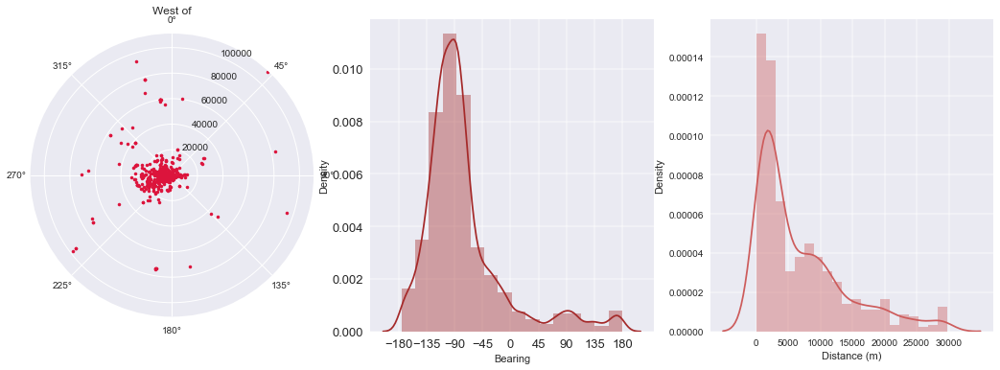

In [70]:

# s=np.sin(t*np.pi)
theta1=westof['Azimuth1']
theta_convert=(theta1/180)*np.pi
d=westof['Diatance'] 

fig = plt.figure(figsize=(18,6))
ax1 = plt.subplot( 131,projection='polar')
#plt.subplot(1,2,1)
ax1.set_theta_zero_location('N')
ax1.set_theta_direction(-1)
ax1.set_thetamin(0.0)  # 设置极坐标图开始角度为0°
ax1.set_thetamax(360.0)  # 设置极坐标结束角度为180°
ax1.plot(theta_convert,d,'.',c='crimson')
ax1.set_rmax(111000)   #111000
plt.title('West of')

#要生成两行两列，这是第一个图plt.subplot('行','列','编号')

plt.subplot(132) #两行两列,这是第二个图
# 2）设置内置背景style
plt.style.use('seaborn')
plt.grid(linestyle="-", alpha=0.5,linewidth=1.5) 
#bins=[0,45,90,135,180,225,270,315,360]
sns.distplot(theta1, bins=16,hist=True,kde=True,color='brown')

plt.xticks(range(-180, 181)[::45] ,fontsize=10)

plt.tick_params(labelsize=13)
plt.xlabel("Bearing")
plt.ylabel("Density")

#---------------
plt.subplot(133) #两行两列,这是第三个图
# 2）设置内置背景style
plt.style.use('seaborn')
# 添加网格显示
plt.grid(linestyle="-", alpha=0.5,linewidth=1.5) 

dist_range=westof[westof['Diatance'] <30000]
dist_range=dist_range['Diatance']
sns.distplot(dist_range, bins=20,hist=True,kde=True,color='indianred')# rug=True,
plt.xticks(range(0, 30001)[::5000] ,fontsize=12)

# 修改刻度值大小
plt.tick_params(labelsize=10)
#添加x, y轴描述信息
plt.xlabel("Distance (m)")
plt.ylabel("Density")

plt.show()

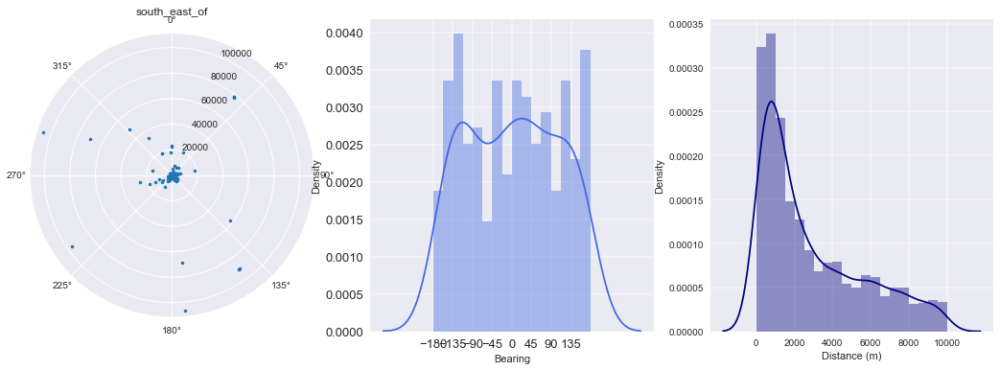

In [18]:

# s=np.sin(t*np.pi)
theta1=at['Azimuth1']
theta_convert=(theta1/180)*np.pi
d=at['Diatance'] 

fig = plt.figure(figsize=(18,6))
ax1 = plt.subplot( 131,projection='polar')
#plt.subplot(1,2,1)
ax1.set_theta_zero_location('N')
ax1.set_theta_direction(-1)
ax1.set_thetamin(0.0)  # 设置极坐标图开始角度为0°
ax1.set_thetamax(360.0)  # 设置极坐标结束角度为180°
ax1.plot(theta_convert,d,'.',c='tab:blue')
ax1.set_rmax(111000)
plt.title('south_east_of')

#要生成两行两列，这是第一个图plt.subplot('行','列','编号')

plt.subplot(132) #两行两列,这是第二个图
# 2）设置内置背景style
plt.style.use('seaborn')
plt.grid(linestyle="-", alpha=0.5,linewidth=1.5) 
#bins=[0,45,90,135,180,225,270,315,360]
sns.distplot(theta1, bins=16,hist=True,kde=True,color='royalblue')

plt.xticks(range(-180, 180)[::45] ,fontsize=10)

plt.tick_params(labelsize=13)
plt.xlabel("Bearing")
plt.ylabel("Density")

#---------------
plt.subplot(133) #两行两列,这是第三个图
# 2）设置内置背景style
plt.style.use('seaborn')
# 添加网格显示
plt.grid(linestyle="-", alpha=0.5,linewidth=1.5) 

dist_range=near[near['Diatance'] <10000]
dist_range=dist_range['Diatance']
#bins=[10000,20000,30000]
sns.distplot(dist_range, bins=20,hist=True,kde=True,color='navy')# rug=True,
plt.xticks(range(0, 10001)[::2000] ,fontsize=12)


# 修改刻度值大小
plt.tick_params(labelsize=10)
#添加x, y轴描述信息
plt.xlabel("Distance (m)")
plt.ylabel("Density")

plt.show()

# Feature Selection in another pynote